<center><h1>1-cd: Convolutional Neural Networks (ConvNets)</h1></center>

<center><h2><a href="https://rdfia.github.io/">Course link</a></h2></center>

# Warning :
# Do "File -> Save a copy in Drive" before you start modifying the notebook, otherwise your modifications will not be saved.


In [1]:
#!git clone https://github.com/cdancette/deep-learning-polytech-tp6-7.git
! wget https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py

--2023-10-30 12:28:40--  https://github.com/rdfia/rdfia.github.io/raw/master/code/2-cd/utils.py
Resolving proxy.ufr-info-p6.jussieu.fr (proxy.ufr-info-p6.jussieu.fr)... 132.227.118.144, 132.227.118.143
Connecting to proxy.ufr-info-p6.jussieu.fr (proxy.ufr-info-p6.jussieu.fr)|132.227.118.144|:3128... connected.


Proxy request sent, awaiting response... 302 Found
Location: https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py [following]
--2023-10-30 12:28:40--  https://raw.githubusercontent.com/rdfia/rdfia.github.io/master/code/2-cd/utils.py
Connecting to proxy.ufr-info-p6.jussieu.fr (proxy.ufr-info-p6.jussieu.fr)|132.227.118.144|:3128... connected.
Proxy request sent, awaiting response... 200 OK
Length: 2627 (2.6K) [text/plain]
Saving to: 'utils.py.2'

utils.py.2          100%[===================>]   2.57K  --.-KB/s    in 0s      

2023-10-30 12:28:40 (41.1 MB/s) - 'utils.py.2' saved [2627/2627]



In [2]:
%run 'utils.py'

In [3]:
%cat utils.py

import matplotlib.pyplot as plt
plt.ion()
import numpy as np

def accuracy(output, target, topk=(1,)):
    """Computes the precision@k for the specified values of k"""
    maxk = max(topk)
    batch_size = target.size(0)
    
    _, pred = output.topk(maxk, 1, True, True)
    pred = pred.t()
    correct = pred.eq(target.view(1, -1).expand_as(pred))

    res = []
    for k in topk:
        correct_k = correct[:k].reshape(-1).float().sum(0, keepdim=True)
        res.append(correct_k.mul_(100.0 / batch_size))
    return res

class AverageMeter(object):
    """Computes and stores the average and current value"""
    def __init__(self, keep_all=False):
        self.reset()
        self.data = None
        if keep_all:
            self.data = []

    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0

    def update(self, val, n=1):
        if self.data is not None:
            self.data.append(val)
        self.val = val
        self.sum +

In [3]:
import argparse
import os
import time
import numpy as np
#from scipy import linalg

import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim
import torch.utils.data
import torchvision.transforms as transforms
import torchvision.datasets as datasets

from utils import *

PRINT_INTERVAL = 200
PATH="datasets"

In [4]:
torch.cuda.is_available()

True

In [9]:
os.environ["CUDA_VISIBLE_DEVICES"]="2"

In [13]:
torch.cuda.set_device(2)

In [14]:
torch.cuda.current_device()

2

# 1) MNIST DATA Set

In [21]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(1, 6, (5, 5), stride=1, padding=2),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(6, 16, (5, 5), stride=1, padding=0),
            nn.Tanh(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(400, 120),
            nn.Tanh(),
            nn.Linear(120, 84),
            nn.Tanh(),
            nn.Linear(84, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.MNIST(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))
    val_dataset = datasets.MNIST(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


=== EPOCH 1 =====

[TRAIN Batch 000/469]	Time 1.988s (1.988s)	Loss 2.2969 (2.2969)	Prec@1  10.9 ( 10.9)	Prec@5  58.6 ( 58.6)


<Figure size 640x480 with 0 Axes>

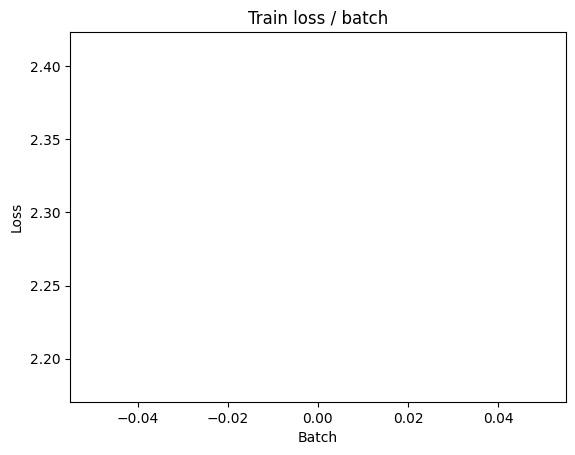

[TRAIN Batch 200/469]	Time 0.013s (0.032s)	Loss 0.3307 (1.1330)	Prec@1  90.6 ( 68.5)	Prec@5 100.0 ( 92.4)


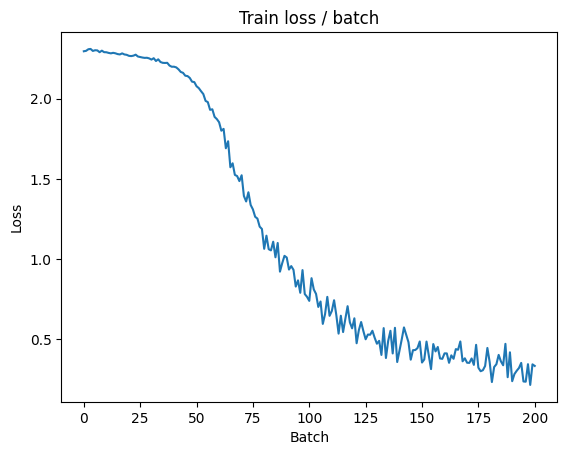

[TRAIN Batch 400/469]	Time 0.029s (0.025s)	Loss 0.1461 (0.6740)	Prec@1  96.9 ( 81.3)	Prec@5 100.0 ( 96.1)


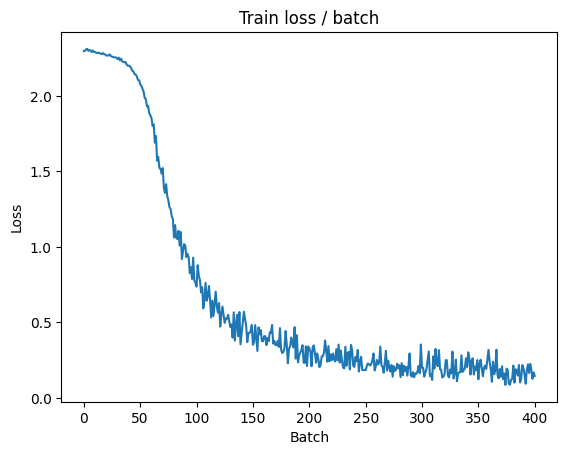


===============> Total time 11s	Avg loss 0.6001	Avg Prec@1 83.33 %	Avg Prec@5 96.62 %

[EVAL Batch 000/079]	Time 0.168s (0.168s)	Loss 0.0728 (0.0728)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.1326	Avg Prec@1 96.11 %	Avg Prec@5 99.92 %



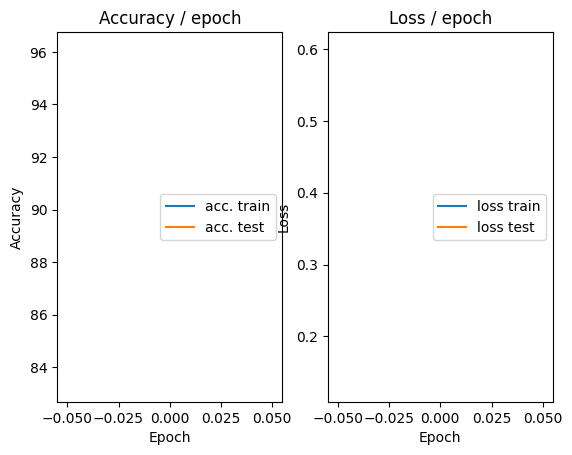

=== EPOCH 2 =====

[TRAIN Batch 000/469]	Time 0.114s (0.114s)	Loss 0.1562 (0.1562)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


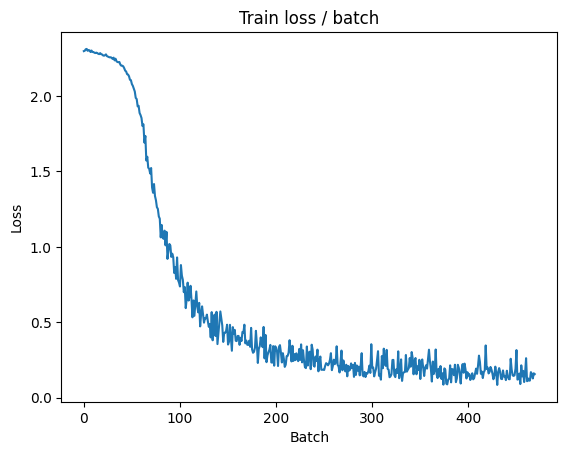

[TRAIN Batch 200/469]	Time 0.008s (0.022s)	Loss 0.0885 (0.1307)	Prec@1  95.3 ( 96.2)	Prec@5 100.0 ( 99.9)


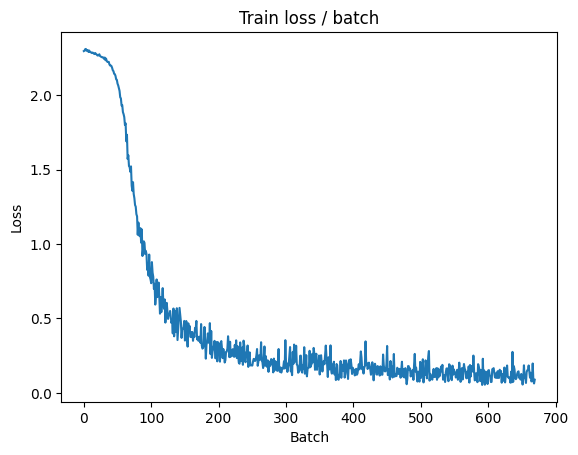

[TRAIN Batch 400/469]	Time 0.004s (0.024s)	Loss 0.1266 (0.1166)	Prec@1  93.8 ( 96.6)	Prec@5 100.0 ( 99.9)


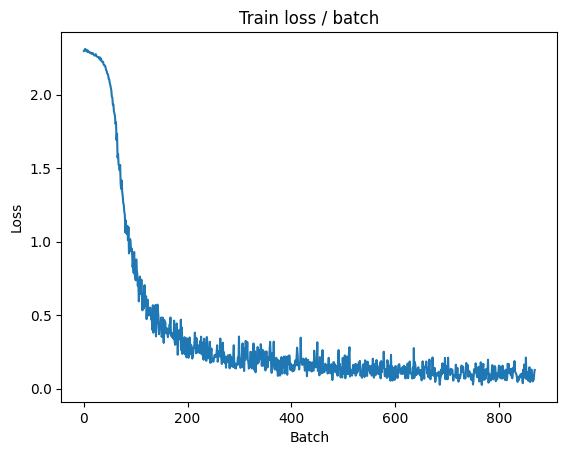


===============> Total time 10s	Avg loss 0.1143	Avg Prec@1 96.67 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.0351 (0.0351)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0802	Avg Prec@1 97.54 %	Avg Prec@5 99.98 %



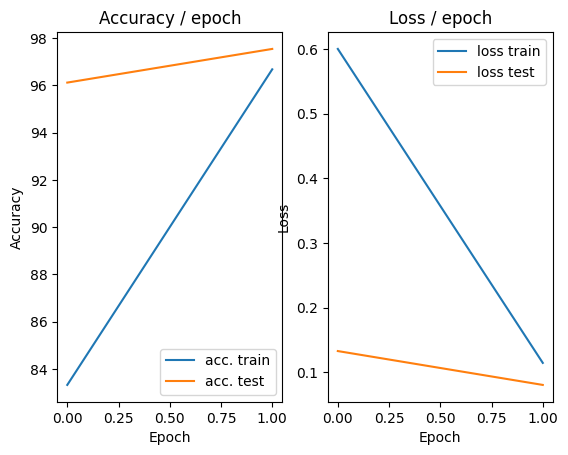

=== EPOCH 3 =====

[TRAIN Batch 000/469]	Time 0.120s (0.120s)	Loss 0.0281 (0.0281)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


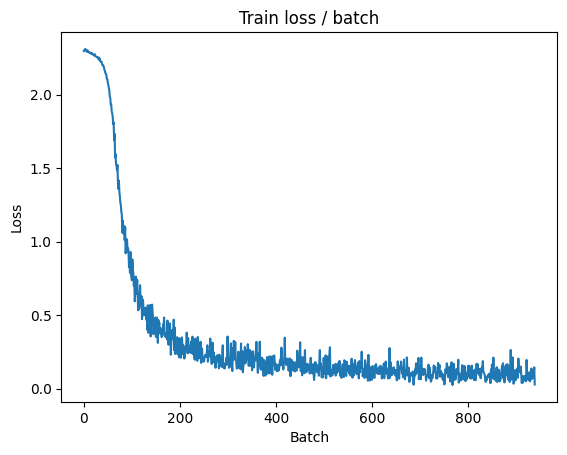

[TRAIN Batch 200/469]	Time 0.010s (0.025s)	Loss 0.0770 (0.0862)	Prec@1  97.7 ( 97.4)	Prec@5 100.0 ( 99.9)


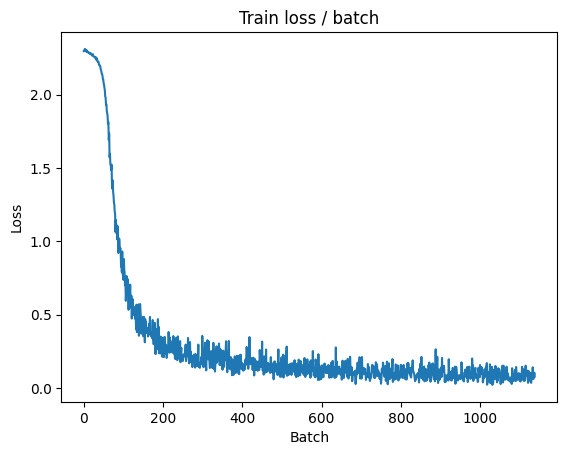

[TRAIN Batch 400/469]	Time 0.004s (0.020s)	Loss 0.0783 (0.0808)	Prec@1  96.9 ( 97.6)	Prec@5 100.0 ( 99.9)


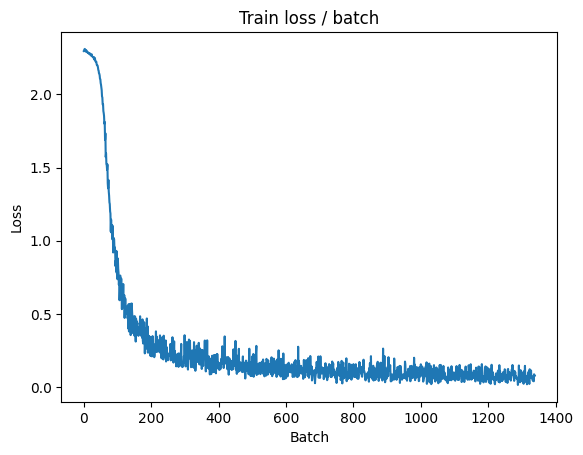


===============> Total time 9s	Avg loss 0.0797	Avg Prec@1 97.66 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.0241 (0.0241)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0622	Avg Prec@1 98.13 %	Avg Prec@5 99.98 %



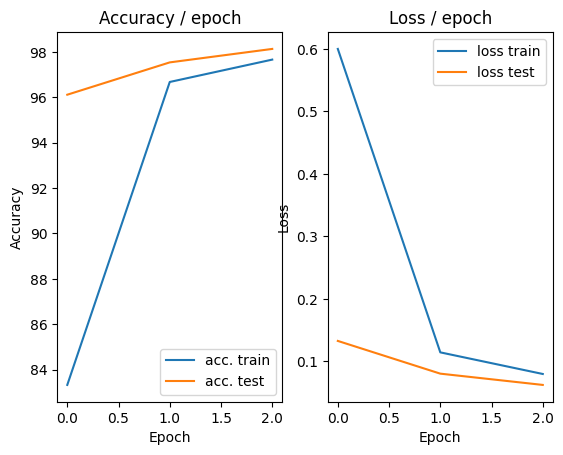

=== EPOCH 4 =====

[TRAIN Batch 000/469]	Time 0.114s (0.114s)	Loss 0.0630 (0.0630)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


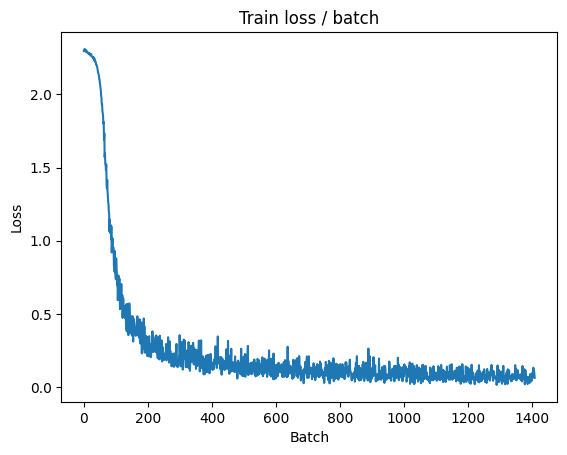

[TRAIN Batch 200/469]	Time 0.030s (0.019s)	Loss 0.0780 (0.0692)	Prec@1  97.7 ( 98.0)	Prec@5 100.0 (100.0)


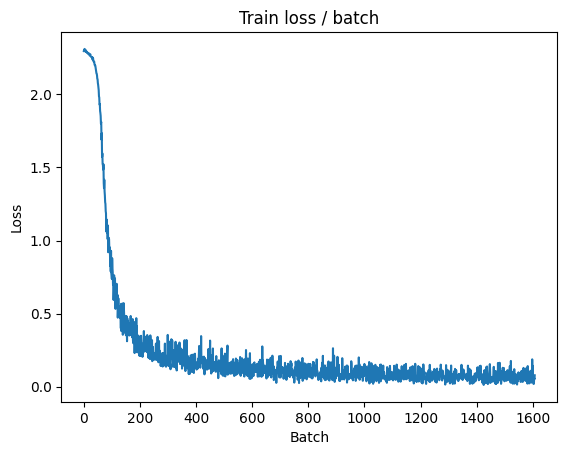

[TRAIN Batch 400/469]	Time 0.026s (0.019s)	Loss 0.1080 (0.0643)	Prec@1  96.1 ( 98.1)	Prec@5 100.0 (100.0)


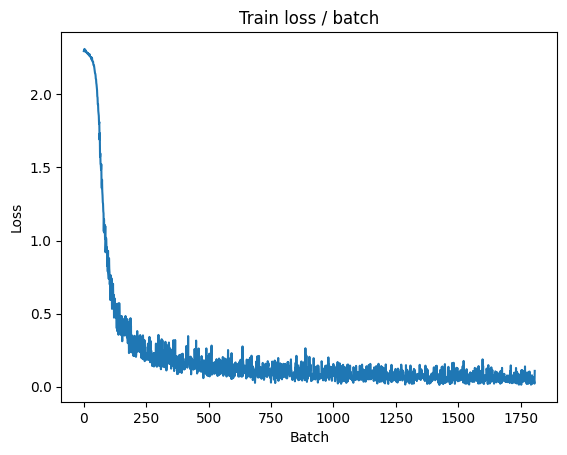


===============> Total time 8s	Avg loss 0.0634	Avg Prec@1 98.13 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.092s (0.092s)	Loss 0.0141 (0.0141)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0518	Avg Prec@1 98.23 %	Avg Prec@5 99.99 %



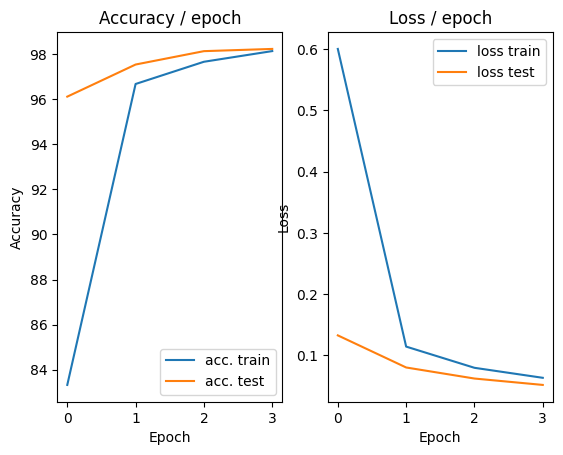

=== EPOCH 5 =====

[TRAIN Batch 000/469]	Time 0.115s (0.115s)	Loss 0.1243 (0.1243)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


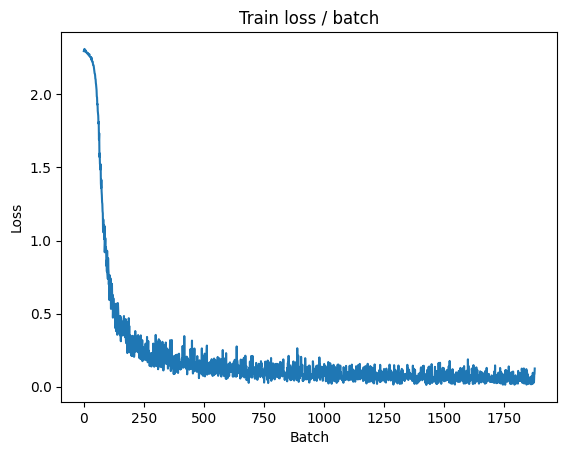

[TRAIN Batch 200/469]	Time 0.020s (0.017s)	Loss 0.0532 (0.0537)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


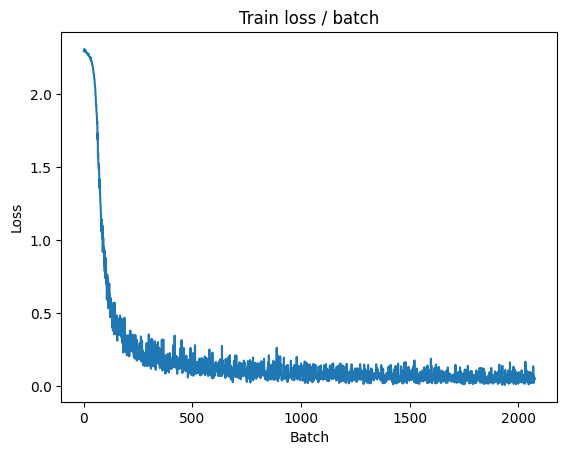

[TRAIN Batch 400/469]	Time 0.004s (0.019s)	Loss 0.0277 (0.0534)	Prec@1  99.2 ( 98.5)	Prec@5 100.0 (100.0)


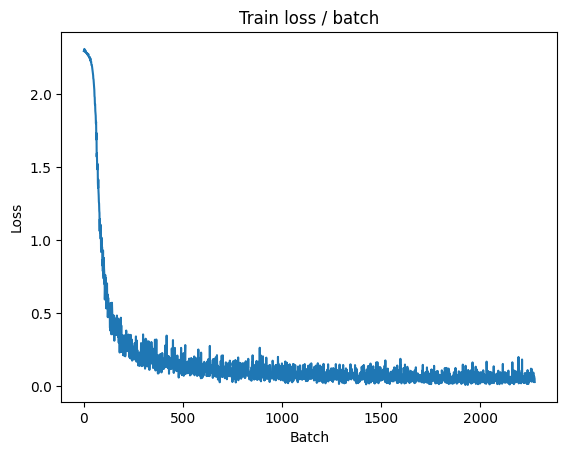


===============> Total time 8s	Avg loss 0.0532	Avg Prec@1 98.46 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.113s (0.113s)	Loss 0.0143 (0.0143)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.0439	Avg Prec@1 98.67 %	Avg Prec@5 100.00 %



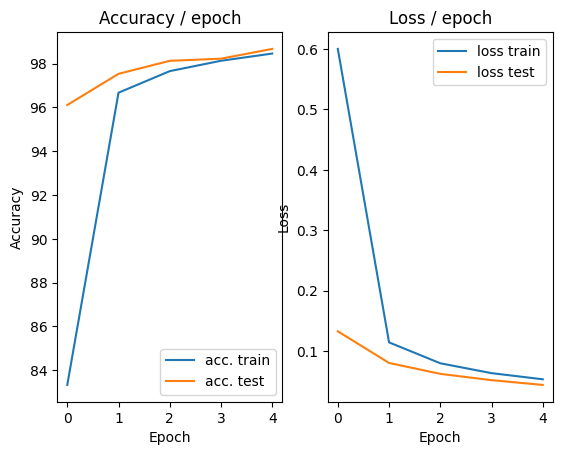

In [22]:
main(128, 0.1, cuda=True)

#2) CIFAR10 DataSet:

In [7]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor()
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


100%|██████████| 170498071/170498071 [00:12<00:00, 13580337.16it/s]


Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.244s (2.244s)	Loss 2.3006 (2.3006)	Prec@1  10.9 ( 10.9)	Prec@5  58.6 ( 58.6)


<Figure size 640x480 with 0 Axes>

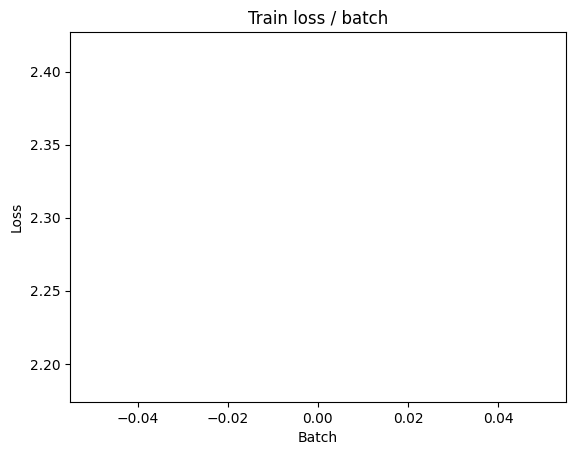

[TRAIN Batch 200/391]	Time 0.014s (0.037s)	Loss 2.0678 (2.2336)	Prec@1  22.7 ( 16.7)	Prec@5  75.0 ( 63.2)


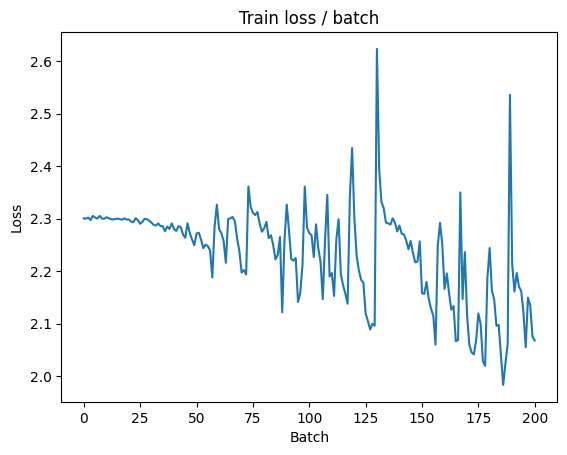


===============> Total time 11s	Avg loss 2.1223	Avg Prec@1 22.04 %	Avg Prec@5 70.40 %

[EVAL Batch 000/079]	Time 0.097s (0.097s)	Loss 1.7805 (1.7805)	Prec@1  39.1 ( 39.1)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.7754	Avg Prec@1 35.07 %	Avg Prec@5 86.28 %



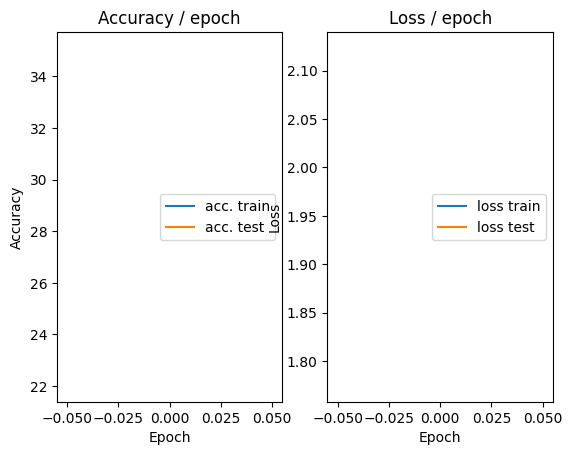

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.103s (0.103s)	Loss 1.6193 (1.6193)	Prec@1  40.6 ( 40.6)	Prec@5  95.3 ( 95.3)


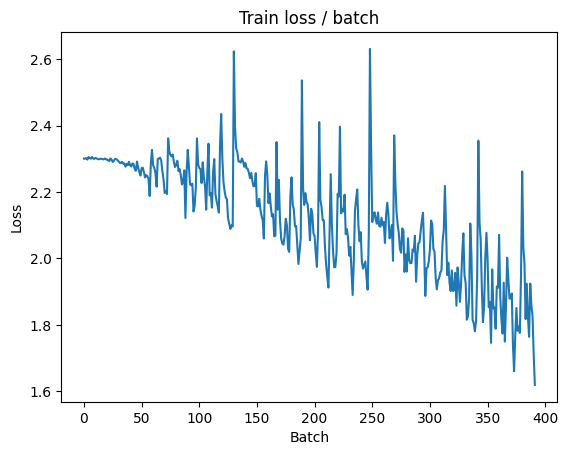

[TRAIN Batch 200/391]	Time 0.017s (0.028s)	Loss 1.6079 (1.7461)	Prec@1  39.1 ( 36.6)	Prec@5  93.0 ( 86.9)


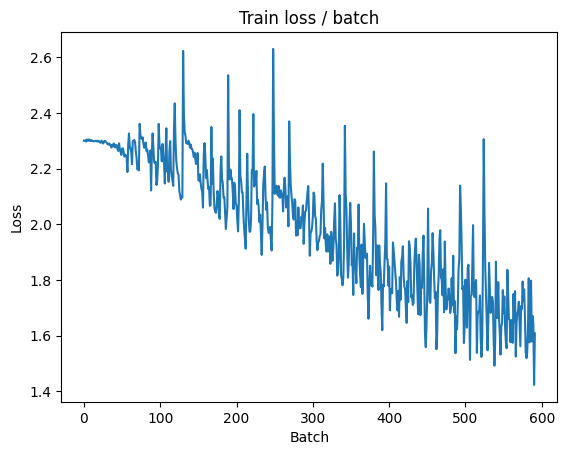


===============> Total time 9s	Avg loss 1.6623	Avg Prec@1 39.98 %	Avg Prec@5 88.59 %

[EVAL Batch 000/079]	Time 0.100s (0.100s)	Loss 1.4547 (1.4547)	Prec@1  49.2 ( 49.2)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.4787	Avg Prec@1 48.55 %	Avg Prec@5 91.58 %



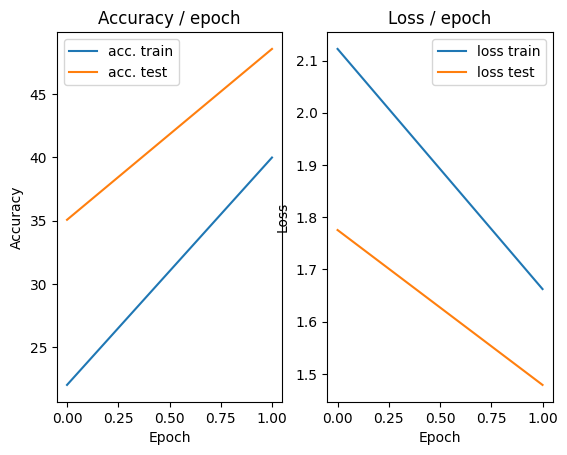

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.4910 (1.4910)	Prec@1  45.3 ( 45.3)	Prec@5  91.4 ( 91.4)


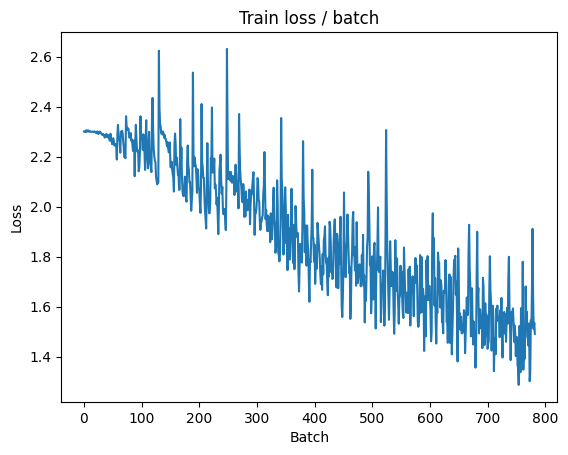

[TRAIN Batch 200/391]	Time 0.035s (0.028s)	Loss 1.5290 (1.4444)	Prec@1  50.8 ( 48.4)	Prec@5  88.3 ( 92.1)


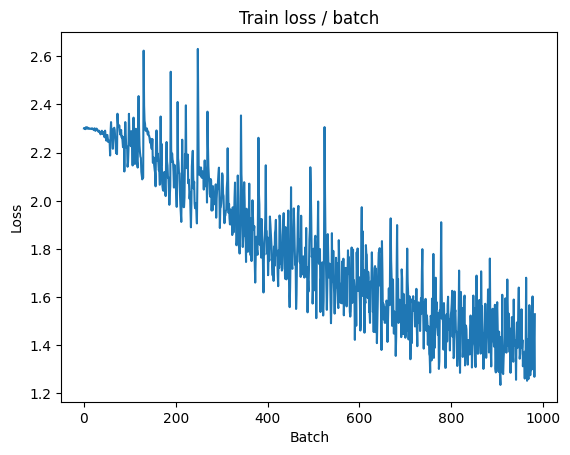


===============> Total time 10s	Avg loss 1.4081	Avg Prec@1 49.62 %	Avg Prec@5 92.71 %

[EVAL Batch 000/079]	Time 0.110s (0.110s)	Loss 1.3044 (1.3044)	Prec@1  58.6 ( 58.6)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.4165	Avg Prec@1 49.69 %	Avg Prec@5 92.68 %



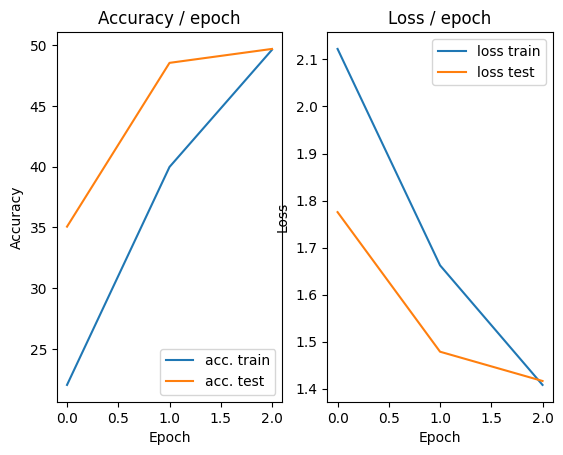

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.116s (0.116s)	Loss 1.3248 (1.3248)	Prec@1  56.2 ( 56.2)	Prec@5  87.5 ( 87.5)


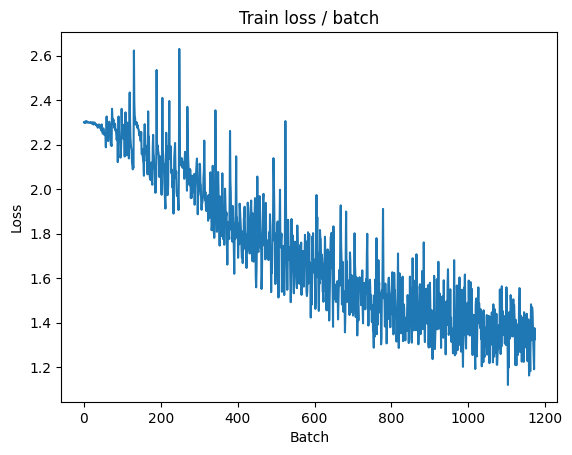

[TRAIN Batch 200/391]	Time 0.008s (0.028s)	Loss 1.1902 (1.2768)	Prec@1  57.0 ( 54.4)	Prec@5  96.9 ( 94.3)


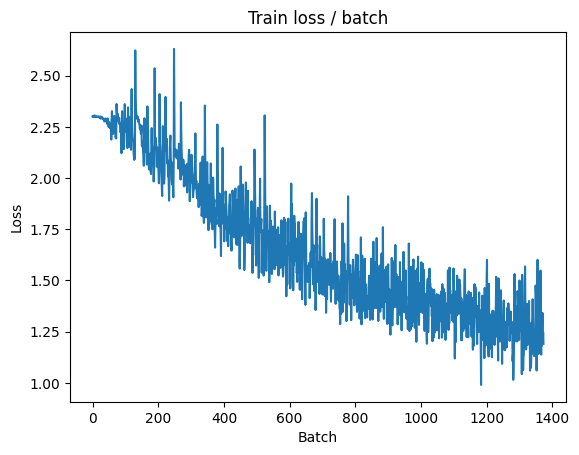


===============> Total time 9s	Avg loss 1.2576	Avg Prec@1 55.20 %	Avg Prec@5 94.55 %

[EVAL Batch 000/079]	Time 0.103s (0.103s)	Loss 1.0970 (1.0970)	Prec@1  61.7 ( 61.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.2539	Avg Prec@1 54.69 %	Avg Prec@5 94.89 %



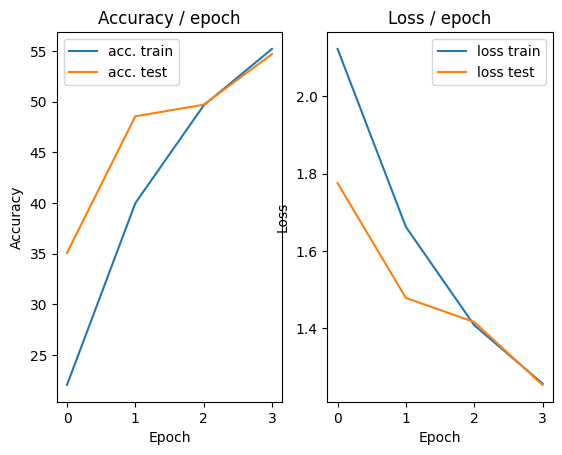

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.110s (0.110s)	Loss 1.2421 (1.2421)	Prec@1  51.6 ( 51.6)	Prec@5  97.7 ( 97.7)


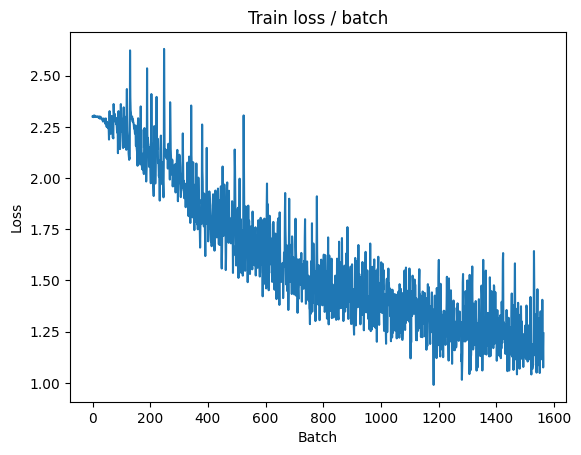

[TRAIN Batch 200/391]	Time 0.012s (0.028s)	Loss 1.2031 (1.1407)	Prec@1  59.4 ( 59.7)	Prec@5  93.0 ( 95.8)


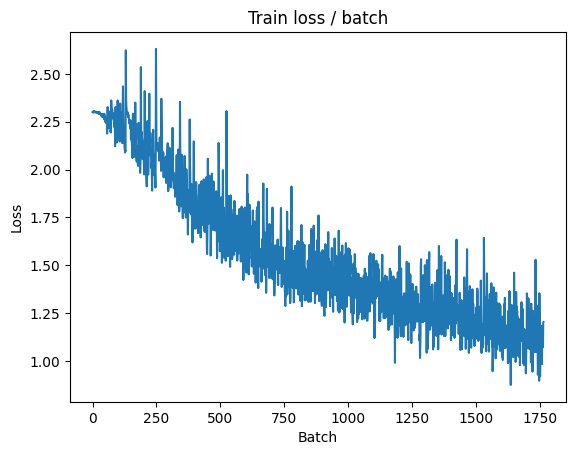


===============> Total time 9s	Avg loss 1.1214	Avg Prec@1 60.40 %	Avg Prec@5 95.84 %

[EVAL Batch 000/079]	Time 0.109s (0.109s)	Loss 0.9604 (0.9604)	Prec@1  71.1 ( 71.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0923	Avg Prec@1 61.48 %	Avg Prec@5 95.99 %



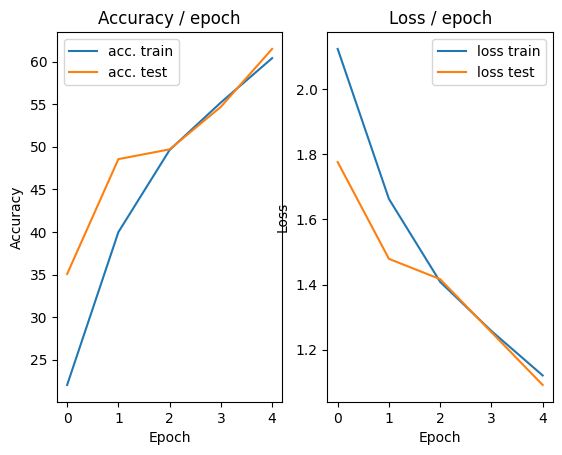

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 1.0016 (1.0016)	Prec@1  64.1 ( 64.1)	Prec@5  98.4 ( 98.4)


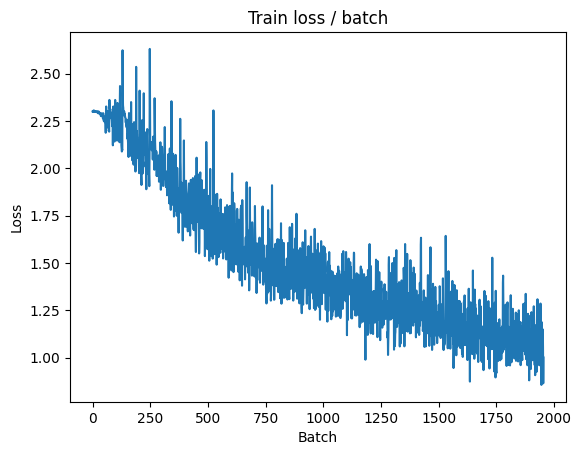

[TRAIN Batch 200/391]	Time 0.054s (0.028s)	Loss 1.0633 (1.0184)	Prec@1  60.2 ( 63.9)	Prec@5  97.7 ( 96.7)


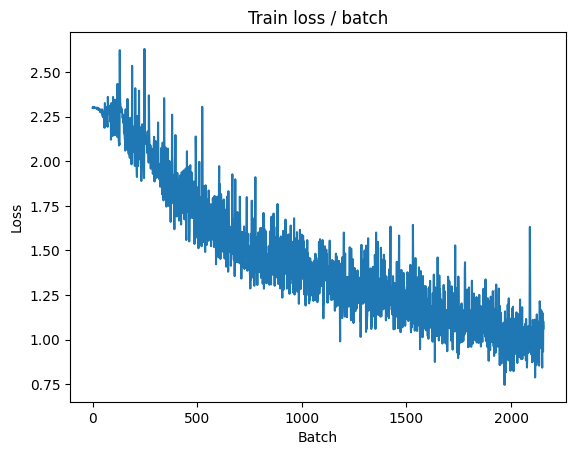


===============> Total time 10s	Avg loss 1.0090	Avg Prec@1 64.30 %	Avg Prec@5 96.74 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 1.0278 (1.0278)	Prec@1  61.7 ( 61.7)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.0954	Avg Prec@1 61.37 %	Avg Prec@5 95.71 %



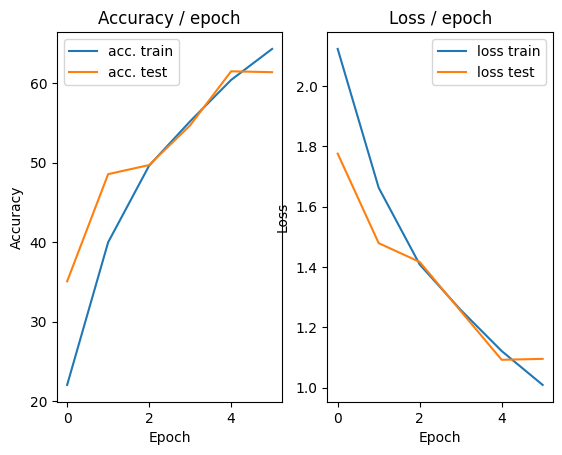

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.9104 (0.9104)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


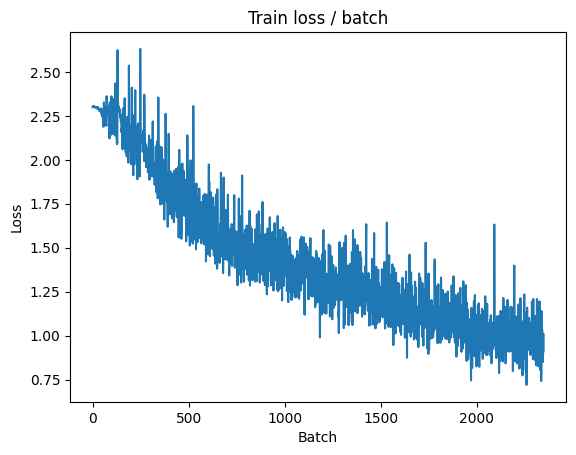

[TRAIN Batch 200/391]	Time 0.012s (0.025s)	Loss 0.9977 (0.9019)	Prec@1  69.5 ( 67.9)	Prec@5  96.1 ( 97.5)


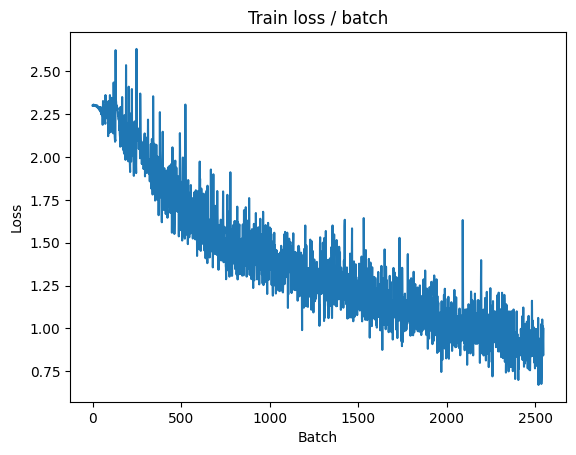


===============> Total time 9s	Avg loss 0.8967	Avg Prec@1 68.11 %	Avg Prec@5 97.53 %

[EVAL Batch 000/079]	Time 0.102s (0.102s)	Loss 0.9124 (0.9124)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0469	Avg Prec@1 64.13 %	Avg Prec@5 96.13 %



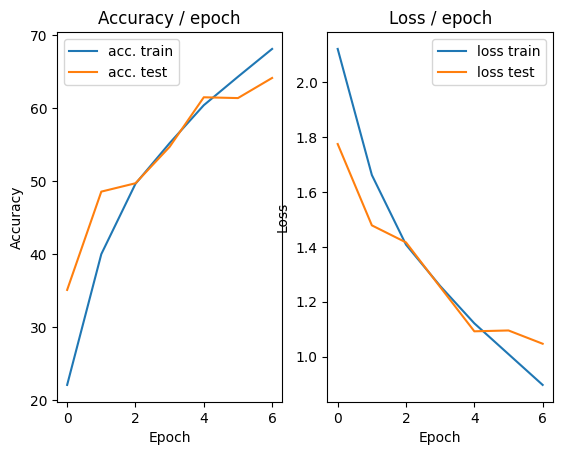

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.8189 (0.8189)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)


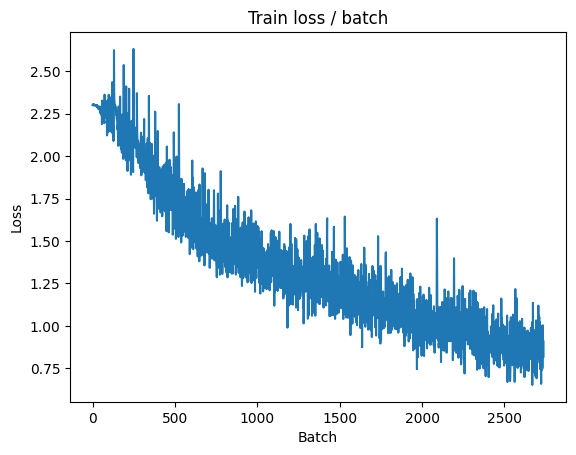

[TRAIN Batch 200/391]	Time 0.053s (0.028s)	Loss 0.8473 (0.8008)	Prec@1  69.5 ( 72.2)	Prec@5  98.4 ( 98.1)


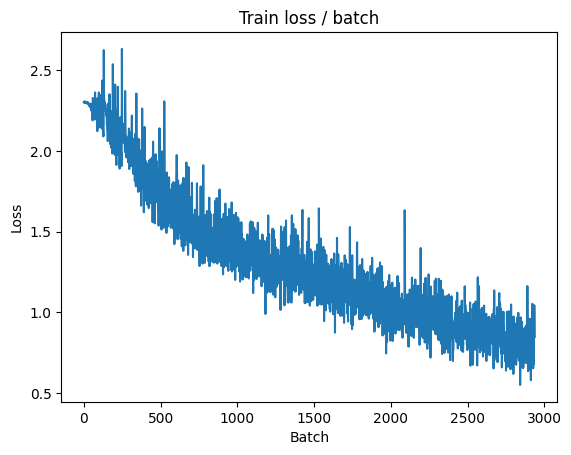


===============> Total time 10s	Avg loss 0.8019	Avg Prec@1 71.98 %	Avg Prec@5 98.07 %

[EVAL Batch 000/079]	Time 0.107s (0.107s)	Loss 0.9430 (0.9430)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9650	Avg Prec@1 66.35 %	Avg Prec@5 96.73 %



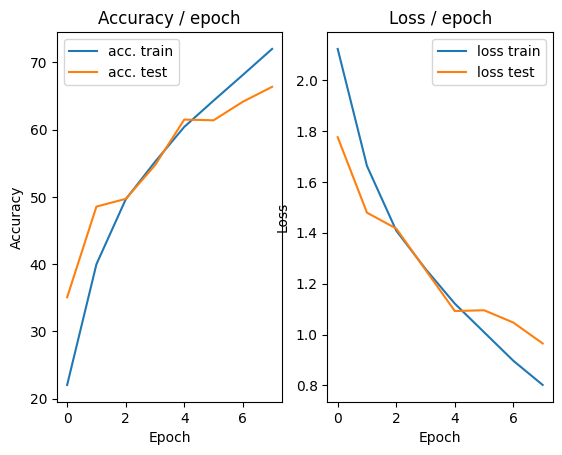

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.8899 (0.8899)	Prec@1  64.8 ( 64.8)	Prec@5  96.1 ( 96.1)


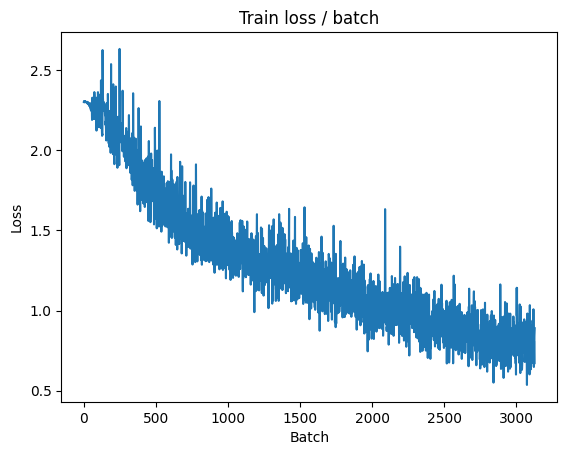

[TRAIN Batch 200/391]	Time 0.039s (0.024s)	Loss 0.8287 (0.6956)	Prec@1  69.5 ( 75.9)	Prec@5  99.2 ( 98.6)


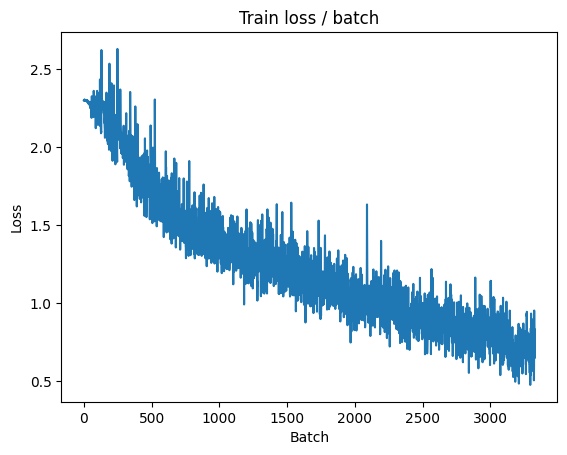


===============> Total time 10s	Avg loss 0.6969	Avg Prec@1 75.59 %	Avg Prec@5 98.61 %

[EVAL Batch 000/079]	Time 0.218s (0.218s)	Loss 0.8386 (0.8386)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8955	Avg Prec@1 69.34 %	Avg Prec@5 97.49 %



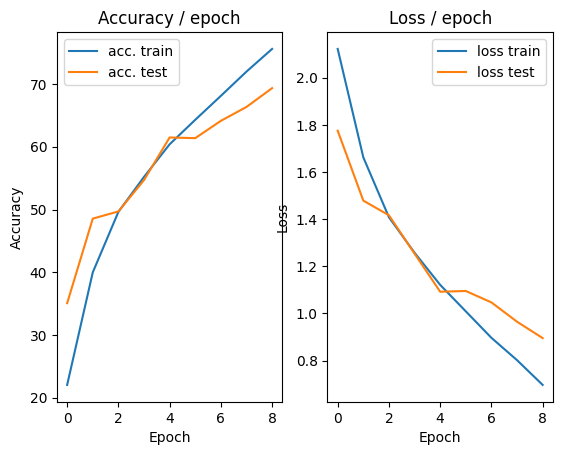

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.5591 (0.5591)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)


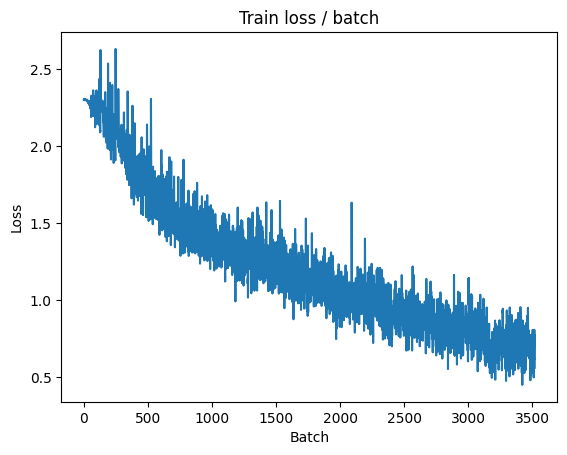

[TRAIN Batch 200/391]	Time 0.020s (0.023s)	Loss 0.7377 (0.5945)	Prec@1  75.8 ( 79.3)	Prec@5  98.4 ( 99.0)


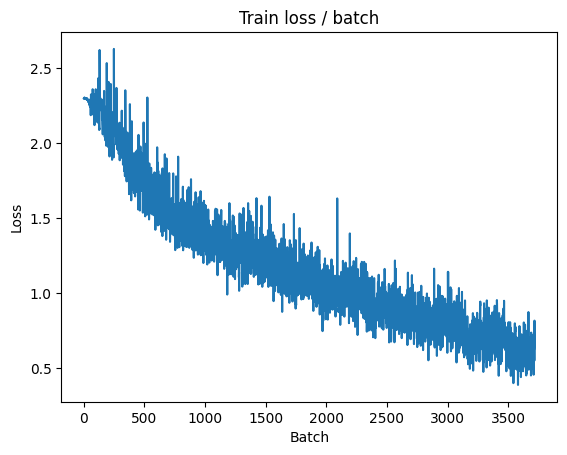


===============> Total time 9s	Avg loss 0.6057	Avg Prec@1 79.00 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 0.8820 (0.8820)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0041	Avg Prec@1 66.55 %	Avg Prec@5 96.85 %



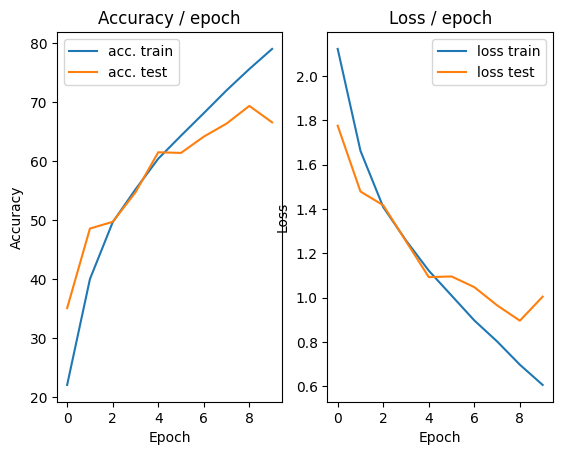

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.5382 (0.5382)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


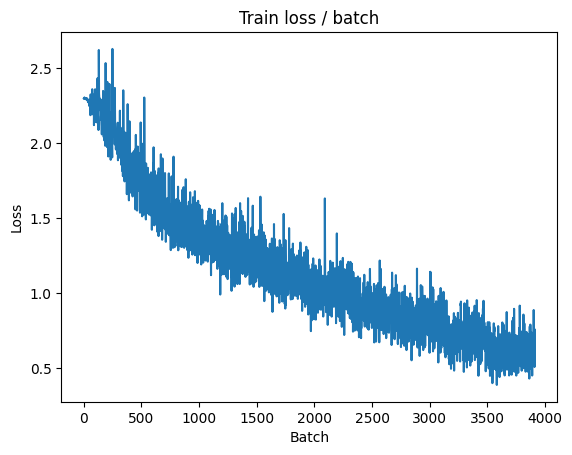

[TRAIN Batch 200/391]	Time 0.014s (0.023s)	Loss 0.5288 (0.4986)	Prec@1  77.3 ( 82.7)	Prec@5 100.0 ( 99.4)


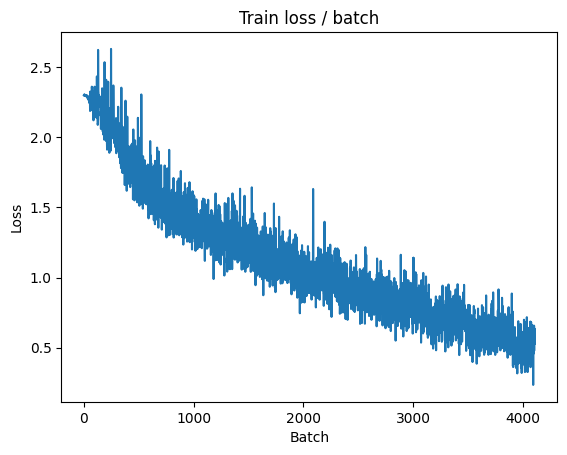


===============> Total time 9s	Avg loss 0.5074	Avg Prec@1 82.32 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.105s (0.105s)	Loss 0.9962 (0.9962)	Prec@1  68.8 ( 68.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9584	Avg Prec@1 69.59 %	Avg Prec@5 97.03 %



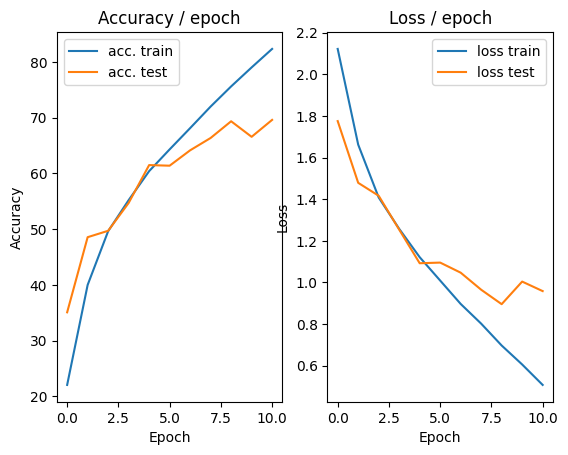

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.4248 (0.4248)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


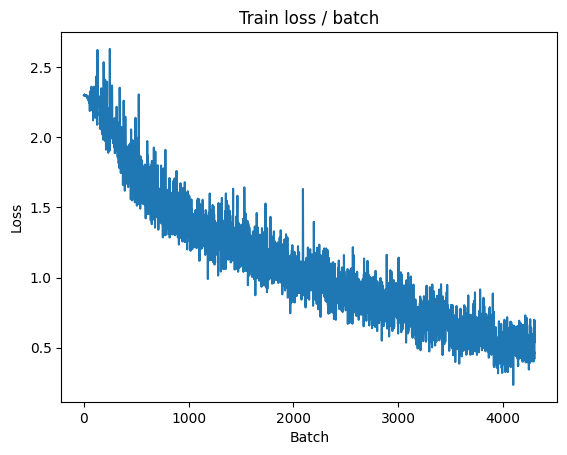

[TRAIN Batch 200/391]	Time 0.027s (0.023s)	Loss 0.5351 (0.4106)	Prec@1  82.0 ( 85.7)	Prec@5 100.0 ( 99.7)


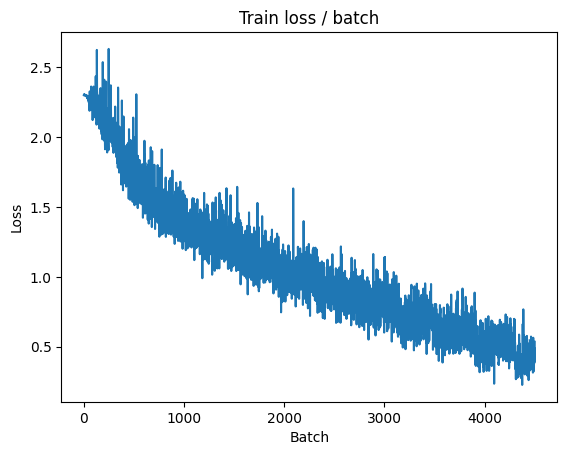


===============> Total time 9s	Avg loss 0.4206	Avg Prec@1 85.31 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.108s (0.108s)	Loss 0.9946 (0.9946)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9940	Avg Prec@1 68.89 %	Avg Prec@5 97.09 %



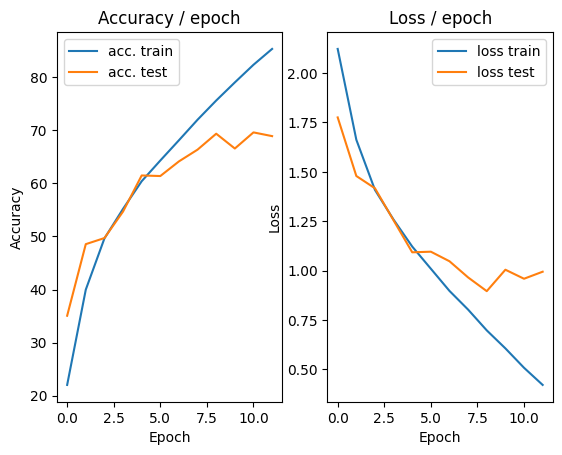

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.2253 (0.2253)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


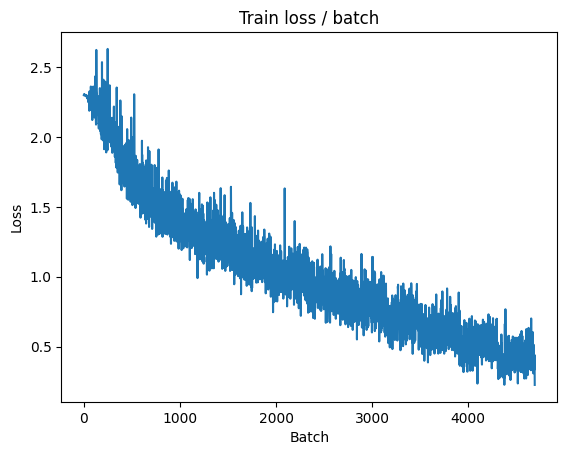

[TRAIN Batch 200/391]	Time 0.019s (0.023s)	Loss 0.2602 (0.2942)	Prec@1  95.3 ( 89.9)	Prec@5 100.0 ( 99.8)


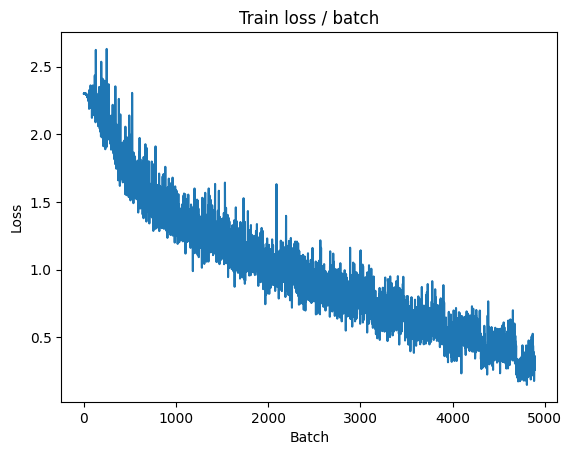


===============> Total time 9s	Avg loss 0.3214	Avg Prec@1 88.87 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 1.4019 (1.4019)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.3518	Avg Prec@1 65.73 %	Avg Prec@5 96.36 %



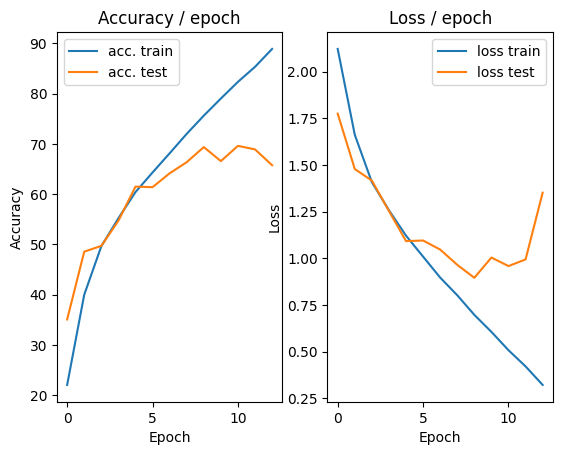

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.5707 (0.5707)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)


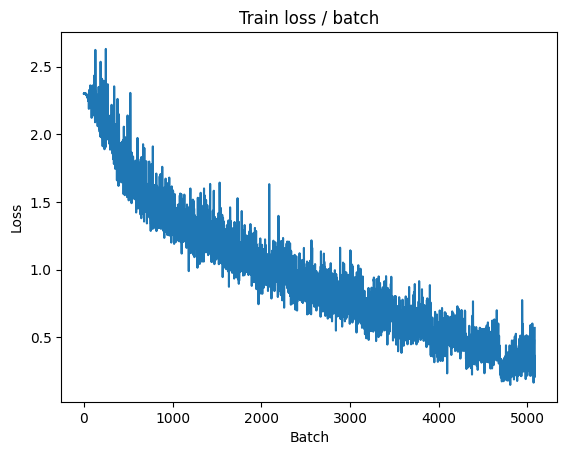

[TRAIN Batch 200/391]	Time 0.008s (0.023s)	Loss 0.2542 (0.2281)	Prec@1  90.6 ( 92.3)	Prec@5 100.0 ( 99.9)


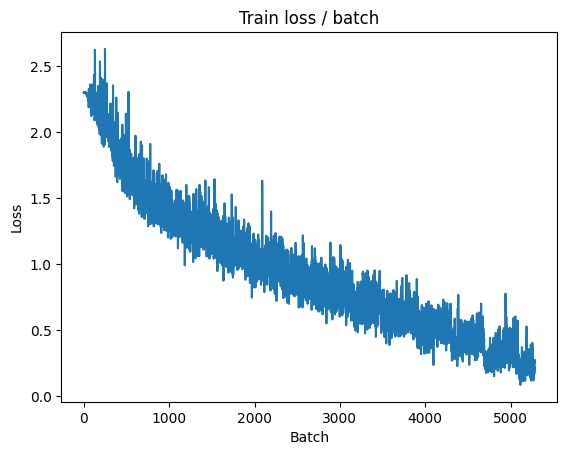


===============> Total time 9s	Avg loss 0.2533	Avg Prec@1 91.27 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 1.2630 (1.2630)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.1787	Avg Prec@1 68.39 %	Avg Prec@5 96.78 %



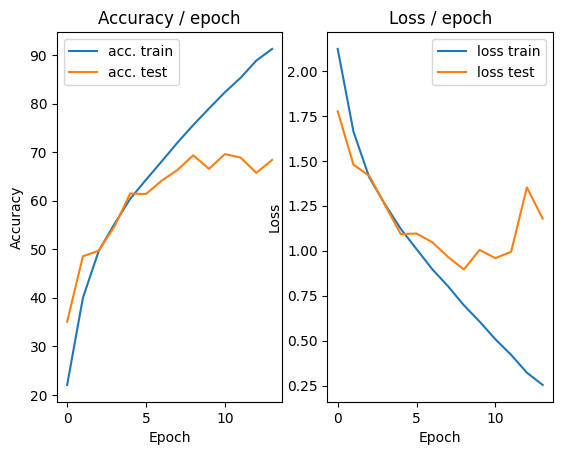

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.3075 (0.3075)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


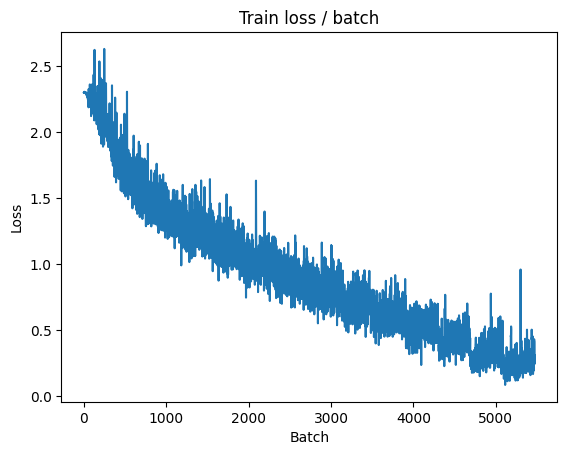

[TRAIN Batch 200/391]	Time 0.034s (0.023s)	Loss 0.1545 (0.1579)	Prec@1  95.3 ( 94.8)	Prec@5 100.0 (100.0)


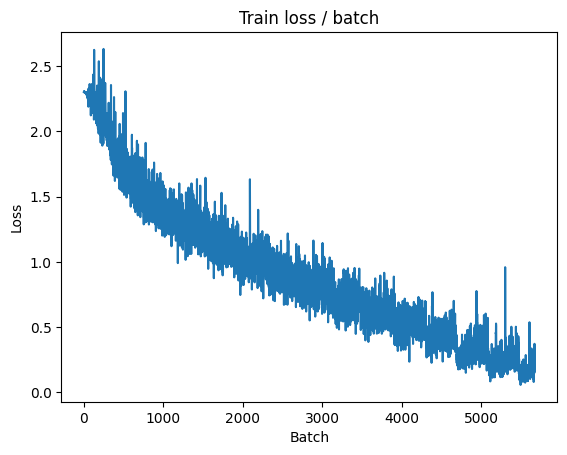


===============> Total time 8s	Avg loss 0.1777	Avg Prec@1 93.96 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.1691 (1.1691)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.2113	Avg Prec@1 70.62 %	Avg Prec@5 97.27 %



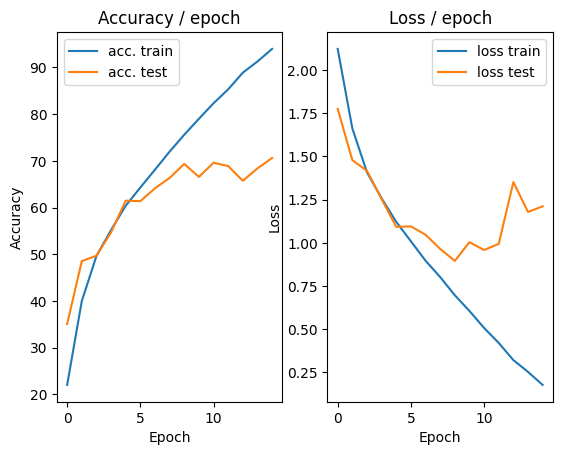

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.0940 (0.0940)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


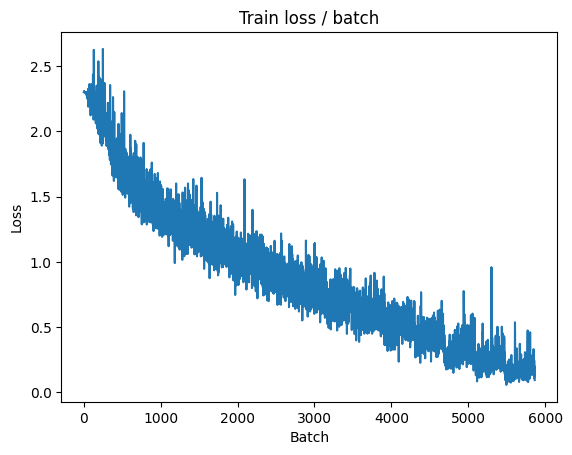

[TRAIN Batch 200/391]	Time 0.010s (0.023s)	Loss 0.1171 (0.0934)	Prec@1  96.9 ( 97.2)	Prec@5 100.0 (100.0)


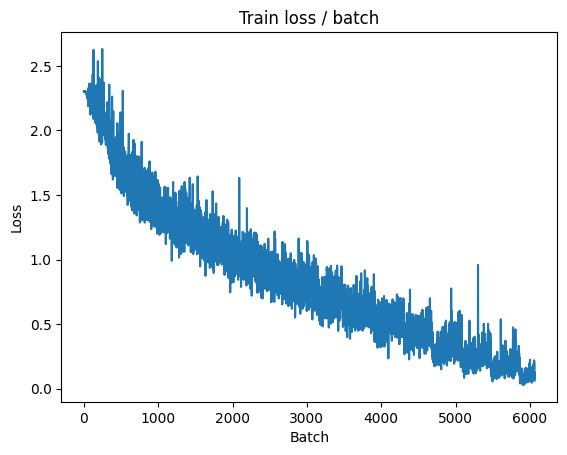


===============> Total time 8s	Avg loss 0.1231	Avg Prec@1 96.04 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.2210 (1.2210)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.3012	Avg Prec@1 70.25 %	Avg Prec@5 96.88 %



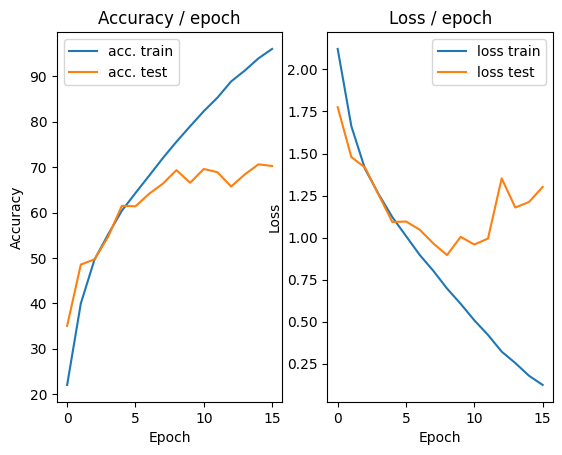

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.208s (0.208s)	Loss 0.0580 (0.0580)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


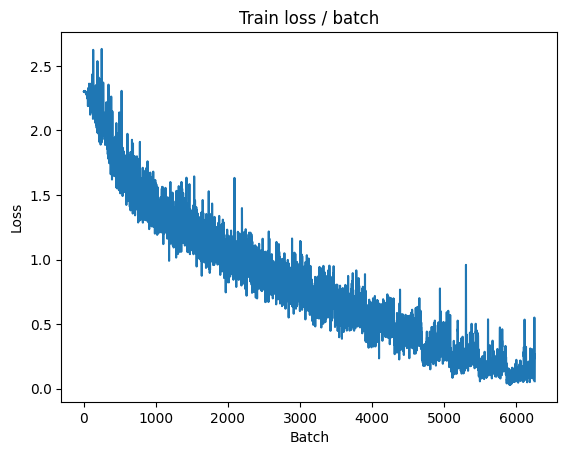

[TRAIN Batch 200/391]	Time 0.009s (0.024s)	Loss 0.1954 (0.0720)	Prec@1  94.5 ( 97.9)	Prec@5 100.0 (100.0)


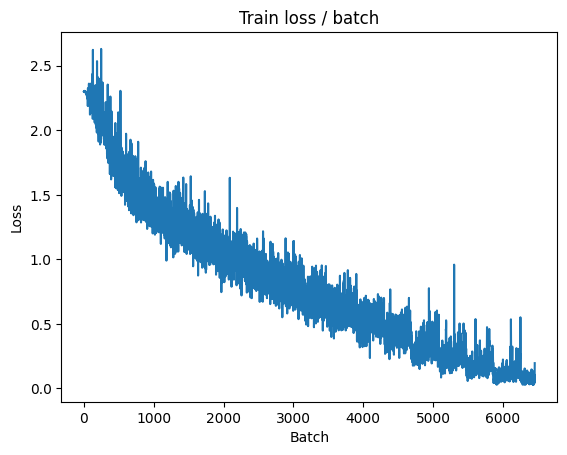


===============> Total time 9s	Avg loss 0.0899	Avg Prec@1 97.24 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.125s (0.125s)	Loss 1.5552 (1.5552)	Prec@1  70.3 ( 70.3)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.4421	Avg Prec@1 69.26 %	Avg Prec@5 96.88 %



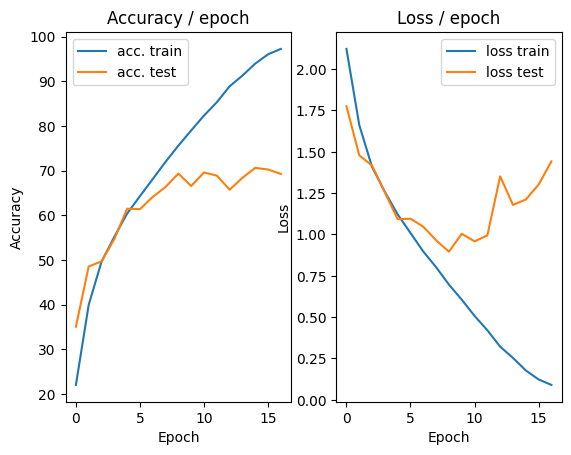

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.1513 (0.1513)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


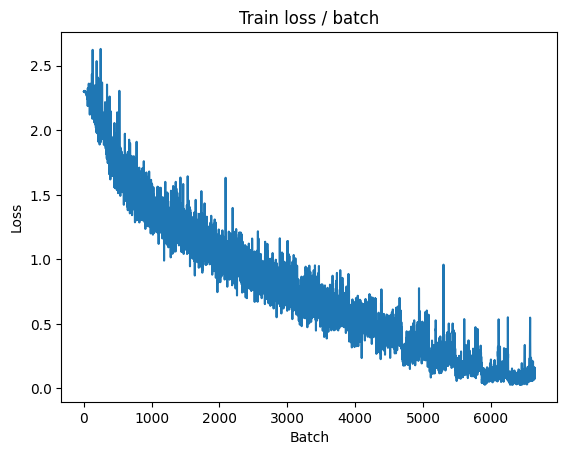

[TRAIN Batch 200/391]	Time 0.045s (0.027s)	Loss 0.0506 (0.0698)	Prec@1  98.4 ( 97.8)	Prec@5 100.0 (100.0)


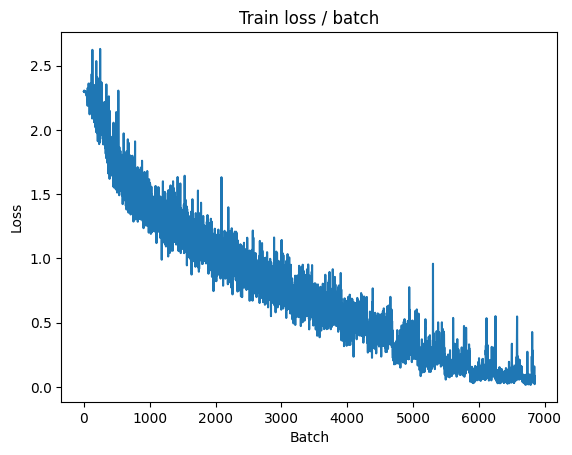


===============> Total time 9s	Avg loss 0.0788	Avg Prec@1 97.48 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.118s (0.118s)	Loss 1.4391 (1.4391)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.4605	Avg Prec@1 70.61 %	Avg Prec@5 97.15 %



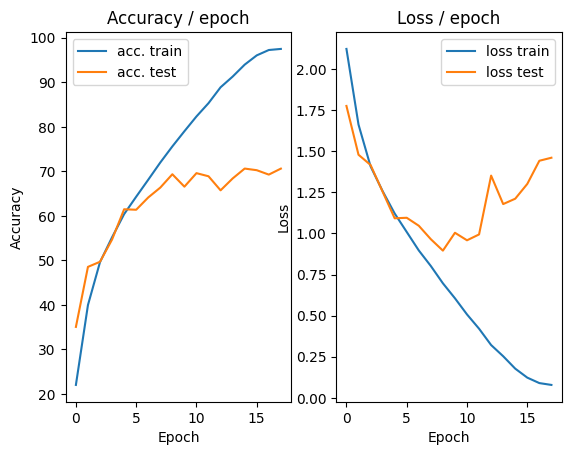

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 0.0547 (0.0547)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


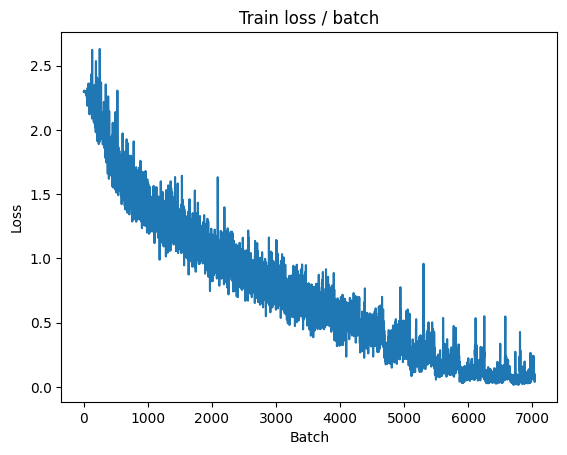

[TRAIN Batch 200/391]	Time 0.016s (0.029s)	Loss 0.0236 (0.0417)	Prec@1  99.2 ( 98.8)	Prec@5 100.0 (100.0)


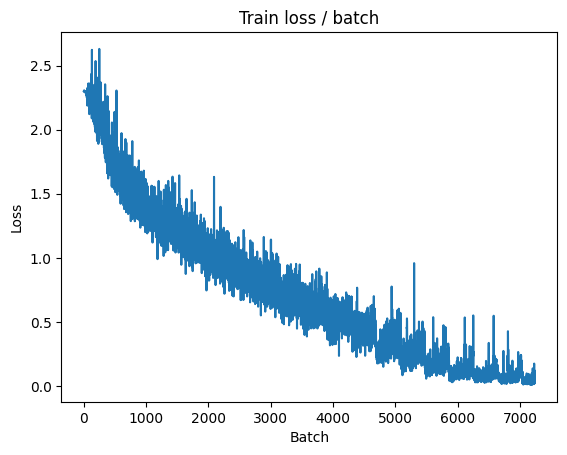


===============> Total time 10s	Avg loss 0.0518	Avg Prec@1 98.45 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.8421 (1.8421)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.6939	Avg Prec@1 70.04 %	Avg Prec@5 97.05 %



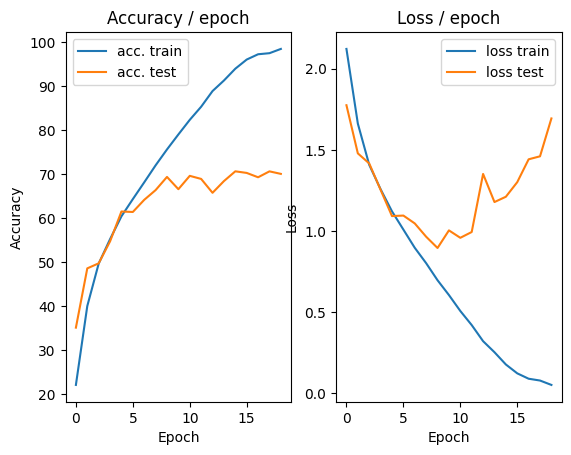

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.164s (0.164s)	Loss 0.1767 (0.1767)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


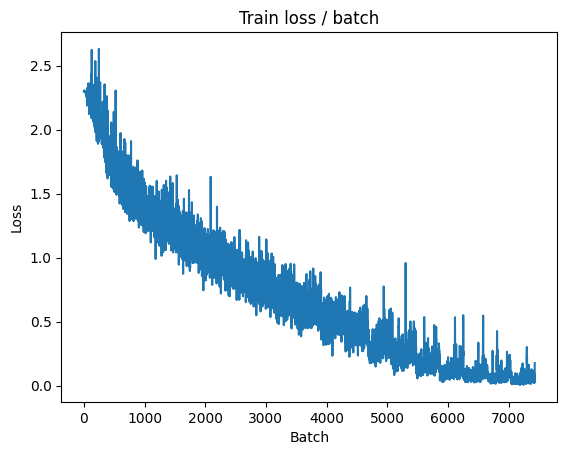

[TRAIN Batch 200/391]	Time 0.036s (0.030s)	Loss 0.8755 (0.0520)	Prec@1  78.9 ( 98.6)	Prec@5  98.4 (100.0)


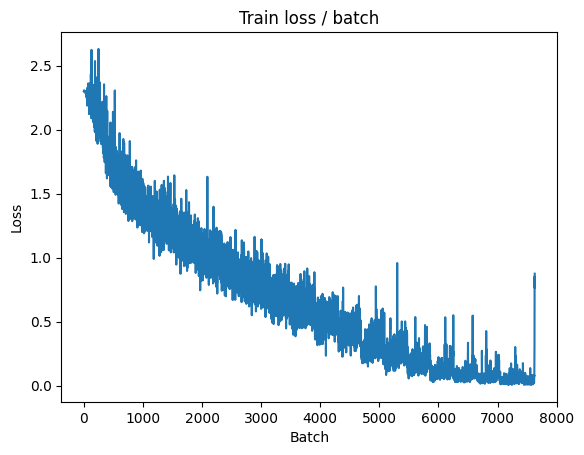


===============> Total time 10s	Avg loss 0.0717	Avg Prec@1 97.92 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.115s (0.115s)	Loss 1.9440 (1.9440)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.7544	Avg Prec@1 67.95 %	Avg Prec@5 97.07 %



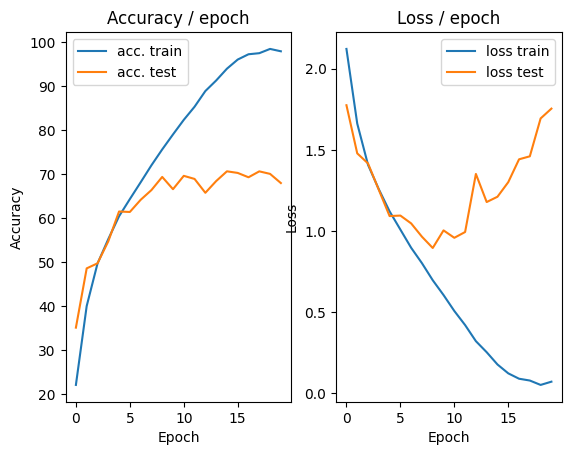

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.1006 (0.1006)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


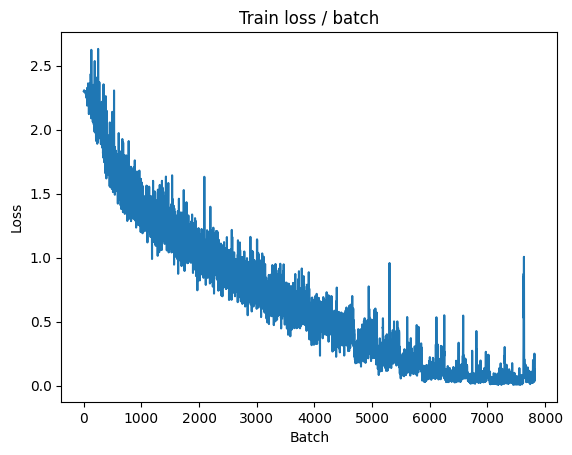

[TRAIN Batch 200/391]	Time 0.009s (0.029s)	Loss 0.0199 (0.0295)	Prec@1 100.0 ( 99.2)	Prec@5 100.0 (100.0)


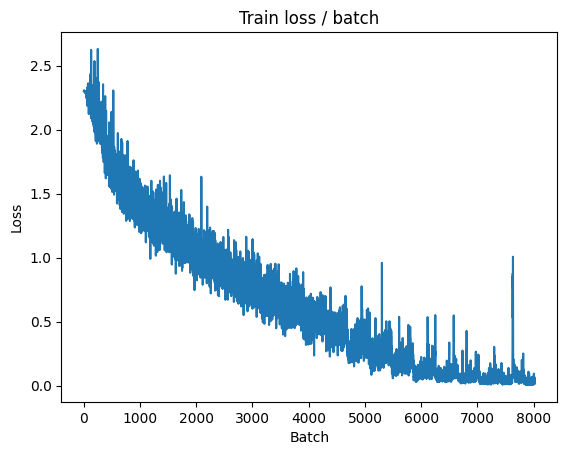


===============> Total time 10s	Avg loss 0.0353	Avg Prec@1 98.96 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 1.9069 (1.9069)	Prec@1  68.8 ( 68.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.8799	Avg Prec@1 68.97 %	Avg Prec@5 97.01 %



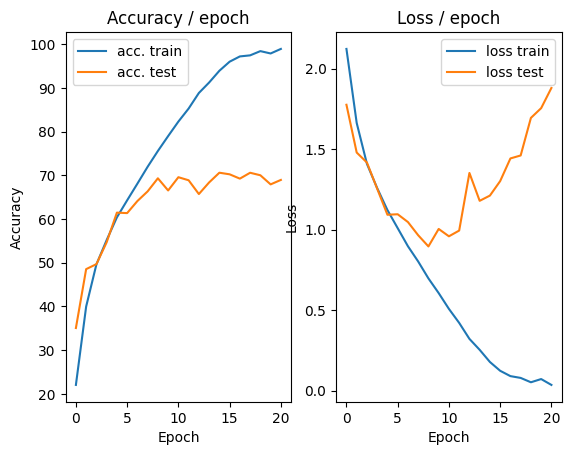

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.1022 (0.1022)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


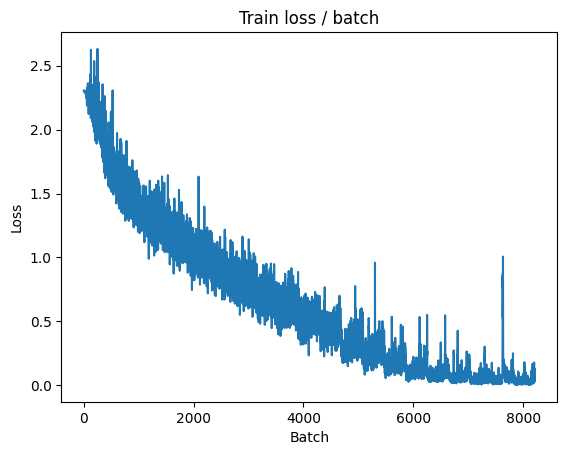

[TRAIN Batch 200/391]	Time 0.044s (0.035s)	Loss 0.0487 (0.0260)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


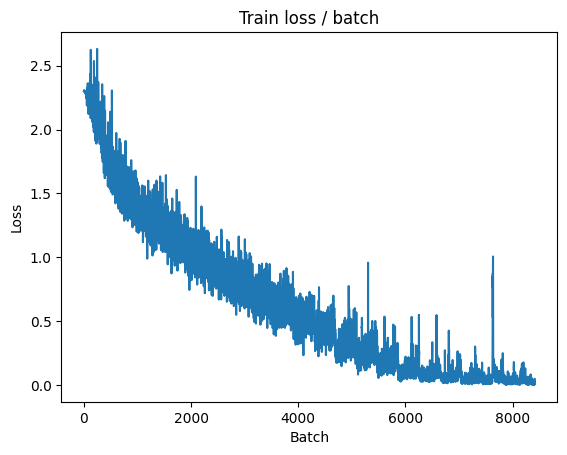


===============> Total time 11s	Avg loss 0.0275	Avg Prec@1 99.20 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 1.8883 (1.8883)	Prec@1  72.7 ( 72.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.7655	Avg Prec@1 71.21 %	Avg Prec@5 97.35 %



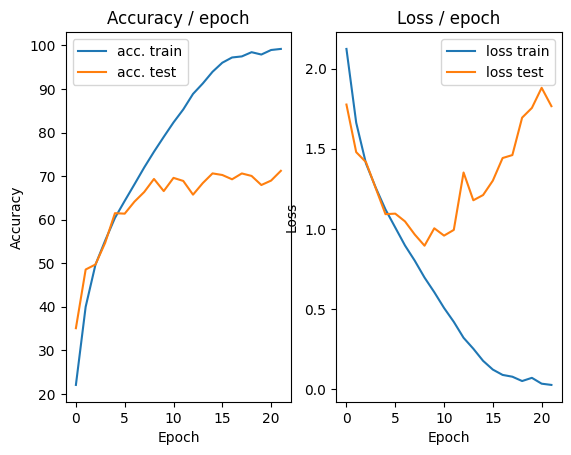

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.0140 (0.0140)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


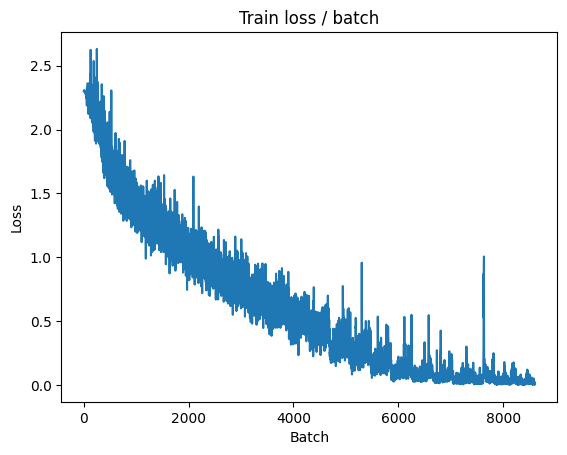

[TRAIN Batch 200/391]	Time 0.008s (0.029s)	Loss 0.0030 (0.0069)	Prec@1 100.0 ( 99.9)	Prec@5 100.0 (100.0)


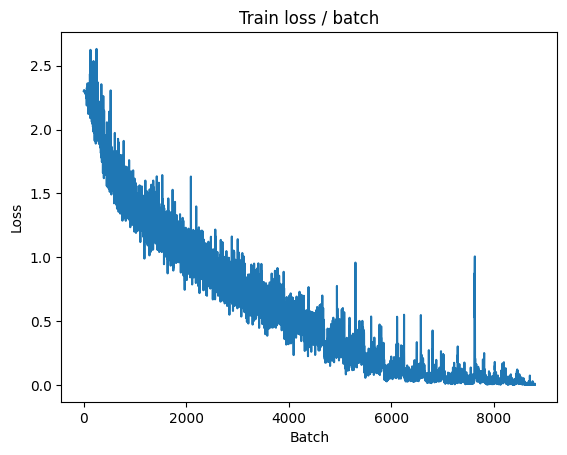


===============> Total time 10s	Avg loss 0.0064	Avg Prec@1 99.88 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 1.9651 (1.9651)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.8760	Avg Prec@1 72.52 %	Avg Prec@5 97.44 %



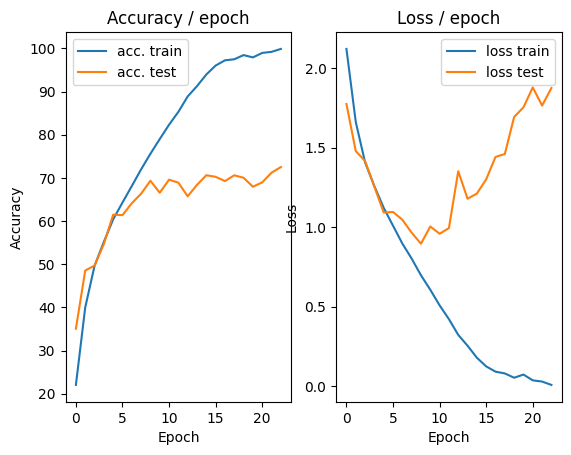

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.171s (0.171s)	Loss 0.0028 (0.0028)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


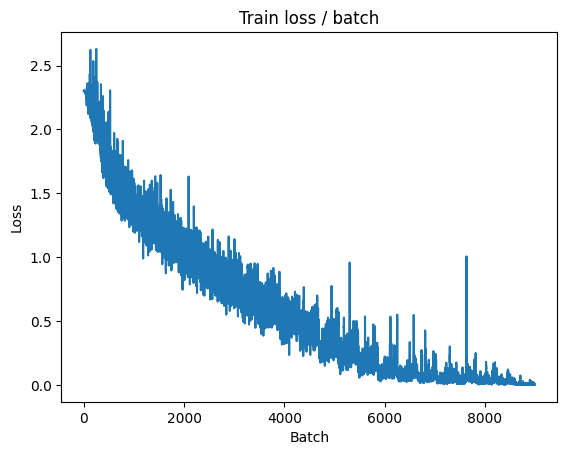

[TRAIN Batch 200/391]	Time 0.042s (0.035s)	Loss 0.0007 (0.0017)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


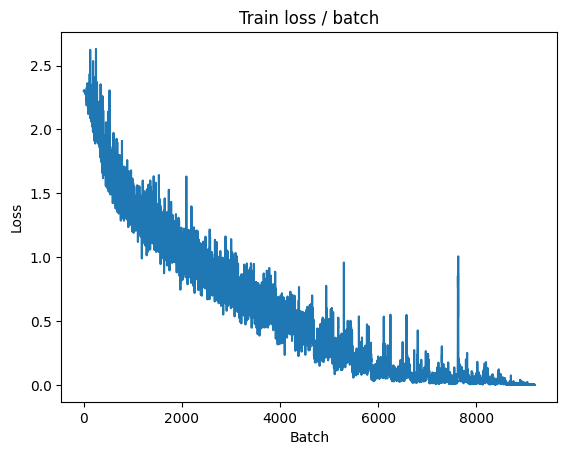


===============> Total time 11s	Avg loss 0.0015	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 1.9882 (1.9882)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.9449	Avg Prec@1 73.02 %	Avg Prec@5 97.46 %



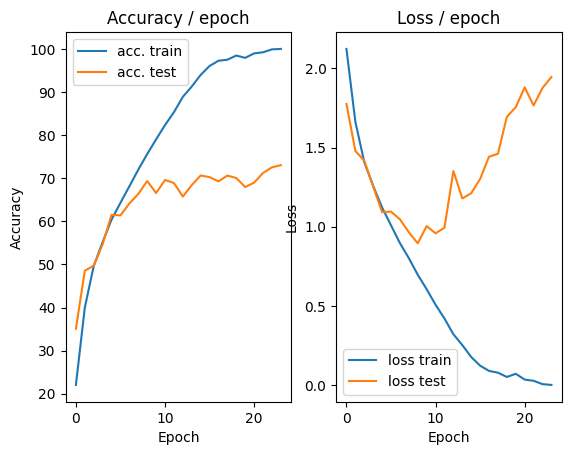

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.0006 (0.0006)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


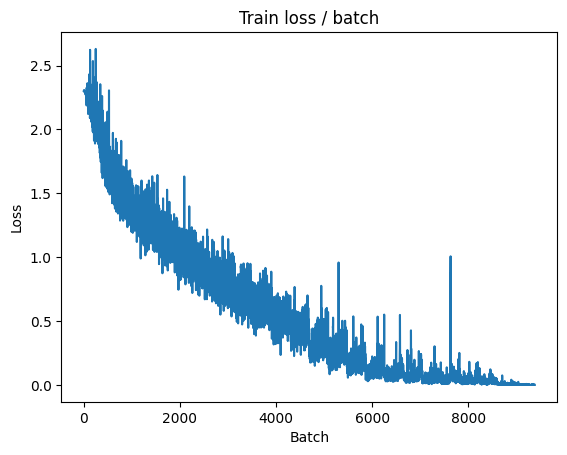

[TRAIN Batch 200/391]	Time 0.014s (0.029s)	Loss 0.0006 (0.0008)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


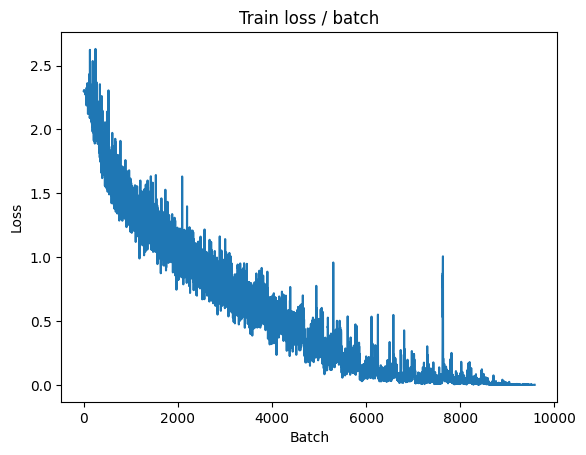


===============> Total time 10s	Avg loss 0.0007	Avg Prec@1 99.99 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 2.0410 (2.0410)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.0127	Avg Prec@1 73.09 %	Avg Prec@5 97.48 %



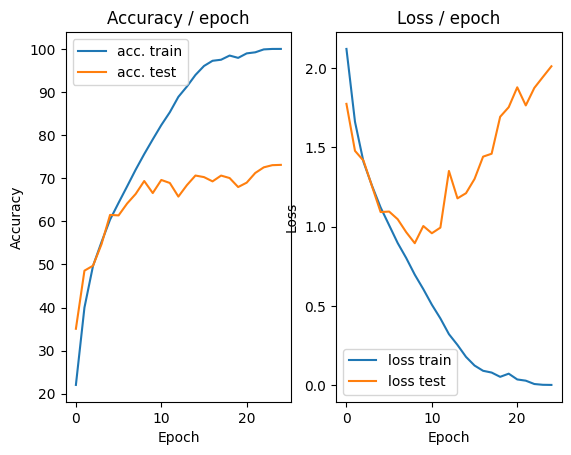

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


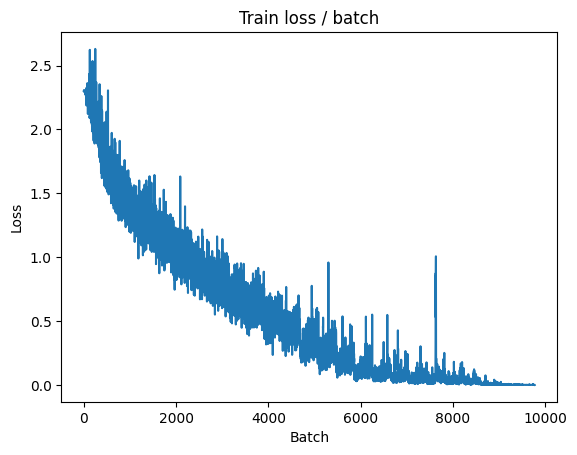

[TRAIN Batch 200/391]	Time 0.033s (0.029s)	Loss 0.0002 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


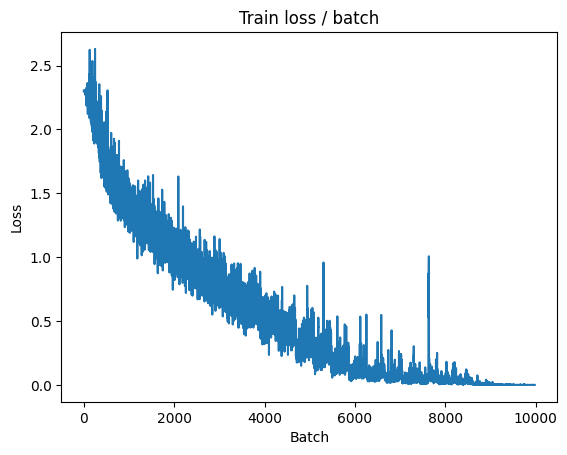


===============> Total time 10s	Avg loss 0.0004	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 2.1013 (2.1013)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.0528	Avg Prec@1 72.94 %	Avg Prec@5 97.49 %



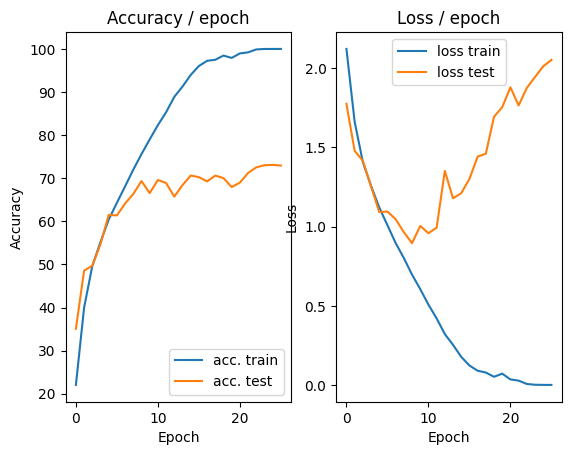

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 0.0005 (0.0005)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


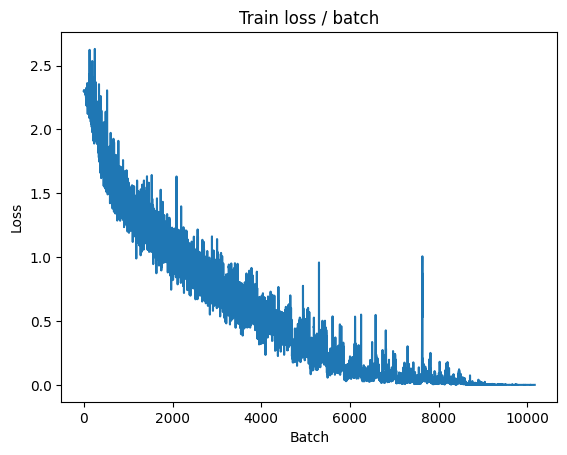

[TRAIN Batch 200/391]	Time 0.009s (0.028s)	Loss 0.0002 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


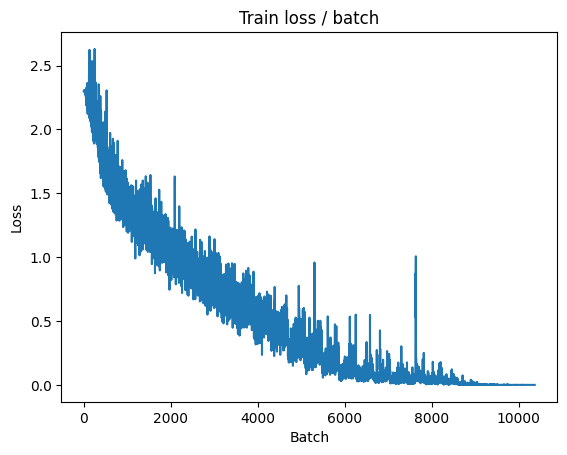


===============> Total time 9s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.127s (0.127s)	Loss 2.1426 (2.1426)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.0862	Avg Prec@1 72.87 %	Avg Prec@5 97.47 %



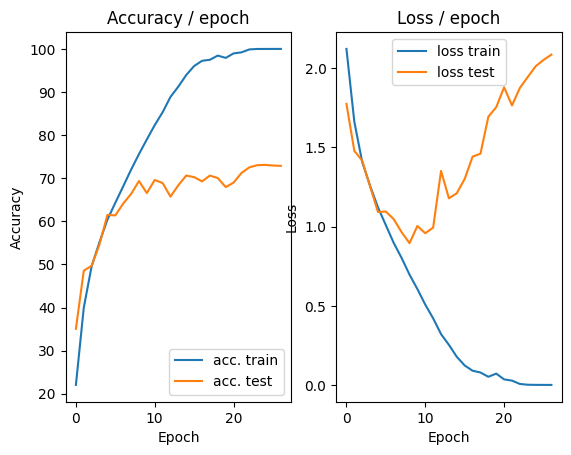

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.0004 (0.0004)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


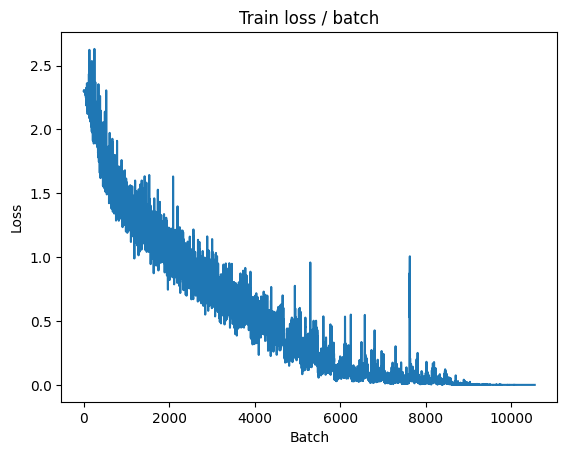

[TRAIN Batch 200/391]	Time 0.017s (0.025s)	Loss 0.0004 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


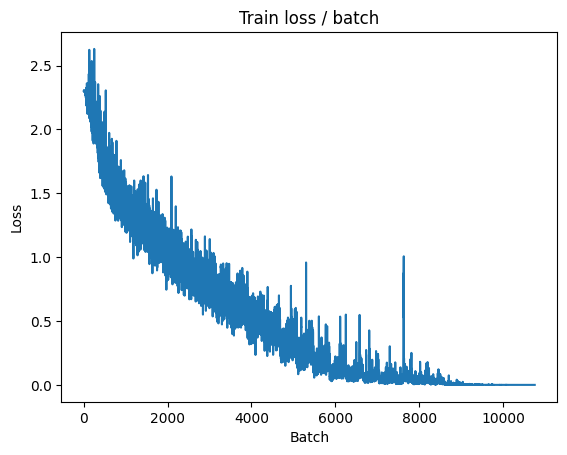


===============> Total time 10s	Avg loss 0.0003	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 2.1661 (2.1661)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.1158	Avg Prec@1 73.06 %	Avg Prec@5 97.52 %



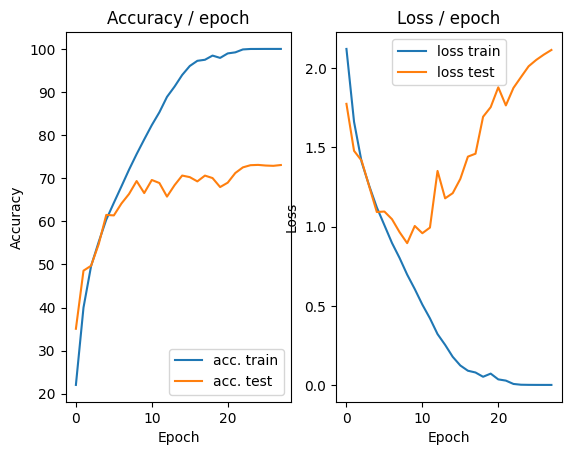

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.168s (0.168s)	Loss 0.0003 (0.0003)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


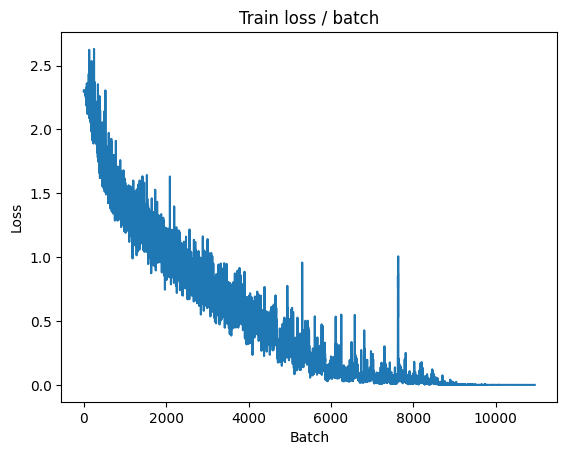

[TRAIN Batch 200/391]	Time 0.032s (0.023s)	Loss 0.0003 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


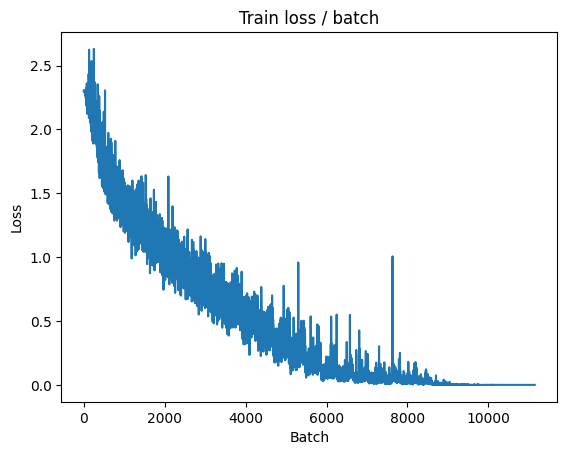


===============> Total time 10s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 2.1932 (2.1932)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.1386	Avg Prec@1 72.89 %	Avg Prec@5 97.50 %



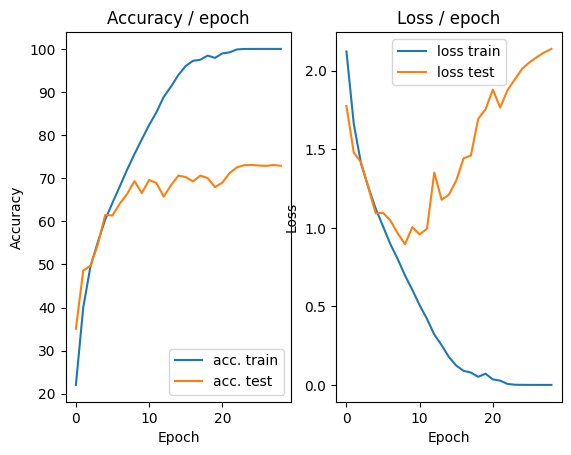

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.0002 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


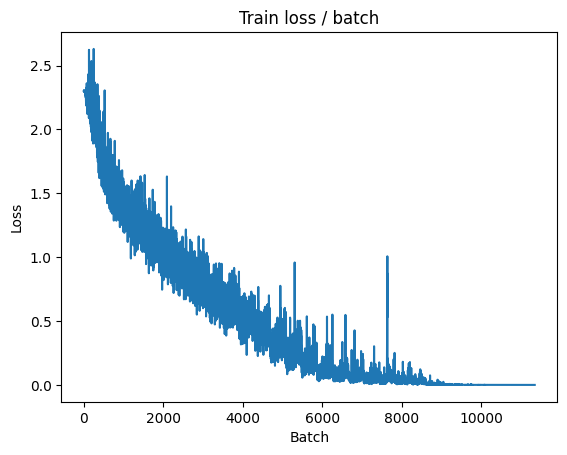

[TRAIN Batch 200/391]	Time 0.026s (0.023s)	Loss 0.0003 (0.0002)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


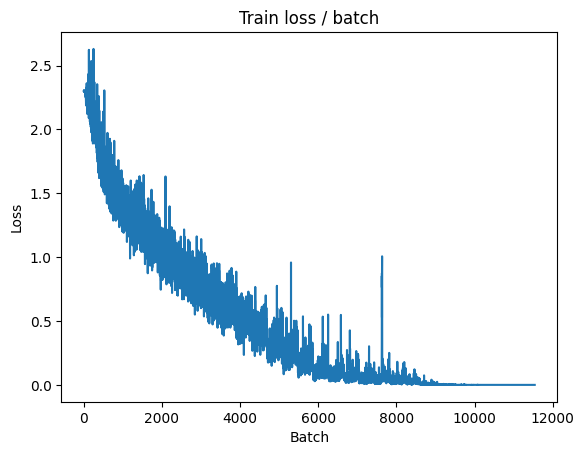


===============> Total time 9s	Avg loss 0.0002	Avg Prec@1 100.00 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 2.2113 (2.2113)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 2.1635	Avg Prec@1 72.94 %	Avg Prec@5 97.51 %



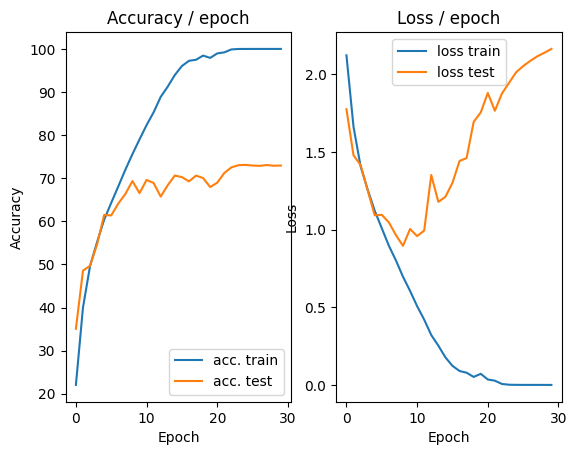

In [8]:
main(128, 0.1,30, cuda=True)

#3)Results Improvment

##Standardization of examples

In [8]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201))
        ]))

    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201))
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


100%|██████████| 170498071/170498071 [00:01<00:00, 105751424.25it/s]


Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.616s (2.616s)	Loss 2.3059 (2.3059)	Prec@1   5.5 (  5.5)	Prec@5  48.4 ( 48.4)


<Figure size 640x480 with 0 Axes>

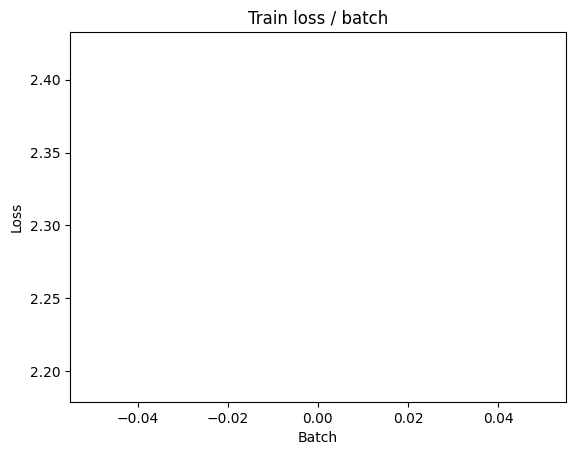

[TRAIN Batch 200/391]	Time 0.080s (0.050s)	Loss 1.7921 (1.9568)	Prec@1  42.2 ( 28.5)	Prec@5  88.3 ( 78.9)


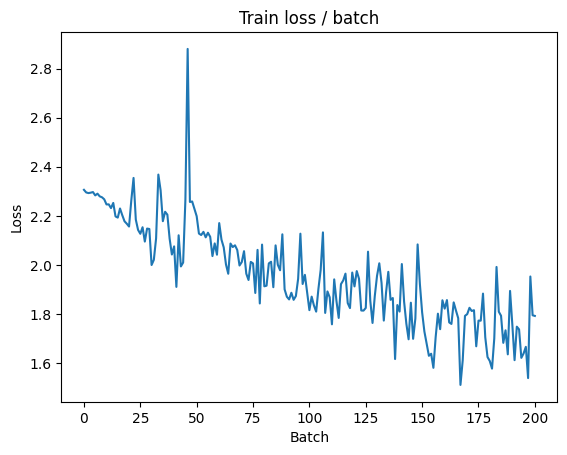


===============> Total time 16s	Avg loss 1.7579	Avg Prec@1 36.17 %	Avg Prec@5 84.75 %

[EVAL Batch 000/079]	Time 0.123s (0.123s)	Loss 1.4497 (1.4497)	Prec@1  52.3 ( 52.3)	Prec@5  91.4 ( 91.4)

===============> Total time 2s	Avg loss 1.5005	Avg Prec@1 45.67 %	Avg Prec@5 91.52 %



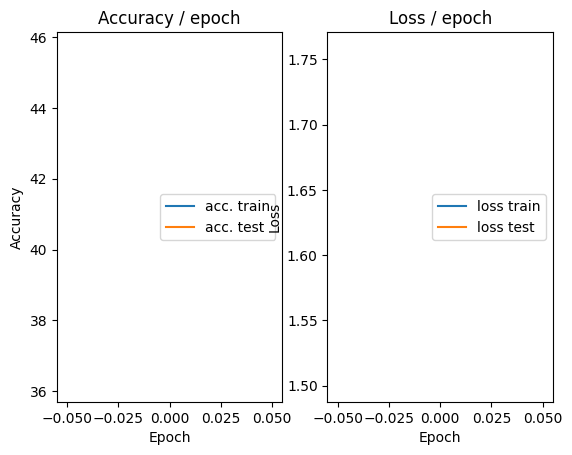

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 1.4658 (1.4658)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)


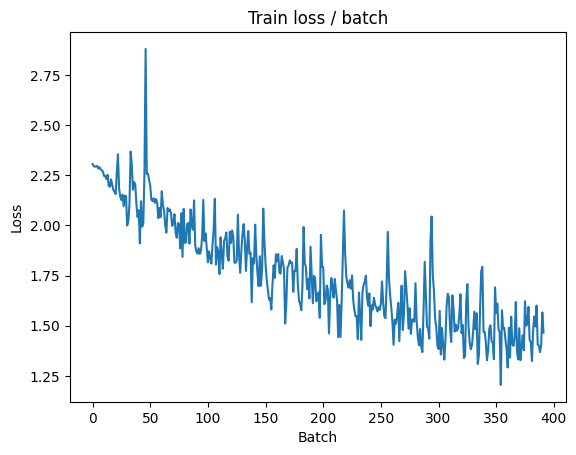

[TRAIN Batch 200/391]	Time 0.042s (0.040s)	Loss 1.2863 (1.3582)	Prec@1  51.6 ( 51.4)	Prec@5  95.3 ( 93.6)


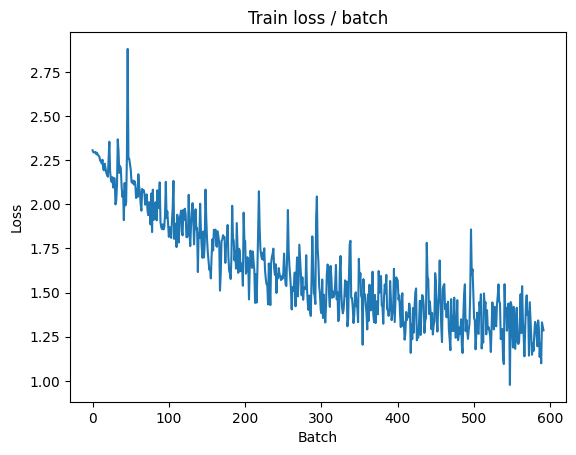


===============> Total time 14s	Avg loss 1.2905	Avg Prec@1 54.27 %	Avg Prec@5 94.41 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.2314 (1.2314)	Prec@1  56.2 ( 56.2)	Prec@5  93.0 ( 93.0)

===============> Total time 3s	Avg loss 1.2876	Avg Prec@1 53.56 %	Avg Prec@5 94.56 %



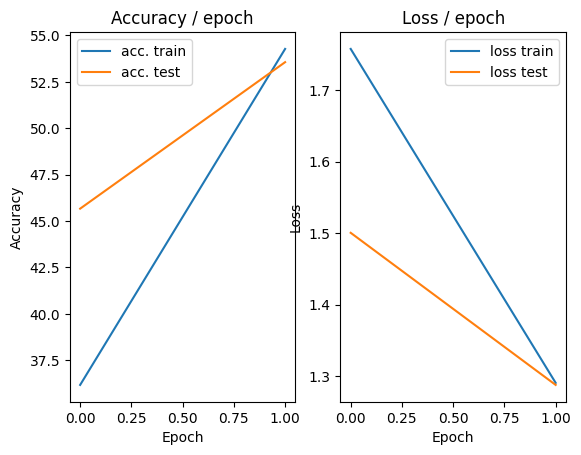

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 1.3346 (1.3346)	Prec@1  52.3 ( 52.3)	Prec@5  94.5 ( 94.5)


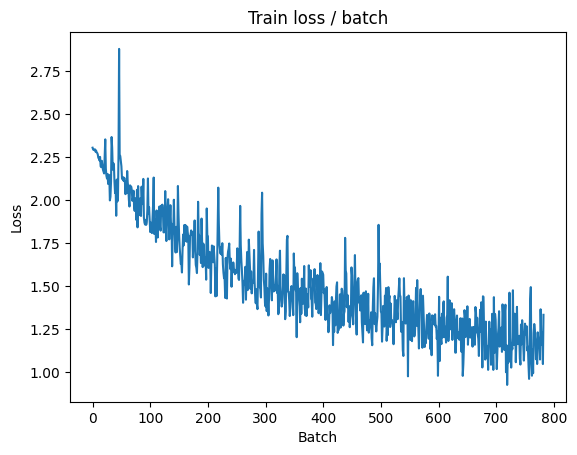

[TRAIN Batch 200/391]	Time 0.010s (0.035s)	Loss 0.9253 (1.0889)	Prec@1  71.9 ( 61.9)	Prec@5  96.1 ( 96.1)


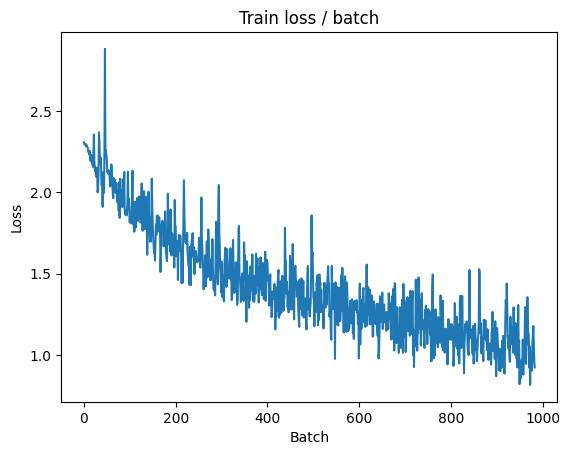


===============> Total time 14s	Avg loss 1.0469	Avg Prec@1 63.35 %	Avg Prec@5 96.37 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 0.9502 (0.9502)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.0009	Avg Prec@1 65.16 %	Avg Prec@5 96.88 %



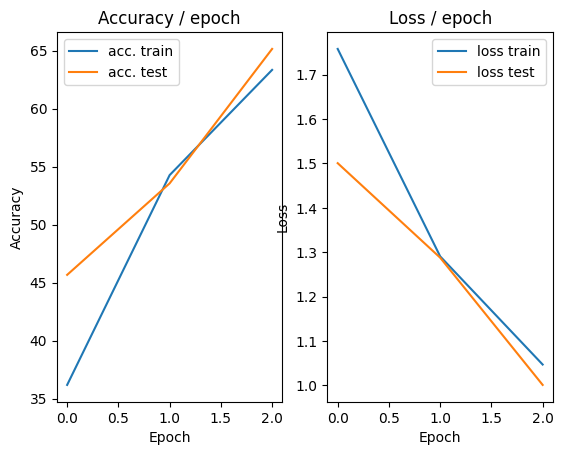

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.8243 (0.8243)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)


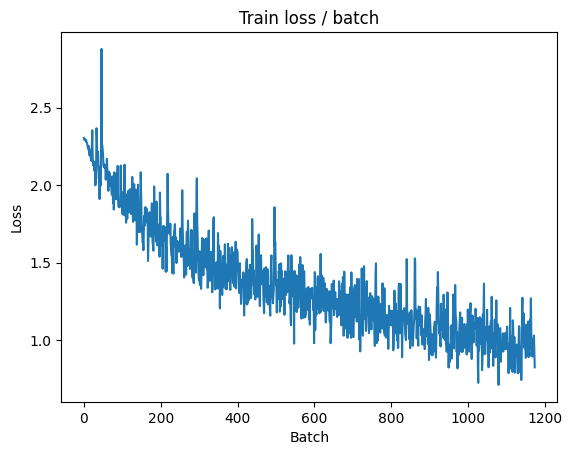

[TRAIN Batch 200/391]	Time 0.064s (0.043s)	Loss 0.7368 (0.8830)	Prec@1  70.3 ( 69.4)	Prec@5 100.0 ( 97.6)


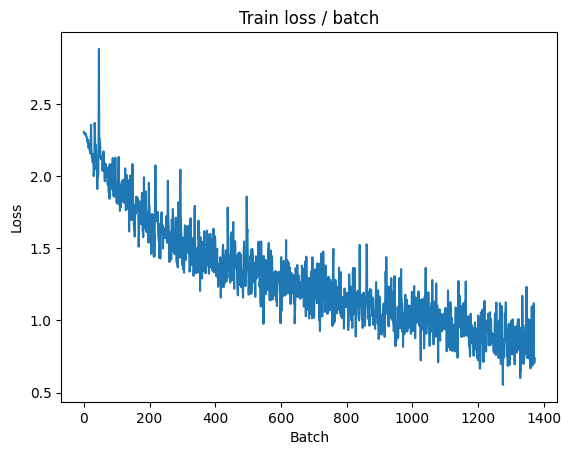


===============> Total time 15s	Avg loss 0.8666	Avg Prec@1 69.97 %	Avg Prec@5 97.74 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.9543 (0.9543)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.0173	Avg Prec@1 64.89 %	Avg Prec@5 97.07 %



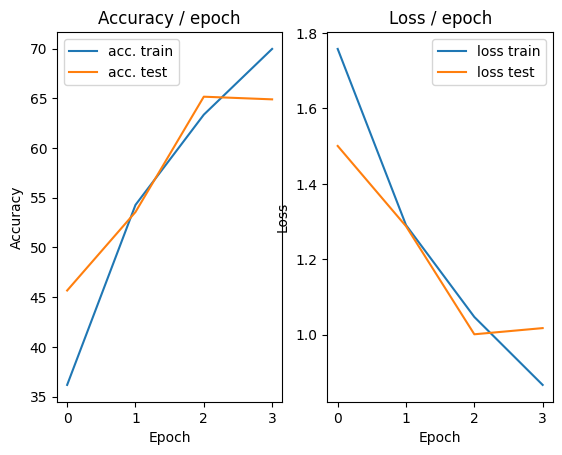

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.7746 (0.7746)	Prec@1  69.5 ( 69.5)	Prec@5 100.0 (100.0)


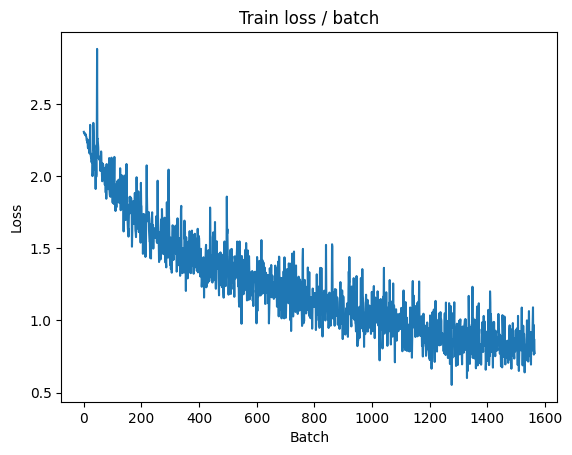

[TRAIN Batch 200/391]	Time 0.064s (0.038s)	Loss 0.6241 (0.7342)	Prec@1  77.3 ( 74.3)	Prec@5 100.0 ( 98.3)


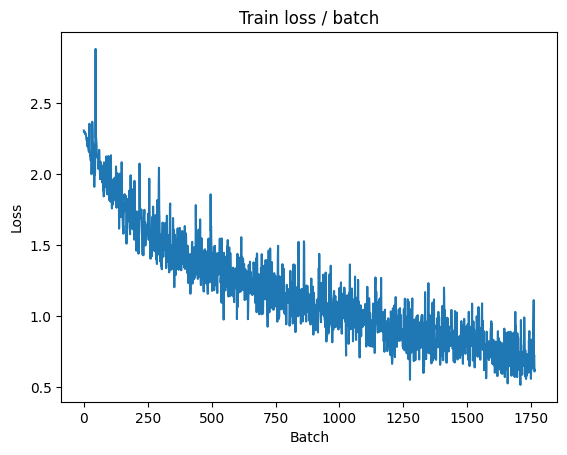


===============> Total time 15s	Avg loss 0.7260	Avg Prec@1 74.80 %	Avg Prec@5 98.33 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.7714 (0.7714)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8715	Avg Prec@1 70.73 %	Avg Prec@5 97.16 %



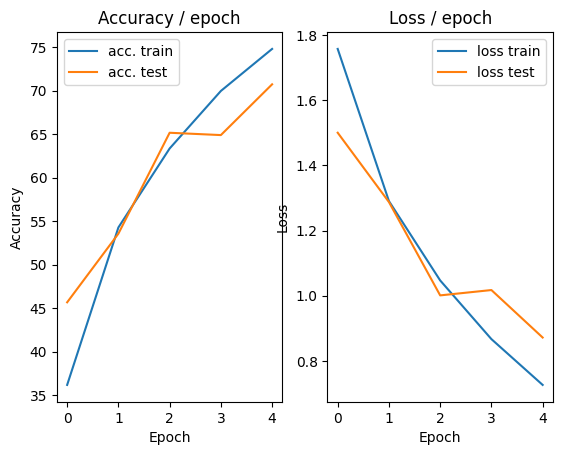

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.149s (0.149s)	Loss 0.6844 (0.6844)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


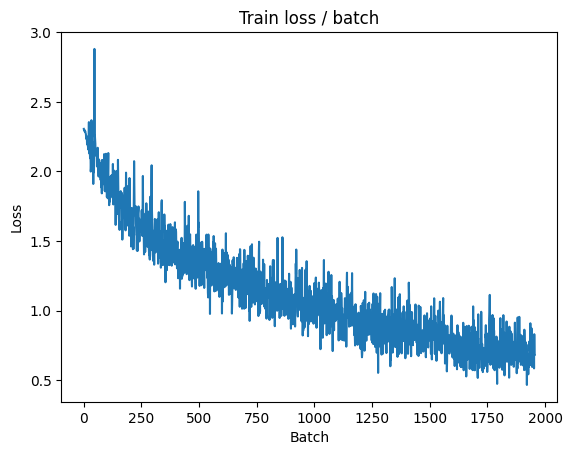

[TRAIN Batch 200/391]	Time 0.098s (0.036s)	Loss 0.5012 (0.5887)	Prec@1  82.0 ( 79.6)	Prec@5  99.2 ( 99.0)


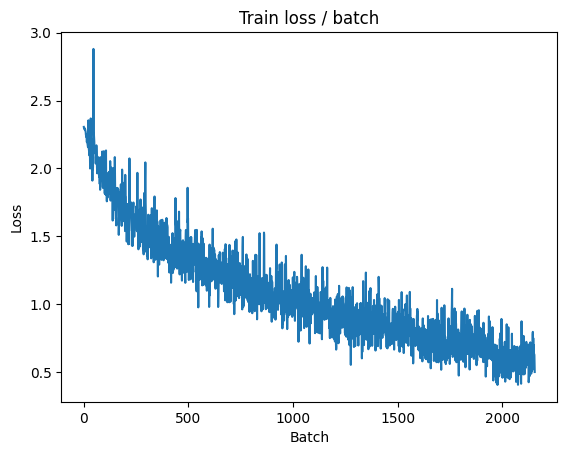


===============> Total time 14s	Avg loss 0.6002	Avg Prec@1 79.11 %	Avg Prec@5 98.99 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.7362 (0.7362)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8619	Avg Prec@1 70.39 %	Avg Prec@5 97.93 %



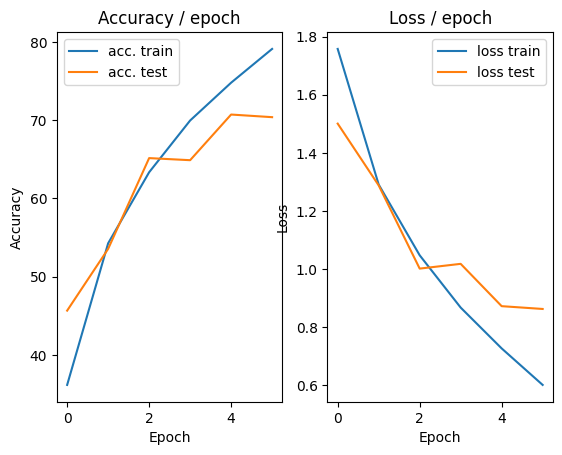

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.160s (0.160s)	Loss 0.5443 (0.5443)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


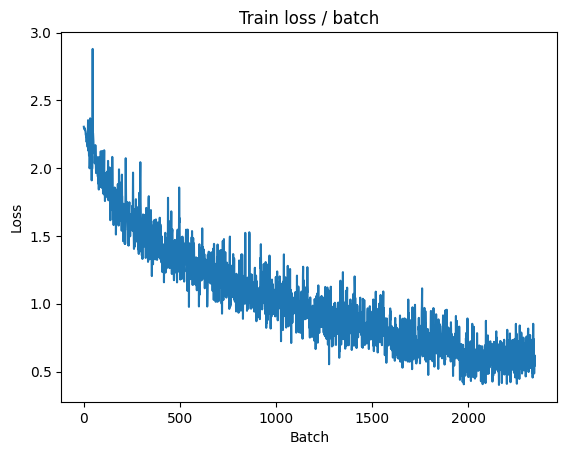

[TRAIN Batch 200/391]	Time 0.022s (0.039s)	Loss 0.6221 (0.4737)	Prec@1  77.3 ( 83.4)	Prec@5 100.0 ( 99.4)


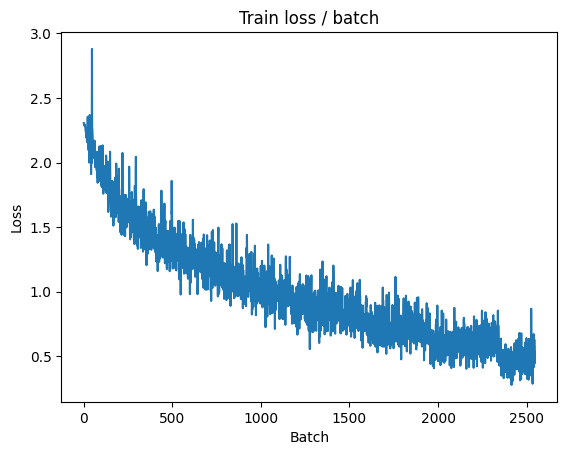


===============> Total time 14s	Avg loss 0.4896	Avg Prec@1 82.71 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8501 (0.8501)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8978	Avg Prec@1 71.27 %	Avg Prec@5 97.81 %



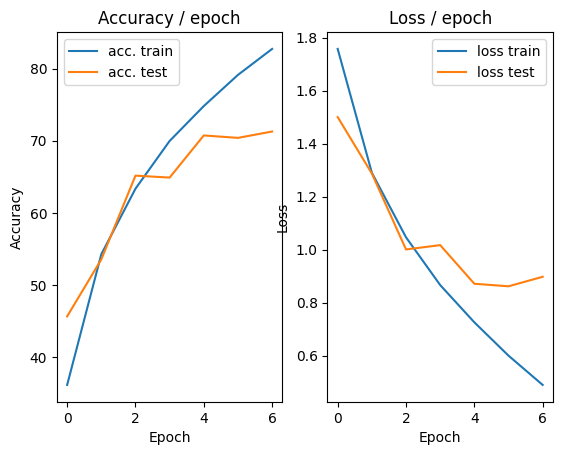

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.158s (0.158s)	Loss 0.3656 (0.3656)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


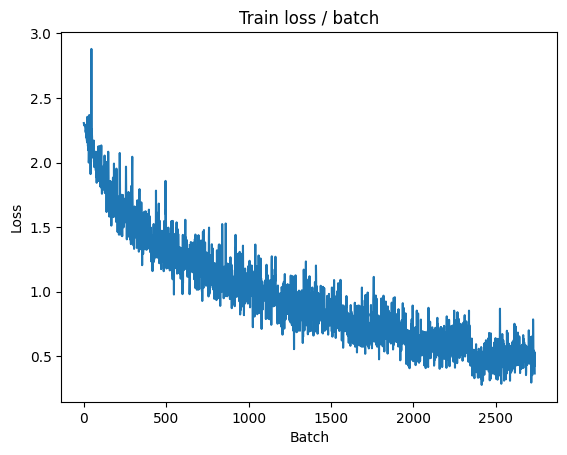

[TRAIN Batch 200/391]	Time 0.054s (0.034s)	Loss 0.3846 (0.3810)	Prec@1  87.5 ( 86.7)	Prec@5  99.2 ( 99.7)


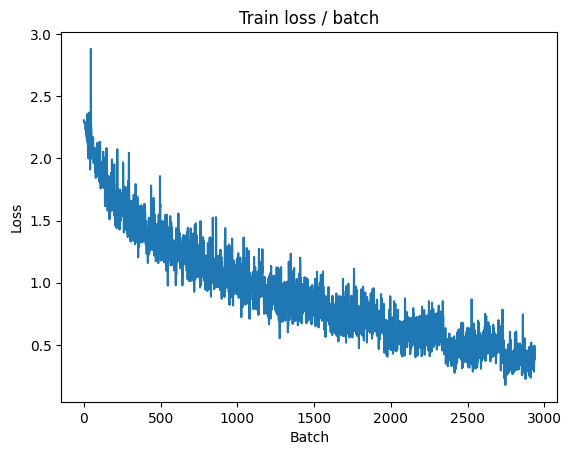


===============> Total time 14s	Avg loss 0.3898	Avg Prec@1 86.50 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.8030 (0.8030)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 0.8667	Avg Prec@1 73.04 %	Avg Prec@5 97.97 %



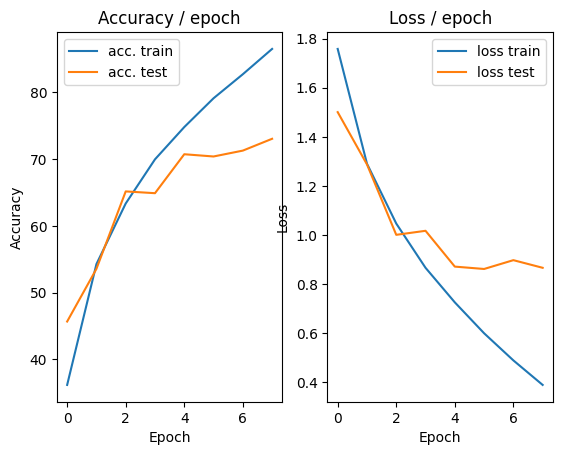

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.157s (0.157s)	Loss 0.2762 (0.2762)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


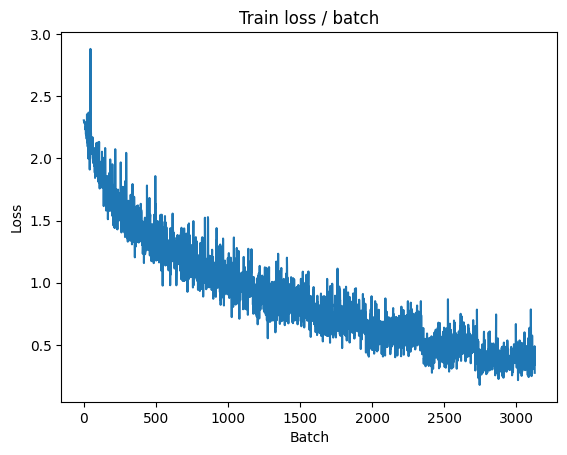

[TRAIN Batch 200/391]	Time 0.010s (0.038s)	Loss 0.3435 (0.2703)	Prec@1  86.7 ( 90.8)	Prec@5 100.0 ( 99.9)


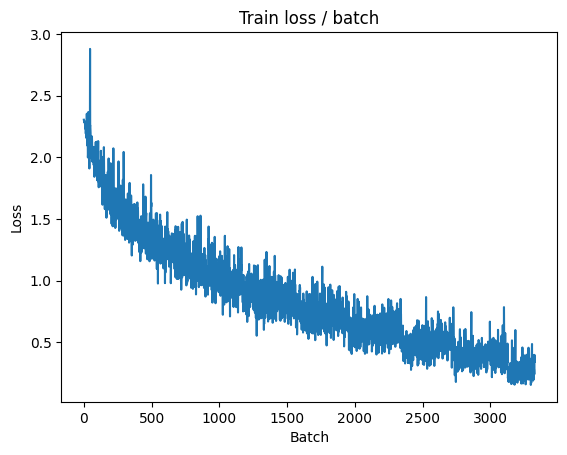


===============> Total time 14s	Avg loss 0.2895	Avg Prec@1 89.96 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 0.9368 (0.9368)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9589	Avg Prec@1 72.91 %	Avg Prec@5 97.80 %



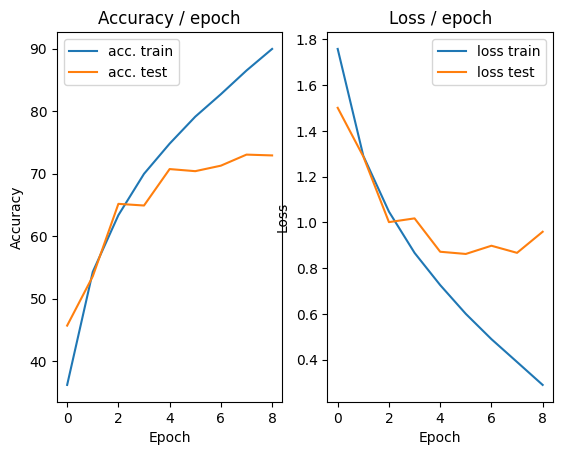

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.1987 (0.1987)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


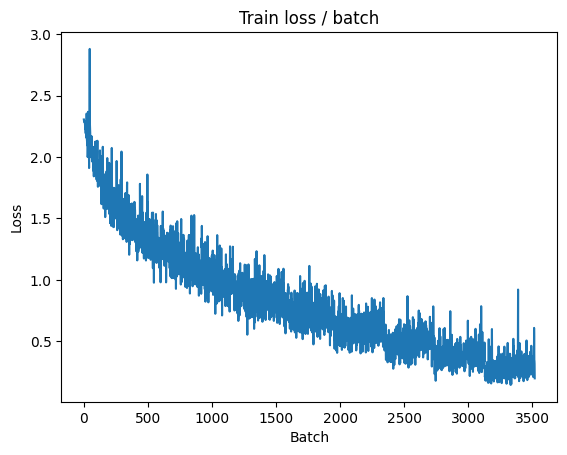

[TRAIN Batch 200/391]	Time 0.040s (0.040s)	Loss 0.1956 (0.1837)	Prec@1  93.0 ( 93.6)	Prec@5 100.0 (100.0)


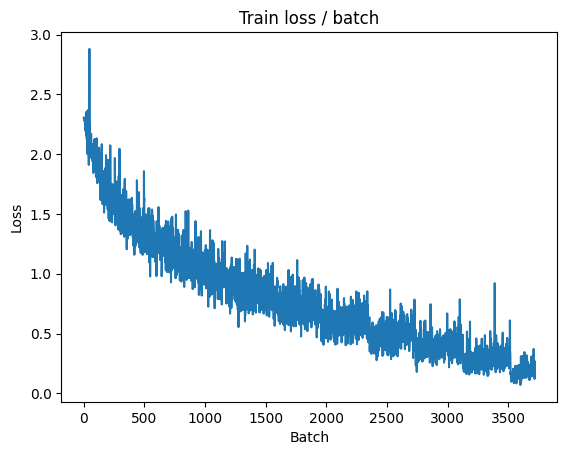


===============> Total time 14s	Avg loss 0.2073	Avg Prec@1 92.70 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 1.1006 (1.1006)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 1.1726	Avg Prec@1 71.06 %	Avg Prec@5 97.41 %



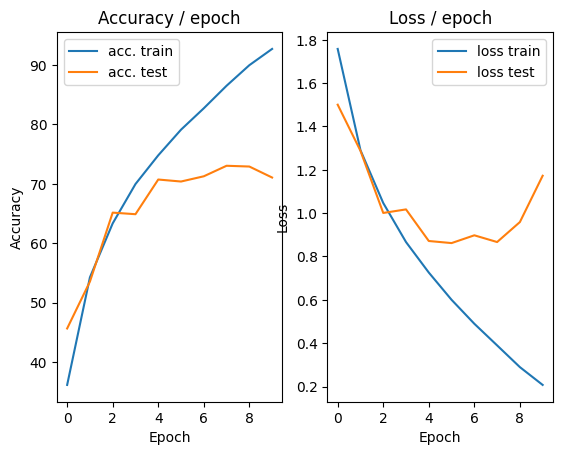

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.165s (0.165s)	Loss 0.1862 (0.1862)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


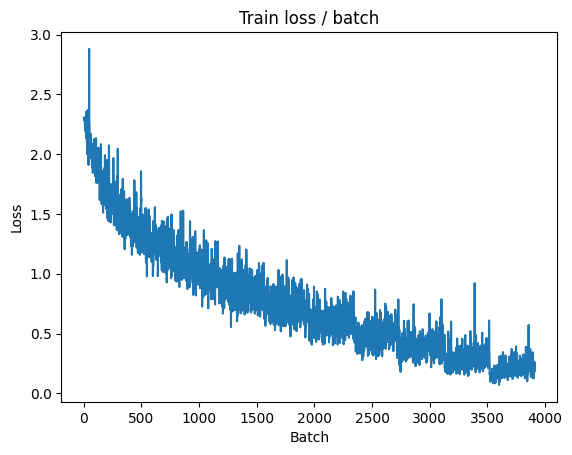

[TRAIN Batch 200/391]	Time 0.020s (0.034s)	Loss 0.2265 (0.1197)	Prec@1  93.8 ( 96.1)	Prec@5 100.0 (100.0)


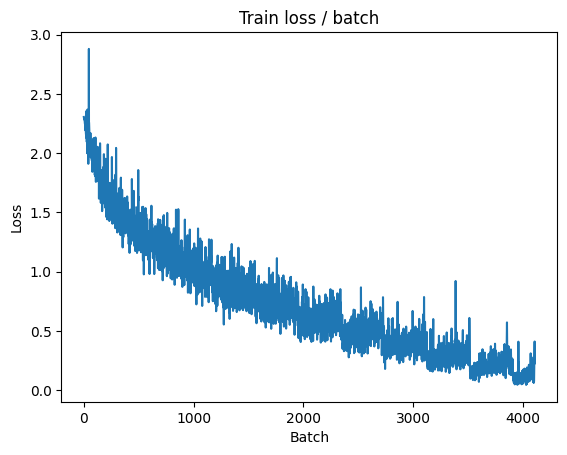


===============> Total time 14s	Avg loss 0.1385	Avg Prec@1 95.30 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.3344 (1.3344)	Prec@1  71.1 ( 71.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 1.4215	Avg Prec@1 69.78 %	Avg Prec@5 97.21 %



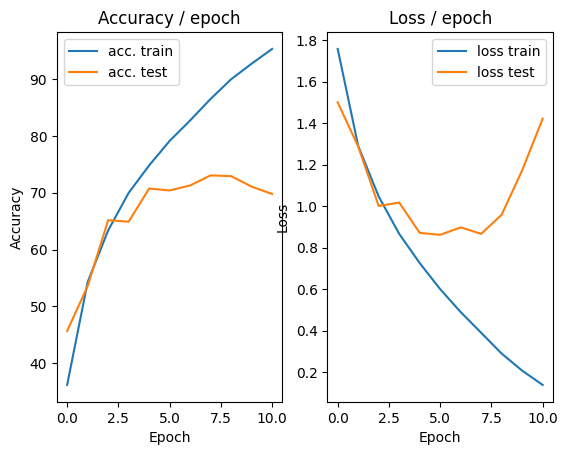

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.162s (0.162s)	Loss 0.3231 (0.3231)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


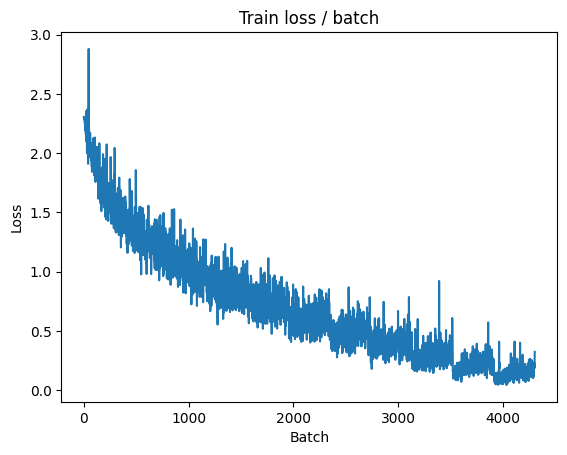

[TRAIN Batch 200/391]	Time 0.058s (0.039s)	Loss 1.2732 (0.1111)	Prec@1  73.4 ( 96.8)	Prec@5  98.4 (100.0)


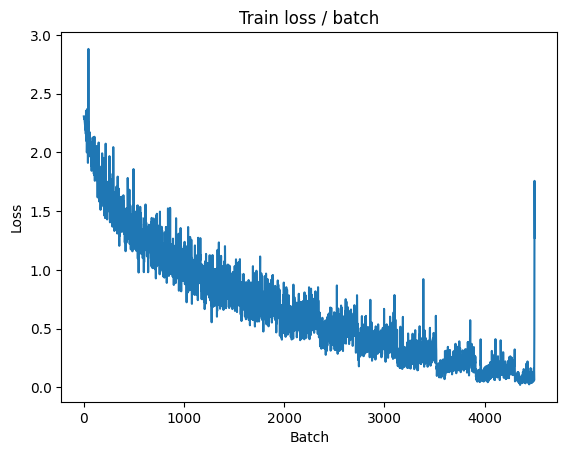


===============> Total time 14s	Avg loss 0.1299	Avg Prec@1 95.87 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 1.3781 (1.3781)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.2789	Avg Prec@1 72.92 %	Avg Prec@5 97.49 %



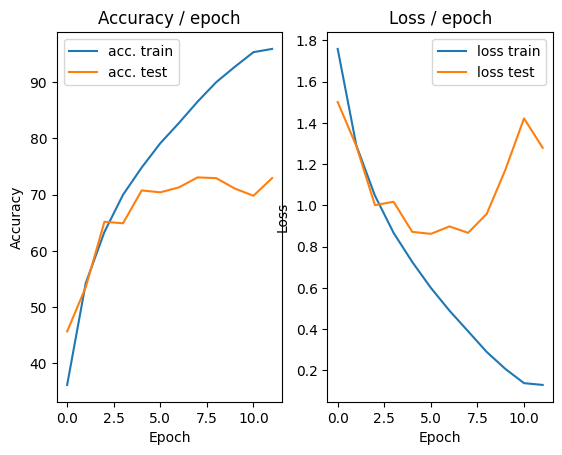

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.276s (0.276s)	Loss 0.0767 (0.0767)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


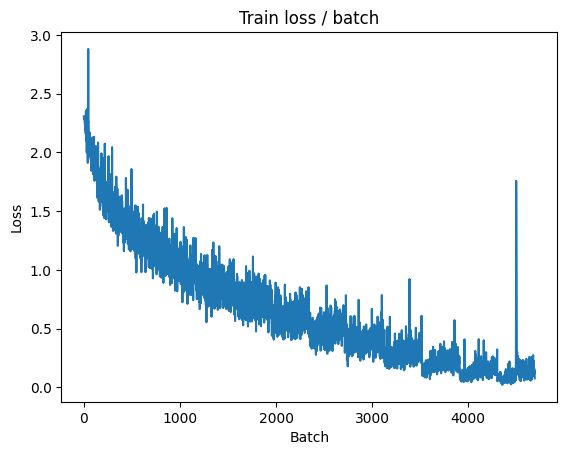

[TRAIN Batch 200/391]	Time 0.014s (0.040s)	Loss 0.1575 (0.0742)	Prec@1  95.3 ( 97.8)	Prec@5 100.0 (100.0)


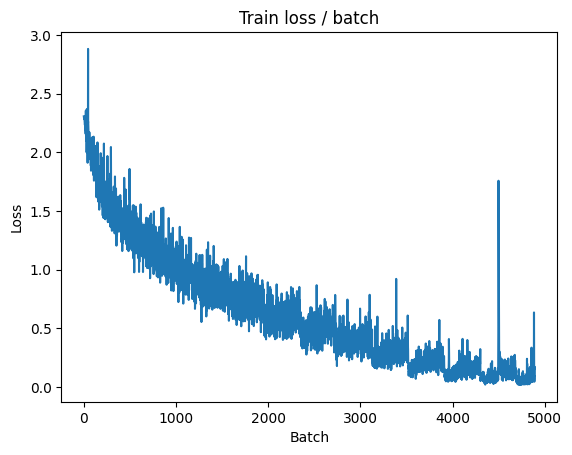


===============> Total time 15s	Avg loss 0.0830	Avg Prec@1 97.39 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 1.3768 (1.3768)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.2702	Avg Prec@1 74.19 %	Avg Prec@5 97.77 %



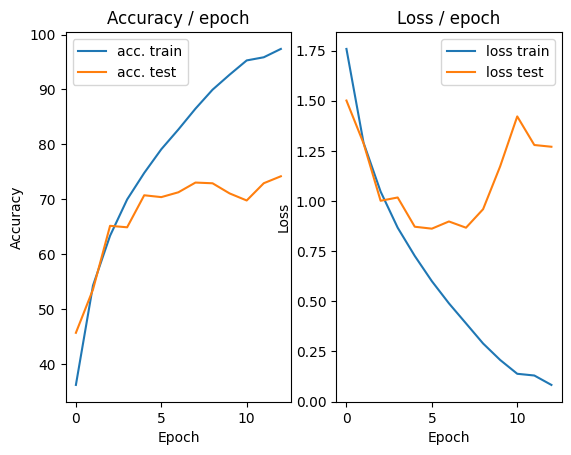

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.161s (0.161s)	Loss 0.0412 (0.0412)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


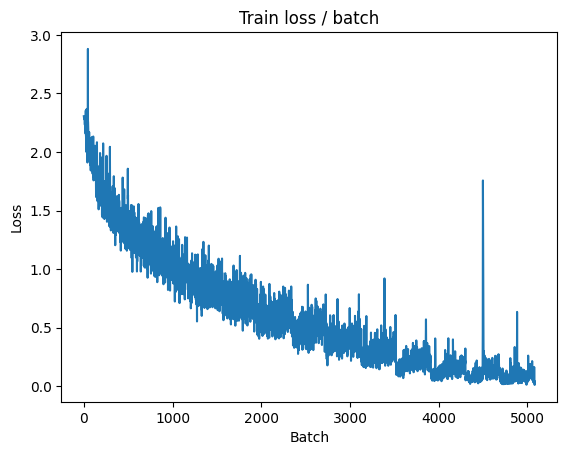

[TRAIN Batch 200/391]	Time 0.048s (0.034s)	Loss 0.0251 (0.0428)	Prec@1  99.2 ( 98.7)	Prec@5 100.0 (100.0)


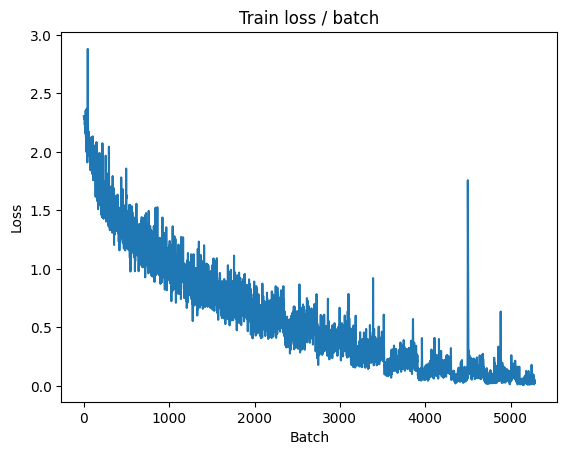


===============> Total time 14s	Avg loss 0.0561	Avg Prec@1 98.21 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.4370 (1.4370)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.4096	Avg Prec@1 73.83 %	Avg Prec@5 97.75 %



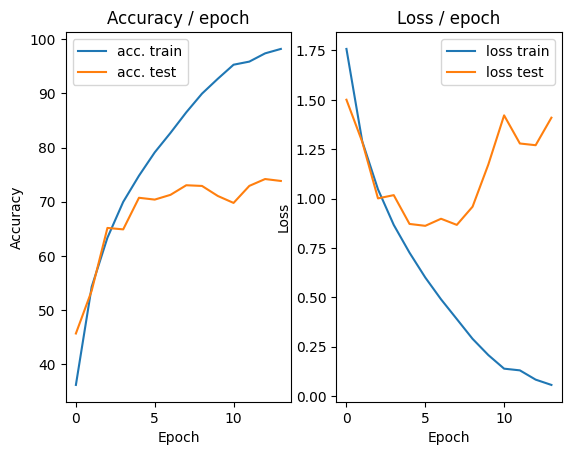

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.166s (0.166s)	Loss 0.0451 (0.0451)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


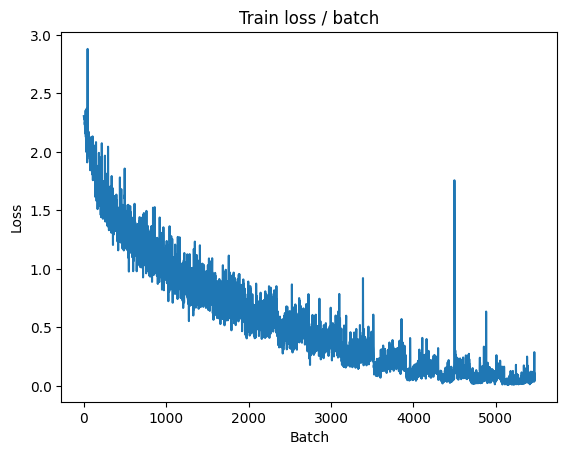

[TRAIN Batch 200/391]	Time 0.020s (0.040s)	Loss 0.0289 (0.0499)	Prec@1  99.2 ( 98.4)	Prec@5 100.0 (100.0)


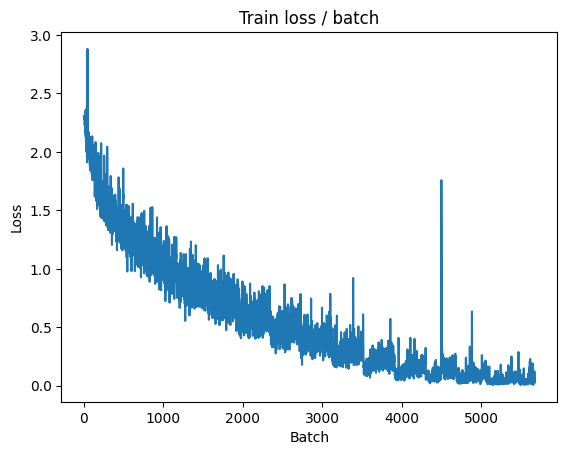


===============> Total time 14s	Avg loss 0.0632	Avg Prec@1 97.93 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.6315 (1.6315)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.4805	Avg Prec@1 72.99 %	Avg Prec@5 97.35 %



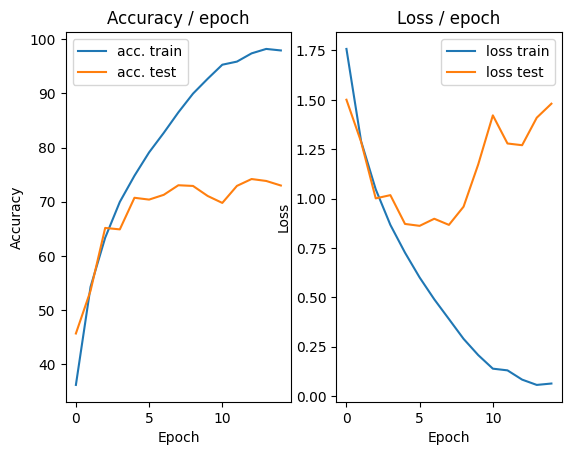

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.225s (0.225s)	Loss 0.0661 (0.0661)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


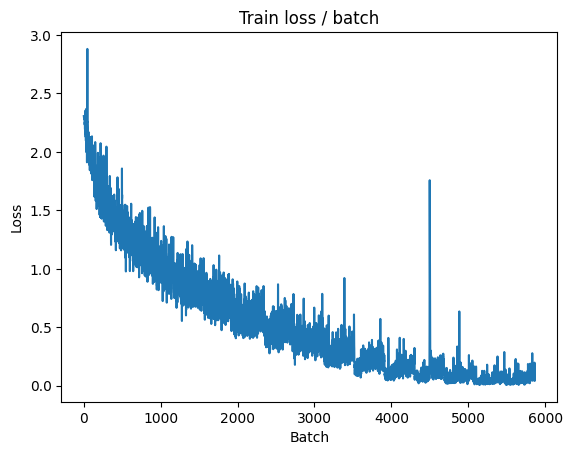

[TRAIN Batch 200/391]	Time 0.016s (0.037s)	Loss 0.1261 (0.0413)	Prec@1  96.1 ( 98.7)	Prec@5 100.0 (100.0)


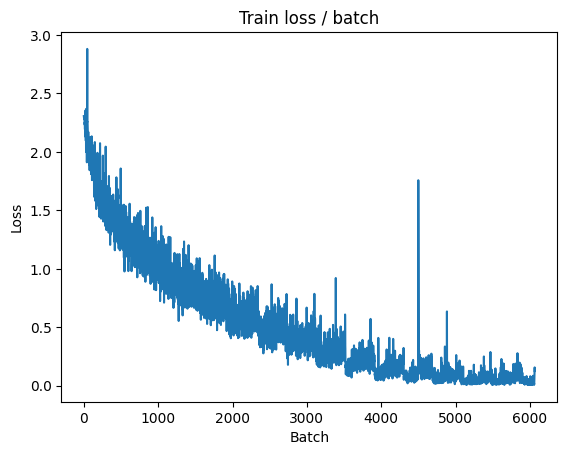


===============> Total time 14s	Avg loss 0.0547	Avg Prec@1 98.25 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.8526 (1.8526)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.5936	Avg Prec@1 72.74 %	Avg Prec@5 97.42 %



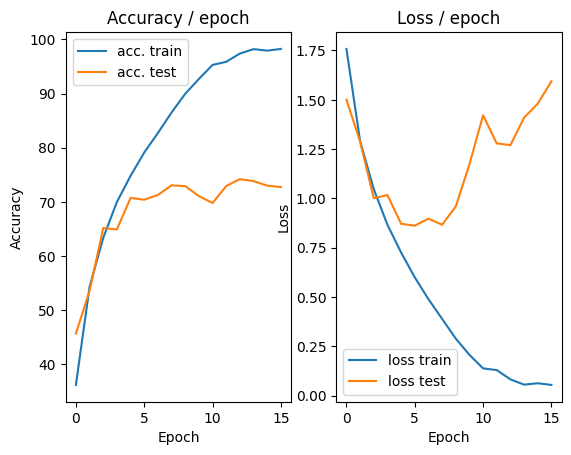

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.0711 (0.0711)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


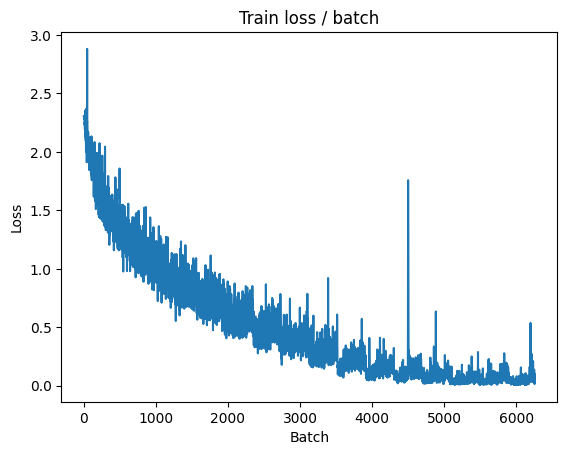

[TRAIN Batch 200/391]	Time 0.090s (0.039s)	Loss 0.1147 (0.0494)	Prec@1  97.7 ( 98.5)	Prec@5 100.0 (100.0)


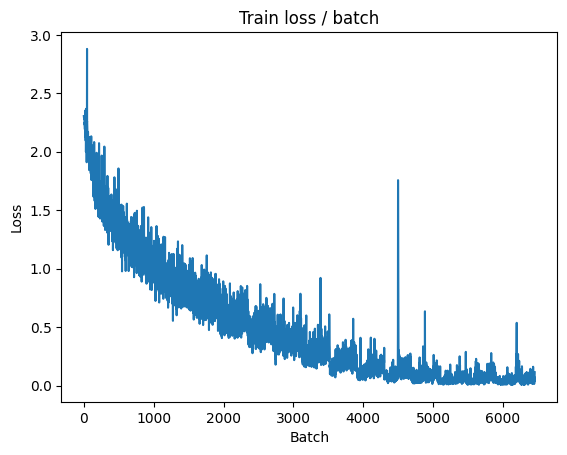


===============> Total time 14s	Avg loss 0.0588	Avg Prec@1 98.13 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.6992 (1.6992)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.5371	Avg Prec@1 73.37 %	Avg Prec@5 97.87 %



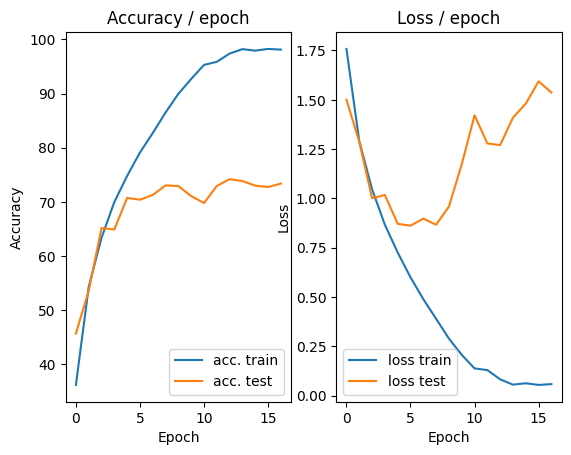

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.1270 (0.1270)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


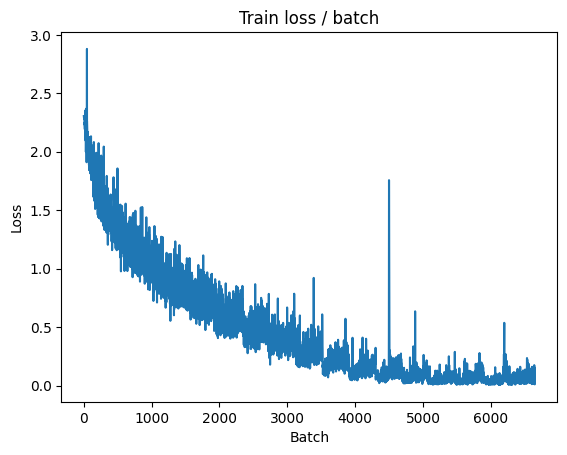

[TRAIN Batch 200/391]	Time 0.012s (0.040s)	Loss 0.0272 (0.0630)	Prec@1  99.2 ( 98.0)	Prec@5 100.0 (100.0)


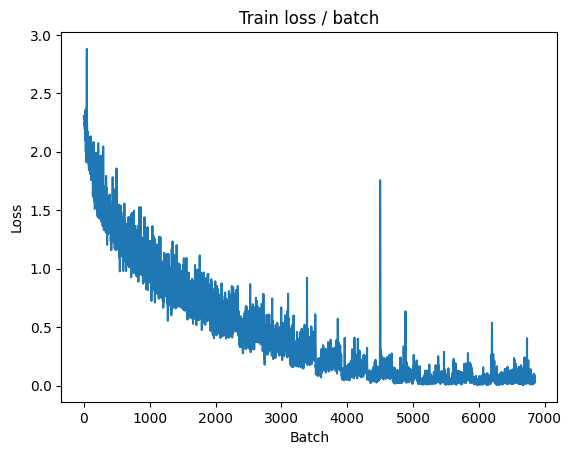


===============> Total time 15s	Avg loss 0.0594	Avg Prec@1 98.12 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.188s (0.188s)	Loss 1.8570 (1.8570)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.5804	Avg Prec@1 73.70 %	Avg Prec@5 97.52 %



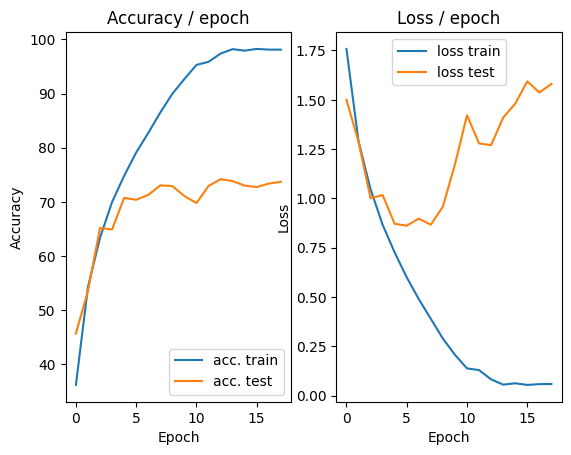

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.0423 (0.0423)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


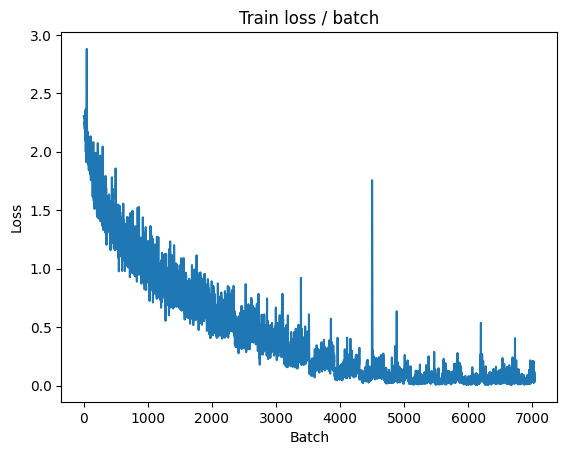

[TRAIN Batch 200/391]	Time 0.042s (0.035s)	Loss 0.0176 (0.0410)	Prec@1  99.2 ( 98.6)	Prec@5 100.0 (100.0)


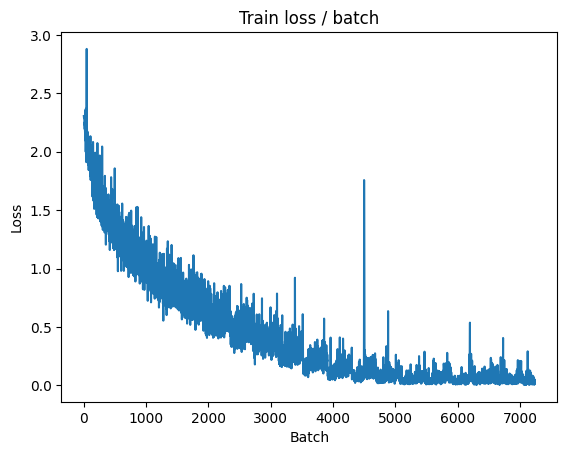


===============> Total time 14s	Avg loss 0.0520	Avg Prec@1 98.31 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.6810 (1.6810)	Prec@1  77.3 ( 77.3)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.6002	Avg Prec@1 74.51 %	Avg Prec@5 97.59 %



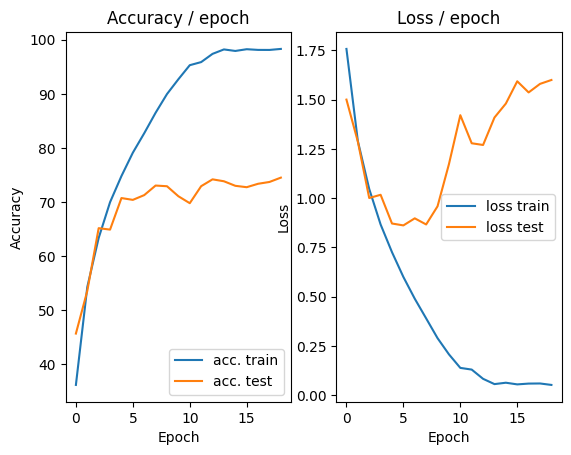

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.0103 (0.0103)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


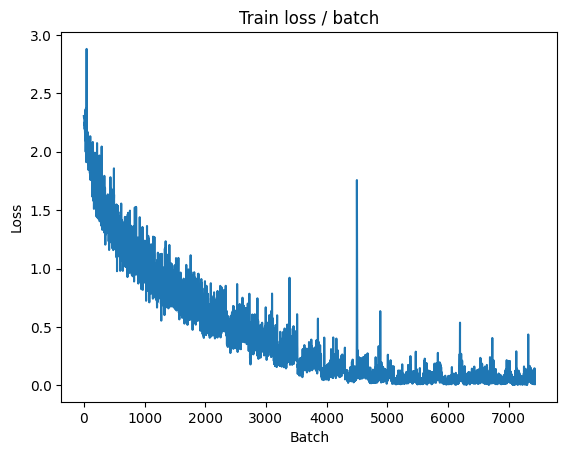

[TRAIN Batch 200/391]	Time 0.062s (0.040s)	Loss 0.0049 (0.0209)	Prec@1 100.0 ( 99.4)	Prec@5 100.0 (100.0)


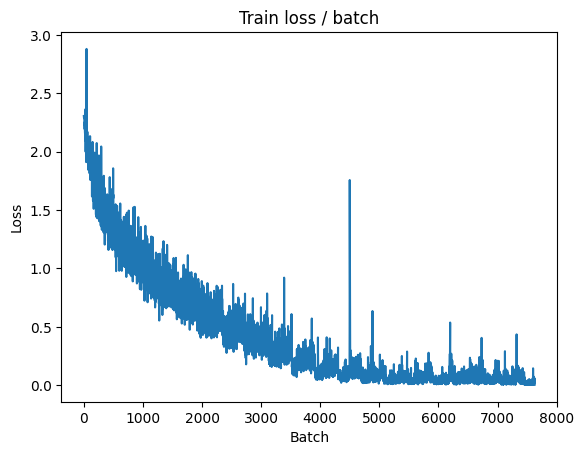


===============> Total time 14s	Avg loss 0.0373	Avg Prec@1 98.87 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.9911 (1.9911)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.6933	Avg Prec@1 73.22 %	Avg Prec@5 97.63 %



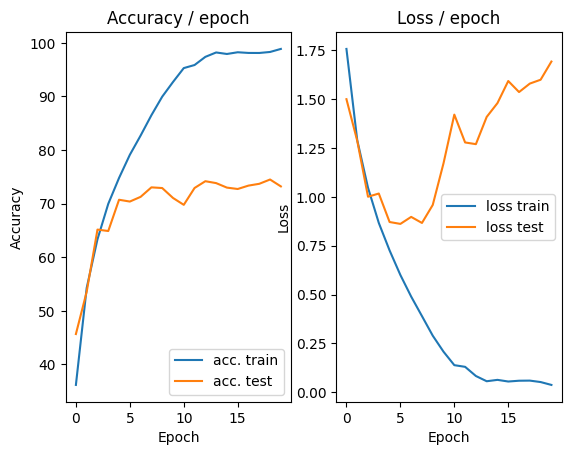

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.229s (0.229s)	Loss 0.0611 (0.0611)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


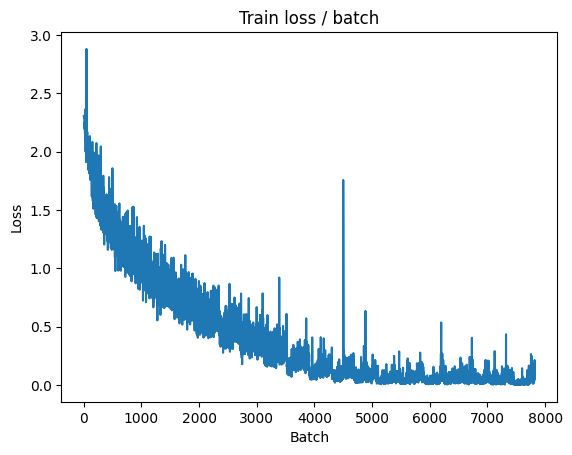

[TRAIN Batch 200/391]	Time 0.041s (0.036s)	Loss 0.0257 (0.0233)	Prec@1  99.2 ( 99.3)	Prec@5 100.0 (100.0)


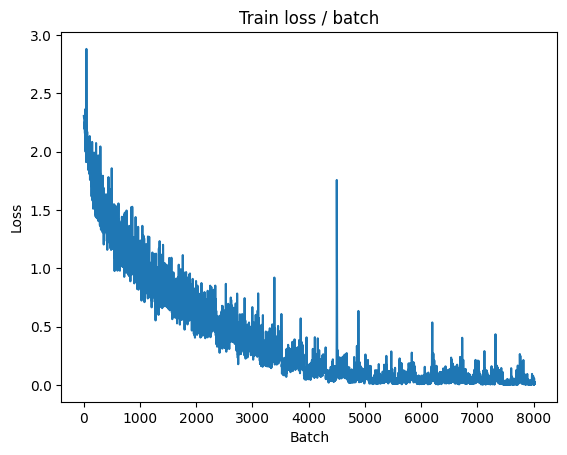


===============> Total time 14s	Avg loss 0.0370	Avg Prec@1 98.89 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.9435 (1.9435)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.7400	Avg Prec@1 73.24 %	Avg Prec@5 97.63 %



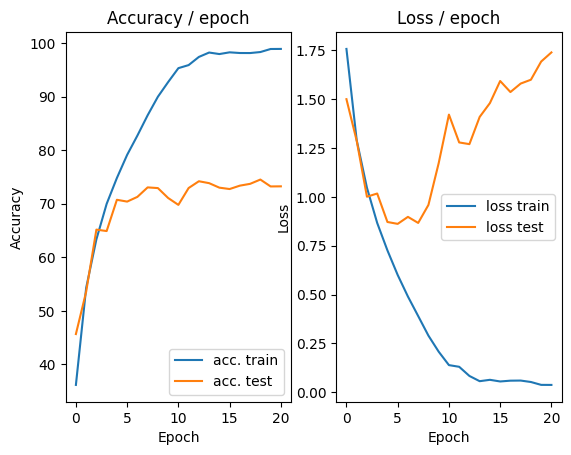

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.0092 (0.0092)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


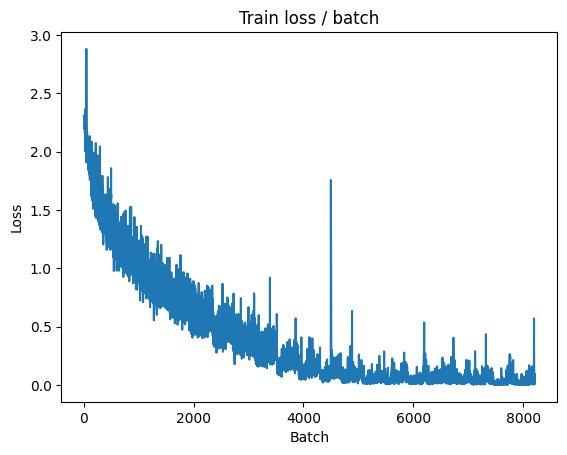

[TRAIN Batch 200/391]	Time 0.094s (0.040s)	Loss 0.0291 (0.0201)	Prec@1  97.7 ( 99.4)	Prec@5 100.0 (100.0)


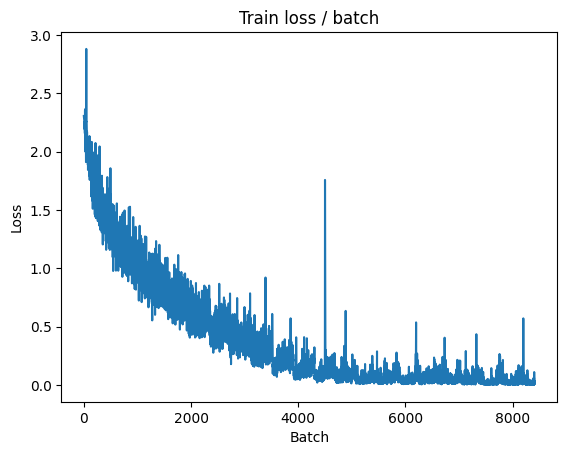


===============> Total time 14s	Avg loss 0.0327	Avg Prec@1 99.06 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 2.1273 (2.1273)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 1.8100	Avg Prec@1 73.71 %	Avg Prec@5 97.67 %



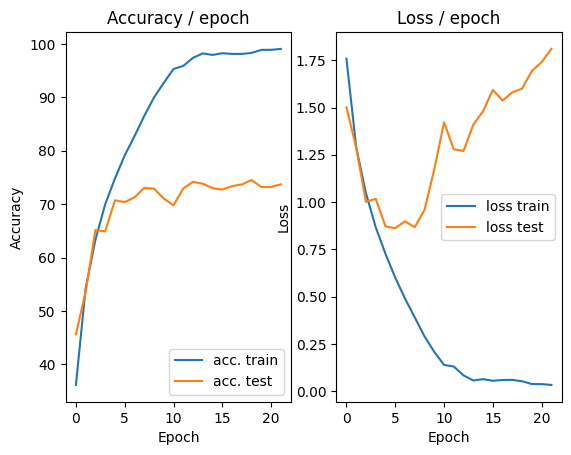

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.0271 (0.0271)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


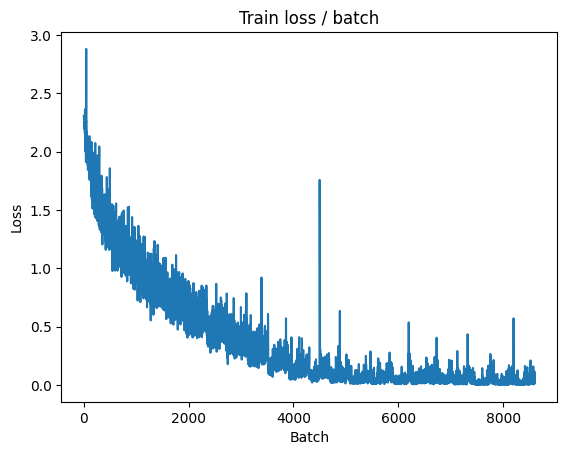

[TRAIN Batch 200/391]	Time 0.043s (0.040s)	Loss 0.0313 (0.0265)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


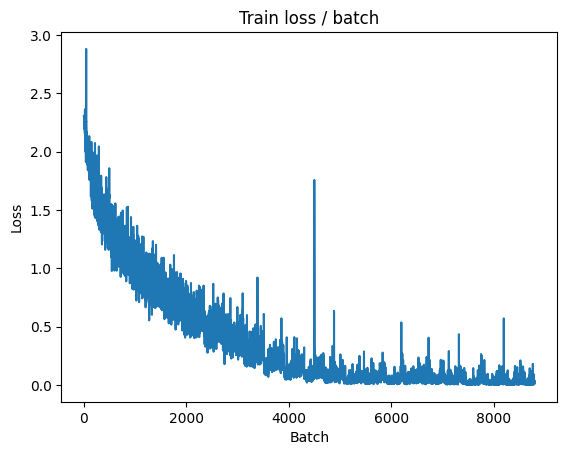


===============> Total time 14s	Avg loss 0.0318	Avg Prec@1 99.03 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.212s (0.212s)	Loss 1.7790 (1.7790)	Prec@1  75.0 ( 75.0)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.8627	Avg Prec@1 73.44 %	Avg Prec@5 97.41 %



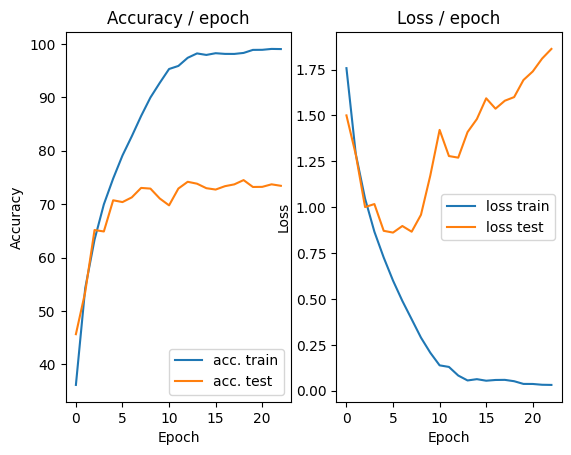

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0340 (0.0340)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


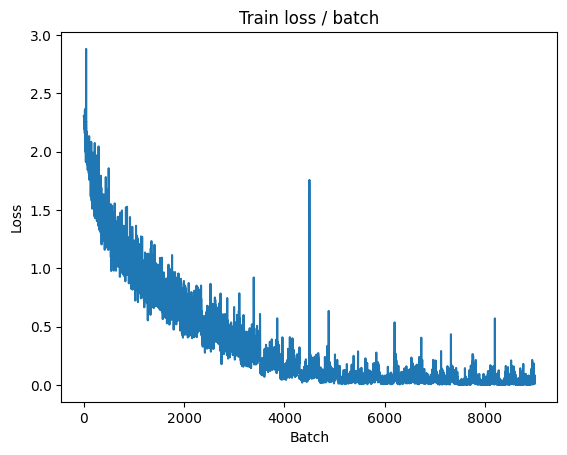

[TRAIN Batch 200/391]	Time 0.037s (0.035s)	Loss 0.0357 (0.0200)	Prec@1  98.4 ( 99.4)	Prec@5 100.0 (100.0)


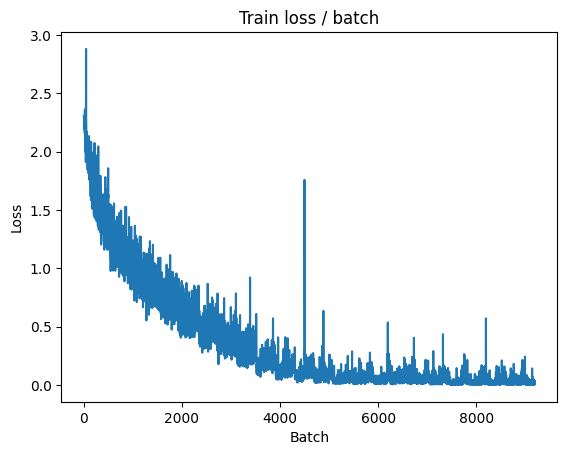


===============> Total time 14s	Avg loss 0.0236	Avg Prec@1 99.29 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 2.2376 (2.2376)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.8823	Avg Prec@1 73.71 %	Avg Prec@5 97.24 %



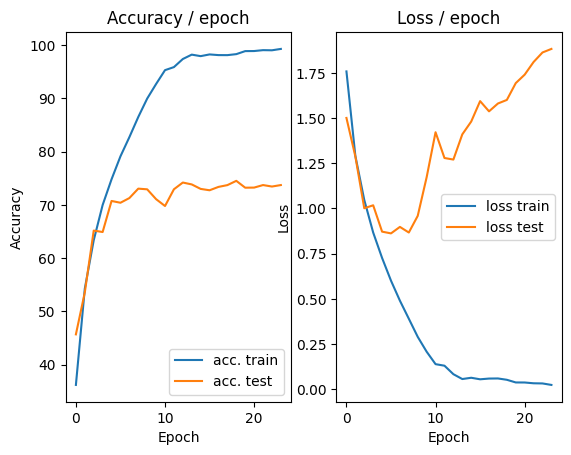

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.0113 (0.0113)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


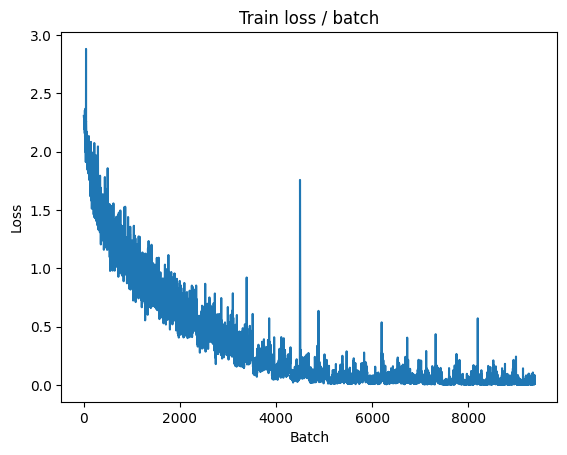

[TRAIN Batch 200/391]	Time 0.015s (0.041s)	Loss 0.0046 (0.0134)	Prec@1 100.0 ( 99.6)	Prec@5 100.0 (100.0)


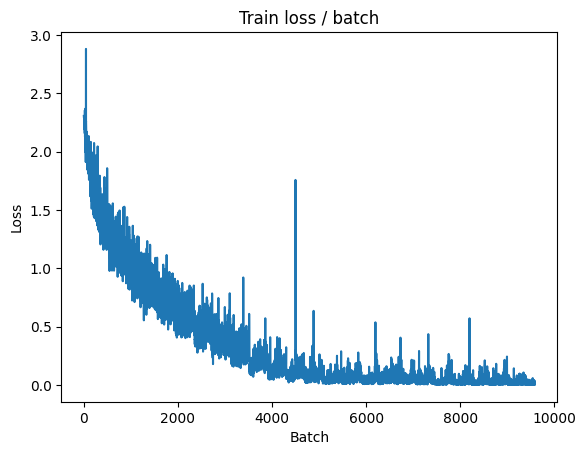


===============> Total time 14s	Avg loss 0.0159	Avg Prec@1 99.48 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.9626 (1.9626)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.8516	Avg Prec@1 74.83 %	Avg Prec@5 97.63 %



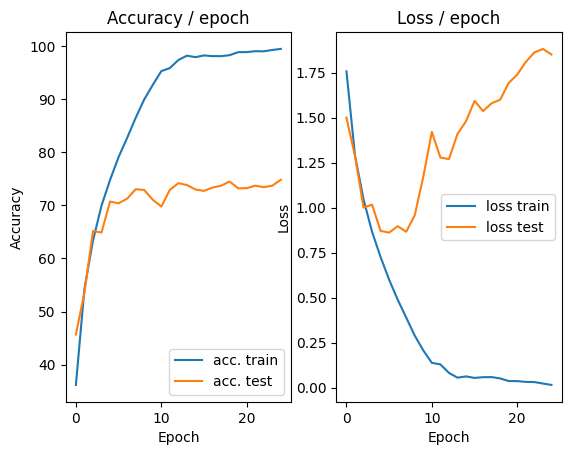

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 0.0091 (0.0091)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


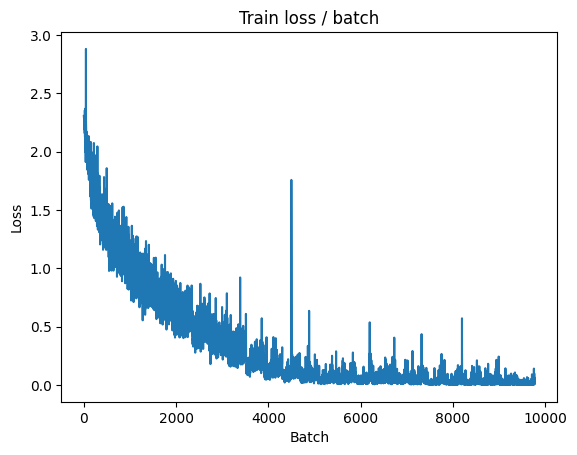

[TRAIN Batch 200/391]	Time 0.020s (0.037s)	Loss 0.0077 (0.0132)	Prec@1  99.2 ( 99.6)	Prec@5 100.0 (100.0)


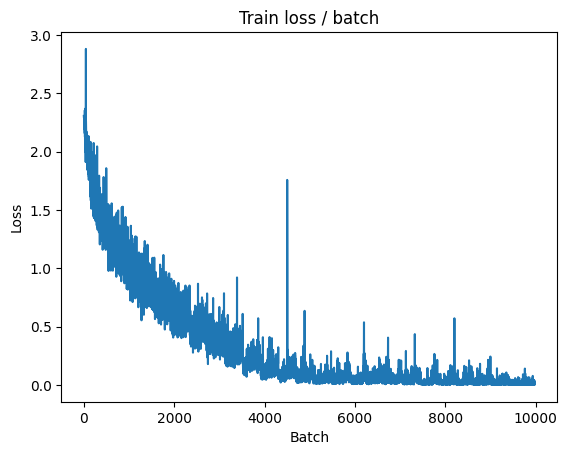


===============> Total time 14s	Avg loss 0.0151	Avg Prec@1 99.56 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 1.8754 (1.8754)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 2.1092	Avg Prec@1 74.02 %	Avg Prec@5 97.13 %



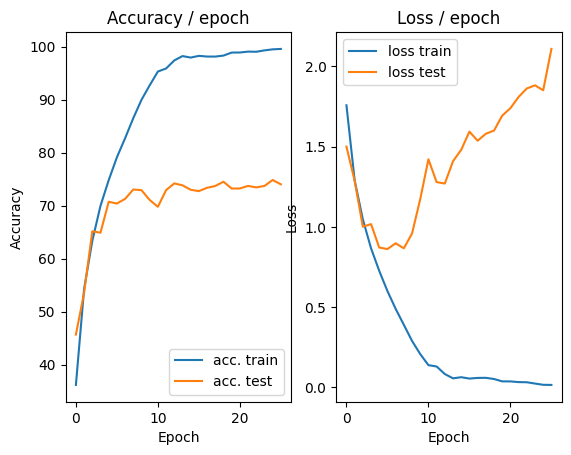

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.0046 (0.0046)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


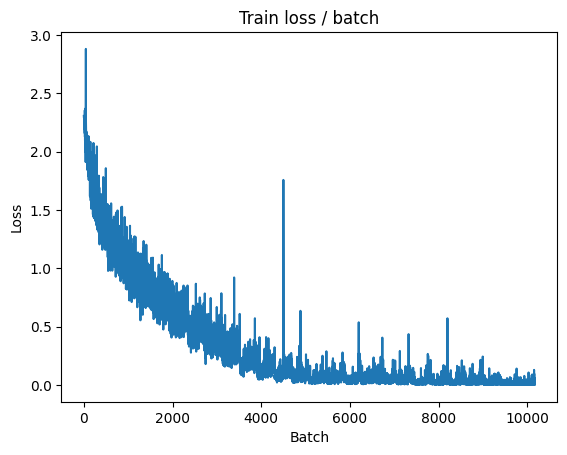

[TRAIN Batch 200/391]	Time 0.013s (0.035s)	Loss 0.0069 (0.0339)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


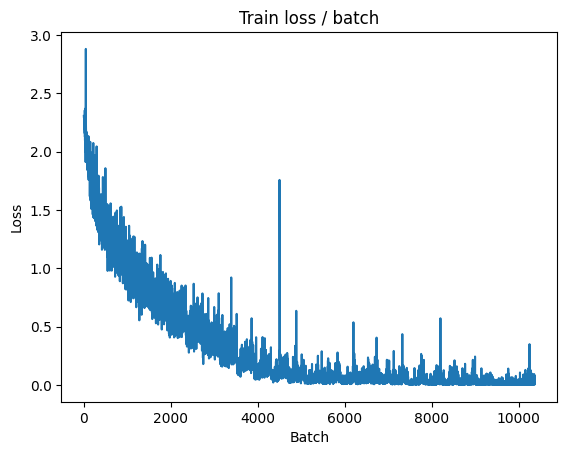


===============> Total time 14s	Avg loss 0.0390	Avg Prec@1 98.82 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.8807 (1.8807)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.9072	Avg Prec@1 74.14 %	Avg Prec@5 97.56 %



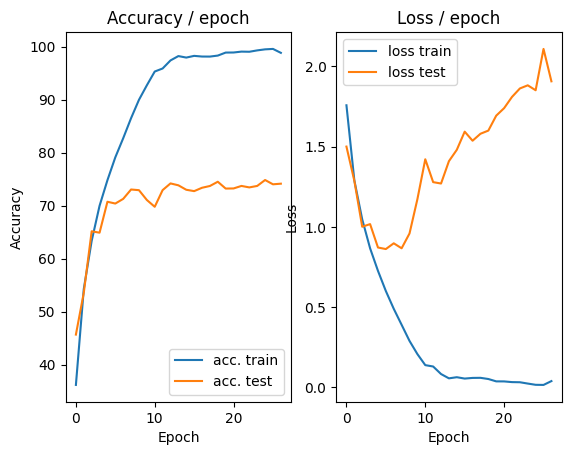

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.0449 (0.0449)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


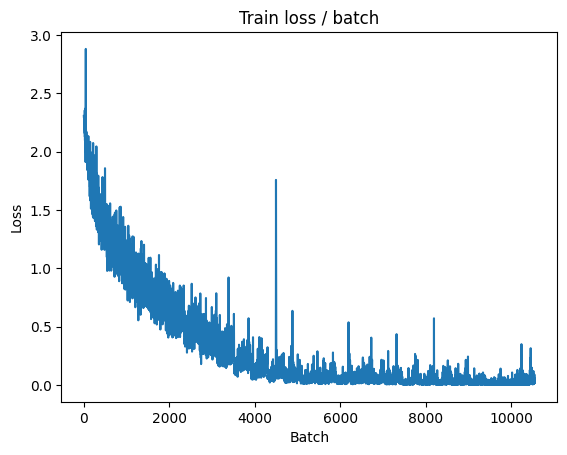

[TRAIN Batch 200/391]	Time 0.051s (0.041s)	Loss 0.0284 (0.0291)	Prec@1  99.2 ( 99.0)	Prec@5 100.0 (100.0)


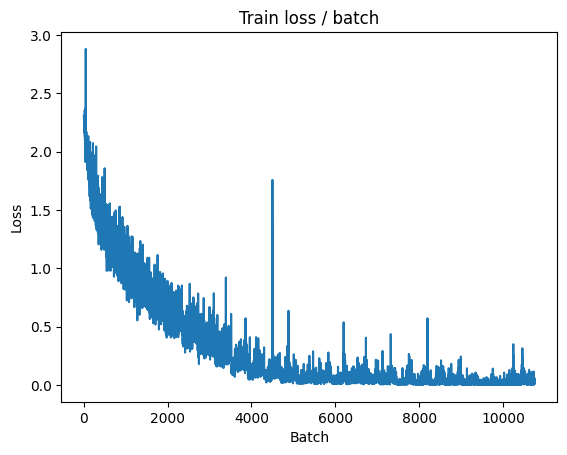


===============> Total time 14s	Avg loss 0.0323	Avg Prec@1 98.93 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 2.2944 (2.2944)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 1.9756	Avg Prec@1 73.26 %	Avg Prec@5 97.39 %



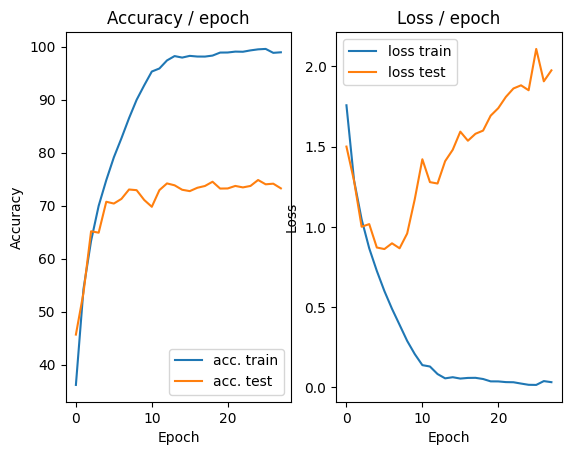

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.0110 (0.0110)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


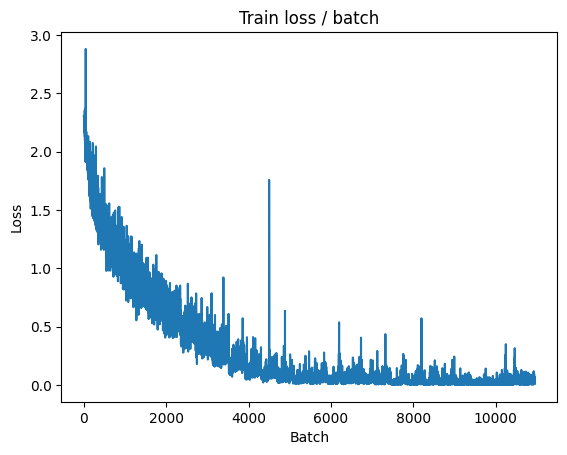

[TRAIN Batch 200/391]	Time 0.041s (0.035s)	Loss 0.0052 (0.0350)	Prec@1 100.0 ( 99.0)	Prec@5 100.0 (100.0)


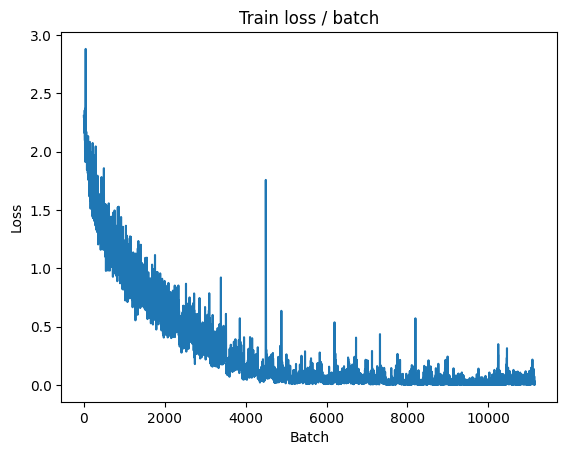


===============> Total time 14s	Avg loss 0.0351	Avg Prec@1 98.95 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 2.1610 (2.1610)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)

===============> Total time 2s	Avg loss 1.9180	Avg Prec@1 73.60 %	Avg Prec@5 97.61 %



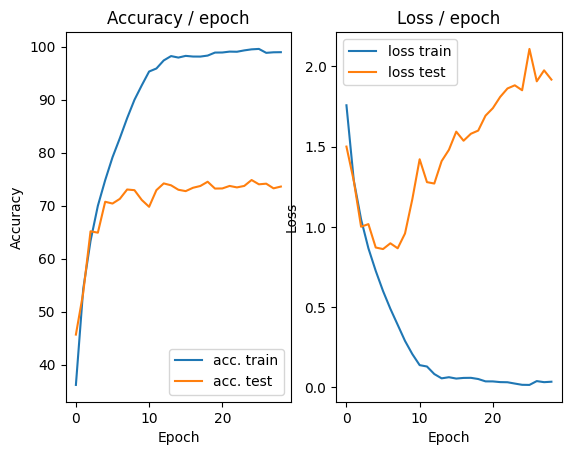

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.0481 (0.0481)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


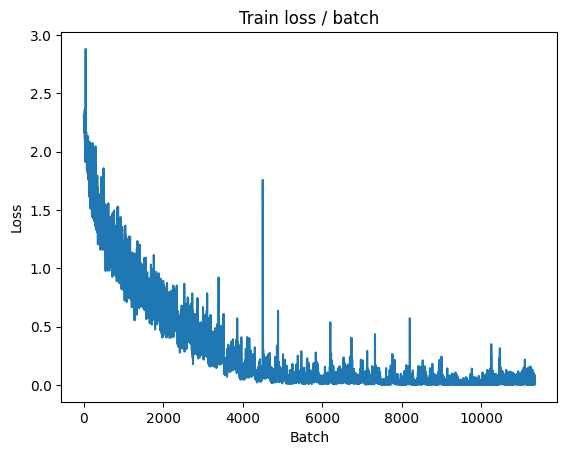

[TRAIN Batch 200/391]	Time 0.044s (0.040s)	Loss 0.0717 (0.0172)	Prec@1  98.4 ( 99.4)	Prec@5 100.0 (100.0)


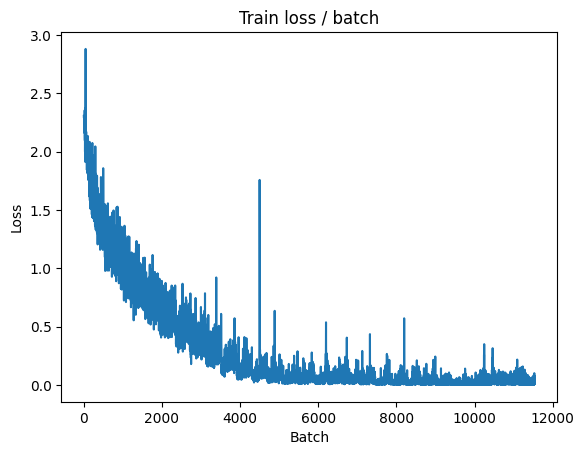


===============> Total time 14s	Avg loss 0.0252	Avg Prec@1 99.19 %	Avg Prec@5 100.00 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.9992 (1.9992)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 1.9579	Avg Prec@1 73.62 %	Avg Prec@5 97.54 %



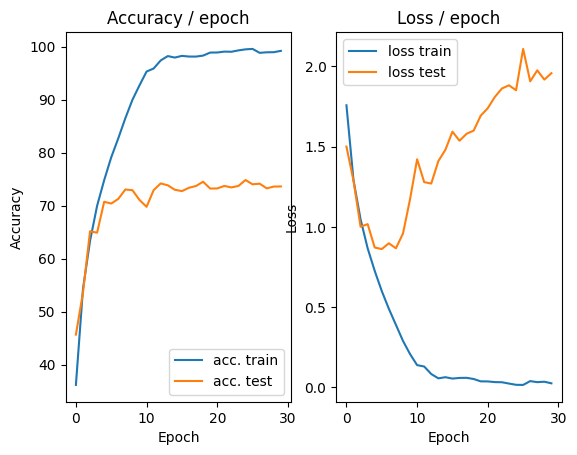

In [7]:
main(128, 0.1,30, cuda=True)

In [9]:

import numpy as np
import torch
from scipy import linalg

class ZCA(object):
    def __init__(self, regularization=1e-5, x=None):
        self.regularization = regularization
        if x is not None:
            self.fit(x)

    def fit(self, x):
        s = x.shape
        x = x.copy().reshape((s[0], np.prod(s[1:])))
        m = torch.mean(torch.from_numpy(x), dim=0)
        x -= m
        x_t = torch.tensor(x, dtype=torch.float).T
        sigma = torch.mm(x_t, x) / x.shape[0]
        U, S, V = torch.svd(sigma)
        tmp = torch.mm(U, torch.diag(1. / torch.sqrt(S + self.regularization)))
        tmp2 = torch.mm(U, torch.diag(torch.sqrt(S + self.regularization)))
        self.ZCA_mat = torch.tensor(torch.mm(tmp, U.T), dtype=torch.float)
        self.inv_ZCA_mat = torch.tensor(torch.mm(tmp2, U.T), dtype=torch.float)
        self.mean = torch.tensor(m, dtype=torch.float)
        return self.ZCA_mat , self.mean

In [10]:
def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    td=datasets.CIFAR10(PATH, train=True, download=True)
    Z,mean=ZCA(td)
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.LinearTransformation(transformation_matrix=Z,
                                            mean_vector=mean)
        ]))

    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.LinearTransformation(transformation_matrix=Z,
                                            mean_vector=mean)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

In [11]:
main(128, 0.1,30, cuda=True)

100%|██████████| 170498071/170498071 [00:03<00:00, 44102800.84it/s]


Extracting datasets/cifar-10-python.tar.gz to datasets


TypeError: ignored

## Data Augmentation

In [15]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0,ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(p=0.5)
        ]))

    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 2.3009 (2.3009)	Prec@1  10.9 ( 10.9)	Prec@5  56.2 ( 56.2)


<Figure size 640x480 with 0 Axes>

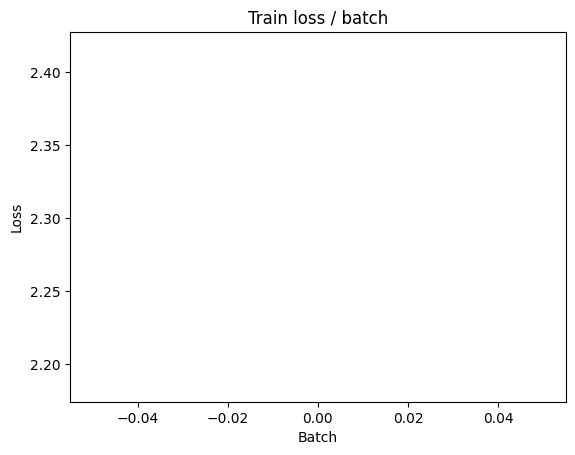

[TRAIN Batch 200/391]	Time 0.058s (0.048s)	Loss 1.5789 (1.9734)	Prec@1  40.6 ( 27.5)	Prec@5  92.2 ( 77.9)


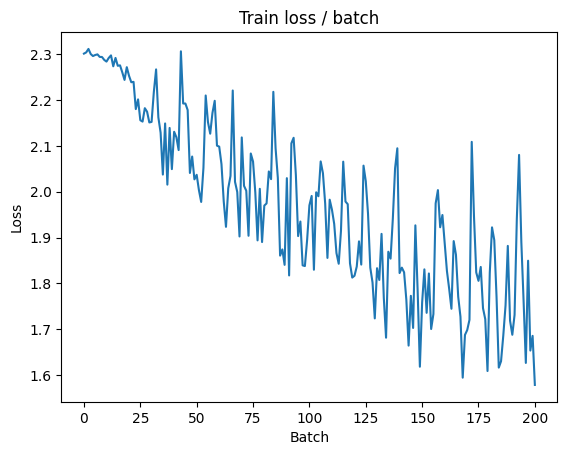


===============> Total time 19s	Avg loss 1.8130	Avg Prec@1 33.88 %	Avg Prec@5 83.30 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.3944 (1.3944)	Prec@1  53.9 ( 53.9)	Prec@5  93.0 ( 93.0)

===============> Total time 2s	Avg loss 1.4147	Avg Prec@1 48.79 %	Avg Prec@5 93.04 %



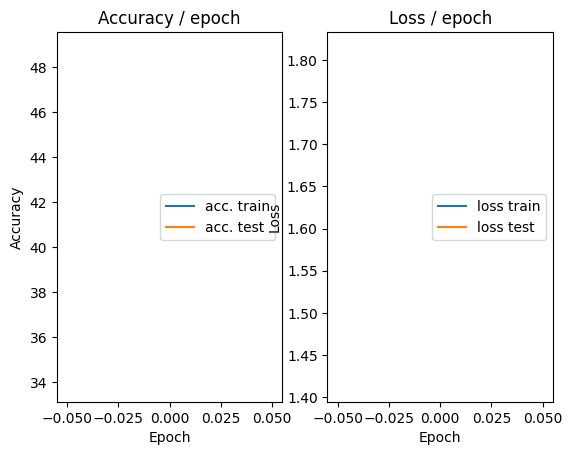

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 1.3148 (1.3148)	Prec@1  53.9 ( 53.9)	Prec@5  92.2 ( 92.2)


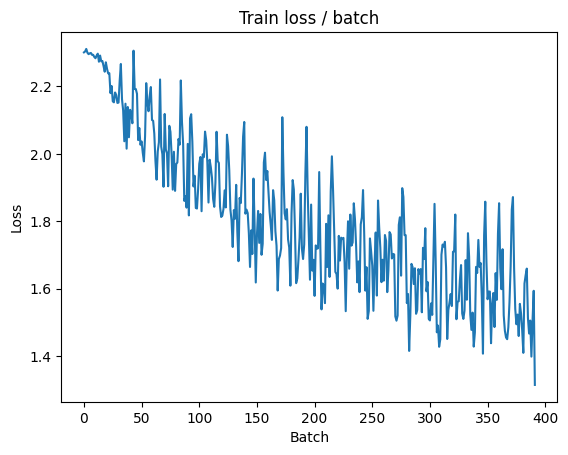

[TRAIN Batch 200/391]	Time 0.137s (0.048s)	Loss 1.3784 (1.4543)	Prec@1  43.8 ( 47.7)	Prec@5  93.0 ( 92.3)


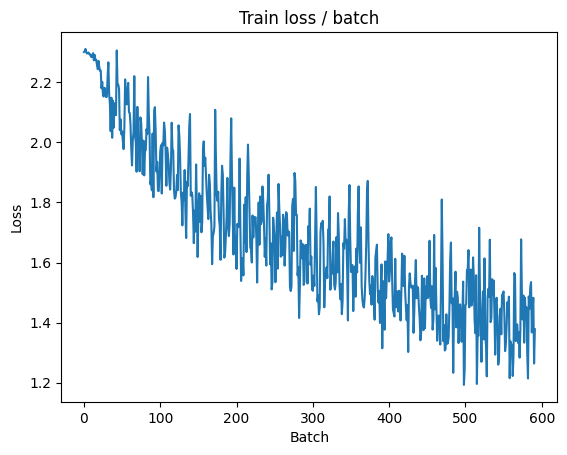


===============> Total time 17s	Avg loss 1.3948	Avg Prec@1 50.07 %	Avg Prec@5 93.14 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 1.4677 (1.4677)	Prec@1  50.8 ( 50.8)	Prec@5  92.2 ( 92.2)

===============> Total time 3s	Avg loss 1.4077	Avg Prec@1 50.94 %	Avg Prec@5 93.76 %



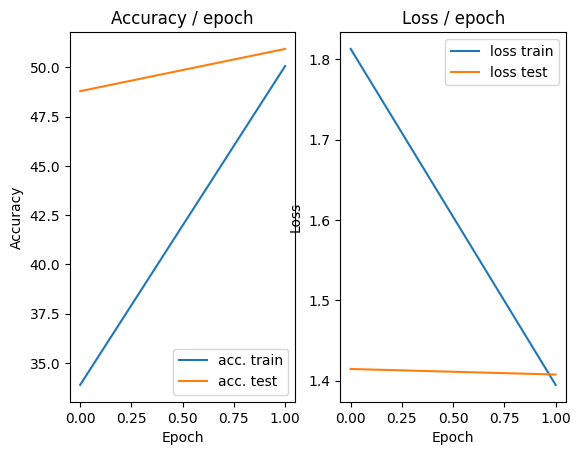

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.267s (0.267s)	Loss 1.2884 (1.2884)	Prec@1  55.5 ( 55.5)	Prec@5  95.3 ( 95.3)


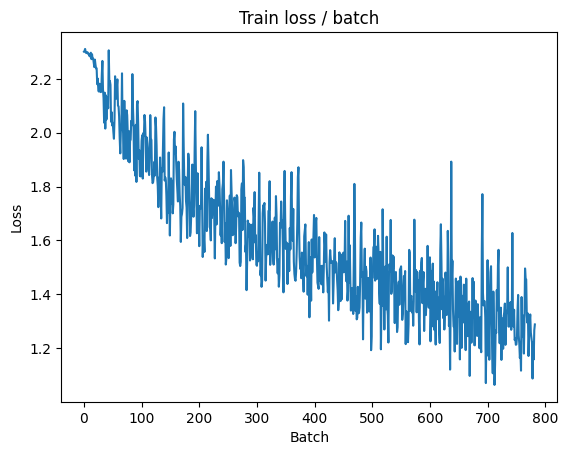

[TRAIN Batch 200/391]	Time 0.056s (0.050s)	Loss 1.2573 (1.2251)	Prec@1  57.8 ( 56.7)	Prec@5  92.2 ( 94.7)


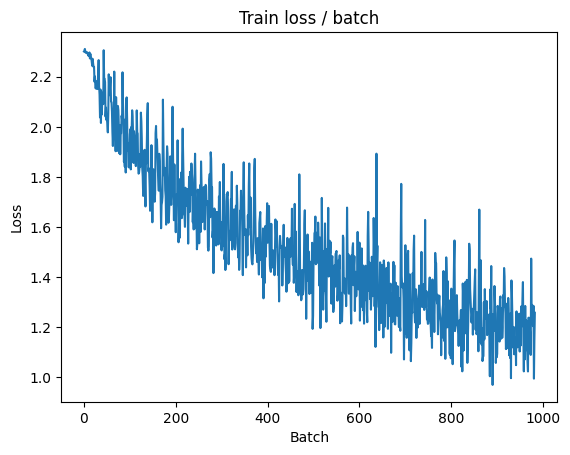


===============> Total time 19s	Avg loss 1.1747	Avg Prec@1 58.63 %	Avg Prec@5 95.29 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.1198 (1.1198)	Prec@1  64.8 ( 64.8)	Prec@5  95.3 ( 95.3)

===============> Total time 3s	Avg loss 1.1341	Avg Prec@1 60.22 %	Avg Prec@5 95.98 %



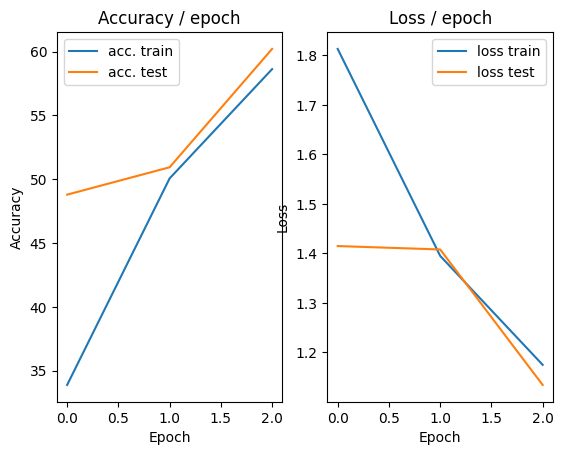

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.263s (0.263s)	Loss 1.0372 (1.0372)	Prec@1  57.8 ( 57.8)	Prec@5  97.7 ( 97.7)


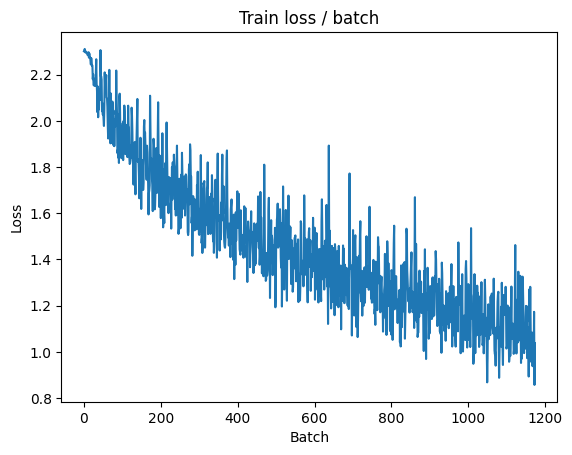

[TRAIN Batch 200/391]	Time 0.069s (0.048s)	Loss 1.0722 (1.0574)	Prec@1  59.4 ( 63.4)	Prec@5  98.4 ( 96.3)


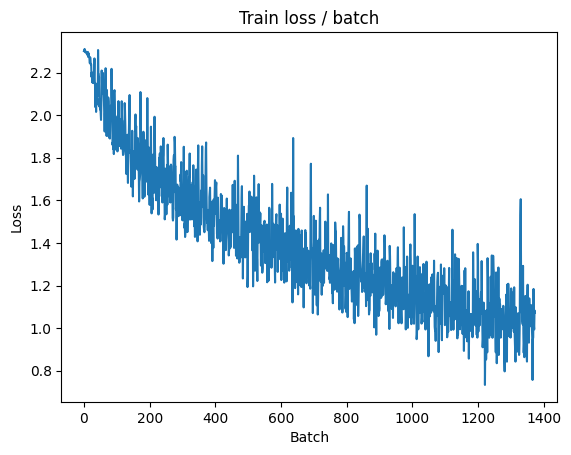


===============> Total time 18s	Avg loss 1.0248	Avg Prec@1 64.27 %	Avg Prec@5 96.52 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.0465 (1.0465)	Prec@1  61.7 ( 61.7)	Prec@5  94.5 ( 94.5)

===============> Total time 2s	Avg loss 1.0943	Avg Prec@1 62.42 %	Avg Prec@5 96.73 %



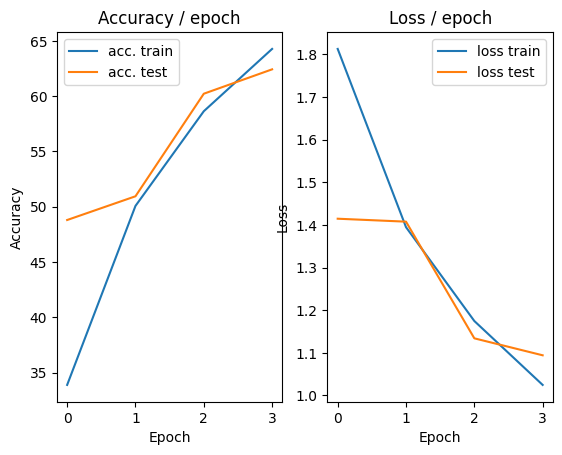

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 1.0233 (1.0233)	Prec@1  61.7 ( 61.7)	Prec@5  99.2 ( 99.2)


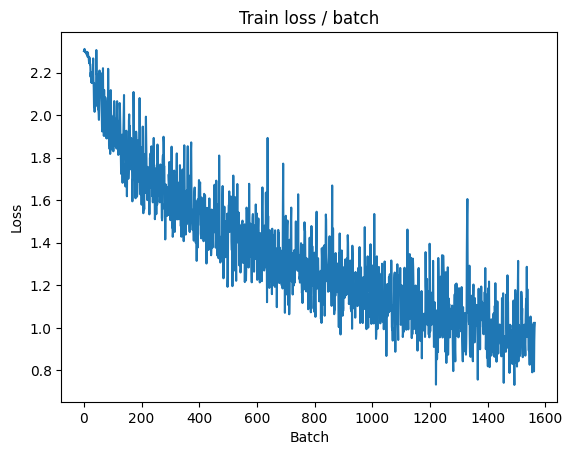

[TRAIN Batch 200/391]	Time 0.016s (0.050s)	Loss 0.8225 (0.9279)	Prec@1  74.2 ( 67.6)	Prec@5  96.9 ( 97.1)


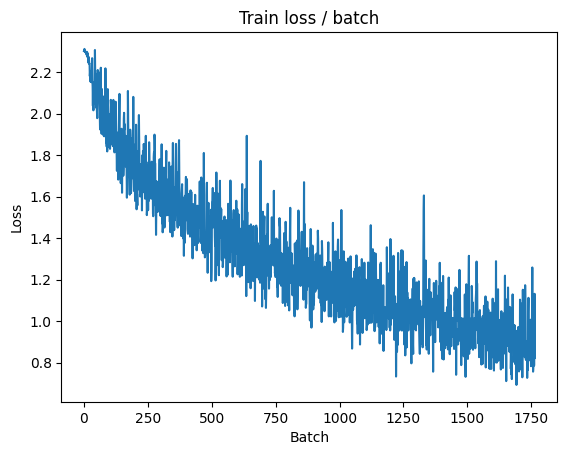


===============> Total time 19s	Avg loss 0.9142	Avg Prec@1 68.29 %	Avg Prec@5 97.15 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.8170 (0.8170)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8348	Avg Prec@1 71.30 %	Avg Prec@5 97.55 %



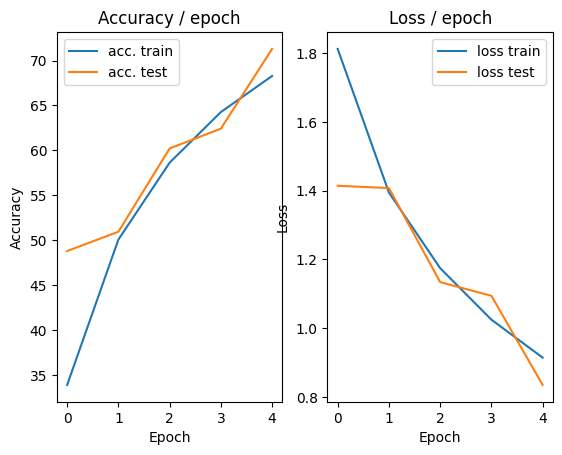

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.7738 (0.7738)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)


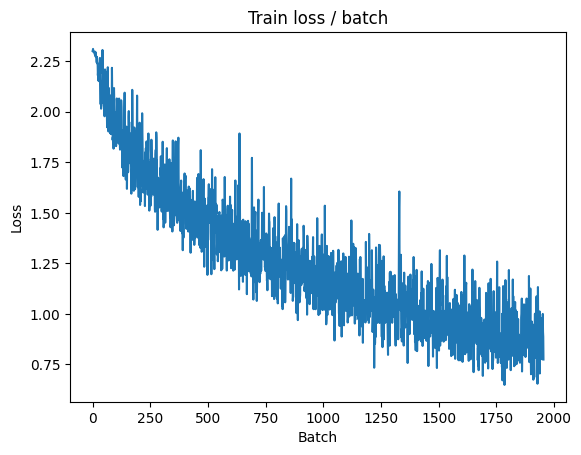

[TRAIN Batch 200/391]	Time 0.013s (0.048s)	Loss 0.8058 (0.8348)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 97.8)


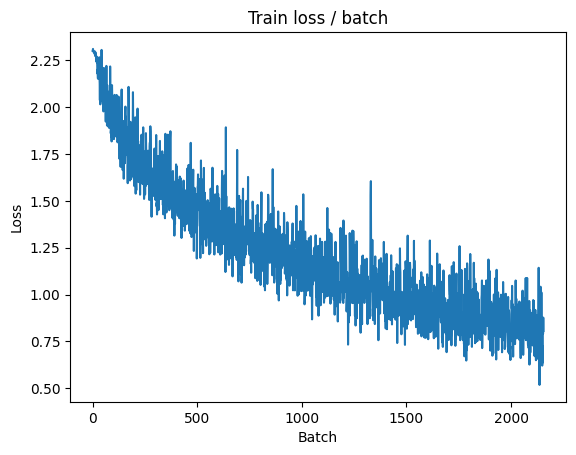


===============> Total time 17s	Avg loss 0.8291	Avg Prec@1 71.16 %	Avg Prec@5 97.94 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.9110 (0.9110)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.9559	Avg Prec@1 66.69 %	Avg Prec@5 97.25 %



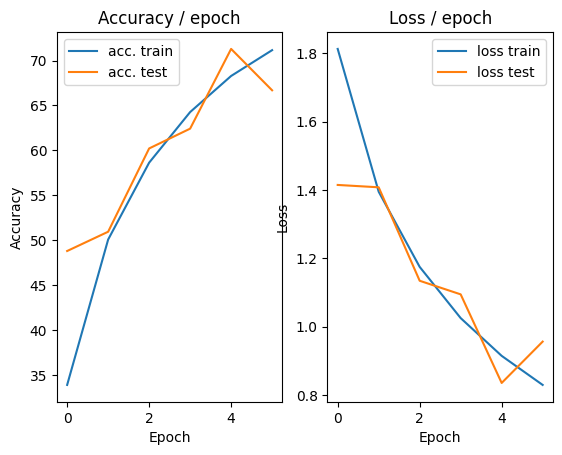

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 1.0121 (1.0121)	Prec@1  67.2 ( 67.2)	Prec@5  96.1 ( 96.1)


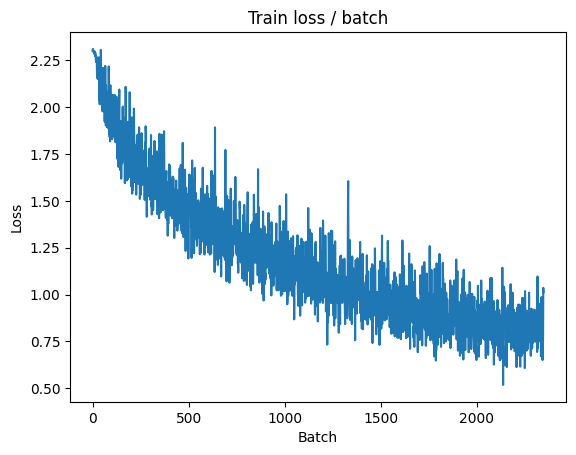

[TRAIN Batch 200/391]	Time 0.020s (0.044s)	Loss 0.6692 (0.7709)	Prec@1  75.8 ( 73.1)	Prec@5  98.4 ( 98.0)


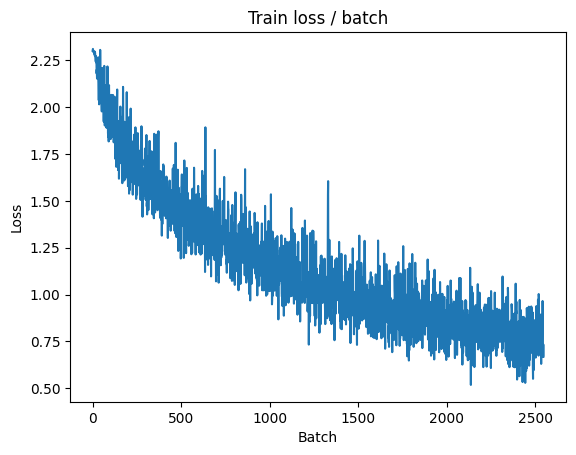


===============> Total time 18s	Avg loss 0.7695	Avg Prec@1 73.29 %	Avg Prec@5 98.00 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.7950 (0.7950)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7685	Avg Prec@1 73.77 %	Avg Prec@5 98.21 %



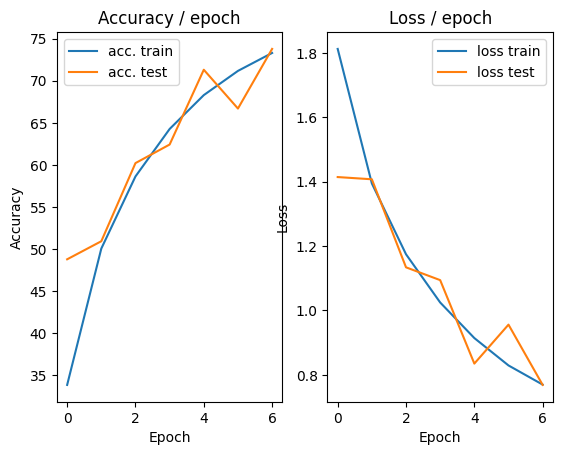

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.6777 (0.6777)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


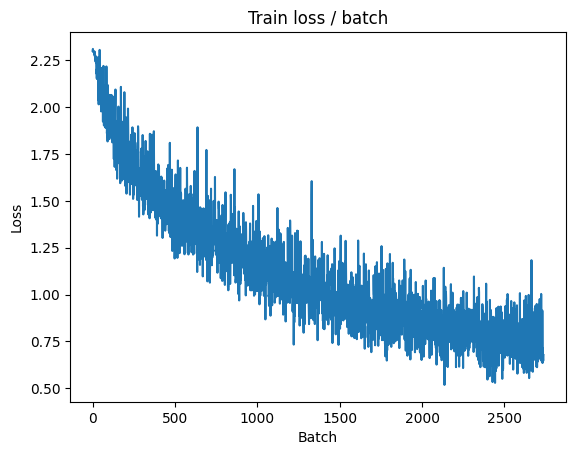

[TRAIN Batch 200/391]	Time 0.013s (0.049s)	Loss 0.6803 (0.7151)	Prec@1  74.2 ( 75.1)	Prec@5 100.0 ( 98.2)


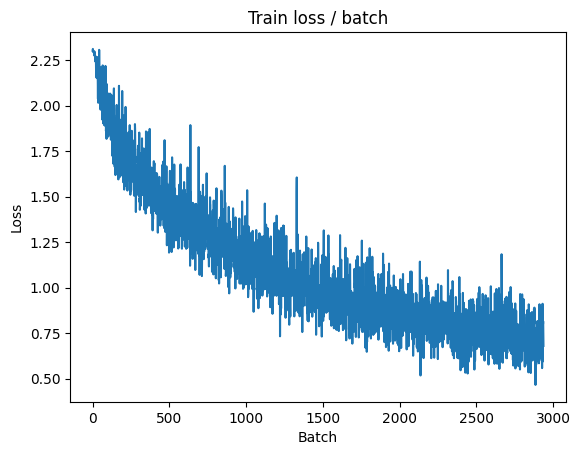


===============> Total time 19s	Avg loss 0.7058	Avg Prec@1 75.45 %	Avg Prec@5 98.35 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.7605 (0.7605)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7445	Avg Prec@1 74.22 %	Avg Prec@5 98.18 %



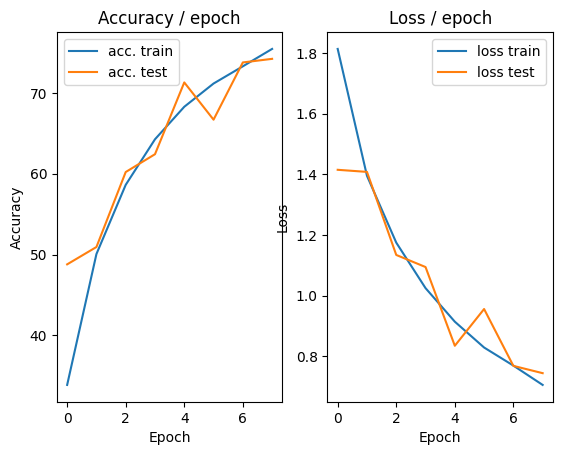

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.188s (0.188s)	Loss 0.6670 (0.6670)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


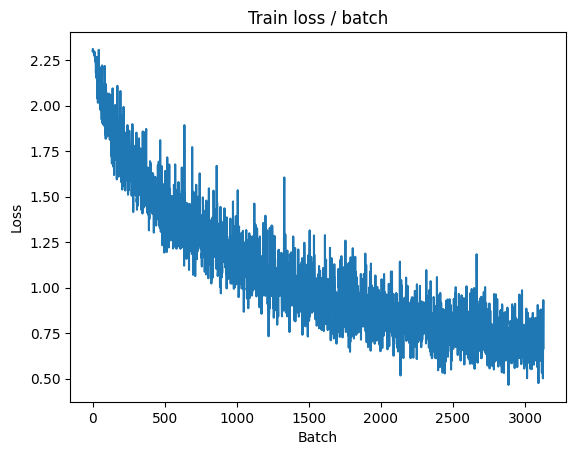

[TRAIN Batch 200/391]	Time 0.074s (0.050s)	Loss 0.5883 (0.6643)	Prec@1  78.1 ( 76.9)	Prec@5  98.4 ( 98.7)


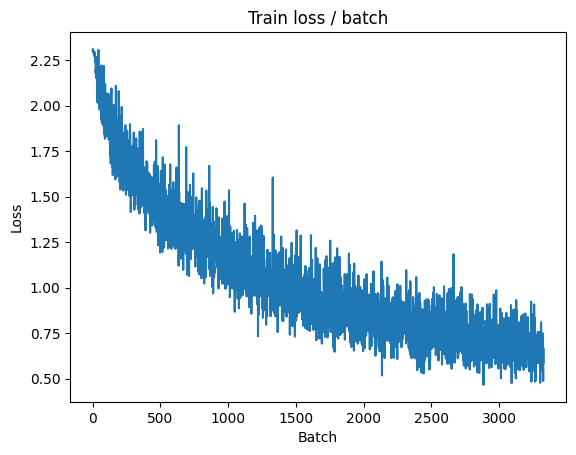


===============> Total time 19s	Avg loss 0.6636	Avg Prec@1 76.96 %	Avg Prec@5 98.62 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.8584 (0.8584)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.9364	Avg Prec@1 69.95 %	Avg Prec@5 97.89 %



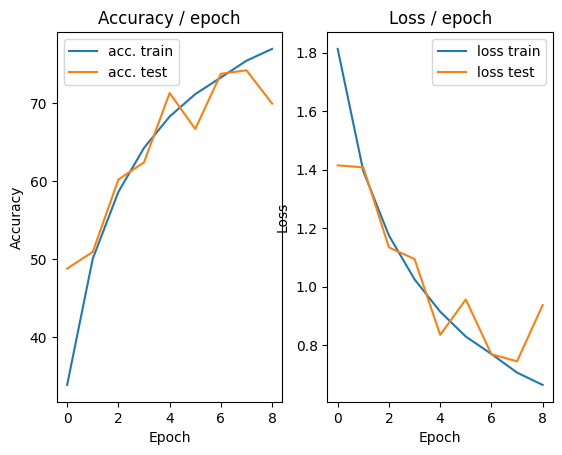

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.204s (0.204s)	Loss 1.0263 (1.0263)	Prec@1  64.1 ( 64.1)	Prec@5  97.7 ( 97.7)


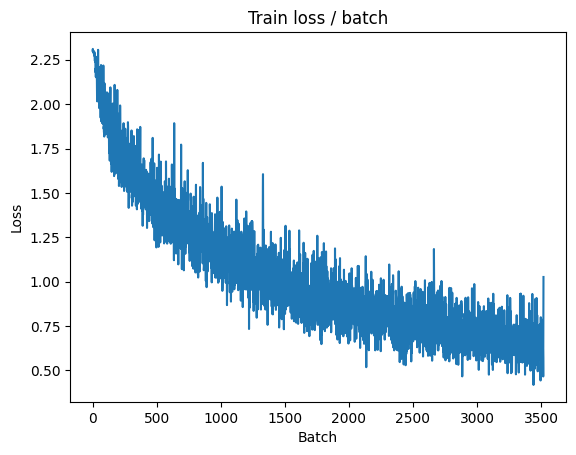

[TRAIN Batch 200/391]	Time 0.009s (0.050s)	Loss 0.6643 (0.6188)	Prec@1  76.6 ( 78.7)	Prec@5  98.4 ( 98.8)


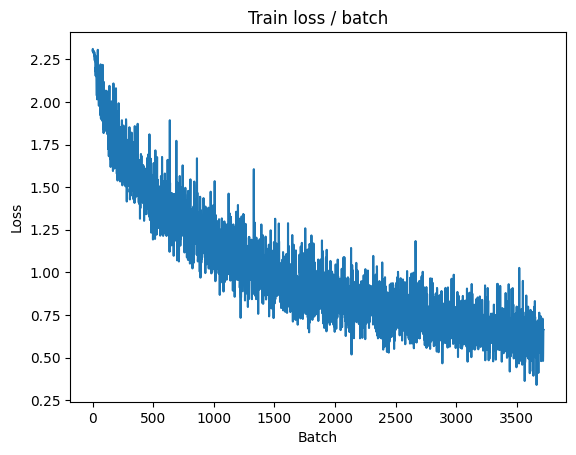


===============> Total time 18s	Avg loss 0.6233	Avg Prec@1 78.55 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.260s (0.260s)	Loss 0.6926 (0.6926)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6845	Avg Prec@1 76.36 %	Avg Prec@5 98.33 %



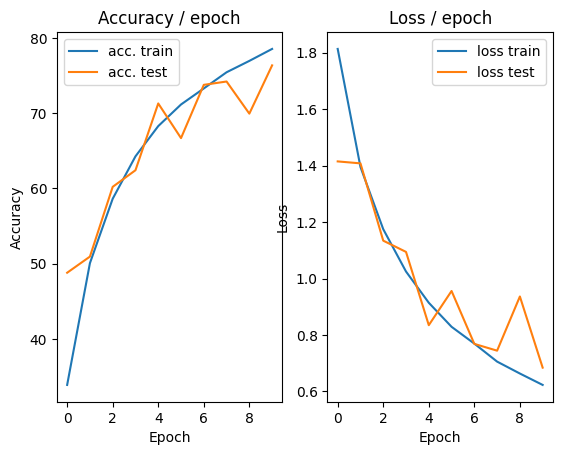

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.5527 (0.5527)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


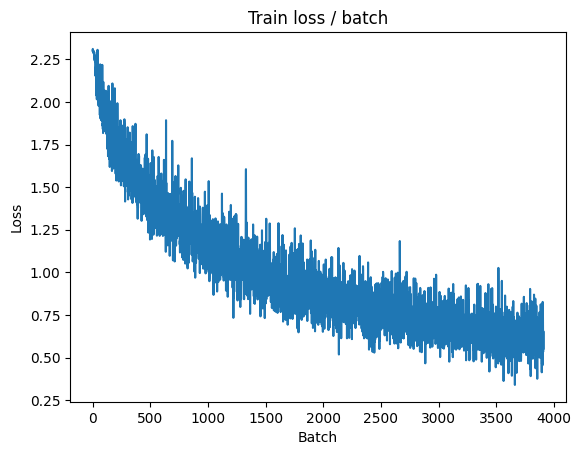

[TRAIN Batch 200/391]	Time 0.144s (0.047s)	Loss 0.5284 (0.5846)	Prec@1  79.7 ( 79.5)	Prec@5  99.2 ( 99.0)


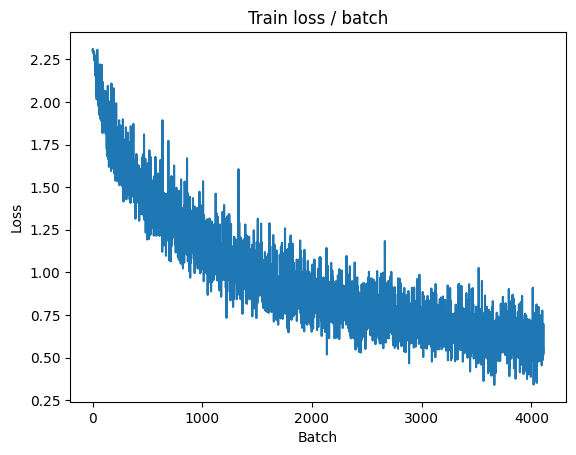


===============> Total time 18s	Avg loss 0.5915	Avg Prec@1 79.42 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.7564 (0.7564)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7195	Avg Prec@1 76.13 %	Avg Prec@5 98.27 %



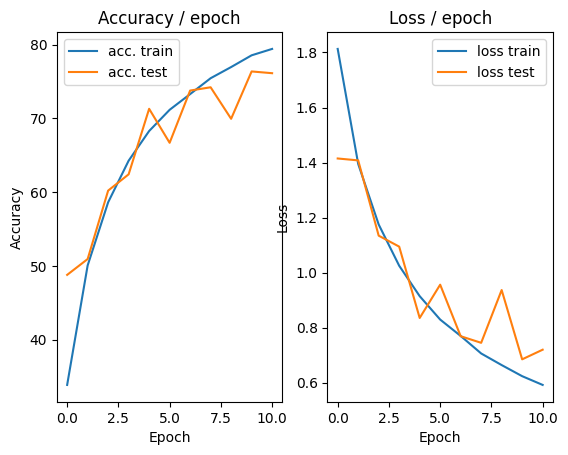

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.5059 (0.5059)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


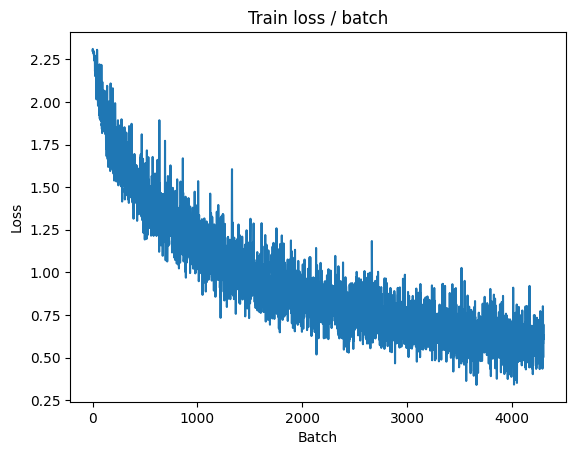

[TRAIN Batch 200/391]	Time 0.071s (0.048s)	Loss 0.5040 (0.5563)	Prec@1  83.6 ( 80.9)	Prec@5  99.2 ( 99.1)


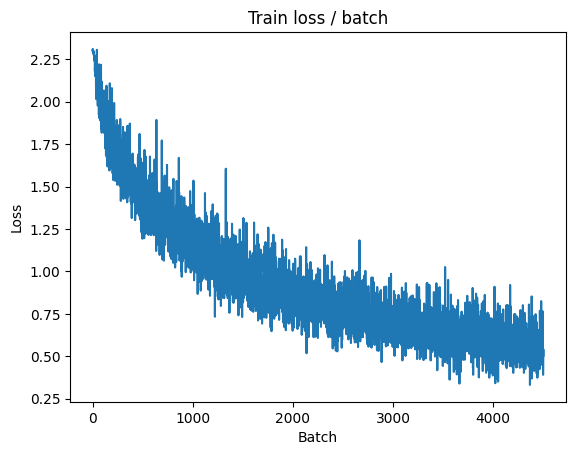


===============> Total time 18s	Avg loss 0.5561	Avg Prec@1 80.89 %	Avg Prec@5 99.02 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.6759 (0.6759)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6829	Avg Prec@1 76.75 %	Avg Prec@5 98.38 %



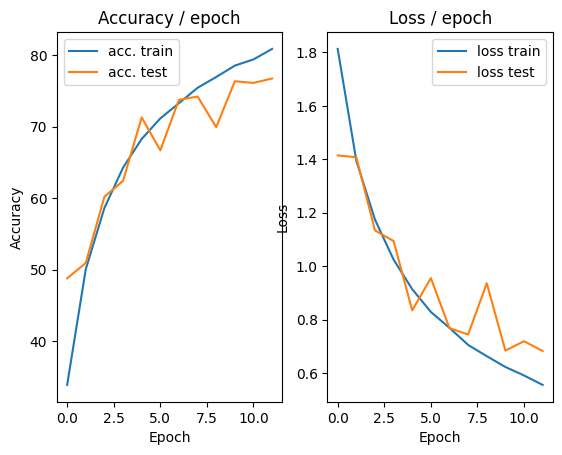

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.206s (0.206s)	Loss 0.4767 (0.4767)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


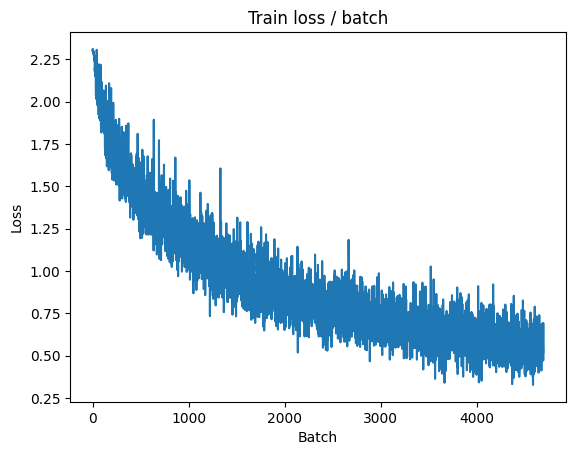

[TRAIN Batch 200/391]	Time 0.075s (0.048s)	Loss 0.5895 (0.5196)	Prec@1  81.2 ( 82.1)	Prec@5 100.0 ( 99.2)


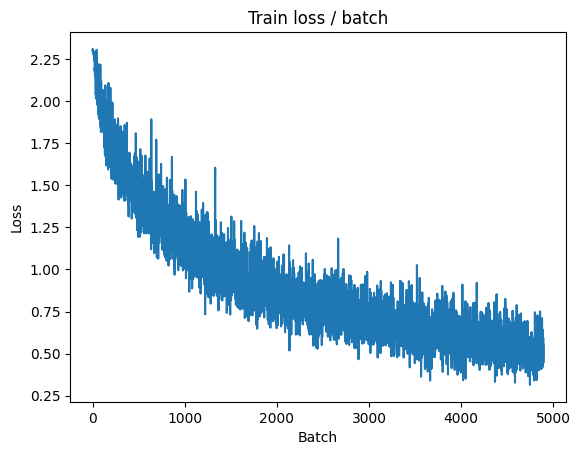


===============> Total time 18s	Avg loss 0.5320	Avg Prec@1 81.56 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.7521 (0.7521)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6832	Avg Prec@1 77.25 %	Avg Prec@5 98.64 %



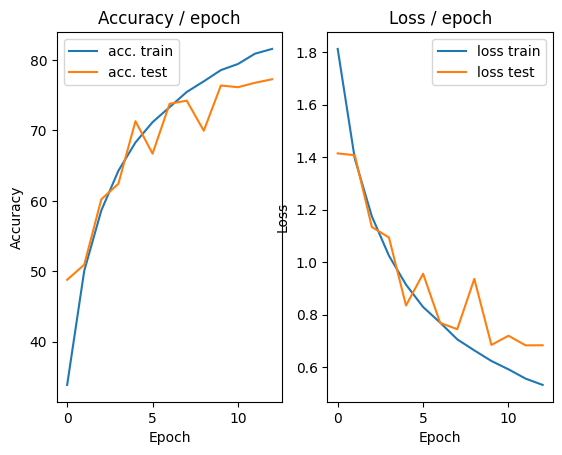

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.194s (0.194s)	Loss 0.4386 (0.4386)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


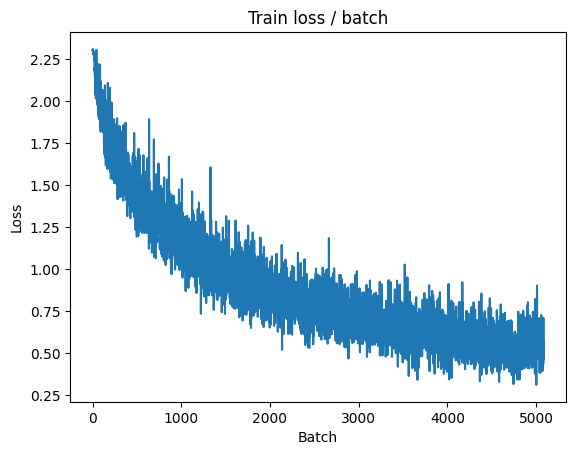

[TRAIN Batch 200/391]	Time 0.057s (0.049s)	Loss 0.4476 (0.5070)	Prec@1  85.2 ( 82.4)	Prec@5  98.4 ( 99.3)


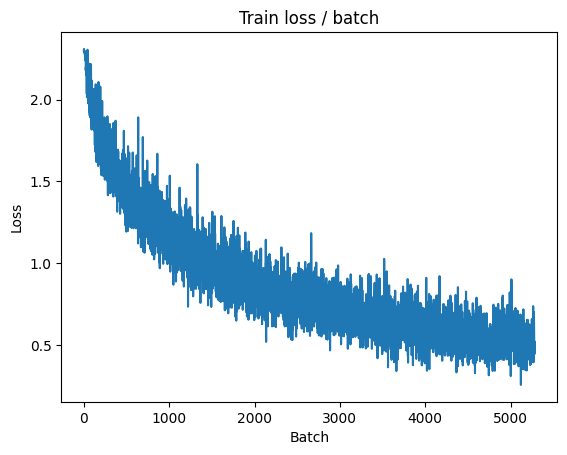


===============> Total time 19s	Avg loss 0.5087	Avg Prec@1 82.26 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.6513 (0.6513)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 3s	Avg loss 0.6642	Avg Prec@1 78.03 %	Avg Prec@5 98.64 %



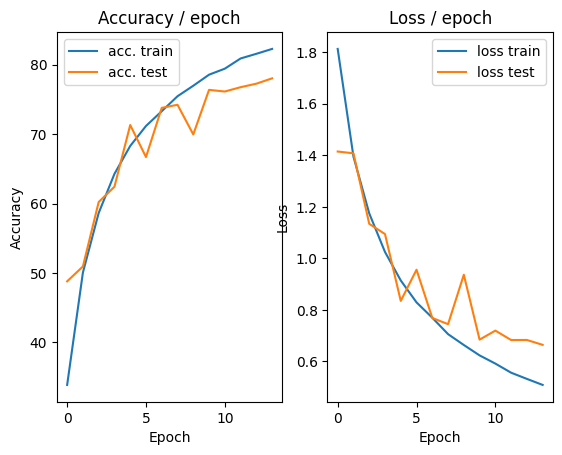

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.4979 (0.4979)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


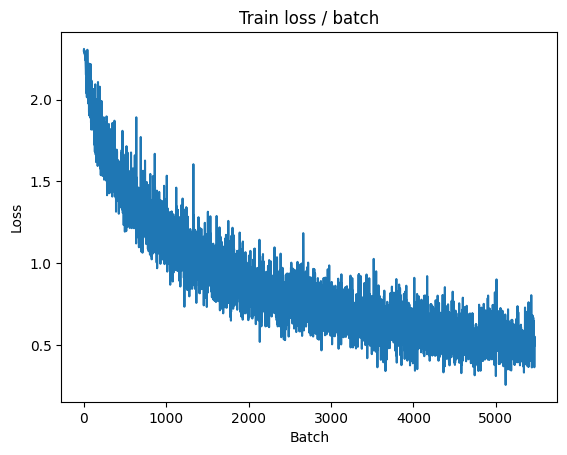

[TRAIN Batch 200/391]	Time 0.121s (0.045s)	Loss 0.4326 (0.4739)	Prec@1  84.4 ( 83.5)	Prec@5 100.0 ( 99.3)


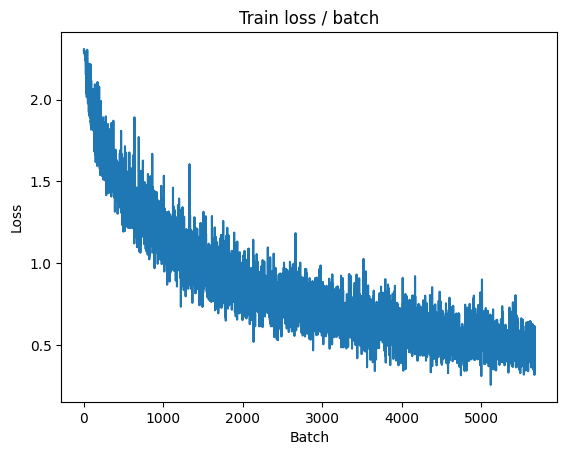


===============> Total time 17s	Avg loss 0.4734	Avg Prec@1 83.49 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.7859 (0.7859)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7743	Avg Prec@1 75.24 %	Avg Prec@5 98.37 %



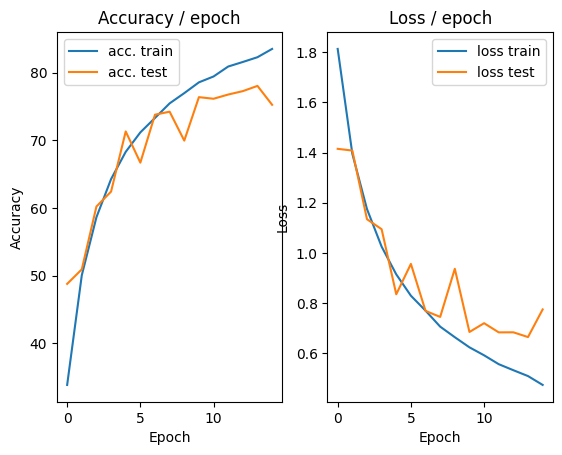

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.295s (0.295s)	Loss 0.6370 (0.6370)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)


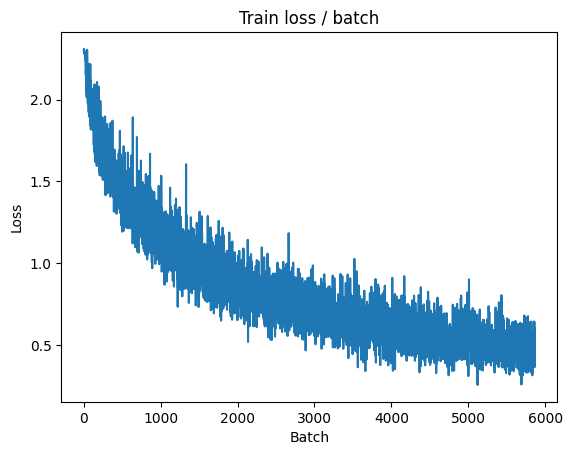

[TRAIN Batch 200/391]	Time 0.008s (0.054s)	Loss 0.5002 (0.4527)	Prec@1  85.9 ( 84.3)	Prec@5  99.2 ( 99.4)


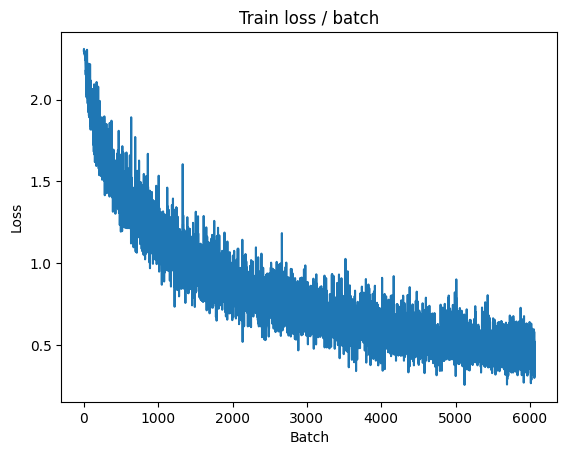


===============> Total time 20s	Avg loss 0.4581	Avg Prec@1 84.05 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.7217 (0.7217)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7472	Avg Prec@1 76.95 %	Avg Prec@5 98.68 %



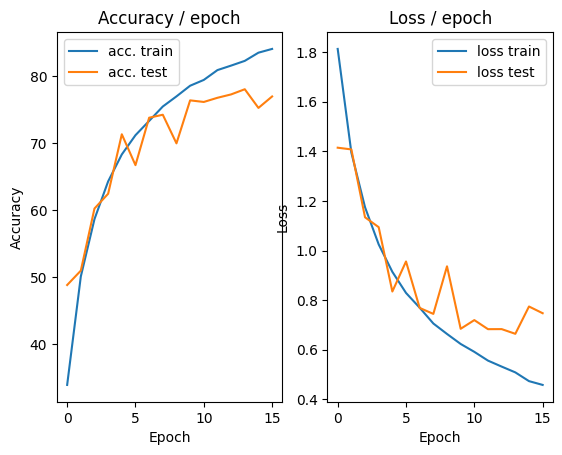

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.199s (0.199s)	Loss 0.6604 (0.6604)	Prec@1  78.1 ( 78.1)	Prec@5 100.0 (100.0)


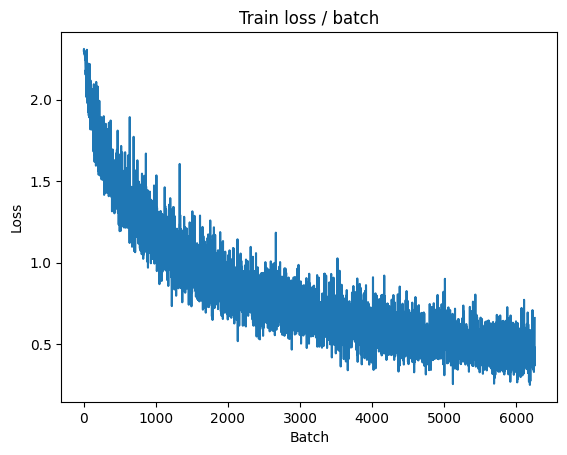

[TRAIN Batch 200/391]	Time 0.008s (0.049s)	Loss 0.4314 (0.4270)	Prec@1  82.8 ( 85.2)	Prec@5 100.0 ( 99.4)


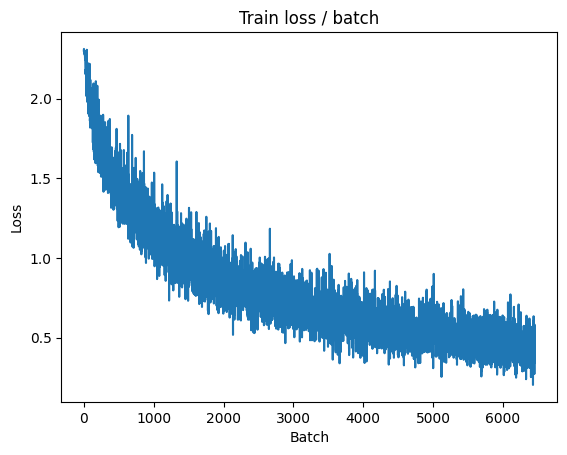


===============> Total time 19s	Avg loss 0.4349	Avg Prec@1 84.85 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.7431 (0.7431)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6779	Avg Prec@1 77.99 %	Avg Prec@5 98.54 %



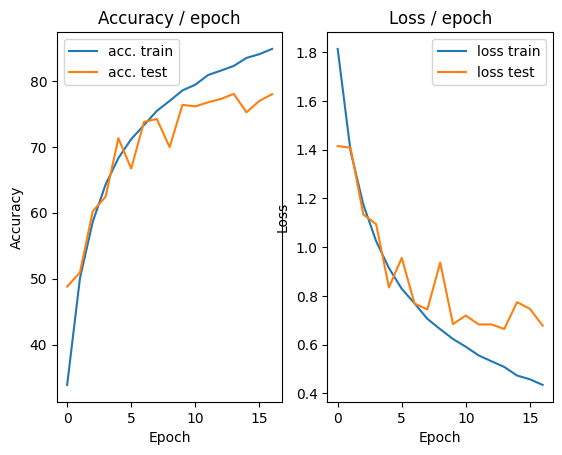

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.4774 (0.4774)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


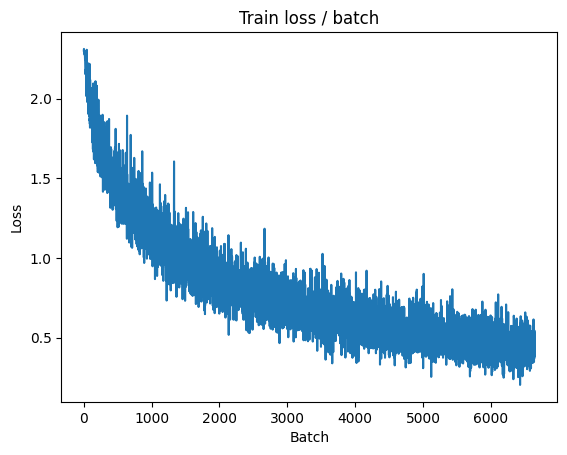

[TRAIN Batch 200/391]	Time 0.013s (0.049s)	Loss 0.5434 (0.4108)	Prec@1  78.9 ( 85.8)	Prec@5  99.2 ( 99.5)


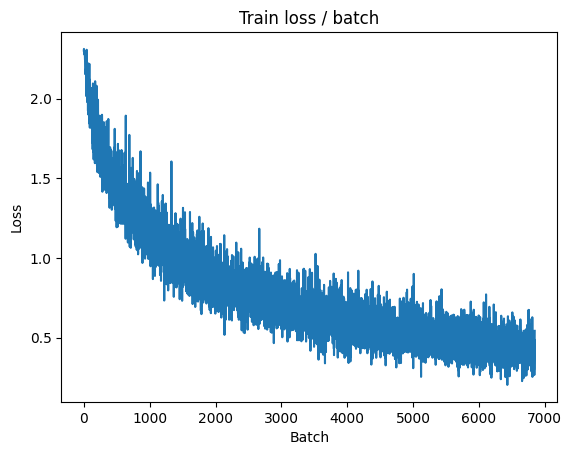


===============> Total time 18s	Avg loss 0.4149	Avg Prec@1 85.61 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.5863 (0.5863)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6247	Avg Prec@1 80.01 %	Avg Prec@5 98.82 %



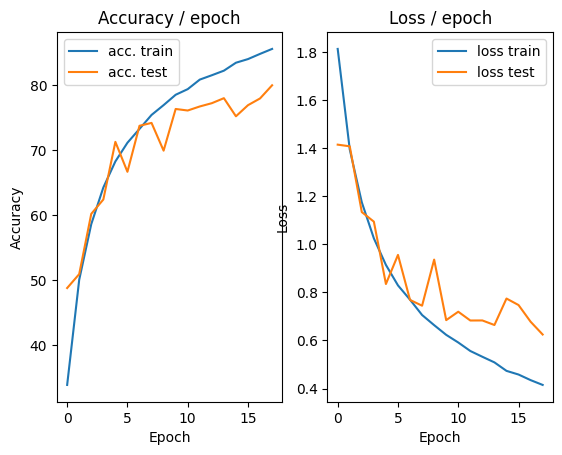

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.193s (0.193s)	Loss 0.3034 (0.3034)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


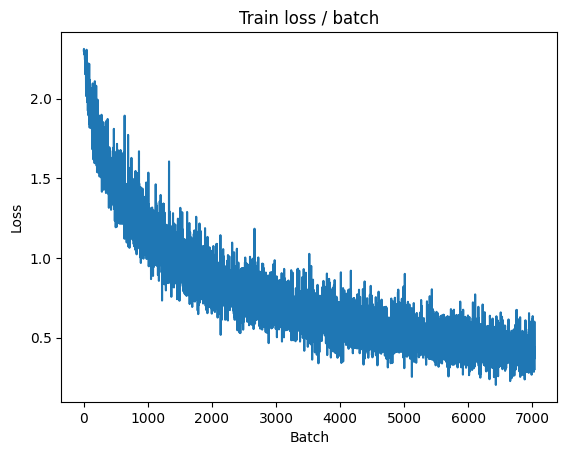

[TRAIN Batch 200/391]	Time 0.070s (0.048s)	Loss 0.3302 (0.3989)	Prec@1  89.1 ( 86.0)	Prec@5  99.2 ( 99.6)


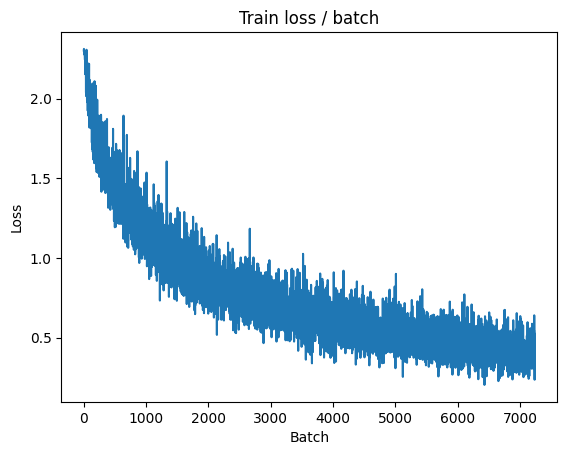


===============> Total time 18s	Avg loss 0.3998	Avg Prec@1 85.90 %	Avg Prec@5 99.57 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.6518 (0.6518)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6395	Avg Prec@1 80.33 %	Avg Prec@5 98.69 %



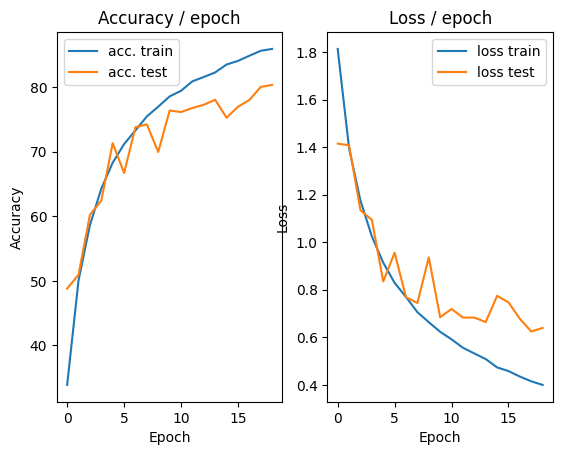

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.3538 (0.3538)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


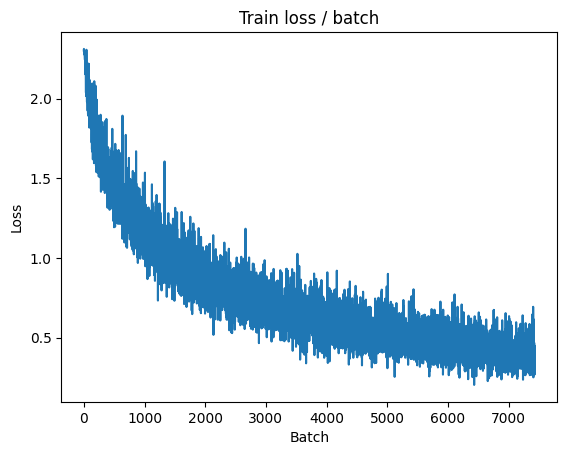

[TRAIN Batch 200/391]	Time 0.015s (0.045s)	Loss 0.5364 (0.3719)	Prec@1  82.0 ( 87.1)	Prec@5  99.2 ( 99.6)


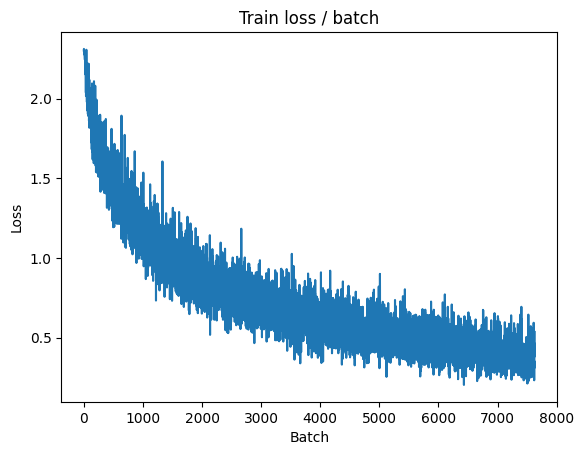


===============> Total time 18s	Avg loss 0.3770	Avg Prec@1 86.90 %	Avg Prec@5 99.60 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.5265 (0.5265)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.6197	Avg Prec@1 80.05 %	Avg Prec@5 98.84 %



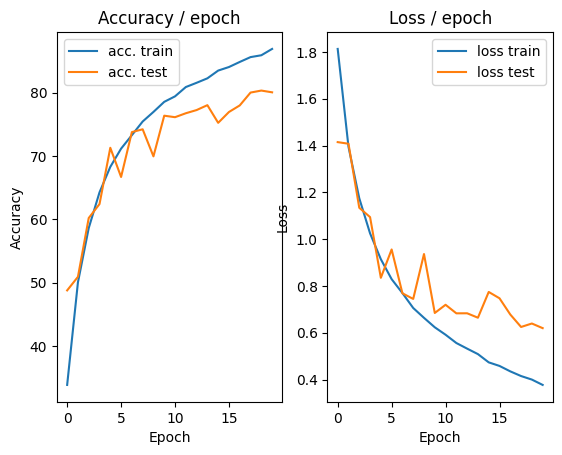

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.3118 (0.3118)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


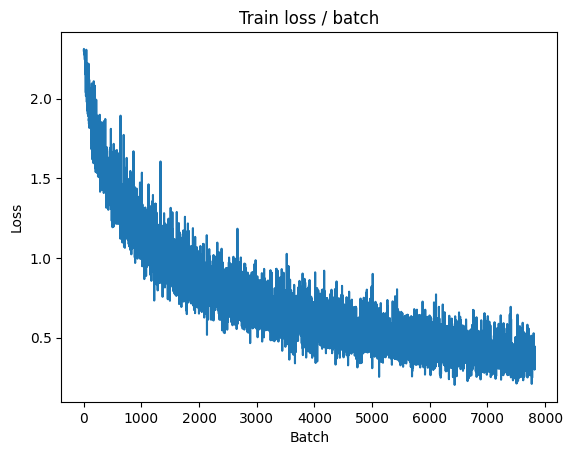

[TRAIN Batch 200/391]	Time 0.044s (0.049s)	Loss 0.4235 (0.3665)	Prec@1  87.5 ( 87.2)	Prec@5 100.0 ( 99.7)


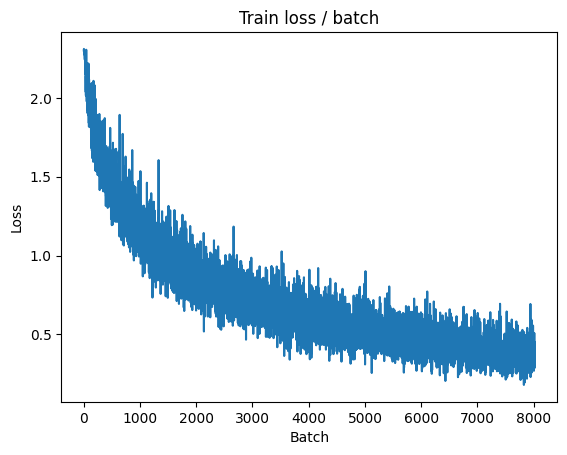


===============> Total time 18s	Avg loss 0.3679	Avg Prec@1 87.14 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.5834 (0.5834)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.6376	Avg Prec@1 80.07 %	Avg Prec@5 98.87 %



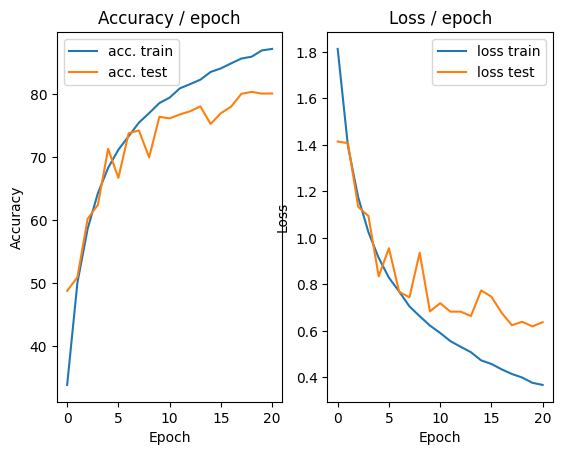

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.223s (0.223s)	Loss 0.2435 (0.2435)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


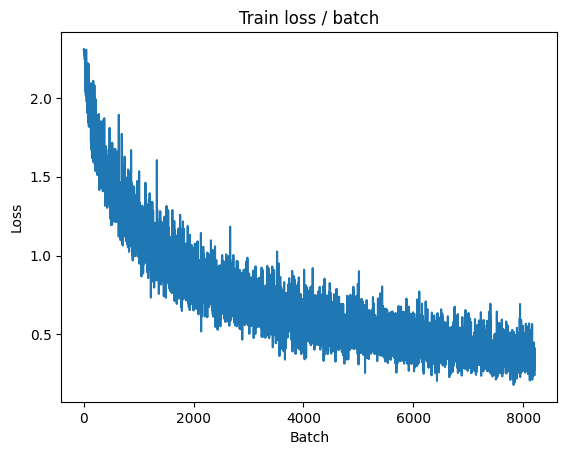

[TRAIN Batch 200/391]	Time 0.023s (0.049s)	Loss 0.4003 (0.3508)	Prec@1  82.0 ( 87.8)	Prec@5 100.0 ( 99.7)


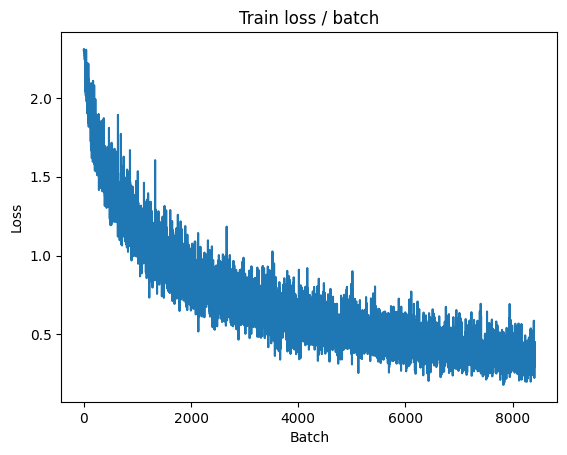


===============> Total time 17s	Avg loss 0.3515	Avg Prec@1 87.79 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.254s (0.254s)	Loss 0.5709 (0.5709)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6490	Avg Prec@1 79.86 %	Avg Prec@5 98.72 %



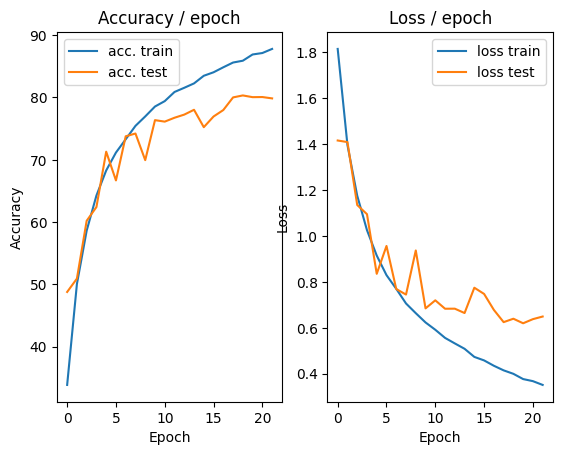

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.4212 (0.4212)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


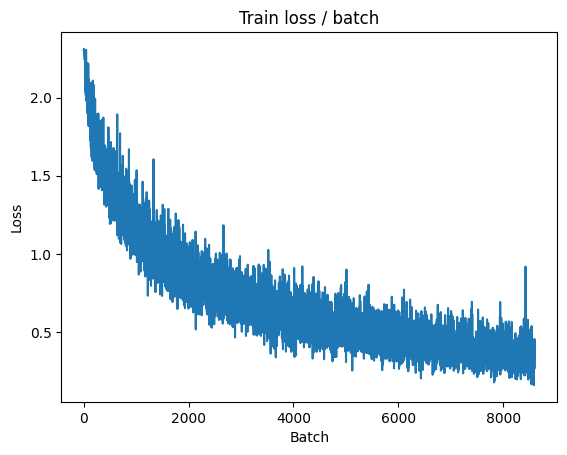

[TRAIN Batch 200/391]	Time 0.133s (0.046s)	Loss 0.2953 (0.3213)	Prec@1  87.5 ( 88.8)	Prec@5 100.0 ( 99.7)


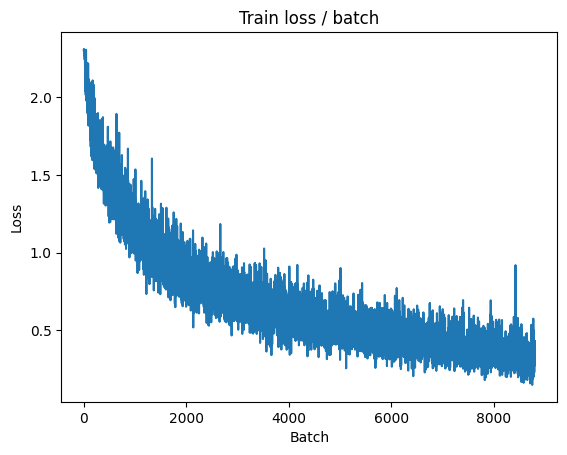


===============> Total time 18s	Avg loss 0.3350	Avg Prec@1 88.26 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.192s (0.192s)	Loss 0.5971 (0.5971)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7106	Avg Prec@1 78.72 %	Avg Prec@5 98.48 %



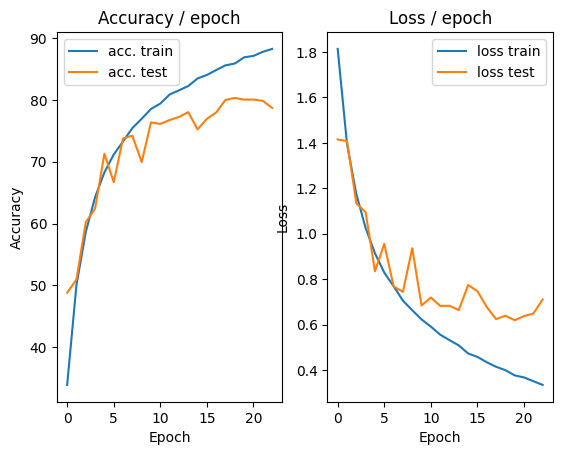

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.335s (0.335s)	Loss 0.3884 (0.3884)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)


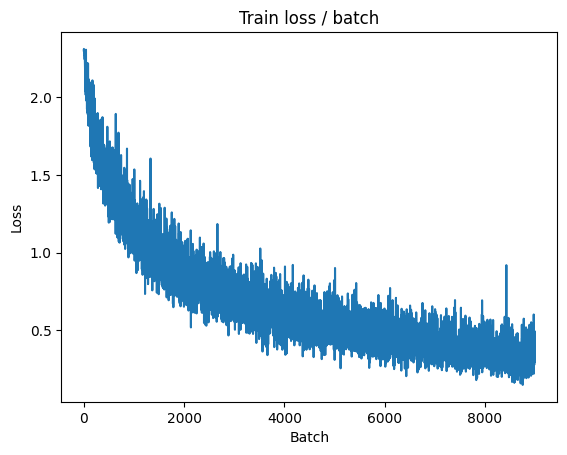

[TRAIN Batch 200/391]	Time 0.021s (0.049s)	Loss 0.3528 (0.3227)	Prec@1  85.9 ( 88.8)	Prec@5 100.0 ( 99.8)


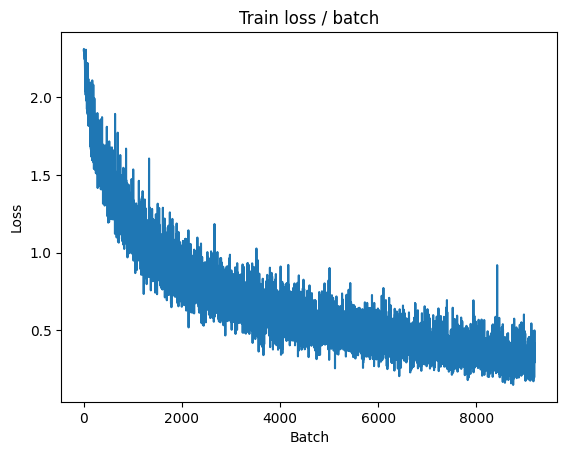


===============> Total time 19s	Avg loss 0.3236	Avg Prec@1 88.69 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.6241 (0.6241)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.6564	Avg Prec@1 79.71 %	Avg Prec@5 98.50 %



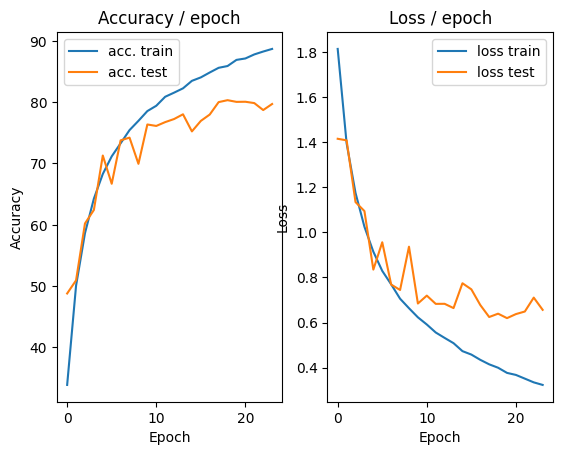

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.3416 (0.3416)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


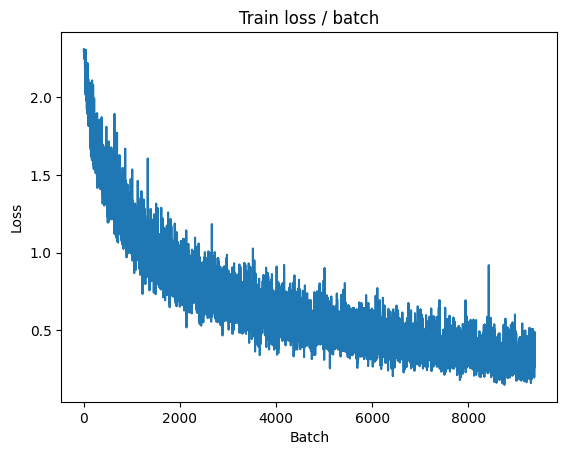

[TRAIN Batch 200/391]	Time 0.074s (0.049s)	Loss 0.3524 (0.3043)	Prec@1  85.9 ( 89.4)	Prec@5 100.0 ( 99.8)


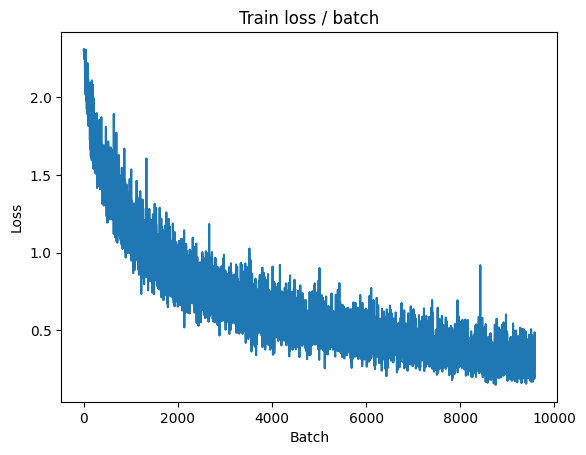


===============> Total time 19s	Avg loss 0.3134	Avg Prec@1 89.05 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.5683 (0.5683)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6209	Avg Prec@1 80.99 %	Avg Prec@5 98.70 %



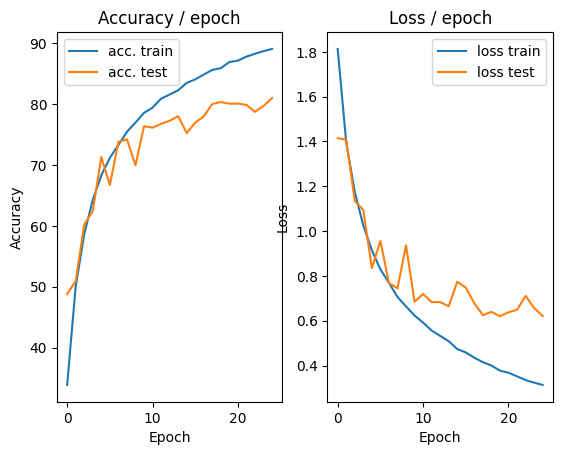

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.205s (0.205s)	Loss 0.2734 (0.2734)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


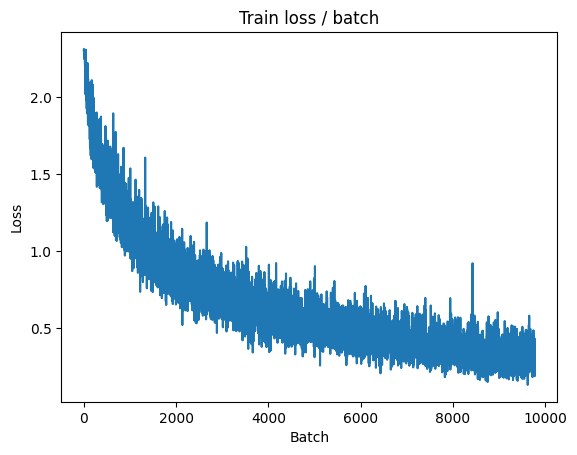

[TRAIN Batch 200/391]	Time 0.041s (0.054s)	Loss 0.4757 (0.2902)	Prec@1  84.4 ( 89.9)	Prec@5 100.0 ( 99.8)


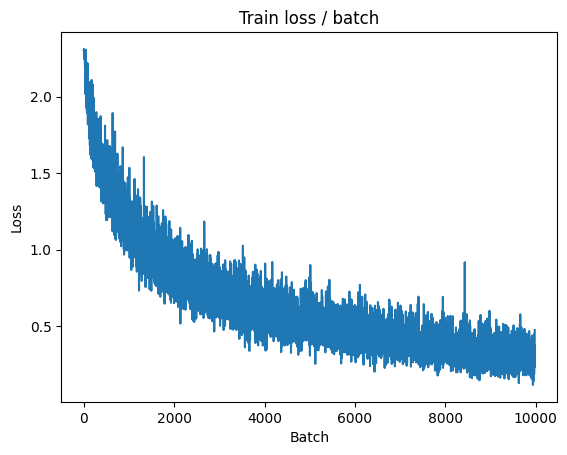


===============> Total time 19s	Avg loss 0.2981	Avg Prec@1 89.50 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.5637 (0.5637)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.6660	Avg Prec@1 80.53 %	Avg Prec@5 98.84 %



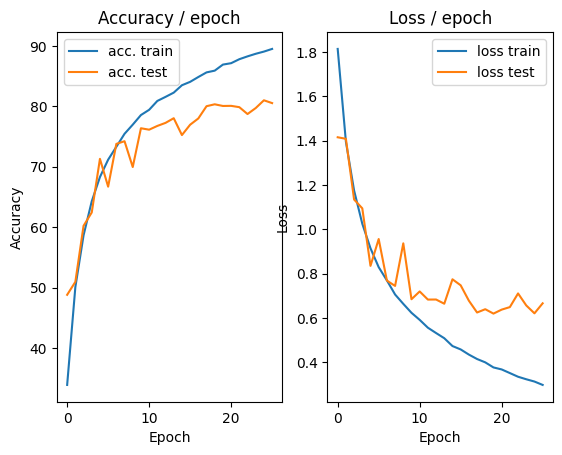

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.1447 (0.1447)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


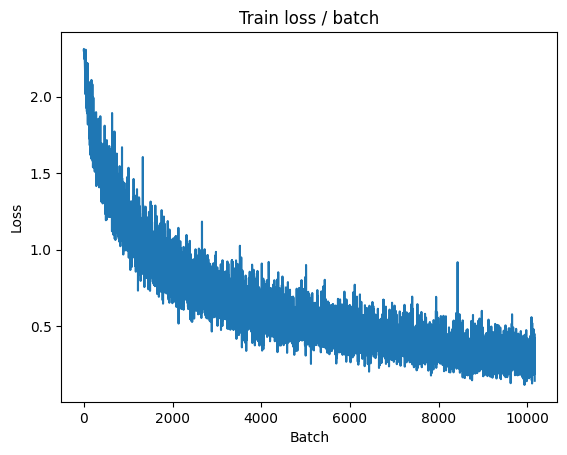

[TRAIN Batch 200/391]	Time 0.143s (0.050s)	Loss 0.3043 (0.2819)	Prec@1  90.6 ( 90.2)	Prec@5 100.0 ( 99.8)


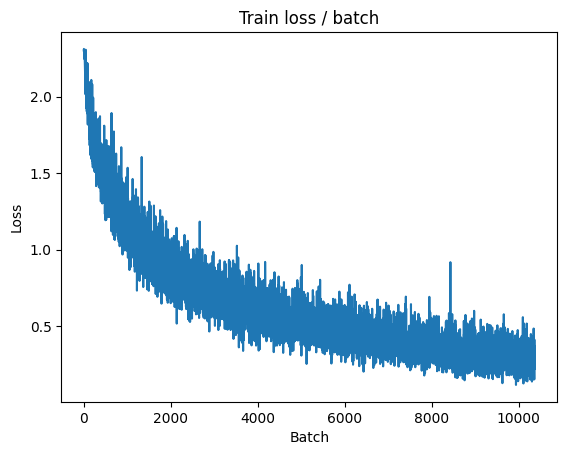


===============> Total time 18s	Avg loss 0.2889	Avg Prec@1 89.86 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.7459 (0.7459)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.6910	Avg Prec@1 80.56 %	Avg Prec@5 98.70 %



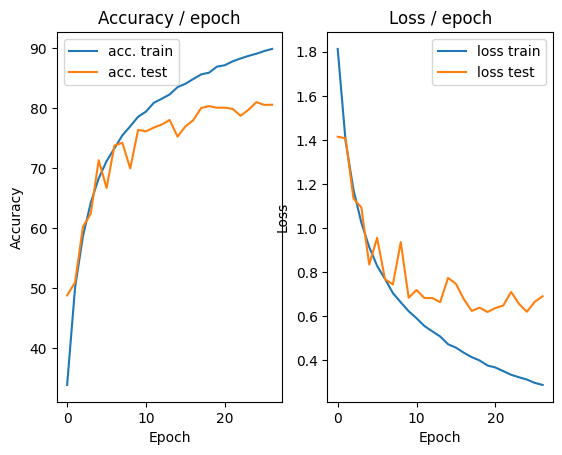

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.247s (0.247s)	Loss 0.2811 (0.2811)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


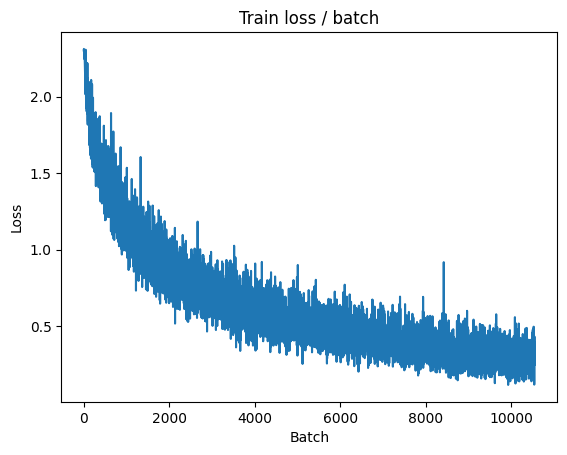

[TRAIN Batch 200/391]	Time 0.072s (0.050s)	Loss 0.3282 (0.2622)	Prec@1  88.3 ( 90.9)	Prec@5 100.0 ( 99.9)


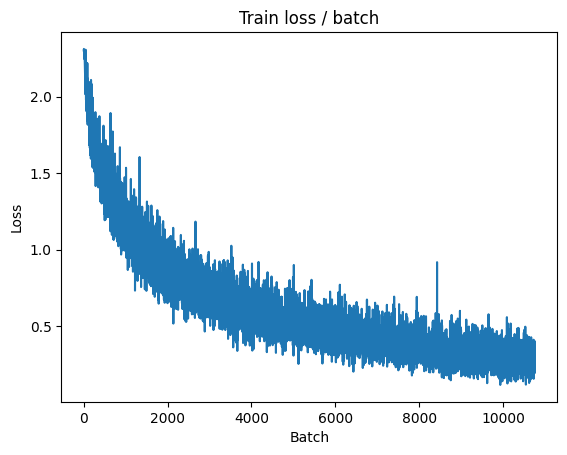


===============> Total time 19s	Avg loss 0.2795	Avg Prec@1 90.16 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.6555 (0.6555)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.6964	Avg Prec@1 79.75 %	Avg Prec@5 98.70 %



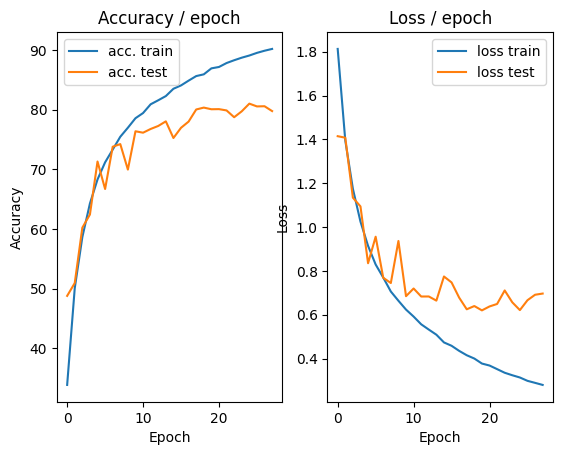

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.2236 (0.2236)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


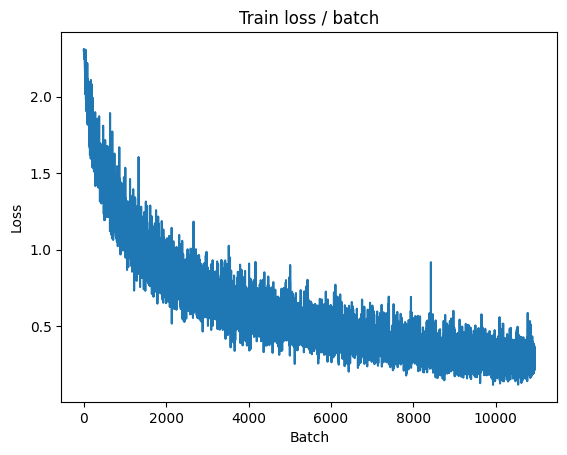

[TRAIN Batch 200/391]	Time 0.031s (0.049s)	Loss 0.2894 (0.2545)	Prec@1  88.3 ( 91.2)	Prec@5 100.0 ( 99.8)


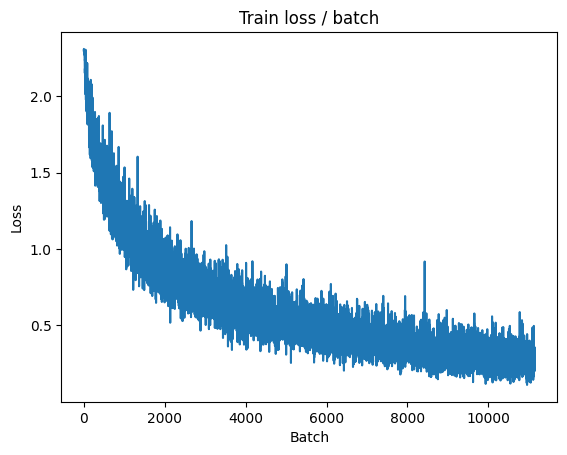


===============> Total time 19s	Avg loss 0.2617	Avg Prec@1 90.93 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.177s (0.177s)	Loss 0.6828 (0.6828)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7235	Avg Prec@1 80.14 %	Avg Prec@5 98.62 %



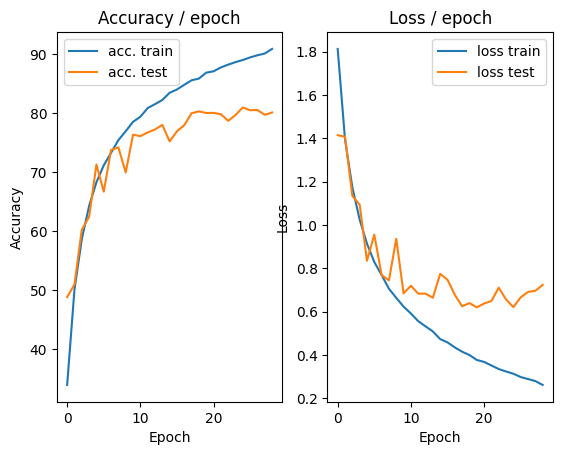

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.240s (0.240s)	Loss 0.3280 (0.3280)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


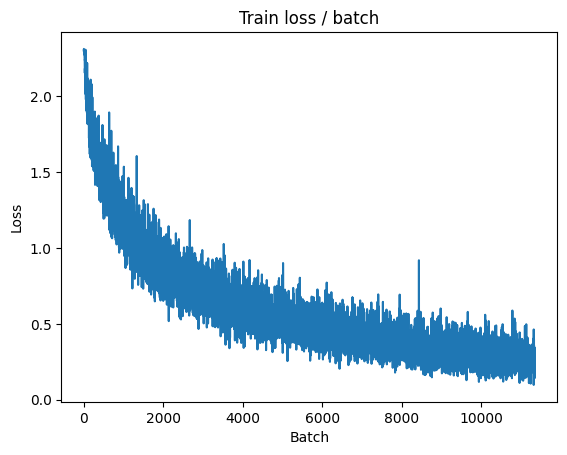

[TRAIN Batch 200/391]	Time 0.030s (0.050s)	Loss 0.2834 (0.2602)	Prec@1  92.2 ( 90.9)	Prec@5 100.0 ( 99.9)


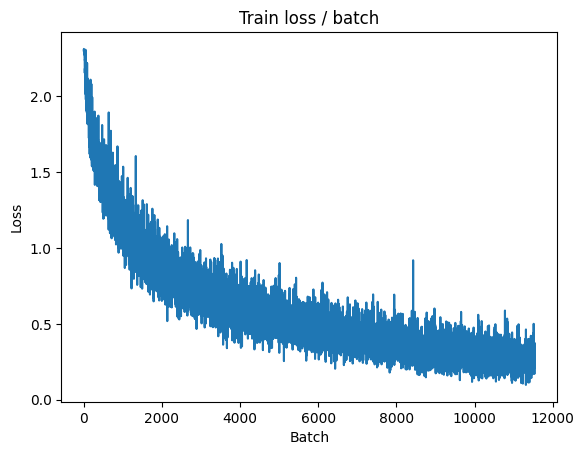


===============> Total time 19s	Avg loss 0.2617	Avg Prec@1 90.85 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.208s (0.208s)	Loss 0.5749 (0.5749)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.7113	Avg Prec@1 80.02 %	Avg Prec@5 98.56 %



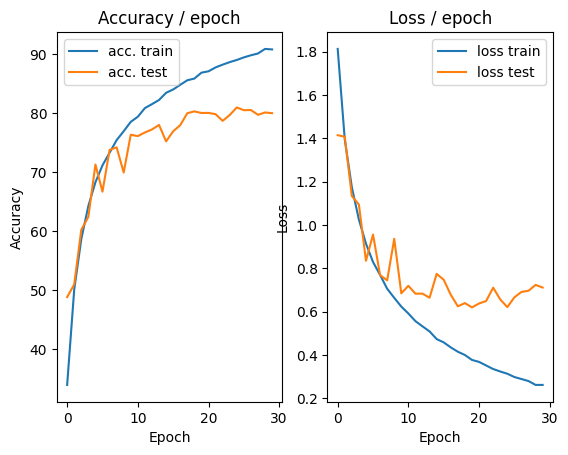

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.212s (0.212s)	Loss 0.2516 (0.2516)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


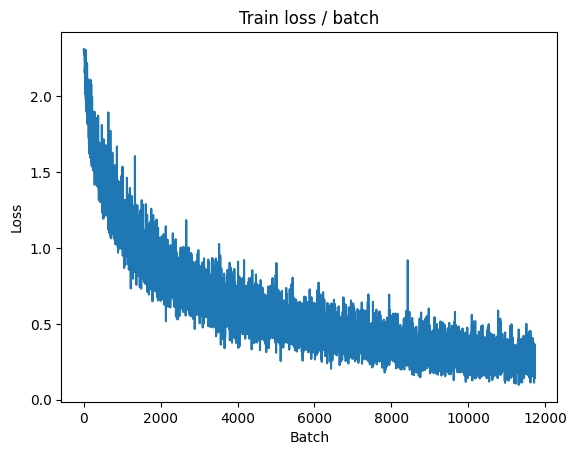

[TRAIN Batch 200/391]	Time 0.057s (0.050s)	Loss 0.2846 (0.2400)	Prec@1  91.4 ( 91.6)	Prec@5 100.0 ( 99.9)


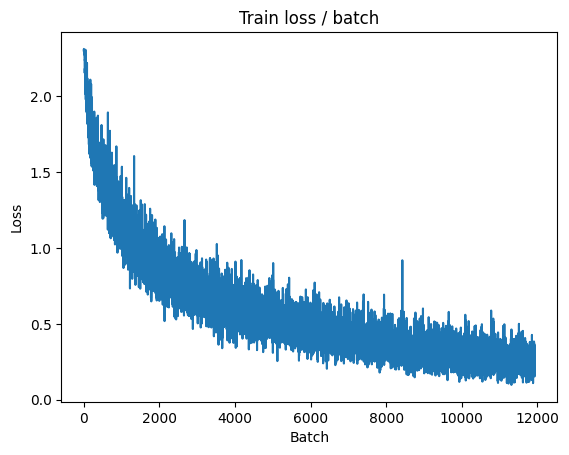


===============> Total time 18s	Avg loss 0.2468	Avg Prec@1 91.37 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.5686 (0.5686)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.6715	Avg Prec@1 80.80 %	Avg Prec@5 98.75 %



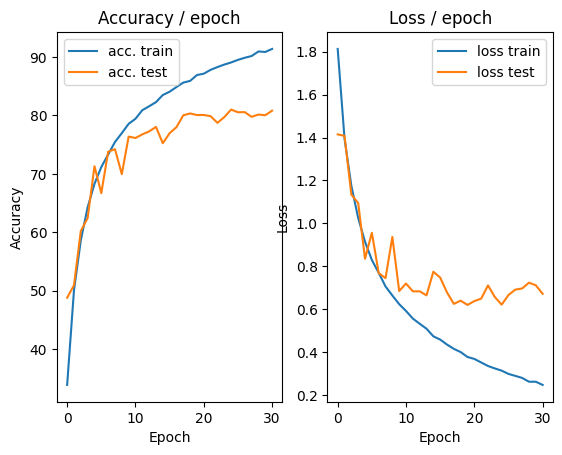

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.2245 (0.2245)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


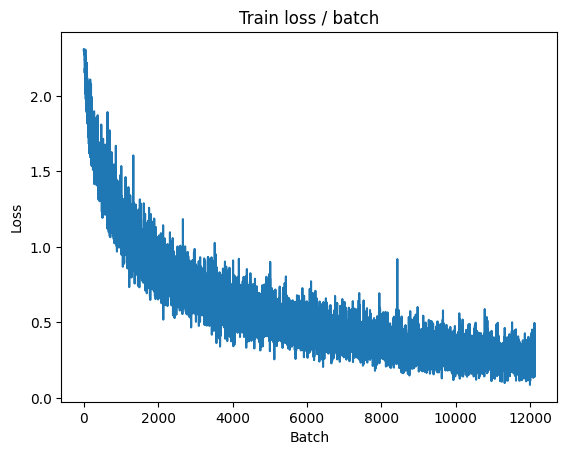

[TRAIN Batch 200/391]	Time 0.013s (0.044s)	Loss 0.2073 (0.2304)	Prec@1  92.2 ( 92.0)	Prec@5 100.0 ( 99.9)


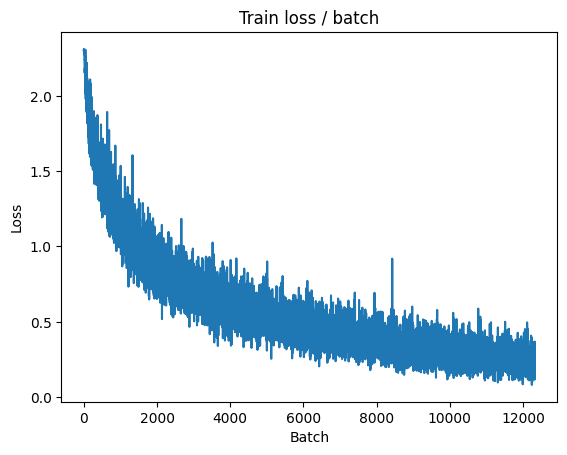


===============> Total time 18s	Avg loss 0.2391	Avg Prec@1 91.72 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.187s (0.187s)	Loss 0.6744 (0.6744)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7013	Avg Prec@1 80.45 %	Avg Prec@5 98.79 %



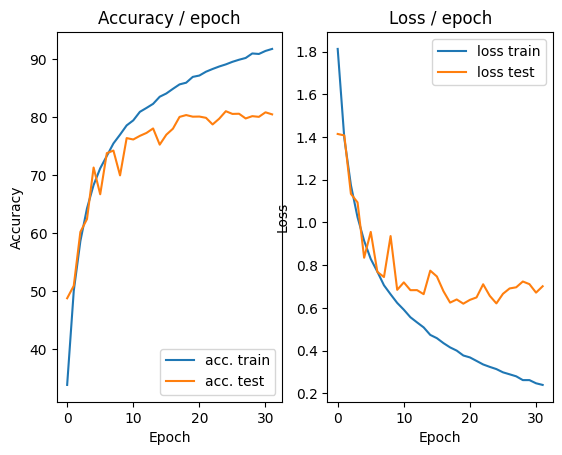

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.2106 (0.2106)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


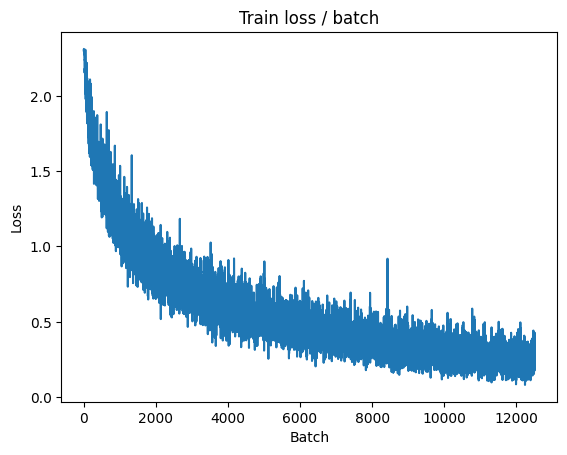

[TRAIN Batch 200/391]	Time 0.015s (0.050s)	Loss 0.1110 (0.2162)	Prec@1  94.5 ( 92.6)	Prec@5 100.0 ( 99.9)


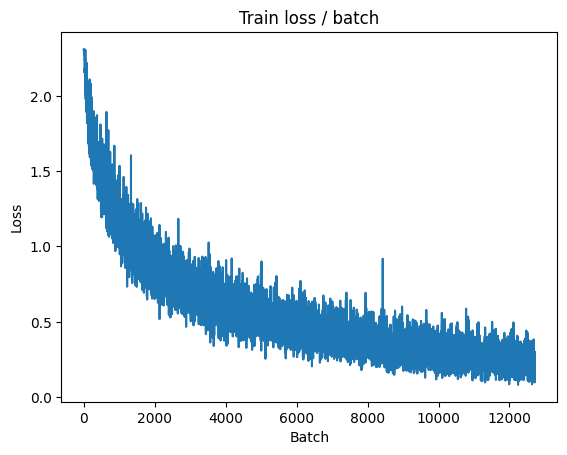


===============> Total time 19s	Avg loss 0.2331	Avg Prec@1 91.97 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.181s (0.181s)	Loss 0.5729 (0.5729)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7066	Avg Prec@1 80.47 %	Avg Prec@5 98.76 %



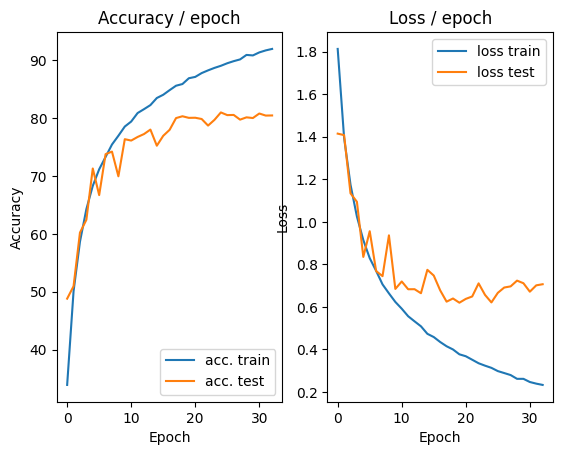

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.239s (0.239s)	Loss 0.1758 (0.1758)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


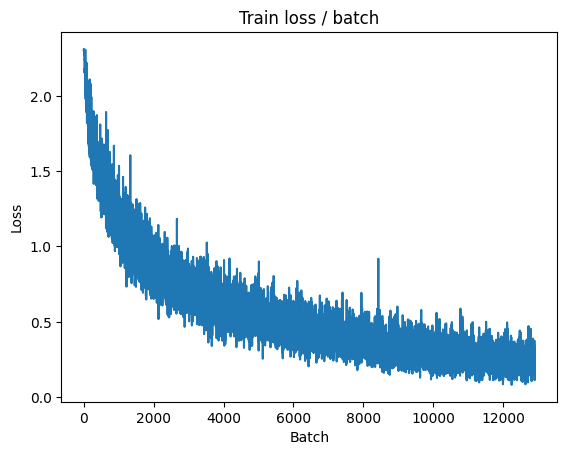

[TRAIN Batch 200/391]	Time 0.015s (0.049s)	Loss 0.2023 (0.2278)	Prec@1  93.8 ( 92.2)	Prec@5 100.0 ( 99.9)


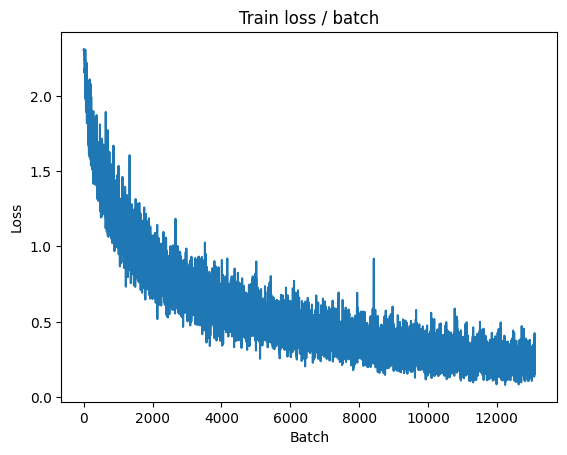


===============> Total time 19s	Avg loss 0.2274	Avg Prec@1 92.26 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.7102 (0.7102)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7538	Avg Prec@1 80.51 %	Avg Prec@5 98.62 %



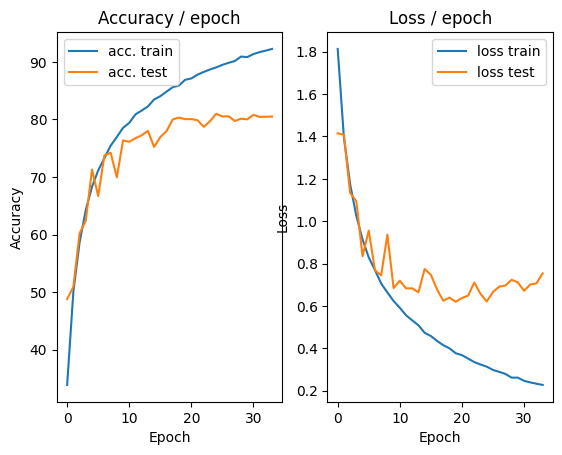

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.272s (0.272s)	Loss 0.1290 (0.1290)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


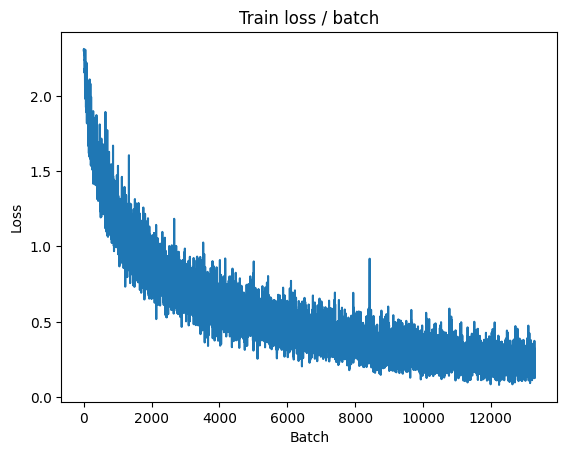

[TRAIN Batch 200/391]	Time 0.015s (0.049s)	Loss 0.1223 (0.2090)	Prec@1  93.8 ( 92.8)	Prec@5 100.0 ( 99.9)


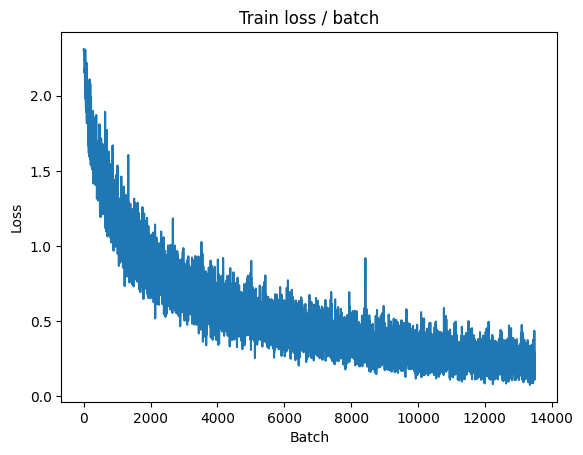


===============> Total time 17s	Avg loss 0.2259	Avg Prec@1 92.06 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.180s (0.180s)	Loss 0.6791 (0.6791)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8605	Avg Prec@1 78.55 %	Avg Prec@5 98.68 %



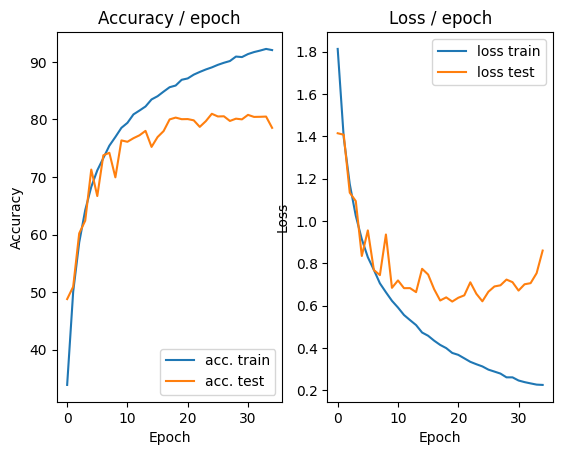

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.3266 (0.3266)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


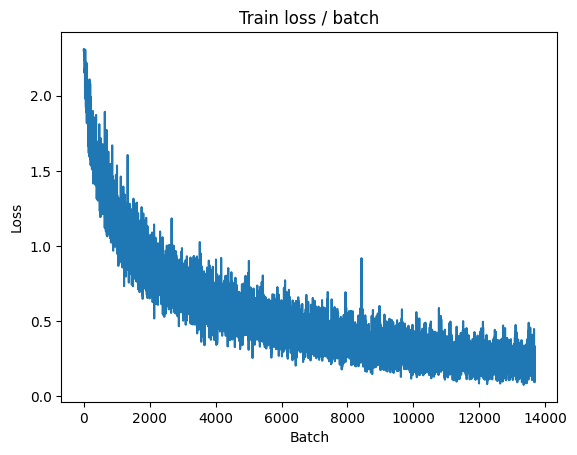

[TRAIN Batch 200/391]	Time 0.046s (0.045s)	Loss 0.2578 (0.2144)	Prec@1  89.1 ( 92.3)	Prec@5 100.0 ( 99.9)


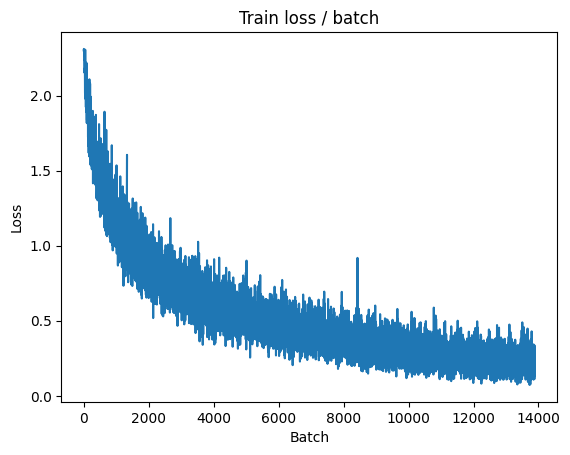


===============> Total time 18s	Avg loss 0.2149	Avg Prec@1 92.36 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.169s (0.169s)	Loss 0.7527 (0.7527)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7501	Avg Prec@1 79.88 %	Avg Prec@5 98.61 %



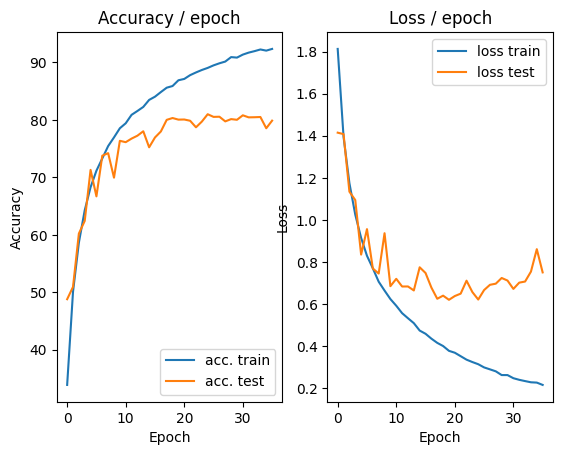

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.1542 (0.1542)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


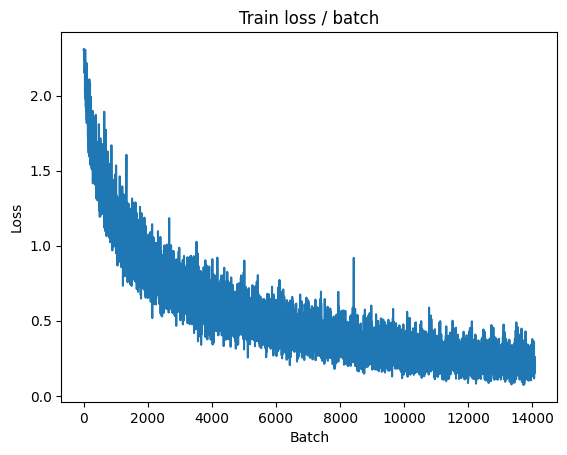

[TRAIN Batch 200/391]	Time 0.014s (0.050s)	Loss 0.2521 (0.2065)	Prec@1  91.4 ( 92.9)	Prec@5 100.0 ( 99.9)


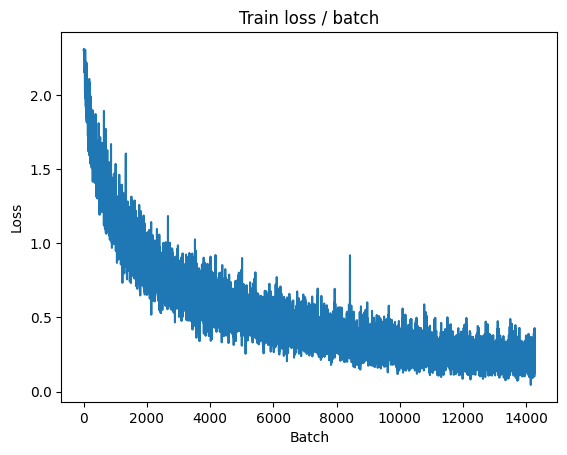


===============> Total time 19s	Avg loss 0.2111	Avg Prec@1 92.74 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.198s (0.198s)	Loss 0.7123 (0.7123)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8193	Avg Prec@1 78.75 %	Avg Prec@5 98.37 %



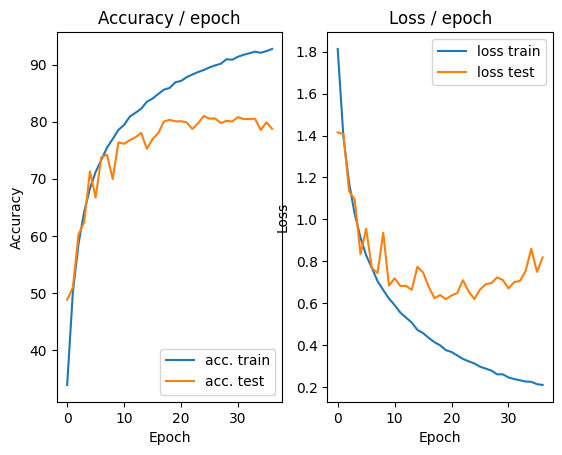

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.2572 (0.2572)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


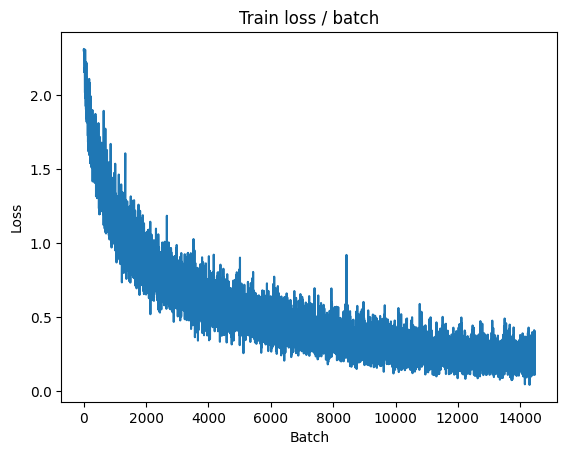

[TRAIN Batch 200/391]	Time 0.016s (0.047s)	Loss 0.1911 (0.2018)	Prec@1  93.0 ( 93.2)	Prec@5 100.0 ( 99.9)


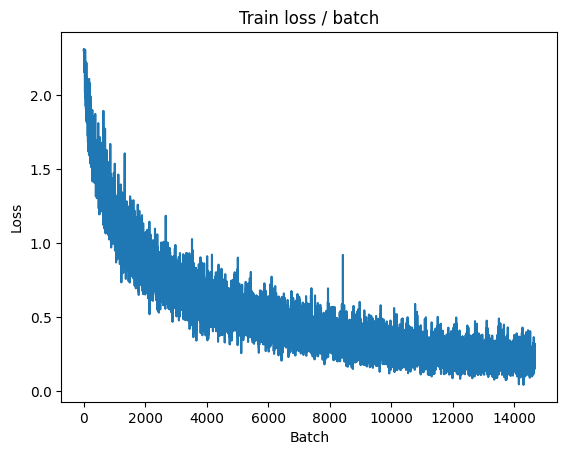


===============> Total time 18s	Avg loss 0.2059	Avg Prec@1 93.01 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.174s (0.174s)	Loss 0.6377 (0.6377)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7767	Avg Prec@1 80.55 %	Avg Prec@5 98.67 %



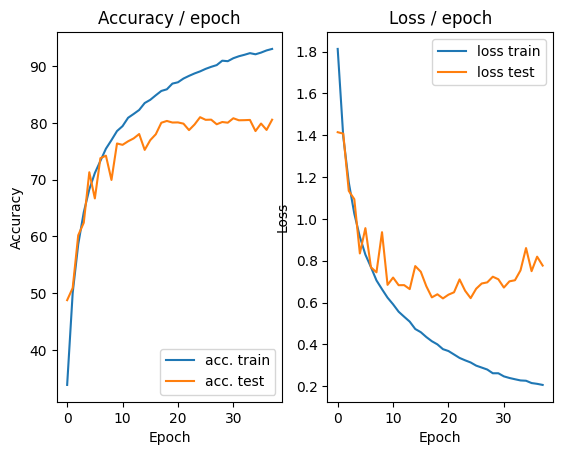

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.2963 (0.2963)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


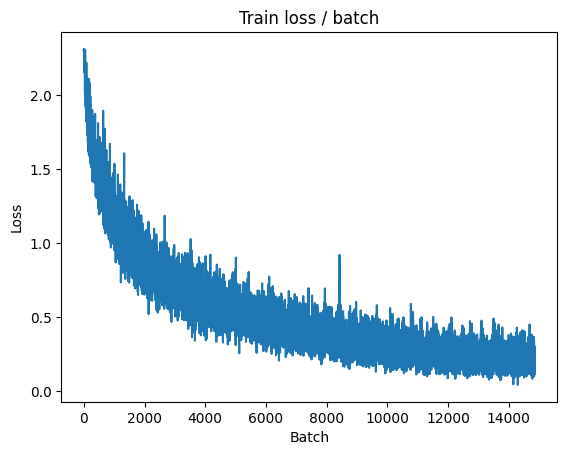

[TRAIN Batch 200/391]	Time 0.009s (0.047s)	Loss 0.1360 (0.1989)	Prec@1  95.3 ( 93.1)	Prec@5 100.0 ( 99.9)


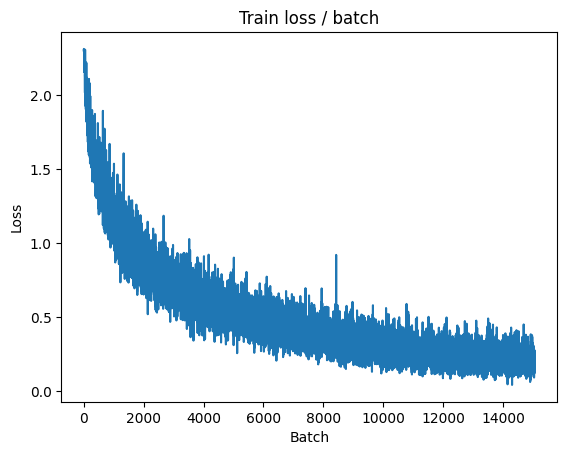


===============> Total time 18s	Avg loss 0.1992	Avg Prec@1 93.05 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.6137 (0.6137)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8229	Avg Prec@1 80.62 %	Avg Prec@5 98.75 %



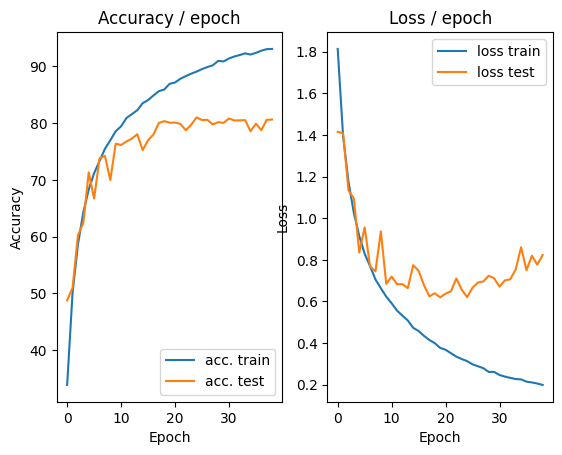

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.343s (0.343s)	Loss 0.1522 (0.1522)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


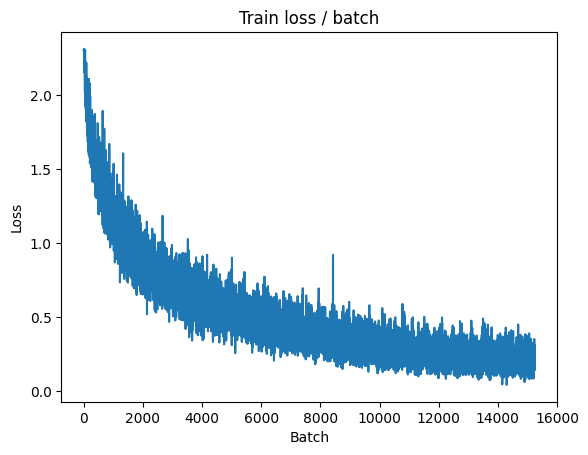

[TRAIN Batch 200/391]	Time 0.016s (0.051s)	Loss 0.1769 (0.1785)	Prec@1  93.8 ( 93.6)	Prec@5 100.0 ( 99.9)


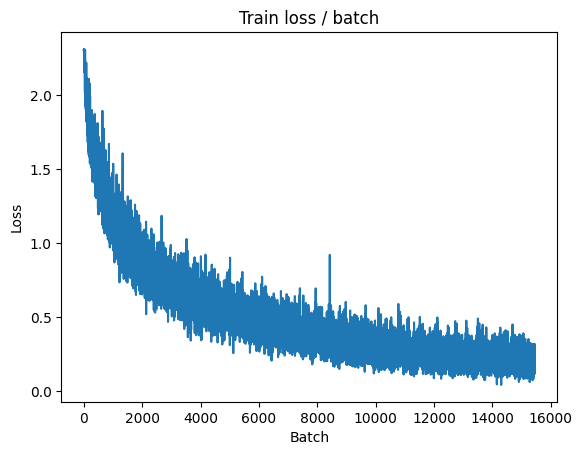


===============> Total time 18s	Avg loss 0.1918	Avg Prec@1 93.25 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.189s (0.189s)	Loss 0.7287 (0.7287)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.7630	Avg Prec@1 81.24 %	Avg Prec@5 98.68 %



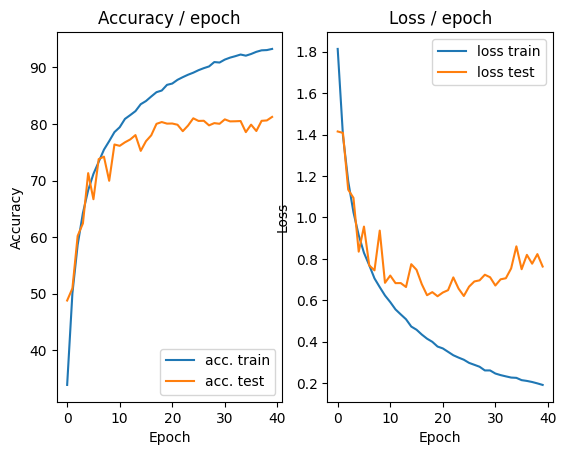

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.207s (0.207s)	Loss 0.1500 (0.1500)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


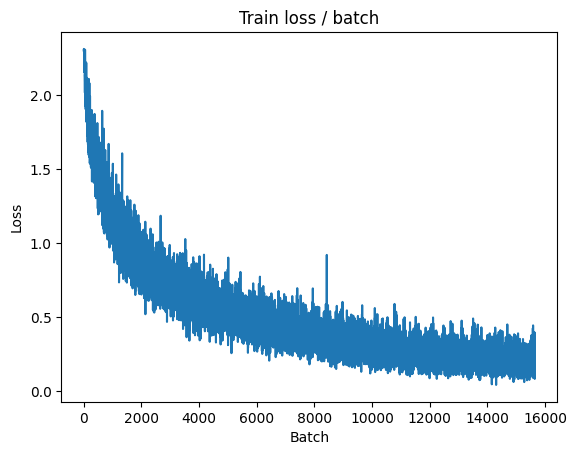

[TRAIN Batch 200/391]	Time 0.009s (0.048s)	Loss 0.1822 (0.1839)	Prec@1  93.0 ( 93.6)	Prec@5 100.0 ( 99.9)


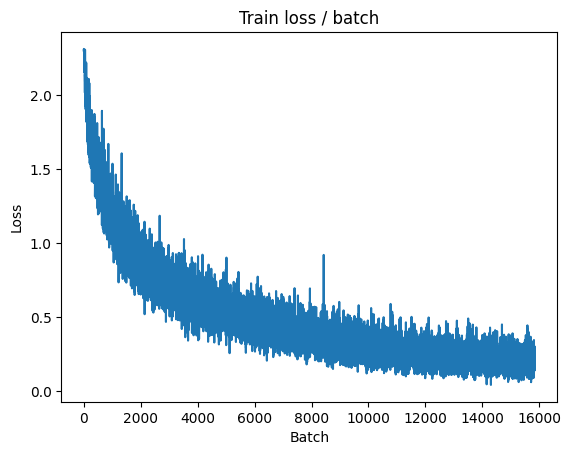


===============> Total time 17s	Avg loss 0.1941	Avg Prec@1 93.25 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.8359 (0.8359)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 3s	Avg loss 0.8398	Avg Prec@1 80.03 %	Avg Prec@5 98.63 %



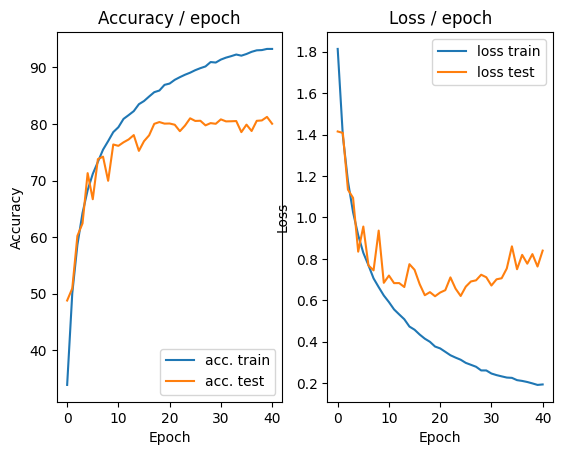

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.261s (0.261s)	Loss 0.1880 (0.1880)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


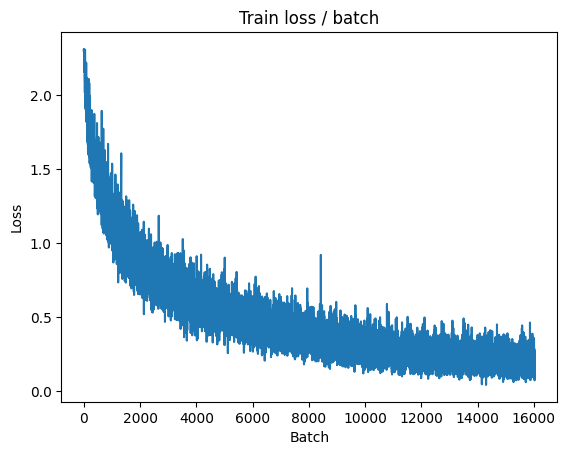

[TRAIN Batch 200/391]	Time 0.017s (0.044s)	Loss 0.2066 (0.1736)	Prec@1  92.2 ( 94.1)	Prec@5 100.0 ( 99.9)


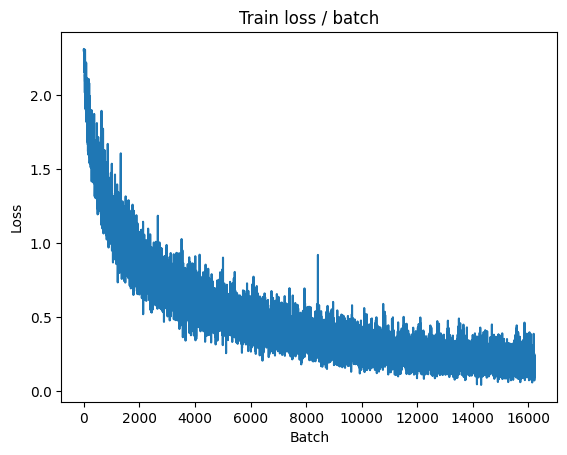


===============> Total time 17s	Avg loss 0.1848	Avg Prec@1 93.70 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.175s (0.175s)	Loss 0.7071 (0.7071)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.7592	Avg Prec@1 80.58 %	Avg Prec@5 98.71 %



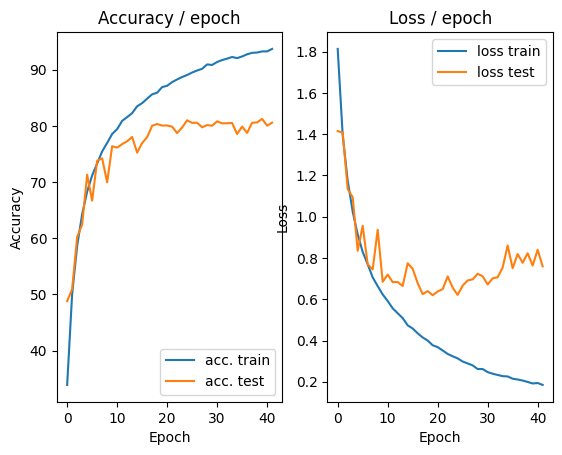

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.344s (0.344s)	Loss 0.1647 (0.1647)	Prec@1  94.5 ( 94.5)	Prec@5  99.2 ( 99.2)


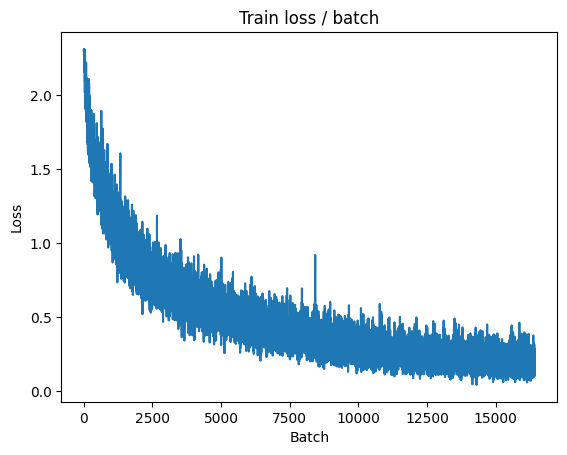

[TRAIN Batch 200/391]	Time 0.064s (0.047s)	Loss 0.1114 (0.1725)	Prec@1  95.3 ( 94.1)	Prec@5 100.0 ( 99.9)


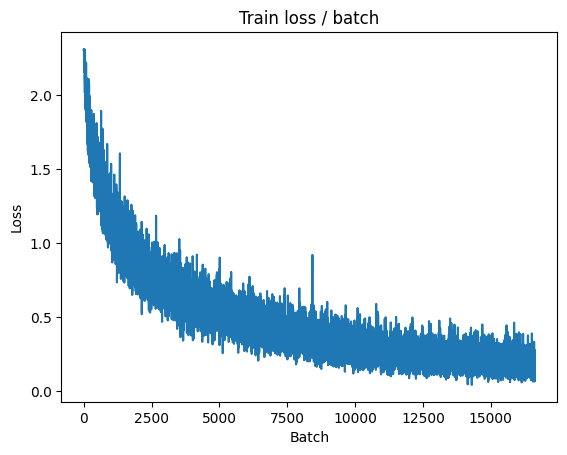


===============> Total time 18s	Avg loss 0.1780	Avg Prec@1 93.88 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.166s (0.166s)	Loss 0.7181 (0.7181)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7858	Avg Prec@1 80.75 %	Avg Prec@5 98.82 %



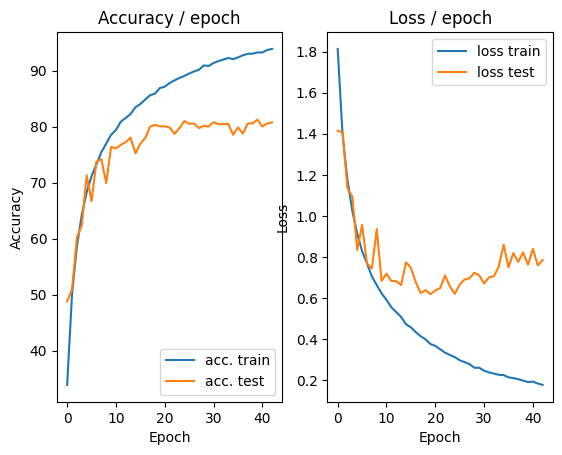

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.252s (0.252s)	Loss 0.1856 (0.1856)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


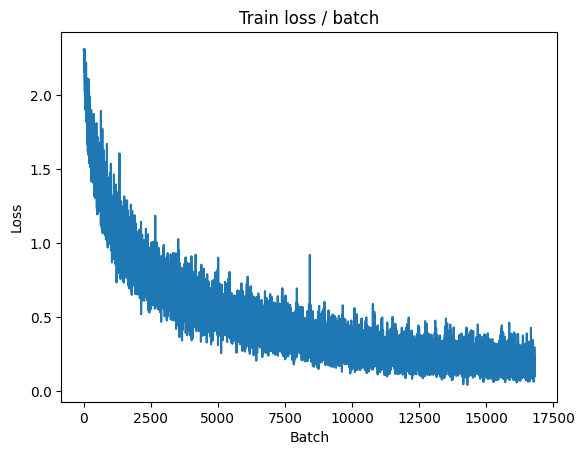

[TRAIN Batch 200/391]	Time 0.008s (0.048s)	Loss 0.1653 (0.1698)	Prec@1  94.5 ( 94.3)	Prec@5 100.0 (100.0)


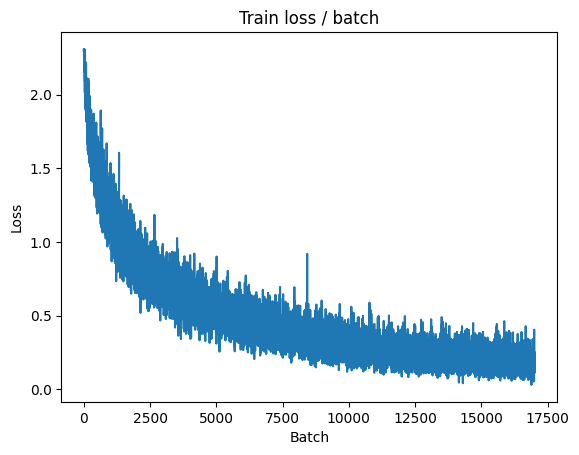


===============> Total time 18s	Avg loss 0.1758	Avg Prec@1 94.03 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.6205 (0.6205)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8399	Avg Prec@1 79.98 %	Avg Prec@5 98.45 %



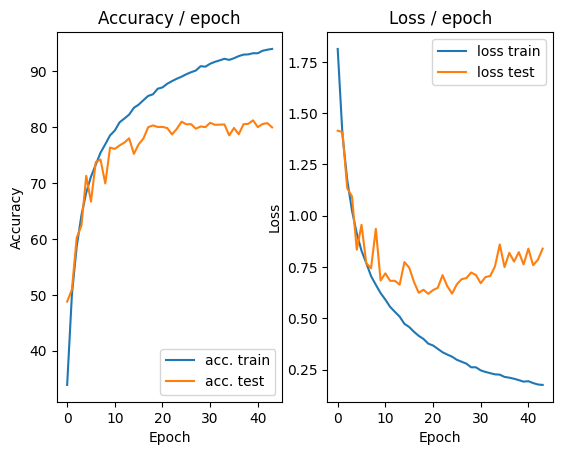

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.269s (0.269s)	Loss 0.0937 (0.0937)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


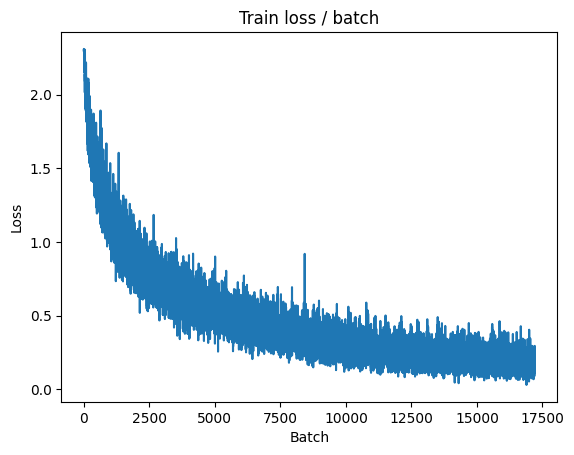

[TRAIN Batch 200/391]	Time 0.065s (0.048s)	Loss 0.2481 (0.1720)	Prec@1  93.8 ( 94.0)	Prec@5 100.0 (100.0)


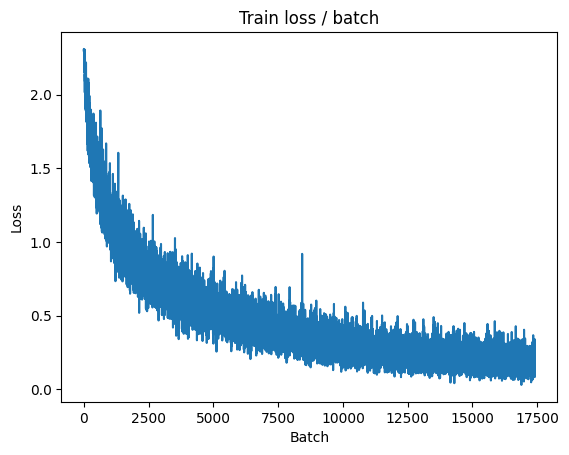


===============> Total time 18s	Avg loss 0.1743	Avg Prec@1 93.92 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.6473 (0.6473)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7984	Avg Prec@1 81.22 %	Avg Prec@5 98.70 %



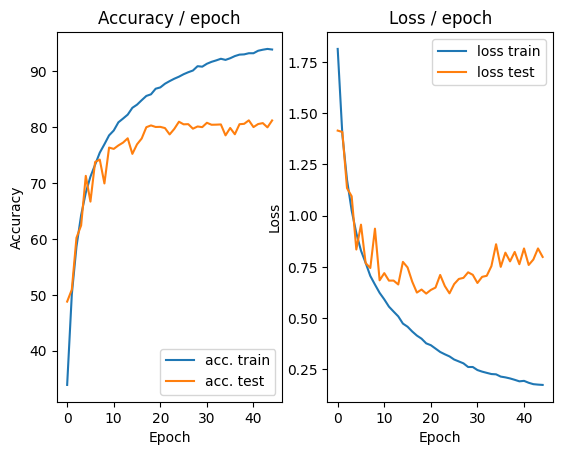

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.0589 (0.0589)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


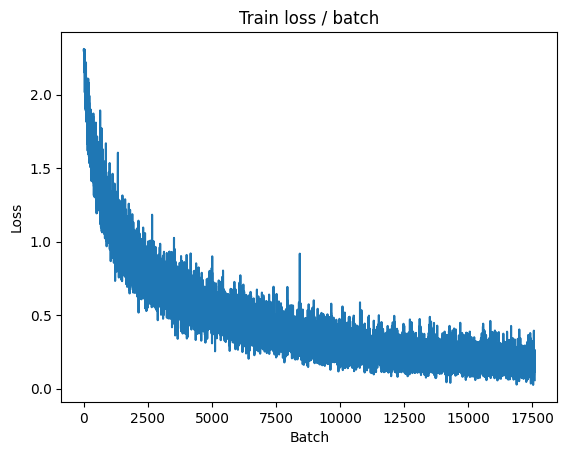

[TRAIN Batch 200/391]	Time 0.025s (0.048s)	Loss 0.2288 (0.1719)	Prec@1  94.5 ( 94.3)	Prec@5 100.0 (100.0)


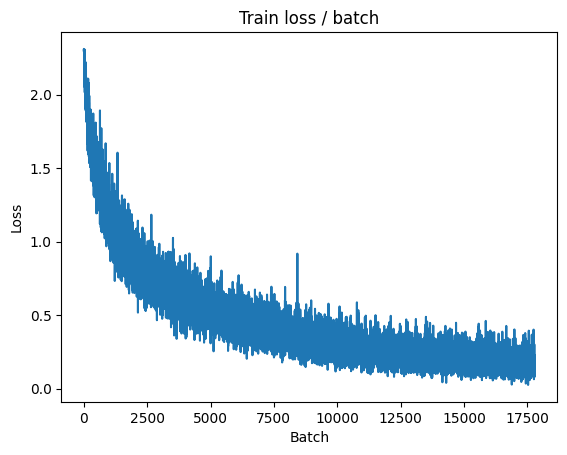


===============> Total time 18s	Avg loss 0.1729	Avg Prec@1 94.09 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.210s (0.210s)	Loss 0.6367 (0.6367)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.7946	Avg Prec@1 80.44 %	Avg Prec@5 98.44 %



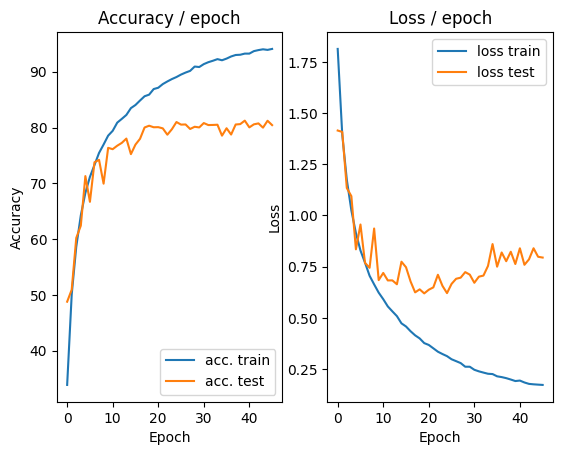

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 0.1745 (0.1745)	Prec@1  94.5 ( 94.5)	Prec@5  99.2 ( 99.2)


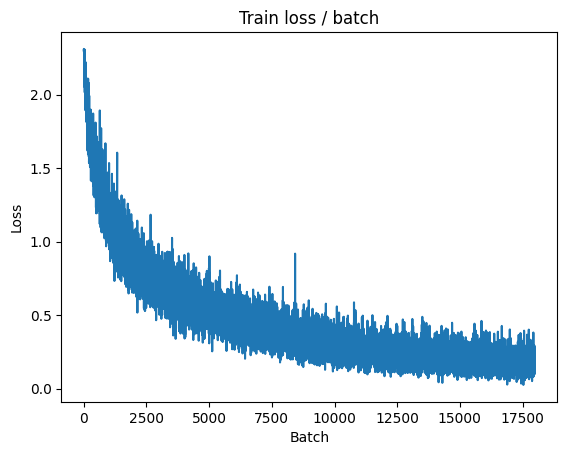

[TRAIN Batch 200/391]	Time 0.039s (0.047s)	Loss 0.0992 (0.1740)	Prec@1  96.9 ( 93.9)	Prec@5 100.0 (100.0)


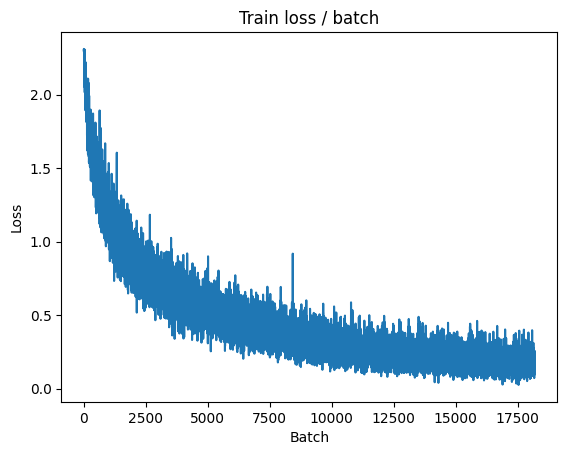


===============> Total time 17s	Avg loss 0.1750	Avg Prec@1 93.94 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.170s (0.170s)	Loss 0.6373 (0.6373)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.8462	Avg Prec@1 80.05 %	Avg Prec@5 98.68 %



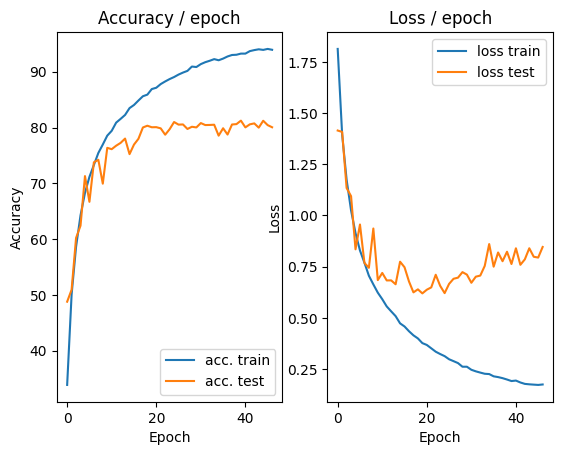

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.191s (0.191s)	Loss 0.2510 (0.2510)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


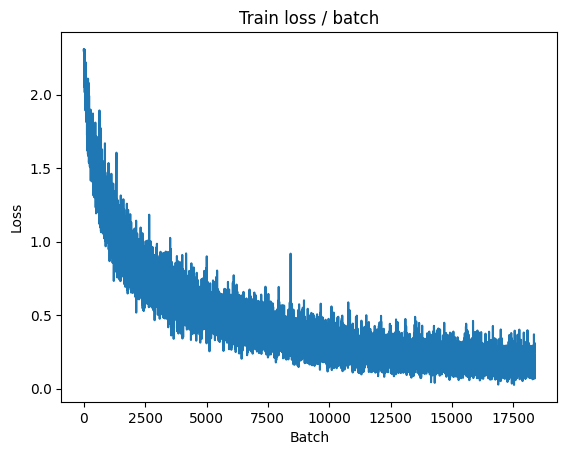

[TRAIN Batch 200/391]	Time 0.025s (0.043s)	Loss 0.1920 (0.1667)	Prec@1  93.0 ( 94.3)	Prec@5 100.0 (100.0)


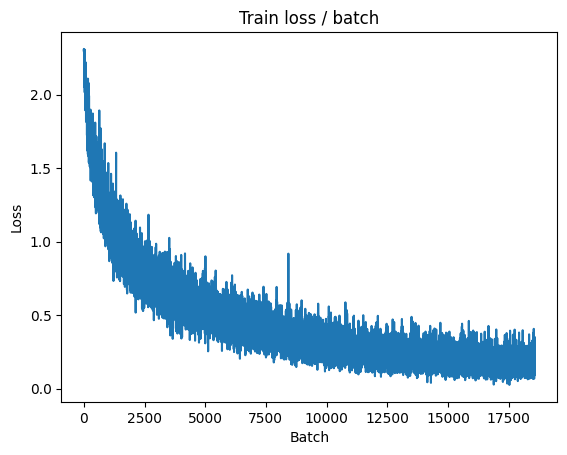


===============> Total time 17s	Avg loss 0.1693	Avg Prec@1 94.27 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.6374 (0.6374)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.7873	Avg Prec@1 81.09 %	Avg Prec@5 98.90 %



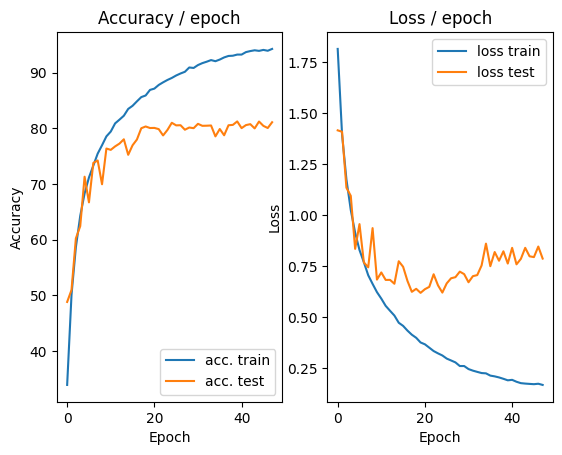

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.213s (0.213s)	Loss 0.1883 (0.1883)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


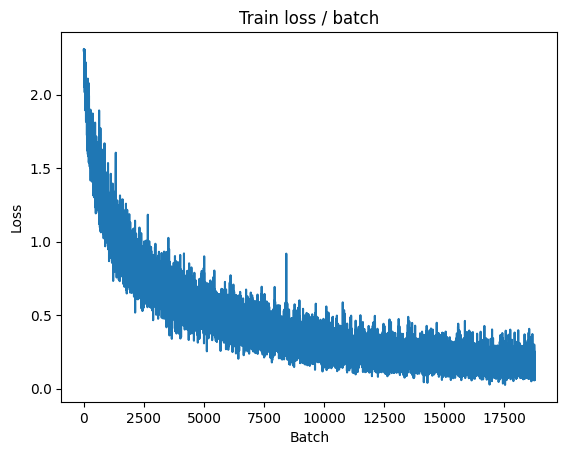

[TRAIN Batch 200/391]	Time 0.014s (0.050s)	Loss 0.1009 (0.1535)	Prec@1  97.7 ( 94.8)	Prec@5 100.0 (100.0)


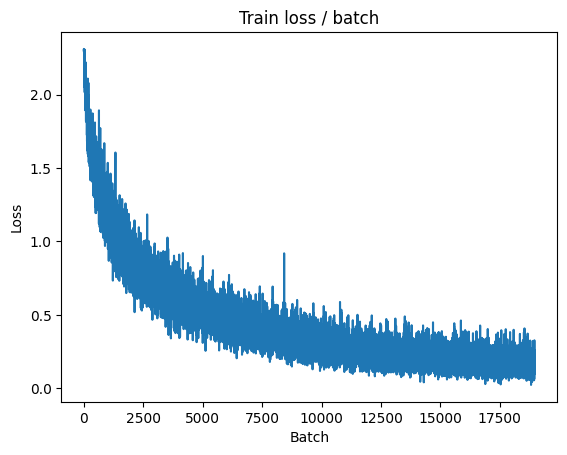


===============> Total time 18s	Avg loss 0.1606	Avg Prec@1 94.52 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.8003 (0.8003)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8405	Avg Prec@1 79.98 %	Avg Prec@5 98.59 %



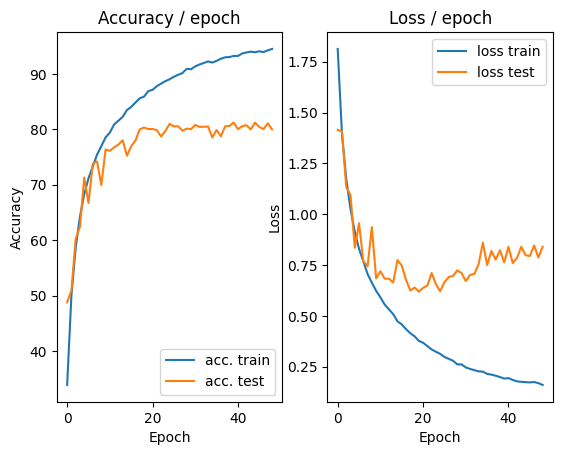

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.248s (0.248s)	Loss 0.2431 (0.2431)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


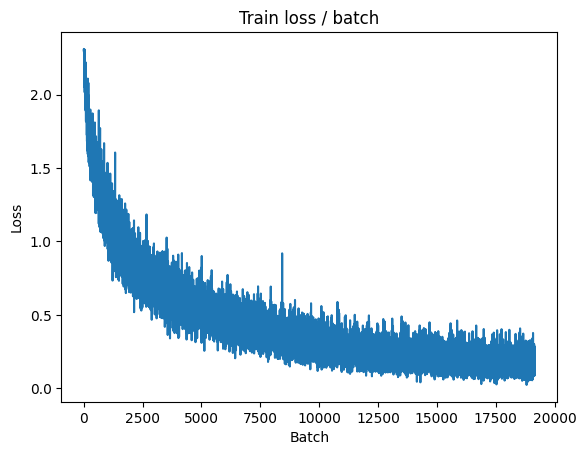

[TRAIN Batch 200/391]	Time 0.015s (0.048s)	Loss 0.0892 (0.1519)	Prec@1  93.8 ( 94.7)	Prec@5 100.0 (100.0)


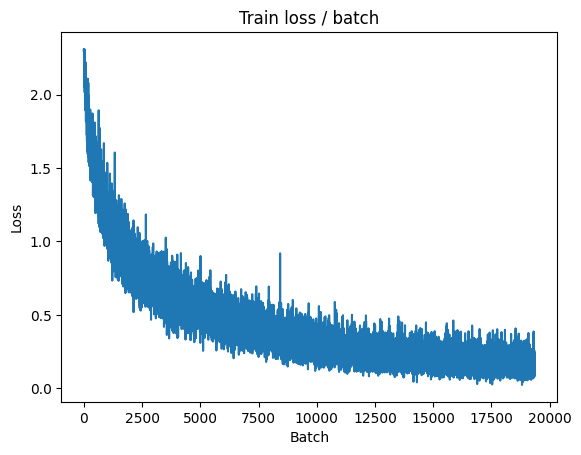


===============> Total time 18s	Avg loss 0.1585	Avg Prec@1 94.53 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.7190 (0.7190)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.8659	Avg Prec@1 80.48 %	Avg Prec@5 98.57 %



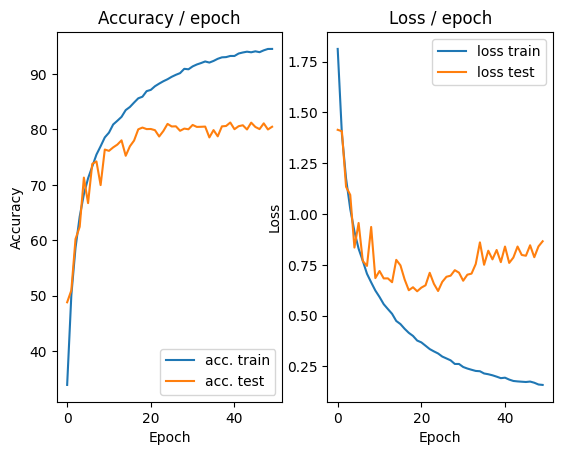

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.228s (0.228s)	Loss 0.2086 (0.2086)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


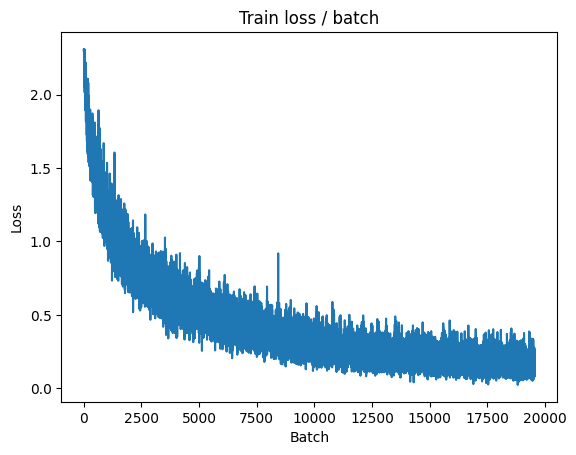

[TRAIN Batch 200/391]	Time 0.026s (0.048s)	Loss 0.1228 (0.1417)	Prec@1  96.9 ( 95.2)	Prec@5 100.0 (100.0)


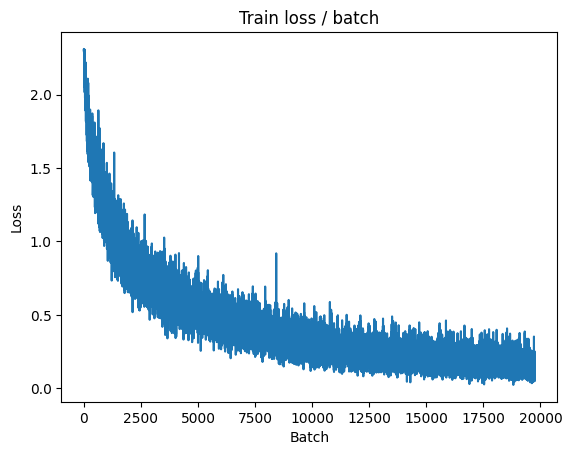


===============> Total time 19s	Avg loss 0.1515	Avg Prec@1 94.87 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.211s (0.211s)	Loss 0.6372 (0.6372)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.8775	Avg Prec@1 80.72 %	Avg Prec@5 98.62 %



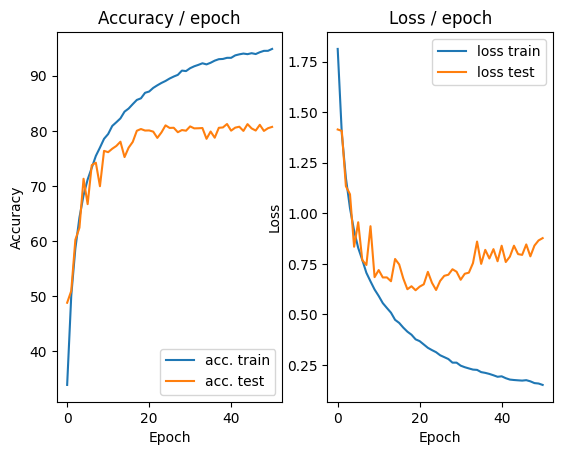

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.1175 (0.1175)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


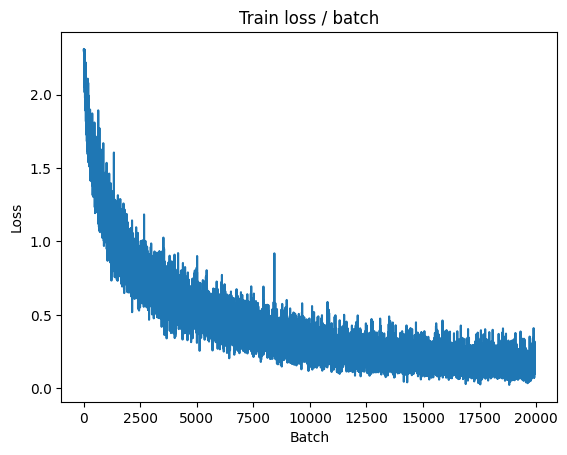

[TRAIN Batch 200/391]	Time 0.014s (0.048s)	Loss 0.1430 (0.1388)	Prec@1  96.1 ( 95.2)	Prec@5 100.0 (100.0)


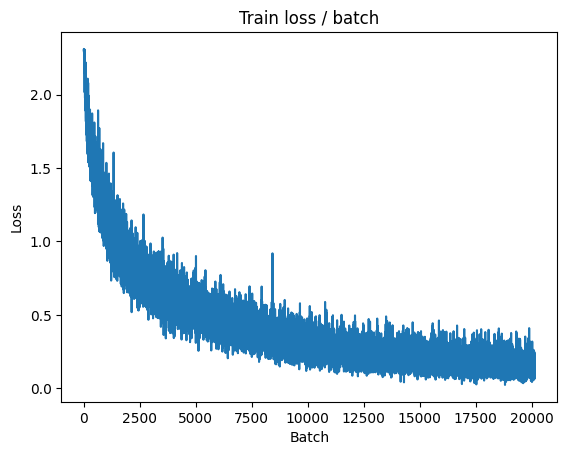


===============> Total time 18s	Avg loss 0.1462	Avg Prec@1 94.99 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.5941 (0.5941)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)

===============> Total time 2s	Avg loss 0.8548	Avg Prec@1 81.31 %	Avg Prec@5 98.64 %



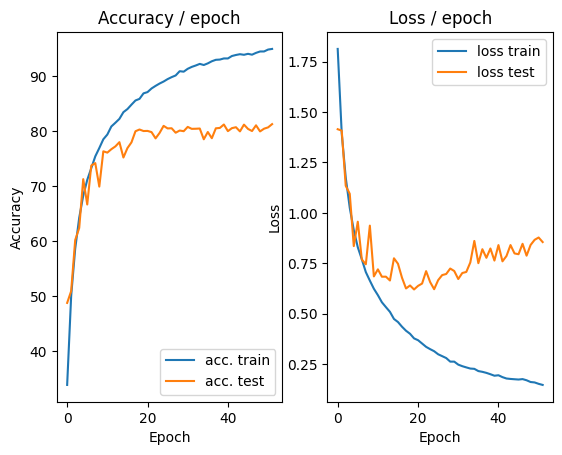

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.233s (0.233s)	Loss 0.1547 (0.1547)	Prec@1  93.8 ( 93.8)	Prec@5  99.2 ( 99.2)


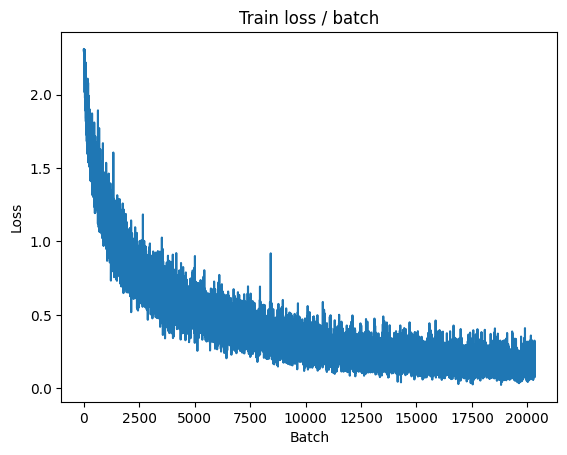

[TRAIN Batch 200/391]	Time 0.016s (0.048s)	Loss 0.1600 (0.1385)	Prec@1  94.5 ( 95.2)	Prec@5 100.0 (100.0)


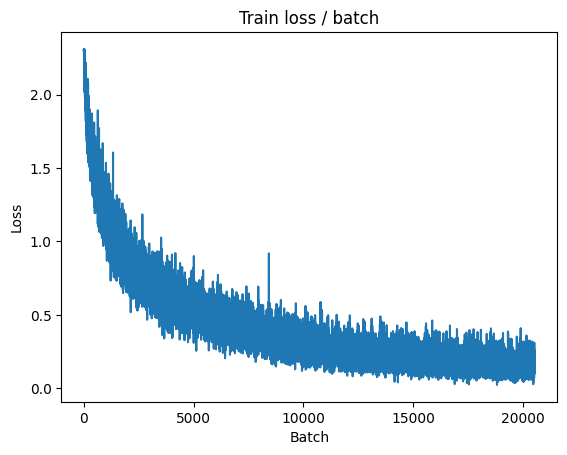


===============> Total time 18s	Avg loss 0.1475	Avg Prec@1 94.91 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.311s (0.311s)	Loss 0.6123 (0.6123)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 3s	Avg loss 0.8559	Avg Prec@1 81.09 %	Avg Prec@5 98.75 %



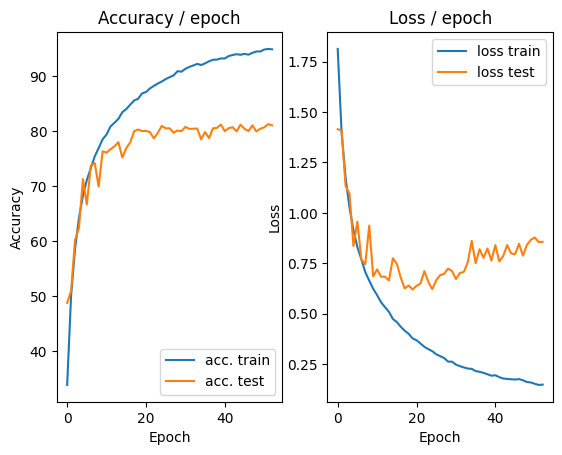

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.273s (0.273s)	Loss 0.1051 (0.1051)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


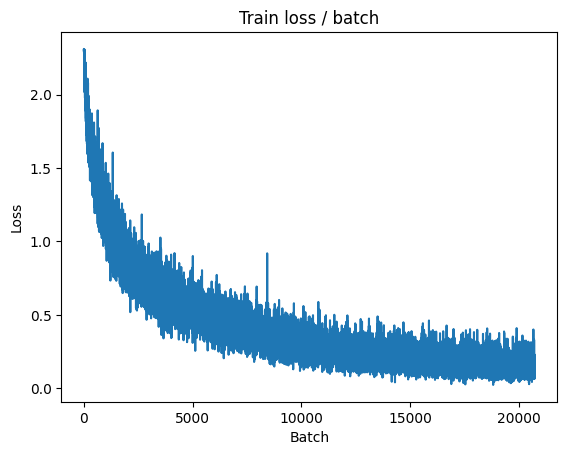

[TRAIN Batch 200/391]	Time 0.054s (0.048s)	Loss 0.0718 (0.1372)	Prec@1  96.9 ( 95.3)	Prec@5 100.0 (100.0)


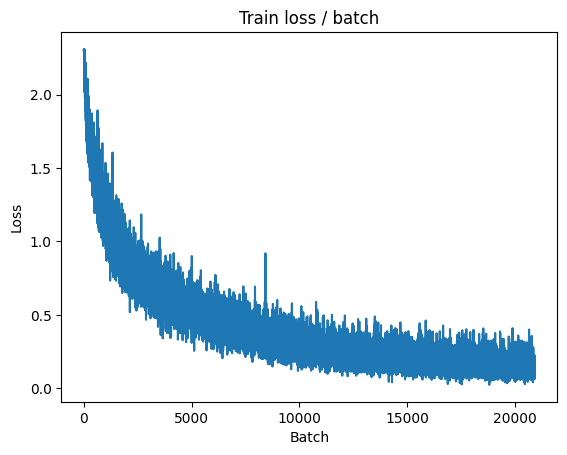


===============> Total time 17s	Avg loss 0.1446	Avg Prec@1 95.11 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.183s (0.183s)	Loss 0.8441 (0.8441)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 3s	Avg loss 0.8858	Avg Prec@1 81.01 %	Avg Prec@5 98.72 %



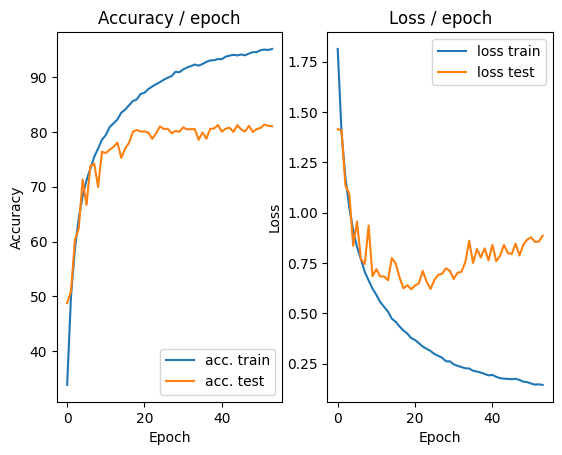

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.1224 (0.1224)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


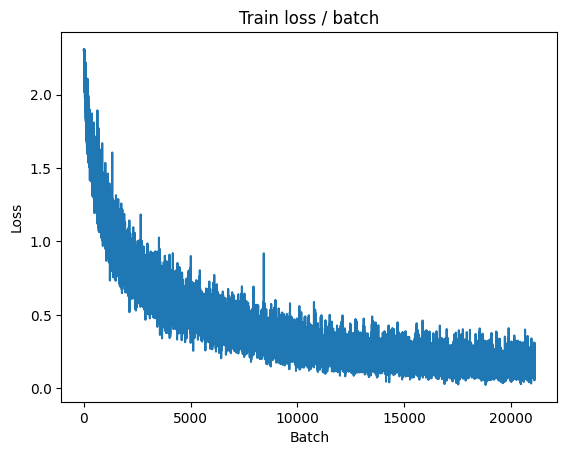

[TRAIN Batch 200/391]	Time 0.131s (0.047s)	Loss 0.0801 (0.1483)	Prec@1  97.7 ( 94.9)	Prec@5 100.0 (100.0)


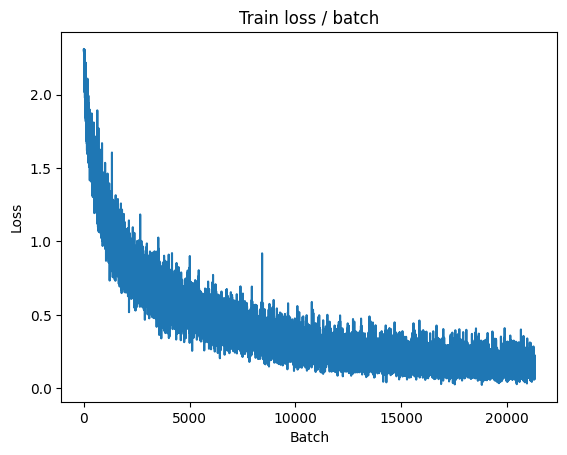


===============> Total time 17s	Avg loss 0.1471	Avg Prec@1 94.93 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.186s (0.186s)	Loss 0.8064 (0.8064)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.8951	Avg Prec@1 81.09 %	Avg Prec@5 98.73 %



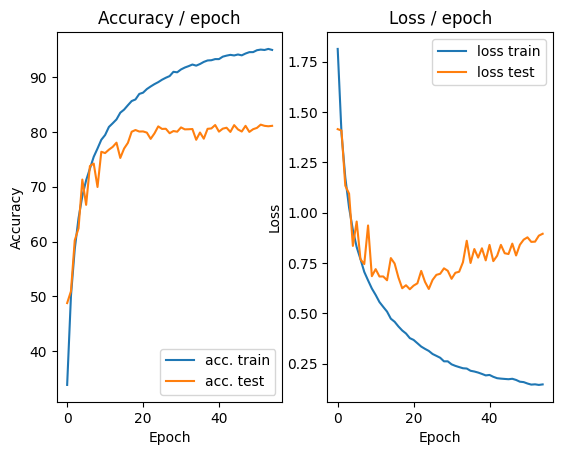

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.316s (0.316s)	Loss 0.0879 (0.0879)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


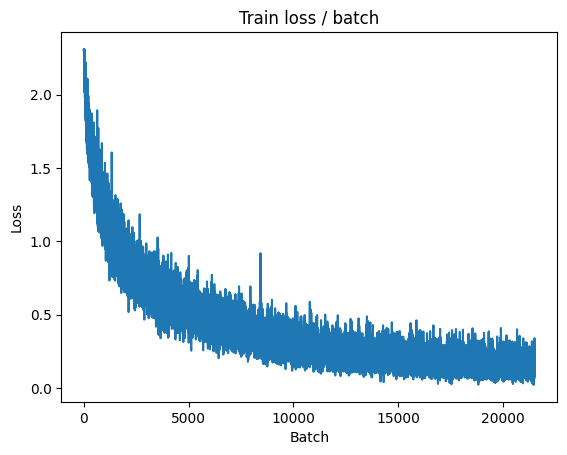

[TRAIN Batch 200/391]	Time 0.073s (0.046s)	Loss 0.1204 (0.1411)	Prec@1  98.4 ( 95.2)	Prec@5 100.0 (100.0)


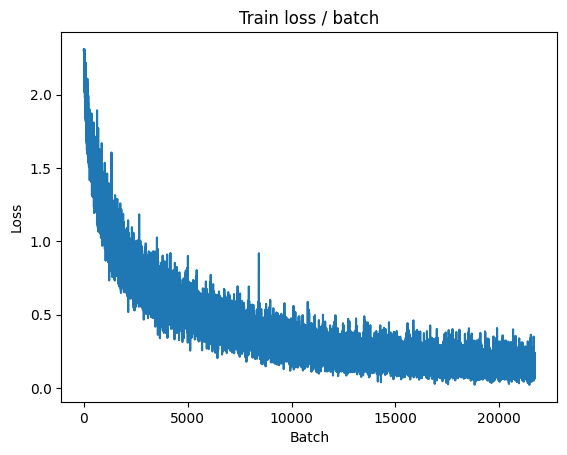


===============> Total time 18s	Avg loss 0.1464	Avg Prec@1 95.03 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.7923 (0.7923)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 2s	Avg loss 0.8829	Avg Prec@1 80.96 %	Avg Prec@5 98.76 %



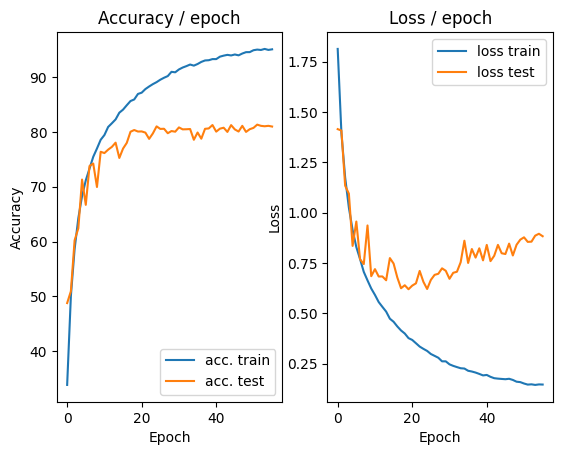

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.299s (0.299s)	Loss 0.0864 (0.0864)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


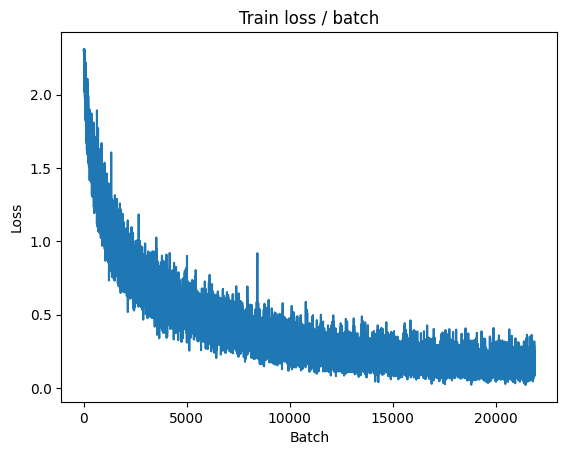

[TRAIN Batch 200/391]	Time 0.053s (0.049s)	Loss 0.2590 (0.1310)	Prec@1  93.8 ( 95.7)	Prec@5 100.0 (100.0)


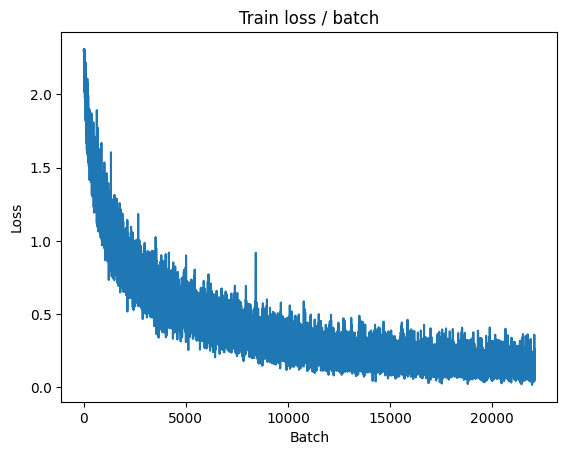


===============> Total time 18s	Avg loss 0.1450	Avg Prec@1 95.19 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.182s (0.182s)	Loss 0.8214 (0.8214)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.8823	Avg Prec@1 80.37 %	Avg Prec@5 98.82 %



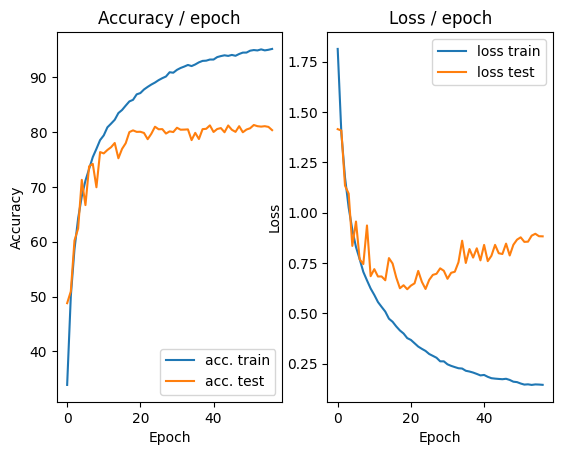

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.0832 (0.0832)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


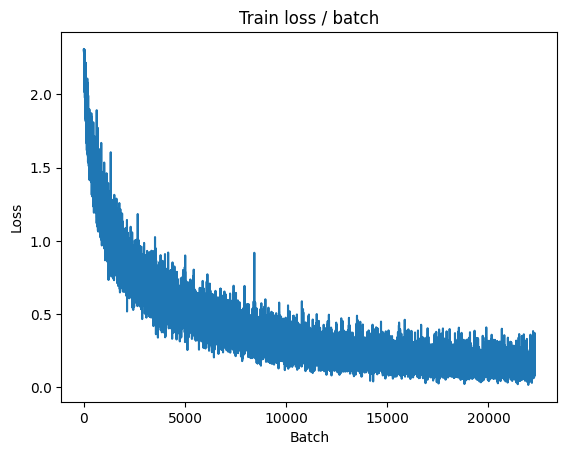

[TRAIN Batch 200/391]	Time 0.015s (0.048s)	Loss 0.1046 (0.1338)	Prec@1  94.5 ( 95.4)	Prec@5 100.0 (100.0)


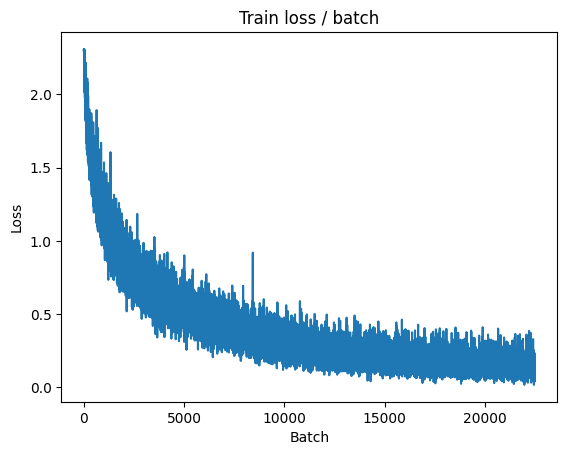


===============> Total time 18s	Avg loss 0.1373	Avg Prec@1 95.38 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.178s (0.178s)	Loss 0.7976 (0.7976)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 2s	Avg loss 0.9126	Avg Prec@1 80.52 %	Avg Prec@5 98.79 %



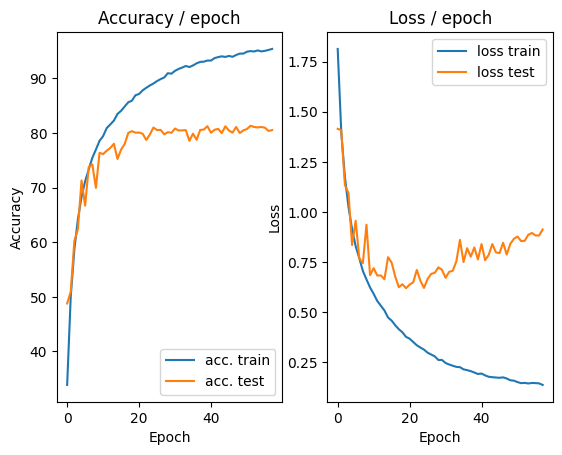

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.343s (0.343s)	Loss 0.1720 (0.1720)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


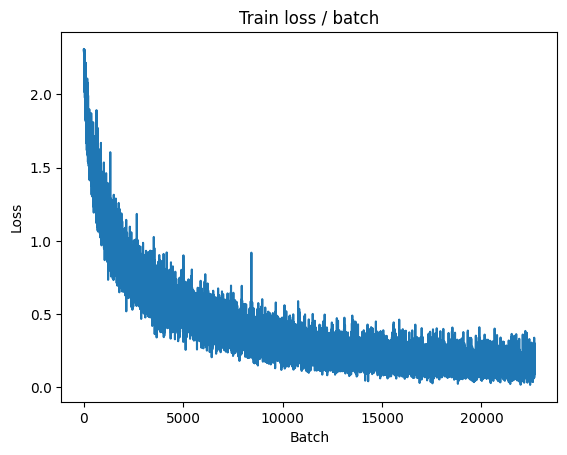

[TRAIN Batch 200/391]	Time 0.008s (0.048s)	Loss 0.1389 (0.1276)	Prec@1  94.5 ( 95.6)	Prec@5 100.0 (100.0)


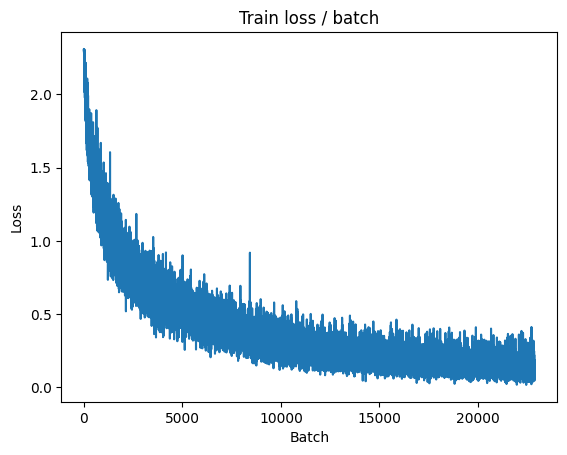


===============> Total time 18s	Avg loss 0.1344	Avg Prec@1 95.46 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.179s (0.179s)	Loss 0.9210 (0.9210)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 2s	Avg loss 0.9206	Avg Prec@1 80.46 %	Avg Prec@5 98.67 %



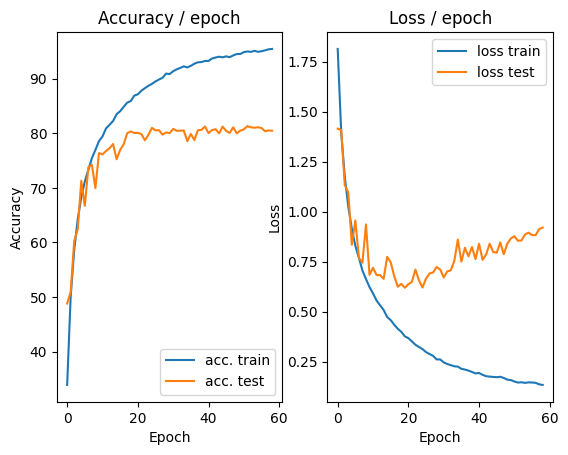

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.216s (0.216s)	Loss 0.1882 (0.1882)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


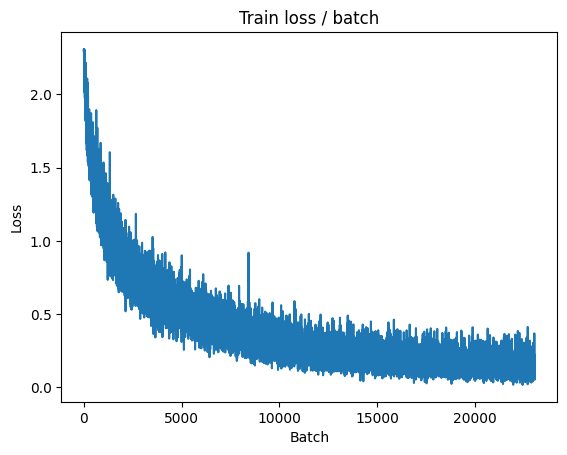

[TRAIN Batch 200/391]	Time 0.043s (0.048s)	Loss 0.2376 (0.1366)	Prec@1  93.0 ( 95.4)	Prec@5 100.0 (100.0)


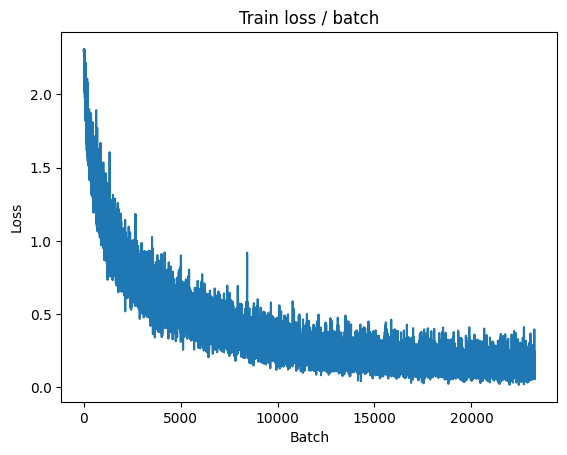


===============> Total time 18s	Avg loss 0.1452	Avg Prec@1 95.10 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.264s (0.264s)	Loss 0.6360 (0.6360)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)

===============> Total time 3s	Avg loss 0.8724	Avg Prec@1 81.39 %	Avg Prec@5 98.86 %



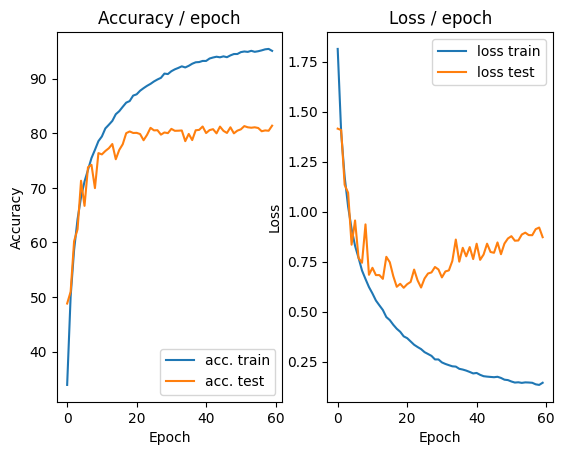

In [15]:
main(128, 0.1,60, cuda=True)

In [16]:
def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,
                  transform=transforms.Compose([
                                      transforms.RandomHorizontalFlip(), # FLips the image w.r.t horizontal axis
                                      transforms.RandomRotation(10),     #Rotates the image to a specified angel
                                      transforms.RandomAffine(0, shear=10, scale=(0.8,1.2)), #Performs actions like zooms, change shear angles.
                                      transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2), # Set the color params
                                      transforms.ToTensor(), # comvert the image to tensor so that it can work with torch
                                      transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)) #Normalize all the images
                               ]))

    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader

100.0%


Extracting datasets/cifar-10-python.tar.gz to datasets
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 2.517s (2.517s)	Loss 2.3073 (2.3073)	Prec@1  11.7 ( 11.7)	Prec@5  43.0 ( 43.0)


<Figure size 432x288 with 0 Axes>

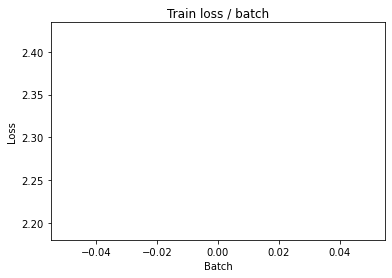

[TRAIN Batch 200/391]	Time 0.006s (0.056s)	Loss 1.7005 (1.9907)	Prec@1  37.5 ( 27.1)	Prec@5  89.1 ( 78.2)


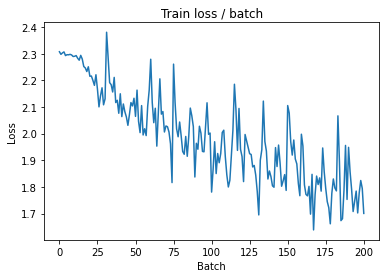


===============> Total time 19s	Avg loss 1.8372	Avg Prec@1 33.30 %	Avg Prec@5 83.33 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.9224 (1.9224)	Prec@1  36.7 ( 36.7)	Prec@5  80.5 ( 80.5)

===============> Total time 1s	Avg loss 1.8880	Avg Prec@1 33.78 %	Avg Prec@5 82.77 %



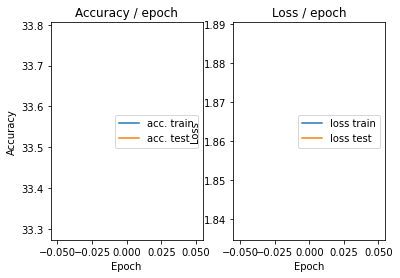

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 1.8802 (1.8802)	Prec@1  39.1 ( 39.1)	Prec@5  82.8 ( 82.8)


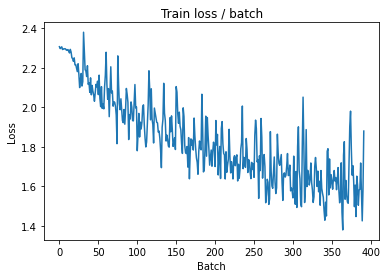

[TRAIN Batch 200/391]	Time 0.006s (0.046s)	Loss 1.5082 (1.5156)	Prec@1  48.4 ( 45.3)	Prec@5  88.3 ( 91.5)


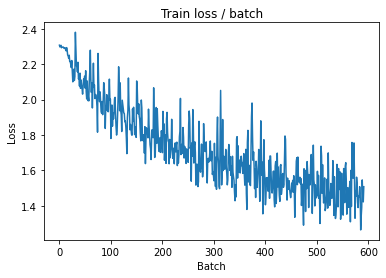


===============> Total time 17s	Avg loss 1.4633	Avg Prec@1 47.50 %	Avg Prec@5 92.16 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 1.4822 (1.4822)	Prec@1  46.1 ( 46.1)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.4382	Avg Prec@1 47.81 %	Avg Prec@5 92.40 %



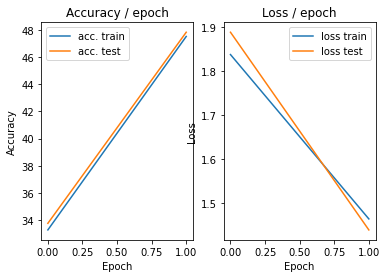

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 1.2669 (1.2669)	Prec@1  53.9 ( 53.9)	Prec@5  97.7 ( 97.7)


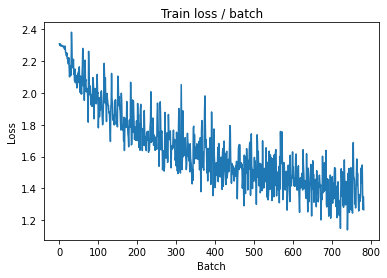

[TRAIN Batch 200/391]	Time 0.024s (0.046s)	Loss 1.2445 (1.3245)	Prec@1  58.6 ( 53.1)	Prec@5  94.5 ( 94.1)


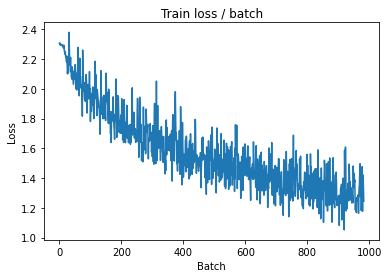


===============> Total time 17s	Avg loss 1.2896	Avg Prec@1 54.51 %	Avg Prec@5 94.39 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.2964 (1.2964)	Prec@1  55.5 ( 55.5)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.2696	Avg Prec@1 54.58 %	Avg Prec@5 94.69 %



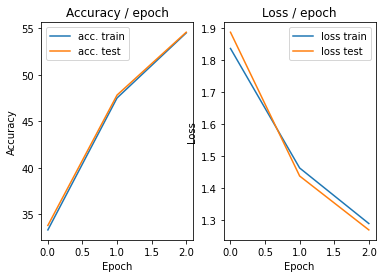

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.172s (0.172s)	Loss 1.2789 (1.2789)	Prec@1  50.0 ( 50.0)	Prec@5  94.5 ( 94.5)


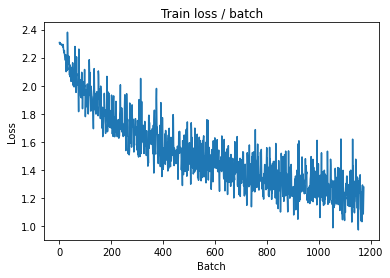

[TRAIN Batch 200/391]	Time 0.006s (0.044s)	Loss 1.2247 (1.1836)	Prec@1  53.9 ( 58.7)	Prec@5  96.1 ( 95.2)


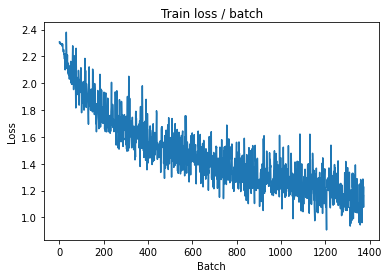


===============> Total time 17s	Avg loss 1.1586	Avg Prec@1 59.38 %	Avg Prec@5 95.53 %

[EVAL Batch 000/079]	Time 0.308s (0.308s)	Loss 1.3378 (1.3378)	Prec@1  47.7 ( 47.7)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.2196	Avg Prec@1 55.78 %	Avg Prec@5 94.87 %



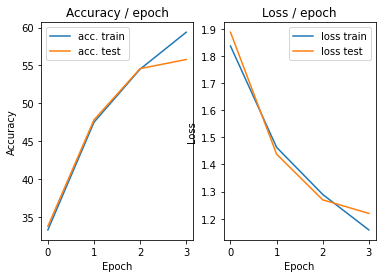

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 1.2964 (1.2964)	Prec@1  52.3 ( 52.3)	Prec@5  95.3 ( 95.3)


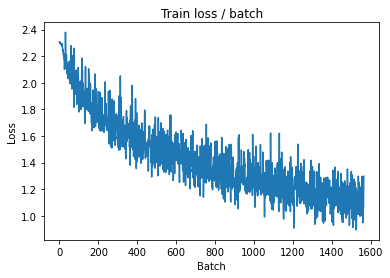

[TRAIN Batch 200/391]	Time 0.077s (0.043s)	Loss 0.9703 (1.0797)	Prec@1  61.7 ( 62.0)	Prec@5  97.7 ( 96.2)


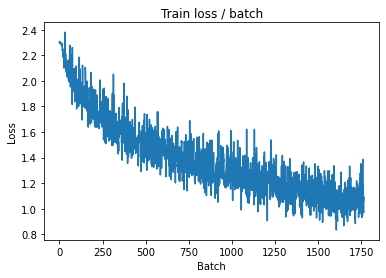


===============> Total time 16s	Avg loss 1.0622	Avg Prec@1 62.84 %	Avg Prec@5 96.27 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.1812 (1.1812)	Prec@1  62.5 ( 62.5)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1015	Avg Prec@1 61.32 %	Avg Prec@5 96.26 %



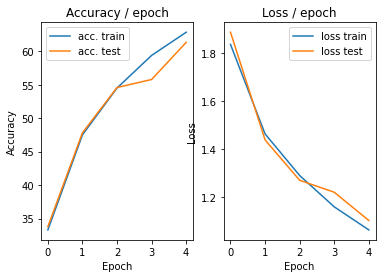

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.182s (0.182s)	Loss 1.0667 (1.0667)	Prec@1  63.3 ( 63.3)	Prec@5  96.9 ( 96.9)


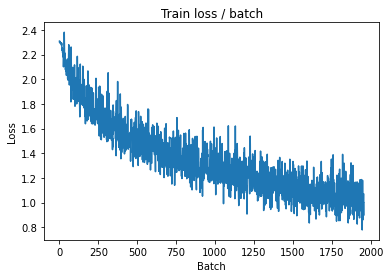

[TRAIN Batch 200/391]	Time 0.006s (0.045s)	Loss 0.9563 (0.9885)	Prec@1  66.4 ( 65.8)	Prec@5  96.1 ( 96.9)


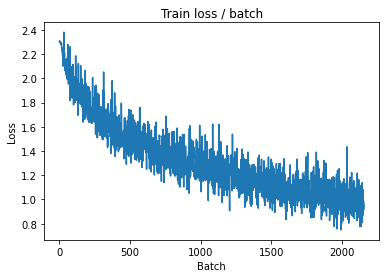


===============> Total time 17s	Avg loss 0.9817	Avg Prec@1 65.96 %	Avg Prec@5 96.86 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.1446 (1.1446)	Prec@1  57.8 ( 57.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0661	Avg Prec@1 62.51 %	Avg Prec@5 96.67 %



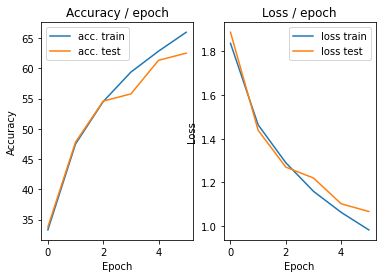

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.9537 (0.9537)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)


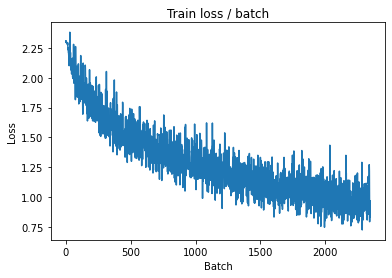

[TRAIN Batch 200/391]	Time 0.076s (0.043s)	Loss 0.8033 (0.9202)	Prec@1  68.8 ( 67.9)	Prec@5  97.7 ( 97.2)


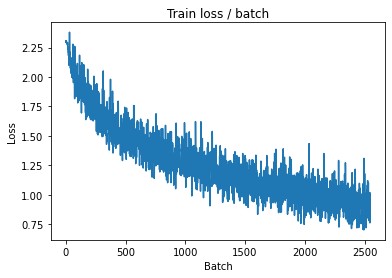


===============> Total time 16s	Avg loss 0.9198	Avg Prec@1 68.11 %	Avg Prec@5 97.24 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.2931 (1.2931)	Prec@1  59.4 ( 59.4)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.1057	Avg Prec@1 61.40 %	Avg Prec@5 95.72 %



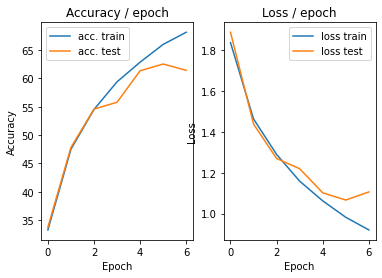

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.236s (0.236s)	Loss 0.7597 (0.7597)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)


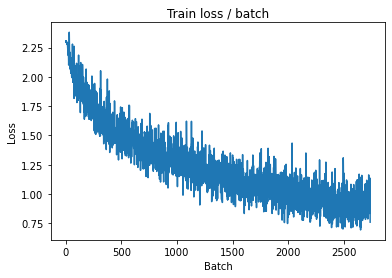

[TRAIN Batch 200/391]	Time 0.051s (0.043s)	Loss 0.7784 (0.8729)	Prec@1  72.7 ( 69.4)	Prec@5  98.4 ( 97.6)


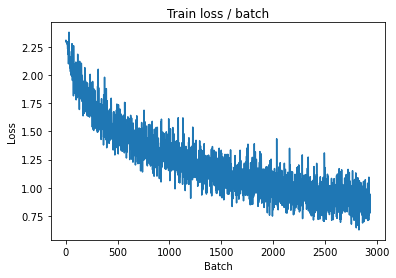


===============> Total time 16s	Avg loss 0.8639	Avg Prec@1 69.84 %	Avg Prec@5 97.64 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.9902 (0.9902)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9069	Avg Prec@1 68.40 %	Avg Prec@5 97.17 %



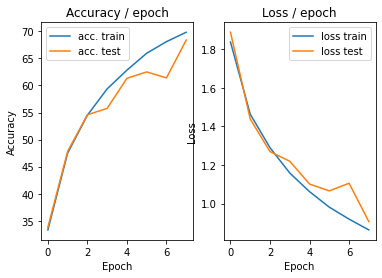

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.192s (0.192s)	Loss 0.7642 (0.7642)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


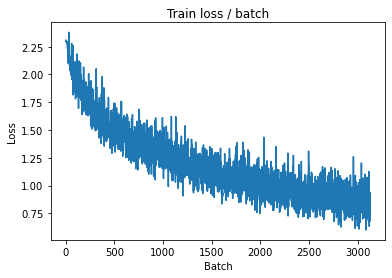

[TRAIN Batch 200/391]	Time 0.079s (0.043s)	Loss 1.1039 (0.8211)	Prec@1  58.6 ( 71.5)	Prec@5  96.9 ( 97.8)


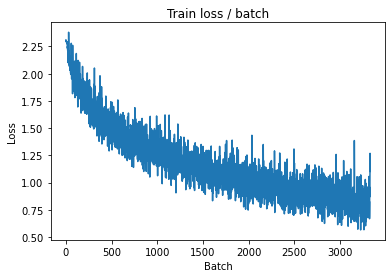


===============> Total time 16s	Avg loss 0.8177	Avg Prec@1 71.48 %	Avg Prec@5 97.90 %

[EVAL Batch 000/079]	Time 0.124s (0.124s)	Loss 1.1035 (1.1035)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.0157	Avg Prec@1 65.74 %	Avg Prec@5 96.56 %



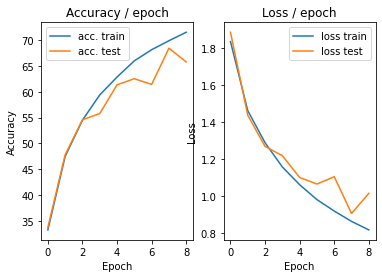

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.7251 (0.7251)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)


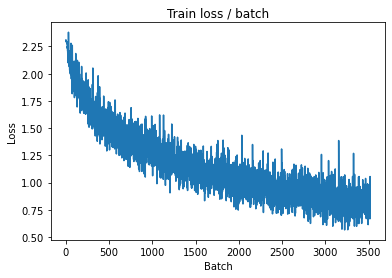

[TRAIN Batch 200/391]	Time 0.079s (0.044s)	Loss 0.7572 (0.7663)	Prec@1  74.2 ( 73.1)	Prec@5  99.2 ( 98.1)


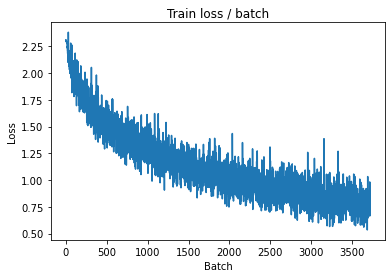


===============> Total time 16s	Avg loss 0.7759	Avg Prec@1 72.88 %	Avg Prec@5 98.11 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.1235 (1.1235)	Prec@1  64.1 ( 64.1)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.0061	Avg Prec@1 66.07 %	Avg Prec@5 97.37 %



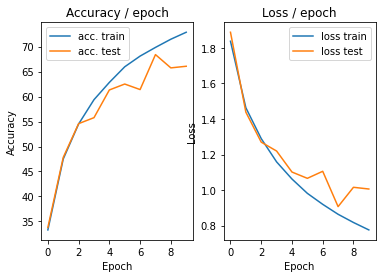

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.7357 (0.7357)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


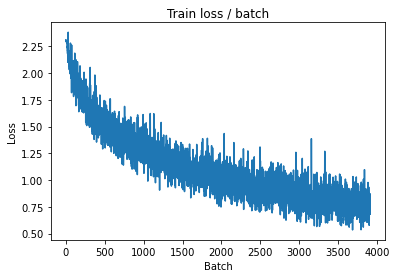

[TRAIN Batch 200/391]	Time 0.080s (0.044s)	Loss 0.5979 (0.7358)	Prec@1  81.2 ( 74.0)	Prec@5  98.4 ( 98.3)


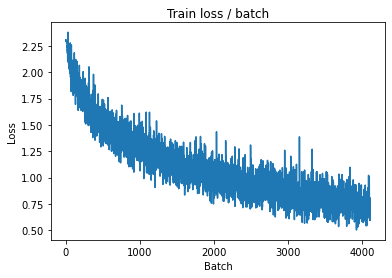


===============> Total time 17s	Avg loss 0.7426	Avg Prec@1 73.96 %	Avg Prec@5 98.27 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.9680 (0.9680)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8821	Avg Prec@1 70.35 %	Avg Prec@5 97.14 %



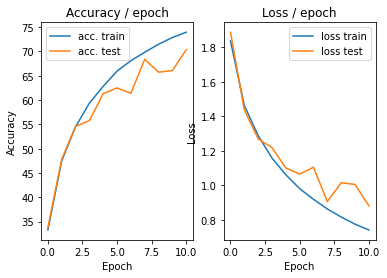

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.308s (0.308s)	Loss 0.7294 (0.7294)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


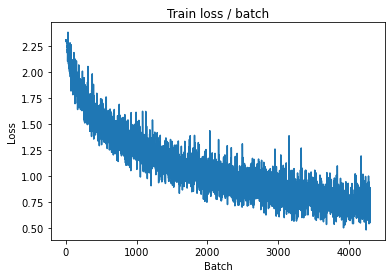

[TRAIN Batch 200/391]	Time 0.080s (0.045s)	Loss 0.7883 (0.7116)	Prec@1  74.2 ( 75.0)	Prec@5  97.7 ( 98.3)


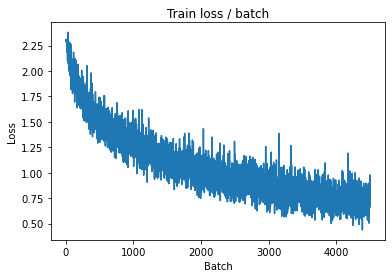


===============> Total time 17s	Avg loss 0.7081	Avg Prec@1 75.21 %	Avg Prec@5 98.38 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 0.9490 (0.9490)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8587	Avg Prec@1 70.52 %	Avg Prec@5 97.55 %



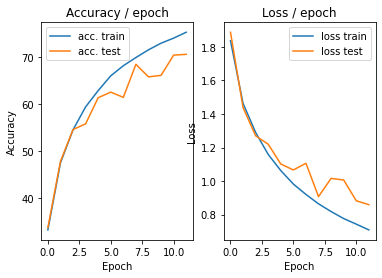

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.8216 (0.8216)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)


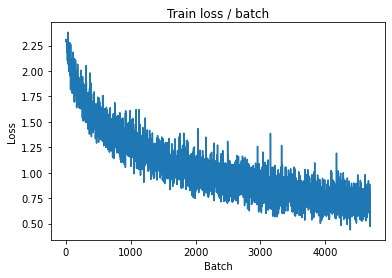

[TRAIN Batch 200/391]	Time 0.079s (0.045s)	Loss 0.6672 (0.6755)	Prec@1  75.8 ( 76.7)	Prec@5  97.7 ( 98.6)


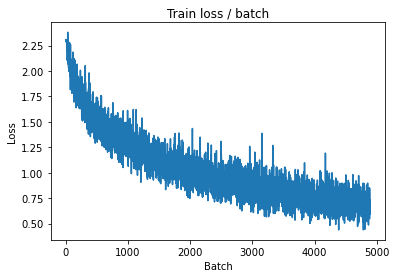


===============> Total time 17s	Avg loss 0.6784	Avg Prec@1 76.37 %	Avg Prec@5 98.67 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.9893 (0.9893)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0028	Avg Prec@1 67.12 %	Avg Prec@5 96.96 %



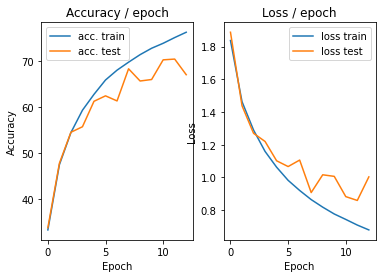

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.7822 (0.7822)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)


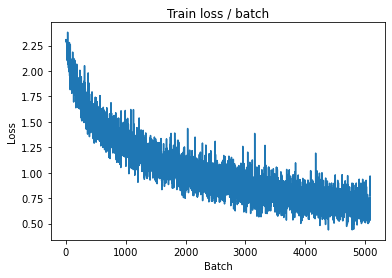

[TRAIN Batch 200/391]	Time 0.078s (0.043s)	Loss 0.6671 (0.6524)	Prec@1  74.2 ( 77.5)	Prec@5  96.9 ( 98.6)


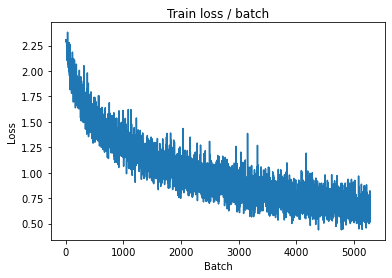


===============> Total time 16s	Avg loss 0.6532	Avg Prec@1 77.33 %	Avg Prec@5 98.71 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.9512 (0.9512)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8472	Avg Prec@1 71.84 %	Avg Prec@5 97.62 %



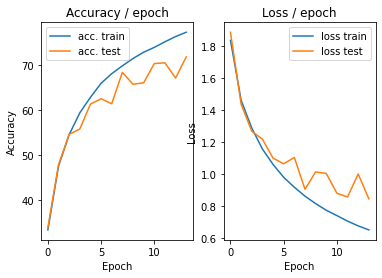

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.6850 (0.6850)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)


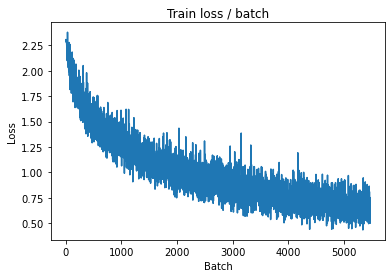

[TRAIN Batch 200/391]	Time 0.074s (0.047s)	Loss 0.5967 (0.6279)	Prec@1  75.8 ( 78.0)	Prec@5  97.7 ( 98.8)


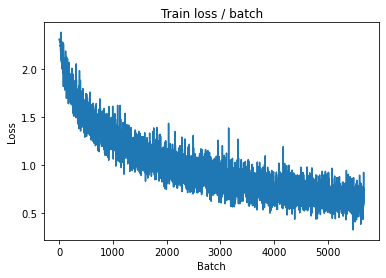


===============> Total time 17s	Avg loss 0.6346	Avg Prec@1 77.83 %	Avg Prec@5 98.79 %

[EVAL Batch 000/079]	Time 0.296s (0.296s)	Loss 0.8402 (0.8402)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8353	Avg Prec@1 71.66 %	Avg Prec@5 97.55 %



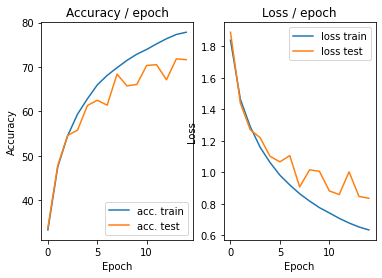

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.178s (0.178s)	Loss 0.7071 (0.7071)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


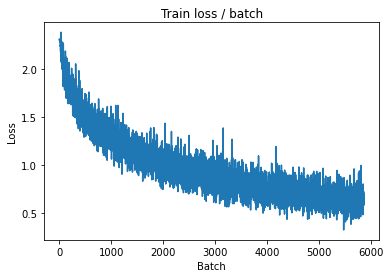

[TRAIN Batch 200/391]	Time 0.079s (0.045s)	Loss 0.6625 (0.6142)	Prec@1  74.2 ( 78.4)	Prec@5  99.2 ( 99.0)


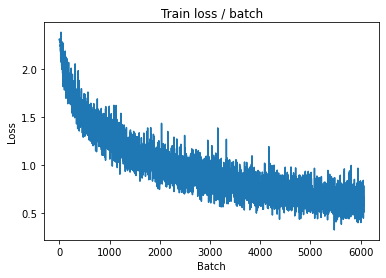


===============> Total time 17s	Avg loss 0.6112	Avg Prec@1 78.56 %	Avg Prec@5 98.97 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.9273 (0.9273)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8071	Avg Prec@1 73.28 %	Avg Prec@5 97.77 %



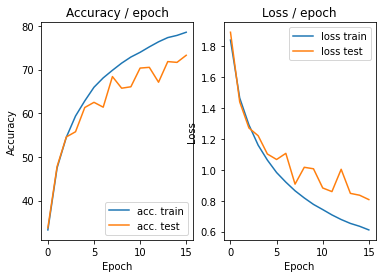

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.5141 (0.5141)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


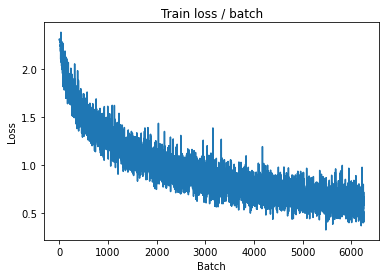

[TRAIN Batch 200/391]	Time 0.078s (0.044s)	Loss 0.4003 (0.5719)	Prec@1  85.2 ( 80.1)	Prec@5 100.0 ( 99.1)


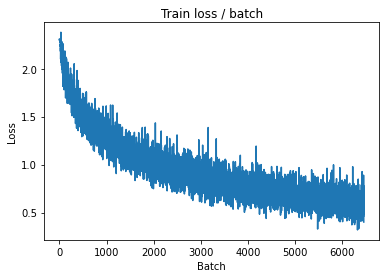


===============> Total time 16s	Avg loss 0.5804	Avg Prec@1 79.82 %	Avg Prec@5 99.04 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.8487 (0.8487)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8014	Avg Prec@1 73.45 %	Avg Prec@5 97.79 %



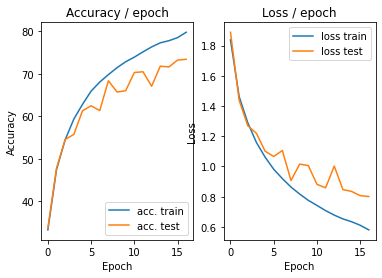

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.5683 (0.5683)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


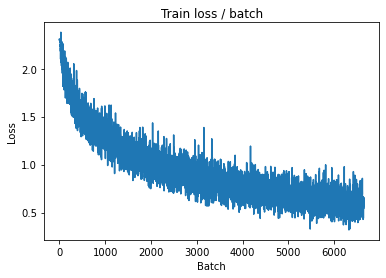

[TRAIN Batch 200/391]	Time 0.079s (0.043s)	Loss 0.6288 (0.5619)	Prec@1  79.7 ( 80.4)	Prec@5  97.7 ( 99.1)


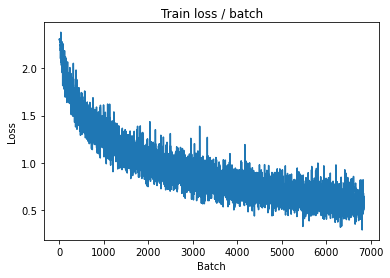


===============> Total time 16s	Avg loss 0.5660	Avg Prec@1 80.28 %	Avg Prec@5 99.09 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.8666 (0.8666)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8898	Avg Prec@1 70.58 %	Avg Prec@5 97.42 %



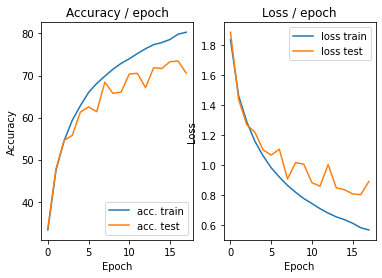

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.215s (0.215s)	Loss 0.6142 (0.6142)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


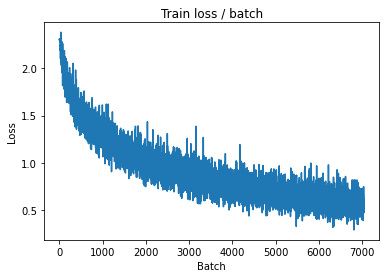

[TRAIN Batch 200/391]	Time 0.006s (0.044s)	Loss 0.6557 (0.5378)	Prec@1  77.3 ( 81.1)	Prec@5 100.0 ( 99.2)


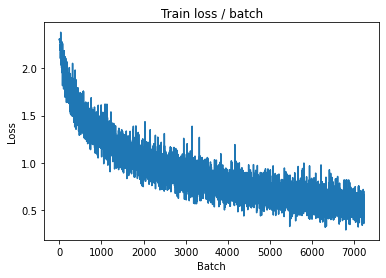


===============> Total time 17s	Avg loss 0.5511	Avg Prec@1 80.71 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.9225 (0.9225)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8098	Avg Prec@1 72.99 %	Avg Prec@5 97.60 %



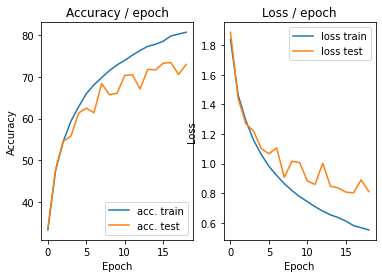

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.185s (0.185s)	Loss 0.5541 (0.5541)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


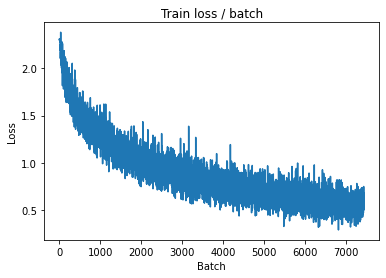

[TRAIN Batch 200/391]	Time 0.079s (0.043s)	Loss 0.6176 (0.5335)	Prec@1  77.3 ( 81.3)	Prec@5 100.0 ( 99.2)


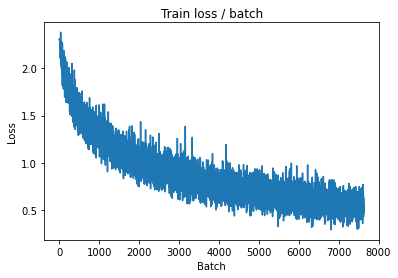


===============> Total time 16s	Avg loss 0.5322	Avg Prec@1 81.39 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.1115 (1.1115)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9432	Avg Prec@1 71.00 %	Avg Prec@5 97.73 %



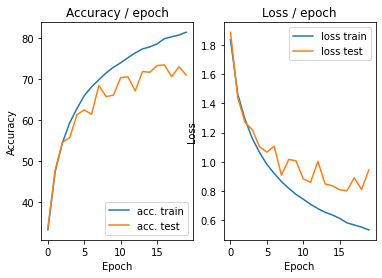

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.183s (0.183s)	Loss 0.4605 (0.4605)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)


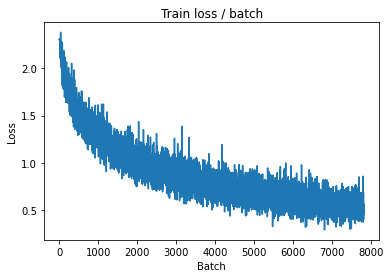

[TRAIN Batch 200/391]	Time 0.078s (0.043s)	Loss 0.4749 (0.5095)	Prec@1  80.5 ( 82.3)	Prec@5  98.4 ( 99.3)


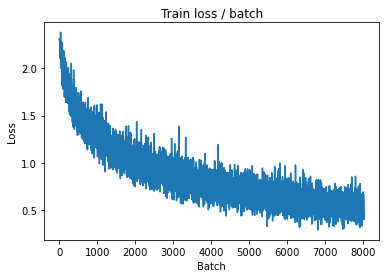


===============> Total time 16s	Avg loss 0.5201	Avg Prec@1 81.85 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.9467 (0.9467)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7928	Avg Prec@1 74.55 %	Avg Prec@5 97.88 %



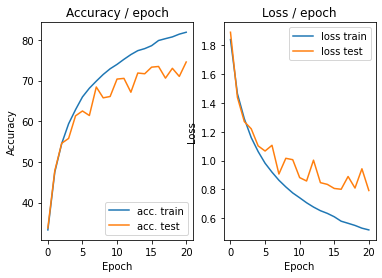

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.180s (0.180s)	Loss 0.3889 (0.3889)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


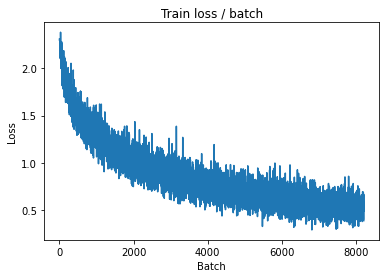

[TRAIN Batch 200/391]	Time 0.046s (0.042s)	Loss 0.6171 (0.4892)	Prec@1  78.9 ( 82.8)	Prec@5  99.2 ( 99.4)


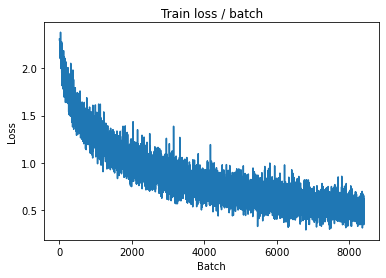


===============> Total time 16s	Avg loss 0.5005	Avg Prec@1 82.48 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.0368 (1.0368)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9086	Avg Prec@1 72.20 %	Avg Prec@5 97.47 %



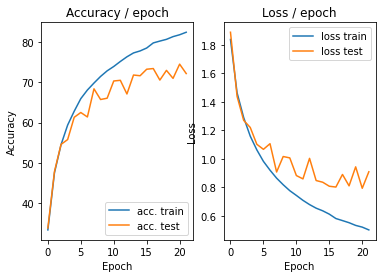

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.329s (0.329s)	Loss 0.4837 (0.4837)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


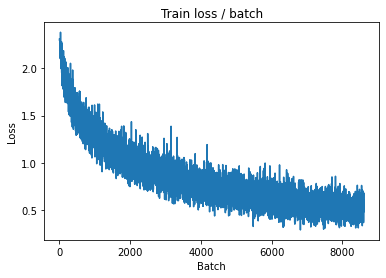

[TRAIN Batch 200/391]	Time 0.077s (0.046s)	Loss 0.5516 (0.4722)	Prec@1  78.1 ( 83.4)	Prec@5 100.0 ( 99.4)


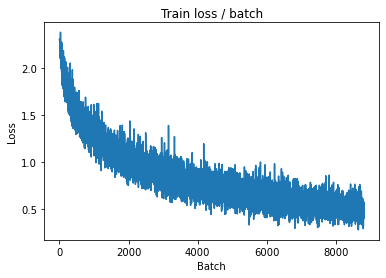


===============> Total time 17s	Avg loss 0.4877	Avg Prec@1 82.94 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.8652 (0.8652)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8399	Avg Prec@1 73.97 %	Avg Prec@5 97.92 %



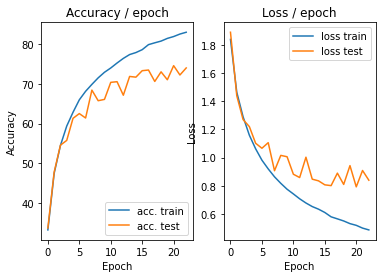

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.3749 (0.3749)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)


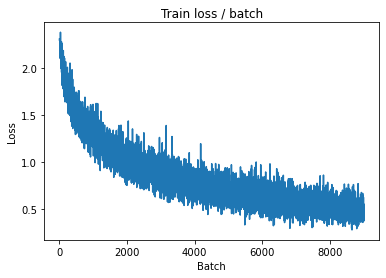

[TRAIN Batch 200/391]	Time 0.054s (0.042s)	Loss 0.5605 (0.4729)	Prec@1  78.9 ( 83.5)	Prec@5  98.4 ( 99.4)


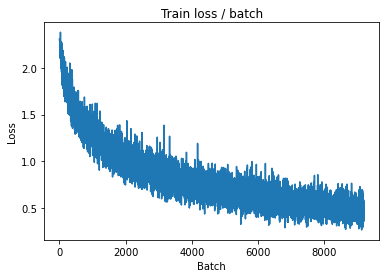


===============> Total time 16s	Avg loss 0.4761	Avg Prec@1 83.37 %	Avg Prec@5 99.40 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.8218 (0.8218)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8185	Avg Prec@1 74.32 %	Avg Prec@5 97.96 %



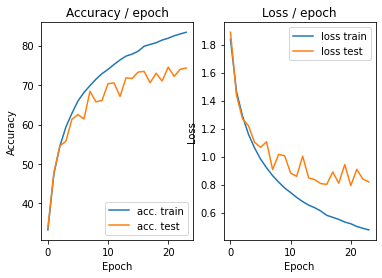

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.5460 (0.5460)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)


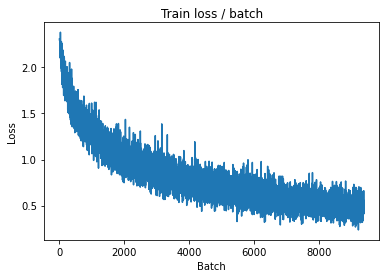

[TRAIN Batch 200/391]	Time 0.077s (0.042s)	Loss 0.3821 (0.4492)	Prec@1  85.2 ( 84.2)	Prec@5 100.0 ( 99.5)


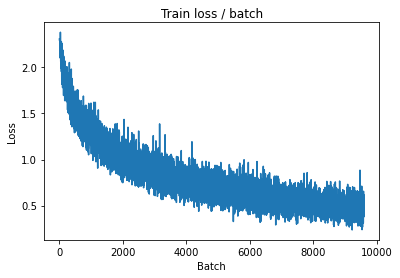


===============> Total time 16s	Avg loss 0.4623	Avg Prec@1 83.84 %	Avg Prec@5 99.44 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.0923 (1.0923)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9833	Avg Prec@1 69.82 %	Avg Prec@5 97.53 %



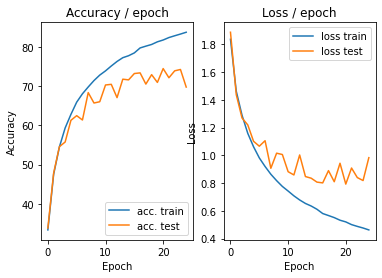

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.6726 (0.6726)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


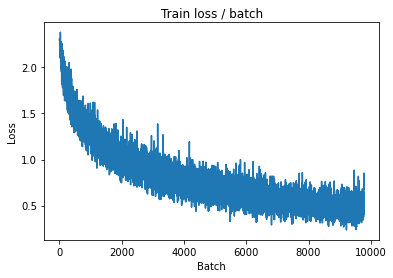

[TRAIN Batch 200/391]	Time 0.048s (0.042s)	Loss 0.5951 (0.4440)	Prec@1  79.7 ( 84.5)	Prec@5  97.7 ( 99.5)


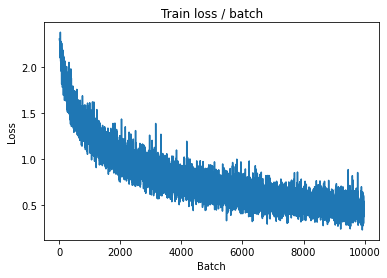


===============> Total time 16s	Avg loss 0.4529	Avg Prec@1 84.00 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.278s (0.278s)	Loss 0.9087 (0.9087)	Prec@1  73.4 ( 73.4)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.8834	Avg Prec@1 73.25 %	Avg Prec@5 97.67 %



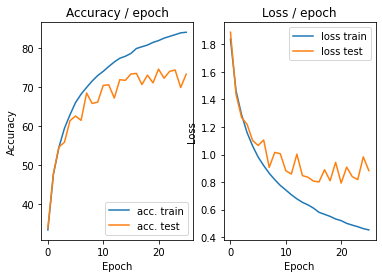

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.4906 (0.4906)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


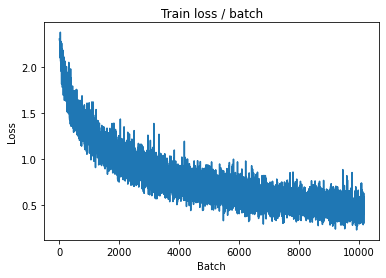

[TRAIN Batch 200/391]	Time 0.076s (0.044s)	Loss 0.3733 (0.4319)	Prec@1  86.7 ( 84.9)	Prec@5 100.0 ( 99.5)


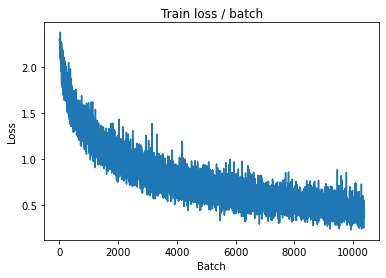


===============> Total time 16s	Avg loss 0.4412	Avg Prec@1 84.55 %	Avg Prec@5 99.49 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.8070 (0.8070)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8360	Avg Prec@1 75.38 %	Avg Prec@5 98.09 %



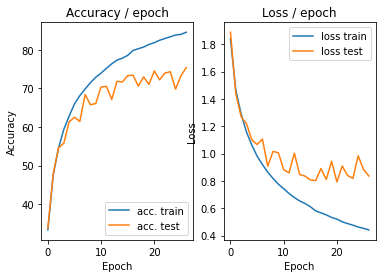

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.167s (0.167s)	Loss 0.4763 (0.4763)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


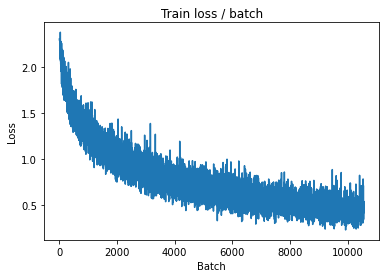

[TRAIN Batch 200/391]	Time 0.073s (0.042s)	Loss 0.4553 (0.4162)	Prec@1  85.9 ( 85.4)	Prec@5 100.0 ( 99.6)


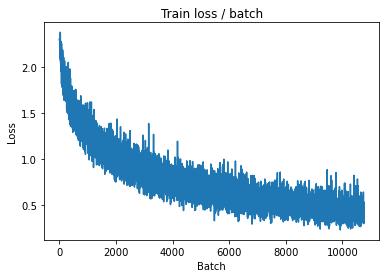


===============> Total time 16s	Avg loss 0.4289	Avg Prec@1 85.04 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.9404 (0.9404)	Prec@1  73.4 ( 73.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.8952	Avg Prec@1 73.59 %	Avg Prec@5 97.88 %



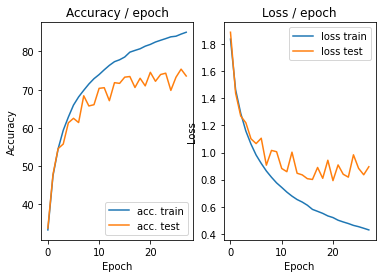

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.4703 (0.4703)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


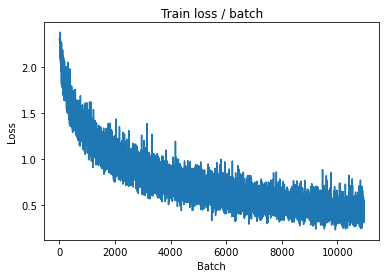

[TRAIN Batch 200/391]	Time 0.092s (0.049s)	Loss 0.5266 (0.4114)	Prec@1  82.0 ( 85.6)	Prec@5 100.0 ( 99.6)


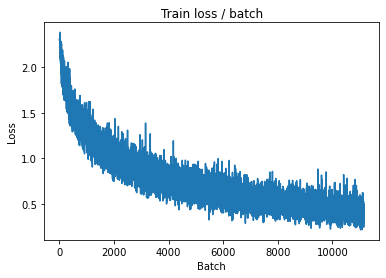


===============> Total time 19s	Avg loss 0.4256	Avg Prec@1 85.12 %	Avg Prec@5 99.57 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.9626 (0.9626)	Prec@1  67.2 ( 67.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8620	Avg Prec@1 74.66 %	Avg Prec@5 97.87 %



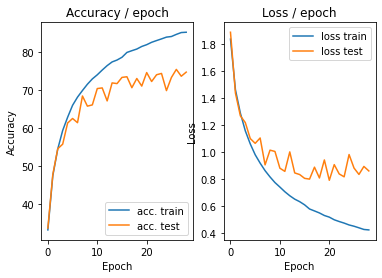

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.181s (0.181s)	Loss 0.4644 (0.4644)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


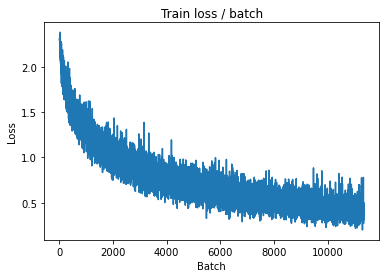

[TRAIN Batch 200/391]	Time 0.077s (0.046s)	Loss 0.2717 (0.4036)	Prec@1  93.0 ( 85.8)	Prec@5  99.2 ( 99.6)


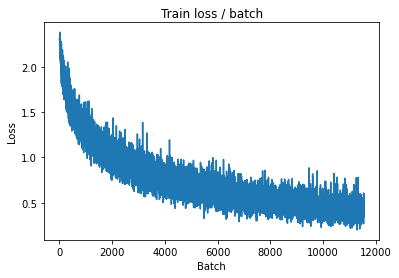


===============> Total time 17s	Avg loss 0.4077	Avg Prec@1 85.79 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.9408 (0.9408)	Prec@1  67.2 ( 67.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8950	Avg Prec@1 73.34 %	Avg Prec@5 97.97 %



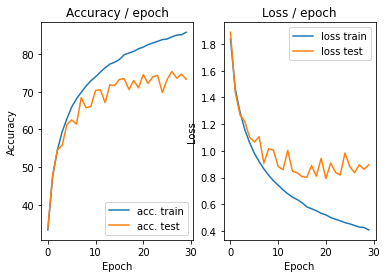

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.4154 (0.4154)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


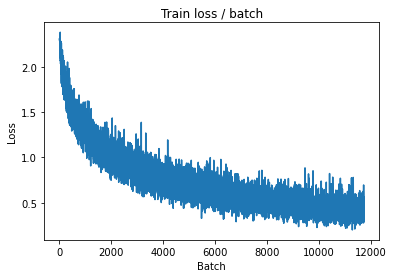

[TRAIN Batch 200/391]	Time 0.076s (0.044s)	Loss 0.4675 (0.3869)	Prec@1  82.0 ( 86.4)	Prec@5 100.0 ( 99.7)


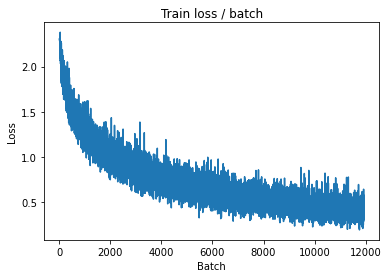


===============> Total time 16s	Avg loss 0.4073	Avg Prec@1 85.78 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.9315 (0.9315)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8463	Avg Prec@1 74.75 %	Avg Prec@5 97.96 %



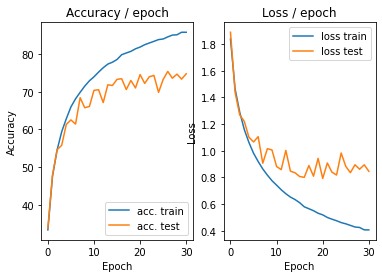

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.210s (0.210s)	Loss 0.3562 (0.3562)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


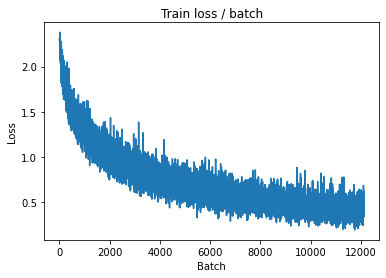

[TRAIN Batch 200/391]	Time 0.078s (0.042s)	Loss 0.3064 (0.3786)	Prec@1  86.7 ( 86.8)	Prec@5 100.0 ( 99.6)


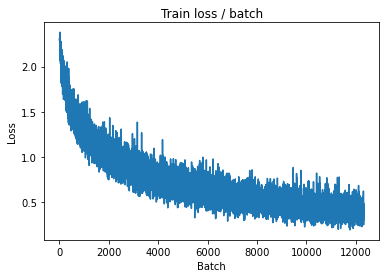


===============> Total time 16s	Avg loss 0.3906	Avg Prec@1 86.32 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.3085 (1.3085)	Prec@1  64.1 ( 64.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0342	Avg Prec@1 70.73 %	Avg Prec@5 97.53 %



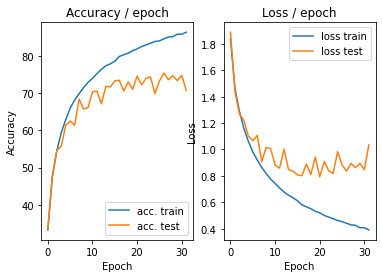

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.5099 (0.5099)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


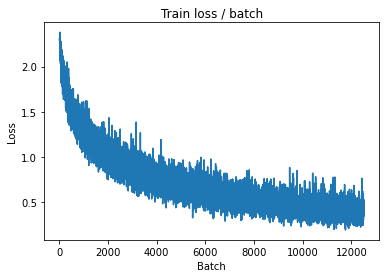

[TRAIN Batch 200/391]	Time 0.071s (0.042s)	Loss 0.2657 (0.3825)	Prec@1  92.2 ( 86.5)	Prec@5 100.0 ( 99.7)


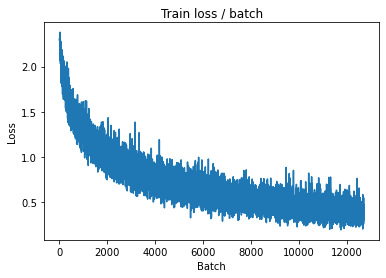


===============> Total time 16s	Avg loss 0.3832	Avg Prec@1 86.66 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8230 (0.8230)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8317	Avg Prec@1 75.59 %	Avg Prec@5 97.94 %



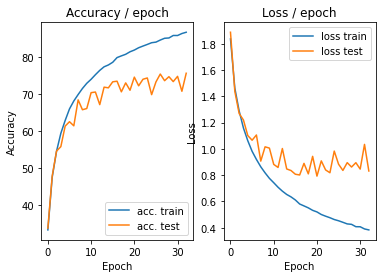

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.334s (0.334s)	Loss 0.2867 (0.2867)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


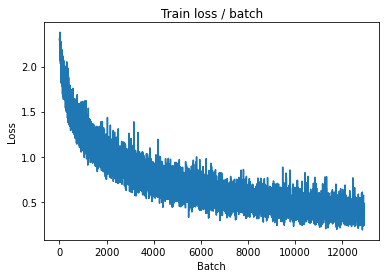

[TRAIN Batch 200/391]	Time 0.067s (0.044s)	Loss 0.3842 (0.3610)	Prec@1  88.3 ( 87.7)	Prec@5 100.0 ( 99.7)


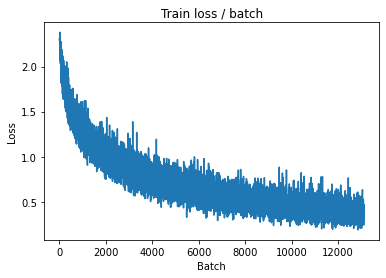


===============> Total time 16s	Avg loss 0.3754	Avg Prec@1 87.07 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.1352 (1.1352)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8872	Avg Prec@1 75.06 %	Avg Prec@5 97.91 %



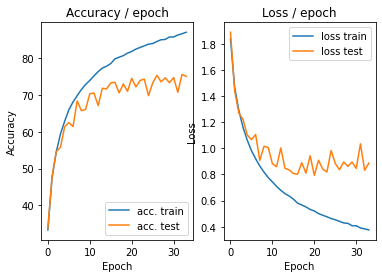

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.170s (0.170s)	Loss 0.3409 (0.3409)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


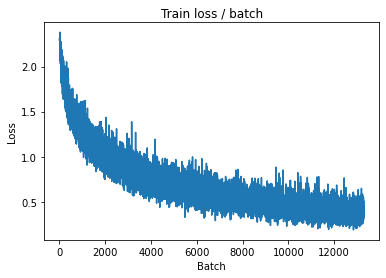

[TRAIN Batch 200/391]	Time 0.075s (0.042s)	Loss 0.4230 (0.3588)	Prec@1  85.2 ( 87.4)	Prec@5 100.0 ( 99.7)


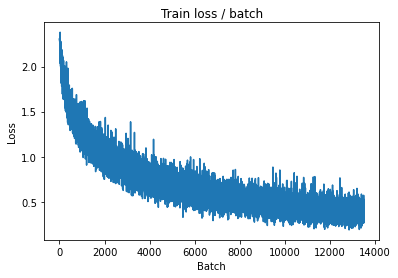


===============> Total time 16s	Avg loss 0.3746	Avg Prec@1 86.85 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.122s (0.122s)	Loss 0.8077 (0.8077)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8618	Avg Prec@1 75.47 %	Avg Prec@5 97.88 %



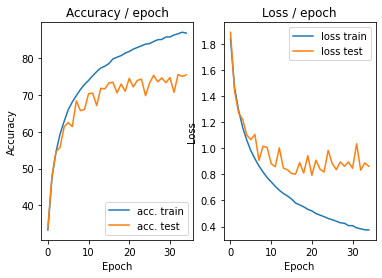

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.4659 (0.4659)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)


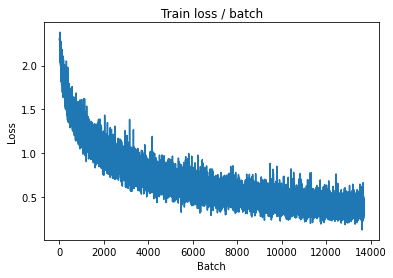

[TRAIN Batch 200/391]	Time 0.089s (0.049s)	Loss 0.2711 (0.3667)	Prec@1  88.3 ( 87.3)	Prec@5 100.0 ( 99.7)


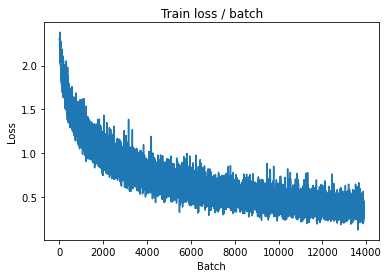


===============> Total time 18s	Avg loss 0.3632	Avg Prec@1 87.43 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.9522 (0.9522)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8868	Avg Prec@1 75.01 %	Avg Prec@5 97.97 %



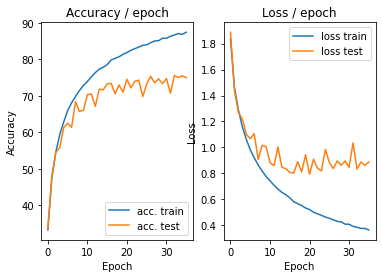

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.179s (0.179s)	Loss 0.3267 (0.3267)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


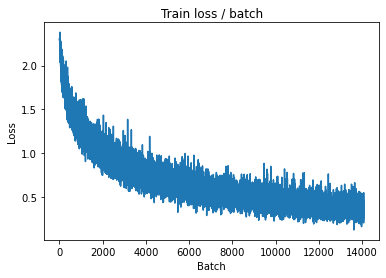

[TRAIN Batch 200/391]	Time 0.076s (0.042s)	Loss 0.3635 (0.3599)	Prec@1  86.7 ( 87.5)	Prec@5 100.0 ( 99.8)


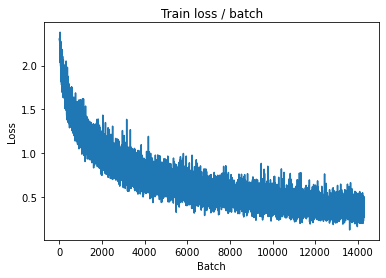


===============> Total time 16s	Avg loss 0.3652	Avg Prec@1 87.36 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.272s (0.272s)	Loss 1.2065 (1.2065)	Prec@1  70.3 ( 70.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9303	Avg Prec@1 74.04 %	Avg Prec@5 97.86 %



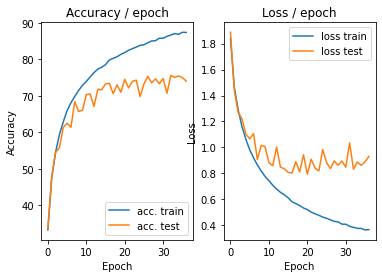

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.214s (0.214s)	Loss 0.4458 (0.4458)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


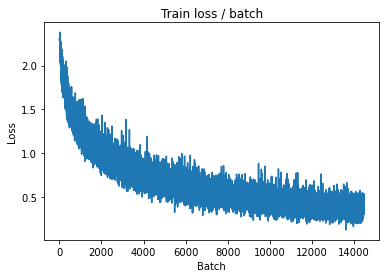

[TRAIN Batch 200/391]	Time 0.006s (0.042s)	Loss 0.3520 (0.3551)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 ( 99.7)


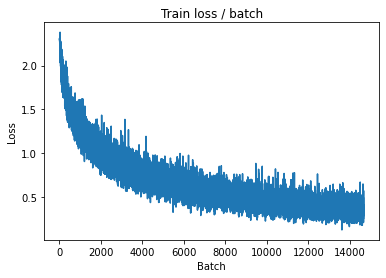


===============> Total time 16s	Avg loss 0.3578	Avg Prec@1 87.55 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.8926 (0.8926)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9028	Avg Prec@1 75.52 %	Avg Prec@5 98.05 %



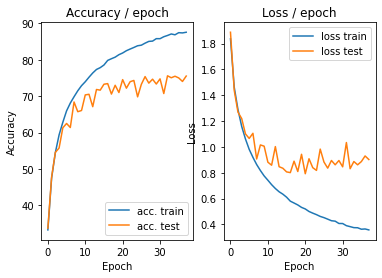

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.3053 (0.3053)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


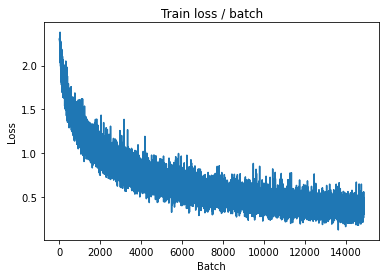

[TRAIN Batch 200/391]	Time 0.006s (0.042s)	Loss 0.3556 (0.3358)	Prec@1  83.6 ( 88.2)	Prec@5 100.0 ( 99.8)


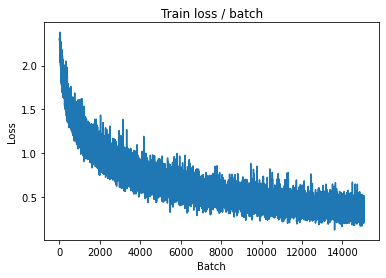


===============> Total time 16s	Avg loss 0.3458	Avg Prec@1 87.83 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.0215 (1.0215)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9195	Avg Prec@1 75.35 %	Avg Prec@5 97.85 %



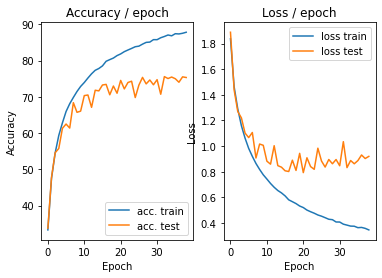

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.174s (0.174s)	Loss 0.3479 (0.3479)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


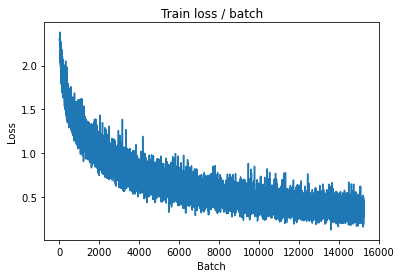

[TRAIN Batch 200/391]	Time 0.077s (0.043s)	Loss 0.3020 (0.3300)	Prec@1  89.1 ( 88.5)	Prec@5 100.0 ( 99.7)


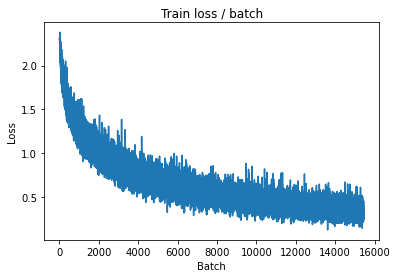


===============> Total time 16s	Avg loss 0.3375	Avg Prec@1 88.33 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.9922 (0.9922)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9540	Avg Prec@1 74.23 %	Avg Prec@5 97.94 %



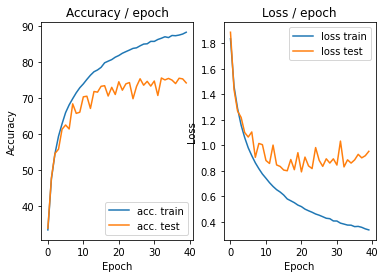

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.4044 (0.4044)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


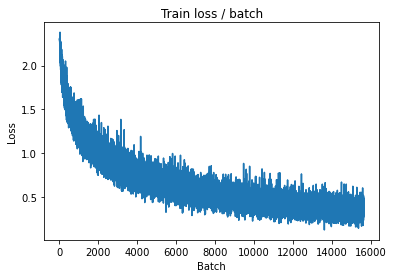

[TRAIN Batch 200/391]	Time 0.077s (0.043s)	Loss 0.3498 (0.3226)	Prec@1  85.9 ( 88.7)	Prec@5 100.0 ( 99.8)


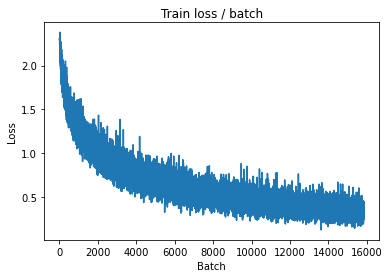


===============> Total time 16s	Avg loss 0.3335	Avg Prec@1 88.53 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.0387 (1.0387)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9797	Avg Prec@1 75.18 %	Avg Prec@5 97.89 %



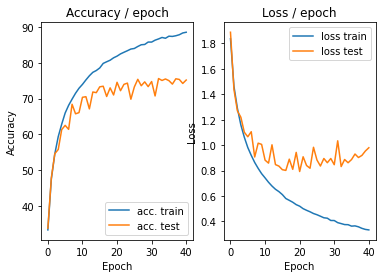

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.169s (0.169s)	Loss 0.3063 (0.3063)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


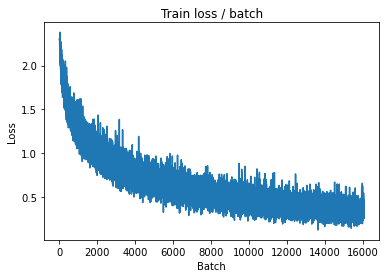

[TRAIN Batch 200/391]	Time 0.075s (0.043s)	Loss 0.2846 (0.3212)	Prec@1  93.0 ( 88.6)	Prec@5  99.2 ( 99.8)


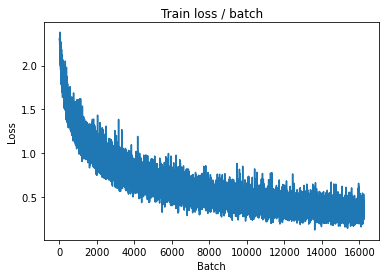


===============> Total time 16s	Avg loss 0.3274	Avg Prec@1 88.49 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.2787 (1.2787)	Prec@1  66.4 ( 66.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9897	Avg Prec@1 74.40 %	Avg Prec@5 97.66 %



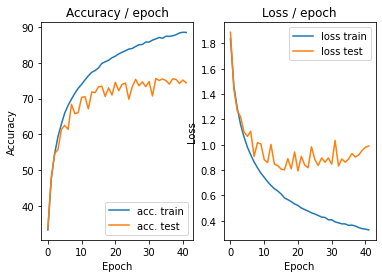

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.3277 (0.3277)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


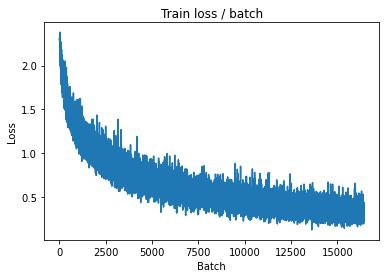

[TRAIN Batch 200/391]	Time 0.077s (0.042s)	Loss 0.3433 (0.3212)	Prec@1  88.3 ( 88.9)	Prec@5 100.0 ( 99.8)


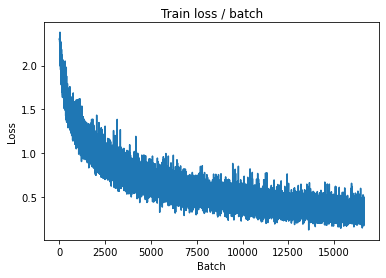


===============> Total time 16s	Avg loss 0.3328	Avg Prec@1 88.53 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.4318 (1.4318)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0058	Avg Prec@1 73.00 %	Avg Prec@5 97.76 %



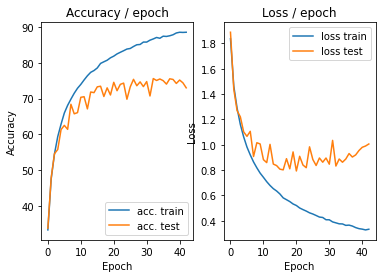

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.217s (0.217s)	Loss 0.5770 (0.5770)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


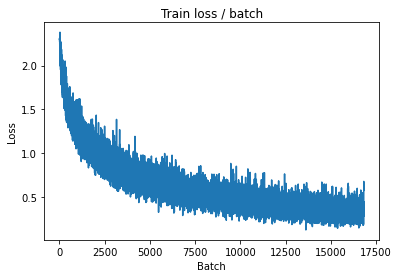

[TRAIN Batch 200/391]	Time 0.077s (0.042s)	Loss 0.3557 (0.3169)	Prec@1  93.0 ( 89.0)	Prec@5 100.0 ( 99.7)


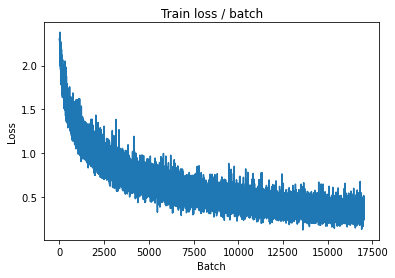


===============> Total time 16s	Avg loss 0.3196	Avg Prec@1 88.99 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.0352 (1.0352)	Prec@1  74.2 ( 74.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9289	Avg Prec@1 76.01 %	Avg Prec@5 97.82 %



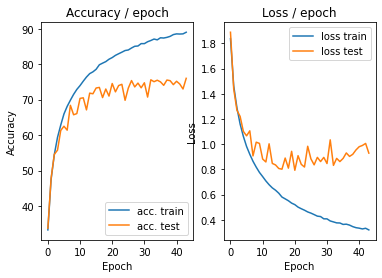

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.310s (0.310s)	Loss 0.2836 (0.2836)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


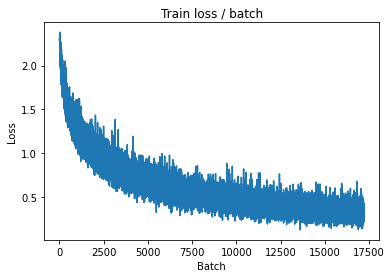

[TRAIN Batch 200/391]	Time 0.064s (0.044s)	Loss 0.2891 (0.3080)	Prec@1  90.6 ( 89.4)	Prec@5 100.0 ( 99.8)


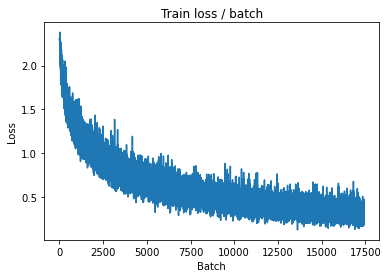


===============> Total time 16s	Avg loss 0.3181	Avg Prec@1 89.04 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.0133 (1.0133)	Prec@1  71.1 ( 71.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0145	Avg Prec@1 74.43 %	Avg Prec@5 97.71 %



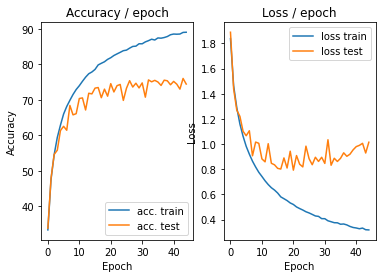

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.177s (0.177s)	Loss 0.5824 (0.5824)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


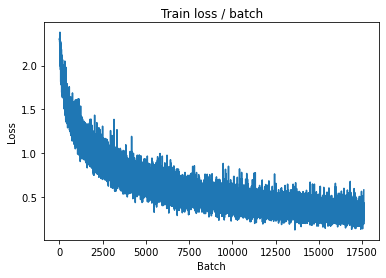

[TRAIN Batch 200/391]	Time 0.081s (0.043s)	Loss 0.2905 (0.3057)	Prec@1  89.8 ( 89.3)	Prec@5 100.0 ( 99.9)


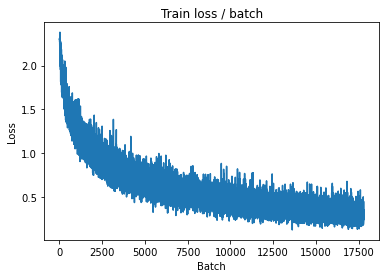


===============> Total time 16s	Avg loss 0.3135	Avg Prec@1 89.08 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.0047 (1.0047)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9379	Avg Prec@1 75.88 %	Avg Prec@5 97.97 %



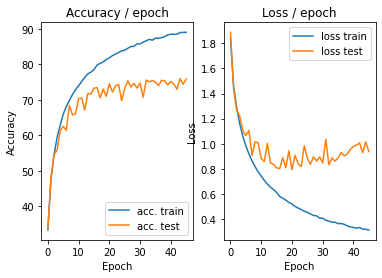

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.173s (0.173s)	Loss 0.2315 (0.2315)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


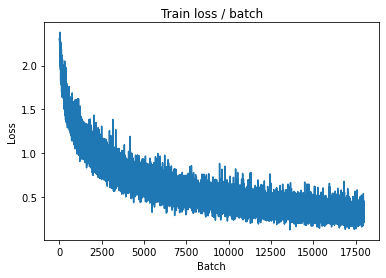

[TRAIN Batch 200/391]	Time 0.077s (0.046s)	Loss 0.4225 (0.3033)	Prec@1  86.7 ( 89.6)	Prec@5  98.4 ( 99.8)


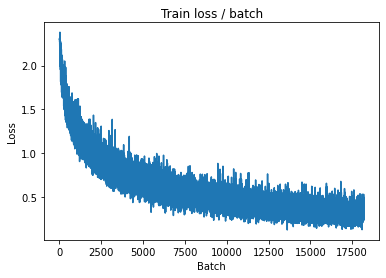


===============> Total time 17s	Avg loss 0.3095	Avg Prec@1 89.35 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.1075 (1.1075)	Prec@1  71.1 ( 71.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9509	Avg Prec@1 75.05 %	Avg Prec@5 97.85 %



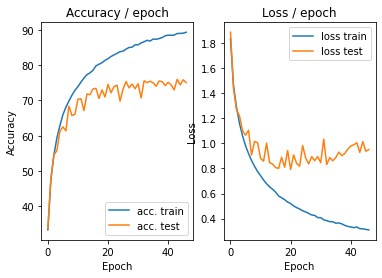

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.200s (0.200s)	Loss 0.2918 (0.2918)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


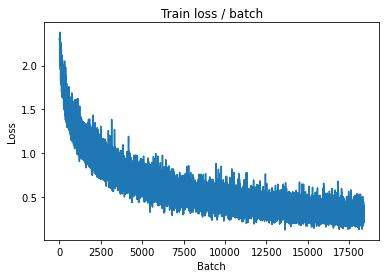

[TRAIN Batch 200/391]	Time 0.077s (0.043s)	Loss 0.2348 (0.2960)	Prec@1  92.2 ( 90.1)	Prec@5 100.0 ( 99.8)


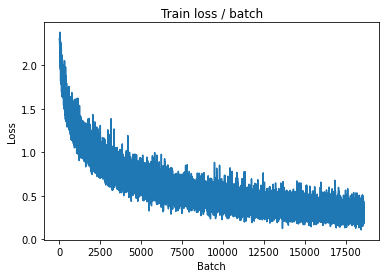


===============> Total time 16s	Avg loss 0.3037	Avg Prec@1 89.81 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.264s (0.264s)	Loss 1.2007 (1.2007)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9630	Avg Prec@1 75.38 %	Avg Prec@5 97.77 %



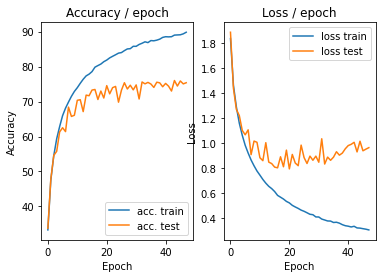

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.195s (0.195s)	Loss 0.2088 (0.2088)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


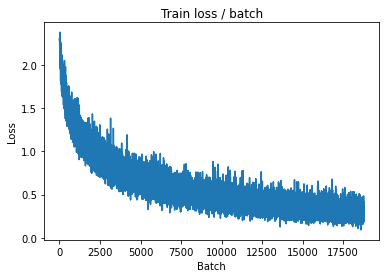

[TRAIN Batch 200/391]	Time 0.091s (0.049s)	Loss 0.2379 (0.2900)	Prec@1  93.0 ( 90.0)	Prec@5 100.0 ( 99.8)


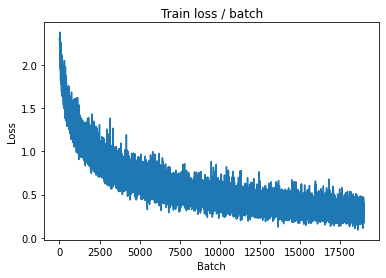


===============> Total time 18s	Avg loss 0.2979	Avg Prec@1 89.63 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 1.1982 (1.1982)	Prec@1  74.2 ( 74.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0737	Avg Prec@1 74.33 %	Avg Prec@5 97.70 %



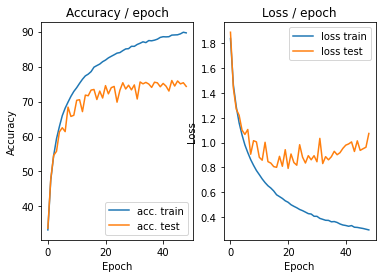

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.219s (0.219s)	Loss 0.2845 (0.2845)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


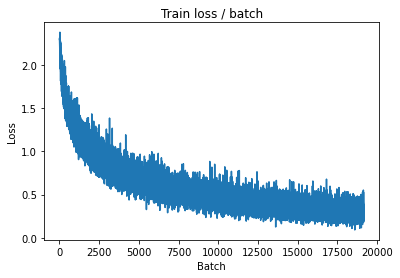

[TRAIN Batch 200/391]	Time 0.077s (0.043s)	Loss 0.3192 (0.2871)	Prec@1  86.7 ( 90.0)	Prec@5 100.0 ( 99.8)


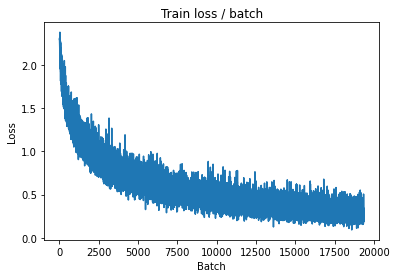


===============> Total time 16s	Avg loss 0.3008	Avg Prec@1 89.73 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.3892 (1.3892)	Prec@1  66.4 ( 66.4)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0718	Avg Prec@1 73.91 %	Avg Prec@5 97.71 %



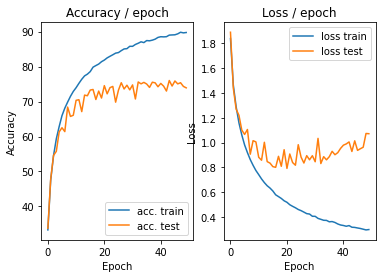

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.211s (0.211s)	Loss 0.3792 (0.3792)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


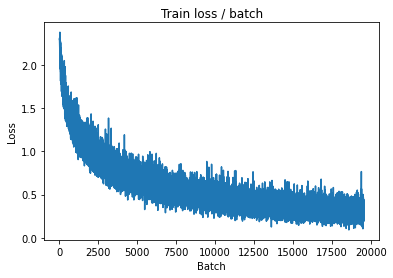

[TRAIN Batch 200/391]	Time 0.007s (0.043s)	Loss 0.3489 (0.2876)	Prec@1  88.3 ( 90.1)	Prec@5  99.2 ( 99.8)


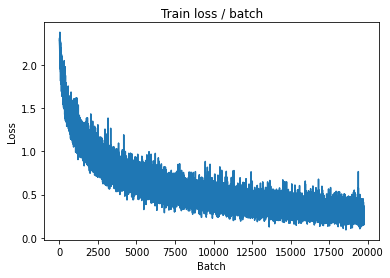


===============> Total time 16s	Avg loss 0.2947	Avg Prec@1 89.88 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.1211 (1.1211)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9672	Avg Prec@1 75.10 %	Avg Prec@5 97.93 %



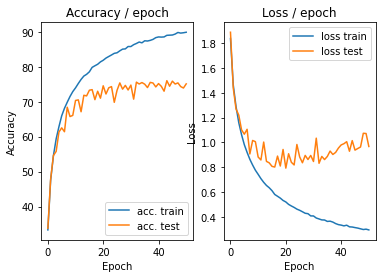

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.202s (0.202s)	Loss 0.2957 (0.2957)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


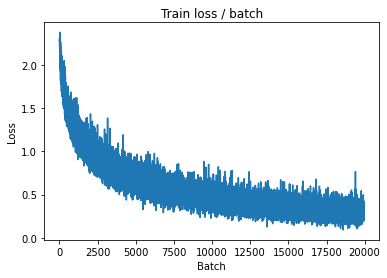

[TRAIN Batch 200/391]	Time 0.036s (0.043s)	Loss 0.2230 (0.2876)	Prec@1  91.4 ( 90.0)	Prec@5 100.0 ( 99.8)


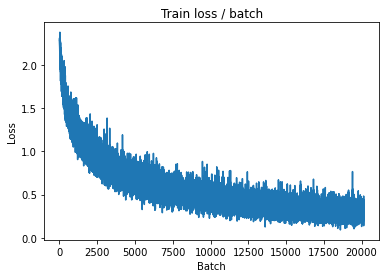


===============> Total time 16s	Avg loss 0.2909	Avg Prec@1 89.94 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.9706 (0.9706)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 1.0959	Avg Prec@1 73.32 %	Avg Prec@5 97.68 %



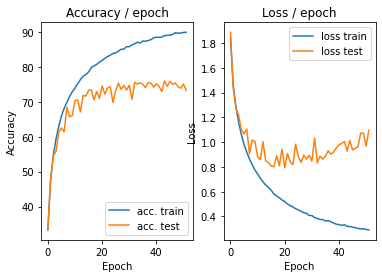

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.209s (0.209s)	Loss 0.3009 (0.3009)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


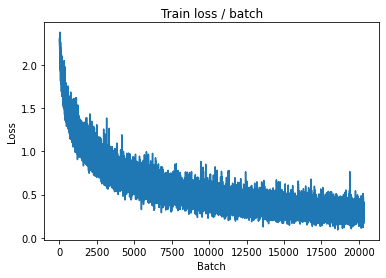

[TRAIN Batch 200/391]	Time 0.077s (0.045s)	Loss 0.3146 (0.2797)	Prec@1  89.8 ( 90.2)	Prec@5 100.0 ( 99.8)


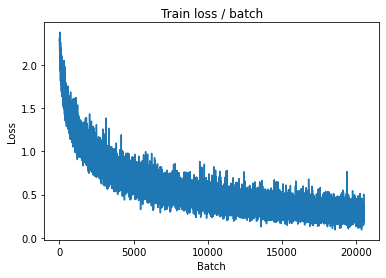


===============> Total time 17s	Avg loss 0.2871	Avg Prec@1 90.07 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 1.2322 (1.2322)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0661	Avg Prec@1 74.29 %	Avg Prec@5 97.83 %



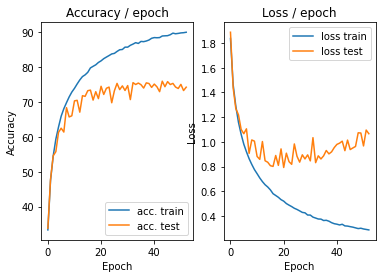

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.184s (0.184s)	Loss 0.3928 (0.3928)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)


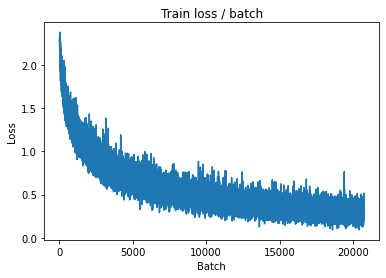

[TRAIN Batch 200/391]	Time 0.080s (0.045s)	Loss 0.1120 (0.2854)	Prec@1  97.7 ( 90.1)	Prec@5 100.0 ( 99.8)


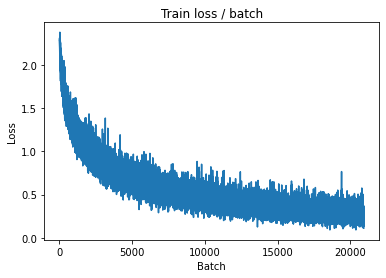


===============> Total time 17s	Avg loss 0.2852	Avg Prec@1 90.16 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.2566 (1.2566)	Prec@1  72.7 ( 72.7)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0222	Avg Prec@1 75.23 %	Avg Prec@5 97.73 %



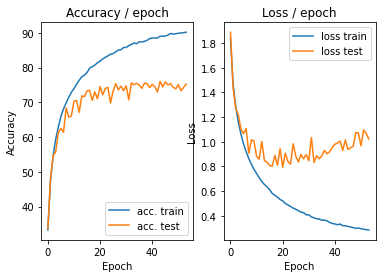

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.221s (0.221s)	Loss 0.4388 (0.4388)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


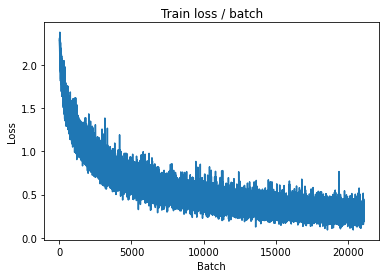

[TRAIN Batch 200/391]	Time 0.007s (0.042s)	Loss 0.2831 (0.2669)	Prec@1  90.6 ( 91.0)	Prec@5 100.0 ( 99.8)


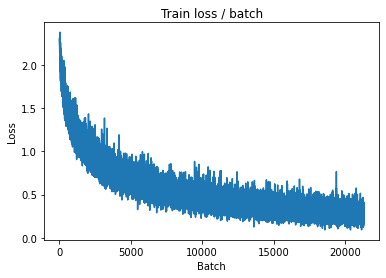


===============> Total time 16s	Avg loss 0.2725	Avg Prec@1 90.76 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.3951 (1.3951)	Prec@1  71.9 ( 71.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0674	Avg Prec@1 75.29 %	Avg Prec@5 97.90 %



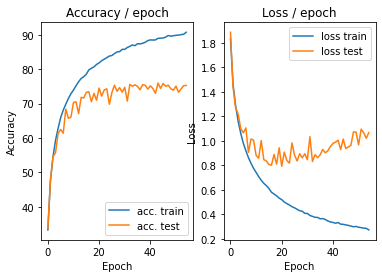

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.321s (0.321s)	Loss 0.2542 (0.2542)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


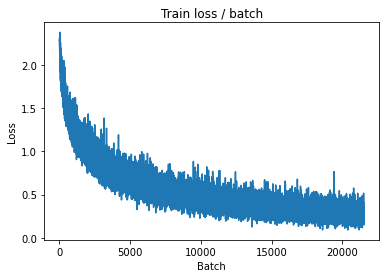

[TRAIN Batch 200/391]	Time 0.053s (0.044s)	Loss 0.1330 (0.2622)	Prec@1  96.9 ( 91.2)	Prec@5 100.0 ( 99.9)


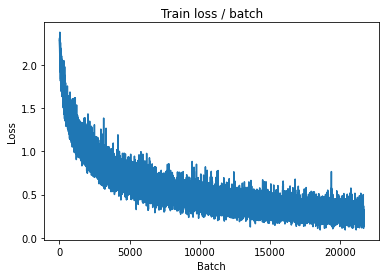


===============> Total time 16s	Avg loss 0.2703	Avg Prec@1 90.79 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.126s (0.126s)	Loss 1.2389 (1.2389)	Prec@1  68.0 ( 68.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0422	Avg Prec@1 75.07 %	Avg Prec@5 97.87 %



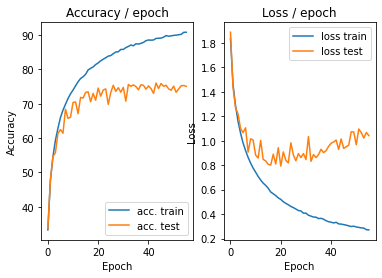

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.190s (0.190s)	Loss 0.2044 (0.2044)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


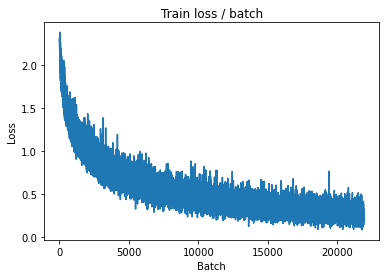

[TRAIN Batch 200/391]	Time 0.091s (0.049s)	Loss 0.2007 (0.2733)	Prec@1  93.8 ( 90.6)	Prec@5  99.2 ( 99.8)


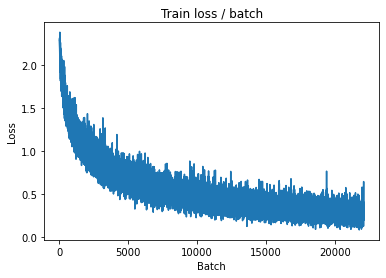


===============> Total time 18s	Avg loss 0.2802	Avg Prec@1 90.48 %	Avg Prec@5 99.83 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.0314 (1.0314)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0437	Avg Prec@1 74.80 %	Avg Prec@5 97.62 %



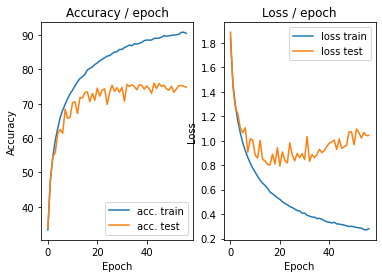

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.176s (0.176s)	Loss 0.4117 (0.4117)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


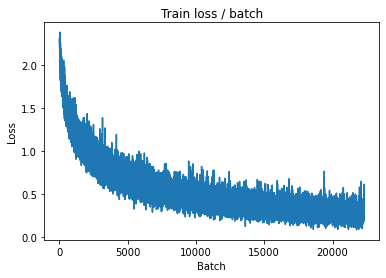

[TRAIN Batch 200/391]	Time 0.053s (0.042s)	Loss 0.3478 (0.2708)	Prec@1  89.1 ( 90.7)	Prec@5 100.0 ( 99.9)


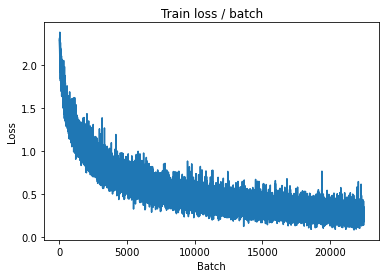


===============> Total time 16s	Avg loss 0.2784	Avg Prec@1 90.47 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 1.3483 (1.3483)	Prec@1  70.3 ( 70.3)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0577	Avg Prec@1 74.05 %	Avg Prec@5 97.56 %



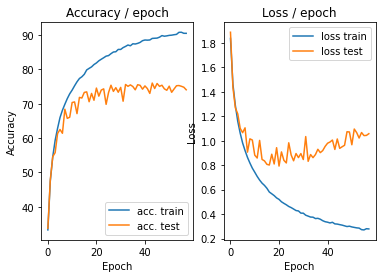

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.222s (0.222s)	Loss 0.3119 (0.3119)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


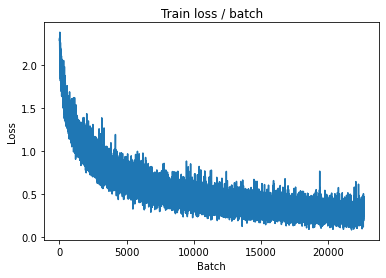

[TRAIN Batch 200/391]	Time 0.007s (0.042s)	Loss 0.2445 (0.2648)	Prec@1  93.0 ( 91.0)	Prec@5 100.0 ( 99.8)


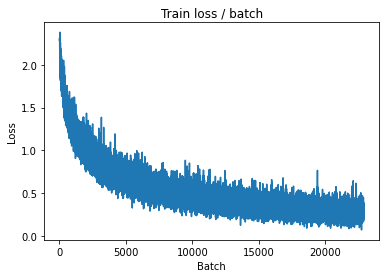


===============> Total time 16s	Avg loss 0.2761	Avg Prec@1 90.50 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.283s (0.283s)	Loss 1.0354 (1.0354)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.0336	Avg Prec@1 74.60 %	Avg Prec@5 97.60 %



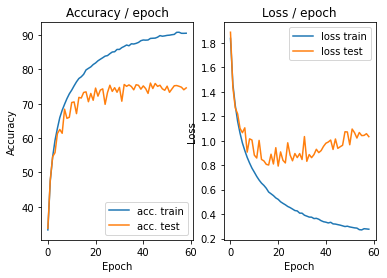

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.175s (0.175s)	Loss 0.2590 (0.2590)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


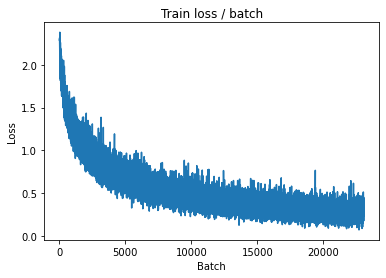

[TRAIN Batch 200/391]	Time 0.047s (0.042s)	Loss 0.1916 (0.2572)	Prec@1  92.2 ( 91.2)	Prec@5  99.2 ( 99.9)


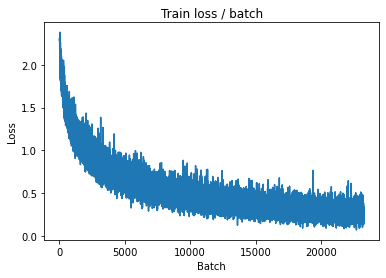


===============> Total time 16s	Avg loss 0.2625	Avg Prec@1 91.13 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.2710 (1.2710)	Prec@1  69.5 ( 69.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 1.0880	Avg Prec@1 74.42 %	Avg Prec@5 97.76 %



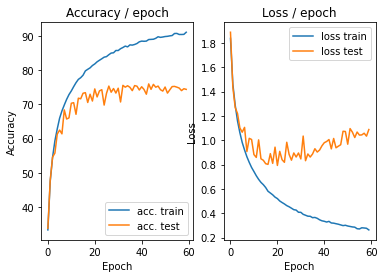

In [17]:
main(128, 0.1,60, cuda=True)

## Variants of SGD

### lr scheduler

In [25]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0,ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,                      
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(p=0.5)
        ]))
    
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        #update lr scheduler
        lr_sched.step()


Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 2.3032 (2.3032)	Prec@1  14.1 ( 14.1)	Prec@5  52.3 ( 52.3)


<Figure size 432x288 with 0 Axes>

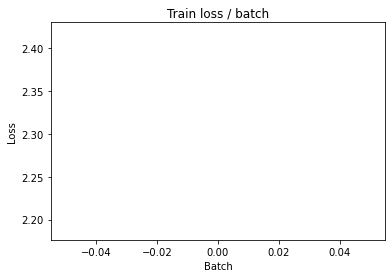

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 1.7434 (1.9601)	Prec@1  35.2 ( 27.9)	Prec@5  89.1 ( 79.3)


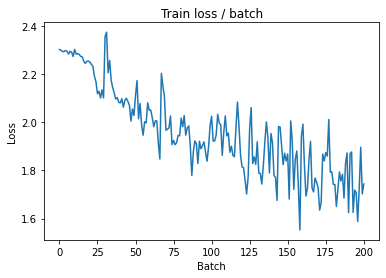


===============> Total time 7s	Avg loss 1.7928	Avg Prec@1 34.43 %	Avg Prec@5 84.45 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.7193 (1.7193)	Prec@1  40.6 ( 40.6)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.7464	Avg Prec@1 36.81 %	Avg Prec@5 89.37 %



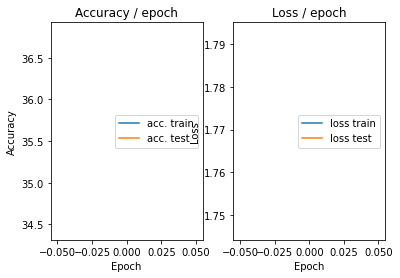

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 1.7448 (1.7448)	Prec@1  35.2 ( 35.2)	Prec@5  89.8 ( 89.8)


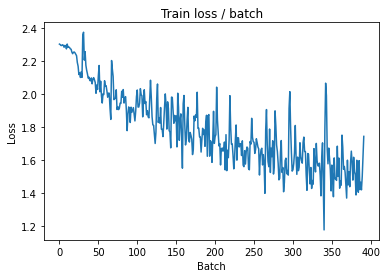

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.3501 (1.4349)	Prec@1  49.2 ( 48.8)	Prec@5  90.6 ( 92.5)


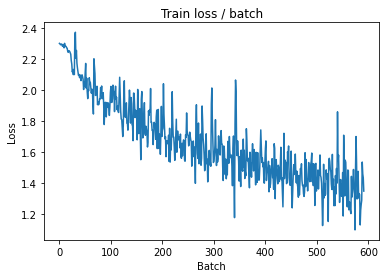


===============> Total time 8s	Avg loss 1.3827	Avg Prec@1 50.81 %	Avg Prec@5 93.22 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 1.1520 (1.1520)	Prec@1  60.9 ( 60.9)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.1767	Avg Prec@1 58.13 %	Avg Prec@5 95.33 %



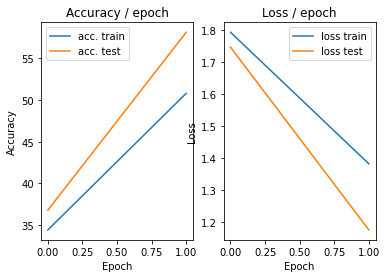

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 1.2689 (1.2689)	Prec@1  53.9 ( 53.9)	Prec@5  97.7 ( 97.7)


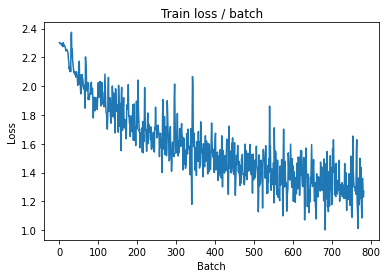

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 1.1755 (1.2112)	Prec@1  60.2 ( 57.0)	Prec@5  93.0 ( 95.1)


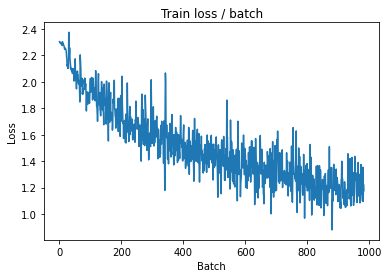


===============> Total time 7s	Avg loss 1.1730	Avg Prec@1 58.48 %	Avg Prec@5 95.44 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 1.0870 (1.0870)	Prec@1  63.3 ( 63.3)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.1440	Avg Prec@1 58.74 %	Avg Prec@5 95.95 %



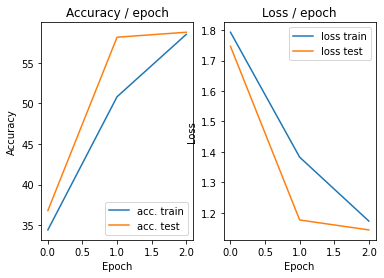

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.2119 (1.2119)	Prec@1  59.4 ( 59.4)	Prec@5  94.5 ( 94.5)


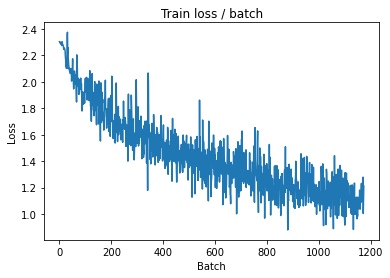

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.9574 (1.0465)	Prec@1  65.6 ( 63.0)	Prec@5  99.2 ( 96.5)


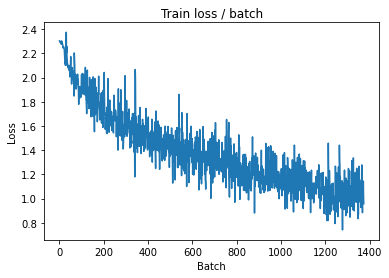


===============> Total time 7s	Avg loss 1.0159	Avg Prec@1 64.48 %	Avg Prec@5 96.67 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.9891 (0.9891)	Prec@1  64.8 ( 64.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9582	Avg Prec@1 66.89 %	Avg Prec@5 96.90 %



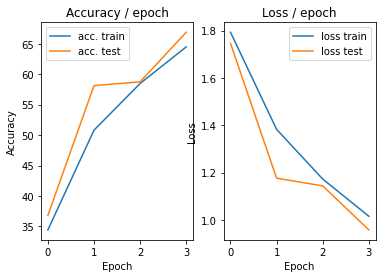

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 1.1119 (1.1119)	Prec@1  61.7 ( 61.7)	Prec@5  98.4 ( 98.4)


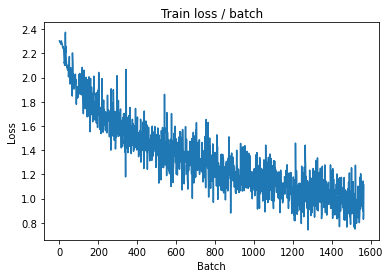

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.7308 (0.9174)	Prec@1  76.6 ( 68.0)	Prec@5 100.0 ( 97.3)


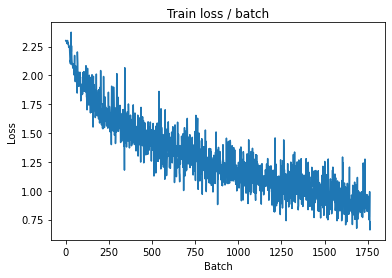


===============> Total time 7s	Avg loss 0.9066	Avg Prec@1 68.25 %	Avg Prec@5 97.29 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8096 (0.8096)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8480	Avg Prec@1 70.65 %	Avg Prec@5 97.56 %



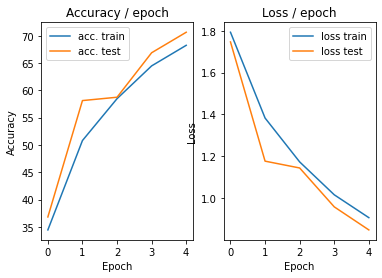

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.8057 (0.8057)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)


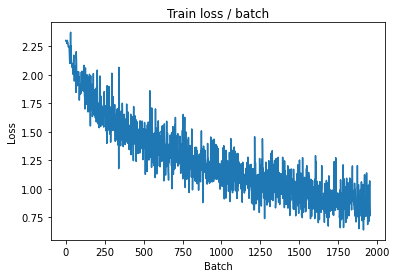

[TRAIN Batch 200/391]	Time 0.030s (0.021s)	Loss 0.6856 (0.8290)	Prec@1  81.2 ( 70.9)	Prec@5  98.4 ( 97.9)


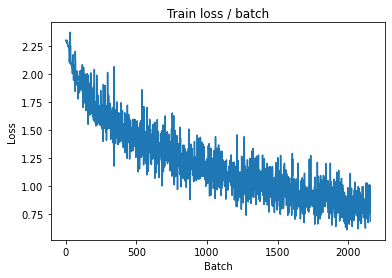


===============> Total time 7s	Avg loss 0.8197	Avg Prec@1 71.26 %	Avg Prec@5 97.92 %

[EVAL Batch 000/079]	Time 0.306s (0.306s)	Loss 0.7859 (0.7859)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7984	Avg Prec@1 73.14 %	Avg Prec@5 97.92 %



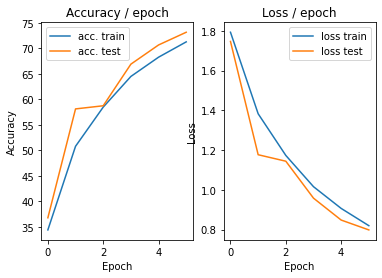

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.6433 (0.6433)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


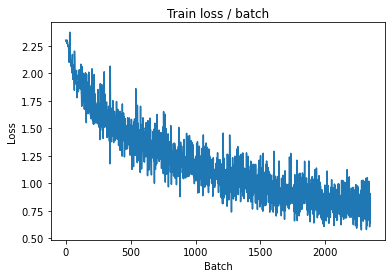

[TRAIN Batch 200/391]	Time 0.024s (0.019s)	Loss 0.8399 (0.7668)	Prec@1  72.7 ( 73.4)	Prec@5  99.2 ( 98.1)


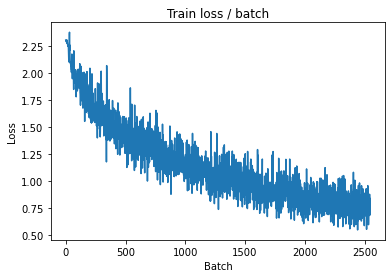


===============> Total time 7s	Avg loss 0.7542	Avg Prec@1 73.74 %	Avg Prec@5 98.16 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.6946 (0.6946)	Prec@1  72.7 ( 72.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7221	Avg Prec@1 75.19 %	Avg Prec@5 98.24 %



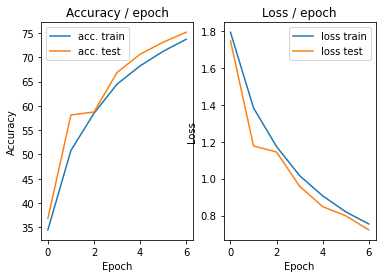

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.7921 (0.7921)	Prec@1  77.3 ( 77.3)	Prec@5  96.1 ( 96.1)


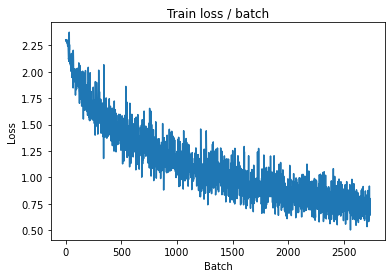

[TRAIN Batch 200/391]	Time 0.022s (0.018s)	Loss 0.8302 (0.7016)	Prec@1  71.1 ( 75.7)	Prec@5  97.7 ( 98.4)


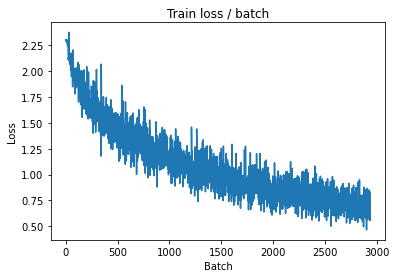


===============> Total time 7s	Avg loss 0.6966	Avg Prec@1 75.94 %	Avg Prec@5 98.41 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.7530 (0.7530)	Prec@1  76.6 ( 76.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7697	Avg Prec@1 73.93 %	Avg Prec@5 98.18 %



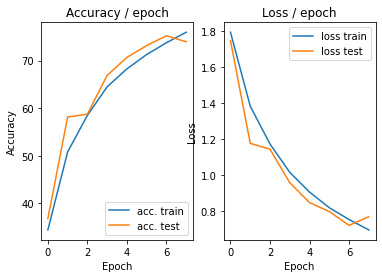

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.7286 (0.7286)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


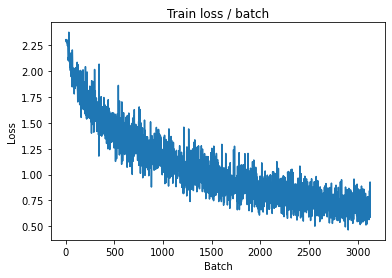

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.7541 (0.6474)	Prec@1  72.7 ( 77.3)	Prec@5  96.9 ( 98.6)


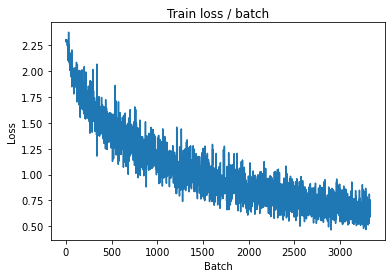


===============> Total time 7s	Avg loss 0.6536	Avg Prec@1 77.23 %	Avg Prec@5 98.64 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.7257 (0.7257)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6979	Avg Prec@1 75.63 %	Avg Prec@5 98.40 %



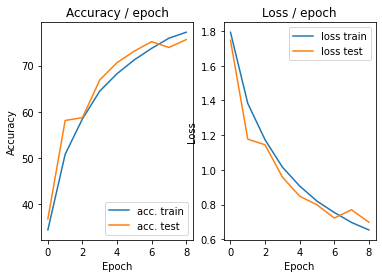

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.5354 (0.5354)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)


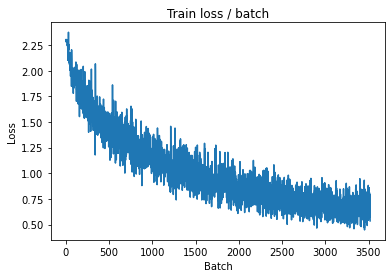

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.5685 (0.6157)	Prec@1  82.8 ( 78.6)	Prec@5 100.0 ( 98.8)


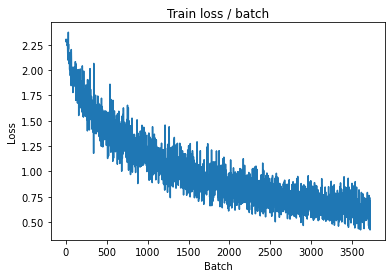


===============> Total time 7s	Avg loss 0.6164	Avg Prec@1 78.47 %	Avg Prec@5 98.85 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.6311 (0.6311)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6551	Avg Prec@1 77.77 %	Avg Prec@5 98.56 %



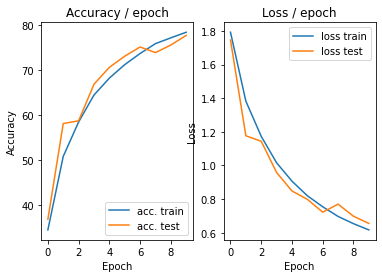

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.5794 (0.5794)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


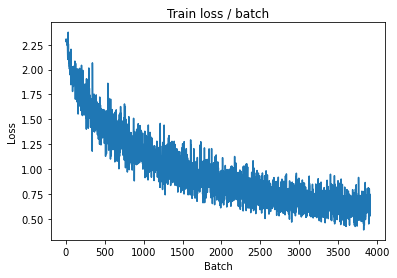

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.4776 (0.5684)	Prec@1  86.7 ( 80.2)	Prec@5  99.2 ( 99.0)


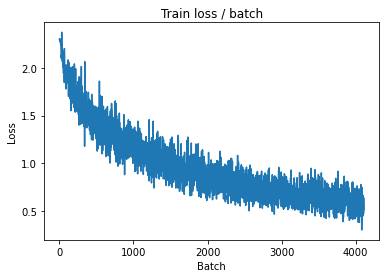


===============> Total time 8s	Avg loss 0.5751	Avg Prec@1 79.86 %	Avg Prec@5 98.94 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.6201 (0.6201)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6597	Avg Prec@1 77.38 %	Avg Prec@5 98.52 %



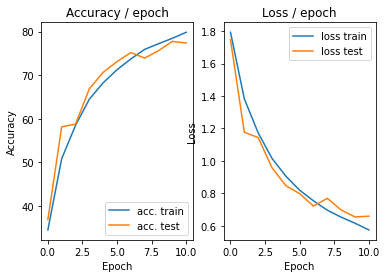

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.5855 (0.5855)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


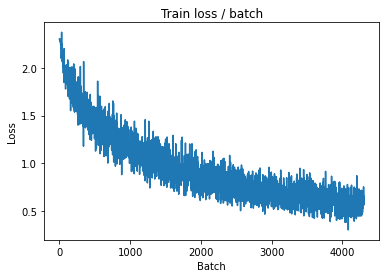

[TRAIN Batch 200/391]	Time 0.029s (0.018s)	Loss 0.5409 (0.5465)	Prec@1  84.4 ( 81.1)	Prec@5  96.9 ( 99.2)


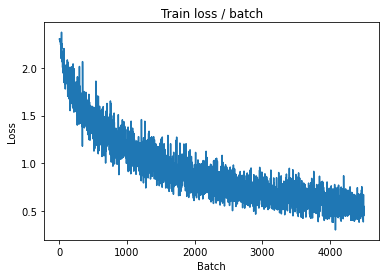


===============> Total time 7s	Avg loss 0.5478	Avg Prec@1 80.82 %	Avg Prec@5 99.15 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.6693 (0.6693)	Prec@1  77.3 ( 77.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6365	Avg Prec@1 78.50 %	Avg Prec@5 98.53 %



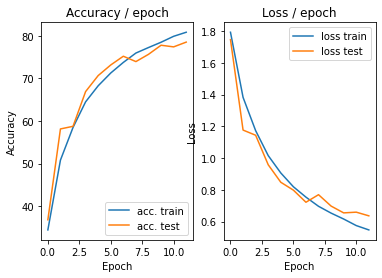

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.4846 (0.4846)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


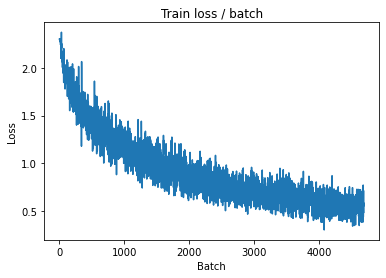

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.5424 (0.5114)	Prec@1  78.9 ( 82.1)	Prec@5  98.4 ( 99.3)


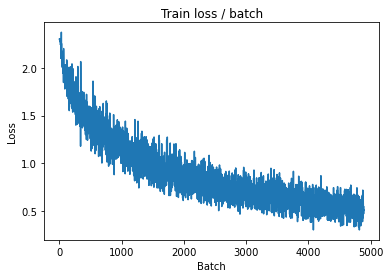


===============> Total time 7s	Avg loss 0.5177	Avg Prec@1 81.85 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.6912 (0.6912)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6473	Avg Prec@1 78.46 %	Avg Prec@5 98.28 %



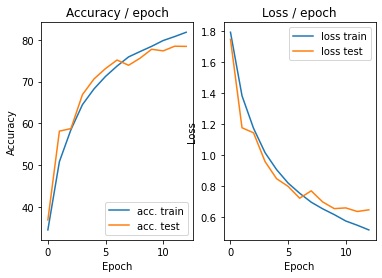

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.251s (0.251s)	Loss 0.4291 (0.4291)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


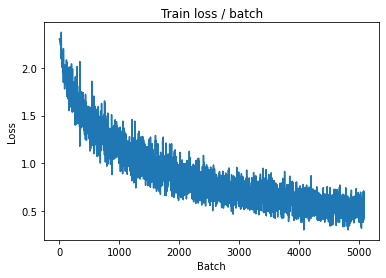

[TRAIN Batch 200/391]	Time 0.032s (0.020s)	Loss 0.4495 (0.4914)	Prec@1  84.4 ( 82.8)	Prec@5 100.0 ( 99.3)


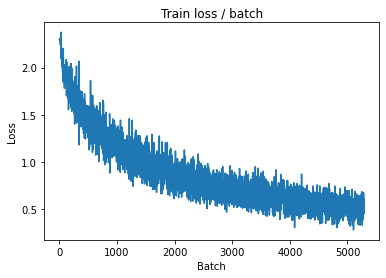


===============> Total time 7s	Avg loss 0.4917	Avg Prec@1 82.81 %	Avg Prec@5 99.29 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.6395 (0.6395)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6168	Avg Prec@1 78.72 %	Avg Prec@5 98.89 %



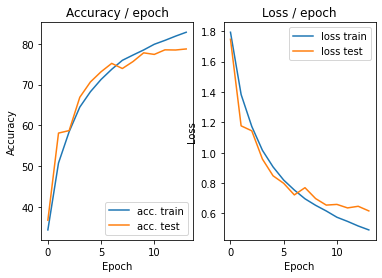

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.5221 (0.5221)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


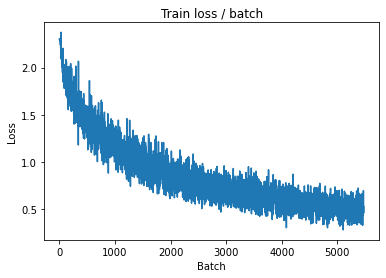

[TRAIN Batch 200/391]	Time 0.031s (0.020s)	Loss 0.4745 (0.4606)	Prec@1  84.4 ( 84.2)	Prec@5 100.0 ( 99.4)


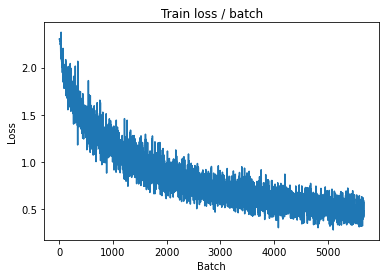


===============> Total time 7s	Avg loss 0.4618	Avg Prec@1 83.92 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.6432 (0.6432)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6597	Avg Prec@1 77.78 %	Avg Prec@5 98.61 %



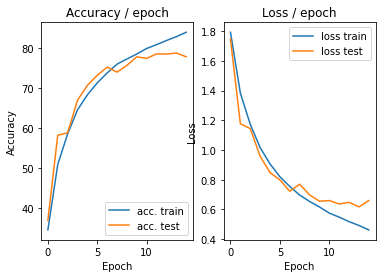

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.4883 (0.4883)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


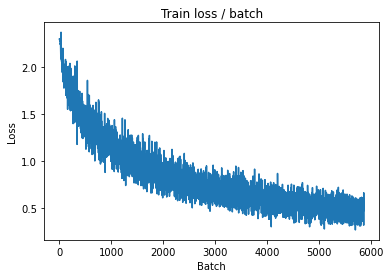

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 0.4776 (0.4410)	Prec@1  84.4 ( 84.6)	Prec@5  99.2 ( 99.4)


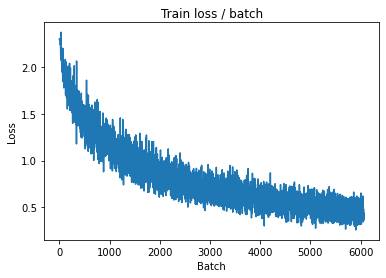


===============> Total time 8s	Avg loss 0.4422	Avg Prec@1 84.63 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.111s (0.111s)	Loss 0.5937 (0.5937)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5760	Avg Prec@1 80.56 %	Avg Prec@5 98.86 %



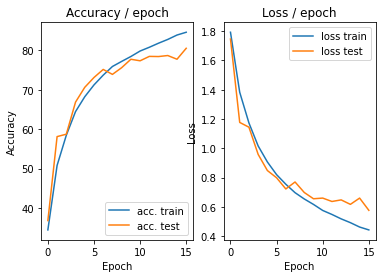

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.117s (0.117s)	Loss 0.4688 (0.4688)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


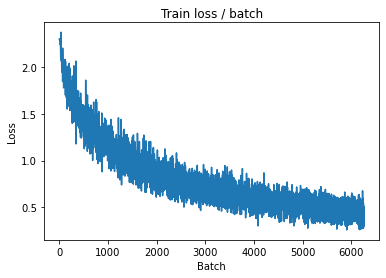

[TRAIN Batch 200/391]	Time 0.031s (0.019s)	Loss 0.4046 (0.4180)	Prec@1  85.9 ( 85.5)	Prec@5  99.2 ( 99.5)


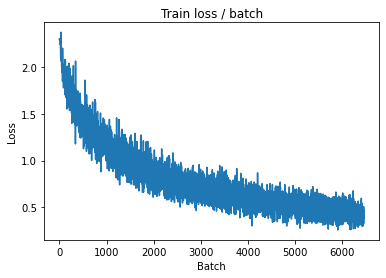


===============> Total time 7s	Avg loss 0.4179	Avg Prec@1 85.44 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.253s (0.253s)	Loss 0.5655 (0.5655)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6241	Avg Prec@1 79.32 %	Avg Prec@5 98.72 %



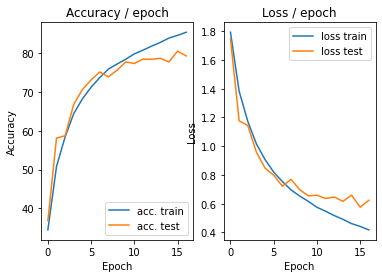

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.3702 (0.3702)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


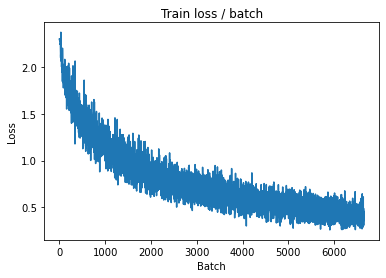

[TRAIN Batch 200/391]	Time 0.033s (0.020s)	Loss 0.3311 (0.3989)	Prec@1  85.9 ( 86.1)	Prec@5 100.0 ( 99.5)


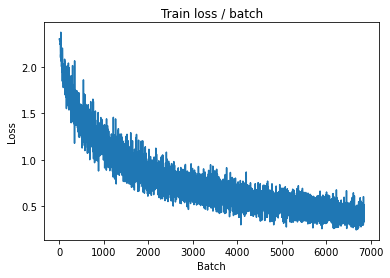


===============> Total time 7s	Avg loss 0.4011	Avg Prec@1 85.99 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 0.6420 (0.6420)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6051	Avg Prec@1 80.08 %	Avg Prec@5 98.82 %



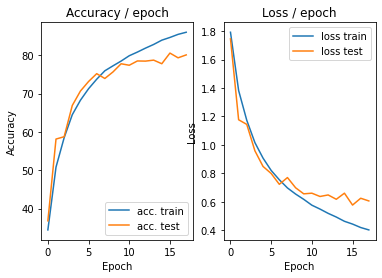

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.4366 (0.4366)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


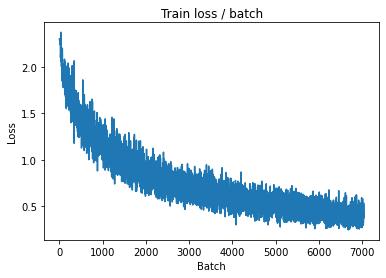

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3239 (0.3799)	Prec@1  88.3 ( 86.7)	Prec@5 100.0 ( 99.6)


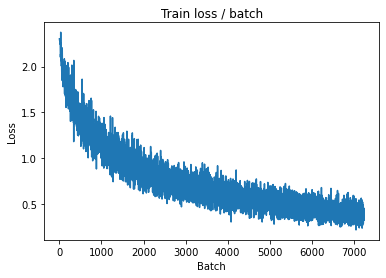


===============> Total time 7s	Avg loss 0.3773	Avg Prec@1 86.75 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.5298 (0.5298)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6216	Avg Prec@1 79.91 %	Avg Prec@5 98.79 %



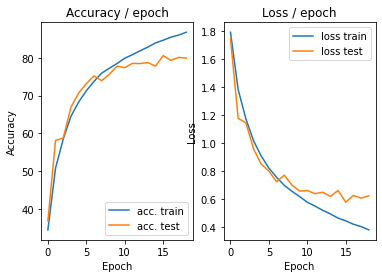

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.3413 (0.3413)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


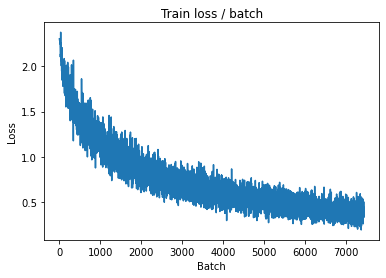

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.3166 (0.3566)	Prec@1  89.1 ( 87.7)	Prec@5 100.0 ( 99.7)


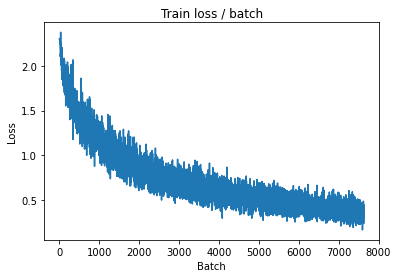


===============> Total time 7s	Avg loss 0.3632	Avg Prec@1 87.34 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.5518 (0.5518)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6120	Avg Prec@1 80.12 %	Avg Prec@5 98.73 %



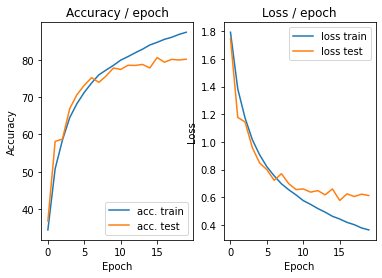

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.2704 (0.2704)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


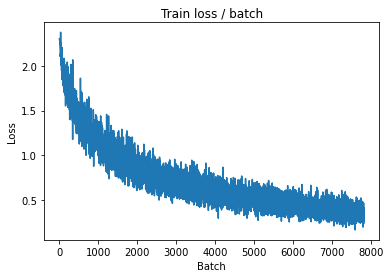

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.3426 (0.3494)	Prec@1  89.8 ( 87.8)	Prec@5 100.0 ( 99.7)


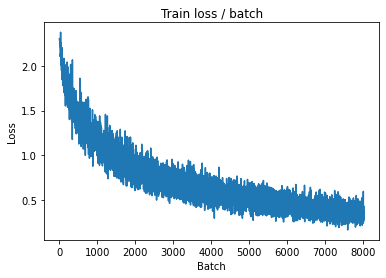


===============> Total time 7s	Avg loss 0.3485	Avg Prec@1 87.84 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.5085 (0.5085)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6231	Avg Prec@1 80.06 %	Avg Prec@5 98.64 %



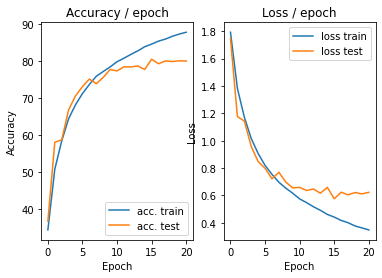

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.3517 (0.3517)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


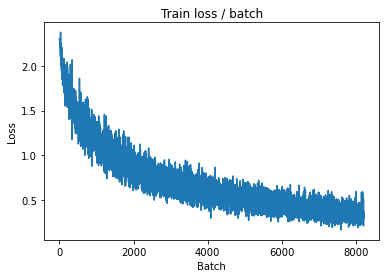

[TRAIN Batch 200/391]	Time 0.031s (0.020s)	Loss 0.4862 (0.3318)	Prec@1  82.8 ( 88.6)	Prec@5 100.0 ( 99.7)


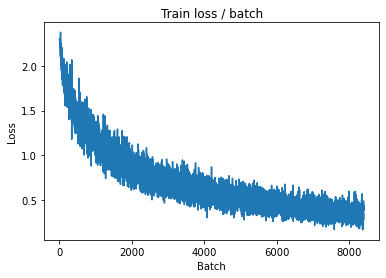


===============> Total time 7s	Avg loss 0.3328	Avg Prec@1 88.55 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.4907 (0.4907)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5844	Avg Prec@1 81.13 %	Avg Prec@5 98.84 %



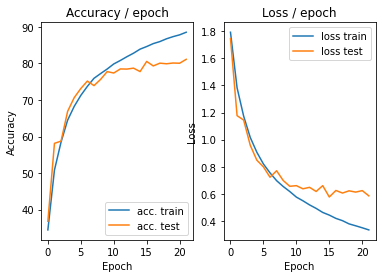

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.2112 (0.2112)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


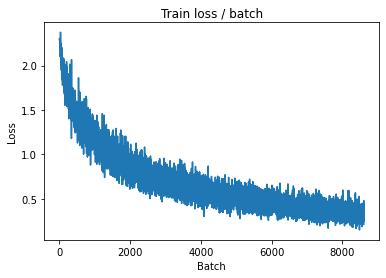

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.4104 (0.3124)	Prec@1  86.7 ( 89.2)	Prec@5  99.2 ( 99.7)


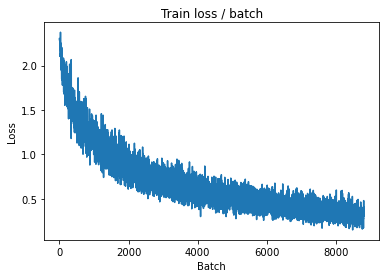


===============> Total time 8s	Avg loss 0.3147	Avg Prec@1 89.05 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.5422 (0.5422)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6001	Avg Prec@1 80.81 %	Avg Prec@5 98.85 %



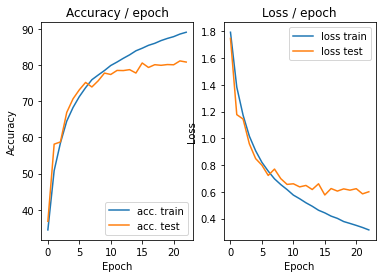

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.3548 (0.3548)	Prec@1  89.1 ( 89.1)	Prec@5  98.4 ( 98.4)


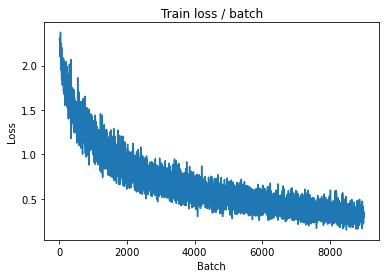

[TRAIN Batch 200/391]	Time 0.007s (0.018s)	Loss 0.3207 (0.2913)	Prec@1  91.4 ( 89.9)	Prec@5 100.0 ( 99.8)


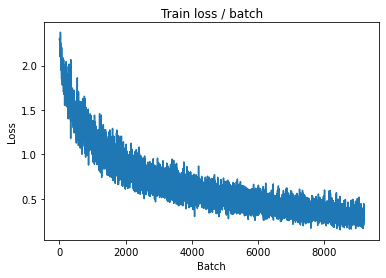


===============> Total time 7s	Avg loss 0.2995	Avg Prec@1 89.60 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.5427 (0.5427)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5991	Avg Prec@1 81.17 %	Avg Prec@5 98.71 %



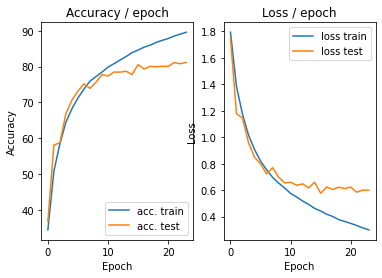

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.2986 (0.2986)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


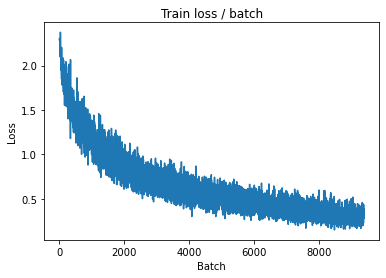

[TRAIN Batch 200/391]	Time 0.006s (0.020s)	Loss 0.2861 (0.2891)	Prec@1  89.1 ( 90.1)	Prec@5 100.0 ( 99.8)


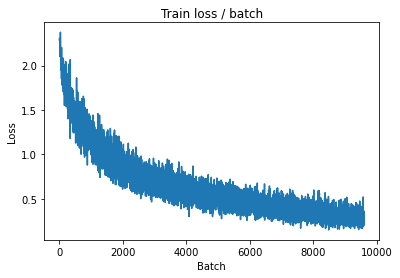


===============> Total time 7s	Avg loss 0.2876	Avg Prec@1 90.06 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.5118 (0.5118)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5896	Avg Prec@1 81.13 %	Avg Prec@5 98.80 %



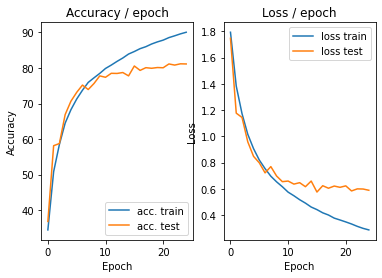

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.2120 (0.2120)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


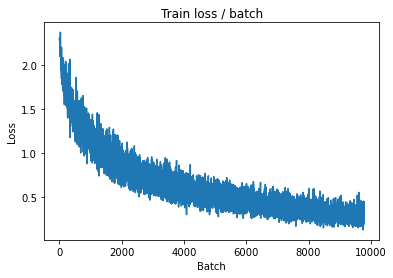

[TRAIN Batch 200/391]	Time 0.030s (0.020s)	Loss 0.4422 (0.2714)	Prec@1  87.5 ( 90.6)	Prec@5  99.2 ( 99.8)


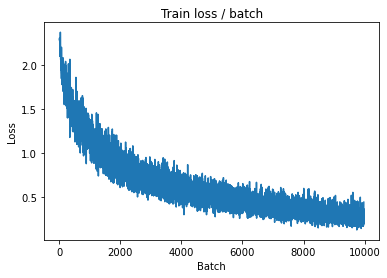


===============> Total time 7s	Avg loss 0.2745	Avg Prec@1 90.54 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.5381 (0.5381)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6106	Avg Prec@1 81.31 %	Avg Prec@5 98.85 %



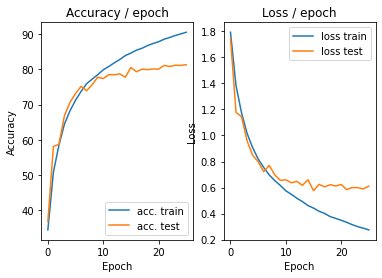

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.2817 (0.2817)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


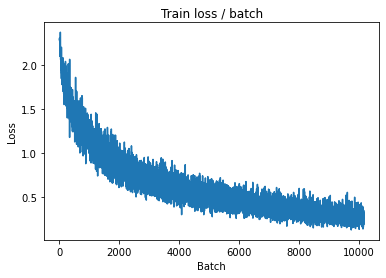

[TRAIN Batch 200/391]	Time 0.034s (0.019s)	Loss 0.2465 (0.2609)	Prec@1  91.4 ( 90.7)	Prec@5 100.0 ( 99.8)


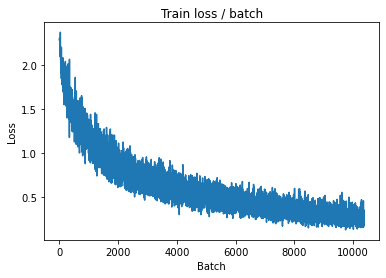


===============> Total time 7s	Avg loss 0.2625	Avg Prec@1 90.82 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.4419 (0.4419)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6025	Avg Prec@1 80.94 %	Avg Prec@5 98.71 %



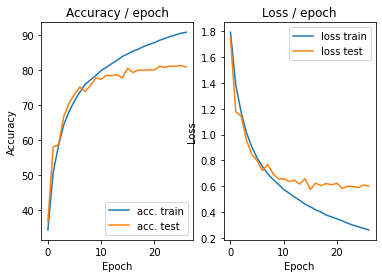

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.2104 (0.2104)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


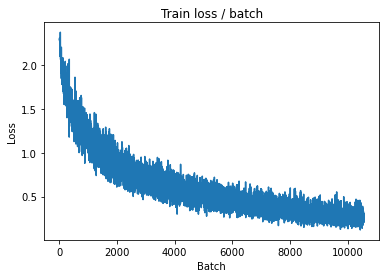

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3562 (0.2466)	Prec@1  82.8 ( 91.5)	Prec@5 100.0 ( 99.9)


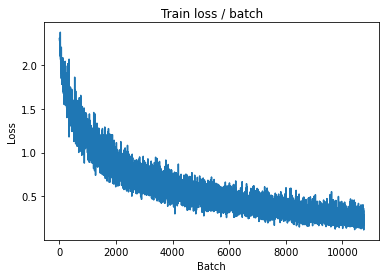


===============> Total time 7s	Avg loss 0.2474	Avg Prec@1 91.41 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.293s (0.293s)	Loss 0.5002 (0.5002)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5952	Avg Prec@1 81.81 %	Avg Prec@5 98.94 %



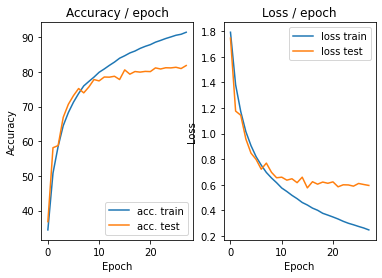

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.3432 (0.3432)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


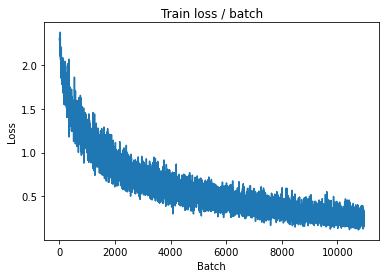

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.1682 (0.2348)	Prec@1  93.8 ( 91.7)	Prec@5 100.0 ( 99.9)


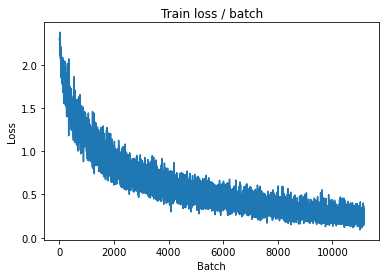


===============> Total time 7s	Avg loss 0.2380	Avg Prec@1 91.62 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.4796 (0.4796)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6029	Avg Prec@1 81.36 %	Avg Prec@5 98.78 %



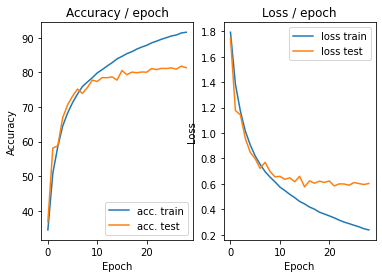

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.1469 (0.1469)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


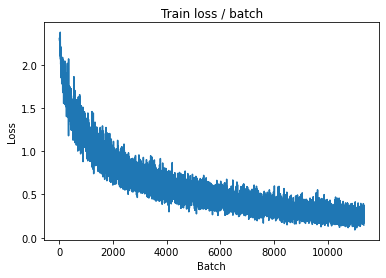

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.2324 (0.2255)	Prec@1  89.8 ( 92.1)	Prec@5 100.0 ( 99.9)


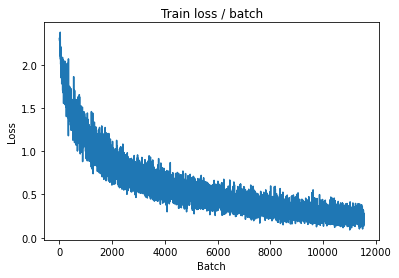


===============> Total time 7s	Avg loss 0.2255	Avg Prec@1 92.17 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.4945 (0.4945)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6233	Avg Prec@1 81.55 %	Avg Prec@5 98.98 %



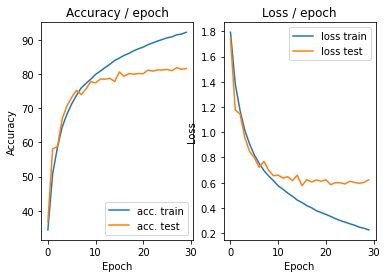

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.2060 (0.2060)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


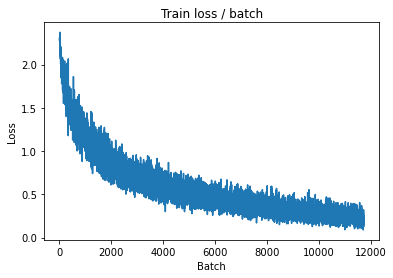

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.2912 (0.2203)	Prec@1  89.8 ( 92.5)	Prec@5  99.2 ( 99.9)


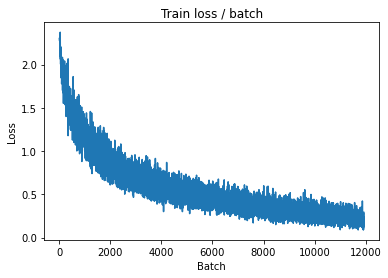


===============> Total time 7s	Avg loss 0.2182	Avg Prec@1 92.59 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.5022 (0.5022)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6037	Avg Prec@1 82.09 %	Avg Prec@5 98.93 %



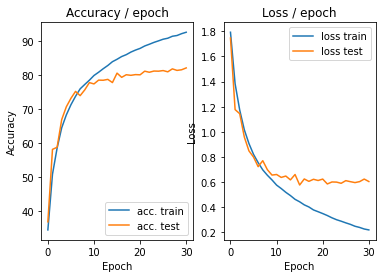

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.2105 (0.2105)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


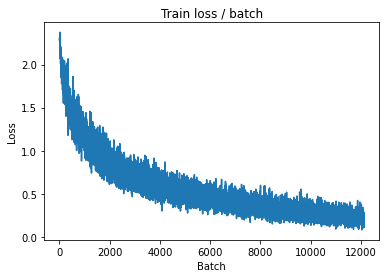

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 0.2461 (0.2036)	Prec@1  90.6 ( 93.0)	Prec@5 100.0 ( 99.9)


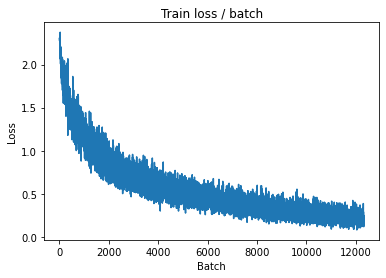


===============> Total time 7s	Avg loss 0.2065	Avg Prec@1 92.93 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.5369 (0.5369)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6181	Avg Prec@1 81.91 %	Avg Prec@5 98.75 %



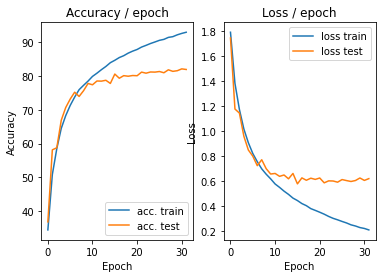

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.1952 (0.1952)	Prec@1  93.8 ( 93.8)	Prec@5  99.2 ( 99.2)


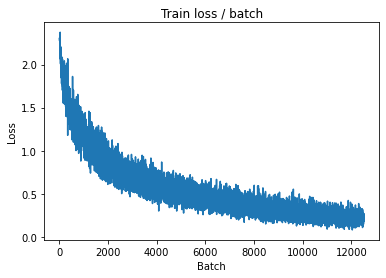

[TRAIN Batch 200/391]	Time 0.010s (0.018s)	Loss 0.1500 (0.1867)	Prec@1  93.8 ( 93.6)	Prec@5 100.0 ( 99.9)


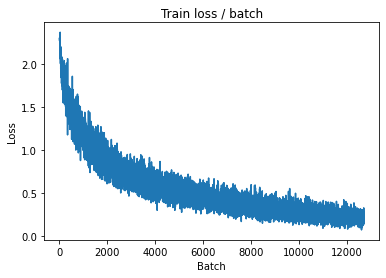


===============> Total time 7s	Avg loss 0.1936	Avg Prec@1 93.32 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.4777 (0.4777)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6031	Avg Prec@1 82.59 %	Avg Prec@5 98.89 %



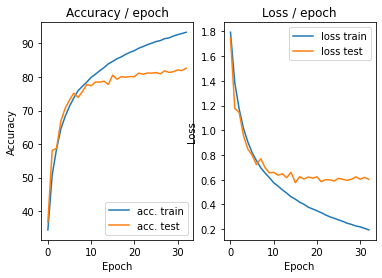

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.1517 (0.1517)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


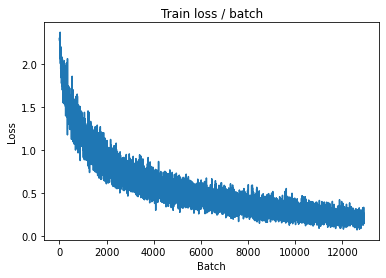

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.2415 (0.1829)	Prec@1  90.6 ( 93.7)	Prec@5 100.0 ( 99.9)


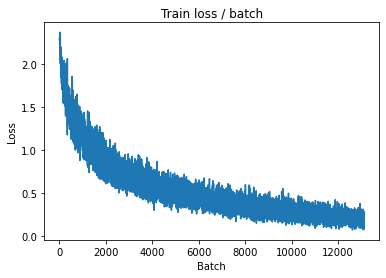


===============> Total time 7s	Avg loss 0.1870	Avg Prec@1 93.57 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.4847 (0.4847)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6152	Avg Prec@1 81.89 %	Avg Prec@5 98.93 %



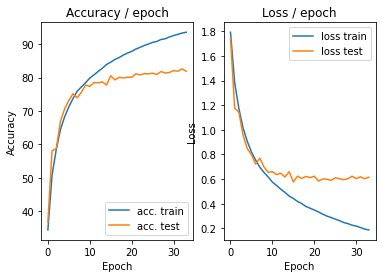

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.1525 (0.1525)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


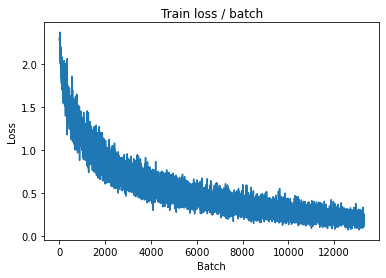

[TRAIN Batch 200/391]	Time 0.028s (0.018s)	Loss 0.1659 (0.1798)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 ( 99.9)


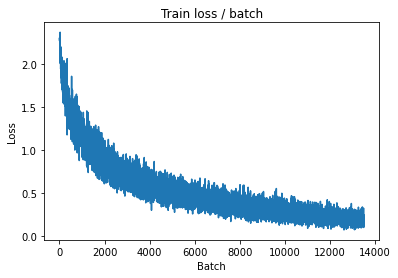


===============> Total time 7s	Avg loss 0.1828	Avg Prec@1 93.75 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 0.4804 (0.4804)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6088	Avg Prec@1 82.15 %	Avg Prec@5 98.82 %



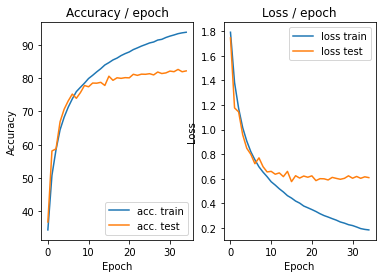

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.1285 (0.1285)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


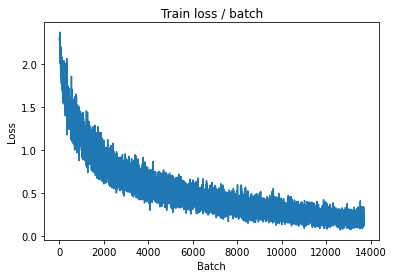

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.1750 (0.1750)	Prec@1  96.9 ( 94.0)	Prec@5 100.0 (100.0)


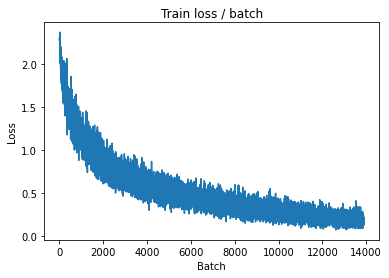


===============> Total time 7s	Avg loss 0.1746	Avg Prec@1 93.96 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.5607 (0.5607)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6382	Avg Prec@1 81.88 %	Avg Prec@5 98.86 %



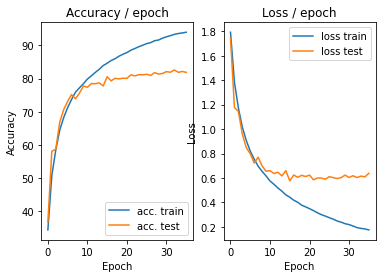

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.1630 (0.1630)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


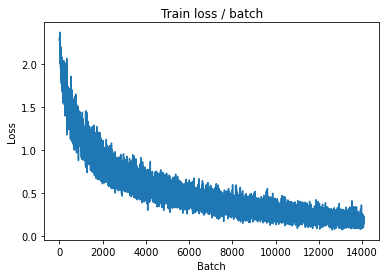

[TRAIN Batch 200/391]	Time 0.032s (0.021s)	Loss 0.1691 (0.1607)	Prec@1  93.8 ( 94.7)	Prec@5 100.0 ( 99.9)


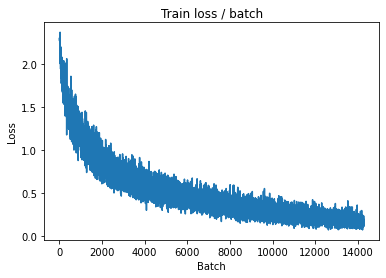


===============> Total time 7s	Avg loss 0.1637	Avg Prec@1 94.54 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.5077 (0.5077)	Prec@1  87.5 ( 87.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6351	Avg Prec@1 82.01 %	Avg Prec@5 98.82 %



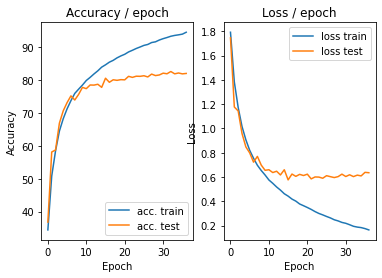

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.2482 (0.2482)	Prec@1  93.0 ( 93.0)	Prec@5  98.4 ( 98.4)


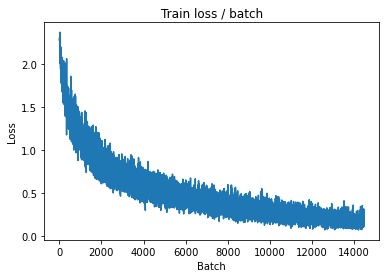

[TRAIN Batch 200/391]	Time 0.030s (0.020s)	Loss 0.1901 (0.1548)	Prec@1  93.8 ( 94.6)	Prec@5 100.0 ( 99.9)


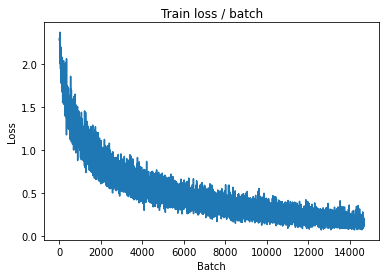


===============> Total time 7s	Avg loss 0.1622	Avg Prec@1 94.51 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 0.5280 (0.5280)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6477	Avg Prec@1 81.81 %	Avg Prec@5 98.88 %



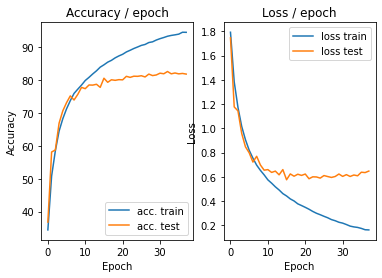

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.0973 (0.0973)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


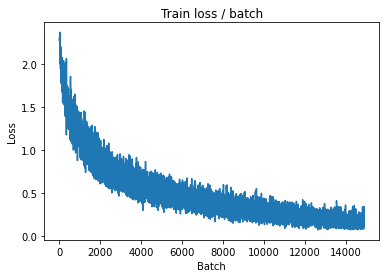

[TRAIN Batch 200/391]	Time 0.030s (0.020s)	Loss 0.1601 (0.1563)	Prec@1  94.5 ( 94.9)	Prec@5 100.0 ( 99.9)


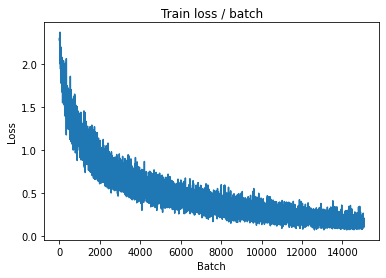


===============> Total time 7s	Avg loss 0.1553	Avg Prec@1 94.83 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.286s (0.286s)	Loss 0.5091 (0.5091)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6420	Avg Prec@1 81.84 %	Avg Prec@5 98.82 %



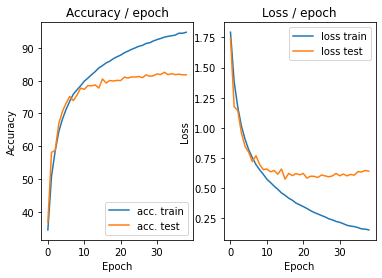

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.1827 (0.1827)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


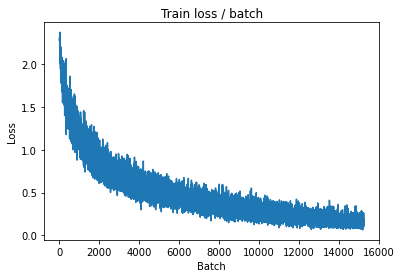

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 0.1484 (0.1474)	Prec@1  93.0 ( 95.1)	Prec@5 100.0 (100.0)


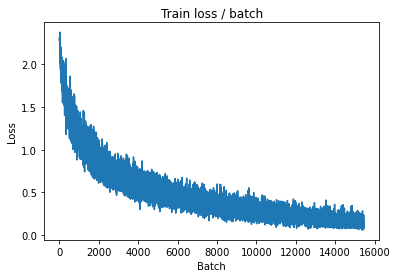


===============> Total time 7s	Avg loss 0.1488	Avg Prec@1 94.93 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.5681 (0.5681)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6425	Avg Prec@1 82.14 %	Avg Prec@5 98.76 %



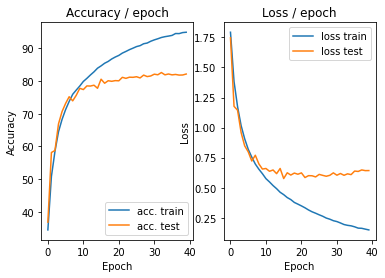

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.1244 (0.1244)	Prec@1  96.9 ( 96.9)	Prec@5  99.2 ( 99.2)


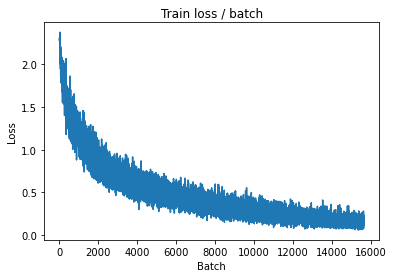

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.1576 (0.1380)	Prec@1  94.5 ( 95.4)	Prec@5 100.0 ( 99.9)


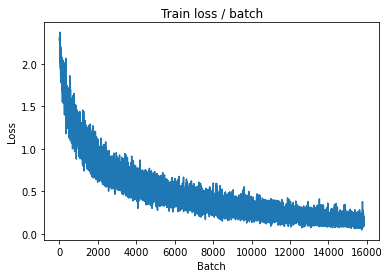


===============> Total time 7s	Avg loss 0.1394	Avg Prec@1 95.33 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.5252 (0.5252)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6573	Avg Prec@1 81.92 %	Avg Prec@5 98.81 %



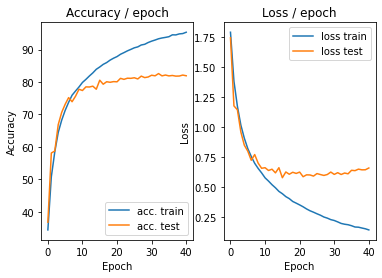

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.1119 (0.1119)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


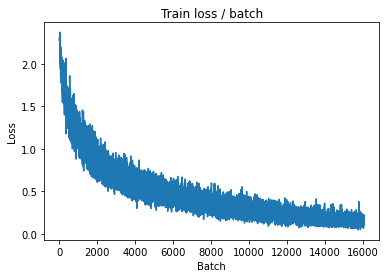

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.1568 (0.1350)	Prec@1  94.5 ( 95.5)	Prec@5 100.0 (100.0)


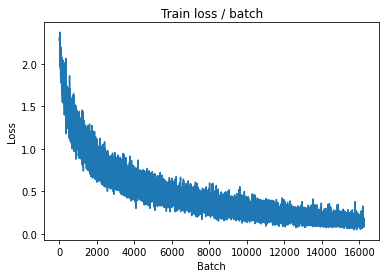


===============> Total time 7s	Avg loss 0.1360	Avg Prec@1 95.44 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.4771 (0.4771)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6555	Avg Prec@1 82.29 %	Avg Prec@5 98.94 %



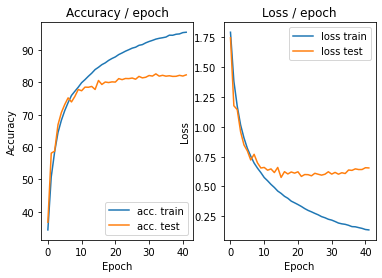

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.1178 (0.1178)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


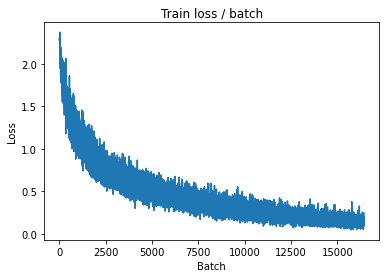

[TRAIN Batch 200/391]	Time 0.017s (0.019s)	Loss 0.1332 (0.1267)	Prec@1  96.1 ( 95.9)	Prec@5 100.0 (100.0)


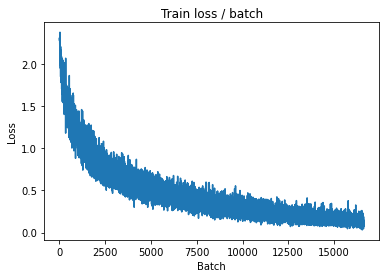


===============> Total time 7s	Avg loss 0.1319	Avg Prec@1 95.64 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.5505 (0.5505)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6818	Avg Prec@1 82.06 %	Avg Prec@5 98.85 %



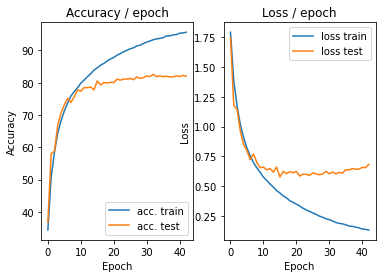

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.1324 (0.1324)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


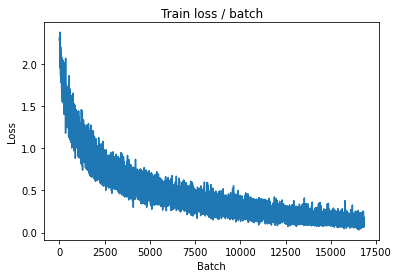

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.1294 (0.1269)	Prec@1  96.9 ( 95.8)	Prec@5 100.0 (100.0)


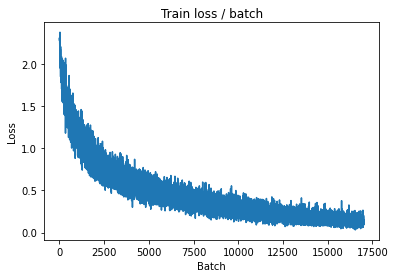


===============> Total time 7s	Avg loss 0.1270	Avg Prec@1 95.75 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.131s (0.131s)	Loss 0.5335 (0.5335)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6576	Avg Prec@1 82.04 %	Avg Prec@5 98.82 %



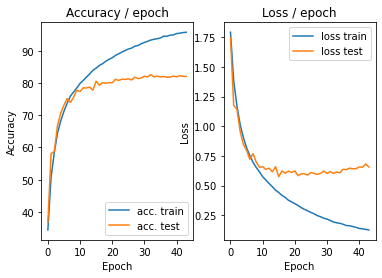

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.1576 (0.1576)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


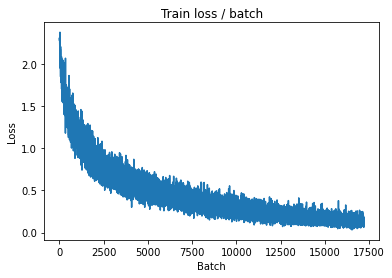

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.0598 (0.1194)	Prec@1  98.4 ( 96.1)	Prec@5 100.0 (100.0)


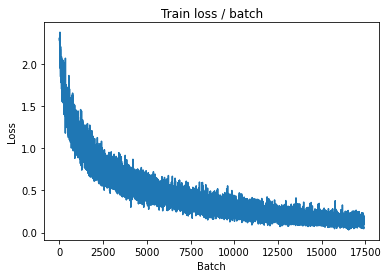


===============> Total time 7s	Avg loss 0.1225	Avg Prec@1 96.07 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.5385 (0.5385)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6693	Avg Prec@1 82.26 %	Avg Prec@5 98.89 %



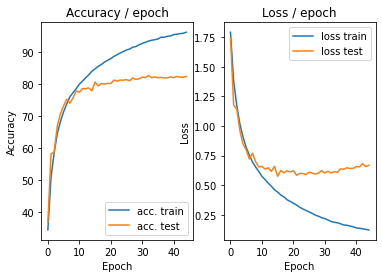

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.1022 (0.1022)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


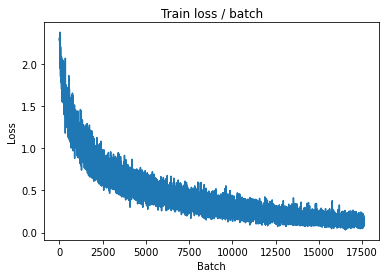

[TRAIN Batch 200/391]	Time 0.035s (0.021s)	Loss 0.1144 (0.1140)	Prec@1  96.9 ( 96.1)	Prec@5 100.0 (100.0)


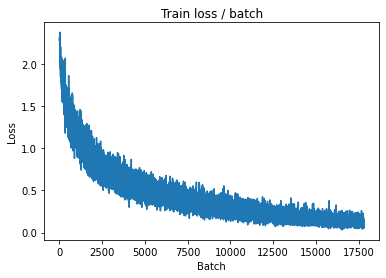


===============> Total time 8s	Avg loss 0.1153	Avg Prec@1 96.09 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 0.5739 (0.5739)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6778	Avg Prec@1 82.35 %	Avg Prec@5 98.75 %



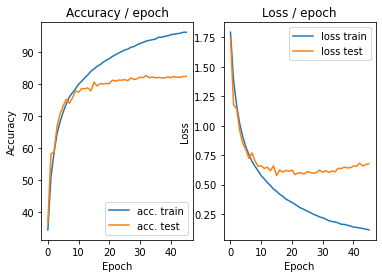

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.257s (0.257s)	Loss 0.1332 (0.1332)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


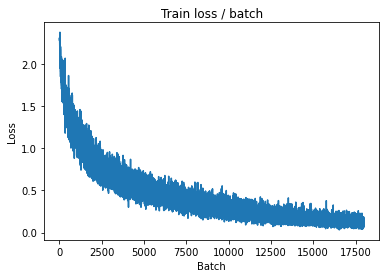

[TRAIN Batch 200/391]	Time 0.005s (0.020s)	Loss 0.0967 (0.1105)	Prec@1  96.9 ( 96.3)	Prec@5 100.0 (100.0)


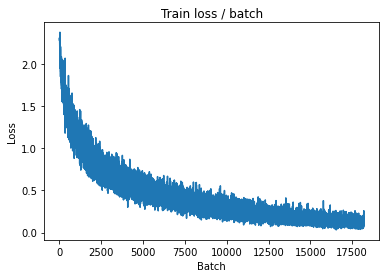


===============> Total time 7s	Avg loss 0.1150	Avg Prec@1 96.20 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.5168 (0.5168)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6717	Avg Prec@1 82.44 %	Avg Prec@5 98.94 %



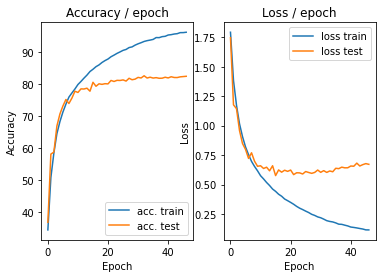

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.0838 (0.0838)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


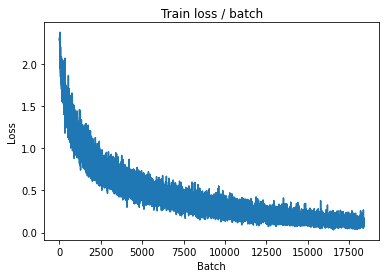

[TRAIN Batch 200/391]	Time 0.030s (0.021s)	Loss 0.0520 (0.1057)	Prec@1 100.0 ( 96.6)	Prec@5 100.0 (100.0)


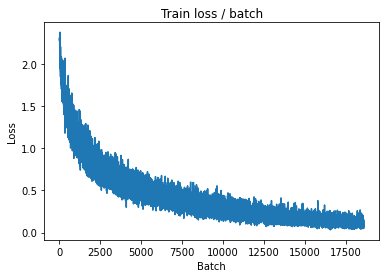


===============> Total time 7s	Avg loss 0.1077	Avg Prec@1 96.56 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.5669 (0.5669)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6794	Avg Prec@1 82.41 %	Avg Prec@5 98.85 %



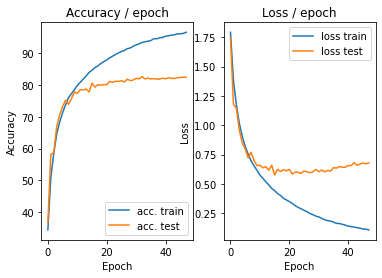

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.0513 (0.0513)	Prec@1 100.0 (100.0)	Prec@5 100.0 (100.0)


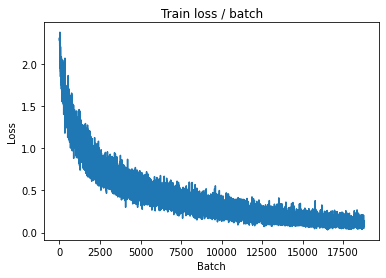

[TRAIN Batch 200/391]	Time 0.030s (0.021s)	Loss 0.1158 (0.1063)	Prec@1  96.9 ( 96.5)	Prec@5 100.0 (100.0)


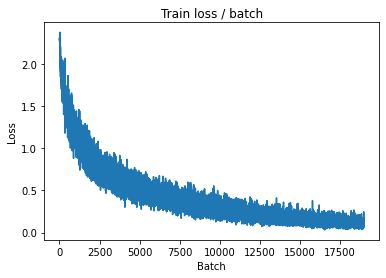


===============> Total time 7s	Avg loss 0.1096	Avg Prec@1 96.42 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.5685 (0.5685)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6843	Avg Prec@1 82.25 %	Avg Prec@5 98.89 %



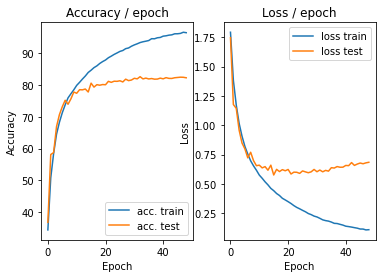

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.1638 (0.1638)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


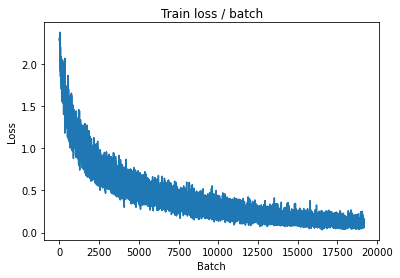

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.1384 (0.1030)	Prec@1  93.0 ( 96.7)	Prec@5 100.0 (100.0)


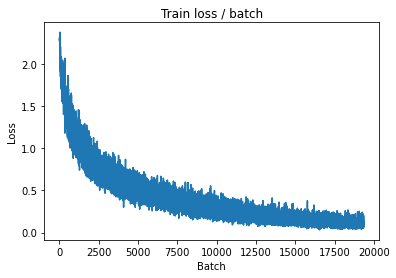


===============> Total time 7s	Avg loss 0.1043	Avg Prec@1 96.73 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.280s (0.280s)	Loss 0.5737 (0.5737)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6891	Avg Prec@1 82.45 %	Avg Prec@5 98.83 %



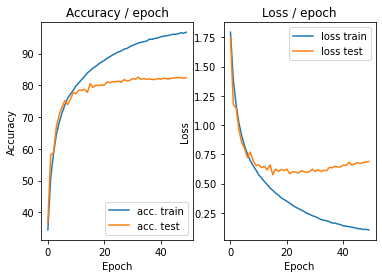

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.0988 (0.0988)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


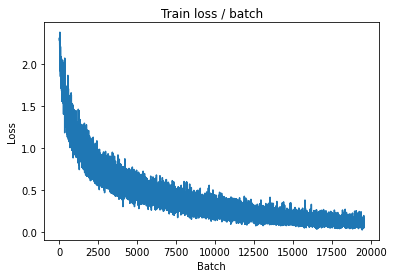

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 0.0961 (0.0982)	Prec@1  96.9 ( 96.8)	Prec@5 100.0 (100.0)


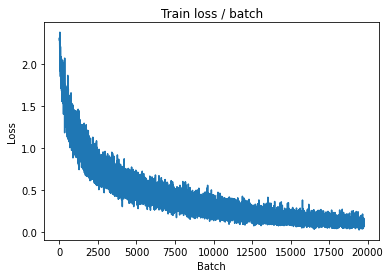


===============> Total time 7s	Avg loss 0.1007	Avg Prec@1 96.80 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.5386 (0.5386)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6932	Avg Prec@1 82.72 %	Avg Prec@5 98.86 %



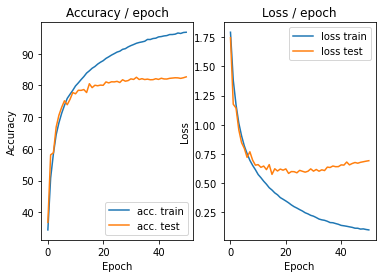

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.0377 (0.0377)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


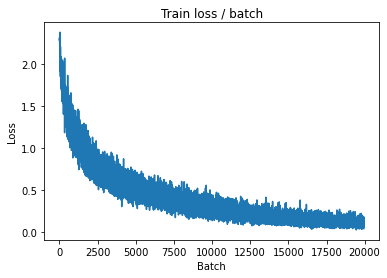

[TRAIN Batch 200/391]	Time 0.005s (0.020s)	Loss 0.0756 (0.0988)	Prec@1  99.2 ( 96.8)	Prec@5 100.0 (100.0)


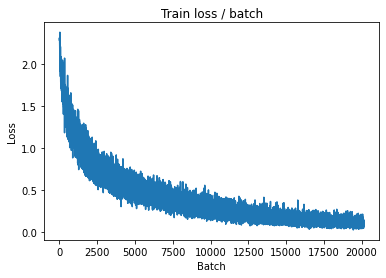


===============> Total time 7s	Avg loss 0.1005	Avg Prec@1 96.72 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.116s (0.116s)	Loss 0.5497 (0.5497)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6980	Avg Prec@1 82.54 %	Avg Prec@5 98.90 %



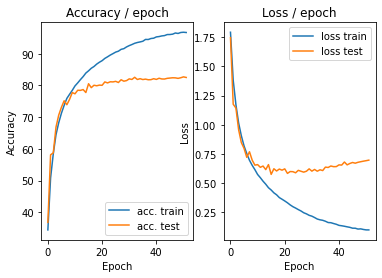

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.0778 (0.0778)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


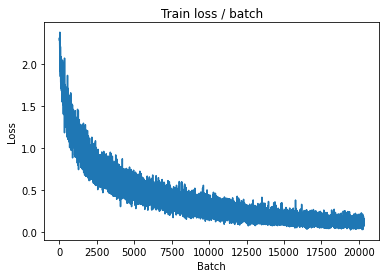

[TRAIN Batch 200/391]	Time 0.005s (0.020s)	Loss 0.1171 (0.0919)	Prec@1  96.9 ( 97.2)	Prec@5 100.0 ( 99.9)


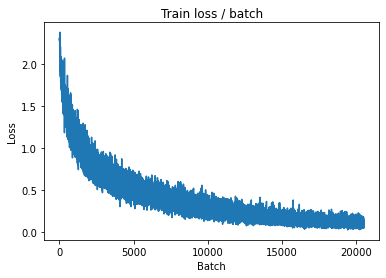


===============> Total time 7s	Avg loss 0.0928	Avg Prec@1 97.07 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.5681 (0.5681)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6978	Avg Prec@1 82.18 %	Avg Prec@5 98.85 %



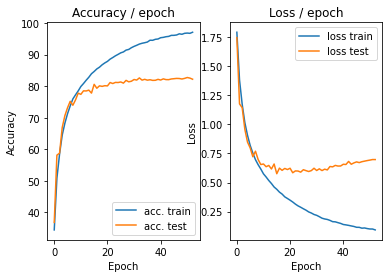

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.0837 (0.0837)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


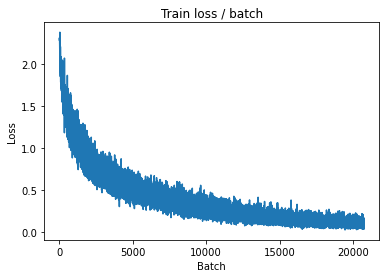

[TRAIN Batch 200/391]	Time 0.034s (0.020s)	Loss 0.0414 (0.0916)	Prec@1  99.2 ( 97.2)	Prec@5 100.0 (100.0)


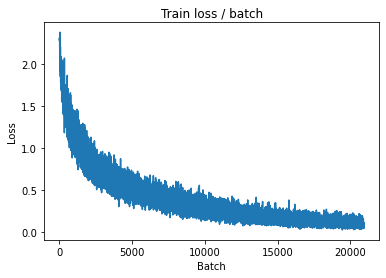


===============> Total time 7s	Avg loss 0.0941	Avg Prec@1 97.04 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.5412 (0.5412)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7064	Avg Prec@1 82.44 %	Avg Prec@5 98.86 %



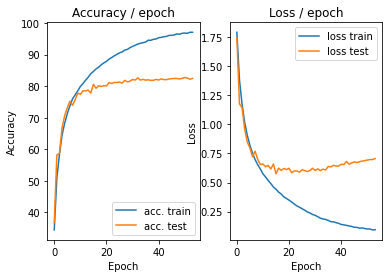

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.0775 (0.0775)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


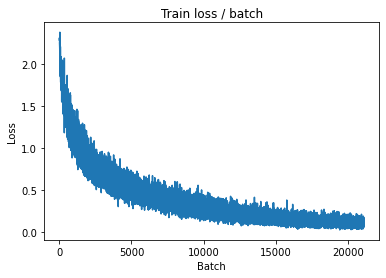

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1673 (0.0893)	Prec@1  94.5 ( 97.2)	Prec@5 100.0 (100.0)


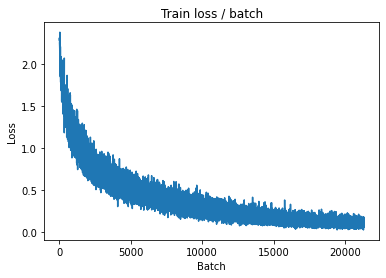


===============> Total time 7s	Avg loss 0.0900	Avg Prec@1 97.19 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5504 (0.5504)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7100	Avg Prec@1 82.34 %	Avg Prec@5 98.88 %



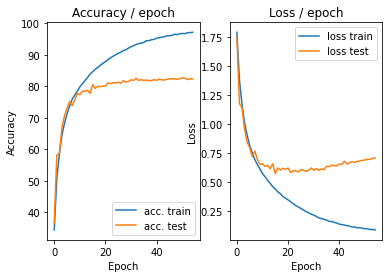

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0661 (0.0661)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


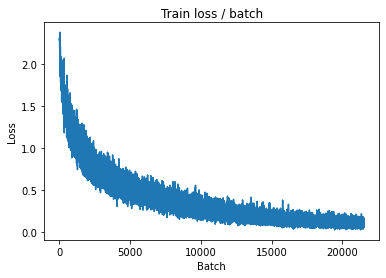

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.0826 (0.0867)	Prec@1  97.7 ( 97.4)	Prec@5 100.0 (100.0)


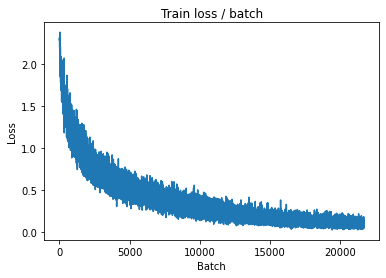


===============> Total time 7s	Avg loss 0.0898	Avg Prec@1 97.21 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.5483 (0.5483)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7031	Avg Prec@1 82.31 %	Avg Prec@5 98.93 %



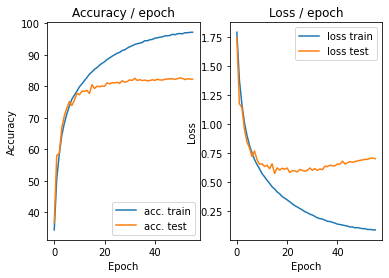

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.0681 (0.0681)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


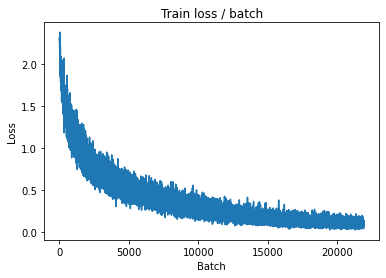

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.1345 (0.0836)	Prec@1  96.9 ( 97.3)	Prec@5 100.0 (100.0)


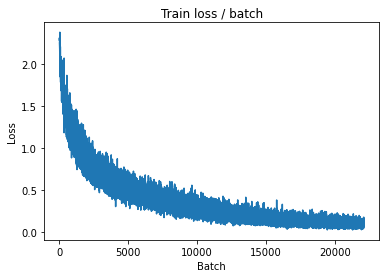


===============> Total time 7s	Avg loss 0.0860	Avg Prec@1 97.31 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 0.5422 (0.5422)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7110	Avg Prec@1 82.16 %	Avg Prec@5 98.84 %



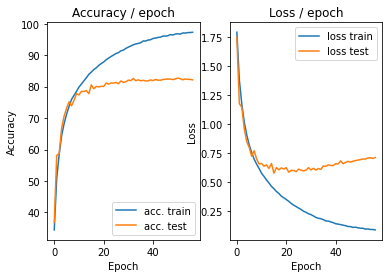

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.0814 (0.0814)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


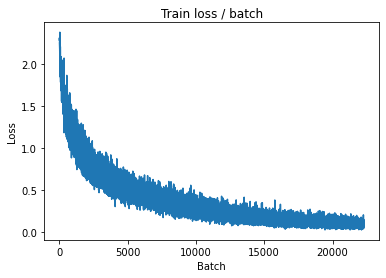

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.0700 (0.0843)	Prec@1  97.7 ( 97.4)	Prec@5 100.0 (100.0)


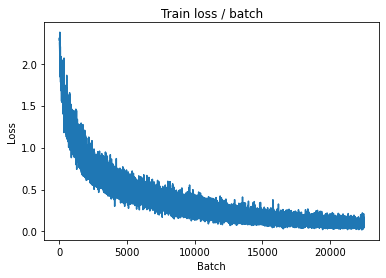


===============> Total time 7s	Avg loss 0.0866	Avg Prec@1 97.28 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.5602 (0.5602)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7044	Avg Prec@1 82.31 %	Avg Prec@5 98.84 %



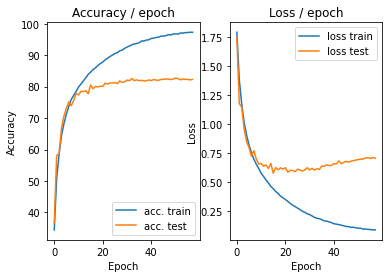

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.1104 (0.1104)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


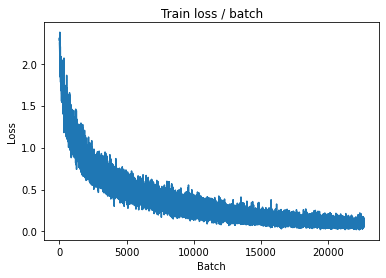

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.0397 (0.0802)	Prec@1  99.2 ( 97.5)	Prec@5 100.0 (100.0)


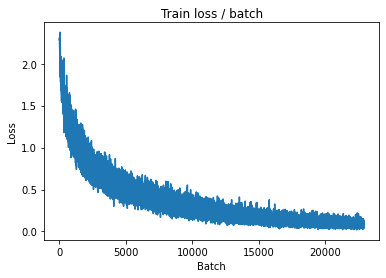


===============> Total time 7s	Avg loss 0.0816	Avg Prec@1 97.42 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.5979 (0.5979)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7147	Avg Prec@1 82.38 %	Avg Prec@5 98.83 %



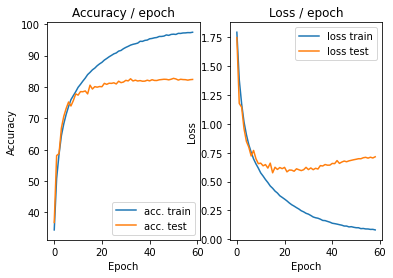

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.0959 (0.0959)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


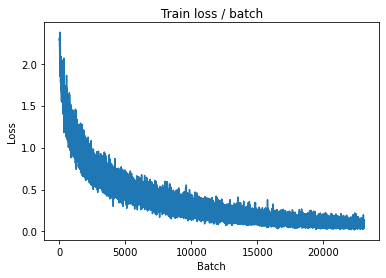

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1165 (0.0805)	Prec@1  96.1 ( 97.5)	Prec@5 100.0 (100.0)


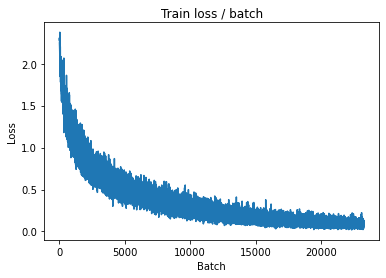


===============> Total time 7s	Avg loss 0.0815	Avg Prec@1 97.44 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.5733 (0.5733)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7146	Avg Prec@1 82.40 %	Avg Prec@5 98.87 %



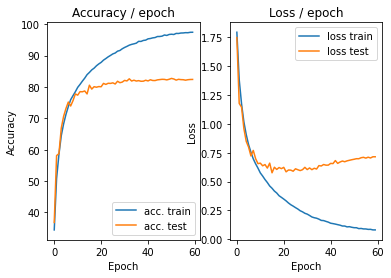

In [19]:
main(128, 0.1,60, cuda=True)

### lr_sched +momentum + Nesterov

In [30]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0,ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,                      
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(p=0.5)
        ]))
    
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr,momentum=0.9)
    lr_sched = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=200)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        #update lr_sched
        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 2.3058 (2.3058)	Prec@1   7.8 (  7.8)	Prec@5  48.4 ( 48.4)


<Figure size 432x288 with 0 Axes>

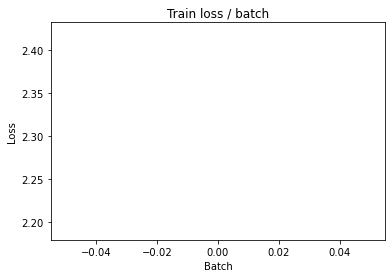

[TRAIN Batch 200/391]	Time 0.031s (0.019s)	Loss 1.8743 (1.9809)	Prec@1  29.7 ( 26.4)	Prec@5  86.7 ( 79.5)


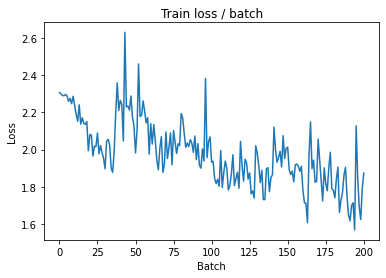


===============> Total time 7s	Avg loss 1.8756	Avg Prec@1 30.77 %	Avg Prec@5 83.18 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.7470 (1.7470)	Prec@1  32.0 ( 32.0)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.7882	Avg Prec@1 33.19 %	Avg Prec@5 86.19 %



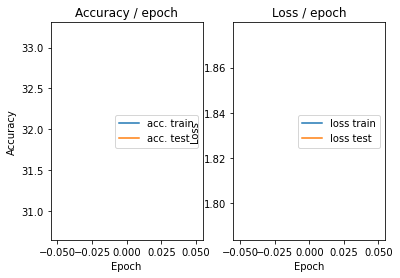

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 1.8390 (1.8390)	Prec@1  29.7 ( 29.7)	Prec@5  83.6 ( 83.6)


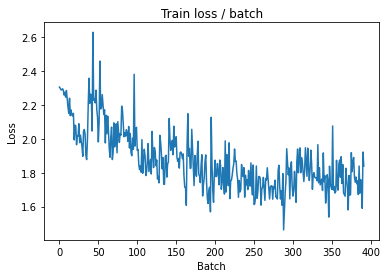

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 1.6832 (1.6778)	Prec@1  41.4 ( 38.8)	Prec@5  92.2 ( 88.6)


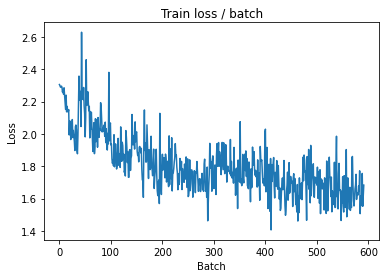


===============> Total time 7s	Avg loss 1.6625	Avg Prec@1 39.61 %	Avg Prec@5 88.73 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 1.5117 (1.5117)	Prec@1  49.2 ( 49.2)	Prec@5  93.8 ( 93.8)

===============> Total time 1s	Avg loss 1.5228	Avg Prec@1 45.18 %	Avg Prec@5 91.11 %



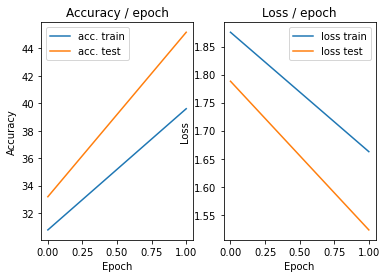

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 1.6485 (1.6485)	Prec@1  43.0 ( 43.0)	Prec@5  85.2 ( 85.2)


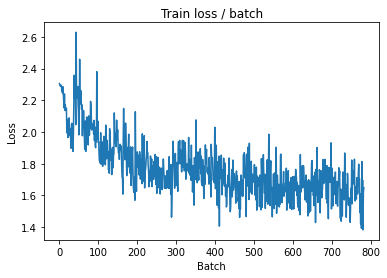

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.7661 (1.6265)	Prec@1  43.0 ( 41.7)	Prec@5  83.6 ( 89.0)


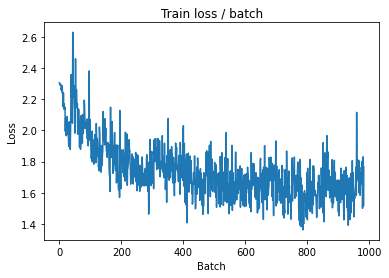


===============> Total time 7s	Avg loss 1.6342	Avg Prec@1 41.61 %	Avg Prec@5 88.97 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.6783 (1.6783)	Prec@1  38.3 ( 38.3)	Prec@5  85.9 ( 85.9)

===============> Total time 1s	Avg loss 1.6021	Avg Prec@1 43.42 %	Avg Prec@5 90.53 %



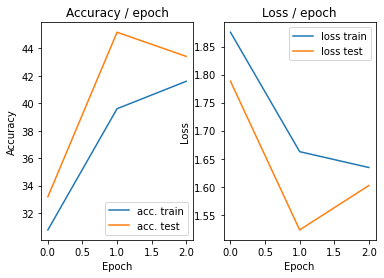

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.289s (0.289s)	Loss 1.8582 (1.8582)	Prec@1  37.5 ( 37.5)	Prec@5  88.3 ( 88.3)


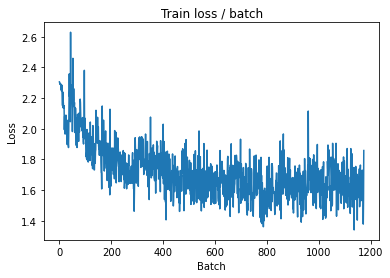

[TRAIN Batch 200/391]	Time 0.029s (0.021s)	Loss 1.5001 (1.5954)	Prec@1  45.3 ( 43.4)	Prec@5  86.7 ( 89.7)


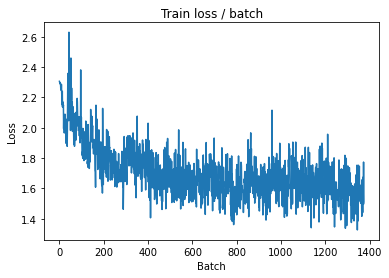


===============> Total time 7s	Avg loss 1.5727	Avg Prec@1 44.22 %	Avg Prec@5 90.08 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.5467 (1.5467)	Prec@1  45.3 ( 45.3)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5060	Avg Prec@1 47.07 %	Avg Prec@5 90.89 %



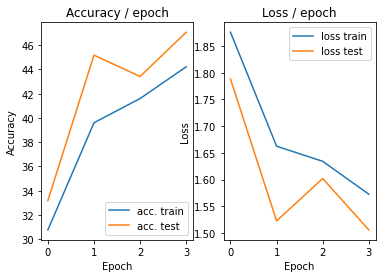

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.3365 (1.3365)	Prec@1  50.0 ( 50.0)	Prec@5  89.1 ( 89.1)


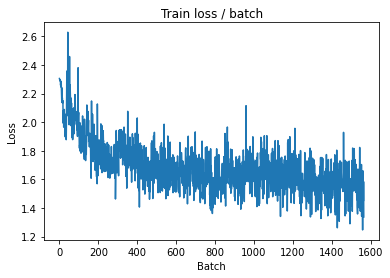

[TRAIN Batch 200/391]	Time 0.037s (0.022s)	Loss 1.5045 (1.5459)	Prec@1  43.8 ( 45.8)	Prec@5  89.8 ( 90.1)


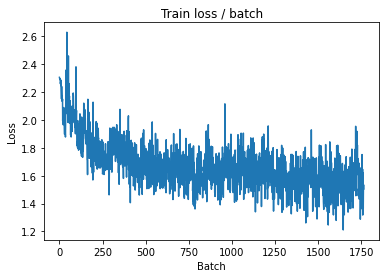


===============> Total time 8s	Avg loss 1.5518	Avg Prec@1 45.47 %	Avg Prec@5 90.13 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.6712 (1.6712)	Prec@1  39.1 ( 39.1)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.5834	Avg Prec@1 44.34 %	Avg Prec@5 88.86 %



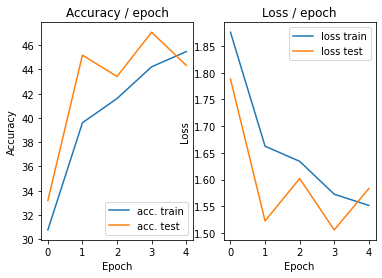

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.6193 (1.6193)	Prec@1  43.0 ( 43.0)	Prec@5  88.3 ( 88.3)


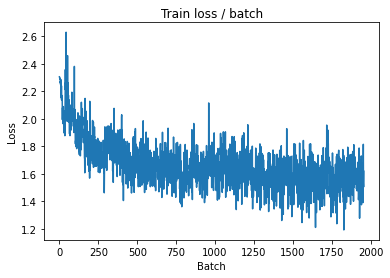

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 1.5645 (1.5564)	Prec@1  46.1 ( 45.7)	Prec@5  89.8 ( 90.0)


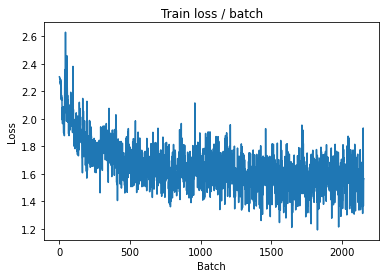


===============> Total time 8s	Avg loss 1.5543	Avg Prec@1 45.75 %	Avg Prec@5 90.02 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.6341 (1.6341)	Prec@1  43.0 ( 43.0)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5534	Avg Prec@1 46.44 %	Avg Prec@5 90.23 %



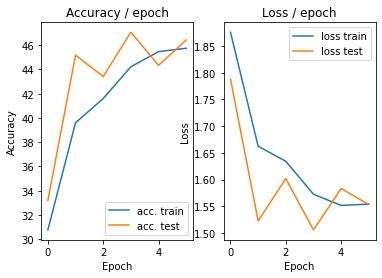

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.5921 (1.5921)	Prec@1  41.4 ( 41.4)	Prec@5  89.1 ( 89.1)


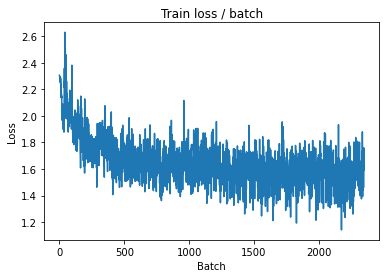

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 1.6271 (1.5604)	Prec@1  47.7 ( 45.7)	Prec@5  82.0 ( 89.8)


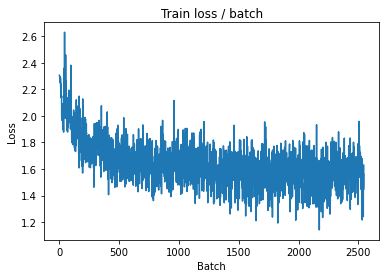


===============> Total time 7s	Avg loss 1.5562	Avg Prec@1 46.05 %	Avg Prec@5 89.70 %

[EVAL Batch 000/079]	Time 0.272s (0.272s)	Loss 1.4879 (1.4879)	Prec@1  49.2 ( 49.2)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5999	Avg Prec@1 44.48 %	Avg Prec@5 88.51 %



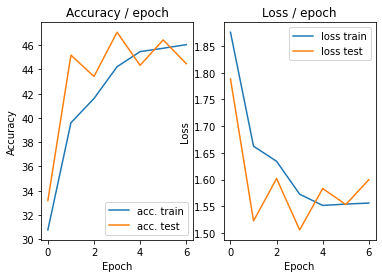

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 1.9453 (1.9453)	Prec@1  35.2 ( 35.2)	Prec@5  88.3 ( 88.3)


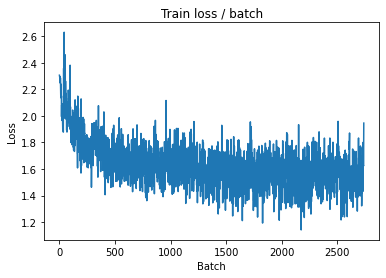

[TRAIN Batch 200/391]	Time 0.032s (0.022s)	Loss 1.3489 (1.5632)	Prec@1  48.4 ( 45.9)	Prec@5  91.4 ( 89.7)


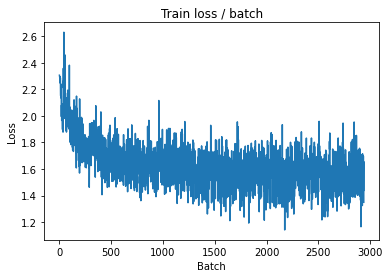


===============> Total time 7s	Avg loss 1.5730	Avg Prec@1 45.45 %	Avg Prec@5 89.42 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 1.5615 (1.5615)	Prec@1  48.4 ( 48.4)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5310	Avg Prec@1 45.28 %	Avg Prec@5 90.85 %



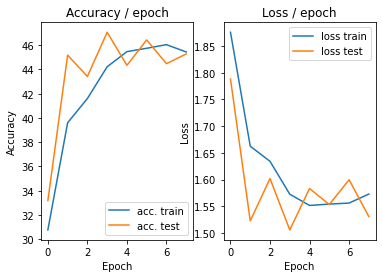

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 1.4278 (1.4278)	Prec@1  48.4 ( 48.4)	Prec@5  93.8 ( 93.8)


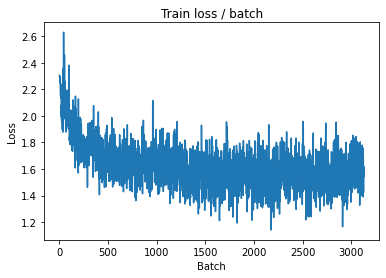

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.6982 (1.5849)	Prec@1  40.6 ( 45.4)	Prec@5  90.6 ( 89.2)


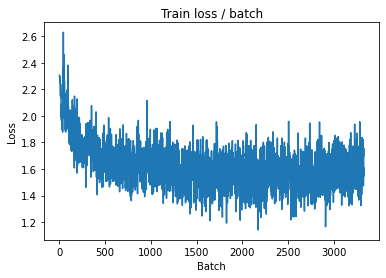


===============> Total time 7s	Avg loss 1.5841	Avg Prec@1 45.41 %	Avg Prec@5 89.19 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.5228 (1.5228)	Prec@1  46.9 ( 46.9)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.6278	Avg Prec@1 43.21 %	Avg Prec@5 89.26 %



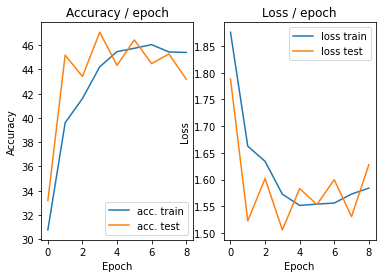

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.5070 (1.5070)	Prec@1  43.8 ( 43.8)	Prec@5  89.1 ( 89.1)


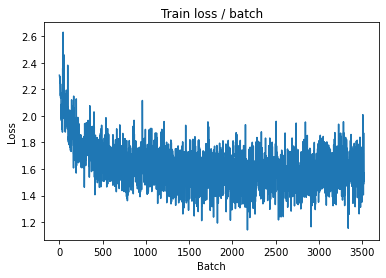

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.7726 (1.5604)	Prec@1  39.1 ( 46.1)	Prec@5  85.2 ( 89.6)


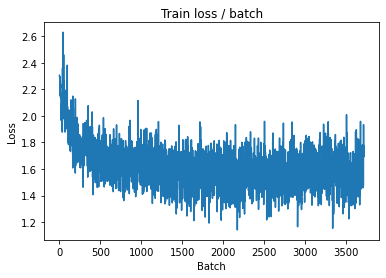


===============> Total time 7s	Avg loss 1.5731	Avg Prec@1 45.53 %	Avg Prec@5 89.43 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.4956 (1.4956)	Prec@1  51.6 ( 51.6)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.6245	Avg Prec@1 46.26 %	Avg Prec@5 89.89 %



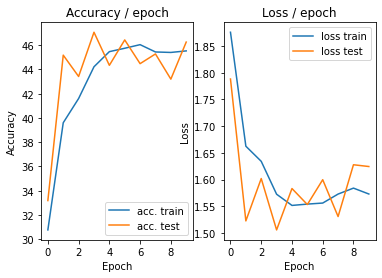

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.5266 (1.5266)	Prec@1  49.2 ( 49.2)	Prec@5  86.7 ( 86.7)


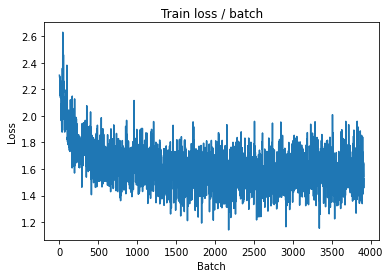

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 1.6007 (1.5744)	Prec@1  44.5 ( 45.9)	Prec@5  90.6 ( 89.0)


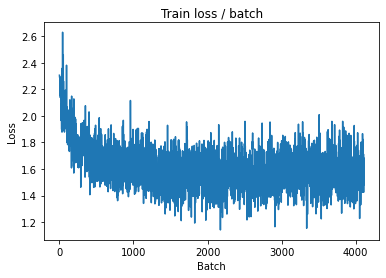


===============> Total time 7s	Avg loss 1.6002	Avg Prec@1 44.87 %	Avg Prec@5 88.61 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.5567 (1.5567)	Prec@1  43.0 ( 43.0)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.5599	Avg Prec@1 45.07 %	Avg Prec@5 89.12 %



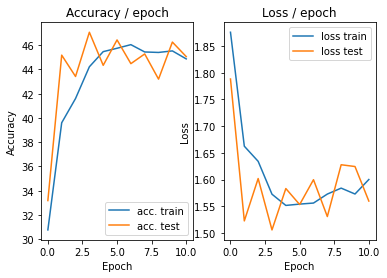

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.6708 (1.6708)	Prec@1  38.3 ( 38.3)	Prec@5  86.7 ( 86.7)


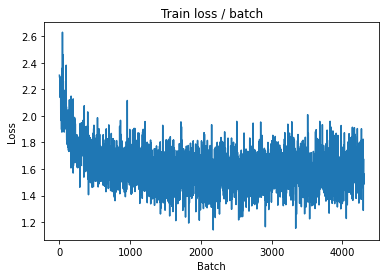

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.6560 (1.5815)	Prec@1  35.9 ( 45.3)	Prec@5  87.5 ( 89.3)


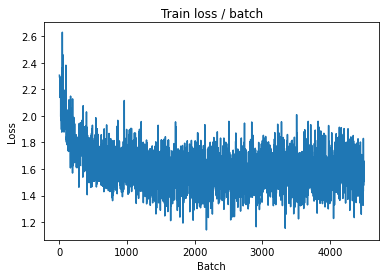


===============> Total time 7s	Avg loss 1.5884	Avg Prec@1 45.39 %	Avg Prec@5 89.21 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.6468 (1.6468)	Prec@1  44.5 ( 44.5)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.6987	Avg Prec@1 41.11 %	Avg Prec@5 86.31 %



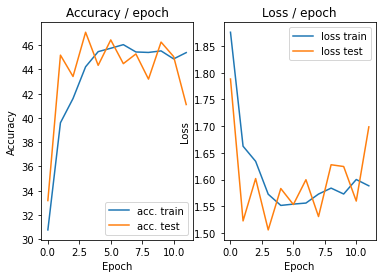

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.6017 (1.6017)	Prec@1  43.8 ( 43.8)	Prec@5  87.5 ( 87.5)


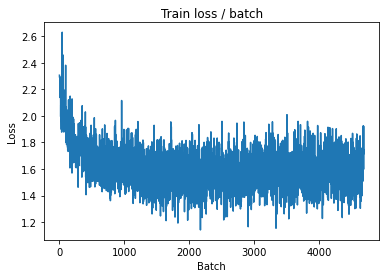

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.7818 (1.6091)	Prec@1  35.2 ( 44.5)	Prec@5  89.8 ( 88.6)


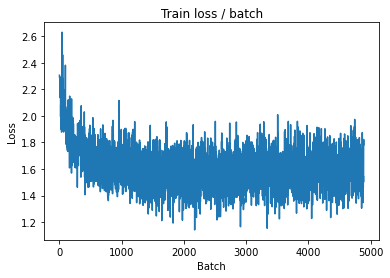


===============> Total time 8s	Avg loss 1.6081	Avg Prec@1 44.53 %	Avg Prec@5 88.64 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 1.4732 (1.4732)	Prec@1  43.0 ( 43.0)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.5293	Avg Prec@1 45.12 %	Avg Prec@5 90.45 %



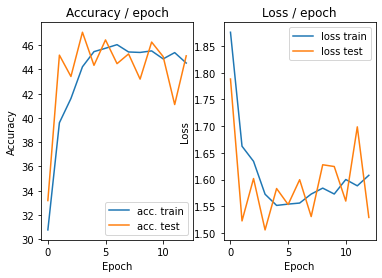

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 1.4711 (1.4711)	Prec@1  43.8 ( 43.8)	Prec@5  92.2 ( 92.2)


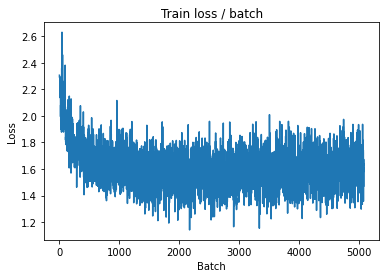

[TRAIN Batch 200/391]	Time 0.023s (0.019s)	Loss 1.6091 (1.5720)	Prec@1  43.0 ( 46.0)	Prec@5  86.7 ( 89.5)


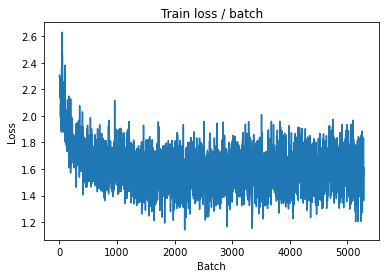


===============> Total time 7s	Avg loss 1.5866	Avg Prec@1 45.60 %	Avg Prec@5 89.14 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.4488 (1.4488)	Prec@1  47.7 ( 47.7)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5615	Avg Prec@1 44.23 %	Avg Prec@5 89.07 %



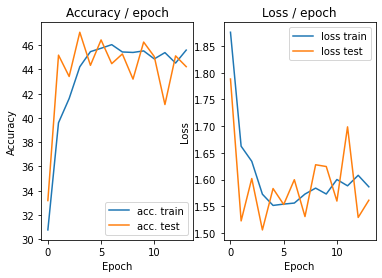

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 1.5561 (1.5561)	Prec@1  43.0 ( 43.0)	Prec@5  90.6 ( 90.6)


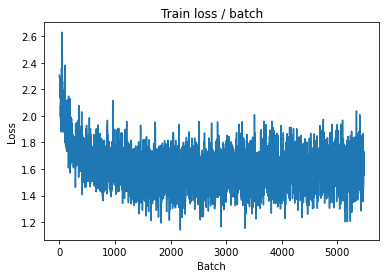

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 1.6562 (1.5867)	Prec@1  40.6 ( 45.3)	Prec@5  88.3 ( 89.2)


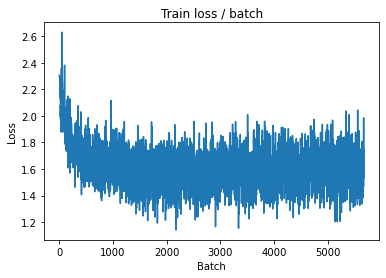


===============> Total time 7s	Avg loss 1.5786	Avg Prec@1 45.53 %	Avg Prec@5 89.30 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.4923 (1.4923)	Prec@1  50.0 ( 50.0)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.5431	Avg Prec@1 47.40 %	Avg Prec@5 90.14 %



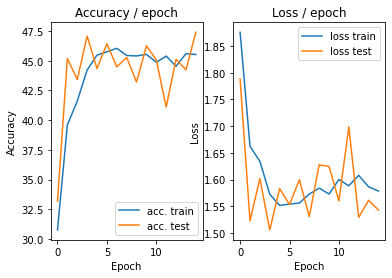

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 1.5449 (1.5449)	Prec@1  43.8 ( 43.8)	Prec@5  90.6 ( 90.6)


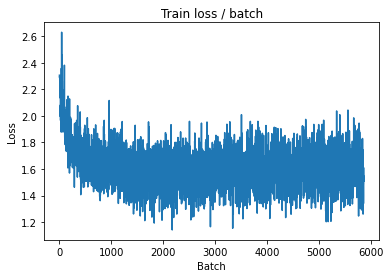

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 1.6149 (1.5858)	Prec@1  41.4 ( 45.9)	Prec@5  89.1 ( 88.4)


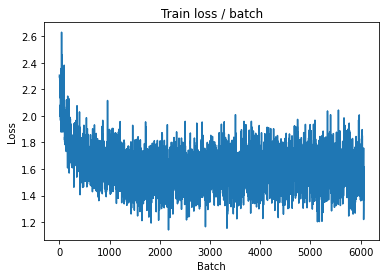


===============> Total time 7s	Avg loss 1.5791	Avg Prec@1 45.87 %	Avg Prec@5 88.83 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.5422 (1.5422)	Prec@1  46.9 ( 46.9)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.5226	Avg Prec@1 50.21 %	Avg Prec@5 90.89 %



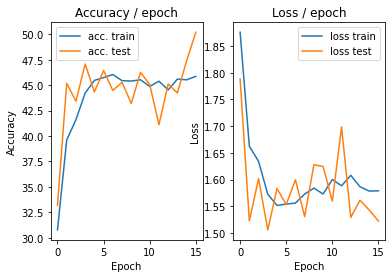

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.5839 (1.5839)	Prec@1  51.6 ( 51.6)	Prec@5  88.3 ( 88.3)


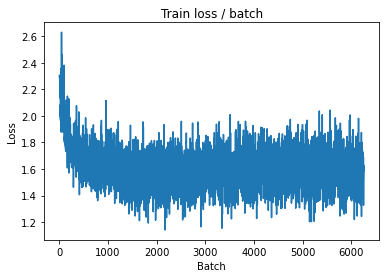

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 1.7549 (1.5817)	Prec@1  38.3 ( 46.2)	Prec@5  85.9 ( 89.0)


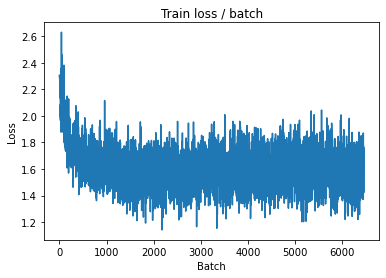


===============> Total time 7s	Avg loss 1.5936	Avg Prec@1 45.61 %	Avg Prec@5 88.86 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.4943 (1.4943)	Prec@1  52.3 ( 52.3)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5759	Avg Prec@1 46.45 %	Avg Prec@5 89.25 %



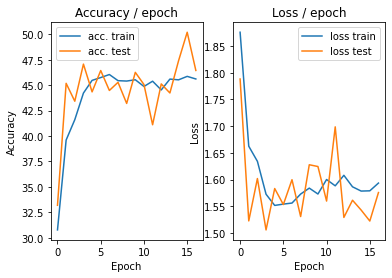

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 1.4764 (1.4764)	Prec@1  45.3 ( 45.3)	Prec@5  88.3 ( 88.3)


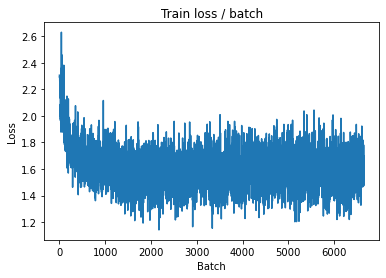

[TRAIN Batch 200/391]	Time 0.017s (0.019s)	Loss 1.4410 (1.5734)	Prec@1  48.4 ( 46.6)	Prec@5  89.1 ( 89.1)


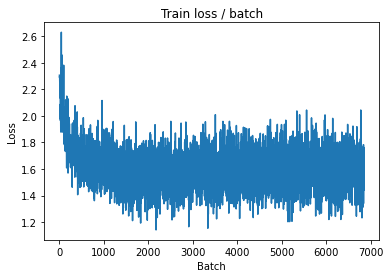


===============> Total time 7s	Avg loss 1.5793	Avg Prec@1 46.07 %	Avg Prec@5 89.01 %

[EVAL Batch 000/079]	Time 0.262s (0.262s)	Loss 1.7229 (1.7229)	Prec@1  42.2 ( 42.2)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.6612	Avg Prec@1 42.72 %	Avg Prec@5 88.51 %



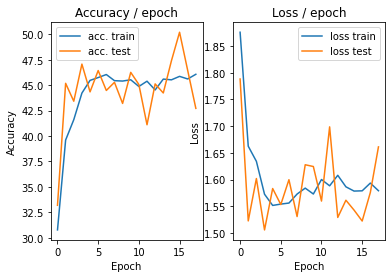

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 1.7503 (1.7503)	Prec@1  36.7 ( 36.7)	Prec@5  85.9 ( 85.9)


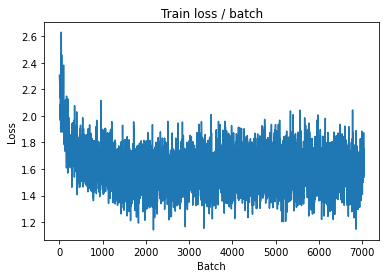

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.3877 (1.5666)	Prec@1  50.0 ( 46.2)	Prec@5  89.1 ( 89.2)


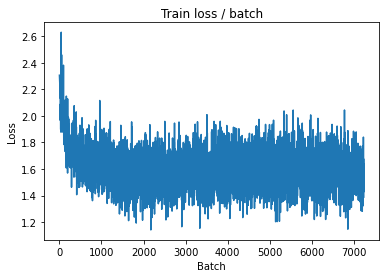


===============> Total time 7s	Avg loss 1.5678	Avg Prec@1 46.19 %	Avg Prec@5 89.13 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.6273 (1.6273)	Prec@1  46.1 ( 46.1)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.5296	Avg Prec@1 47.12 %	Avg Prec@5 89.75 %



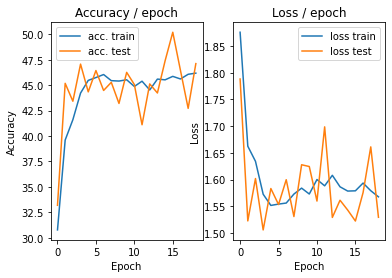

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.120s (0.120s)	Loss 1.5638 (1.5638)	Prec@1  52.3 ( 52.3)	Prec@5  95.3 ( 95.3)


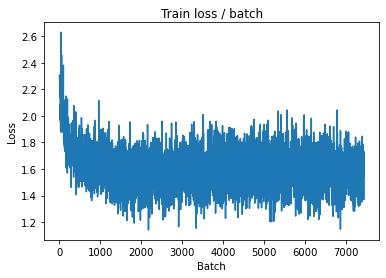

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.5782 (1.5667)	Prec@1  43.8 ( 46.5)	Prec@5  90.6 ( 88.9)


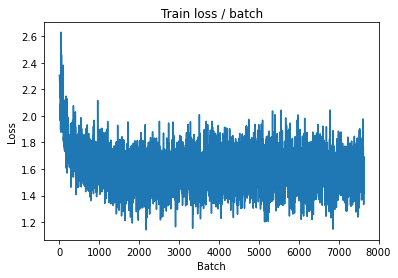


===============> Total time 7s	Avg loss 1.5760	Avg Prec@1 46.19 %	Avg Prec@5 88.98 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 1.4778 (1.4778)	Prec@1  49.2 ( 49.2)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.6107	Avg Prec@1 44.08 %	Avg Prec@5 89.00 %



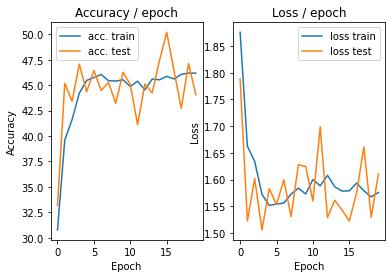

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.7198 (1.7198)	Prec@1  40.6 ( 40.6)	Prec@5  86.7 ( 86.7)


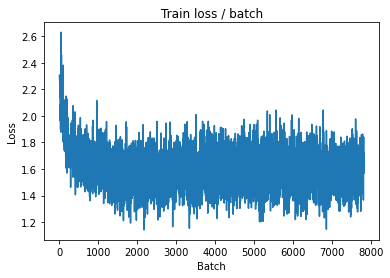

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 1.2648 (1.5847)	Prec@1  55.5 ( 45.4)	Prec@5  90.6 ( 88.6)


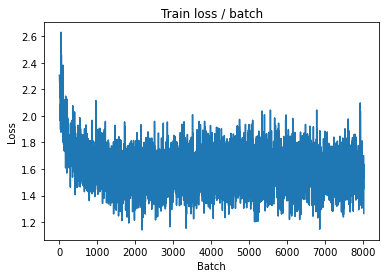


===============> Total time 7s	Avg loss 1.5803	Avg Prec@1 45.91 %	Avg Prec@5 88.89 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.6418 (1.6418)	Prec@1  43.8 ( 43.8)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5678	Avg Prec@1 47.98 %	Avg Prec@5 89.97 %



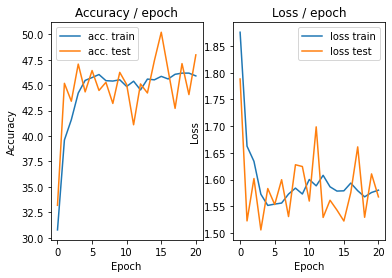

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 1.6809 (1.6809)	Prec@1  44.5 ( 44.5)	Prec@5  91.4 ( 91.4)


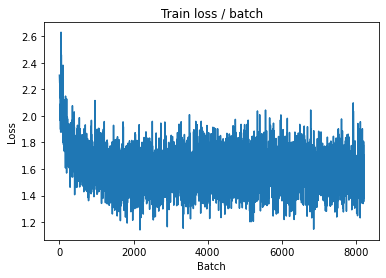

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 1.6294 (1.5852)	Prec@1  38.3 ( 45.9)	Prec@5  88.3 ( 88.8)


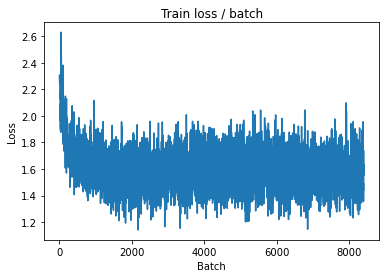


===============> Total time 7s	Avg loss 1.5671	Avg Prec@1 46.39 %	Avg Prec@5 88.98 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.5940 (1.5940)	Prec@1  43.0 ( 43.0)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.4859	Avg Prec@1 49.01 %	Avg Prec@5 90.38 %



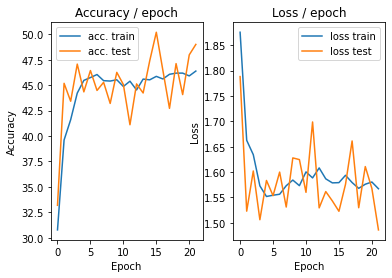

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.4719 (1.4719)	Prec@1  46.1 ( 46.1)	Prec@5  93.8 ( 93.8)


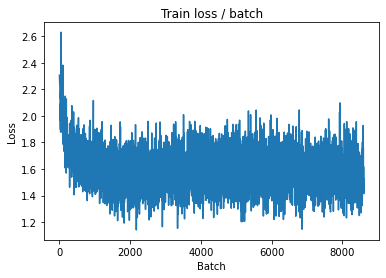

[TRAIN Batch 200/391]	Time 0.031s (0.020s)	Loss 1.7041 (1.6301)	Prec@1  39.8 ( 44.7)	Prec@5  82.8 ( 88.0)


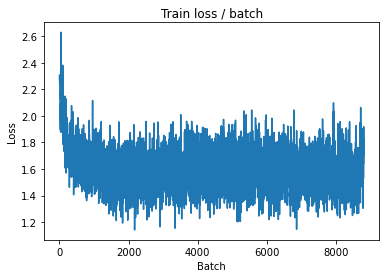


===============> Total time 7s	Avg loss 1.6163	Avg Prec@1 45.28 %	Avg Prec@5 88.31 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.5984 (1.5984)	Prec@1  45.3 ( 45.3)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.5521	Avg Prec@1 47.98 %	Avg Prec@5 88.70 %



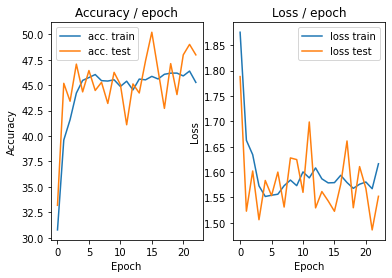

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 1.4281 (1.4281)	Prec@1  50.0 ( 50.0)	Prec@5  92.2 ( 92.2)


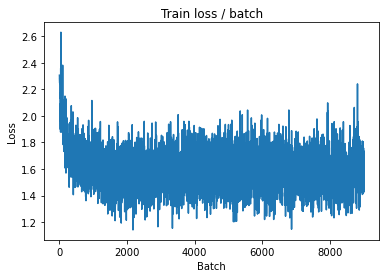

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.6301 (1.5844)	Prec@1  43.8 ( 45.9)	Prec@5  84.4 ( 88.5)


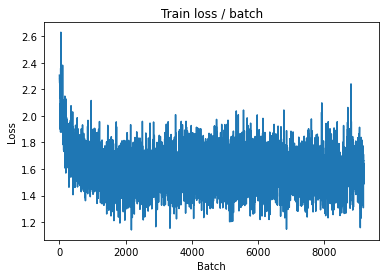


===============> Total time 7s	Avg loss 1.5661	Avg Prec@1 46.67 %	Avg Prec@5 88.86 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.6442 (1.6442)	Prec@1  47.7 ( 47.7)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5898	Avg Prec@1 44.99 %	Avg Prec@5 88.00 %



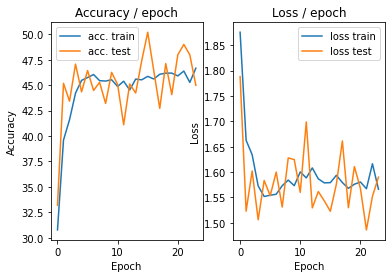

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.5039 (1.5039)	Prec@1  43.0 ( 43.0)	Prec@5  89.8 ( 89.8)


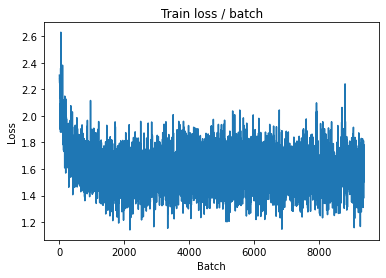

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 1.4103 (1.5537)	Prec@1  47.7 ( 47.0)	Prec@5  90.6 ( 89.0)


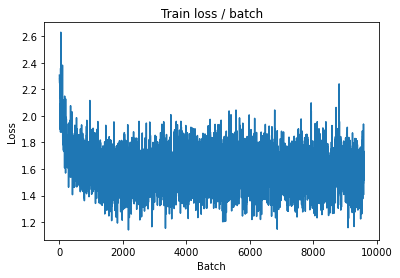


===============> Total time 7s	Avg loss 1.5497	Avg Prec@1 47.27 %	Avg Prec@5 89.25 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.7586 (1.7586)	Prec@1  41.4 ( 41.4)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.6280	Avg Prec@1 44.85 %	Avg Prec@5 86.95 %



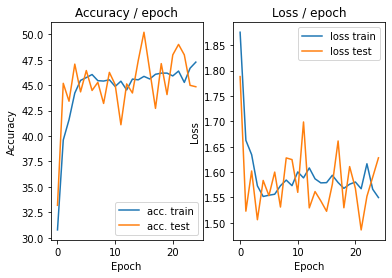

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 1.4736 (1.4736)	Prec@1  45.3 ( 45.3)	Prec@5  91.4 ( 91.4)


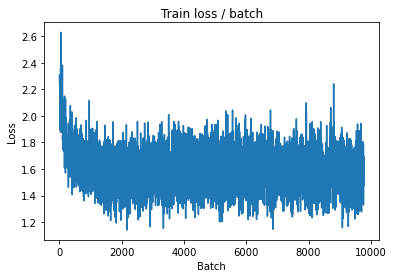

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 1.6370 (1.5778)	Prec@1  48.4 ( 46.6)	Prec@5  89.1 ( 88.8)


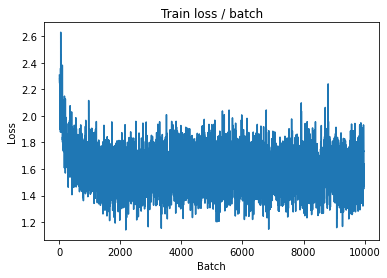


===============> Total time 7s	Avg loss 1.5666	Avg Prec@1 46.89 %	Avg Prec@5 88.92 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.5067 (1.5067)	Prec@1  51.6 ( 51.6)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5262	Avg Prec@1 48.22 %	Avg Prec@5 89.97 %



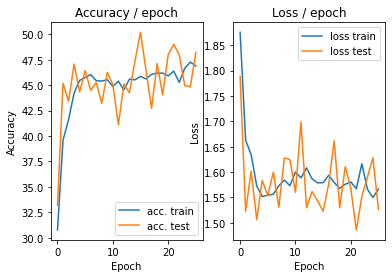

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 1.4057 (1.4057)	Prec@1  50.8 ( 50.8)	Prec@5  94.5 ( 94.5)


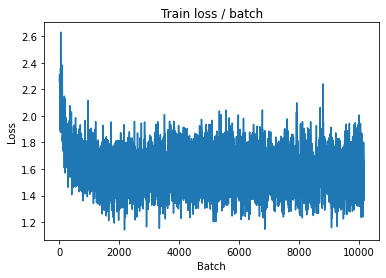

[TRAIN Batch 200/391]	Time 0.006s (0.023s)	Loss 1.6884 (1.5423)	Prec@1  43.8 ( 48.2)	Prec@5  84.4 ( 89.5)


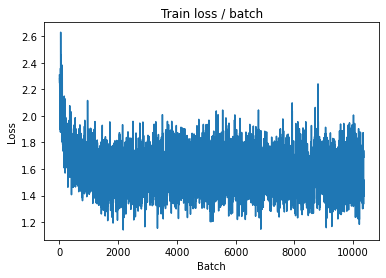


===============> Total time 8s	Avg loss 1.5408	Avg Prec@1 48.20 %	Avg Prec@5 89.25 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.6352 (1.6352)	Prec@1  44.5 ( 44.5)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5922	Avg Prec@1 44.93 %	Avg Prec@5 89.20 %



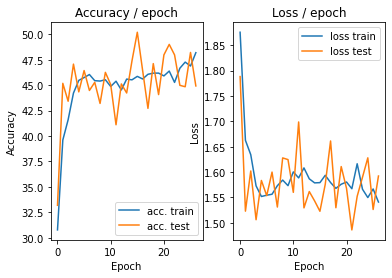

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.5174 (1.5174)	Prec@1  44.5 ( 44.5)	Prec@5  86.7 ( 86.7)


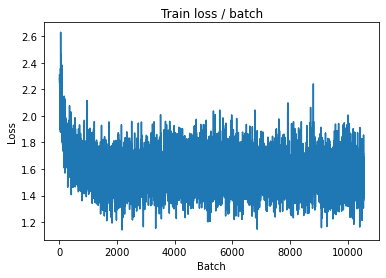

[TRAIN Batch 200/391]	Time 0.031s (0.020s)	Loss 1.2928 (1.5478)	Prec@1  57.8 ( 47.6)	Prec@5  93.0 ( 89.2)


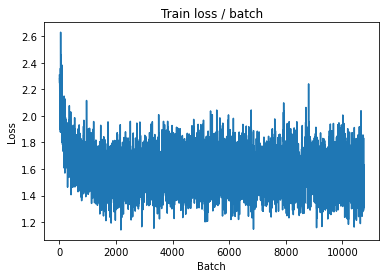


===============> Total time 7s	Avg loss 1.5594	Avg Prec@1 47.06 %	Avg Prec@5 89.01 %

[EVAL Batch 000/079]	Time 0.133s (0.133s)	Loss 1.5504 (1.5504)	Prec@1  43.0 ( 43.0)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.4935	Avg Prec@1 46.88 %	Avg Prec@5 90.40 %



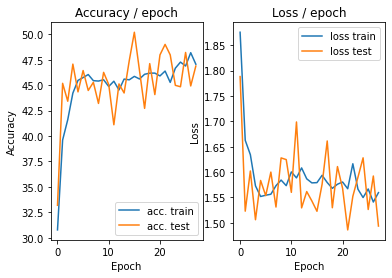

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.4436 (1.4436)	Prec@1  50.0 ( 50.0)	Prec@5  93.0 ( 93.0)


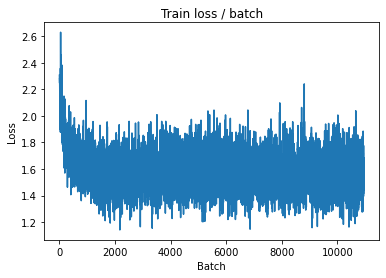

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.4940 (1.5253)	Prec@1  48.4 ( 47.9)	Prec@5  92.2 ( 89.4)


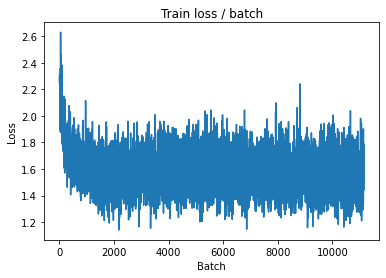


===============> Total time 7s	Avg loss 1.5349	Avg Prec@1 47.84 %	Avg Prec@5 89.37 %

[EVAL Batch 000/079]	Time 0.263s (0.263s)	Loss 1.7691 (1.7691)	Prec@1  39.1 ( 39.1)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.6230	Avg Prec@1 44.91 %	Avg Prec@5 89.01 %



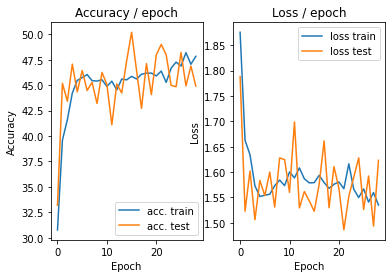

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.7901 (1.7901)	Prec@1  45.3 ( 45.3)	Prec@5  86.7 ( 86.7)


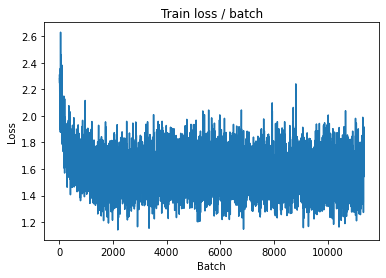

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 1.9514 (1.5478)	Prec@1  34.4 ( 47.7)	Prec@5  90.6 ( 89.1)


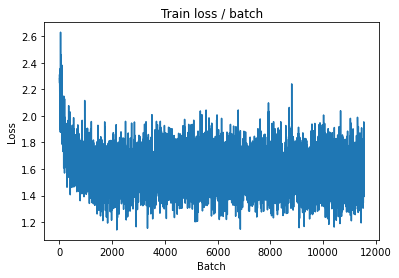


===============> Total time 7s	Avg loss 1.5516	Avg Prec@1 47.39 %	Avg Prec@5 88.93 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.5938 (1.5938)	Prec@1  47.7 ( 47.7)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.5533	Avg Prec@1 49.56 %	Avg Prec@5 90.07 %



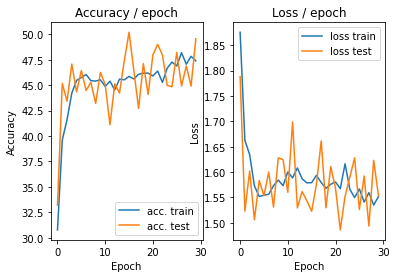

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 1.4306 (1.4306)	Prec@1  50.8 ( 50.8)	Prec@5  90.6 ( 90.6)


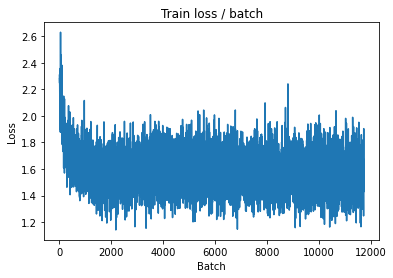

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.5565 (1.5517)	Prec@1  45.3 ( 47.3)	Prec@5  83.6 ( 89.1)


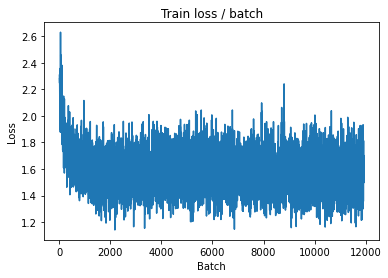


===============> Total time 7s	Avg loss 1.5624	Avg Prec@1 47.08 %	Avg Prec@5 89.01 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.5504 (1.5504)	Prec@1  43.8 ( 43.8)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.5018	Avg Prec@1 50.99 %	Avg Prec@5 90.52 %



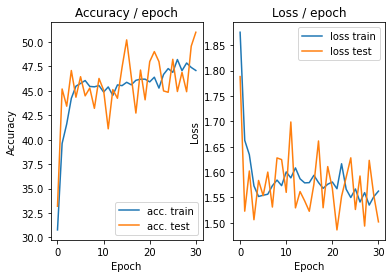

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 1.3626 (1.3626)	Prec@1  56.2 ( 56.2)	Prec@5  93.0 ( 93.0)


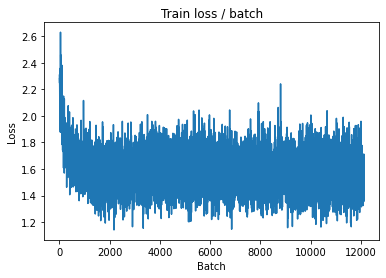

[TRAIN Batch 200/391]	Time 0.024s (0.019s)	Loss 1.4522 (1.5310)	Prec@1  49.2 ( 48.0)	Prec@5  91.4 ( 89.5)


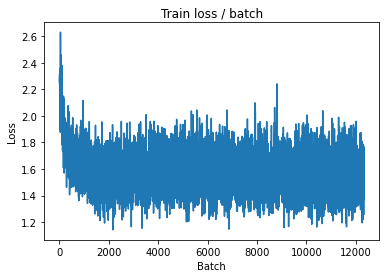


===============> Total time 7s	Avg loss 1.5410	Avg Prec@1 47.46 %	Avg Prec@5 89.34 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.6174 (1.6174)	Prec@1  45.3 ( 45.3)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.5185	Avg Prec@1 49.01 %	Avg Prec@5 90.32 %



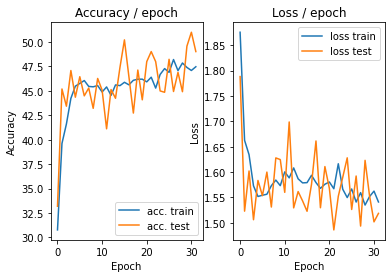

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.6479 (1.6479)	Prec@1  45.3 ( 45.3)	Prec@5  88.3 ( 88.3)


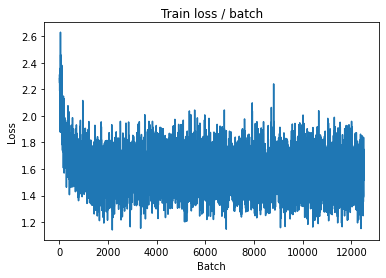

[TRAIN Batch 200/391]	Time 0.028s (0.022s)	Loss 1.8680 (1.5341)	Prec@1  44.5 ( 48.0)	Prec@5  89.1 ( 89.3)


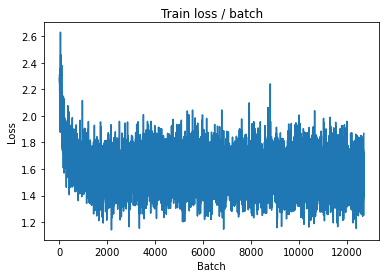


===============> Total time 8s	Avg loss 1.5549	Avg Prec@1 47.60 %	Avg Prec@5 88.87 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.4316 (1.4316)	Prec@1  46.9 ( 46.9)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5386	Avg Prec@1 47.97 %	Avg Prec@5 89.39 %



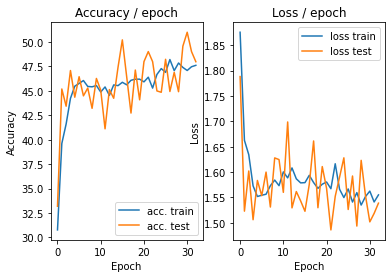

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 1.3273 (1.3273)	Prec@1  56.2 ( 56.2)	Prec@5  93.8 ( 93.8)


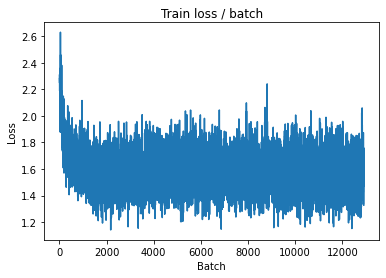

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.6559 (1.5784)	Prec@1  43.0 ( 46.6)	Prec@5  85.9 ( 88.7)


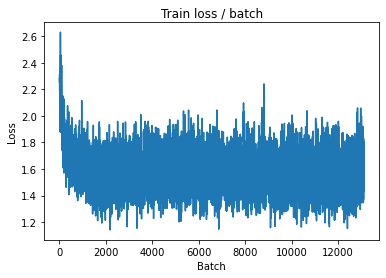


===============> Total time 7s	Avg loss 1.5839	Avg Prec@1 46.46 %	Avg Prec@5 88.59 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.5463 (1.5463)	Prec@1  47.7 ( 47.7)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5713	Avg Prec@1 47.77 %	Avg Prec@5 88.72 %



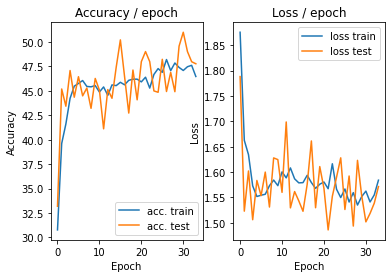

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.8265 (1.8265)	Prec@1  40.6 ( 40.6)	Prec@5  85.9 ( 85.9)


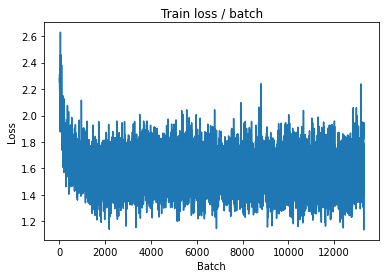

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.5015 (1.5778)	Prec@1  53.9 ( 46.2)	Prec@5  86.7 ( 88.3)


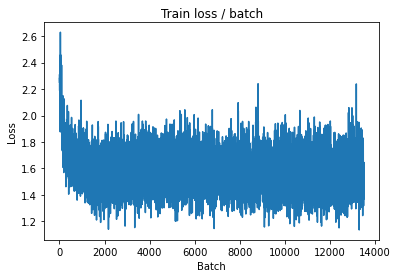


===============> Total time 8s	Avg loss 1.5671	Avg Prec@1 46.67 %	Avg Prec@5 88.62 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.7543 (1.7543)	Prec@1  41.4 ( 41.4)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.5407	Avg Prec@1 47.51 %	Avg Prec@5 90.17 %



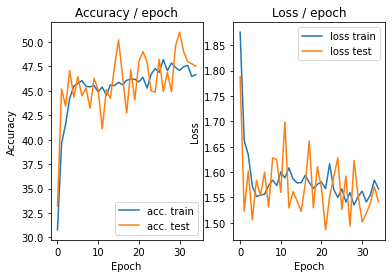

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.5041 (1.5041)	Prec@1  48.4 ( 48.4)	Prec@5  89.8 ( 89.8)


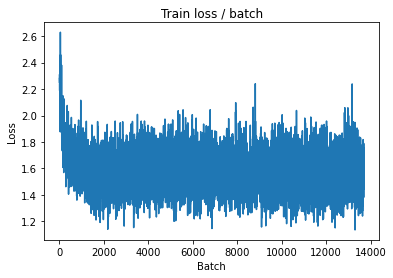

[TRAIN Batch 200/391]	Time 0.005s (0.020s)	Loss 1.6956 (1.5588)	Prec@1  43.8 ( 47.2)	Prec@5  90.6 ( 89.1)


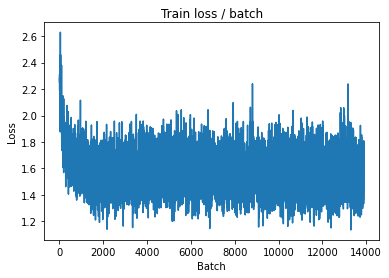


===============> Total time 7s	Avg loss 1.5606	Avg Prec@1 47.42 %	Avg Prec@5 89.09 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.6620 (1.6620)	Prec@1  47.7 ( 47.7)	Prec@5  85.2 ( 85.2)

===============> Total time 1s	Avg loss 1.5478	Avg Prec@1 48.72 %	Avg Prec@5 88.33 %



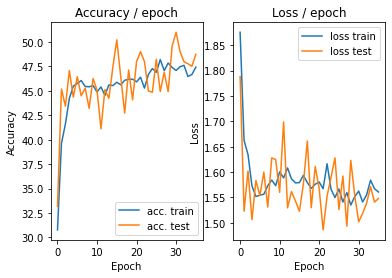

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.290s (0.290s)	Loss 1.5402 (1.5402)	Prec@1  50.0 ( 50.0)	Prec@5  89.1 ( 89.1)


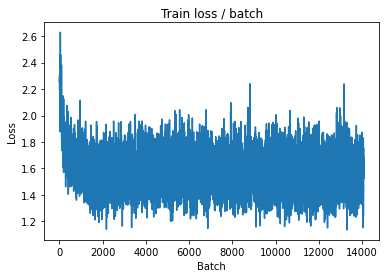

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 1.3004 (1.5134)	Prec@1  57.0 ( 48.9)	Prec@5  90.6 ( 89.8)


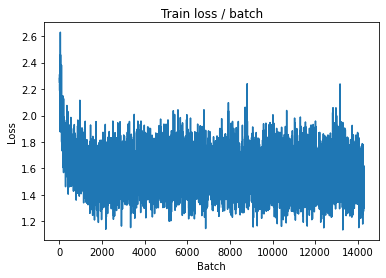


===============> Total time 7s	Avg loss 1.5174	Avg Prec@1 48.81 %	Avg Prec@5 89.58 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.5924 (1.5924)	Prec@1  42.2 ( 42.2)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.4843	Avg Prec@1 49.33 %	Avg Prec@5 90.05 %



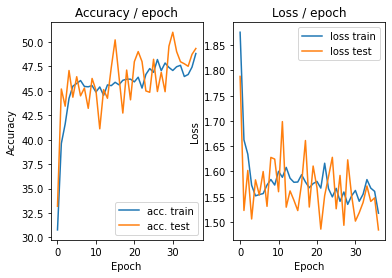

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 1.4928 (1.4928)	Prec@1  53.1 ( 53.1)	Prec@5  90.6 ( 90.6)


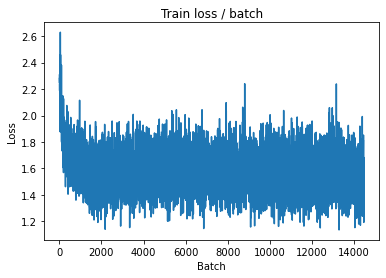

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.4162 (1.5443)	Prec@1  52.3 ( 47.8)	Prec@5  89.8 ( 88.7)


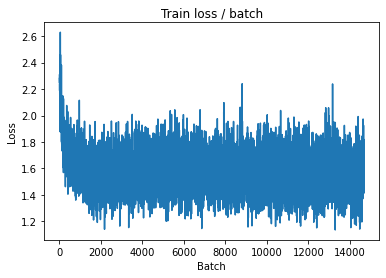


===============> Total time 7s	Avg loss 1.5398	Avg Prec@1 48.14 %	Avg Prec@5 88.96 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.5075 (1.5075)	Prec@1  50.0 ( 50.0)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5399	Avg Prec@1 49.20 %	Avg Prec@5 89.61 %



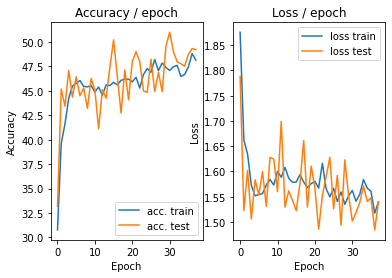

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 1.5127 (1.5127)	Prec@1  50.0 ( 50.0)	Prec@5  91.4 ( 91.4)


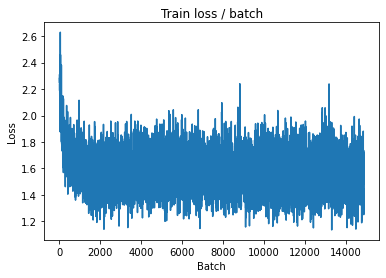

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.4412 (1.5386)	Prec@1  50.8 ( 48.2)	Prec@5  96.1 ( 89.3)


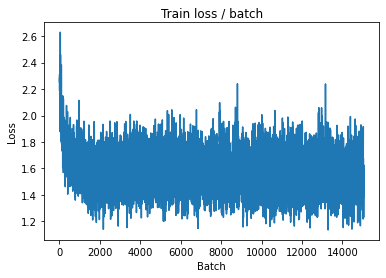


===============> Total time 7s	Avg loss 1.5215	Avg Prec@1 48.75 %	Avg Prec@5 89.55 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.4642 (1.4642)	Prec@1  51.6 ( 51.6)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.4815	Avg Prec@1 49.77 %	Avg Prec@5 90.71 %



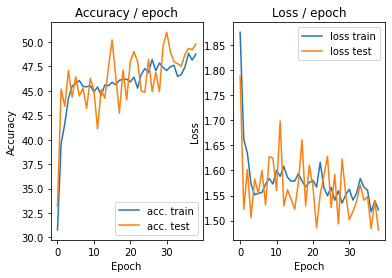

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 1.6547 (1.6547)	Prec@1  50.0 ( 50.0)	Prec@5  89.1 ( 89.1)


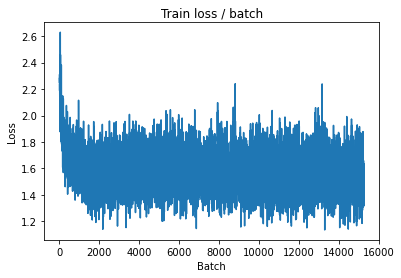

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.6565 (1.5409)	Prec@1  46.1 ( 48.1)	Prec@5  93.0 ( 89.3)


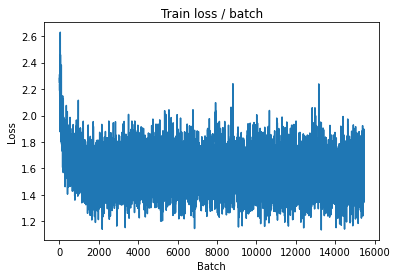


===============> Total time 8s	Avg loss 1.5243	Avg Prec@1 48.73 %	Avg Prec@5 89.53 %

[EVAL Batch 000/079]	Time 0.285s (0.285s)	Loss 1.6103 (1.6103)	Prec@1  43.0 ( 43.0)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.5452	Avg Prec@1 49.41 %	Avg Prec@5 89.83 %



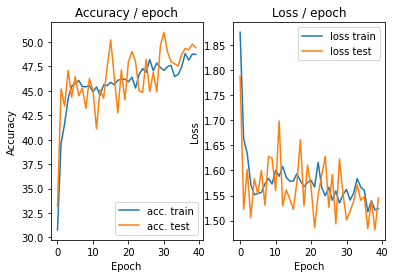

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.3484 (1.3484)	Prec@1  52.3 ( 52.3)	Prec@5  94.5 ( 94.5)


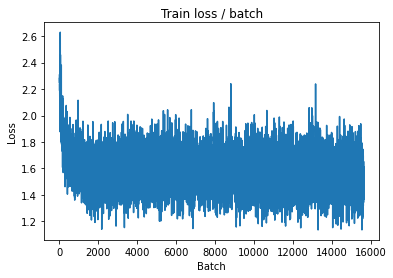

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.2765 (1.5400)	Prec@1  58.6 ( 48.5)	Prec@5  91.4 ( 89.0)


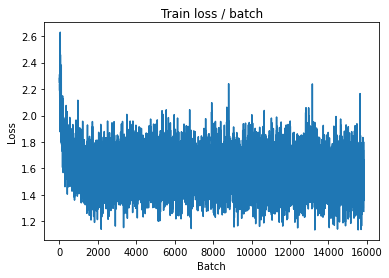


===============> Total time 7s	Avg loss 1.5244	Avg Prec@1 48.85 %	Avg Prec@5 89.34 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.5656 (1.5656)	Prec@1  49.2 ( 49.2)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.5485	Avg Prec@1 49.45 %	Avg Prec@5 89.19 %



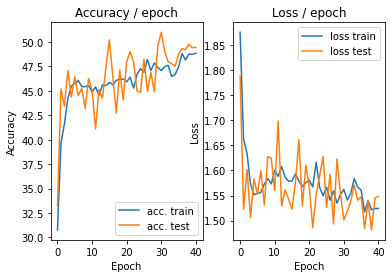

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.6568 (1.6568)	Prec@1  51.6 ( 51.6)	Prec@5  96.1 ( 96.1)


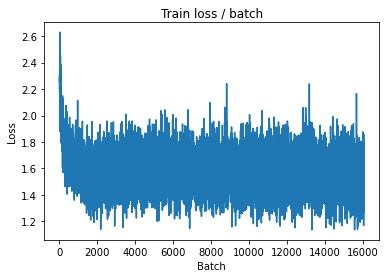

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.7566 (1.5512)	Prec@1  45.3 ( 48.4)	Prec@5  85.9 ( 89.2)


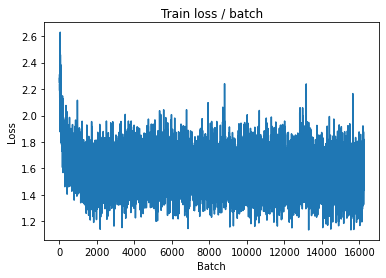


===============> Total time 8s	Avg loss 1.5227	Avg Prec@1 49.17 %	Avg Prec@5 89.37 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 1.4219 (1.4219)	Prec@1  52.3 ( 52.3)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.4458	Avg Prec@1 52.11 %	Avg Prec@5 90.50 %



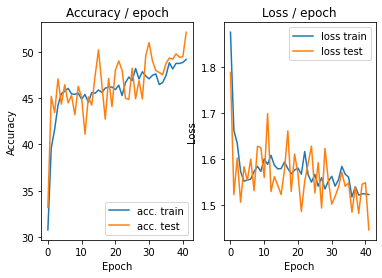

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.4810 (1.4810)	Prec@1  52.3 ( 52.3)	Prec@5  88.3 ( 88.3)


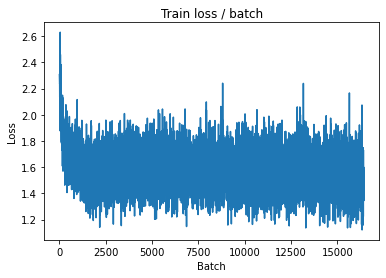

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 1.6299 (1.4927)	Prec@1  50.8 ( 50.0)	Prec@5  89.1 ( 89.5)


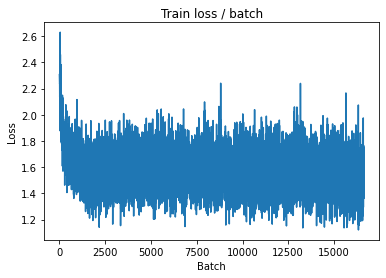


===============> Total time 7s	Avg loss 1.5012	Avg Prec@1 49.52 %	Avg Prec@5 89.63 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.4634 (1.4634)	Prec@1  52.3 ( 52.3)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5178	Avg Prec@1 49.29 %	Avg Prec@5 90.06 %



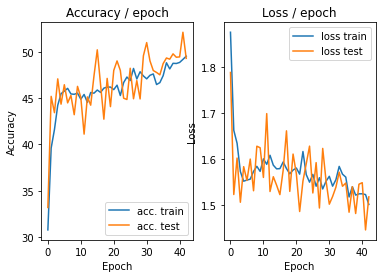

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.3850 (1.3850)	Prec@1  53.1 ( 53.1)	Prec@5  89.1 ( 89.1)


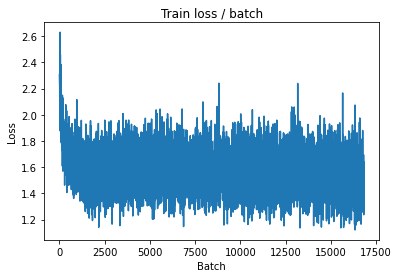

[TRAIN Batch 200/391]	Time 0.029s (0.021s)	Loss 1.3812 (1.4935)	Prec@1  48.4 ( 50.2)	Prec@5  89.8 ( 89.7)


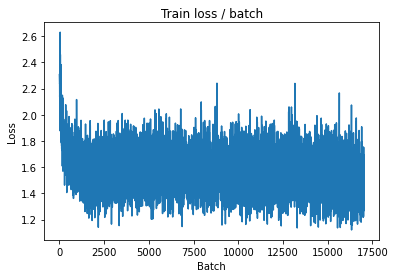


===============> Total time 8s	Avg loss 1.4970	Avg Prec@1 49.83 %	Avg Prec@5 89.75 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.5985 (1.5985)	Prec@1  46.1 ( 46.1)	Prec@5  85.9 ( 85.9)

===============> Total time 1s	Avg loss 1.4907	Avg Prec@1 49.80 %	Avg Prec@5 89.91 %



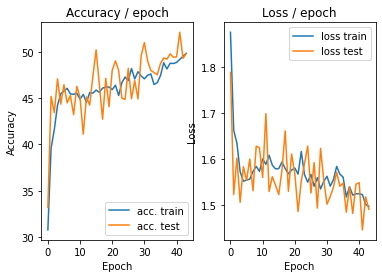

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 1.6673 (1.6673)	Prec@1  43.0 ( 43.0)	Prec@5  85.2 ( 85.2)


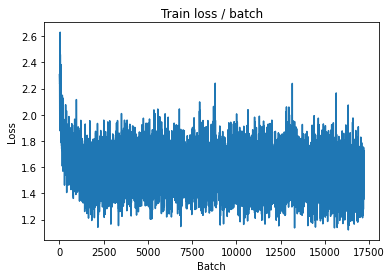

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 1.4411 (1.4802)	Prec@1  51.6 ( 50.0)	Prec@5  93.0 ( 89.7)


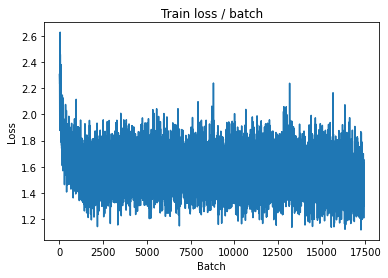


===============> Total time 8s	Avg loss 1.4860	Avg Prec@1 49.81 %	Avg Prec@5 89.75 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.3839 (1.3839)	Prec@1  55.5 ( 55.5)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.4352	Avg Prec@1 52.92 %	Avg Prec@5 91.25 %



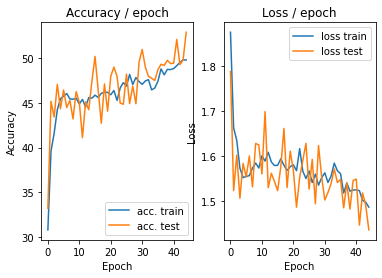

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.1940 (1.1940)	Prec@1  56.2 ( 56.2)	Prec@5  93.0 ( 93.0)


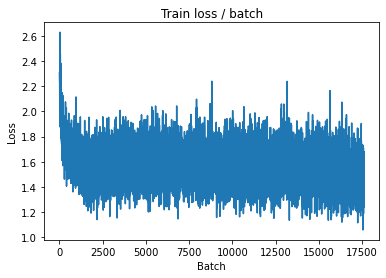

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 1.6574 (1.4997)	Prec@1  44.5 ( 49.9)	Prec@5  86.7 ( 89.9)


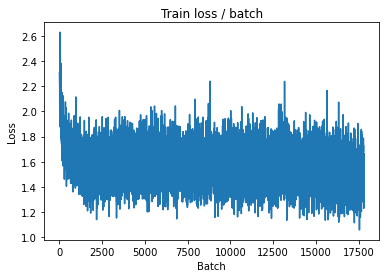


===============> Total time 8s	Avg loss 1.4907	Avg Prec@1 50.14 %	Avg Prec@5 89.86 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.8155 (1.8155)	Prec@1  46.9 ( 46.9)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.5749	Avg Prec@1 46.00 %	Avg Prec@5 89.59 %



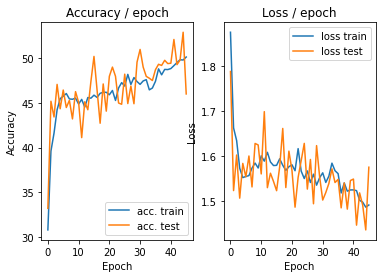

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.6823 (1.6823)	Prec@1  46.1 ( 46.1)	Prec@5  89.8 ( 89.8)


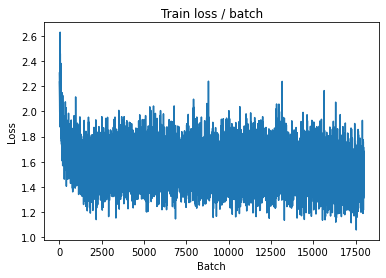

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.8322 (1.4865)	Prec@1  36.7 ( 50.0)	Prec@5  89.1 ( 90.2)


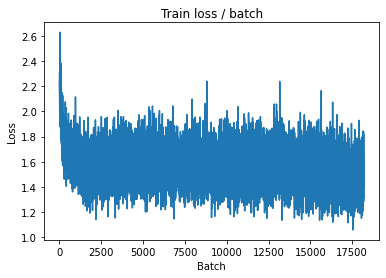


===============> Total time 7s	Avg loss 1.4898	Avg Prec@1 50.00 %	Avg Prec@5 89.79 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 1.4677 (1.4677)	Prec@1  50.0 ( 50.0)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.4543	Avg Prec@1 52.77 %	Avg Prec@5 90.39 %



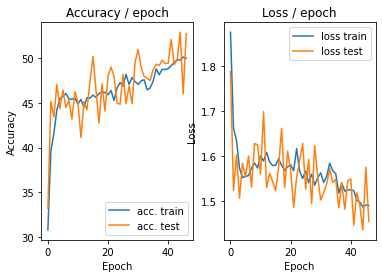

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.266s (0.266s)	Loss 1.4365 (1.4365)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)


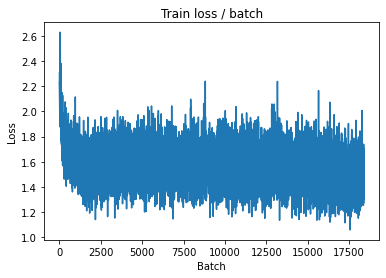

[TRAIN Batch 200/391]	Time 0.035s (0.023s)	Loss 1.6110 (1.4662)	Prec@1  39.8 ( 50.3)	Prec@5  88.3 ( 90.3)


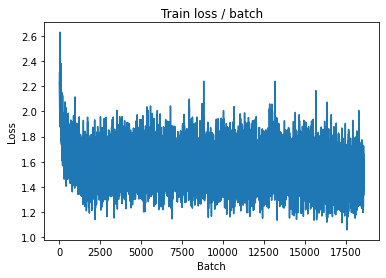


===============> Total time 8s	Avg loss 1.4750	Avg Prec@1 50.52 %	Avg Prec@5 90.02 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.4607 (1.4607)	Prec@1  43.8 ( 43.8)	Prec@5  90.6 ( 90.6)

===============> Total time 1s	Avg loss 1.5124	Avg Prec@1 49.02 %	Avg Prec@5 89.06 %



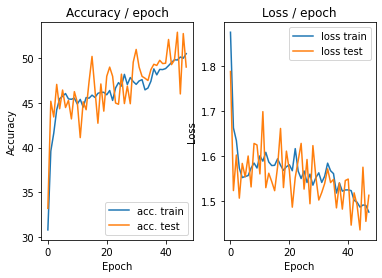

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 1.5804 (1.5804)	Prec@1  52.3 ( 52.3)	Prec@5  86.7 ( 86.7)


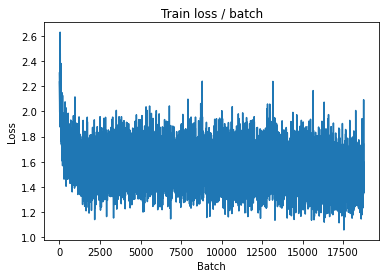

[TRAIN Batch 200/391]	Time 0.006s (0.022s)	Loss 1.5412 (1.4823)	Prec@1  50.0 ( 50.3)	Prec@5  86.7 ( 90.0)


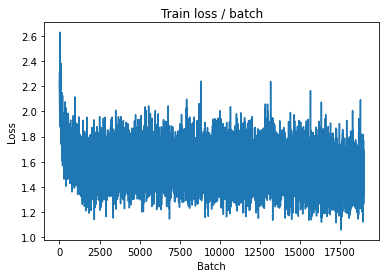


===============> Total time 8s	Avg loss 1.4870	Avg Prec@1 50.37 %	Avg Prec@5 89.88 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 1.6188 (1.6188)	Prec@1  50.0 ( 50.0)	Prec@5  89.1 ( 89.1)

===============> Total time 1s	Avg loss 1.5019	Avg Prec@1 50.11 %	Avg Prec@5 90.13 %



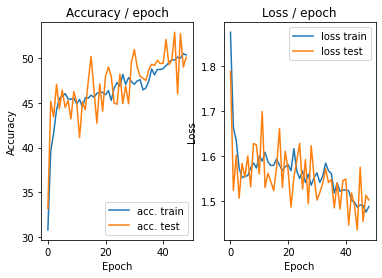

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.3920 (1.3920)	Prec@1  50.0 ( 50.0)	Prec@5  89.1 ( 89.1)


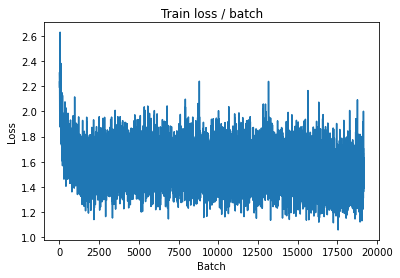

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 1.3685 (1.4867)	Prec@1  59.4 ( 50.5)	Prec@5  83.6 ( 89.7)


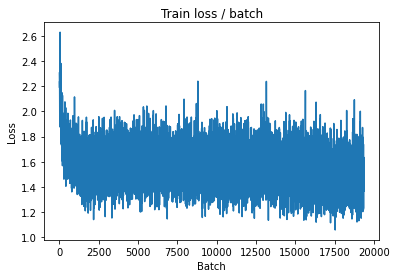


===============> Total time 7s	Avg loss 1.4838	Avg Prec@1 50.48 %	Avg Prec@5 89.83 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 1.5733 (1.5733)	Prec@1  39.8 ( 39.8)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5300	Avg Prec@1 48.70 %	Avg Prec@5 90.18 %



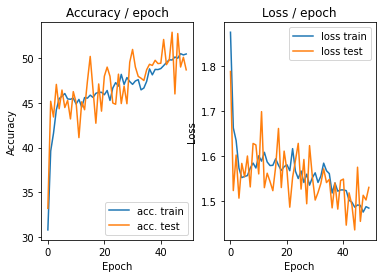

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.5612 (1.5612)	Prec@1  52.3 ( 52.3)	Prec@5  93.0 ( 93.0)


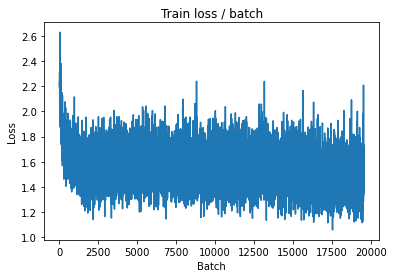

[TRAIN Batch 200/391]	Time 0.028s (0.022s)	Loss 1.7128 (1.4879)	Prec@1  46.9 ( 50.3)	Prec@5  85.2 ( 89.7)


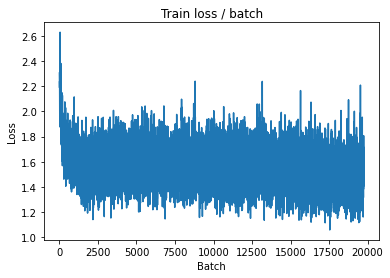


===============> Total time 8s	Avg loss 1.4801	Avg Prec@1 50.64 %	Avg Prec@5 89.92 %

[EVAL Batch 000/079]	Time 0.280s (0.280s)	Loss 1.3889 (1.3889)	Prec@1  51.6 ( 51.6)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.4366	Avg Prec@1 52.64 %	Avg Prec@5 90.36 %



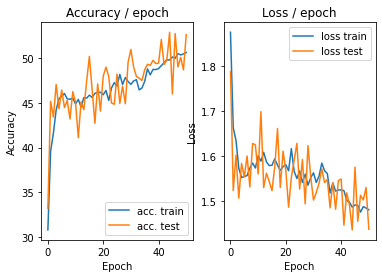

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 1.5380 (1.5380)	Prec@1  45.3 ( 45.3)	Prec@5  85.9 ( 85.9)


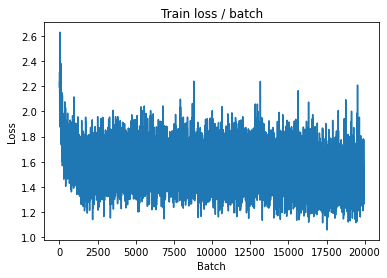

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.5735 (1.4546)	Prec@1  49.2 ( 51.4)	Prec@5  88.3 ( 90.3)


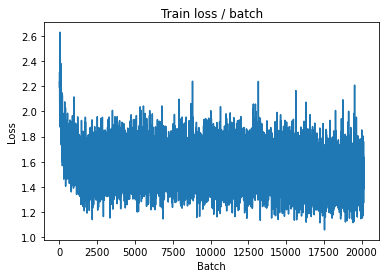


===============> Total time 7s	Avg loss 1.4468	Avg Prec@1 51.54 %	Avg Prec@5 90.43 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 1.5061 (1.5061)	Prec@1  49.2 ( 49.2)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.4841	Avg Prec@1 50.94 %	Avg Prec@5 90.62 %



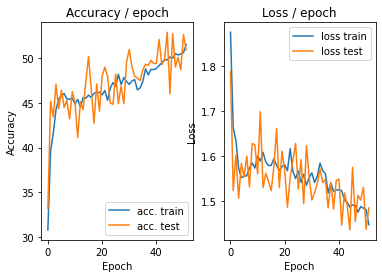

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 1.3694 (1.3694)	Prec@1  52.3 ( 52.3)	Prec@5  93.0 ( 93.0)


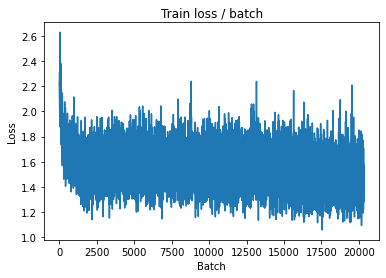

[TRAIN Batch 200/391]	Time 0.016s (0.019s)	Loss 1.4534 (1.4202)	Prec@1  53.9 ( 52.3)	Prec@5  90.6 ( 91.3)


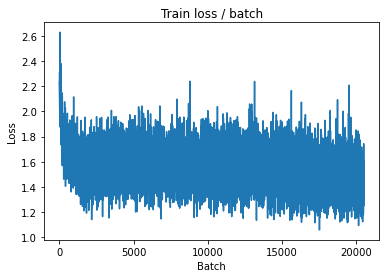


===============> Total time 7s	Avg loss 1.4570	Avg Prec@1 51.34 %	Avg Prec@5 90.48 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.6512 (1.6512)	Prec@1  44.5 ( 44.5)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5849	Avg Prec@1 49.25 %	Avg Prec@5 89.75 %



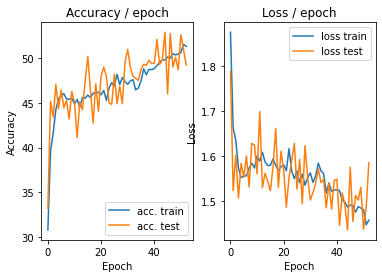

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 1.4511 (1.4511)	Prec@1  55.5 ( 55.5)	Prec@5  94.5 ( 94.5)


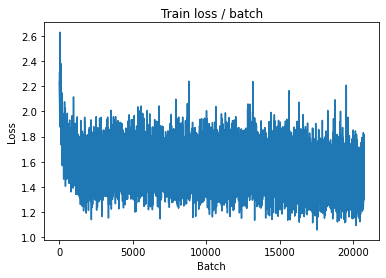

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 1.4338 (1.4642)	Prec@1  48.4 ( 51.4)	Prec@5  87.5 ( 90.1)


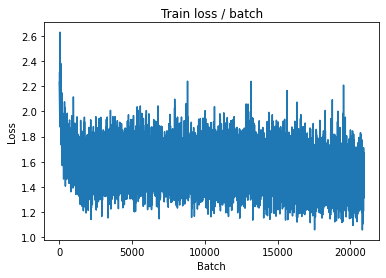


===============> Total time 8s	Avg loss 1.4743	Avg Prec@1 51.07 %	Avg Prec@5 89.88 %

[EVAL Batch 000/079]	Time 0.132s (0.132s)	Loss 1.3736 (1.3736)	Prec@1  50.8 ( 50.8)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.5204	Avg Prec@1 50.03 %	Avg Prec@5 89.70 %



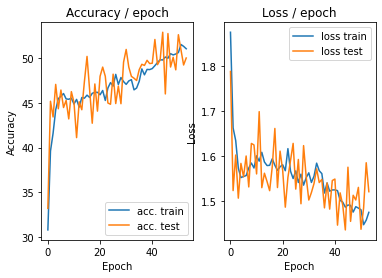

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.4245 (1.4245)	Prec@1  44.5 ( 44.5)	Prec@5  95.3 ( 95.3)


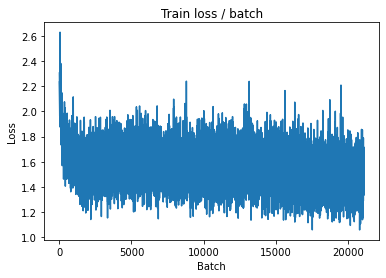

[TRAIN Batch 200/391]	Time 0.035s (0.023s)	Loss 1.4676 (1.5097)	Prec@1  46.9 ( 49.3)	Prec@5  92.2 ( 89.2)


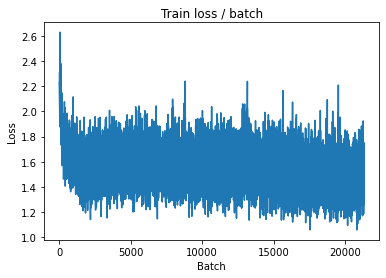


===============> Total time 8s	Avg loss 1.4961	Avg Prec@1 49.90 %	Avg Prec@5 89.63 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.3420 (1.3420)	Prec@1  53.1 ( 53.1)	Prec@5  94.5 ( 94.5)

===============> Total time 1s	Avg loss 1.4129	Avg Prec@1 54.29 %	Avg Prec@5 90.84 %



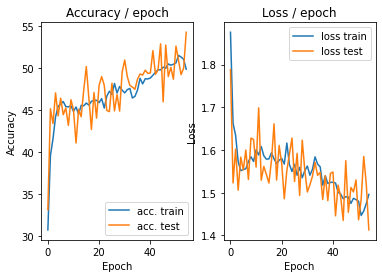

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 1.4445 (1.4445)	Prec@1  49.2 ( 49.2)	Prec@5  89.1 ( 89.1)


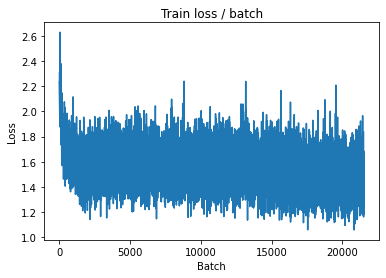

[TRAIN Batch 200/391]	Time 0.028s (0.022s)	Loss 1.3894 (1.4203)	Prec@1  55.5 ( 52.6)	Prec@5  92.2 ( 90.6)


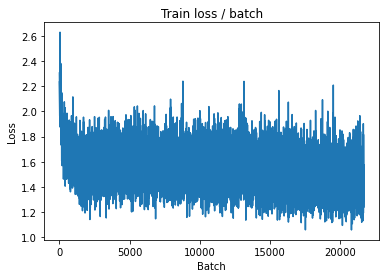


===============> Total time 7s	Avg loss 1.4285	Avg Prec@1 52.08 %	Avg Prec@5 90.55 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 1.5453 (1.5453)	Prec@1  47.7 ( 47.7)	Prec@5  86.7 ( 86.7)

===============> Total time 1s	Avg loss 1.5118	Avg Prec@1 50.00 %	Avg Prec@5 89.94 %



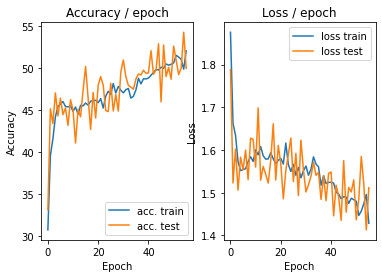

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 1.5519 (1.5519)	Prec@1  54.7 ( 54.7)	Prec@5  93.0 ( 93.0)


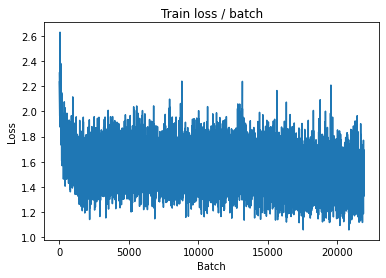

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.5182 (1.4499)	Prec@1  46.1 ( 51.7)	Prec@5  89.8 ( 90.4)


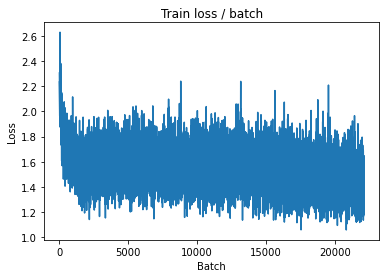


===============> Total time 7s	Avg loss 1.4309	Avg Prec@1 52.20 %	Avg Prec@5 90.63 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 1.3235 (1.3235)	Prec@1  55.5 ( 55.5)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.3927	Avg Prec@1 54.84 %	Avg Prec@5 91.92 %



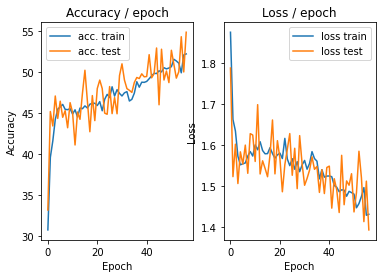

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 1.4940 (1.4940)	Prec@1  50.8 ( 50.8)	Prec@5  91.4 ( 91.4)


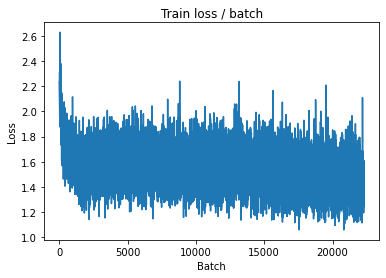

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.1575 (1.4195)	Prec@1  55.5 ( 52.8)	Prec@5  90.6 ( 91.0)


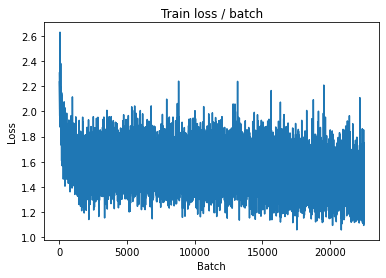


===============> Total time 7s	Avg loss 1.4087	Avg Prec@1 53.01 %	Avg Prec@5 91.02 %

[EVAL Batch 000/079]	Time 0.135s (0.135s)	Loss 1.2221 (1.2221)	Prec@1  57.8 ( 57.8)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.4089	Avg Prec@1 53.61 %	Avg Prec@5 91.97 %



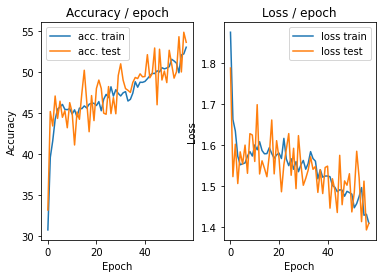

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 1.2578 (1.2578)	Prec@1  60.2 ( 60.2)	Prec@5  89.1 ( 89.1)


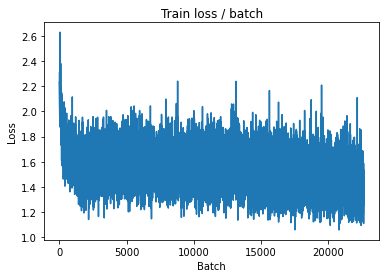

[TRAIN Batch 200/391]	Time 0.036s (0.023s)	Loss 1.4098 (1.4092)	Prec@1  51.6 ( 52.5)	Prec@5  90.6 ( 90.6)


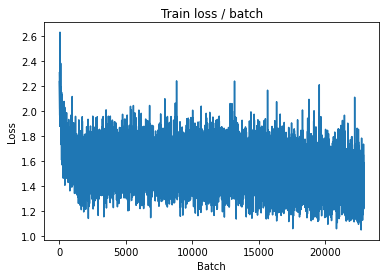


===============> Total time 8s	Avg loss 1.3977	Avg Prec@1 53.37 %	Avg Prec@5 90.81 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.4616 (1.4616)	Prec@1  52.3 ( 52.3)	Prec@5  89.8 ( 89.8)

===============> Total time 1s	Avg loss 1.3706	Avg Prec@1 54.41 %	Avg Prec@5 91.83 %



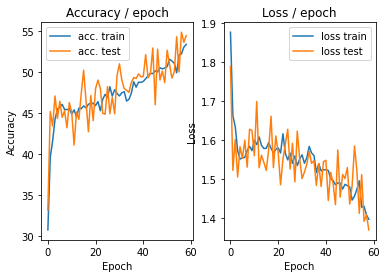

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 1.3222 (1.3222)	Prec@1  55.5 ( 55.5)	Prec@5  89.8 ( 89.8)


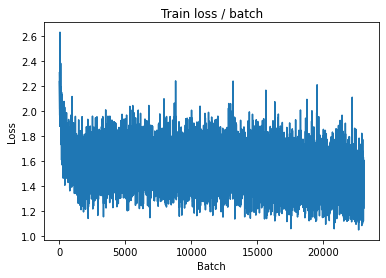

[TRAIN Batch 200/391]	Time 0.032s (0.020s)	Loss 1.4642 (1.3887)	Prec@1  48.4 ( 53.9)	Prec@5  89.8 ( 91.1)


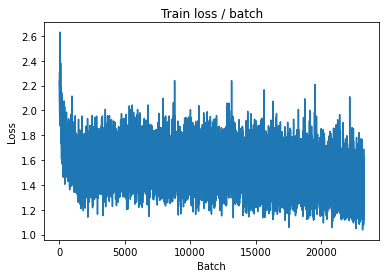


===============> Total time 7s	Avg loss 1.3911	Avg Prec@1 53.85 %	Avg Prec@5 91.19 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.4838 (1.4838)	Prec@1  53.1 ( 53.1)	Prec@5  87.5 ( 87.5)

===============> Total time 1s	Avg loss 1.3739	Avg Prec@1 52.84 %	Avg Prec@5 91.40 %



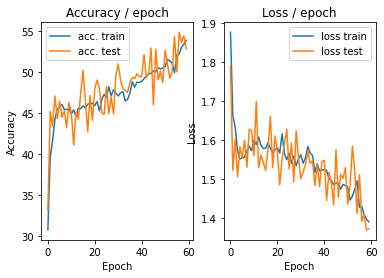

In [31]:
main(128,0.1,60,cuda=True)

## lr_scheduler.CosineAnnealingLR

In [26]:
def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=200)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        #update lr scheduler
        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 2.3076 (2.3076)	Prec@1   8.6 (  8.6)	Prec@5  44.5 ( 44.5)


<Figure size 432x288 with 0 Axes>

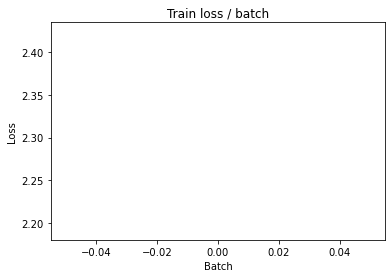

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 1.6436 (1.9666)	Prec@1  40.6 ( 27.3)	Prec@5  91.4 ( 78.5)


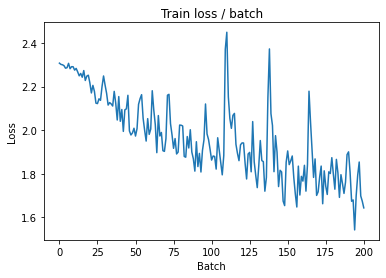


===============> Total time 7s	Avg loss 1.8055	Avg Prec@1 33.70 %	Avg Prec@5 83.86 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 1.5066 (1.5066)	Prec@1  51.6 ( 51.6)	Prec@5  91.4 ( 91.4)

===============> Total time 1s	Avg loss 1.5041	Avg Prec@1 45.24 %	Avg Prec@5 91.02 %



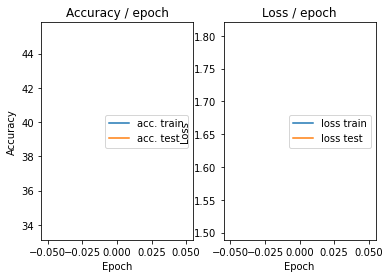

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 1.5438 (1.5438)	Prec@1  48.4 ( 48.4)	Prec@5  92.2 ( 92.2)


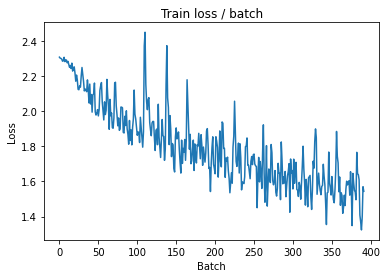

[TRAIN Batch 200/391]	Time 0.006s (0.020s)	Loss 1.3591 (1.4545)	Prec@1  48.4 ( 48.0)	Prec@5  94.5 ( 92.4)


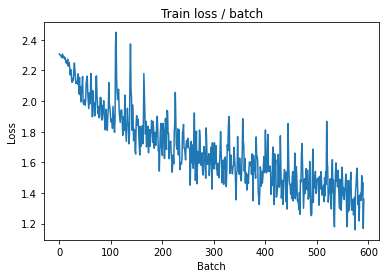


===============> Total time 7s	Avg loss 1.3899	Avg Prec@1 50.52 %	Avg Prec@5 93.07 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 1.2918 (1.2918)	Prec@1  57.0 ( 57.0)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.2215	Avg Prec@1 56.98 %	Avg Prec@5 95.08 %



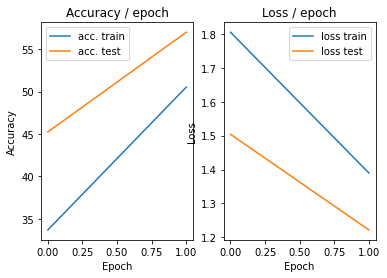

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 1.1780 (1.1780)	Prec@1  57.8 ( 57.8)	Prec@5  96.1 ( 96.1)


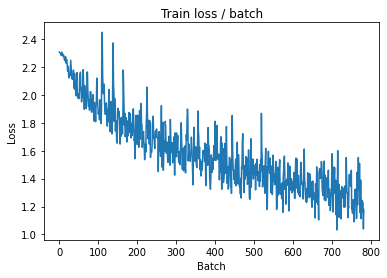

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 1.0149 (1.2122)	Prec@1  64.8 ( 57.1)	Prec@5  97.7 ( 95.0)


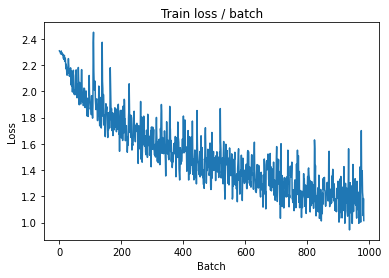


===============> Total time 7s	Avg loss 1.1674	Avg Prec@1 59.11 %	Avg Prec@5 95.42 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.9935 (0.9935)	Prec@1  68.0 ( 68.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9906	Avg Prec@1 65.32 %	Avg Prec@5 96.87 %



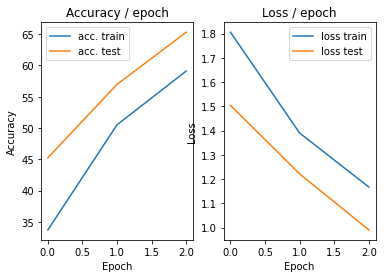

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.0293 (1.0293)	Prec@1  63.3 ( 63.3)	Prec@5  97.7 ( 97.7)


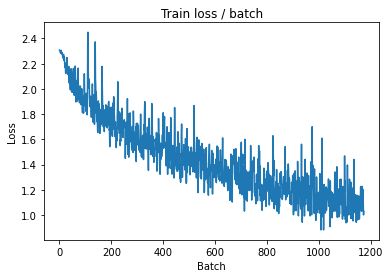

[TRAIN Batch 200/391]	Time 0.009s (0.018s)	Loss 0.9653 (1.0312)	Prec@1  64.8 ( 63.9)	Prec@5  96.9 ( 96.5)


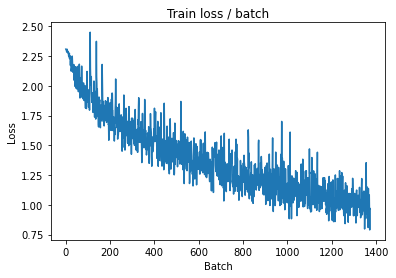


===============> Total time 7s	Avg loss 1.0153	Avg Prec@1 64.62 %	Avg Prec@5 96.62 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.9243 (0.9243)	Prec@1  64.1 ( 64.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9192	Avg Prec@1 67.41 %	Avg Prec@5 97.50 %



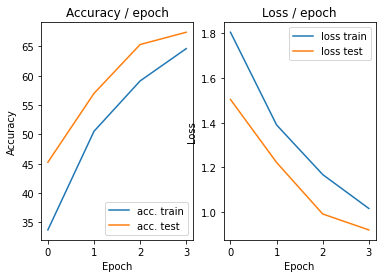

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 1.0220 (1.0220)	Prec@1  68.0 ( 68.0)	Prec@5  94.5 ( 94.5)


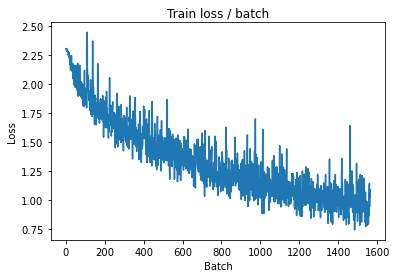

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.9090 (0.9131)	Prec@1  68.0 ( 68.0)	Prec@5  98.4 ( 97.3)


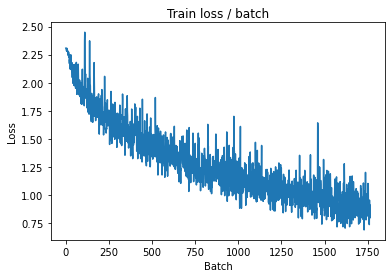


===============> Total time 7s	Avg loss 0.9004	Avg Prec@1 68.58 %	Avg Prec@5 97.33 %

[EVAL Batch 000/079]	Time 0.282s (0.282s)	Loss 0.7392 (0.7392)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8671	Avg Prec@1 69.94 %	Avg Prec@5 97.55 %



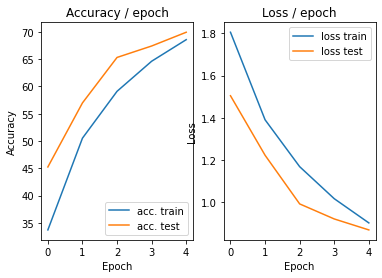

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.9032 (0.9032)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)


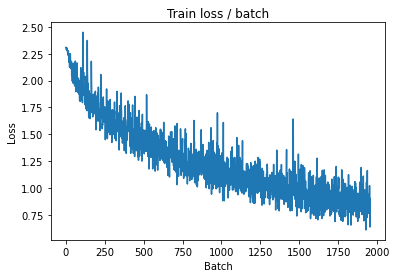

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.8276 (0.8394)	Prec@1  71.9 ( 70.6)	Prec@5  97.7 ( 97.6)


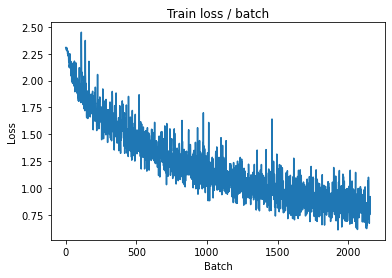


===============> Total time 7s	Avg loss 0.8227	Avg Prec@1 71.45 %	Avg Prec@5 97.70 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.7413 (0.7413)	Prec@1  75.0 ( 75.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7936	Avg Prec@1 72.64 %	Avg Prec@5 97.98 %



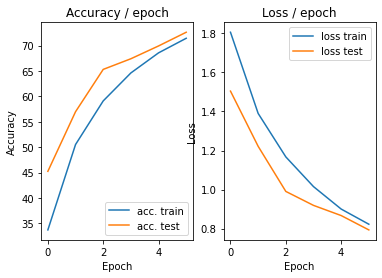

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.6166 (0.6166)	Prec@1  78.9 ( 78.9)	Prec@5  99.2 ( 99.2)


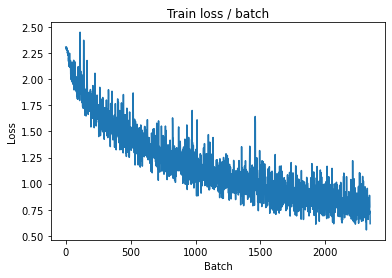

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.7774 (0.7636)	Prec@1  70.3 ( 73.3)	Prec@5  98.4 ( 98.2)


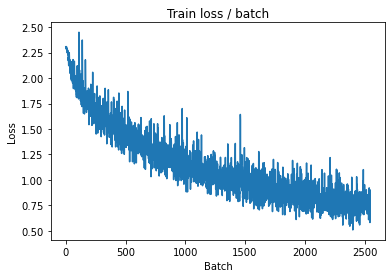


===============> Total time 7s	Avg loss 0.7565	Avg Prec@1 73.69 %	Avg Prec@5 98.22 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.7283 (0.7283)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7459	Avg Prec@1 73.83 %	Avg Prec@5 98.16 %



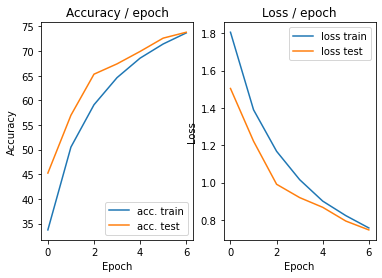

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.6548 (0.6548)	Prec@1  78.9 ( 78.9)	Prec@5 100.0 (100.0)


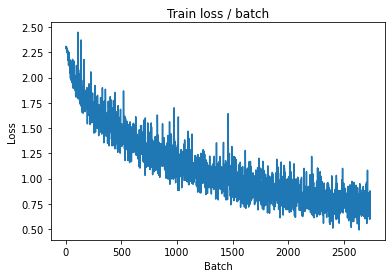

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.4863 (0.6997)	Prec@1  82.8 ( 75.7)	Prec@5 100.0 ( 98.5)


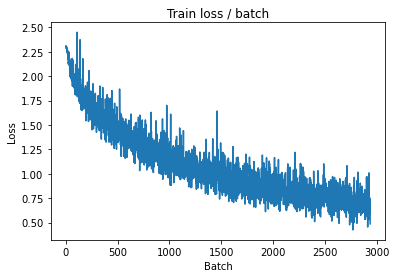


===============> Total time 7s	Avg loss 0.7074	Avg Prec@1 75.41 %	Avg Prec@5 98.47 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.7257 (0.7257)	Prec@1  75.8 ( 75.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7472	Avg Prec@1 74.51 %	Avg Prec@5 98.22 %



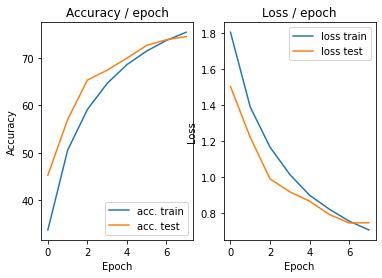

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.5892 (0.5892)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)


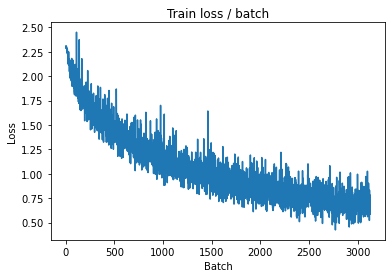

[TRAIN Batch 200/391]	Time 0.036s (0.023s)	Loss 0.5808 (0.6683)	Prec@1  77.3 ( 76.5)	Prec@5  99.2 ( 98.6)


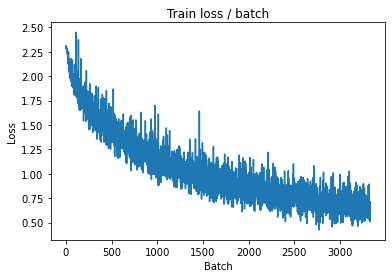


===============> Total time 8s	Avg loss 0.6630	Avg Prec@1 76.91 %	Avg Prec@5 98.57 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.8048 (0.8048)	Prec@1  73.4 ( 73.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7868	Avg Prec@1 73.19 %	Avg Prec@5 97.89 %



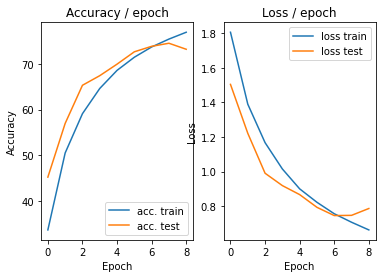

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.7157 (0.7157)	Prec@1  74.2 ( 74.2)	Prec@5  99.2 ( 99.2)


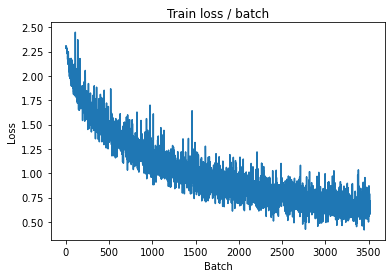

[TRAIN Batch 200/391]	Time 0.033s (0.019s)	Loss 0.7069 (0.6117)	Prec@1  79.7 ( 78.9)	Prec@5  99.2 ( 98.9)


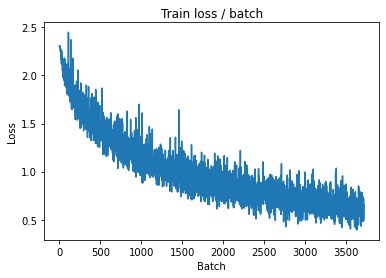


===============> Total time 7s	Avg loss 0.6164	Avg Prec@1 78.64 %	Avg Prec@5 98.83 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7865 (0.7865)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7680	Avg Prec@1 74.46 %	Avg Prec@5 98.09 %



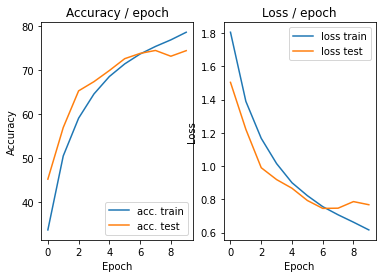

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.123s (0.123s)	Loss 0.6378 (0.6378)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


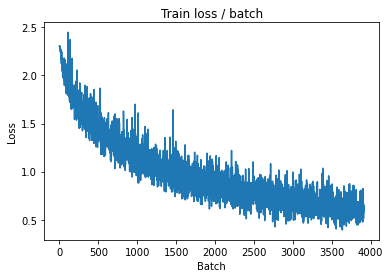

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 0.4544 (0.5820)	Prec@1  84.4 ( 79.6)	Prec@5  99.2 ( 99.0)


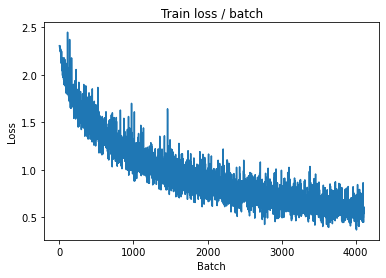


===============> Total time 7s	Avg loss 0.5852	Avg Prec@1 79.61 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.6325 (0.6325)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6531	Avg Prec@1 77.62 %	Avg Prec@5 98.49 %



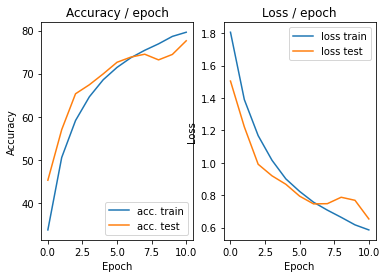

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.4834 (0.4834)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


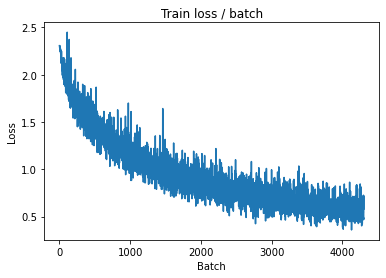

[TRAIN Batch 200/391]	Time 0.014s (0.019s)	Loss 0.5386 (0.5579)	Prec@1  78.9 ( 80.6)	Prec@5 100.0 ( 99.1)


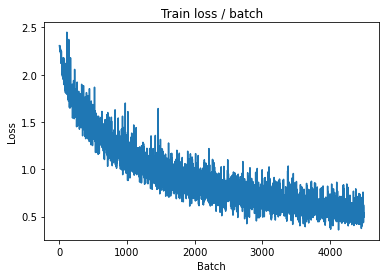


===============> Total time 7s	Avg loss 0.5557	Avg Prec@1 80.67 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.6909 (0.6909)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7102	Avg Prec@1 76.04 %	Avg Prec@5 98.50 %



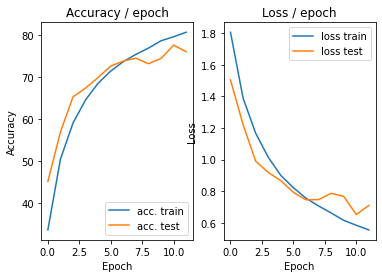

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.258s (0.258s)	Loss 0.5301 (0.5301)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)


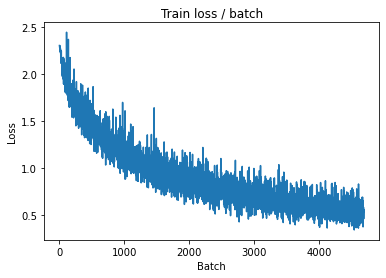

[TRAIN Batch 200/391]	Time 0.030s (0.020s)	Loss 0.5969 (0.5360)	Prec@1  80.5 ( 81.4)	Prec@5 100.0 ( 99.1)


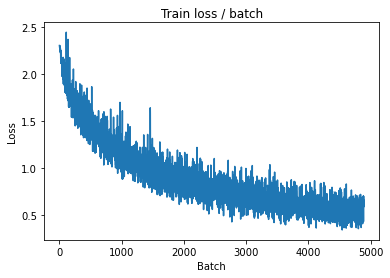


===============> Total time 7s	Avg loss 0.5299	Avg Prec@1 81.61 %	Avg Prec@5 99.16 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.6029 (0.6029)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6346	Avg Prec@1 77.98 %	Avg Prec@5 98.80 %



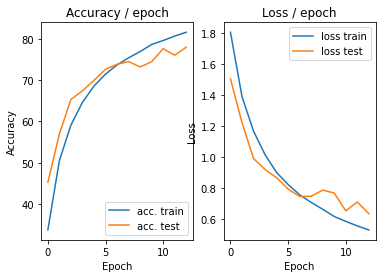

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.5979 (0.5979)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


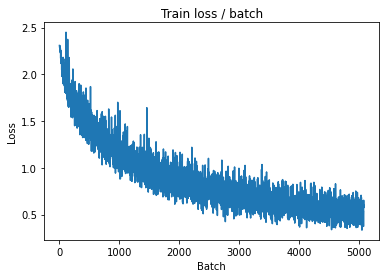

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.5775 (0.4973)	Prec@1  78.9 ( 82.6)	Prec@5 100.0 ( 99.3)


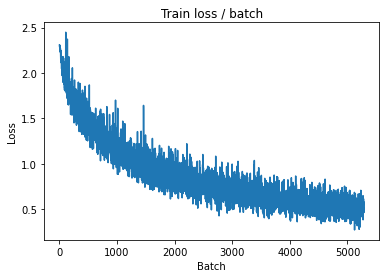


===============> Total time 7s	Avg loss 0.5002	Avg Prec@1 82.42 %	Avg Prec@5 99.28 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.5745 (0.5745)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6539	Avg Prec@1 78.13 %	Avg Prec@5 98.42 %



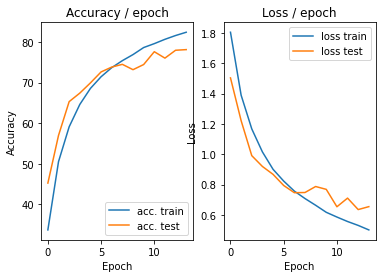

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.5233 (0.5233)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


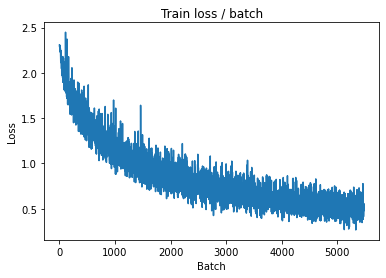

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.3781 (0.4717)	Prec@1  85.9 ( 83.7)	Prec@5 100.0 ( 99.3)


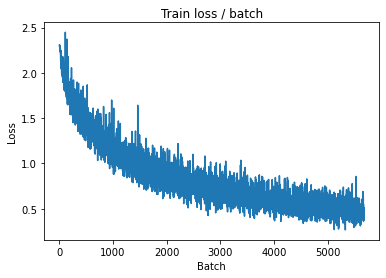


===============> Total time 7s	Avg loss 0.4763	Avg Prec@1 83.33 %	Avg Prec@5 99.35 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.7013 (0.7013)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6354	Avg Prec@1 79.42 %	Avg Prec@5 98.37 %



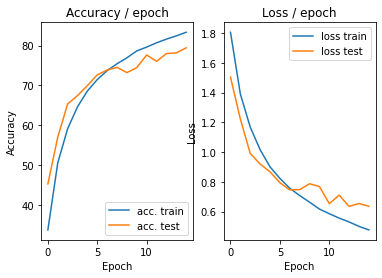

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.118s (0.118s)	Loss 0.4564 (0.4564)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


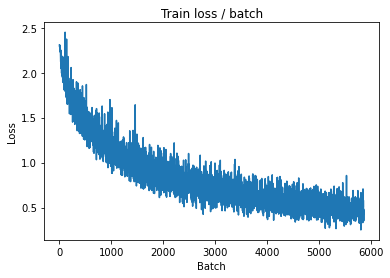

[TRAIN Batch 200/391]	Time 0.029s (0.018s)	Loss 0.4943 (0.4532)	Prec@1  82.8 ( 84.3)	Prec@5  99.2 ( 99.4)


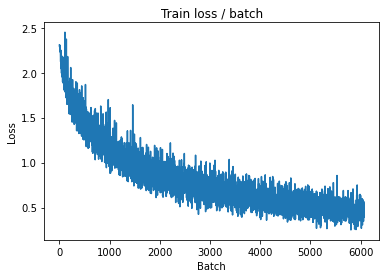


===============> Total time 7s	Avg loss 0.4577	Avg Prec@1 84.10 %	Avg Prec@5 99.42 %

[EVAL Batch 000/079]	Time 0.287s (0.287s)	Loss 0.6106 (0.6106)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6236	Avg Prec@1 79.11 %	Avg Prec@5 98.66 %



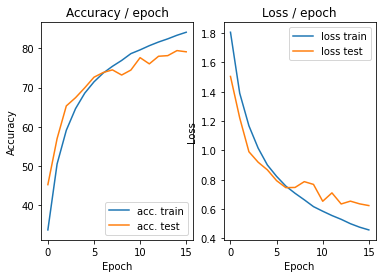

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4066 (0.4066)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


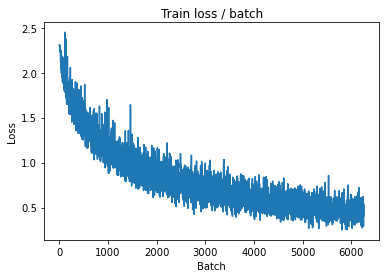

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.3993 (0.4239)	Prec@1  88.3 ( 85.2)	Prec@5 100.0 ( 99.6)


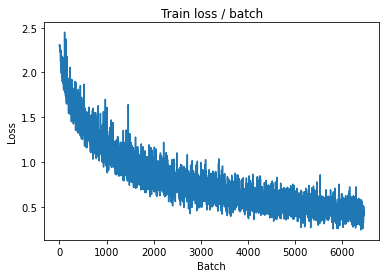


===============> Total time 7s	Avg loss 0.4324	Avg Prec@1 84.91 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.6078 (0.6078)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6350	Avg Prec@1 79.62 %	Avg Prec@5 98.53 %



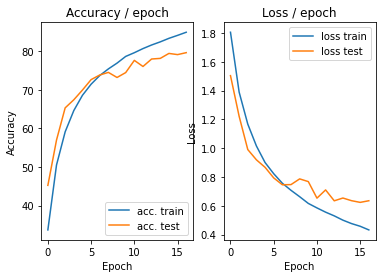

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.3641 (0.3641)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


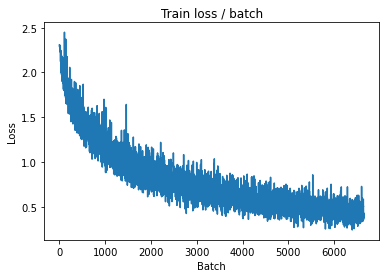

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.2996 (0.4044)	Prec@1  91.4 ( 86.0)	Prec@5 100.0 ( 99.6)


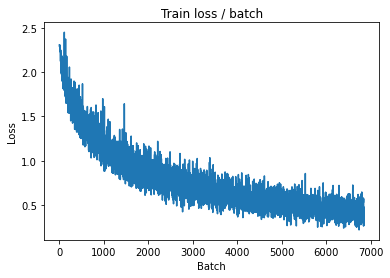


===============> Total time 7s	Avg loss 0.4135	Avg Prec@1 85.62 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.5637 (0.5637)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.6193	Avg Prec@1 79.73 %	Avg Prec@5 98.61 %



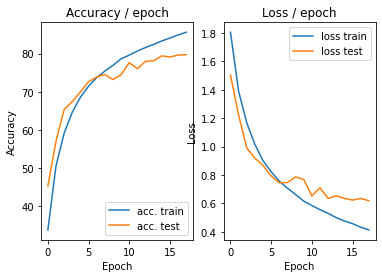

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.3791 (0.3791)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)


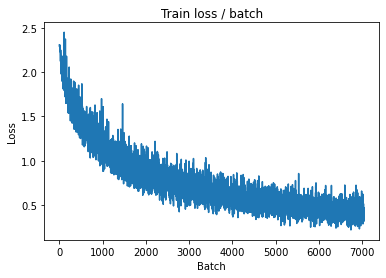

[TRAIN Batch 200/391]	Time 0.032s (0.020s)	Loss 0.4401 (0.3869)	Prec@1  85.2 ( 86.5)	Prec@5  99.2 ( 99.6)


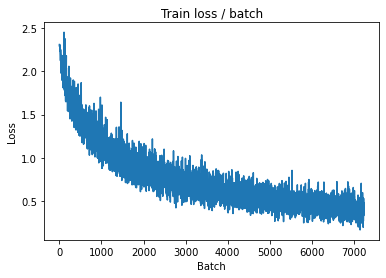


===============> Total time 7s	Avg loss 0.3935	Avg Prec@1 86.23 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.6492 (0.6492)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7372	Avg Prec@1 76.84 %	Avg Prec@5 98.41 %



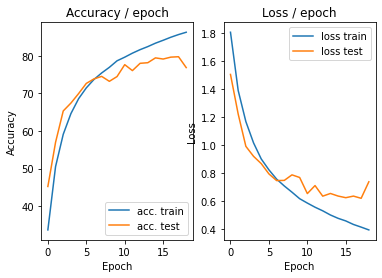

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.5447 (0.5447)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


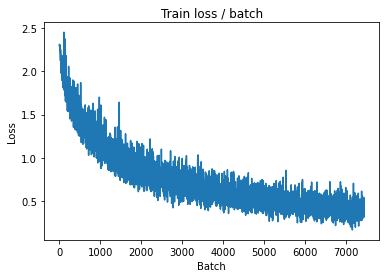

[TRAIN Batch 200/391]	Time 0.031s (0.022s)	Loss 0.3622 (0.3700)	Prec@1  87.5 ( 87.0)	Prec@5 100.0 ( 99.7)


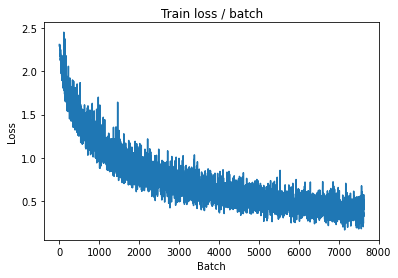


===============> Total time 7s	Avg loss 0.3744	Avg Prec@1 86.83 %	Avg Prec@5 99.66 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.5629 (0.5629)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6304	Avg Prec@1 80.18 %	Avg Prec@5 98.73 %



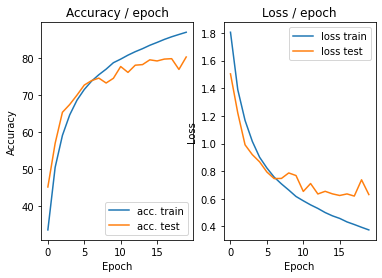

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.2769 (0.2769)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


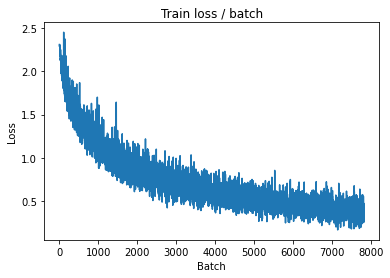

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.3439 (0.3513)	Prec@1  91.4 ( 87.6)	Prec@5 100.0 ( 99.7)


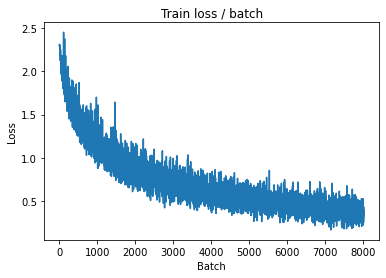


===============> Total time 7s	Avg loss 0.3643	Avg Prec@1 87.16 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.6165 (0.6165)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6397	Avg Prec@1 79.68 %	Avg Prec@5 98.72 %



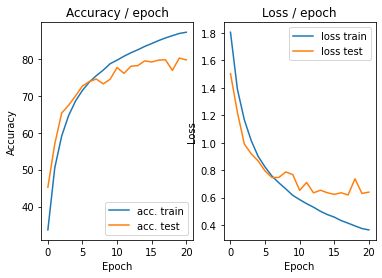

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.3008 (0.3008)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


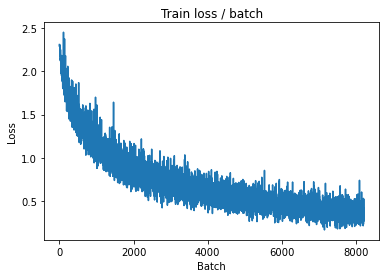

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.3172 (0.3362)	Prec@1  89.8 ( 88.3)	Prec@5 100.0 ( 99.8)


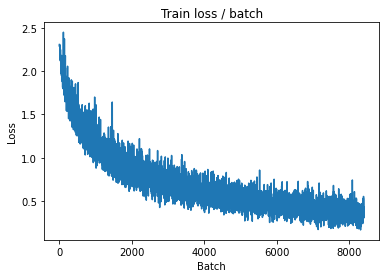


===============> Total time 8s	Avg loss 0.3469	Avg Prec@1 87.93 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.6526 (0.6526)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6518	Avg Prec@1 79.23 %	Avg Prec@5 98.66 %



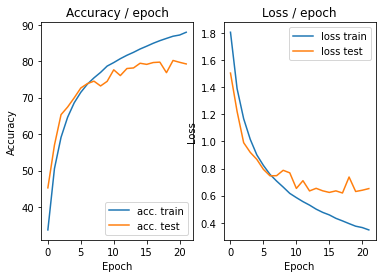

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.122s (0.122s)	Loss 0.3164 (0.3164)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


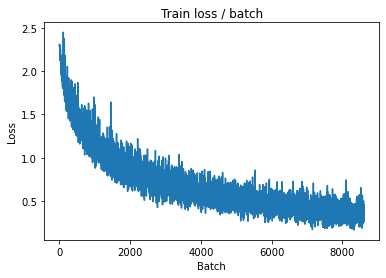

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.3815 (0.3303)	Prec@1  85.9 ( 88.4)	Prec@5  99.2 ( 99.8)


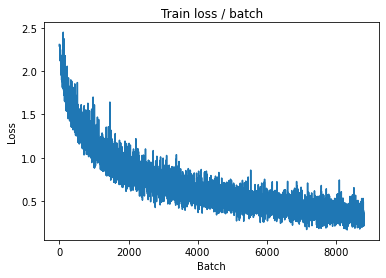


===============> Total time 7s	Avg loss 0.3331	Avg Prec@1 88.35 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.6731 (0.6731)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6505	Avg Prec@1 79.79 %	Avg Prec@5 98.65 %



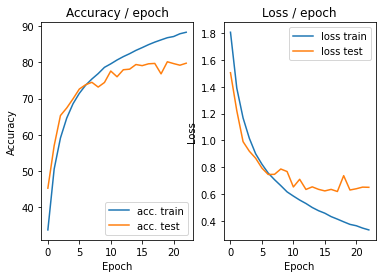

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.279s (0.279s)	Loss 0.2407 (0.2407)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


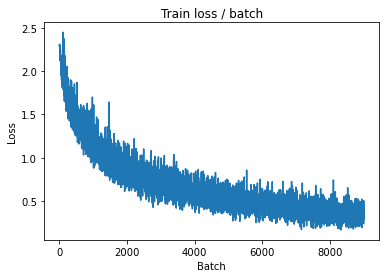

[TRAIN Batch 200/391]	Time 0.036s (0.023s)	Loss 0.4242 (0.3104)	Prec@1  81.2 ( 89.0)	Prec@5 100.0 ( 99.8)


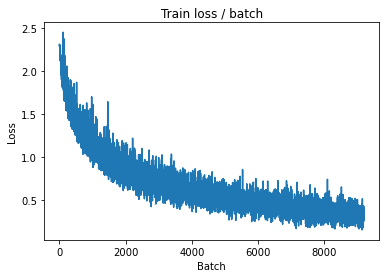


===============> Total time 8s	Avg loss 0.3205	Avg Prec@1 88.74 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.6107 (0.6107)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6230	Avg Prec@1 80.95 %	Avg Prec@5 98.71 %



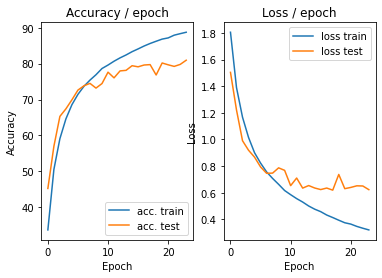

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.2012 (0.2012)	Prec@1  93.8 ( 93.8)	Prec@5  99.2 ( 99.2)


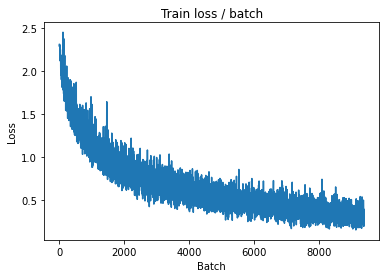

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3891 (0.2950)	Prec@1  92.2 ( 89.6)	Prec@5 100.0 ( 99.8)


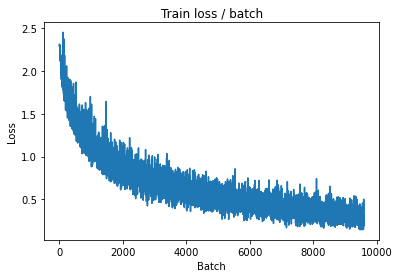


===============> Total time 7s	Avg loss 0.3043	Avg Prec@1 89.22 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.6930 (0.6930)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6129	Avg Prec@1 81.11 %	Avg Prec@5 98.68 %



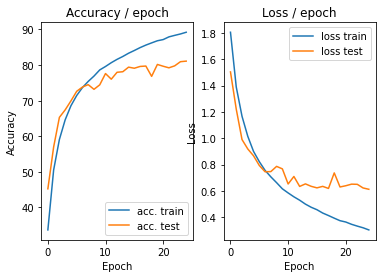

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.2447 (0.2447)	Prec@1  92.2 ( 92.2)	Prec@5  99.2 ( 99.2)


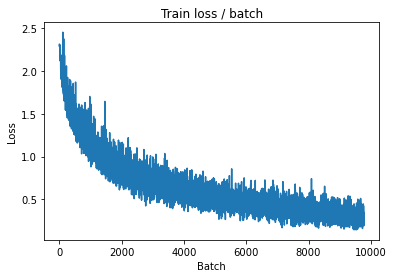

[TRAIN Batch 200/391]	Time 0.039s (0.021s)	Loss 0.3191 (0.2835)	Prec@1  89.1 ( 90.1)	Prec@5 100.0 ( 99.8)


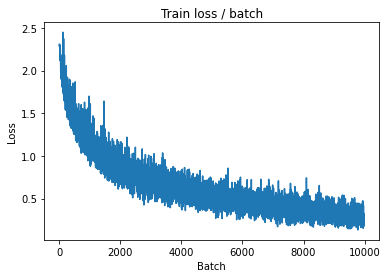


===============> Total time 8s	Avg loss 0.2923	Avg Prec@1 89.79 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.7675 (0.7675)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6851	Avg Prec@1 79.41 %	Avg Prec@5 98.75 %



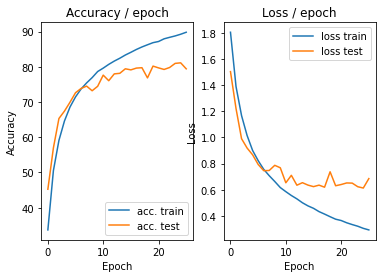

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.2759 (0.2759)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


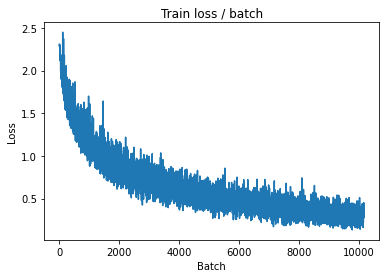

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 0.3219 (0.2861)	Prec@1  90.6 ( 90.1)	Prec@5  99.2 ( 99.8)


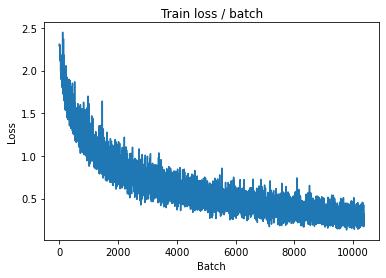


===============> Total time 7s	Avg loss 0.2837	Avg Prec@1 90.14 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.288s (0.288s)	Loss 0.6116 (0.6116)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.7074	Avg Prec@1 79.64 %	Avg Prec@5 98.79 %



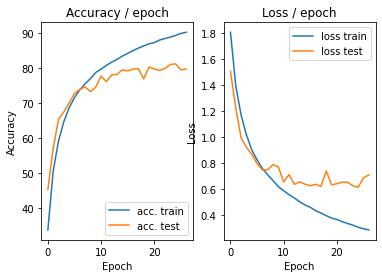

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.142s (0.142s)	Loss 0.2808 (0.2808)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


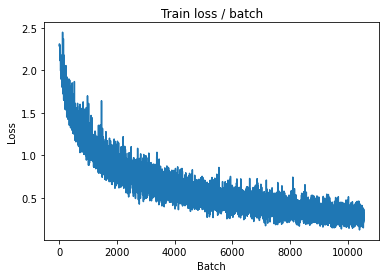

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.3064 (0.2670)	Prec@1  88.3 ( 90.9)	Prec@5 100.0 ( 99.8)


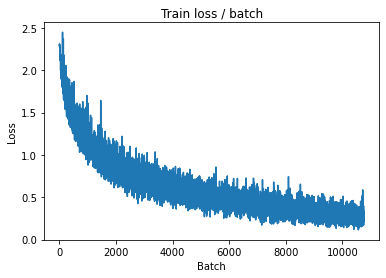


===============> Total time 7s	Avg loss 0.2663	Avg Prec@1 90.80 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.7932 (0.7932)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6957	Avg Prec@1 79.93 %	Avg Prec@5 98.66 %



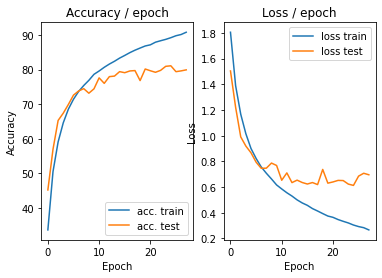

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.2090 (0.2090)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


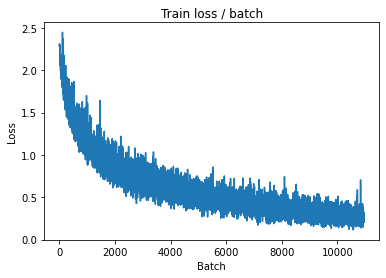

[TRAIN Batch 200/391]	Time 0.022s (0.019s)	Loss 0.2336 (0.2556)	Prec@1  90.6 ( 91.0)	Prec@5 100.0 ( 99.9)


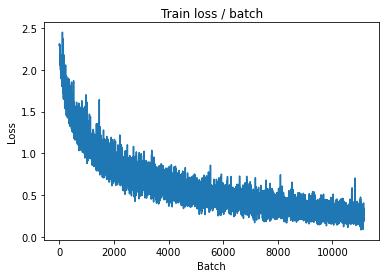


===============> Total time 7s	Avg loss 0.2624	Avg Prec@1 90.87 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.6679 (0.6679)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6991	Avg Prec@1 80.25 %	Avg Prec@5 98.83 %



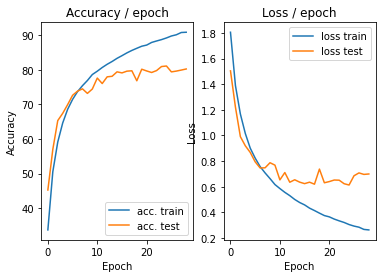

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.2284 (0.2284)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


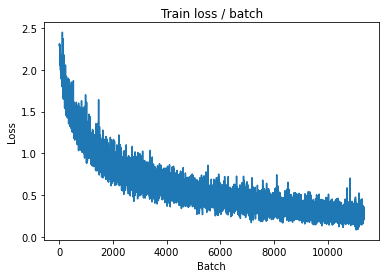

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.2705 (0.2469)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 ( 99.9)


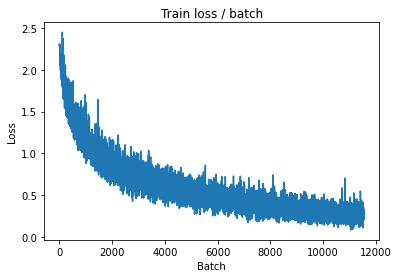


===============> Total time 7s	Avg loss 0.2565	Avg Prec@1 91.14 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7466 (0.7466)	Prec@1  79.7 ( 79.7)	Prec@5 100.0 (100.0)

===============> Total time 1s	Avg loss 0.7196	Avg Prec@1 79.34 %	Avg Prec@5 98.55 %



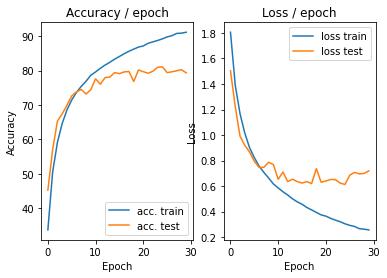

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.2481 (0.2481)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


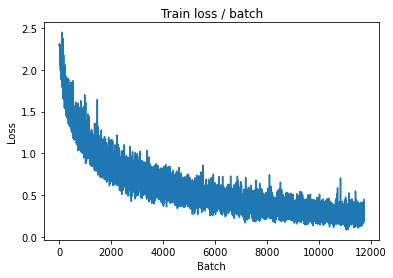

[TRAIN Batch 200/391]	Time 0.037s (0.022s)	Loss 0.3061 (0.2302)	Prec@1  91.4 ( 91.9)	Prec@5  99.2 ( 99.9)


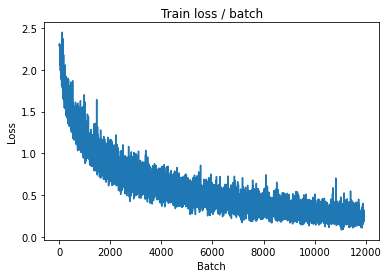


===============> Total time 8s	Avg loss 0.2408	Avg Prec@1 91.47 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.6178 (0.6178)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7112	Avg Prec@1 80.07 %	Avg Prec@5 98.72 %



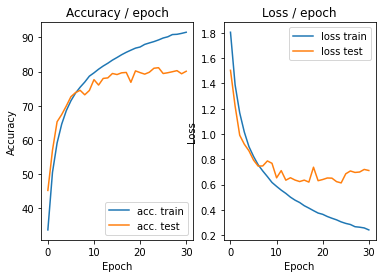

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.2177 (0.2177)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


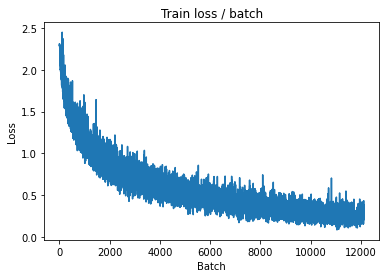

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.1992 (0.2285)	Prec@1  91.4 ( 92.0)	Prec@5 100.0 ( 99.9)


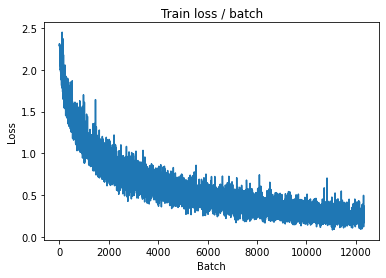


===============> Total time 7s	Avg loss 0.2287	Avg Prec@1 91.95 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6986 (0.6986)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7252	Avg Prec@1 79.67 %	Avg Prec@5 98.64 %



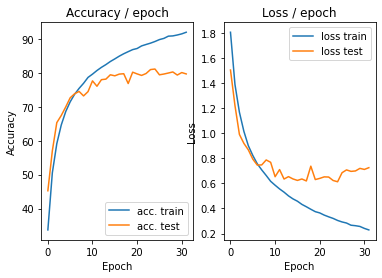

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.3182 (0.3182)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


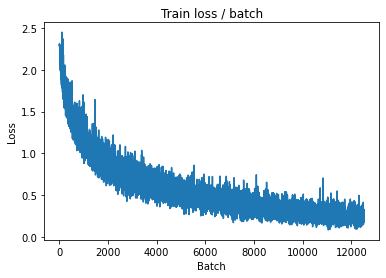

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.1409 (0.2256)	Prec@1  95.3 ( 92.2)	Prec@5 100.0 ( 99.9)


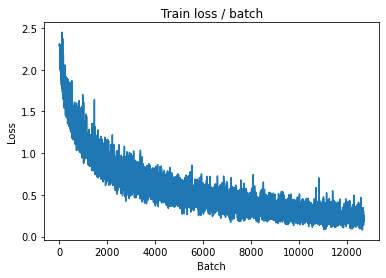


===============> Total time 7s	Avg loss 0.2278	Avg Prec@1 91.99 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7702 (0.7702)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7725	Avg Prec@1 79.66 %	Avg Prec@5 98.66 %



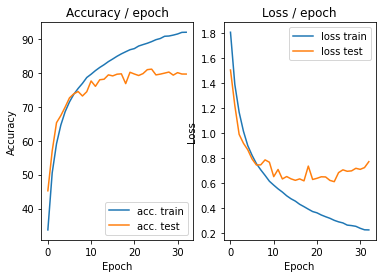

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.2200 (0.2200)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


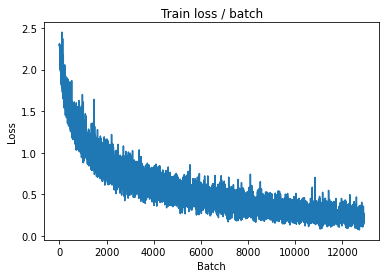

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.1398 (0.2002)	Prec@1  96.9 ( 93.2)	Prec@5 100.0 ( 99.9)


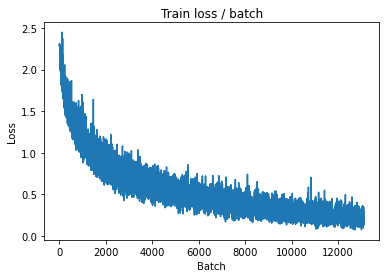


===============> Total time 7s	Avg loss 0.2133	Avg Prec@1 92.67 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.6881 (0.6881)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7297	Avg Prec@1 80.29 %	Avg Prec@5 98.55 %



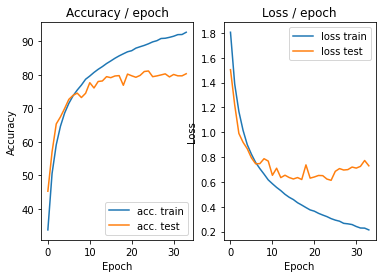

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.297s (0.297s)	Loss 0.1860 (0.1860)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


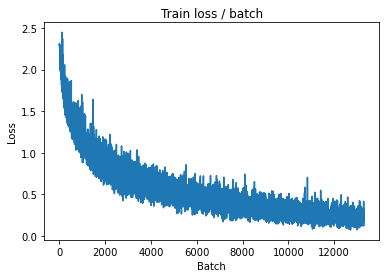

[TRAIN Batch 200/391]	Time 0.029s (0.022s)	Loss 0.1352 (0.1986)	Prec@1  96.1 ( 93.3)	Prec@5 100.0 ( 99.9)


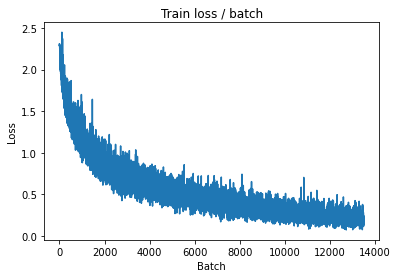


===============> Total time 7s	Avg loss 0.2110	Avg Prec@1 92.82 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.8343 (0.8343)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9440	Avg Prec@1 76.70 %	Avg Prec@5 98.20 %



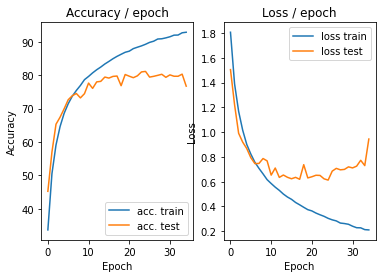

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.4728 (0.4728)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


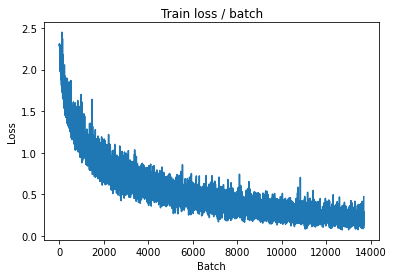

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.2460 (0.2018)	Prec@1  89.8 ( 93.0)	Prec@5 100.0 ( 99.9)


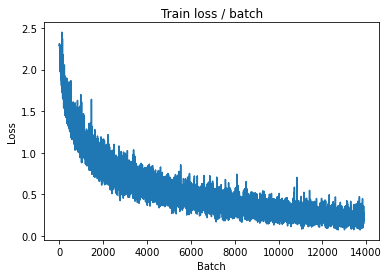


===============> Total time 7s	Avg loss 0.2106	Avg Prec@1 92.68 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.7680 (0.7680)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7550	Avg Prec@1 79.34 %	Avg Prec@5 98.55 %



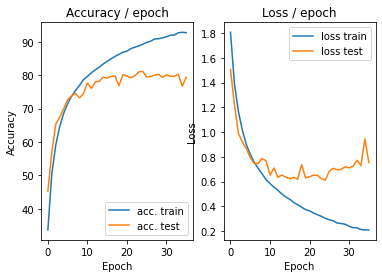

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.2455 (0.2455)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


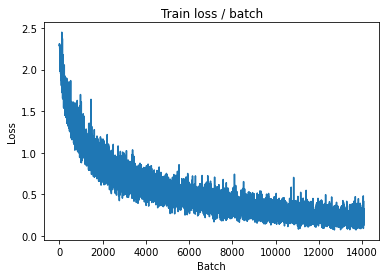

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.2454 (0.1915)	Prec@1  90.6 ( 93.4)	Prec@5 100.0 ( 99.9)


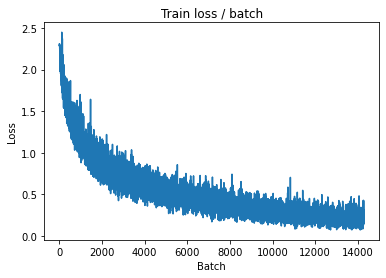


===============> Total time 7s	Avg loss 0.1944	Avg Prec@1 93.24 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.6931 (0.6931)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7511	Avg Prec@1 80.47 %	Avg Prec@5 98.57 %



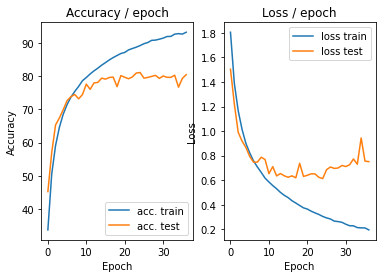

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.1890 (0.1890)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


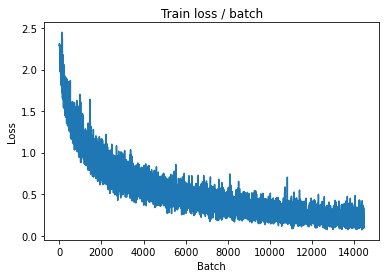

[TRAIN Batch 200/391]	Time 0.032s (0.020s)	Loss 0.1705 (0.1865)	Prec@1  95.3 ( 93.7)	Prec@5 100.0 ( 99.9)


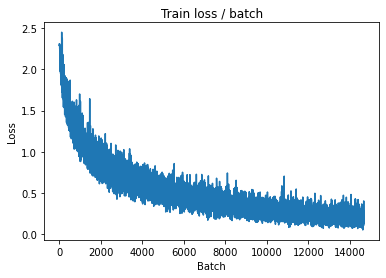


===============> Total time 7s	Avg loss 0.1964	Avg Prec@1 93.28 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.270s (0.270s)	Loss 0.6849 (0.6849)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7629	Avg Prec@1 80.21 %	Avg Prec@5 98.53 %



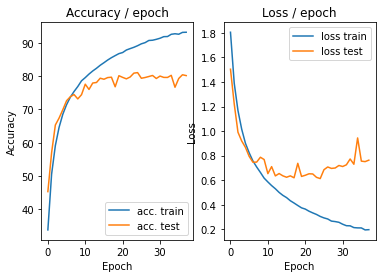

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.2523 (0.2523)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


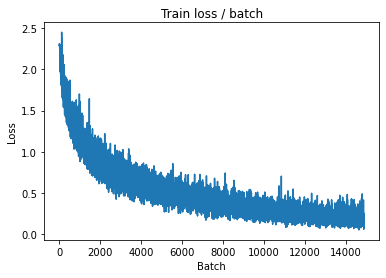

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.1282 (0.1803)	Prec@1  96.1 ( 93.8)	Prec@5 100.0 (100.0)


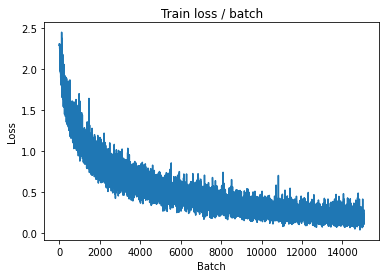


===============> Total time 8s	Avg loss 0.1857	Avg Prec@1 93.59 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.6070 (0.6070)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7528	Avg Prec@1 80.48 %	Avg Prec@5 98.65 %



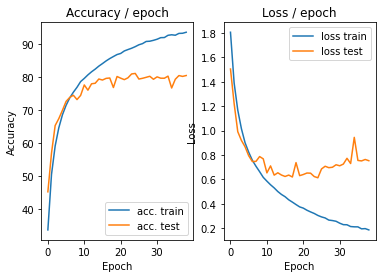

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.1540 (0.1540)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


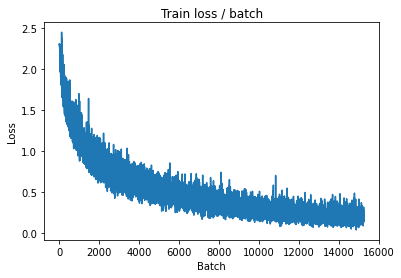

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.2194 (0.1690)	Prec@1  93.8 ( 94.3)	Prec@5 100.0 ( 99.9)


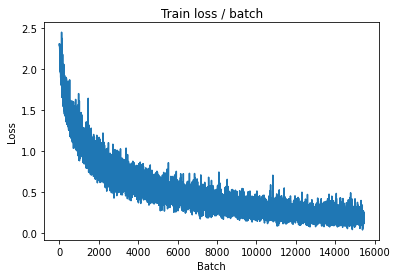


===============> Total time 7s	Avg loss 0.1810	Avg Prec@1 93.78 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.7816 (0.7816)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7439	Avg Prec@1 81.07 %	Avg Prec@5 98.62 %



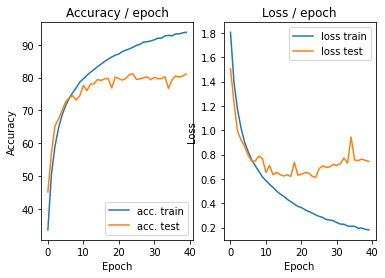

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.2382 (0.2382)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


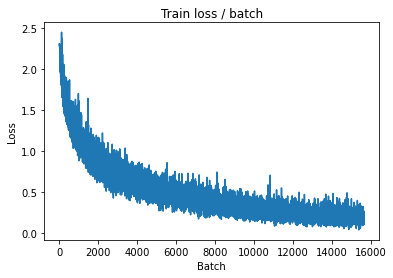

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1686 (0.1685)	Prec@1  95.3 ( 94.3)	Prec@5 100.0 (100.0)


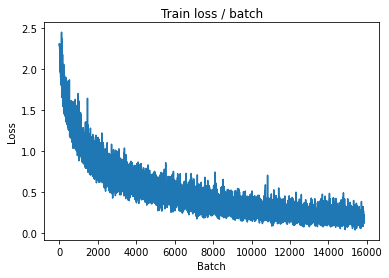


===============> Total time 7s	Avg loss 0.1683	Avg Prec@1 94.13 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 0.9296 (0.9296)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8150	Avg Prec@1 79.70 %	Avg Prec@5 98.55 %



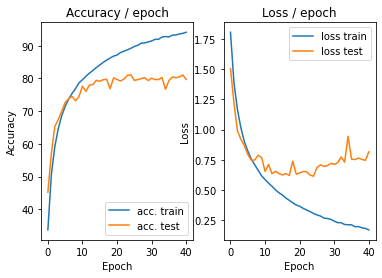

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.2168 (0.2168)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


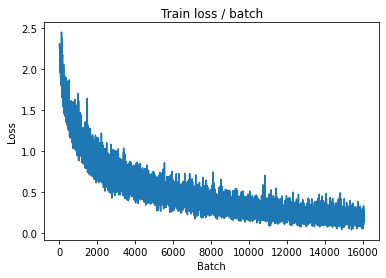

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.1552 (0.1624)	Prec@1  93.8 ( 94.3)	Prec@5 100.0 (100.0)


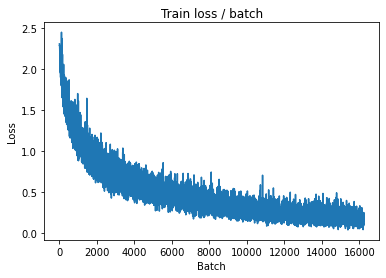


===============> Total time 7s	Avg loss 0.1684	Avg Prec@1 94.10 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.9379 (0.9379)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7838	Avg Prec@1 80.99 %	Avg Prec@5 98.56 %



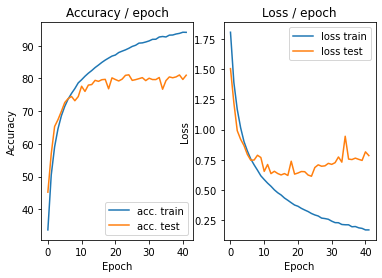

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.1054 (0.1054)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


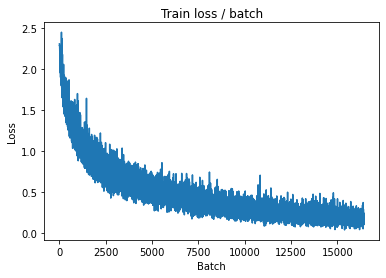

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.1506 (0.1575)	Prec@1  93.8 ( 94.5)	Prec@5 100.0 (100.0)


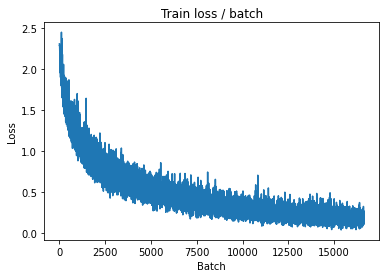


===============> Total time 7s	Avg loss 0.1671	Avg Prec@1 94.30 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.8985 (0.8985)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7661	Avg Prec@1 81.02 %	Avg Prec@5 98.80 %



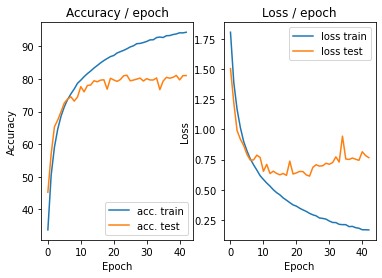

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.1829 (0.1829)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


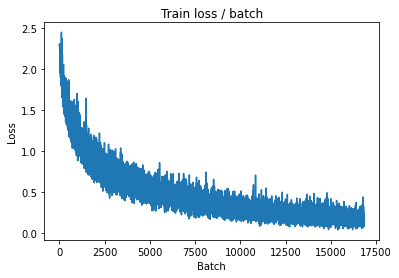

[TRAIN Batch 200/391]	Time 0.034s (0.019s)	Loss 0.1382 (0.1565)	Prec@1  93.8 ( 94.6)	Prec@5 100.0 ( 99.9)


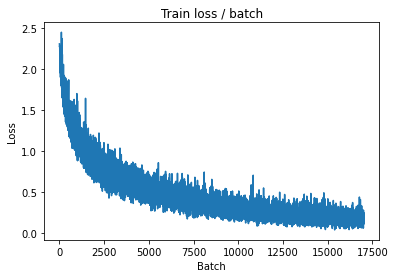


===============> Total time 7s	Avg loss 0.1635	Avg Prec@1 94.40 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.7881 (0.7881)	Prec@1  85.2 ( 85.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7834	Avg Prec@1 80.67 %	Avg Prec@5 98.55 %



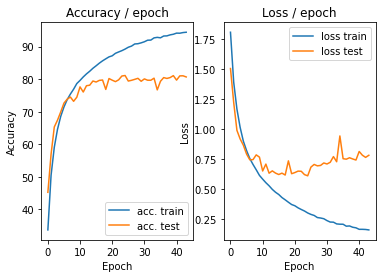

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.0632 (0.0632)	Prec@1  98.4 ( 98.4)	Prec@5 100.0 (100.0)


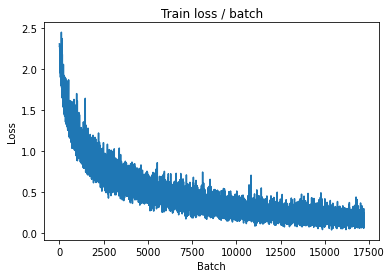

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.1546 (0.1553)	Prec@1  95.3 ( 94.6)	Prec@5 100.0 (100.0)


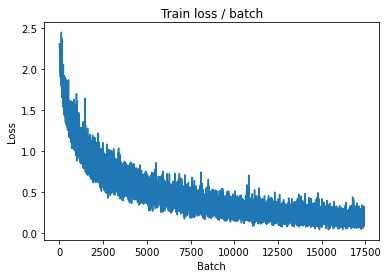


===============> Total time 8s	Avg loss 0.1563	Avg Prec@1 94.49 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.9186 (0.9186)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8548	Avg Prec@1 80.28 %	Avg Prec@5 98.60 %



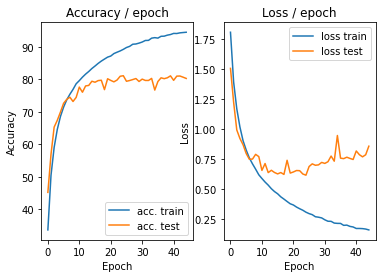

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.282s (0.282s)	Loss 0.1771 (0.1771)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


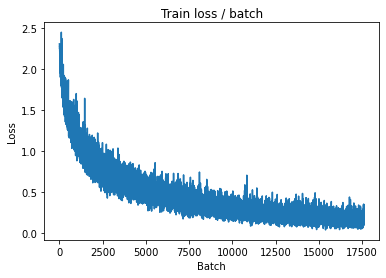

[TRAIN Batch 200/391]	Time 0.029s (0.022s)	Loss 0.1663 (0.1483)	Prec@1  91.4 ( 95.0)	Prec@5 100.0 (100.0)


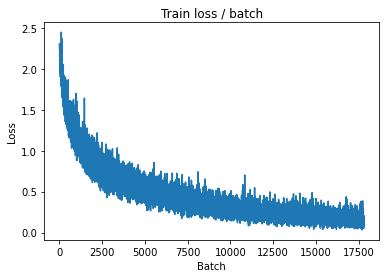


===============> Total time 7s	Avg loss 0.1540	Avg Prec@1 94.72 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.8372 (0.8372)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8137	Avg Prec@1 80.69 %	Avg Prec@5 98.83 %



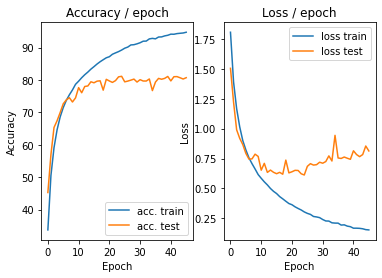

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.1652 (0.1652)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


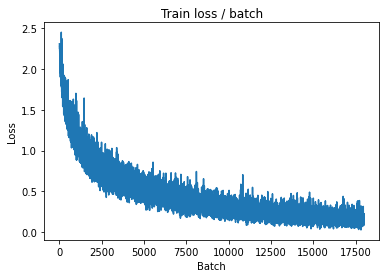

[TRAIN Batch 200/391]	Time 0.031s (0.022s)	Loss 0.1416 (0.1336)	Prec@1  96.9 ( 95.4)	Prec@5  99.2 (100.0)


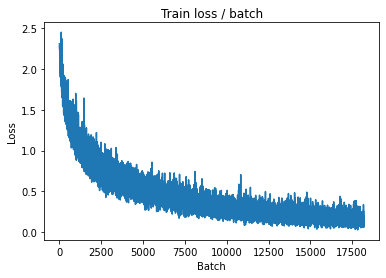


===============> Total time 7s	Avg loss 0.1468	Avg Prec@1 94.91 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.6695 (0.6695)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8458	Avg Prec@1 80.29 %	Avg Prec@5 98.52 %



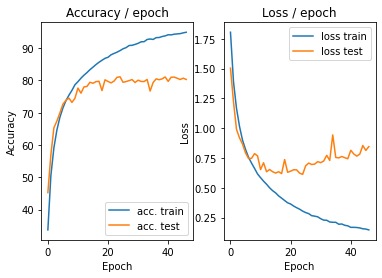

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.1072 (0.1072)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


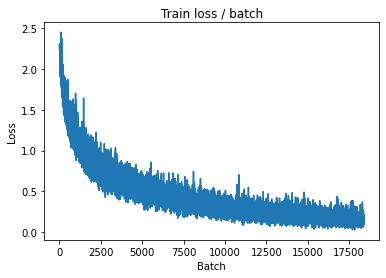

[TRAIN Batch 200/391]	Time 0.023s (0.019s)	Loss 0.1332 (0.1387)	Prec@1  95.3 ( 95.2)	Prec@5 100.0 (100.0)


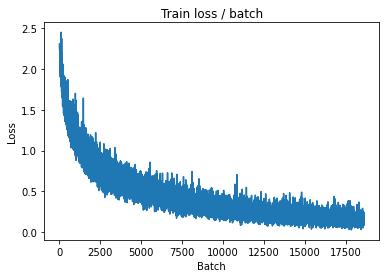


===============> Total time 7s	Avg loss 0.1437	Avg Prec@1 95.05 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.7998 (0.7998)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9925	Avg Prec@1 78.42 %	Avg Prec@5 98.05 %



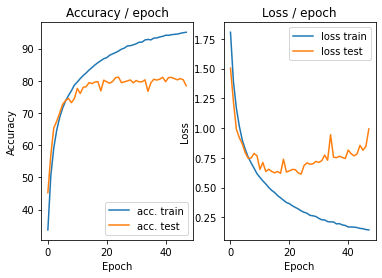

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.4892 (0.4892)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)


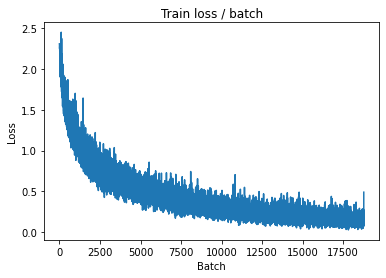

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.1760 (0.1456)	Prec@1  95.3 ( 94.9)	Prec@5 100.0 (100.0)


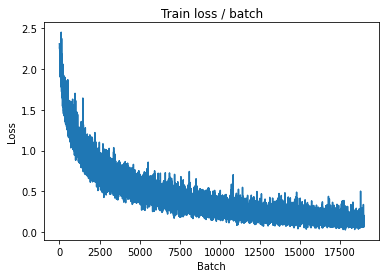


===============> Total time 7s	Avg loss 0.1471	Avg Prec@1 94.93 %	Avg Prec@5 99.96 %

[EVAL Batch 000/079]	Time 0.293s (0.293s)	Loss 0.8907 (0.8907)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8588	Avg Prec@1 81.07 %	Avg Prec@5 98.67 %



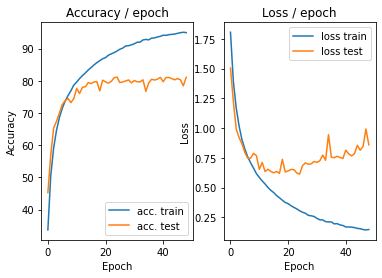

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.1558 (0.1558)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


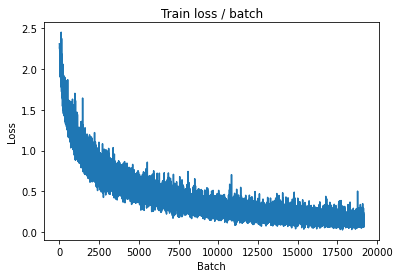

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.0909 (0.1299)	Prec@1  97.7 ( 95.4)	Prec@5 100.0 (100.0)


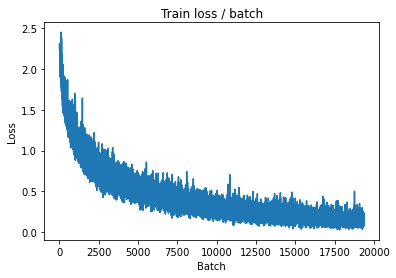


===============> Total time 8s	Avg loss 0.1346	Avg Prec@1 95.26 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7750 (0.7750)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8450	Avg Prec@1 80.68 %	Avg Prec@5 98.67 %



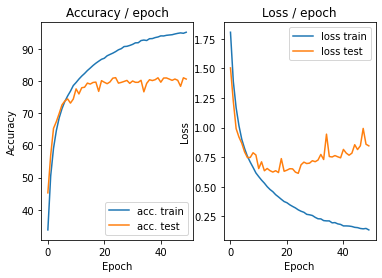

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.1046 (0.1046)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


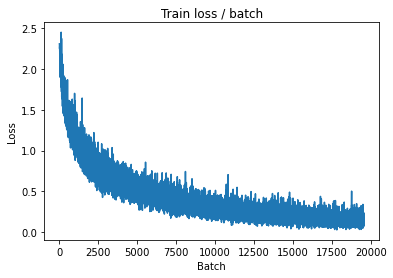

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.0809 (0.1283)	Prec@1  97.7 ( 95.6)	Prec@5  99.2 (100.0)


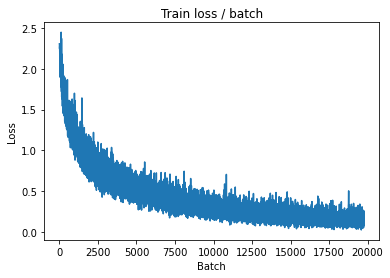


===============> Total time 7s	Avg loss 0.1357	Avg Prec@1 95.30 %	Avg Prec@5 99.97 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.7959 (0.7959)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8196	Avg Prec@1 82.02 %	Avg Prec@5 98.47 %



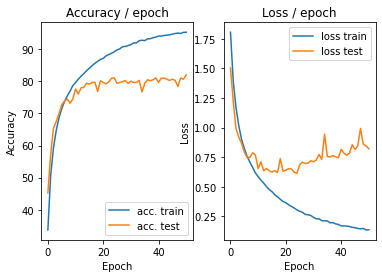

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.0723 (0.0723)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


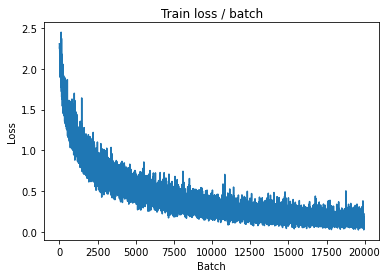

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.1384 (0.1258)	Prec@1  93.0 ( 95.6)	Prec@5 100.0 (100.0)


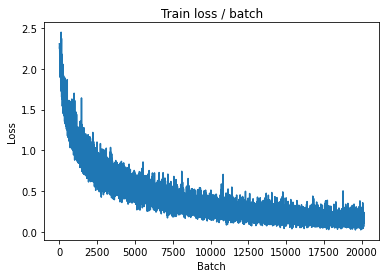


===============> Total time 7s	Avg loss 0.1271	Avg Prec@1 95.56 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.7278 (0.7278)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8510	Avg Prec@1 80.82 %	Avg Prec@5 98.57 %



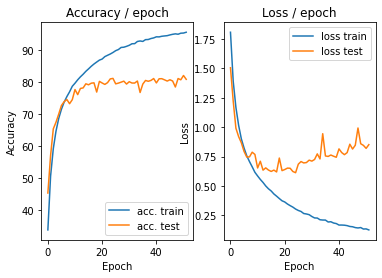

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.1002 (0.1002)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


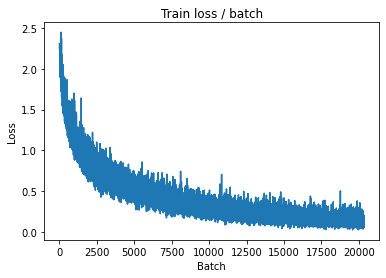

[TRAIN Batch 200/391]	Time 0.030s (0.020s)	Loss 0.1562 (0.1226)	Prec@1  93.8 ( 95.9)	Prec@5 100.0 (100.0)


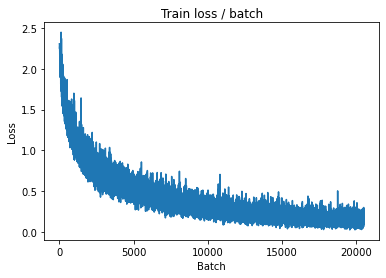


===============> Total time 7s	Avg loss 0.1298	Avg Prec@1 95.47 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.9200 (0.9200)	Prec@1  85.2 ( 85.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.8815	Avg Prec@1 80.86 %	Avg Prec@5 98.60 %



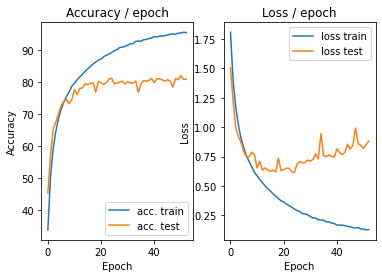

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.1371 (0.1371)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


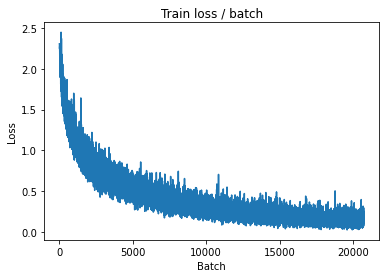

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.1353 (0.1189)	Prec@1  94.5 ( 95.8)	Prec@5 100.0 (100.0)


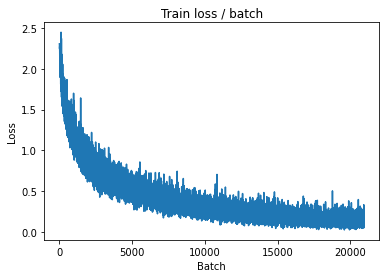


===============> Total time 7s	Avg loss 0.1228	Avg Prec@1 95.73 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.7867 (0.7867)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8526	Avg Prec@1 81.66 %	Avg Prec@5 98.60 %



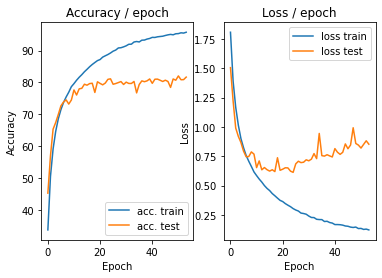

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.0341 (0.0341)	Prec@1  99.2 ( 99.2)	Prec@5 100.0 (100.0)


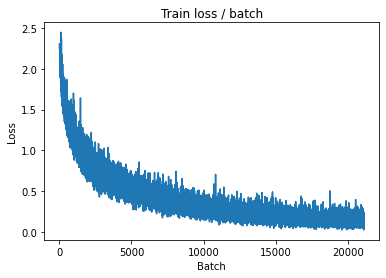

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.1019 (0.1080)	Prec@1  96.9 ( 96.3)	Prec@5 100.0 (100.0)


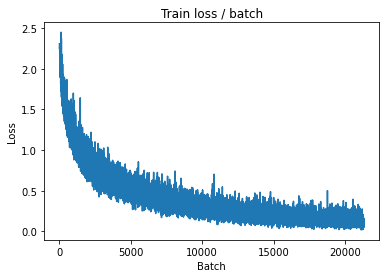


===============> Total time 7s	Avg loss 0.1153	Avg Prec@1 96.07 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.8385 (0.8385)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9207	Avg Prec@1 80.75 %	Avg Prec@5 98.50 %



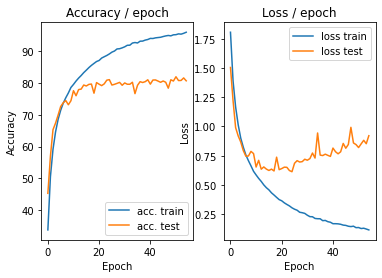

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.0841 (0.0841)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


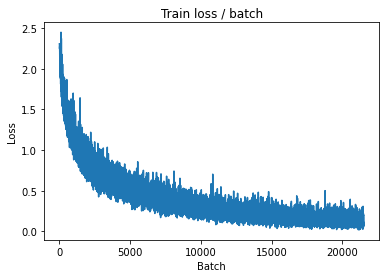

[TRAIN Batch 200/391]	Time 0.006s (0.021s)	Loss 0.1133 (0.1137)	Prec@1  97.7 ( 96.2)	Prec@5 100.0 (100.0)


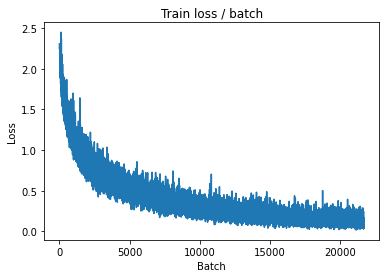


===============> Total time 8s	Avg loss 0.1165	Avg Prec@1 96.11 %	Avg Prec@5 99.99 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.9846 (0.9846)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9330	Avg Prec@1 81.06 %	Avg Prec@5 98.54 %



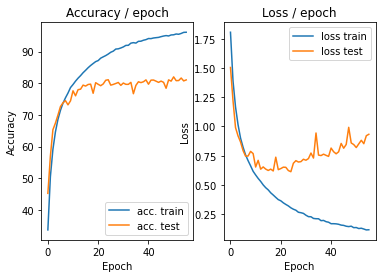

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.270s (0.270s)	Loss 0.0768 (0.0768)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


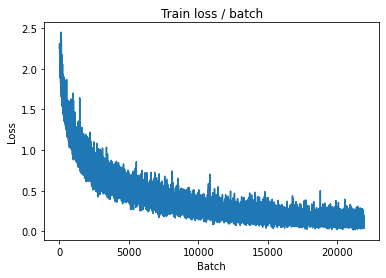

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.1490 (0.1137)	Prec@1  94.5 ( 96.1)	Prec@5 100.0 (100.0)


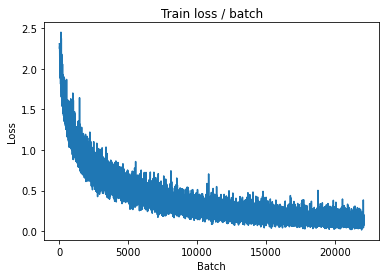


===============> Total time 7s	Avg loss 0.1147	Avg Prec@1 96.05 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.8963 (0.8963)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.8786	Avg Prec@1 80.94 %	Avg Prec@5 98.54 %



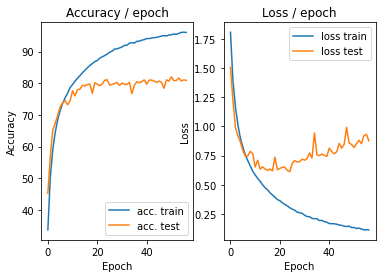

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.1149 (0.1149)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


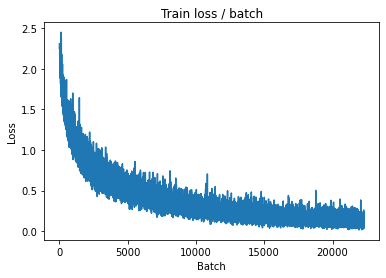

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.1163 (0.1049)	Prec@1  96.1 ( 96.5)	Prec@5 100.0 (100.0)


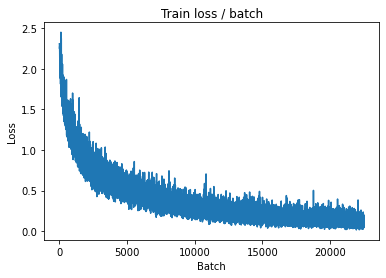


===============> Total time 8s	Avg loss 0.1093	Avg Prec@1 96.31 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.0122 (1.0122)	Prec@1  82.0 ( 82.0)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.9156	Avg Prec@1 81.40 %	Avg Prec@5 98.47 %



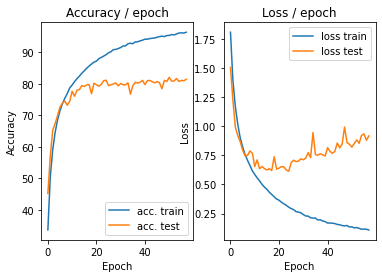

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.1264 (0.1264)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


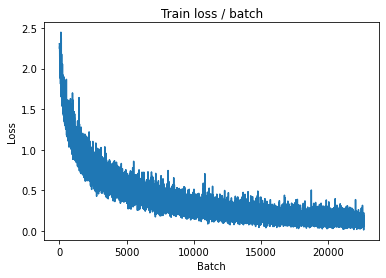

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.0615 (0.1059)	Prec@1  98.4 ( 96.4)	Prec@5 100.0 (100.0)


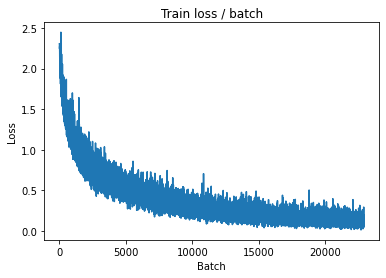


===============> Total time 7s	Avg loss 0.1115	Avg Prec@1 96.24 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8738 (0.8738)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8784	Avg Prec@1 81.32 %	Avg Prec@5 98.53 %



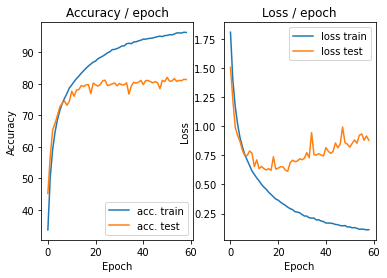

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.1199 (0.1199)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


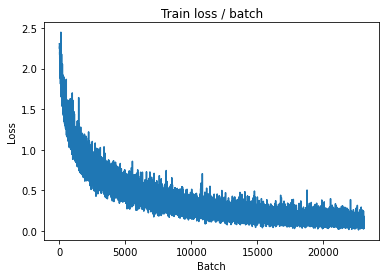

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.1326 (0.1034)	Prec@1  94.5 ( 96.5)	Prec@5 100.0 (100.0)


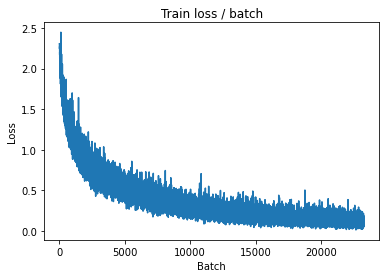


===============> Total time 8s	Avg loss 0.1087	Avg Prec@1 96.35 %	Avg Prec@5 99.98 %

[EVAL Batch 000/079]	Time 0.287s (0.287s)	Loss 0.7981 (0.7981)	Prec@1  84.4 ( 84.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9135	Avg Prec@1 80.61 %	Avg Prec@5 98.19 %



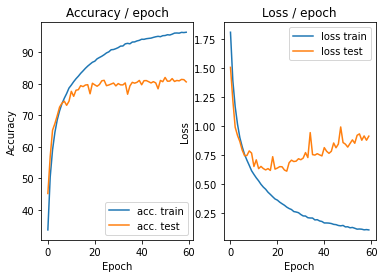

In [27]:
main(128, 0.1,60, cuda=True)

ADAM

In [37]:
def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}
    
    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.Adam(model.parameters(), lr)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.156s (0.156s)	Loss 2.3097 (2.3097)	Prec@1   4.7 (  4.7)	Prec@5  43.0 ( 43.0)


<Figure size 432x288 with 0 Axes>

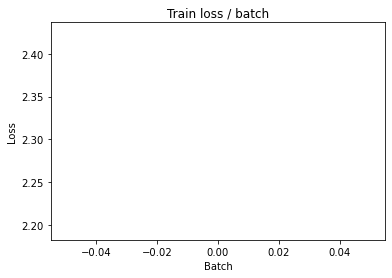

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 1.4272 (1.6670)	Prec@1  43.0 ( 38.4)	Prec@5  93.0 ( 87.3)


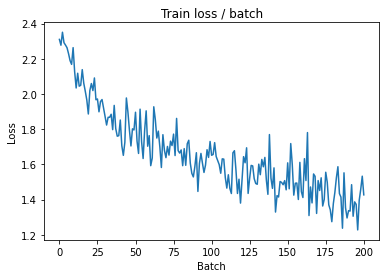


===============> Total time 7s	Avg loss 1.4818	Avg Prec@1 45.78 %	Avg Prec@5 90.79 %

[EVAL Batch 000/079]	Time 0.269s (0.269s)	Loss 1.2140 (1.2140)	Prec@1  61.7 ( 61.7)	Prec@5  93.0 ( 93.0)

===============> Total time 1s	Avg loss 1.1753	Avg Prec@1 58.43 %	Avg Prec@5 95.54 %



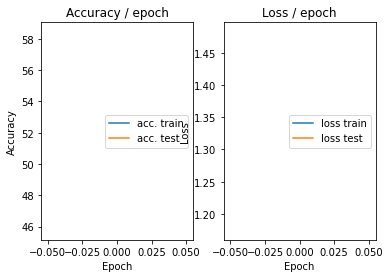

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 1.1727 (1.1727)	Prec@1  61.7 ( 61.7)	Prec@5  94.5 ( 94.5)


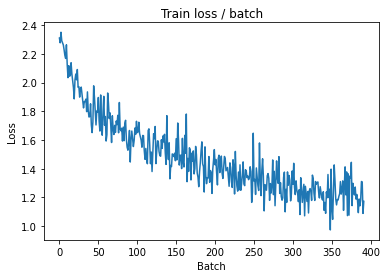

[TRAIN Batch 200/391]	Time 0.018s (0.019s)	Loss 1.0767 (1.1358)	Prec@1  60.9 ( 59.8)	Prec@5  96.1 ( 95.7)


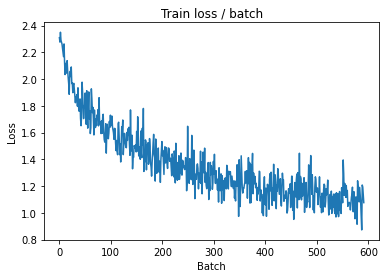


===============> Total time 7s	Avg loss 1.0886	Avg Prec@1 61.62 %	Avg Prec@5 95.96 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.9495 (0.9495)	Prec@1  70.3 ( 70.3)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 0.9882	Avg Prec@1 65.20 %	Avg Prec@5 97.26 %



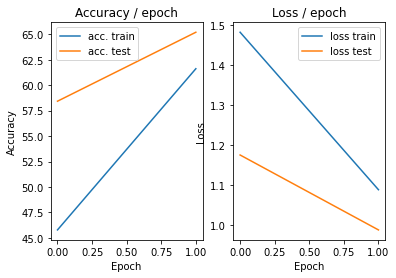

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.8566 (0.8566)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


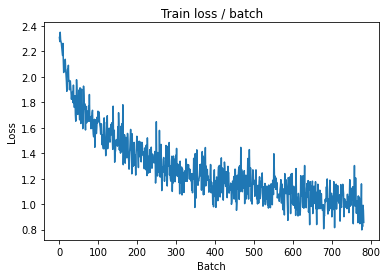

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.8566 (0.9339)	Prec@1  74.2 ( 67.1)	Prec@5  98.4 ( 97.2)


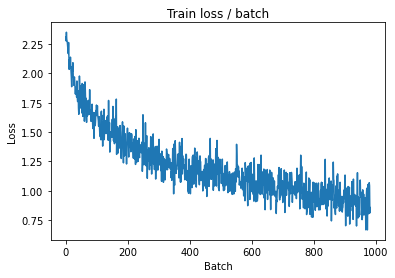


===============> Total time 7s	Avg loss 0.9190	Avg Prec@1 67.69 %	Avg Prec@5 97.36 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.7734 (0.7734)	Prec@1  71.1 ( 71.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8765	Avg Prec@1 69.36 %	Avg Prec@5 97.68 %



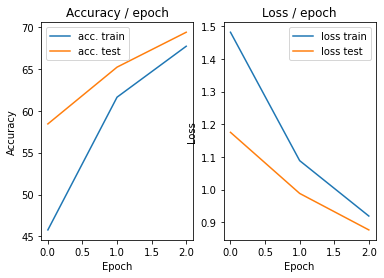

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.8758 (0.8758)	Prec@1  71.9 ( 71.9)	Prec@5  98.4 ( 98.4)


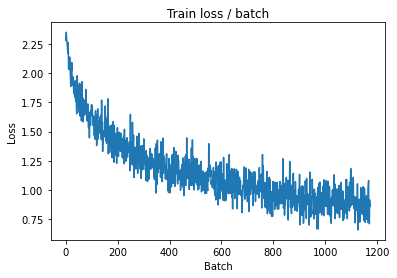

[TRAIN Batch 200/391]	Time 0.027s (0.021s)	Loss 0.7306 (0.8328)	Prec@1  75.0 ( 70.7)	Prec@5  99.2 ( 97.7)


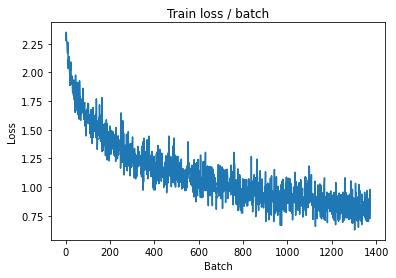


===============> Total time 7s	Avg loss 0.8181	Avg Prec@1 71.25 %	Avg Prec@5 97.79 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.8216 (0.8216)	Prec@1  73.4 ( 73.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8129	Avg Prec@1 71.64 %	Avg Prec@5 97.72 %



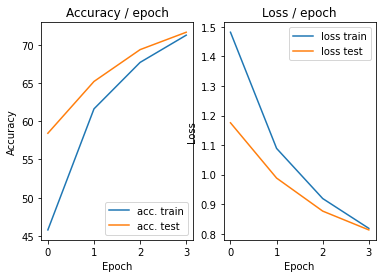

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.121s (0.121s)	Loss 0.6340 (0.6340)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


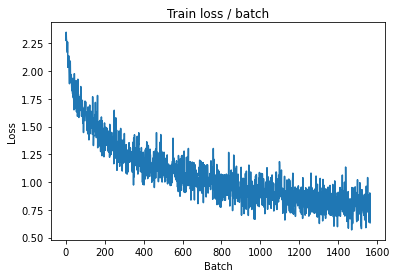

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.6752 (0.7510)	Prec@1  80.5 ( 74.1)	Prec@5  97.7 ( 98.1)


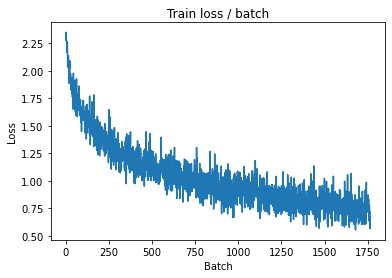


===============> Total time 7s	Avg loss 0.7469	Avg Prec@1 73.97 %	Avg Prec@5 98.15 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.6889 (0.6889)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7567	Avg Prec@1 73.86 %	Avg Prec@5 98.09 %



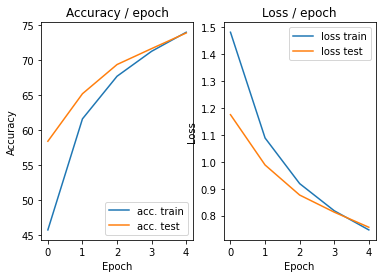

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.5595 (0.5595)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)


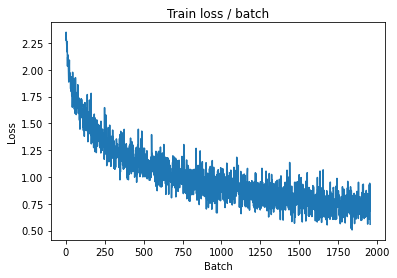

[TRAIN Batch 200/391]	Time 0.031s (0.019s)	Loss 0.6811 (0.6914)	Prec@1  73.4 ( 75.6)	Prec@5  99.2 ( 98.6)


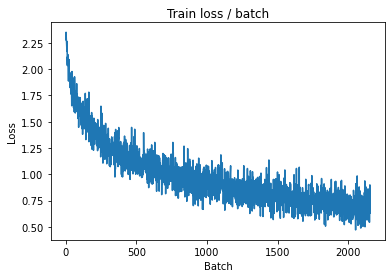


===============> Total time 7s	Avg loss 0.6922	Avg Prec@1 75.67 %	Avg Prec@5 98.60 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.7040 (0.7040)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7453	Avg Prec@1 74.19 %	Avg Prec@5 98.22 %



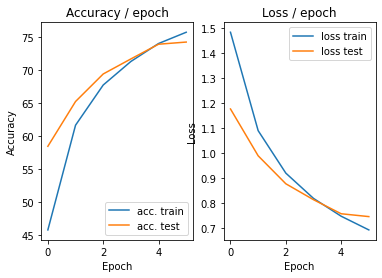

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.6530 (0.6530)	Prec@1  73.4 ( 73.4)	Prec@5 100.0 (100.0)


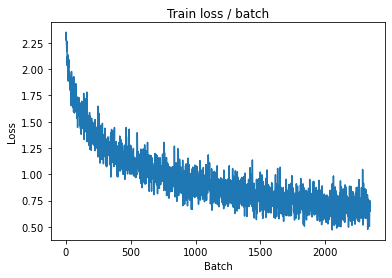

[TRAIN Batch 200/391]	Time 0.034s (0.021s)	Loss 0.6761 (0.6505)	Prec@1  75.8 ( 77.3)	Prec@5  98.4 ( 98.7)


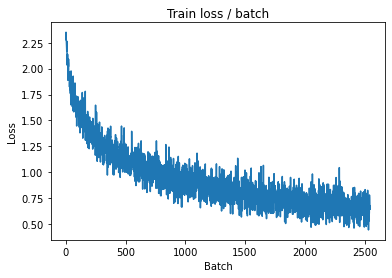


===============> Total time 8s	Avg loss 0.6484	Avg Prec@1 77.34 %	Avg Prec@5 98.62 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.6512 (0.6512)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7158	Avg Prec@1 75.48 %	Avg Prec@5 98.43 %



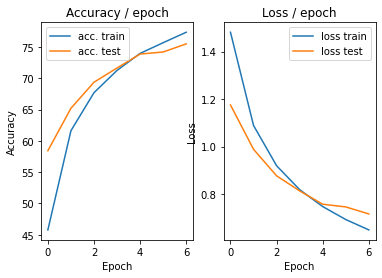

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.4536 (0.4536)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


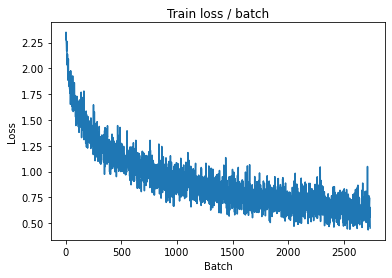

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 0.6623 (0.6095)	Prec@1  75.0 ( 78.6)	Prec@5  99.2 ( 98.9)


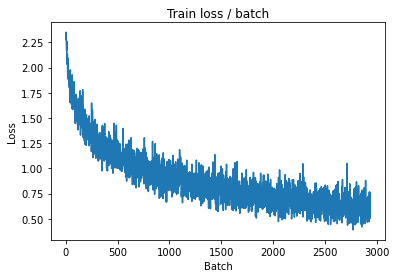


===============> Total time 7s	Avg loss 0.6114	Avg Prec@1 78.60 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.6272 (0.6272)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6752	Avg Prec@1 77.05 %	Avg Prec@5 98.55 %



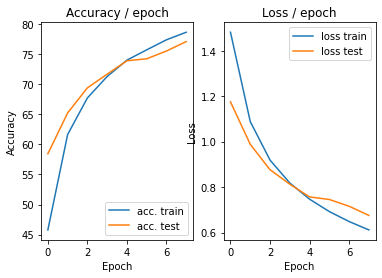

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.260s (0.260s)	Loss 0.6401 (0.6401)	Prec@1  78.1 ( 78.1)	Prec@5  99.2 ( 99.2)


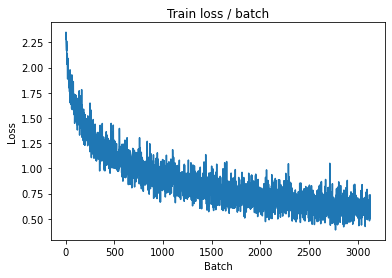

[TRAIN Batch 200/391]	Time 0.028s (0.022s)	Loss 0.6667 (0.5831)	Prec@1  78.9 ( 79.4)	Prec@5  98.4 ( 98.9)


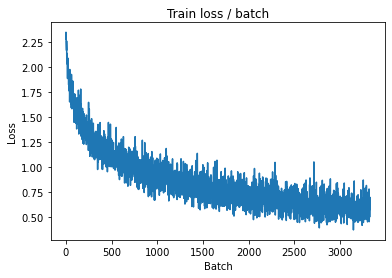


===============> Total time 7s	Avg loss 0.5797	Avg Prec@1 79.66 %	Avg Prec@5 98.88 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.6359 (0.6359)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6677	Avg Prec@1 76.98 %	Avg Prec@5 98.56 %



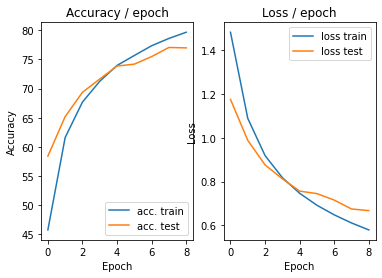

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.4972 (0.4972)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)


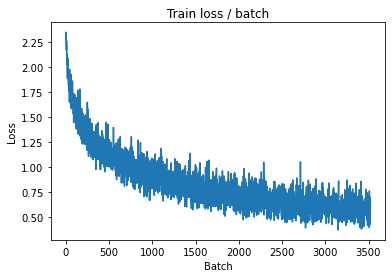

[TRAIN Batch 200/391]	Time 0.032s (0.022s)	Loss 0.6375 (0.5345)	Prec@1  75.0 ( 81.3)	Prec@5  98.4 ( 99.2)


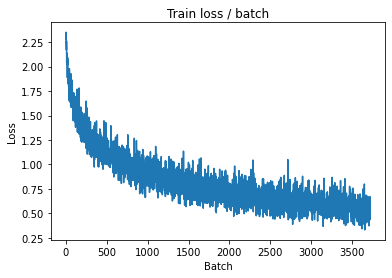


===============> Total time 8s	Avg loss 0.5454	Avg Prec@1 80.90 %	Avg Prec@5 99.13 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.5806 (0.5806)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6692	Avg Prec@1 77.64 %	Avg Prec@5 98.35 %



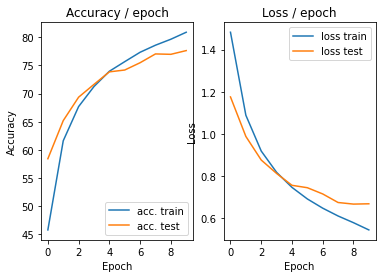

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.5385 (0.5385)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)


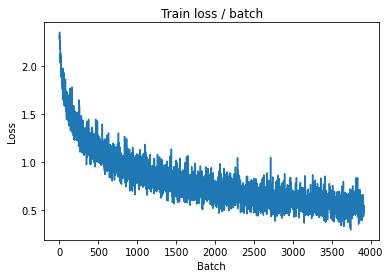

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.4806 (0.5122)	Prec@1  85.9 ( 82.1)	Prec@5  98.4 ( 99.2)


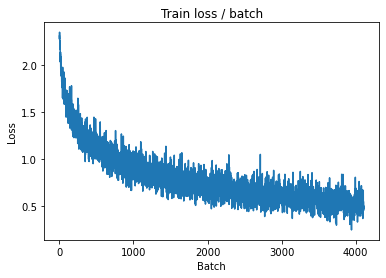


===============> Total time 7s	Avg loss 0.5191	Avg Prec@1 81.87 %	Avg Prec@5 99.21 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.6160 (0.6160)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6705	Avg Prec@1 77.64 %	Avg Prec@5 98.61 %



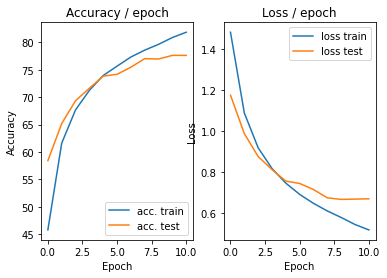

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.4513 (0.4513)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


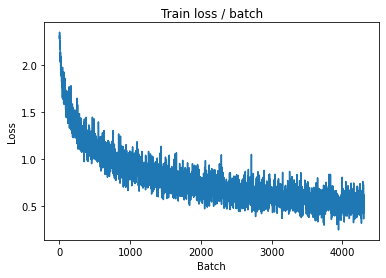

[TRAIN Batch 200/391]	Time 0.031s (0.019s)	Loss 0.4057 (0.4833)	Prec@1  87.5 ( 82.9)	Prec@5  99.2 ( 99.3)


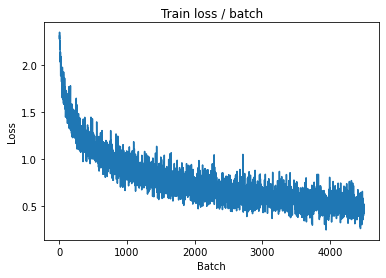


===============> Total time 7s	Avg loss 0.4943	Avg Prec@1 82.59 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.268s (0.268s)	Loss 0.6050 (0.6050)	Prec@1  80.5 ( 80.5)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6656	Avg Prec@1 78.04 %	Avg Prec@5 98.58 %



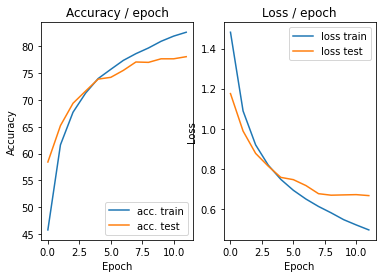

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.4123 (0.4123)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


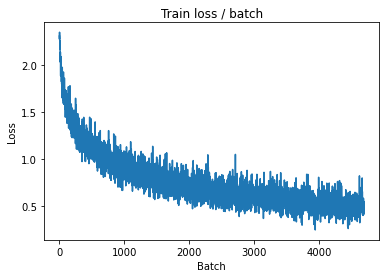

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.4346 (0.4665)	Prec@1  87.5 ( 83.6)	Prec@5  99.2 ( 99.4)


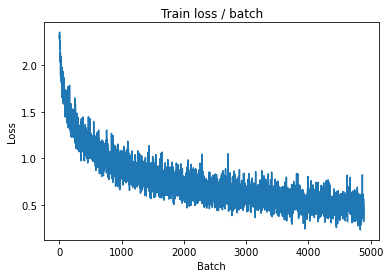


===============> Total time 7s	Avg loss 0.4763	Avg Prec@1 83.33 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.6766 (0.6766)	Prec@1  82.8 ( 82.8)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 0.6647	Avg Prec@1 78.37 %	Avg Prec@5 98.49 %



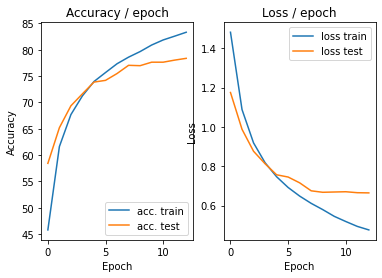

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.4270 (0.4270)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)


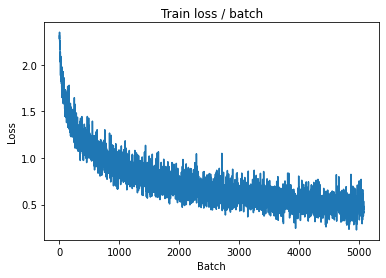

[TRAIN Batch 200/391]	Time 0.019s (0.019s)	Loss 0.2740 (0.4580)	Prec@1  90.6 ( 84.0)	Prec@5 100.0 ( 99.4)


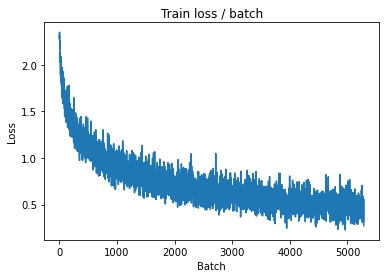


===============> Total time 7s	Avg loss 0.4626	Avg Prec@1 83.90 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.6547 (0.6547)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6396	Avg Prec@1 79.31 %	Avg Prec@5 98.77 %



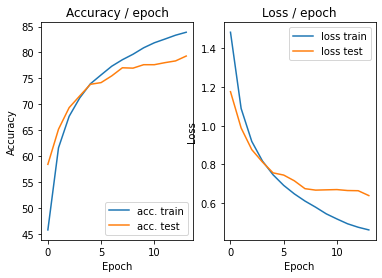

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4041 (0.4041)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


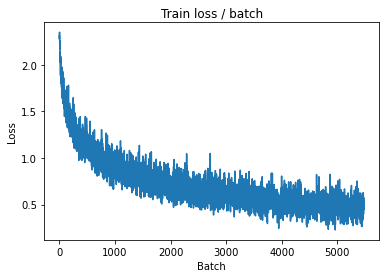

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.3310 (0.4293)	Prec@1  93.0 ( 84.9)	Prec@5  99.2 ( 99.5)


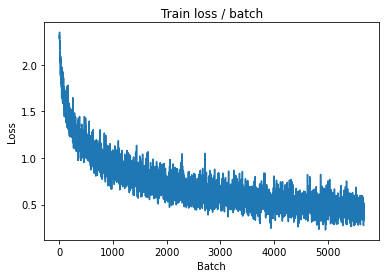


===============> Total time 7s	Avg loss 0.4368	Avg Prec@1 84.67 %	Avg Prec@5 99.45 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.7122 (0.7122)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6497	Avg Prec@1 78.81 %	Avg Prec@5 98.45 %



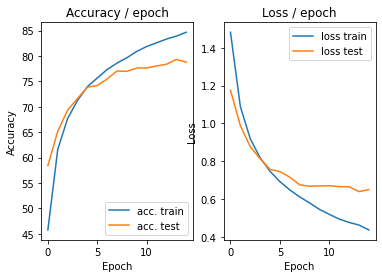

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.5334 (0.5334)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)


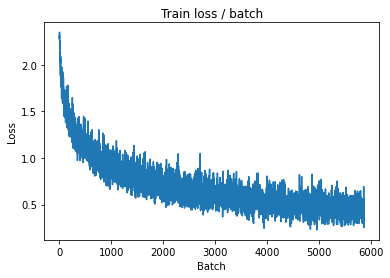

[TRAIN Batch 200/391]	Time 0.030s (0.020s)	Loss 0.3515 (0.4117)	Prec@1  88.3 ( 85.5)	Prec@5 100.0 ( 99.5)


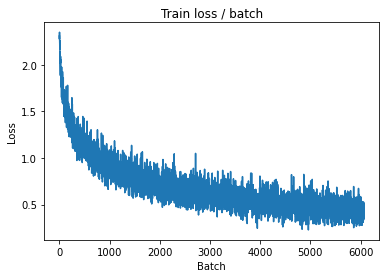


===============> Total time 7s	Avg loss 0.4171	Avg Prec@1 85.42 %	Avg Prec@5 99.52 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.5769 (0.5769)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6659	Avg Prec@1 79.09 %	Avg Prec@5 98.55 %



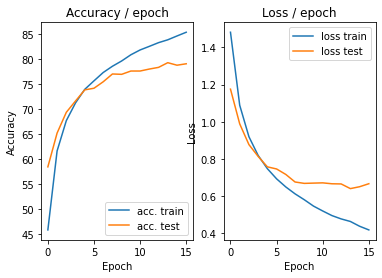

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.4030 (0.4030)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


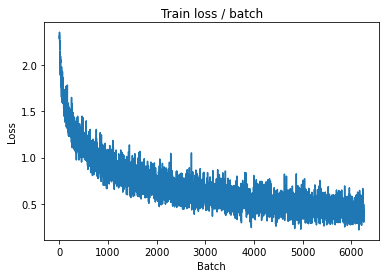

[TRAIN Batch 200/391]	Time 0.029s (0.021s)	Loss 0.6226 (0.3969)	Prec@1  82.8 ( 86.1)	Prec@5 100.0 ( 99.7)


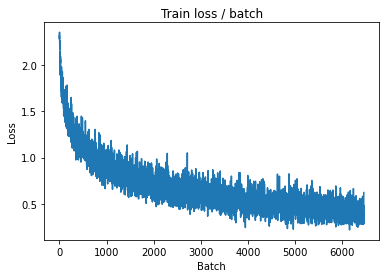


===============> Total time 7s	Avg loss 0.4059	Avg Prec@1 85.80 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.6776 (0.6776)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6372	Avg Prec@1 78.99 %	Avg Prec@5 98.63 %



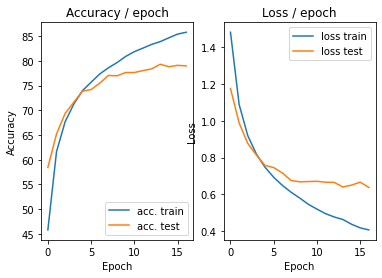

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.3299 (0.3299)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


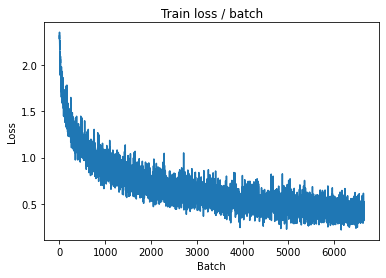

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.4423 (0.3767)	Prec@1  82.8 ( 86.9)	Prec@5  99.2 ( 99.6)


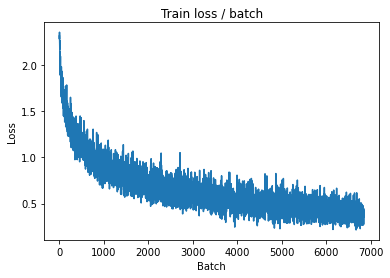


===============> Total time 7s	Avg loss 0.3872	Avg Prec@1 86.44 %	Avg Prec@5 99.57 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.6869 (0.6869)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6800	Avg Prec@1 78.41 %	Avg Prec@5 98.65 %



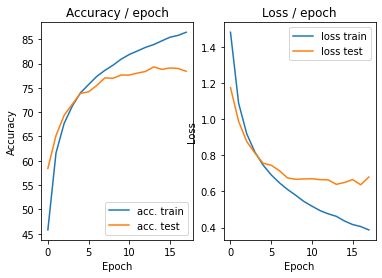

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.3607 (0.3607)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


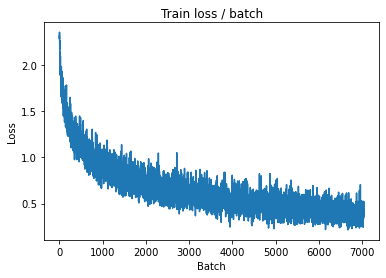

[TRAIN Batch 200/391]	Time 0.027s (0.018s)	Loss 0.3629 (0.3667)	Prec@1  86.7 ( 87.3)	Prec@5  99.2 ( 99.7)


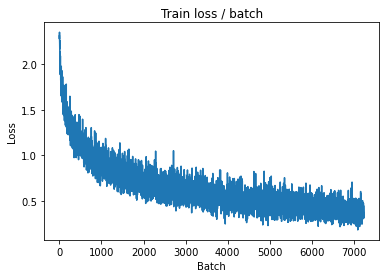


===============> Total time 7s	Avg loss 0.3787	Avg Prec@1 86.76 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.7852 (0.7852)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7151	Avg Prec@1 77.73 %	Avg Prec@5 98.65 %



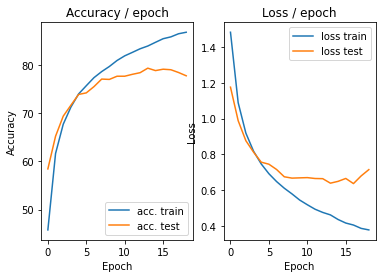

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.277s (0.277s)	Loss 0.4063 (0.4063)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


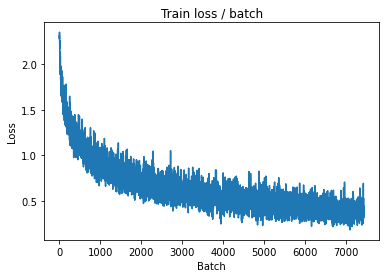

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.3744 (0.3584)	Prec@1  85.2 ( 87.5)	Prec@5 100.0 ( 99.7)


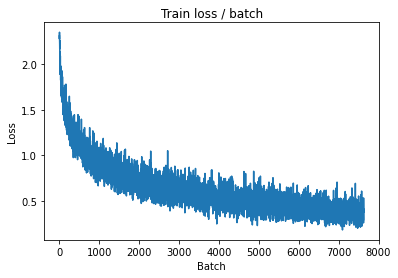


===============> Total time 7s	Avg loss 0.3627	Avg Prec@1 87.29 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.5929 (0.5929)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6779	Avg Prec@1 79.44 %	Avg Prec@5 98.52 %



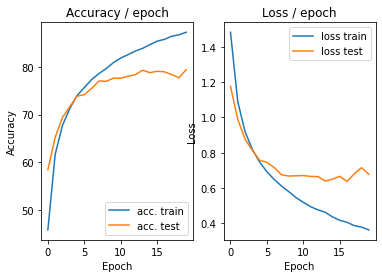

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.4765 (0.4765)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


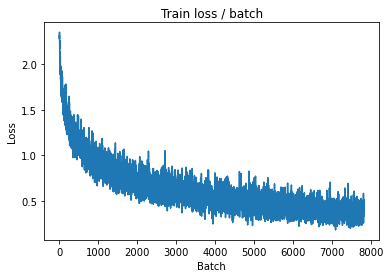

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.2858 (0.3377)	Prec@1  89.1 ( 88.1)	Prec@5 100.0 ( 99.8)


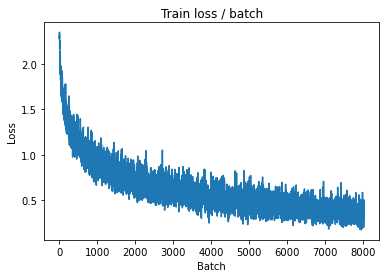


===============> Total time 7s	Avg loss 0.3578	Avg Prec@1 87.50 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.6783 (0.6783)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7266	Avg Prec@1 78.78 %	Avg Prec@5 98.32 %



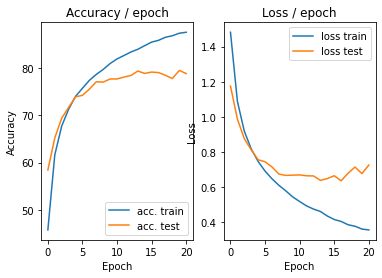

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.2593 (0.2593)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


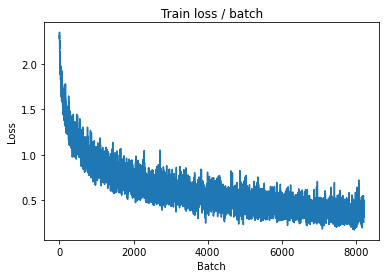

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3209 (0.3370)	Prec@1  86.7 ( 88.1)	Prec@5 100.0 ( 99.7)


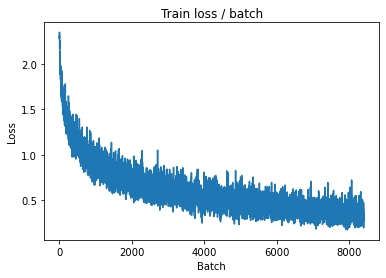


===============> Total time 7s	Avg loss 0.3422	Avg Prec@1 88.12 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.5978 (0.5978)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6796	Avg Prec@1 79.59 %	Avg Prec@5 98.53 %



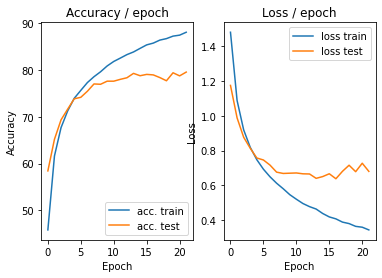

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.2869 (0.2869)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


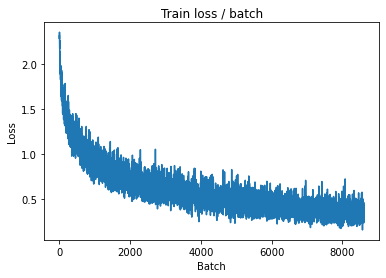

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.2950 (0.3269)	Prec@1  89.8 ( 88.5)	Prec@5  99.2 ( 99.7)


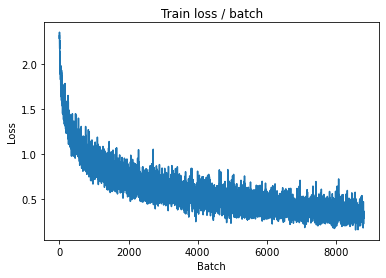


===============> Total time 7s	Avg loss 0.3318	Avg Prec@1 88.47 %	Avg Prec@5 99.73 %

[EVAL Batch 000/079]	Time 0.275s (0.275s)	Loss 0.6281 (0.6281)	Prec@1  85.9 ( 85.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6907	Avg Prec@1 80.26 %	Avg Prec@5 98.66 %



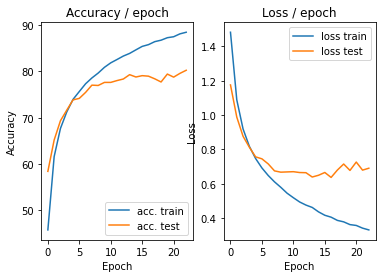

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.2692 (0.2692)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


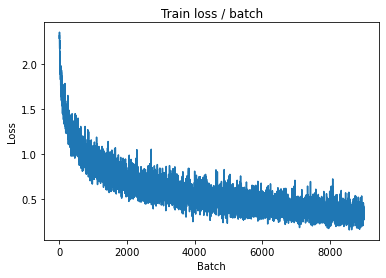

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.3444 (0.3219)	Prec@1  89.1 ( 88.9)	Prec@5 100.0 ( 99.8)


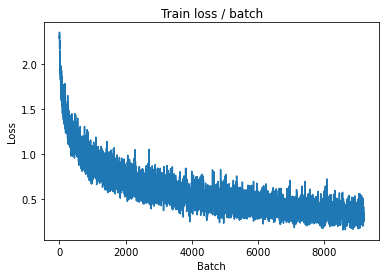


===============> Total time 7s	Avg loss 0.3271	Avg Prec@1 88.66 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.6878 (0.6878)	Prec@1  83.6 ( 83.6)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.6878	Avg Prec@1 80.14 %	Avg Prec@5 98.66 %



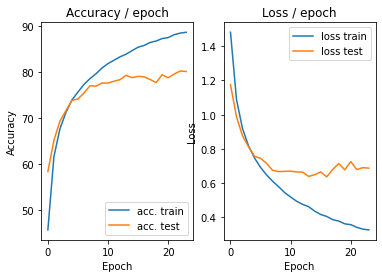

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.2948 (0.2948)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)


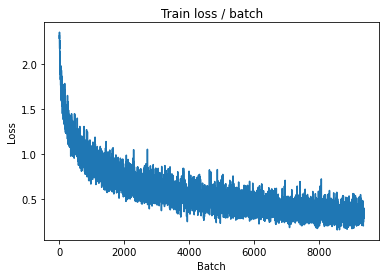

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.4035 (0.3049)	Prec@1  85.2 ( 89.1)	Prec@5 100.0 ( 99.8)


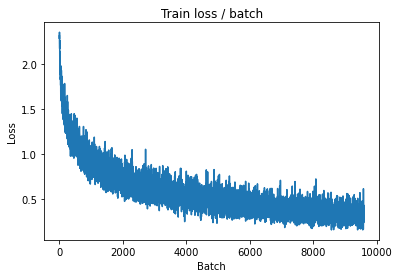


===============> Total time 7s	Avg loss 0.3117	Avg Prec@1 89.03 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.7486 (0.7486)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7023	Avg Prec@1 79.57 %	Avg Prec@5 98.64 %



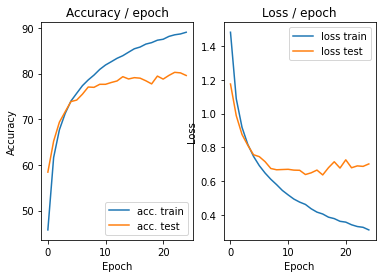

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.3250 (0.3250)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


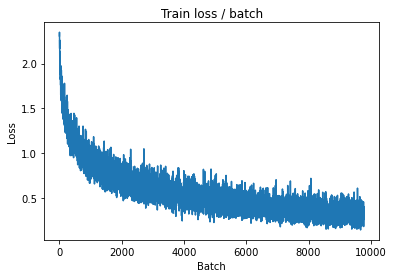

[TRAIN Batch 200/391]	Time 0.007s (0.020s)	Loss 0.4209 (0.2993)	Prec@1  85.2 ( 89.8)	Prec@5  99.2 ( 99.8)


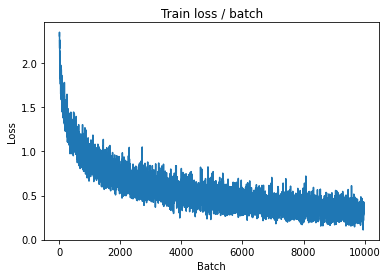


===============> Total time 7s	Avg loss 0.3052	Avg Prec@1 89.41 %	Avg Prec@5 99.81 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.7931 (0.7931)	Prec@1  76.6 ( 76.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.7750	Avg Prec@1 79.04 %	Avg Prec@5 98.30 %



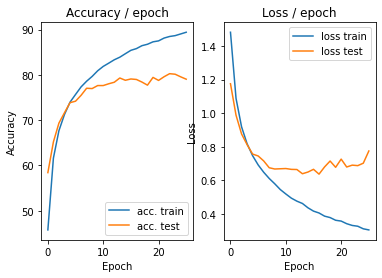

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.3113 (0.3113)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


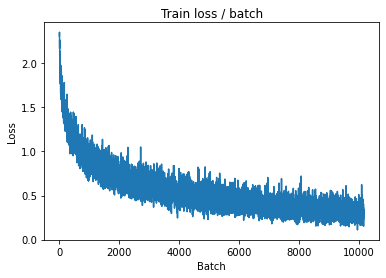

[TRAIN Batch 200/391]	Time 0.034s (0.023s)	Loss 0.2980 (0.2862)	Prec@1  89.8 ( 90.0)	Prec@5 100.0 ( 99.8)


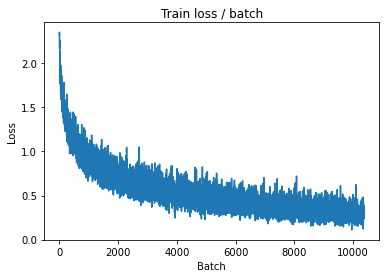


===============> Total time 8s	Avg loss 0.2991	Avg Prec@1 89.59 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.7625 (0.7625)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7409	Avg Prec@1 79.98 %	Avg Prec@5 98.64 %



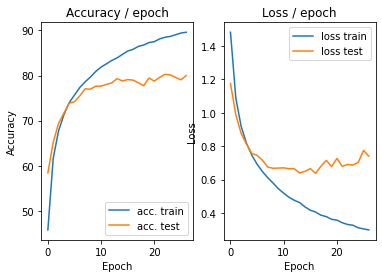

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.2015 (0.2015)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


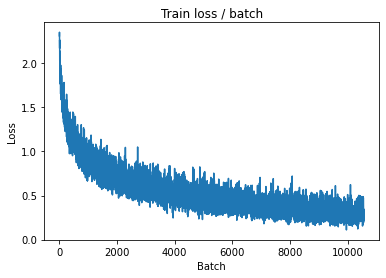

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.3283 (0.2881)	Prec@1  87.5 ( 89.9)	Prec@5 100.0 ( 99.8)


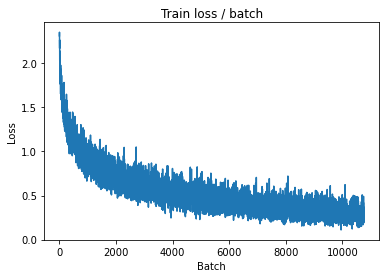


===============> Total time 7s	Avg loss 0.2979	Avg Prec@1 89.56 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.8018 (0.8018)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7590	Avg Prec@1 79.76 %	Avg Prec@5 98.62 %



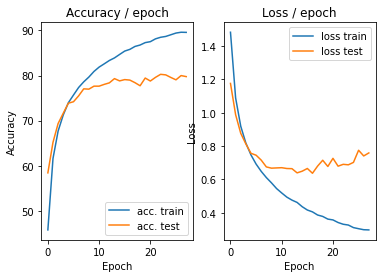

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.1187 (0.1187)	Prec@1  97.7 ( 97.7)	Prec@5 100.0 (100.0)


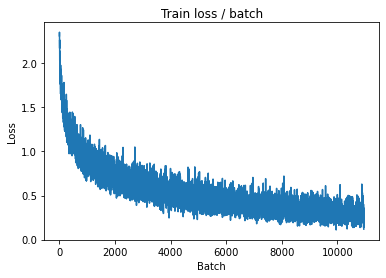

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 0.2805 (0.2683)	Prec@1  92.2 ( 90.7)	Prec@5 100.0 ( 99.8)


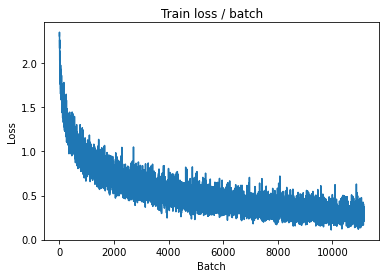


===============> Total time 7s	Avg loss 0.2872	Avg Prec@1 89.98 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.8456 (0.8456)	Prec@1  75.8 ( 75.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7881	Avg Prec@1 79.69 %	Avg Prec@5 98.47 %



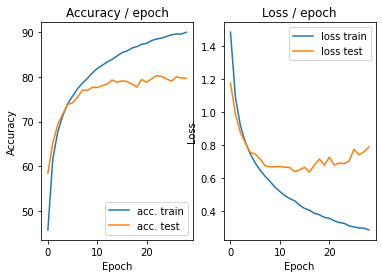

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.3160 (0.3160)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


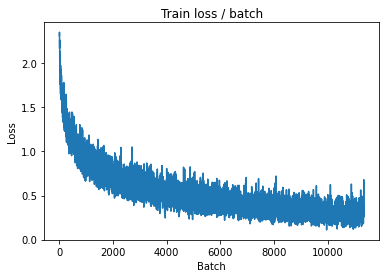

[TRAIN Batch 200/391]	Time 0.033s (0.021s)	Loss 0.4136 (0.2716)	Prec@1  84.4 ( 90.5)	Prec@5 100.0 ( 99.9)


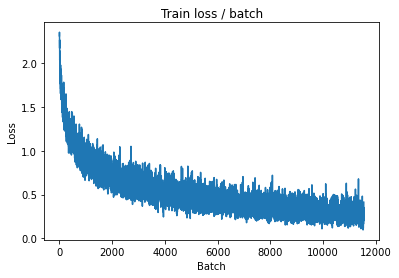


===============> Total time 8s	Avg loss 0.2752	Avg Prec@1 90.37 %	Avg Prec@5 99.85 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.8681 (0.8681)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7630	Avg Prec@1 79.32 %	Avg Prec@5 98.48 %



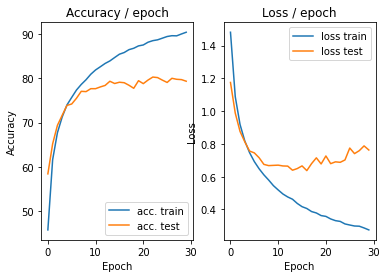

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.265s (0.265s)	Loss 0.3001 (0.3001)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


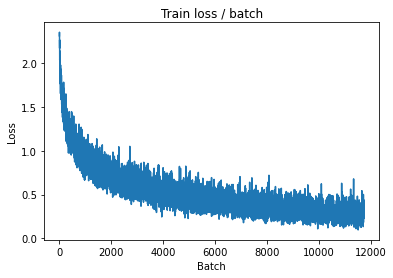

[TRAIN Batch 200/391]	Time 0.026s (0.020s)	Loss 0.2534 (0.2726)	Prec@1  89.8 ( 90.6)	Prec@5 100.0 ( 99.8)


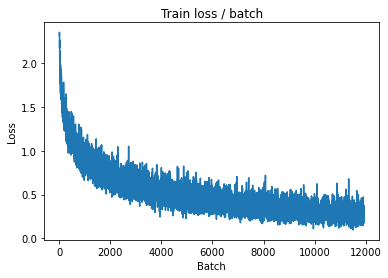


===============> Total time 7s	Avg loss 0.2763	Avg Prec@1 90.60 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.8900 (0.8900)	Prec@1  81.2 ( 81.2)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7667	Avg Prec@1 80.06 %	Avg Prec@5 98.53 %



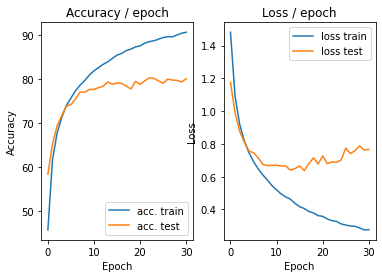

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.2396 (0.2396)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


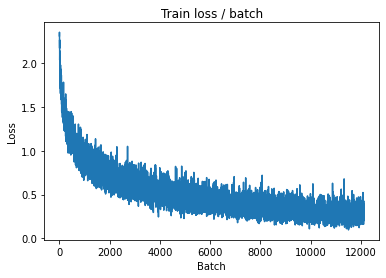

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 0.3942 (0.2487)	Prec@1  87.5 ( 91.2)	Prec@5 100.0 ( 99.9)


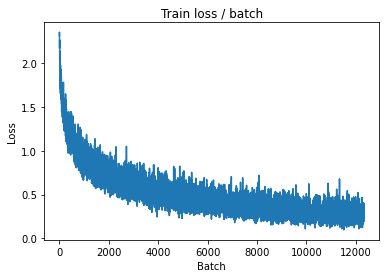


===============> Total time 7s	Avg loss 0.2662	Avg Prec@1 90.74 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.7903 (0.7903)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7851	Avg Prec@1 79.61 %	Avg Prec@5 98.49 %



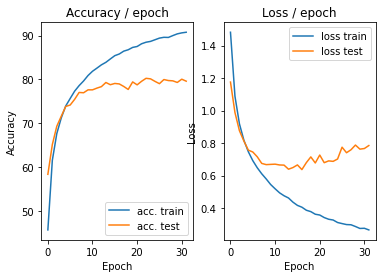

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.2223 (0.2223)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


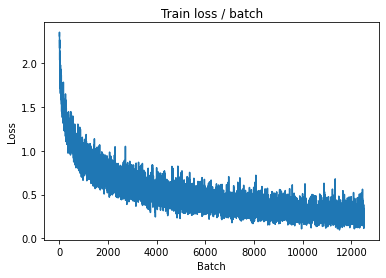

[TRAIN Batch 200/391]	Time 0.034s (0.022s)	Loss 0.3008 (0.2505)	Prec@1  93.8 ( 91.5)	Prec@5 100.0 ( 99.9)


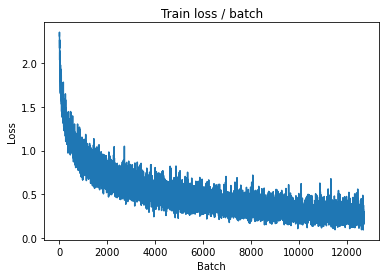


===============> Total time 8s	Avg loss 0.2593	Avg Prec@1 91.00 %	Avg Prec@5 99.86 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.9223 (0.9223)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7849	Avg Prec@1 79.12 %	Avg Prec@5 98.54 %



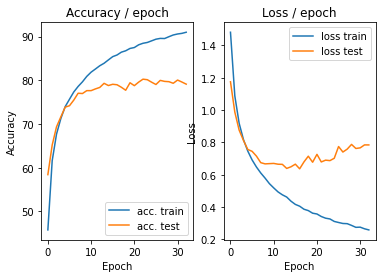

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.1738 (0.1738)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


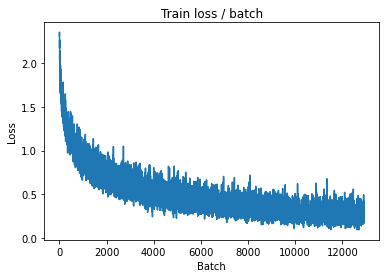

[TRAIN Batch 200/391]	Time 0.014s (0.019s)	Loss 0.1991 (0.2435)	Prec@1  94.5 ( 91.5)	Prec@5 100.0 ( 99.9)


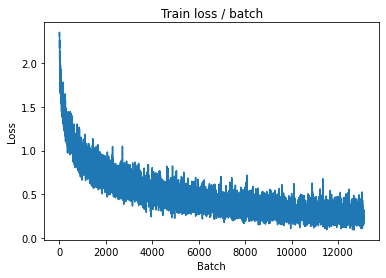


===============> Total time 7s	Avg loss 0.2571	Avg Prec@1 91.10 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.307s (0.307s)	Loss 0.9033 (0.9033)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7942	Avg Prec@1 79.14 %	Avg Prec@5 98.35 %



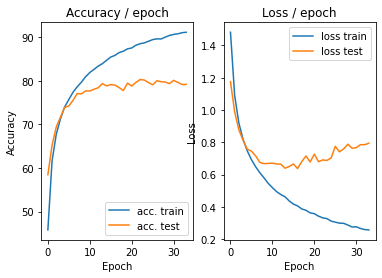

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.2673 (0.2673)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


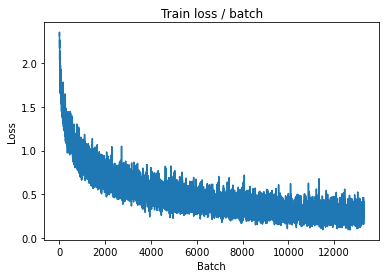

[TRAIN Batch 200/391]	Time 0.023s (0.019s)	Loss 0.2556 (0.2509)	Prec@1  89.8 ( 91.4)	Prec@5 100.0 ( 99.9)


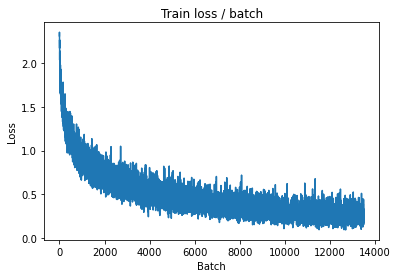


===============> Total time 7s	Avg loss 0.2564	Avg Prec@1 91.21 %	Avg Prec@5 99.87 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.8701 (0.8701)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8119	Avg Prec@1 79.91 %	Avg Prec@5 98.52 %



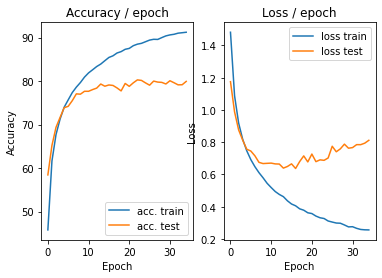

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.2654 (0.2654)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


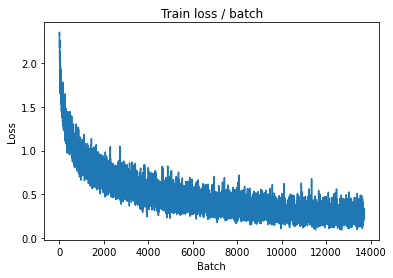

[TRAIN Batch 200/391]	Time 0.034s (0.022s)	Loss 0.2563 (0.2558)	Prec@1  90.6 ( 91.2)	Prec@5 100.0 ( 99.9)


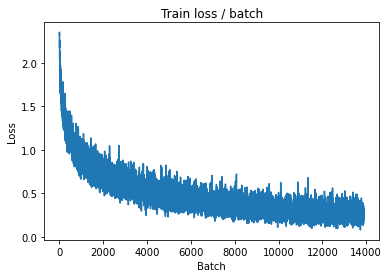


===============> Total time 8s	Avg loss 0.2529	Avg Prec@1 91.20 %	Avg Prec@5 99.88 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.8111 (0.8111)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8126	Avg Prec@1 79.20 %	Avg Prec@5 98.54 %



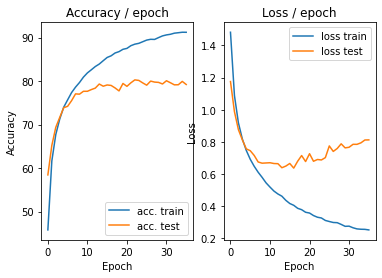

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.2949 (0.2949)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


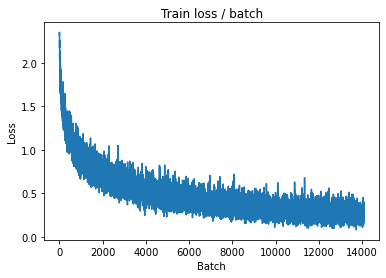

[TRAIN Batch 200/391]	Time 0.034s (0.022s)	Loss 0.1567 (0.2327)	Prec@1  95.3 ( 92.0)	Prec@5 100.0 ( 99.9)


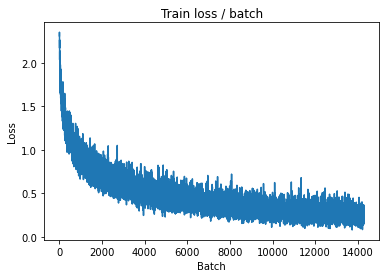


===============> Total time 8s	Avg loss 0.2440	Avg Prec@1 91.53 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 1.0720 (1.0720)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8345	Avg Prec@1 79.53 %	Avg Prec@5 98.52 %



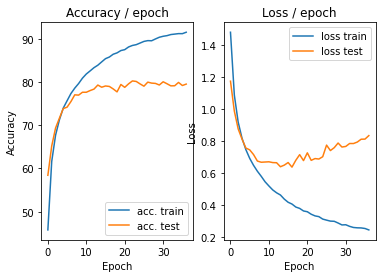

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.1464 (0.1464)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


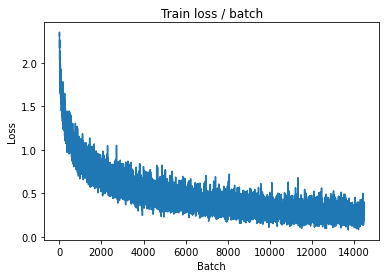

[TRAIN Batch 200/391]	Time 0.027s (0.022s)	Loss 0.2677 (0.2432)	Prec@1  90.6 ( 91.7)	Prec@5  99.2 ( 99.9)


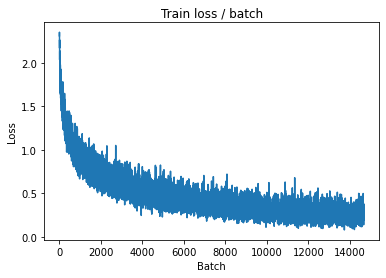


===============> Total time 7s	Avg loss 0.2450	Avg Prec@1 91.64 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.138s (0.138s)	Loss 0.7698 (0.7698)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8180	Avg Prec@1 79.65 %	Avg Prec@5 98.47 %



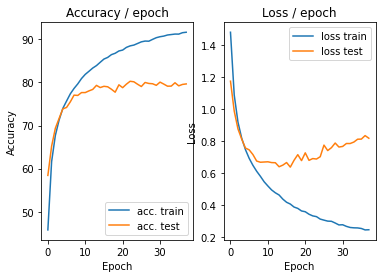

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.2962 (0.2962)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


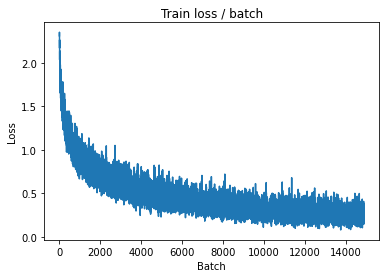

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.0974 (0.2289)	Prec@1  97.7 ( 92.2)	Prec@5 100.0 ( 99.9)


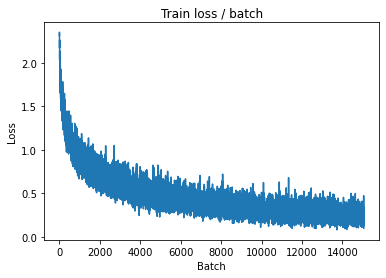


===============> Total time 7s	Avg loss 0.2341	Avg Prec@1 91.89 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.7965 (0.7965)	Prec@1  79.7 ( 79.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8728	Avg Prec@1 78.88 %	Avg Prec@5 98.39 %



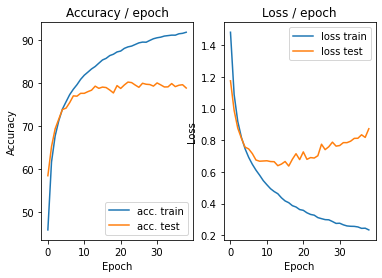

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.1979 (0.1979)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


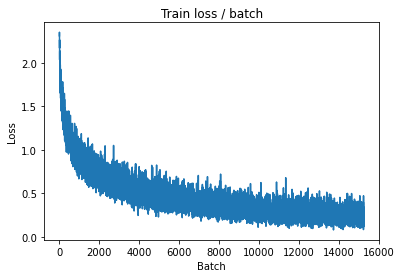

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.3295 (0.2256)	Prec@1  90.6 ( 92.3)	Prec@5 100.0 ( 99.9)


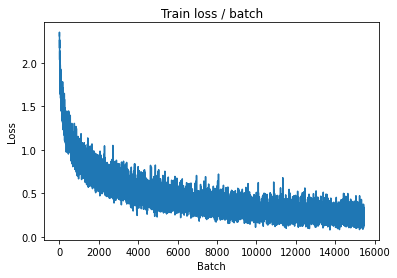


===============> Total time 7s	Avg loss 0.2381	Avg Prec@1 91.84 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7233 (0.7233)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8319	Avg Prec@1 79.79 %	Avg Prec@5 98.66 %



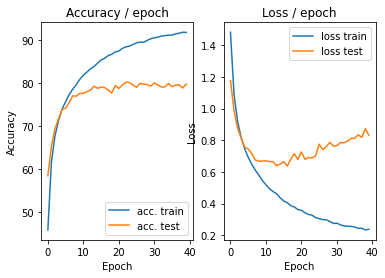

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.2197 (0.2197)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


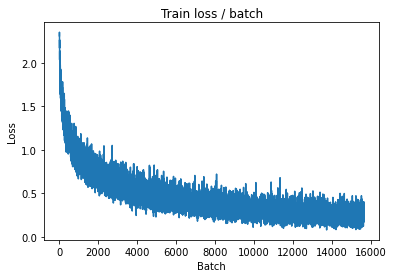

[TRAIN Batch 200/391]	Time 0.033s (0.022s)	Loss 0.1296 (0.2229)	Prec@1  94.5 ( 92.3)	Prec@5 100.0 ( 99.9)


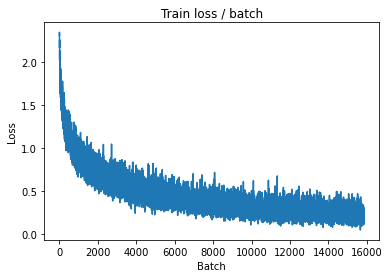


===============> Total time 8s	Avg loss 0.2266	Avg Prec@1 92.25 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.6527 (0.6527)	Prec@1  85.9 ( 85.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8463	Avg Prec@1 79.26 %	Avg Prec@5 98.56 %



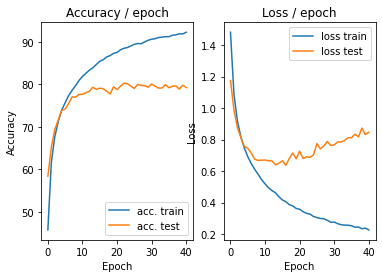

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.275s (0.275s)	Loss 0.2911 (0.2911)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


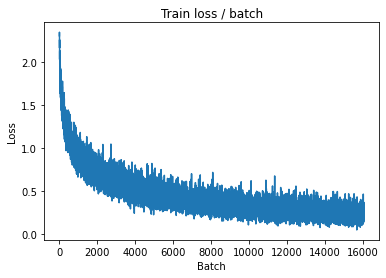

[TRAIN Batch 200/391]	Time 0.008s (0.020s)	Loss 0.2889 (0.2170)	Prec@1  90.6 ( 92.4)	Prec@5 100.0 ( 99.9)


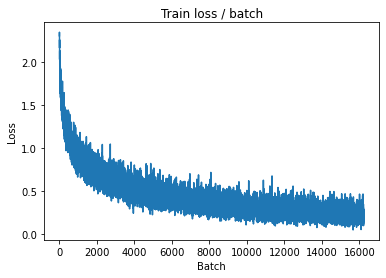


===============> Total time 7s	Avg loss 0.2239	Avg Prec@1 92.26 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.159s (0.159s)	Loss 0.8139 (0.8139)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8486	Avg Prec@1 79.65 %	Avg Prec@5 98.61 %



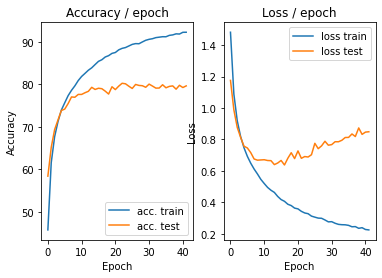

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.1444 (0.1444)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


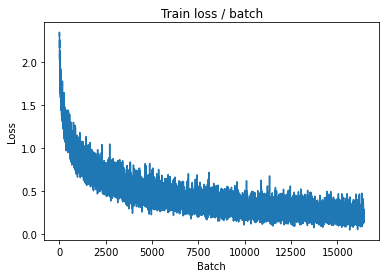

[TRAIN Batch 200/391]	Time 0.015s (0.019s)	Loss 0.3035 (0.2217)	Prec@1  89.1 ( 92.3)	Prec@5 100.0 ( 99.9)


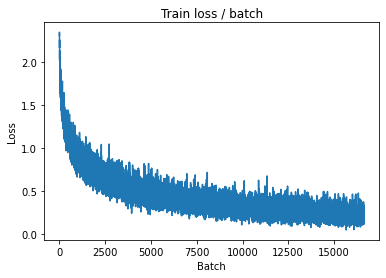


===============> Total time 7s	Avg loss 0.2277	Avg Prec@1 92.16 %	Avg Prec@5 99.90 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.8035 (0.8035)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8332	Avg Prec@1 79.59 %	Avg Prec@5 98.39 %



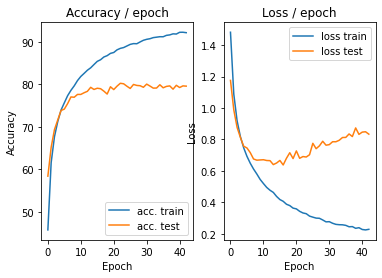

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.2362 (0.2362)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


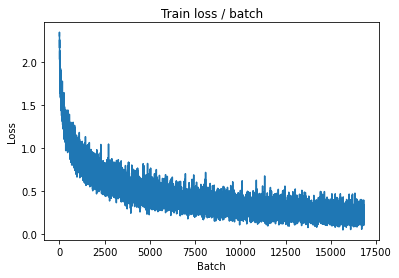

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.1954 (0.2248)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 ( 99.9)


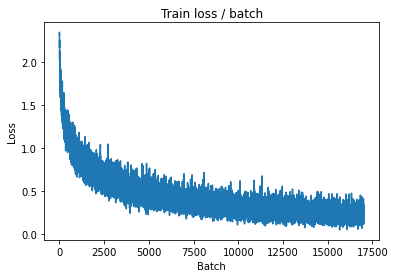


===============> Total time 7s	Avg loss 0.2291	Avg Prec@1 92.20 %	Avg Prec@5 99.89 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.7995 (0.7995)	Prec@1  83.6 ( 83.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8607	Avg Prec@1 79.28 %	Avg Prec@5 98.43 %



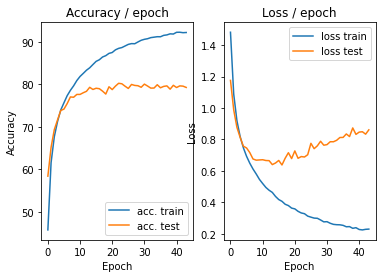

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.2188 (0.2188)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


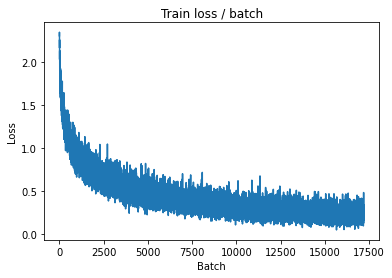

[TRAIN Batch 200/391]	Time 0.027s (0.020s)	Loss 0.1488 (0.1991)	Prec@1  96.1 ( 93.2)	Prec@5 100.0 (100.0)


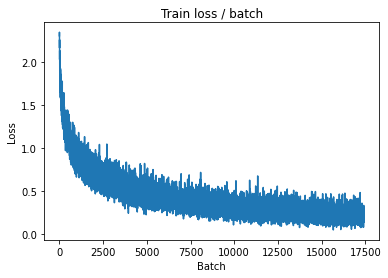


===============> Total time 7s	Avg loss 0.2127	Avg Prec@1 92.82 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.297s (0.297s)	Loss 0.7902 (0.7902)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8482	Avg Prec@1 79.69 %	Avg Prec@5 98.39 %



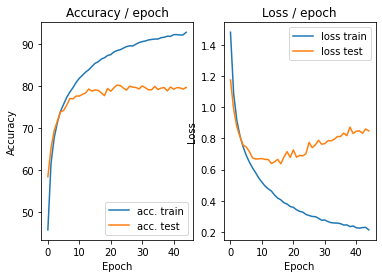

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.1704 (0.1704)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


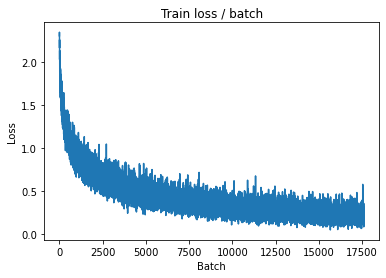

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1592 (0.2151)	Prec@1  95.3 ( 92.6)	Prec@5 100.0 ( 99.9)


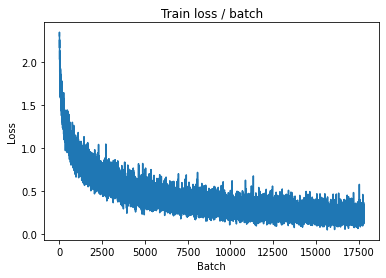


===============> Total time 7s	Avg loss 0.2200	Avg Prec@1 92.40 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.8061 (0.8061)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9092	Avg Prec@1 79.20 %	Avg Prec@5 98.52 %



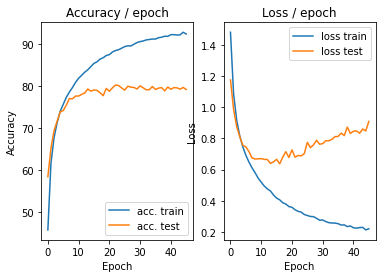

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.1664 (0.1664)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


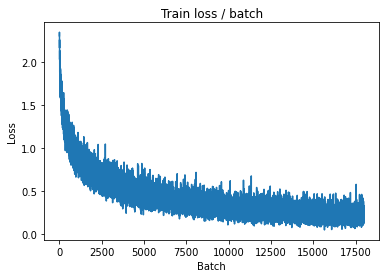

[TRAIN Batch 200/391]	Time 0.025s (0.019s)	Loss 0.1937 (0.2181)	Prec@1  94.5 ( 92.4)	Prec@5 100.0 (100.0)


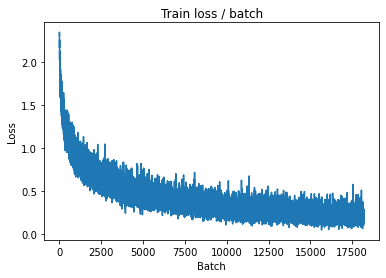


===============> Total time 7s	Avg loss 0.2208	Avg Prec@1 92.36 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.8866 (0.8866)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8823	Avg Prec@1 79.51 %	Avg Prec@5 98.45 %



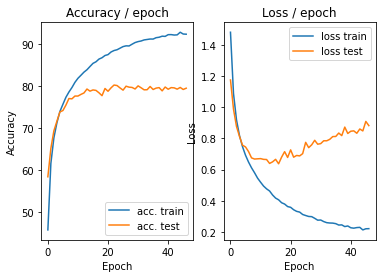

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 0.1861 (0.1861)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


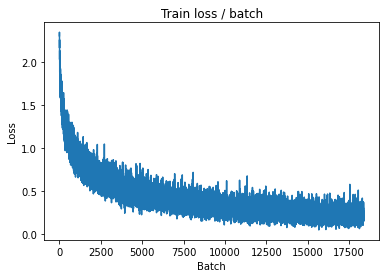

[TRAIN Batch 200/391]	Time 0.025s (0.019s)	Loss 0.2074 (0.2066)	Prec@1  92.2 ( 93.0)	Prec@5  99.2 ( 99.9)


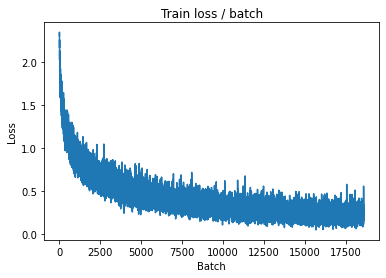


===============> Total time 7s	Avg loss 0.2140	Avg Prec@1 92.72 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.8998 (0.8998)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9225	Avg Prec@1 79.02 %	Avg Prec@5 98.43 %



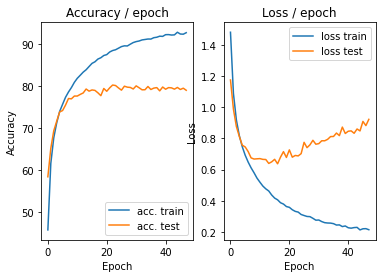

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.2061 (0.2061)	Prec@1  93.8 ( 93.8)	Prec@5  99.2 ( 99.2)


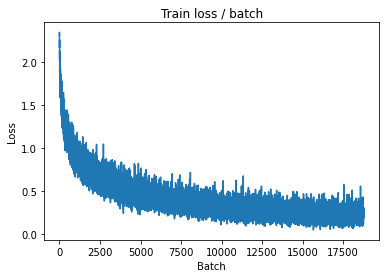

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.2149 (0.2013)	Prec@1  93.0 ( 93.1)	Prec@5 100.0 ( 99.9)


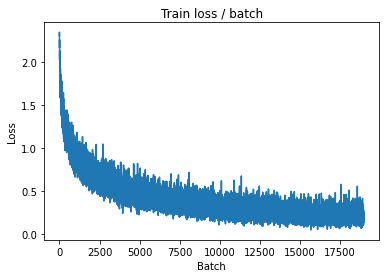


===============> Total time 7s	Avg loss 0.2061	Avg Prec@1 92.91 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.0868 (1.0868)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9236	Avg Prec@1 79.54 %	Avg Prec@5 98.41 %



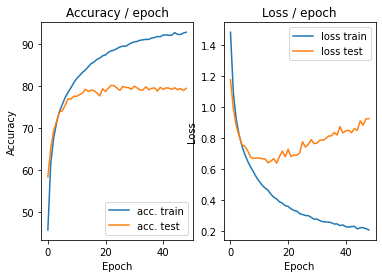

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.2063 (0.2063)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


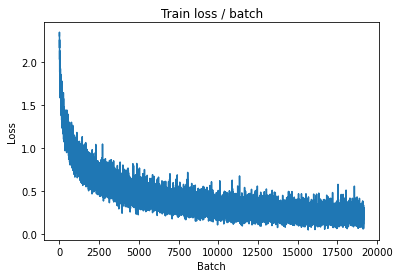

[TRAIN Batch 200/391]	Time 0.026s (0.019s)	Loss 0.2884 (0.2044)	Prec@1  93.0 ( 93.1)	Prec@5 100.0 ( 99.9)


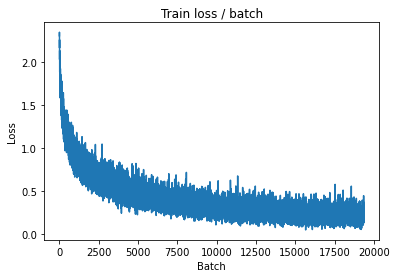


===============> Total time 7s	Avg loss 0.2057	Avg Prec@1 93.06 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.7966 (0.7966)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8903	Avg Prec@1 79.78 %	Avg Prec@5 98.57 %



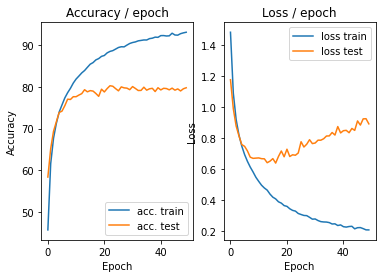

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.2390 (0.2390)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


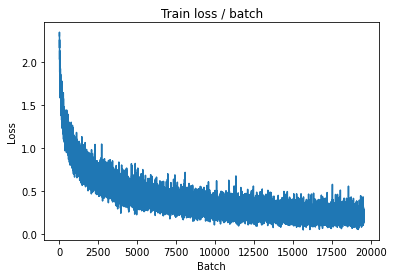

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1257 (0.2052)	Prec@1  96.1 ( 93.1)	Prec@5 100.0 ( 99.9)


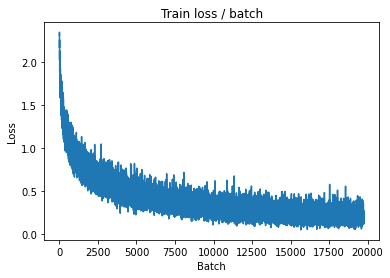


===============> Total time 7s	Avg loss 0.2100	Avg Prec@1 92.89 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.9009 (0.9009)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9195	Avg Prec@1 79.93 %	Avg Prec@5 98.36 %



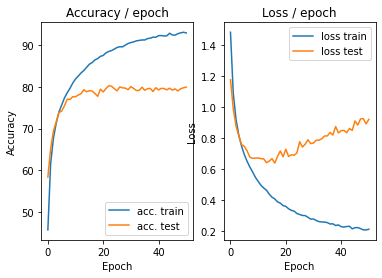

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.1127 (0.1127)	Prec@1  96.9 ( 96.9)	Prec@5 100.0 (100.0)


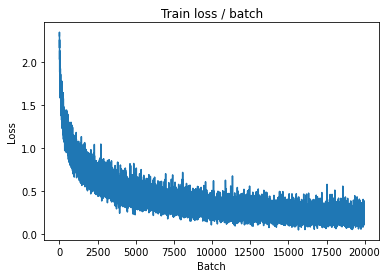

[TRAIN Batch 200/391]	Time 0.011s (0.019s)	Loss 0.2979 (0.1986)	Prec@1  91.4 ( 93.3)	Prec@5 100.0 ( 99.9)


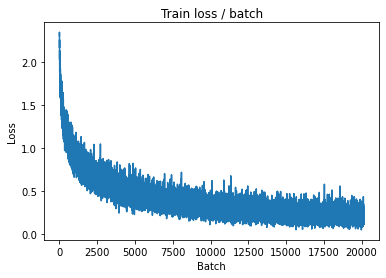


===============> Total time 7s	Avg loss 0.2005	Avg Prec@1 93.17 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.7841 (0.7841)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9107	Avg Prec@1 79.49 %	Avg Prec@5 98.58 %



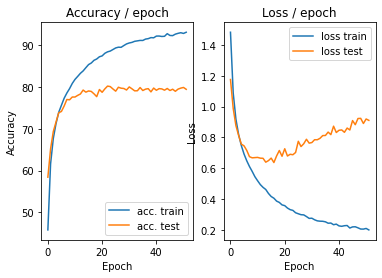

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.292s (0.292s)	Loss 0.1501 (0.1501)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


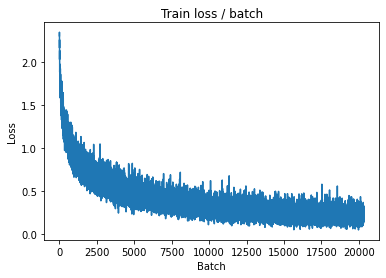

[TRAIN Batch 200/391]	Time 0.027s (0.022s)	Loss 0.2824 (0.2087)	Prec@1  91.4 ( 92.8)	Prec@5  99.2 ( 99.9)


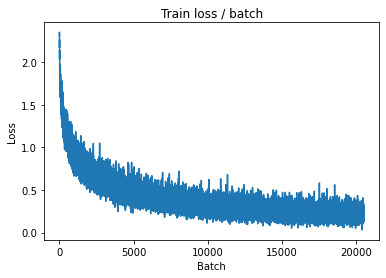


===============> Total time 7s	Avg loss 0.2071	Avg Prec@1 92.94 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.9107 (0.9107)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9343	Avg Prec@1 79.17 %	Avg Prec@5 98.58 %



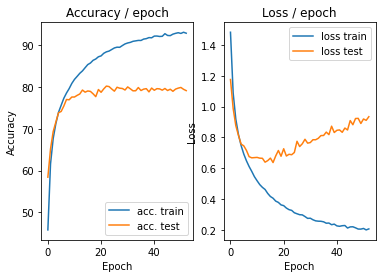

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.2269 (0.2269)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


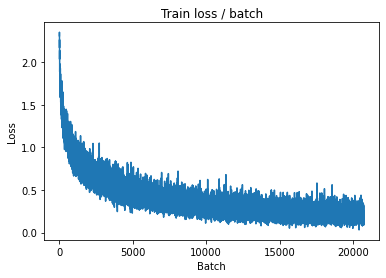

[TRAIN Batch 200/391]	Time 0.033s (0.022s)	Loss 0.2869 (0.1979)	Prec@1  93.0 ( 93.2)	Prec@5 100.0 ( 99.9)


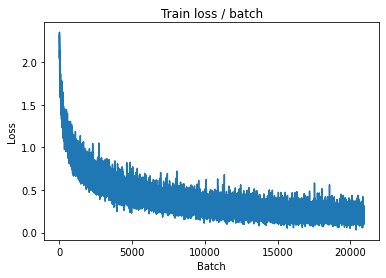


===============> Total time 8s	Avg loss 0.2031	Avg Prec@1 93.01 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 1.1900 (1.1900)	Prec@1  78.9 ( 78.9)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9663	Avg Prec@1 79.49 %	Avg Prec@5 98.39 %



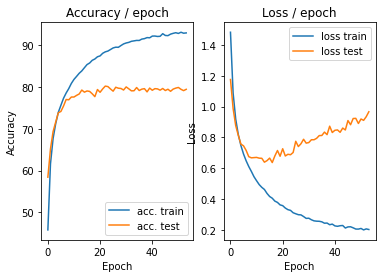

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.1817 (0.1817)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


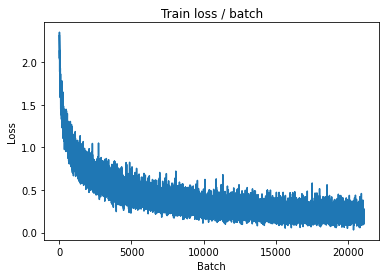

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.2505 (0.2012)	Prec@1  91.4 ( 93.2)	Prec@5 100.0 ( 99.9)


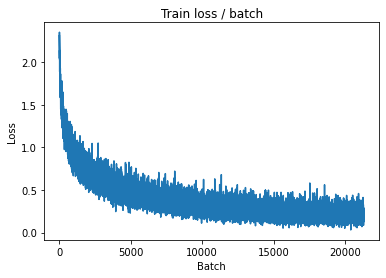


===============> Total time 7s	Avg loss 0.2096	Avg Prec@1 92.96 %	Avg Prec@5 99.92 %

[EVAL Batch 000/079]	Time 0.121s (0.121s)	Loss 1.0891 (1.0891)	Prec@1  78.1 ( 78.1)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9124	Avg Prec@1 79.51 %	Avg Prec@5 98.62 %



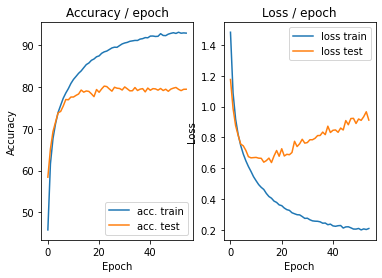

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.3346 (0.3346)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


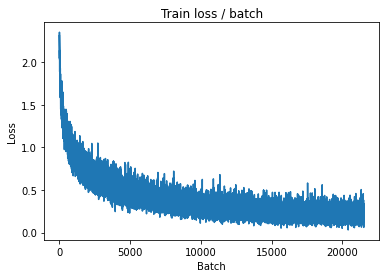

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.1713 (0.1975)	Prec@1  93.0 ( 93.6)	Prec@5 100.0 ( 99.9)


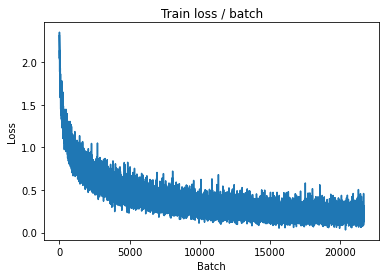


===============> Total time 7s	Avg loss 0.2005	Avg Prec@1 93.35 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.305s (0.305s)	Loss 0.9639 (0.9639)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9302	Avg Prec@1 79.74 %	Avg Prec@5 98.39 %



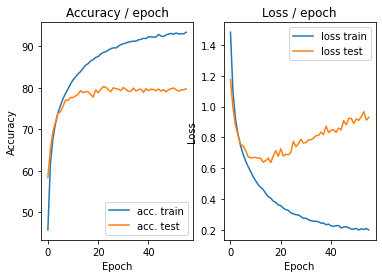

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.1939 (0.1939)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


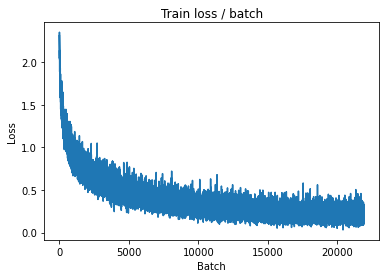

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.2065 (0.1968)	Prec@1  93.0 ( 93.4)	Prec@5 100.0 ( 99.9)


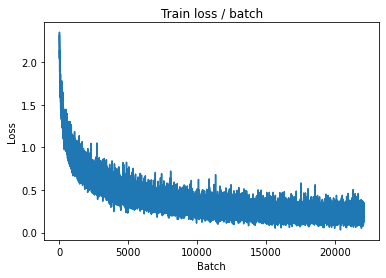


===============> Total time 7s	Avg loss 0.2005	Avg Prec@1 93.27 %	Avg Prec@5 99.91 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.7042 (0.7042)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8991	Avg Prec@1 79.57 %	Avg Prec@5 98.44 %



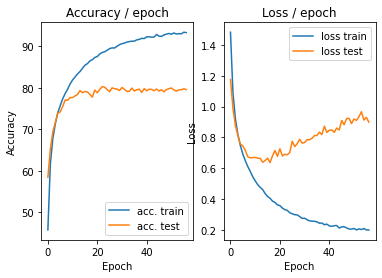

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.1333 (0.1333)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


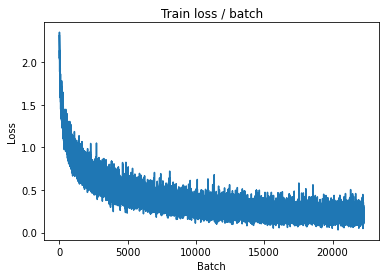

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.2392 (0.1905)	Prec@1  91.4 ( 93.6)	Prec@5 100.0 ( 99.9)


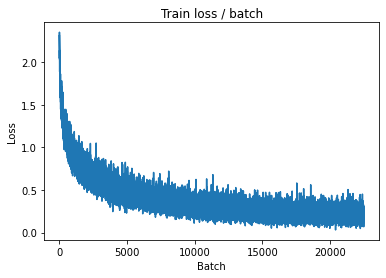


===============> Total time 7s	Avg loss 0.1964	Avg Prec@1 93.47 %	Avg Prec@5 99.93 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.9367 (0.9367)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9684	Avg Prec@1 79.57 %	Avg Prec@5 98.42 %



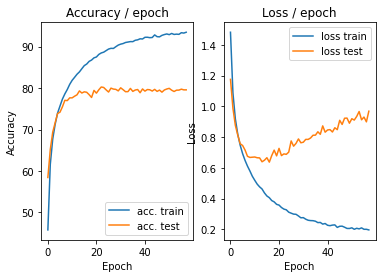

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.3284 (0.3284)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


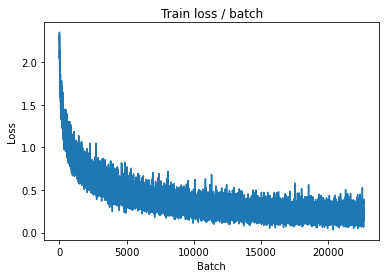

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1775 (0.1820)	Prec@1  93.8 ( 93.9)	Prec@5 100.0 (100.0)


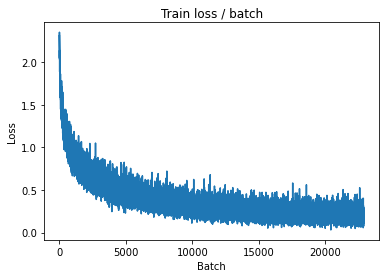


===============> Total time 7s	Avg loss 0.1907	Avg Prec@1 93.57 %	Avg Prec@5 99.95 %

[EVAL Batch 000/079]	Time 0.134s (0.134s)	Loss 1.0500 (1.0500)	Prec@1  82.0 ( 82.0)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9592	Avg Prec@1 79.36 %	Avg Prec@5 98.41 %



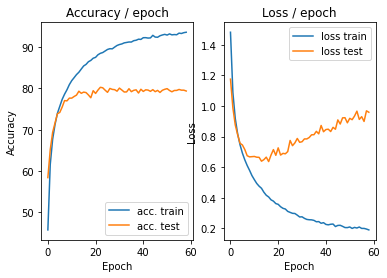

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.128s (0.128s)	Loss 0.2123 (0.2123)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


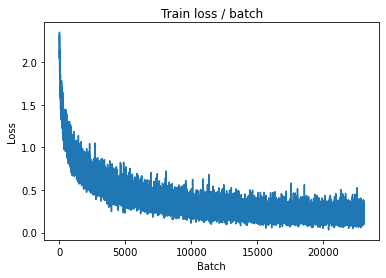

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.2931 (0.1908)	Prec@1  89.8 ( 93.6)	Prec@5 100.0 ( 99.9)


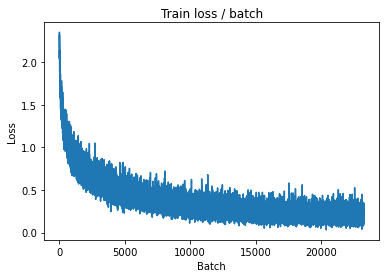


===============> Total time 7s	Avg loss 0.1923	Avg Prec@1 93.50 %	Avg Prec@5 99.94 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.9114 (0.9114)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.9150	Avg Prec@1 80.19 %	Avg Prec@5 98.63 %



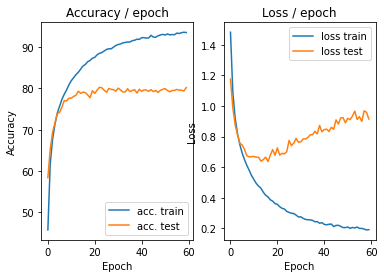

In [39]:
main(128, 0.001,60, cuda=True)

## Dropout

In [40]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0,ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,                      
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(p=0.5)
        ]))
    
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        #update lr scheduler
        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 2.3049 (2.3049)	Prec@1   8.6 (  8.6)	Prec@5  51.6 ( 51.6)


<Figure size 432x288 with 0 Axes>

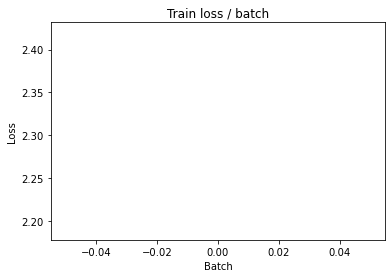

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 1.6408 (2.0047)	Prec@1  42.2 ( 26.3)	Prec@5  90.6 ( 76.5)


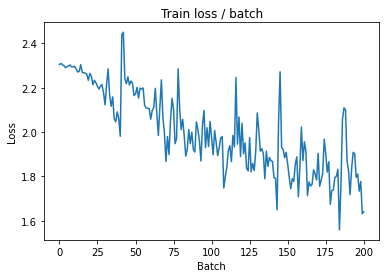


===============> Total time 7s	Avg loss 1.8482	Avg Prec@1 32.60 %	Avg Prec@5 82.45 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.6012 (1.6012)	Prec@1  46.1 ( 46.1)	Prec@5  88.3 ( 88.3)

===============> Total time 1s	Avg loss 1.5431	Avg Prec@1 45.13 %	Avg Prec@5 91.85 %



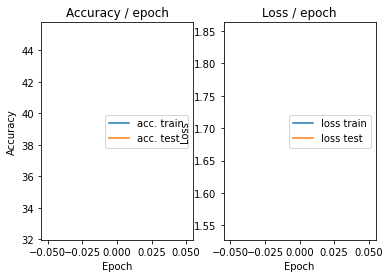

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 1.6388 (1.6388)	Prec@1  40.6 ( 40.6)	Prec@5  89.8 ( 89.8)


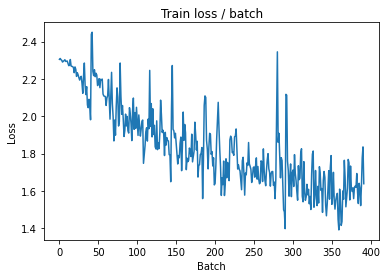

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.3878 (1.4943)	Prec@1  54.7 ( 45.6)	Prec@5  91.4 ( 92.0)


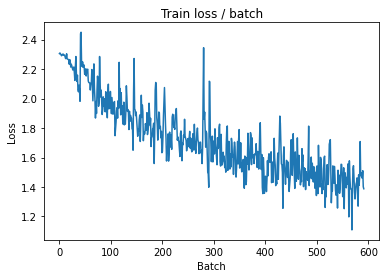


===============> Total time 7s	Avg loss 1.4449	Avg Prec@1 47.64 %	Avg Prec@5 92.46 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 1.2891 (1.2891)	Prec@1  57.0 ( 57.0)	Prec@5  92.2 ( 92.2)

===============> Total time 1s	Avg loss 1.3105	Avg Prec@1 52.41 %	Avg Prec@5 93.89 %



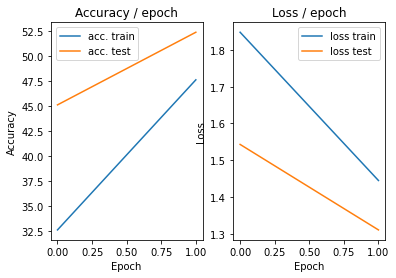

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 1.4432 (1.4432)	Prec@1  48.4 ( 48.4)	Prec@5  94.5 ( 94.5)


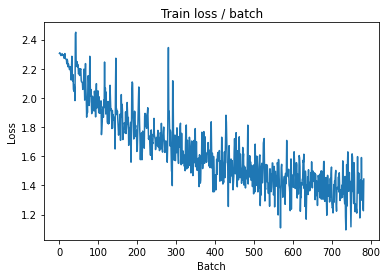

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 1.1892 (1.2901)	Prec@1  59.4 ( 54.0)	Prec@5  96.1 ( 94.4)


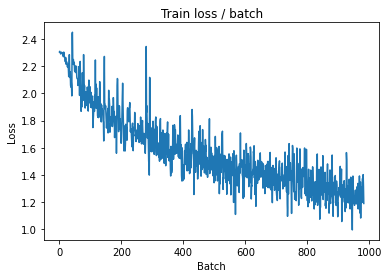


===============> Total time 7s	Avg loss 1.2469	Avg Prec@1 55.70 %	Avg Prec@5 94.75 %

[EVAL Batch 000/079]	Time 0.289s (0.289s)	Loss 1.0499 (1.0499)	Prec@1  64.1 ( 64.1)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0705	Avg Prec@1 63.08 %	Avg Prec@5 96.49 %



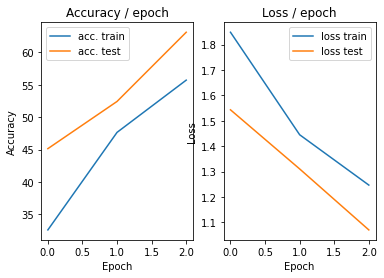

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 1.1188 (1.1188)	Prec@1  60.2 ( 60.2)	Prec@5  95.3 ( 95.3)


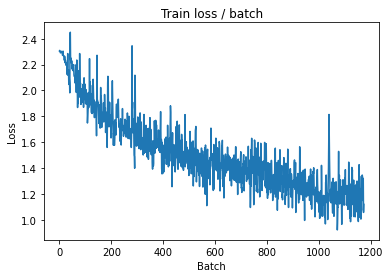

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.9208 (1.1199)	Prec@1  70.3 ( 61.0)	Prec@5  96.1 ( 95.9)


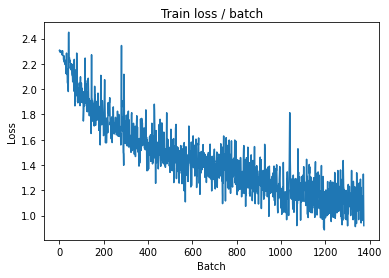


===============> Total time 8s	Avg loss 1.0946	Avg Prec@1 61.70 %	Avg Prec@5 96.11 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.9532 (0.9532)	Prec@1  68.8 ( 68.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9711	Avg Prec@1 66.16 %	Avg Prec@5 96.90 %



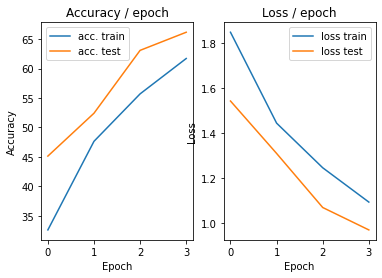

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.124s (0.124s)	Loss 0.9631 (0.9631)	Prec@1  68.8 ( 68.8)	Prec@5  97.7 ( 97.7)


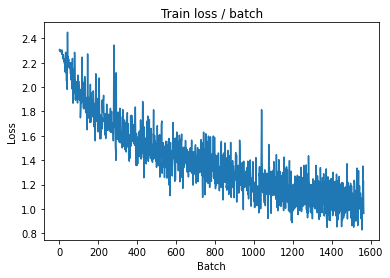

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.9805 (0.9921)	Prec@1  69.5 ( 65.3)	Prec@5  96.9 ( 96.9)


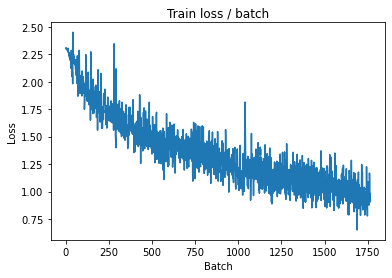


===============> Total time 8s	Avg loss 0.9804	Avg Prec@1 65.69 %	Avg Prec@5 96.87 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 1.0875 (1.0875)	Prec@1  60.2 ( 60.2)	Prec@5  96.1 ( 96.1)

===============> Total time 1s	Avg loss 1.0862	Avg Prec@1 63.51 %	Avg Prec@5 95.27 %



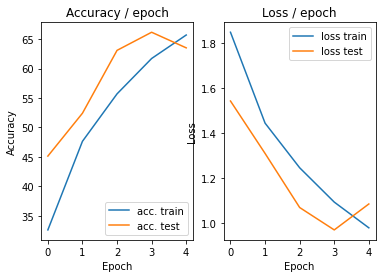

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 1.3235 (1.3235)	Prec@1  54.7 ( 54.7)	Prec@5  92.2 ( 92.2)


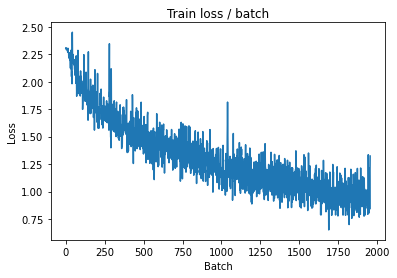

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.8975 (0.9115)	Prec@1  65.6 ( 68.1)	Prec@5 100.0 ( 97.2)


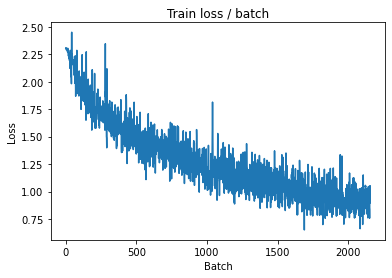


===============> Total time 7s	Avg loss 0.8988	Avg Prec@1 68.58 %	Avg Prec@5 97.40 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.8066 (0.8066)	Prec@1  72.7 ( 72.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8468	Avg Prec@1 70.37 %	Avg Prec@5 97.51 %



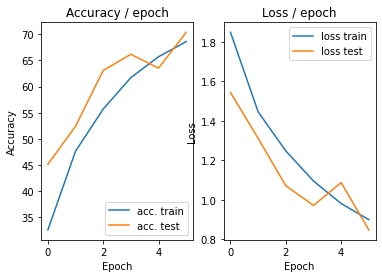

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.7199 (0.7199)	Prec@1  77.3 ( 77.3)	Prec@5 100.0 (100.0)


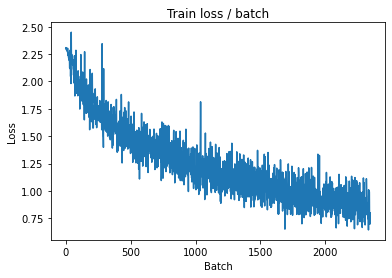

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.7318 (0.8326)	Prec@1  80.5 ( 70.7)	Prec@5  98.4 ( 97.8)


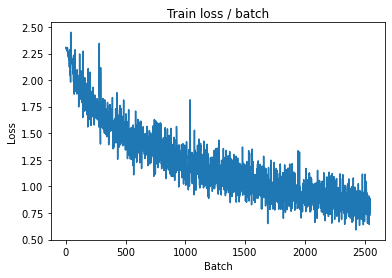


===============> Total time 7s	Avg loss 0.8276	Avg Prec@1 71.07 %	Avg Prec@5 97.78 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.8327 (0.8327)	Prec@1  69.5 ( 69.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.9325	Avg Prec@1 67.86 %	Avg Prec@5 97.64 %



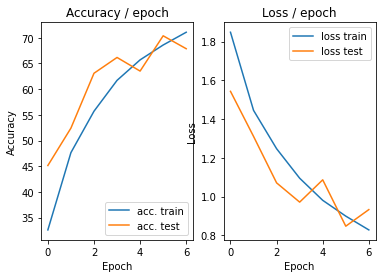

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.8104 (0.8104)	Prec@1  70.3 ( 70.3)	Prec@5  98.4 ( 98.4)


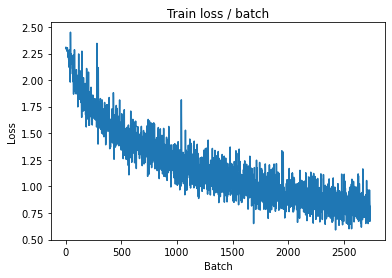

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.8398 (0.7820)	Prec@1  71.9 ( 72.9)	Prec@5  96.9 ( 98.0)


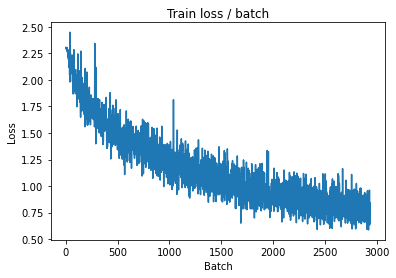


===============> Total time 7s	Avg loss 0.7756	Avg Prec@1 73.19 %	Avg Prec@5 97.96 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.8227 (0.8227)	Prec@1  74.2 ( 74.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.8667	Avg Prec@1 70.39 %	Avg Prec@5 97.64 %



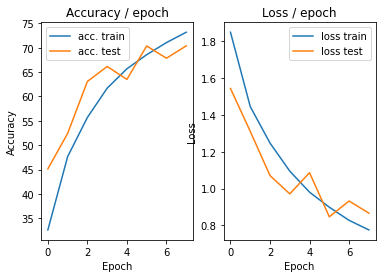

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.152s (0.152s)	Loss 1.0483 (1.0483)	Prec@1  62.5 ( 62.5)	Prec@5  96.9 ( 96.9)


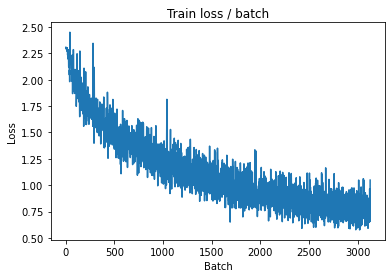

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.7639 (0.7413)	Prec@1  74.2 ( 74.1)	Prec@5  97.7 ( 98.3)


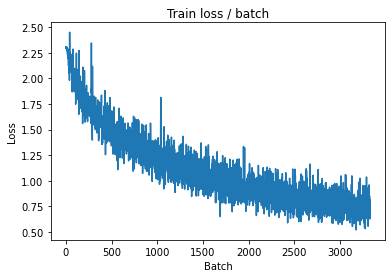


===============> Total time 7s	Avg loss 0.7324	Avg Prec@1 74.54 %	Avg Prec@5 98.29 %

[EVAL Batch 000/079]	Time 0.137s (0.137s)	Loss 0.7682 (0.7682)	Prec@1  76.6 ( 76.6)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7755	Avg Prec@1 73.90 %	Avg Prec@5 98.05 %



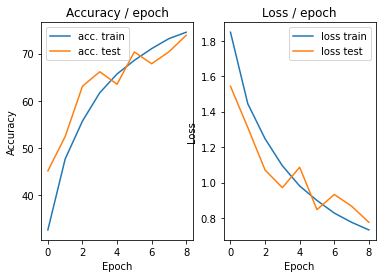

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.8328 (0.8328)	Prec@1  70.3 ( 70.3)	Prec@5  99.2 ( 99.2)


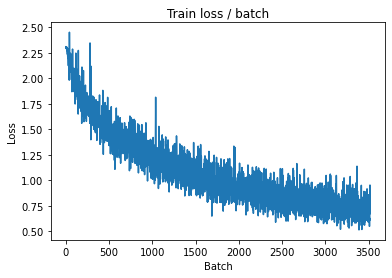

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.7724 (0.6992)	Prec@1  71.9 ( 75.8)	Prec@5  96.9 ( 98.4)


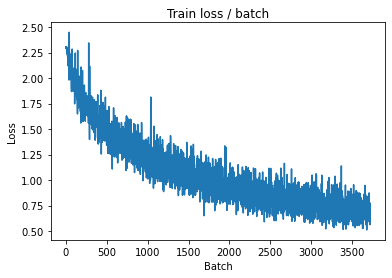


===============> Total time 7s	Avg loss 0.6969	Avg Prec@1 75.74 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.8755 (0.8755)	Prec@1  68.8 ( 68.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.8534	Avg Prec@1 70.88 %	Avg Prec@5 97.61 %



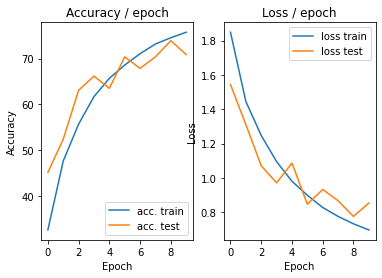

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.283s (0.283s)	Loss 0.6903 (0.6903)	Prec@1  72.7 ( 72.7)	Prec@5  99.2 ( 99.2)


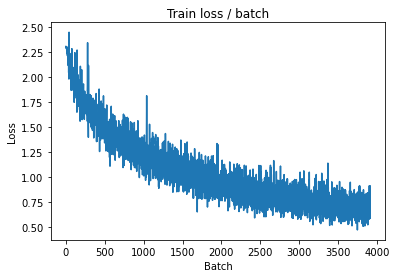

[TRAIN Batch 200/391]	Time 0.035s (0.023s)	Loss 0.5986 (0.6591)	Prec@1  78.9 ( 77.1)	Prec@5  97.7 ( 98.6)


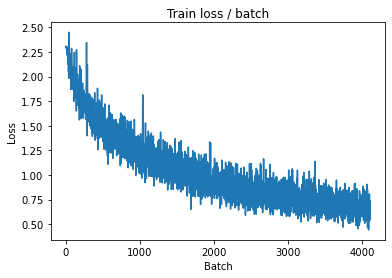


===============> Total time 8s	Avg loss 0.6584	Avg Prec@1 77.21 %	Avg Prec@5 98.58 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.5969 (0.5969)	Prec@1  76.6 ( 76.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6471	Avg Prec@1 78.02 %	Avg Prec@5 98.66 %



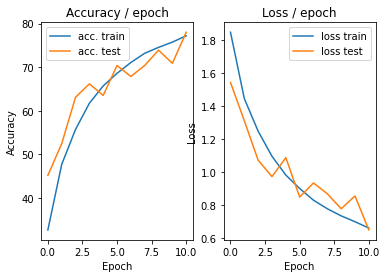

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.7826 (0.7826)	Prec@1  74.2 ( 74.2)	Prec@5  98.4 ( 98.4)


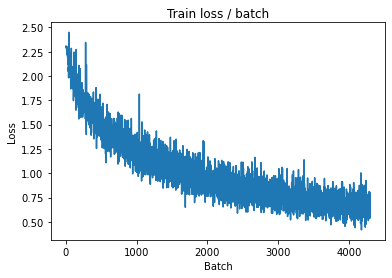

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.6097 (0.6314)	Prec@1  78.1 ( 78.0)	Prec@5  98.4 ( 98.8)


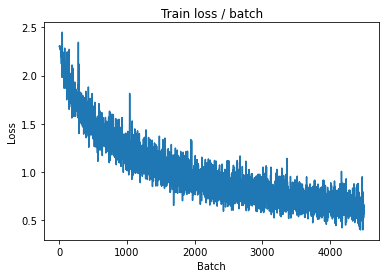


===============> Total time 8s	Avg loss 0.6346	Avg Prec@1 77.97 %	Avg Prec@5 98.70 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.5868 (0.5868)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6383	Avg Prec@1 78.60 %	Avg Prec@5 98.59 %



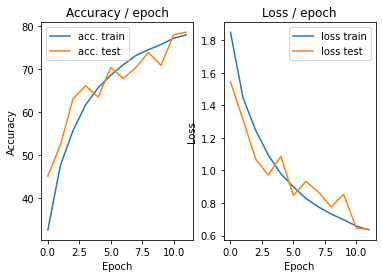

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.7844 (0.7844)	Prec@1  71.9 ( 71.9)	Prec@5  96.9 ( 96.9)


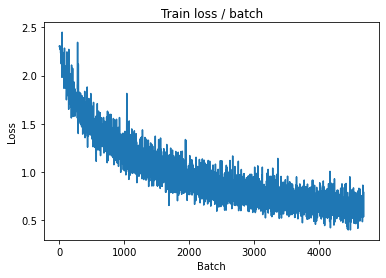

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.6445 (0.6001)	Prec@1  75.8 ( 79.0)	Prec@5  98.4 ( 98.8)


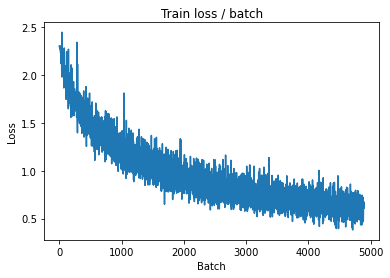


===============> Total time 7s	Avg loss 0.6039	Avg Prec@1 79.00 %	Avg Prec@5 98.80 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.5413 (0.5413)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.6141	Avg Prec@1 78.85 %	Avg Prec@5 98.84 %



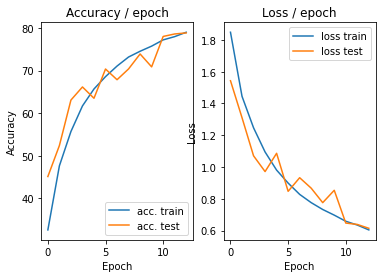

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.5207 (0.5207)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


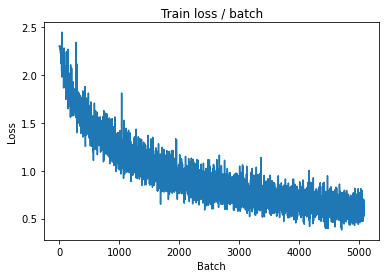

[TRAIN Batch 200/391]	Time 0.035s (0.021s)	Loss 0.5603 (0.5836)	Prec@1  78.1 ( 79.4)	Prec@5  99.2 ( 99.0)


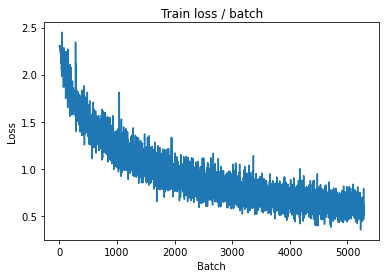


===============> Total time 8s	Avg loss 0.5810	Avg Prec@1 79.62 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.275s (0.275s)	Loss 0.5475 (0.5475)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.6160	Avg Prec@1 79.09 %	Avg Prec@5 98.69 %



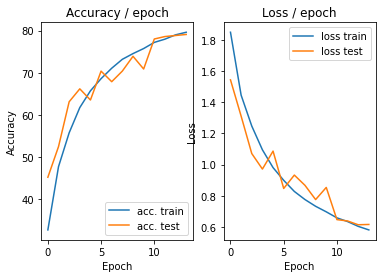

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.5258 (0.5258)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


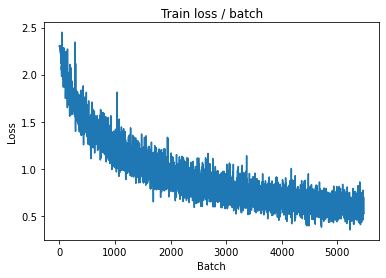

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.4133 (0.5598)	Prec@1  84.4 ( 80.5)	Prec@5  99.2 ( 98.9)


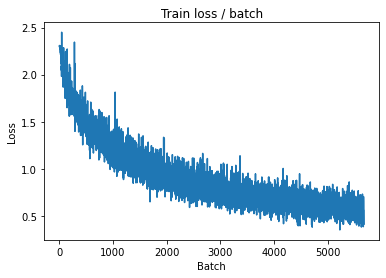


===============> Total time 7s	Avg loss 0.5626	Avg Prec@1 80.29 %	Avg Prec@5 98.95 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.5613 (0.5613)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6151	Avg Prec@1 78.73 %	Avg Prec@5 98.83 %



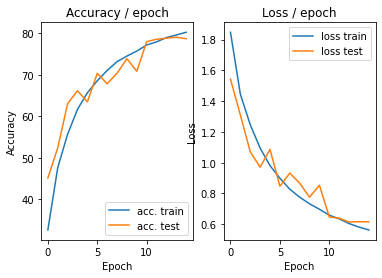

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.3475 (0.3475)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


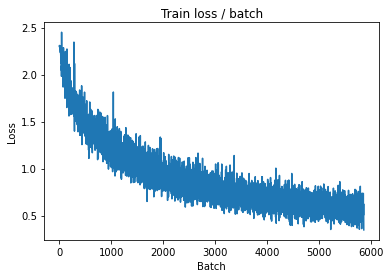

[TRAIN Batch 200/391]	Time 0.033s (0.022s)	Loss 0.4261 (0.5446)	Prec@1  85.2 ( 81.2)	Prec@5  99.2 ( 99.0)


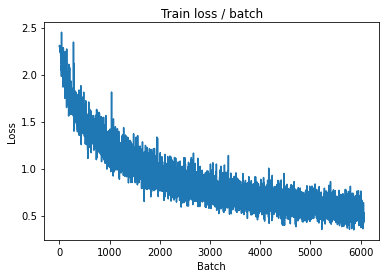


===============> Total time 8s	Avg loss 0.5465	Avg Prec@1 80.91 %	Avg Prec@5 99.00 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.6256 (0.6256)	Prec@1  77.3 ( 77.3)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5964	Avg Prec@1 80.26 %	Avg Prec@5 98.74 %



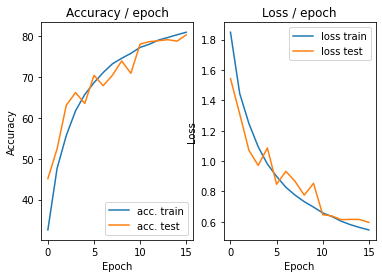

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.5217 (0.5217)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


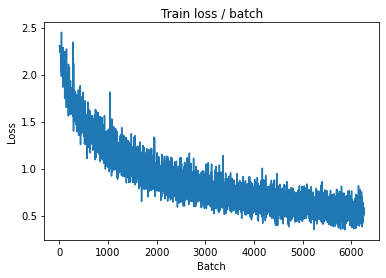

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.5415 (0.5326)	Prec@1  83.6 ( 81.5)	Prec@5  97.7 ( 99.1)


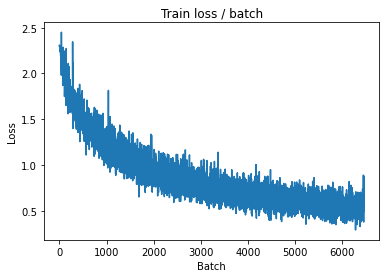


===============> Total time 7s	Avg loss 0.5275	Avg Prec@1 81.74 %	Avg Prec@5 99.10 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.5206 (0.5206)	Prec@1  78.1 ( 78.1)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5904	Avg Prec@1 80.06 %	Avg Prec@5 98.84 %



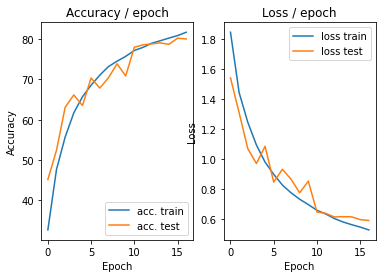

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.5527 (0.5527)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)


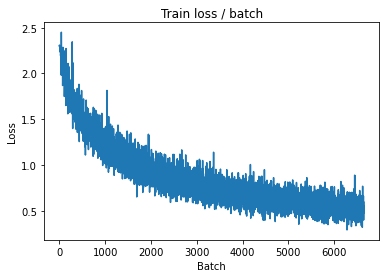

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.4523 (0.5093)	Prec@1  85.9 ( 82.2)	Prec@5  97.7 ( 99.2)


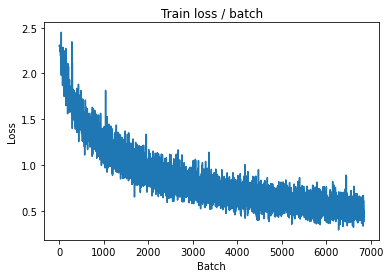


===============> Total time 8s	Avg loss 0.5150	Avg Prec@1 82.02 %	Avg Prec@5 99.22 %

[EVAL Batch 000/079]	Time 0.160s (0.160s)	Loss 0.5480 (0.5480)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5908	Avg Prec@1 80.12 %	Avg Prec@5 98.74 %



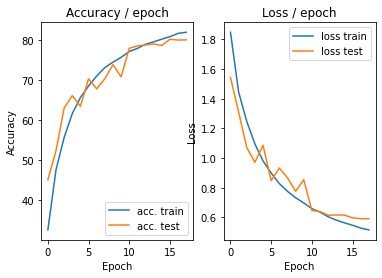

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.4076 (0.4076)	Prec@1  81.2 ( 81.2)	Prec@5 100.0 (100.0)


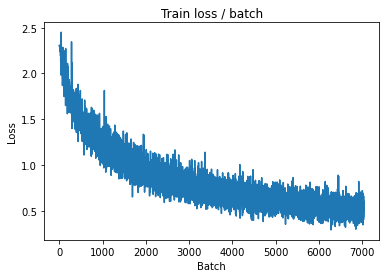

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.4614 (0.5011)	Prec@1  81.2 ( 82.4)	Prec@5  98.4 ( 99.3)


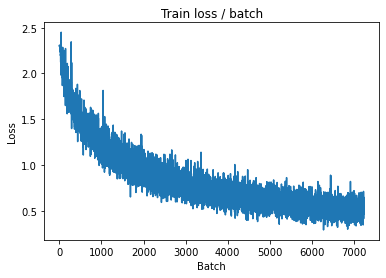


===============> Total time 7s	Avg loss 0.5012	Avg Prec@1 82.44 %	Avg Prec@5 99.23 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.5137 (0.5137)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5698	Avg Prec@1 80.95 %	Avg Prec@5 98.89 %



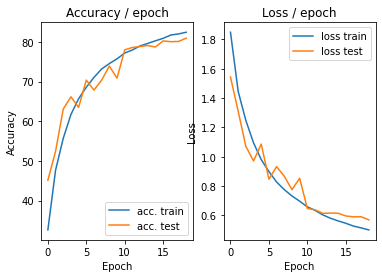

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.4400 (0.4400)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


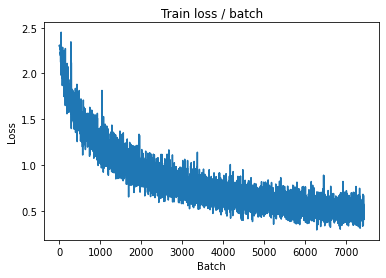

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.3895 (0.4769)	Prec@1  88.3 ( 83.3)	Prec@5  98.4 ( 99.3)


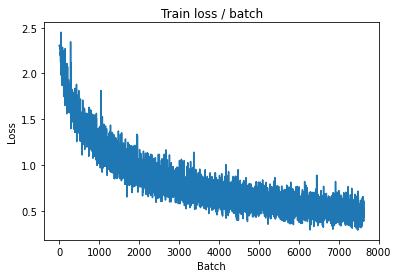


===============> Total time 7s	Avg loss 0.4822	Avg Prec@1 83.11 %	Avg Prec@5 99.31 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.5699 (0.5699)	Prec@1  82.8 ( 82.8)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5682	Avg Prec@1 81.29 %	Avg Prec@5 98.84 %



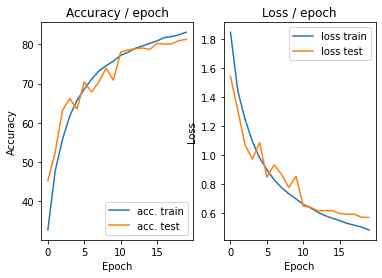

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.3761 (0.3761)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


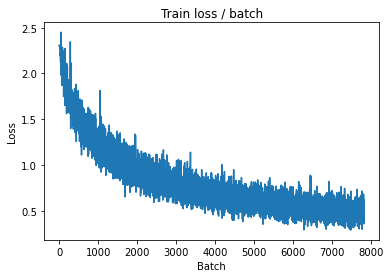

[TRAIN Batch 200/391]	Time 0.010s (0.019s)	Loss 0.5822 (0.4711)	Prec@1  80.5 ( 83.7)	Prec@5  99.2 ( 99.3)


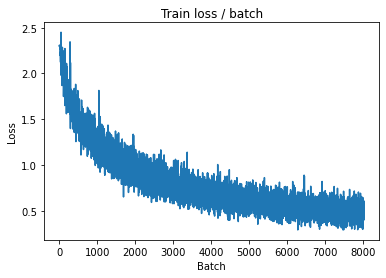


===============> Total time 7s	Avg loss 0.4701	Avg Prec@1 83.61 %	Avg Prec@5 99.30 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.4923 (0.4923)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5760	Avg Prec@1 80.29 %	Avg Prec@5 98.87 %



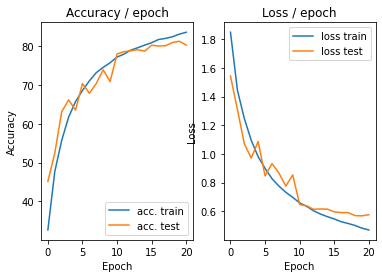

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.259s (0.259s)	Loss 0.5526 (0.5526)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


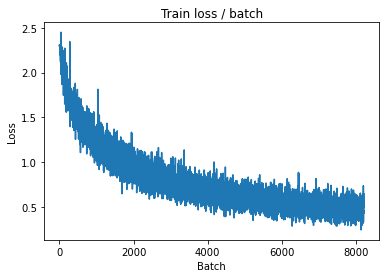

[TRAIN Batch 200/391]	Time 0.038s (0.022s)	Loss 0.3681 (0.4555)	Prec@1  87.5 ( 83.9)	Prec@5  98.4 ( 99.4)


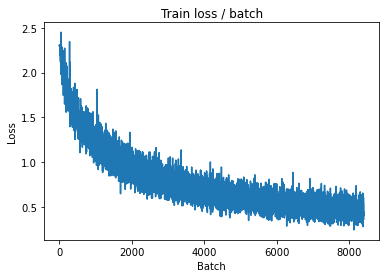


===============> Total time 8s	Avg loss 0.4549	Avg Prec@1 84.07 %	Avg Prec@5 99.39 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.5206 (0.5206)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5662	Avg Prec@1 80.73 %	Avg Prec@5 98.92 %



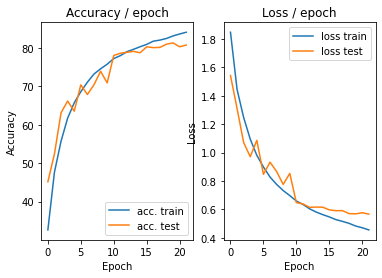

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.4449 (0.4449)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


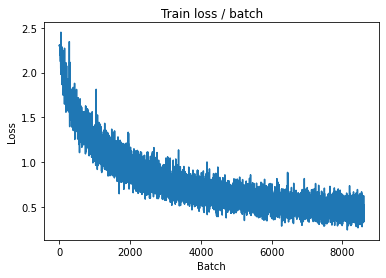

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.4253 (0.4443)	Prec@1  86.7 ( 84.4)	Prec@5  98.4 ( 99.4)


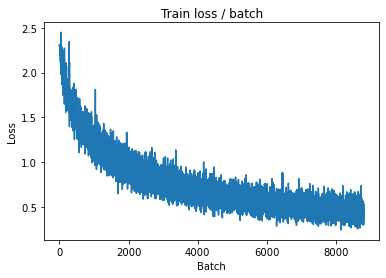


===============> Total time 7s	Avg loss 0.4465	Avg Prec@1 84.36 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.119s (0.119s)	Loss 0.5074 (0.5074)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5546	Avg Prec@1 81.30 %	Avg Prec@5 98.96 %



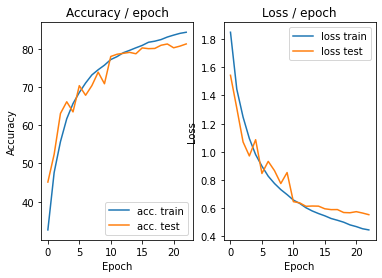

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.5261 (0.5261)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


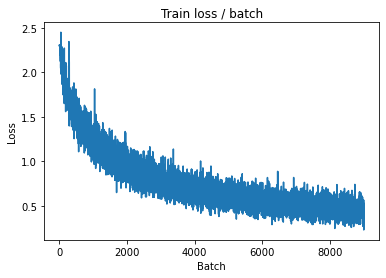

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.3715 (0.4338)	Prec@1  86.7 ( 84.7)	Prec@5  99.2 ( 99.4)


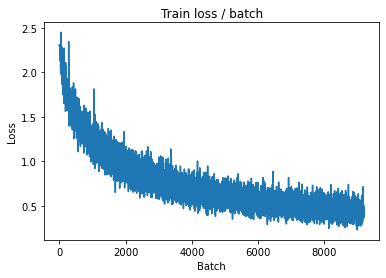


===============> Total time 7s	Avg loss 0.4351	Avg Prec@1 84.80 %	Avg Prec@5 99.43 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.5896 (0.5896)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5635	Avg Prec@1 81.75 %	Avg Prec@5 98.88 %



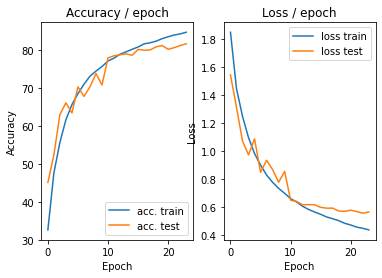

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.153s (0.153s)	Loss 0.4075 (0.4075)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)


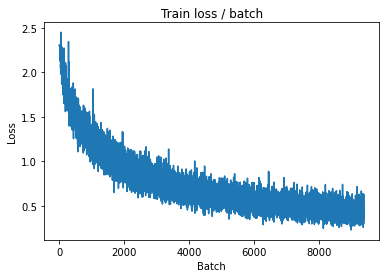

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.4385 (0.4207)	Prec@1  80.5 ( 85.2)	Prec@5 100.0 ( 99.5)


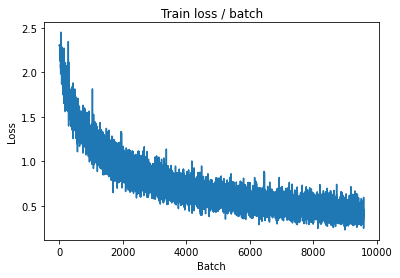


===============> Total time 7s	Avg loss 0.4243	Avg Prec@1 85.19 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.273s (0.273s)	Loss 0.4920 (0.4920)	Prec@1  79.7 ( 79.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5408	Avg Prec@1 81.48 %	Avg Prec@5 98.97 %



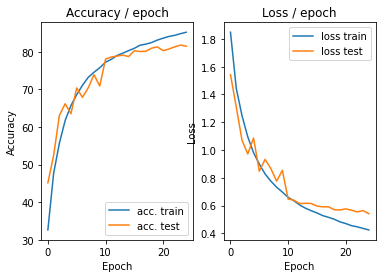

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.4072 (0.4072)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


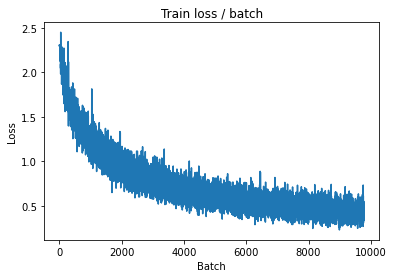

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.4900 (0.4188)	Prec@1  79.7 ( 85.1)	Prec@5  99.2 ( 99.5)


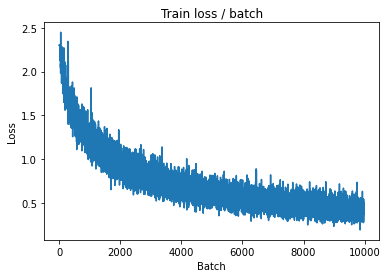


===============> Total time 7s	Avg loss 0.4176	Avg Prec@1 85.35 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.4754 (0.4754)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5706	Avg Prec@1 81.21 %	Avg Prec@5 98.94 %



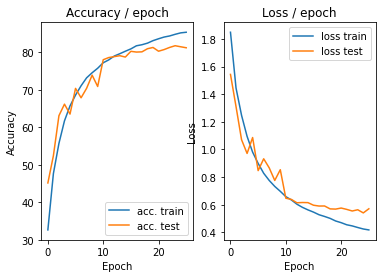

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.3533 (0.3533)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


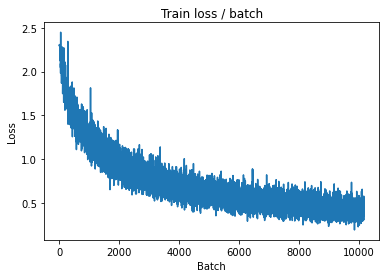

[TRAIN Batch 200/391]	Time 0.025s (0.018s)	Loss 0.4813 (0.4134)	Prec@1  82.8 ( 85.6)	Prec@5  99.2 ( 99.4)


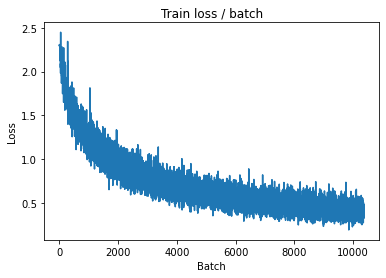


===============> Total time 7s	Avg loss 0.4080	Avg Prec@1 85.66 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.5083 (0.5083)	Prec@1  82.8 ( 82.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5503	Avg Prec@1 82.25 %	Avg Prec@5 98.90 %



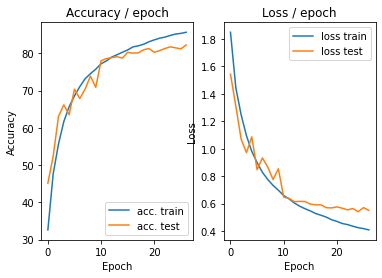

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.3262 (0.3262)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


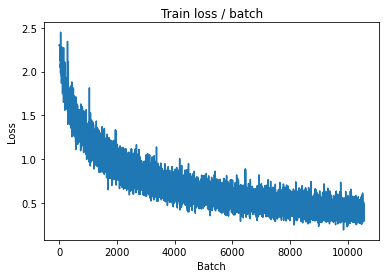

[TRAIN Batch 200/391]	Time 0.029s (0.021s)	Loss 0.4417 (0.3930)	Prec@1  86.7 ( 86.2)	Prec@5 100.0 ( 99.5)


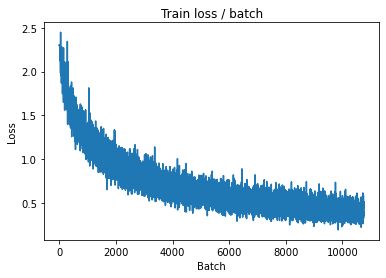


===============> Total time 7s	Avg loss 0.4001	Avg Prec@1 85.95 %	Avg Prec@5 99.55 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.5886 (0.5886)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5551	Avg Prec@1 81.76 %	Avg Prec@5 99.06 %



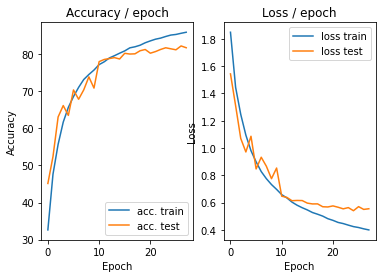

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.3441 (0.3441)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


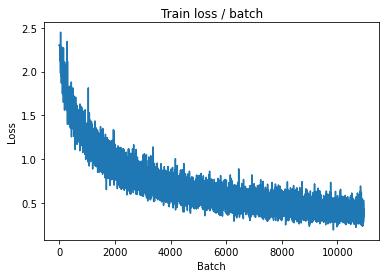

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 0.3610 (0.3831)	Prec@1  85.2 ( 86.4)	Prec@5 100.0 ( 99.6)


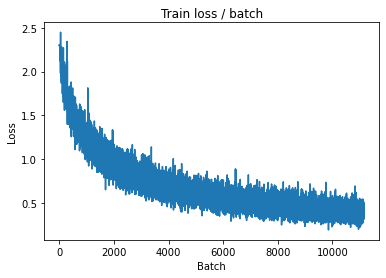


===============> Total time 7s	Avg loss 0.3906	Avg Prec@1 86.26 %	Avg Prec@5 99.54 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.5398 (0.5398)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5448	Avg Prec@1 82.19 %	Avg Prec@5 98.98 %



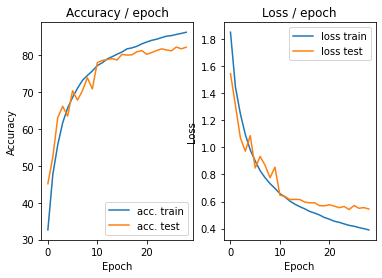

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.3558 (0.3558)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


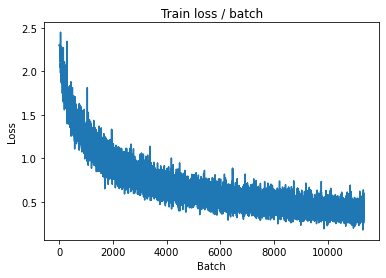

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.4161 (0.3786)	Prec@1  86.7 ( 86.8)	Prec@5  99.2 ( 99.6)


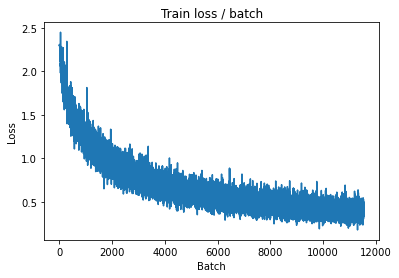


===============> Total time 8s	Avg loss 0.3824	Avg Prec@1 86.56 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4592 (0.4592)	Prec@1  81.2 ( 81.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5196	Avg Prec@1 82.81 %	Avg Prec@5 99.04 %



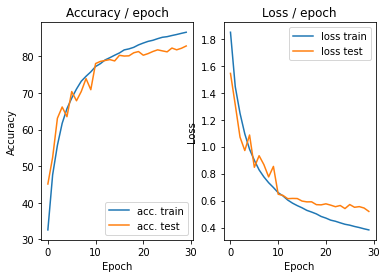

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.3421 (0.3421)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


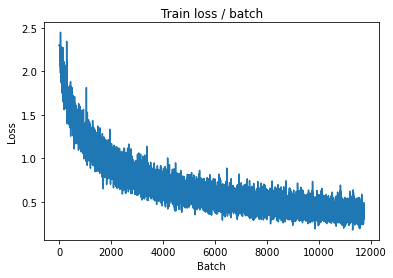

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.3360 (0.3709)	Prec@1  87.5 ( 87.0)	Prec@5 100.0 ( 99.6)


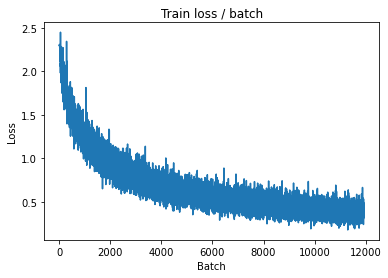


===============> Total time 7s	Avg loss 0.3739	Avg Prec@1 86.80 %	Avg Prec@5 99.58 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.4422 (0.4422)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5085	Avg Prec@1 83.07 %	Avg Prec@5 99.03 %



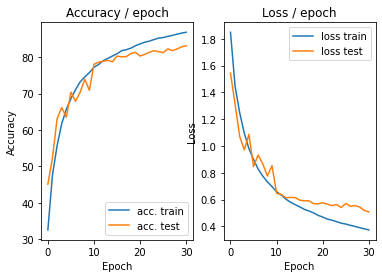

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.2877 (0.2877)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


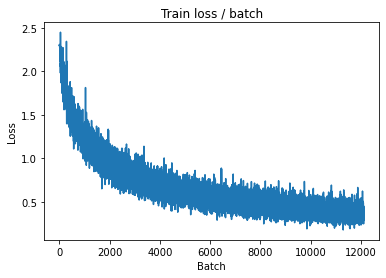

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.4228 (0.3698)	Prec@1  86.7 ( 87.0)	Prec@5  99.2 ( 99.6)


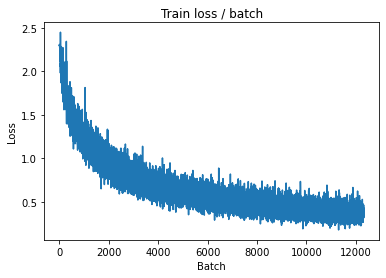


===============> Total time 7s	Avg loss 0.3684	Avg Prec@1 87.10 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.5053 (0.5053)	Prec@1  79.7 ( 79.7)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5254	Avg Prec@1 82.68 %	Avg Prec@5 99.01 %



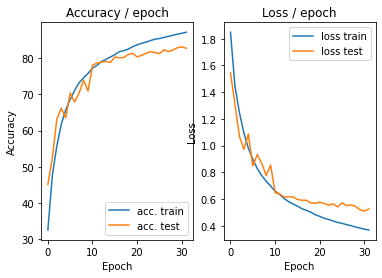

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.291s (0.291s)	Loss 0.5053 (0.5053)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


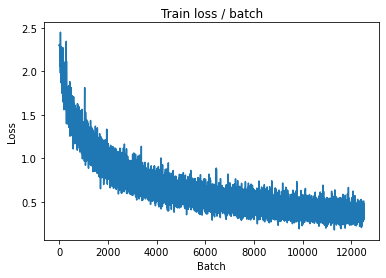

[TRAIN Batch 200/391]	Time 0.037s (0.023s)	Loss 0.2601 (0.3617)	Prec@1  89.8 ( 87.6)	Prec@5 100.0 ( 99.6)


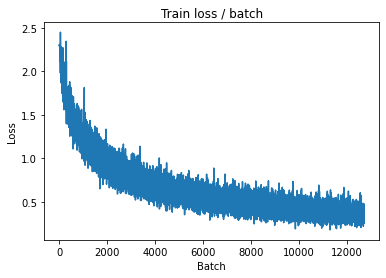


===============> Total time 8s	Avg loss 0.3621	Avg Prec@1 87.41 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.4735 (0.4735)	Prec@1  82.0 ( 82.0)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5169	Avg Prec@1 83.14 %	Avg Prec@5 98.98 %



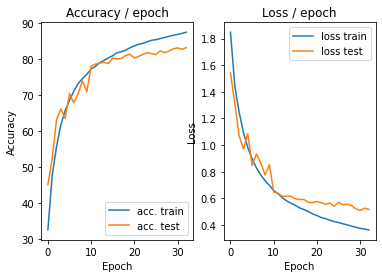

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.2704 (0.2704)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


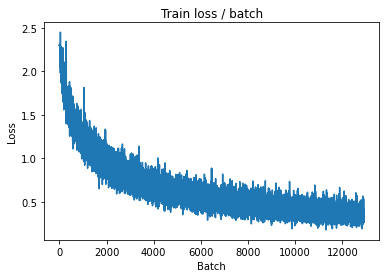

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.3494 (0.3572)	Prec@1  85.2 ( 87.4)	Prec@5 100.0 ( 99.7)


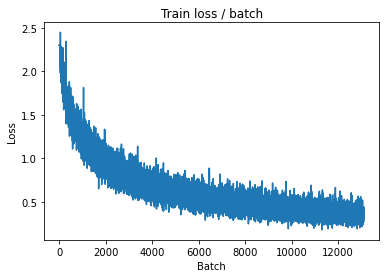


===============> Total time 7s	Avg loss 0.3563	Avg Prec@1 87.42 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.4529 (0.4529)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5327	Avg Prec@1 82.86 %	Avg Prec@5 98.97 %



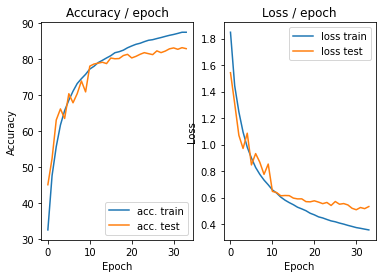

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.4883 (0.4883)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


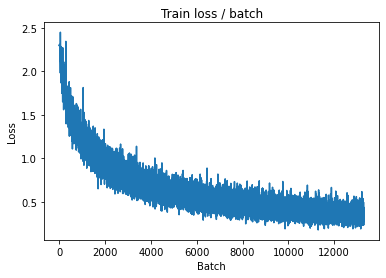

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.2611 (0.3497)	Prec@1  90.6 ( 87.8)	Prec@5 100.0 ( 99.6)


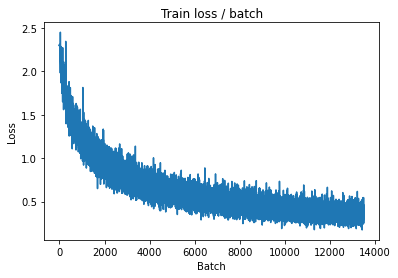


===============> Total time 7s	Avg loss 0.3495	Avg Prec@1 87.81 %	Avg Prec@5 99.64 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.4806 (0.4806)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5221	Avg Prec@1 83.08 %	Avg Prec@5 98.98 %



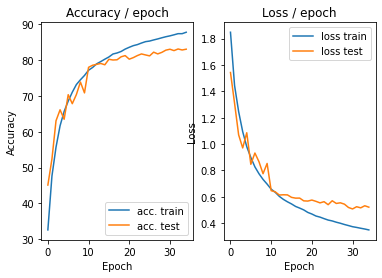

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3212 (0.3212)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


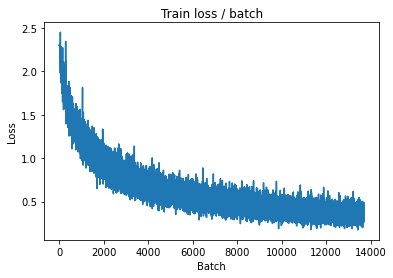

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.3425 (0.3448)	Prec@1  88.3 ( 87.8)	Prec@5 100.0 ( 99.7)


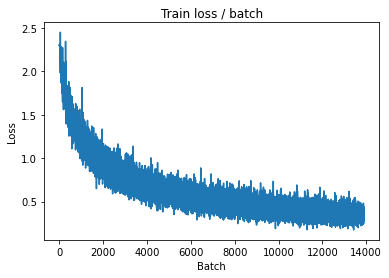


===============> Total time 7s	Avg loss 0.3431	Avg Prec@1 87.98 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.279s (0.279s)	Loss 0.4549 (0.4549)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5111	Avg Prec@1 83.42 %	Avg Prec@5 99.13 %



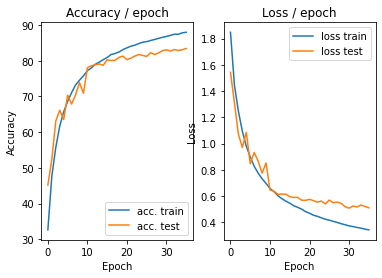

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.2898 (0.2898)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


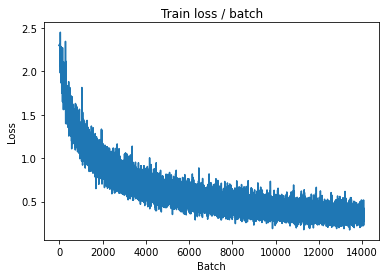

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3430 (0.3435)	Prec@1  89.1 ( 88.2)	Prec@5  98.4 ( 99.7)


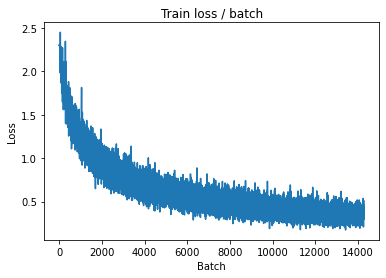


===============> Total time 7s	Avg loss 0.3394	Avg Prec@1 88.23 %	Avg Prec@5 99.70 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.4573 (0.4573)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5152	Avg Prec@1 83.17 %	Avg Prec@5 99.03 %



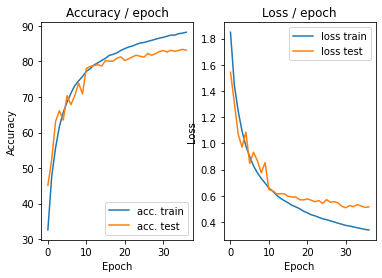

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.3292 (0.3292)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


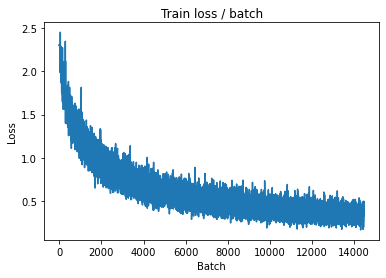

[TRAIN Batch 200/391]	Time 0.021s (0.019s)	Loss 0.3221 (0.3303)	Prec@1  87.5 ( 88.0)	Prec@5 100.0 ( 99.7)


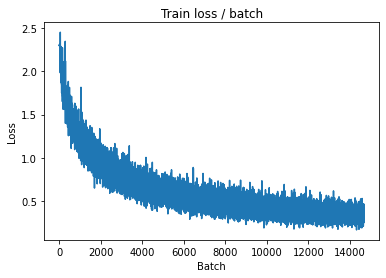


===============> Total time 7s	Avg loss 0.3319	Avg Prec@1 88.23 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.4645 (0.4645)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5059	Avg Prec@1 83.59 %	Avg Prec@5 99.15 %



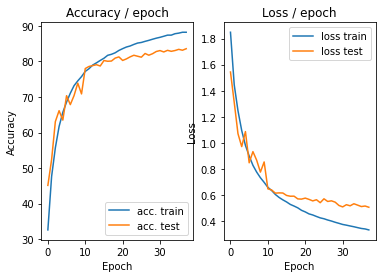

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3255 (0.3255)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


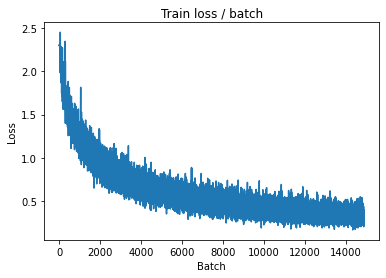

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.2559 (0.3293)	Prec@1  89.1 ( 88.2)	Prec@5  99.2 ( 99.7)


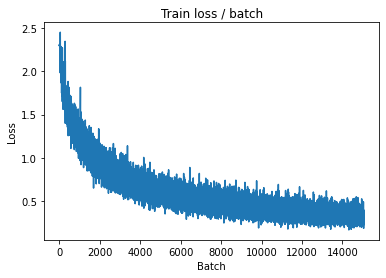


===============> Total time 7s	Avg loss 0.3305	Avg Prec@1 88.37 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.4551 (0.4551)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5022	Avg Prec@1 83.53 %	Avg Prec@5 98.95 %



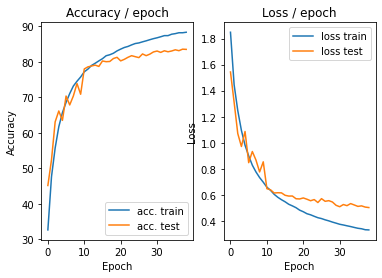

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.126s (0.126s)	Loss 0.2467 (0.2467)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


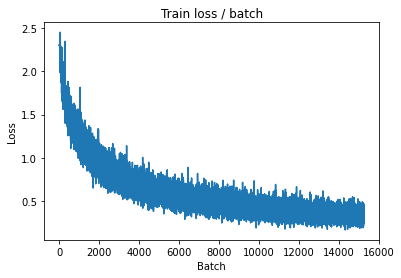

[TRAIN Batch 200/391]	Time 0.037s (0.021s)	Loss 0.2724 (0.3161)	Prec@1  89.1 ( 89.0)	Prec@5 100.0 ( 99.8)


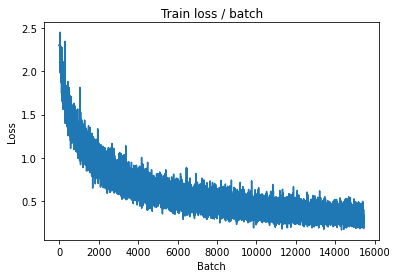


===============> Total time 8s	Avg loss 0.3230	Avg Prec@1 88.61 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.4677 (0.4677)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5023	Avg Prec@1 83.86 %	Avg Prec@5 99.11 %



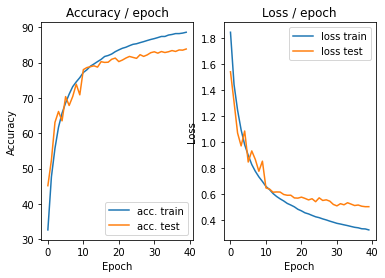

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.2986 (0.2986)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


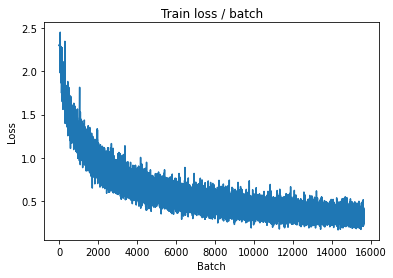

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.3576 (0.3181)	Prec@1  87.5 ( 88.7)	Prec@5  99.2 ( 99.7)


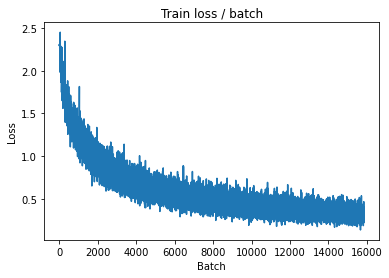


===============> Total time 7s	Avg loss 0.3174	Avg Prec@1 88.77 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.4469 (0.4469)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5098	Avg Prec@1 83.78 %	Avg Prec@5 99.10 %



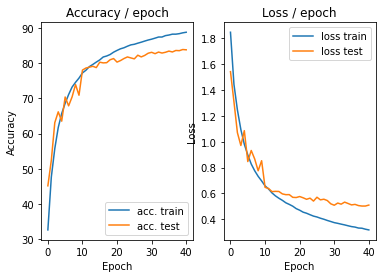

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.2326 (0.2326)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


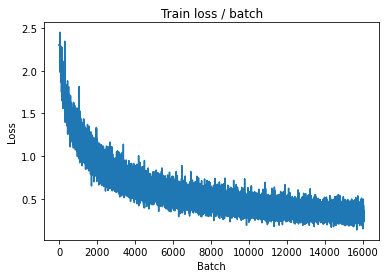

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3760 (0.3146)	Prec@1  89.1 ( 89.0)	Prec@5 100.0 ( 99.8)


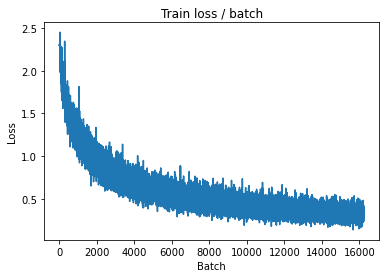


===============> Total time 7s	Avg loss 0.3151	Avg Prec@1 89.04 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.117s (0.117s)	Loss 0.4527 (0.4527)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5136	Avg Prec@1 83.58 %	Avg Prec@5 99.07 %



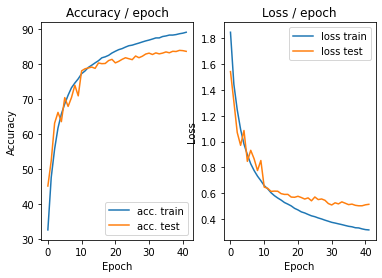

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.3241 (0.3241)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


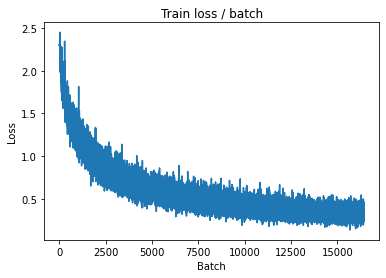

[TRAIN Batch 200/391]	Time 0.033s (0.019s)	Loss 0.4362 (0.3162)	Prec@1  84.4 ( 88.9)	Prec@5 100.0 ( 99.7)


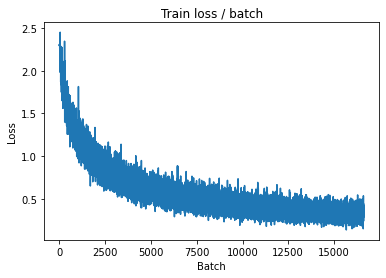


===============> Total time 7s	Avg loss 0.3139	Avg Prec@1 89.10 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.4545 (0.4545)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5059	Avg Prec@1 83.48 %	Avg Prec@5 99.09 %



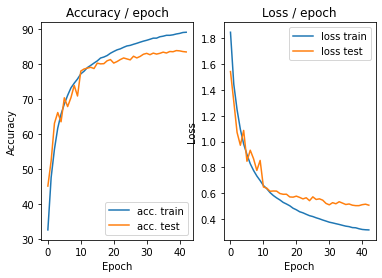

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.274s (0.274s)	Loss 0.4540 (0.4540)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


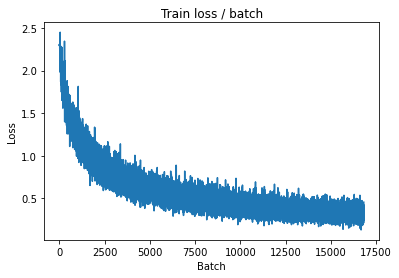

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.2898 (0.3110)	Prec@1  89.8 ( 89.2)	Prec@5 100.0 ( 99.7)


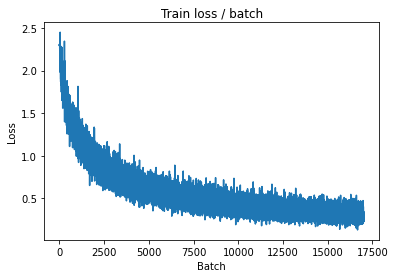


===============> Total time 7s	Avg loss 0.3109	Avg Prec@1 89.20 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.129s (0.129s)	Loss 0.4364 (0.4364)	Prec@1  82.8 ( 82.8)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5057	Avg Prec@1 83.59 %	Avg Prec@5 99.04 %



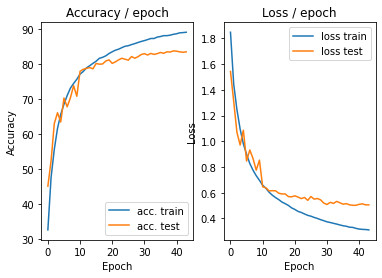

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.2468 (0.2468)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


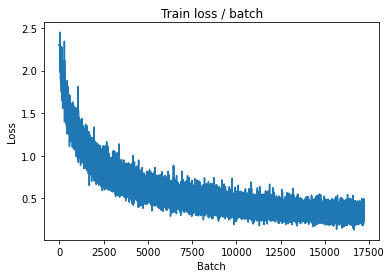

[TRAIN Batch 200/391]	Time 0.037s (0.021s)	Loss 0.3355 (0.3061)	Prec@1  88.3 ( 89.1)	Prec@5 100.0 ( 99.7)


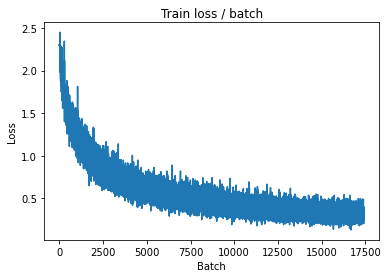


===============> Total time 8s	Avg loss 0.3071	Avg Prec@1 89.09 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.4934 (0.4934)	Prec@1  80.5 ( 80.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5055	Avg Prec@1 83.78 %	Avg Prec@5 99.13 %



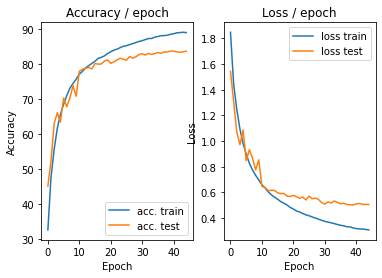

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.2474 (0.2474)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


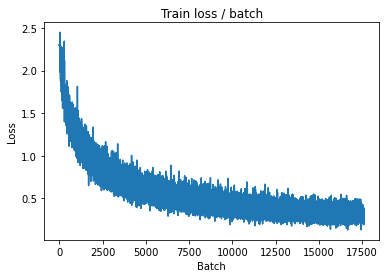

[TRAIN Batch 200/391]	Time 0.033s (0.020s)	Loss 0.3750 (0.2985)	Prec@1  89.1 ( 89.5)	Prec@5  99.2 ( 99.7)


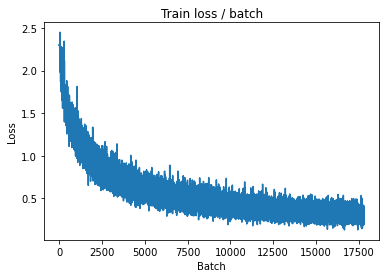


===============> Total time 7s	Avg loss 0.3008	Avg Prec@1 89.40 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.120s (0.120s)	Loss 0.4478 (0.4478)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5024	Avg Prec@1 83.92 %	Avg Prec@5 99.12 %



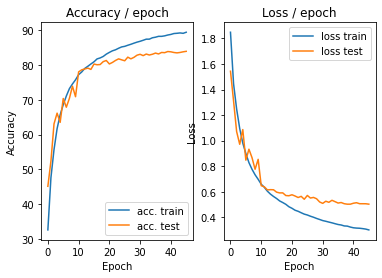

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.2226 (0.2226)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


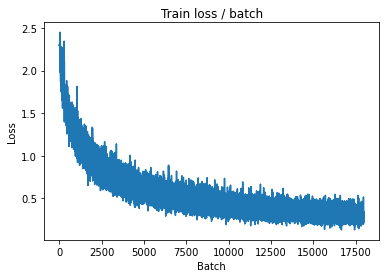

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.2292 (0.2979)	Prec@1  93.0 ( 89.4)	Prec@5 100.0 ( 99.7)


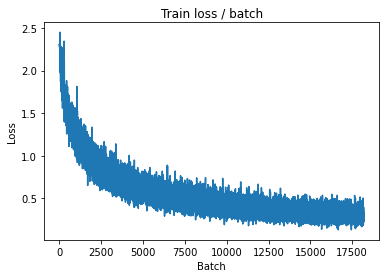


===============> Total time 8s	Avg loss 0.2971	Avg Prec@1 89.49 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.319s (0.319s)	Loss 0.4337 (0.4337)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5072	Avg Prec@1 84.05 %	Avg Prec@5 99.06 %



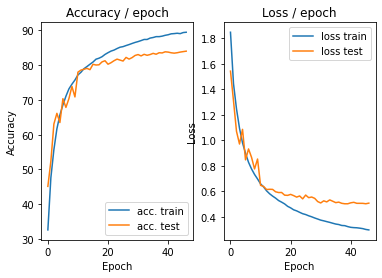

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.2380 (0.2380)	Prec@1  93.0 ( 93.0)	Prec@5  99.2 ( 99.2)


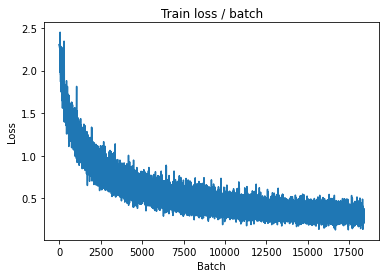

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 0.2882 (0.2960)	Prec@1  89.8 ( 89.7)	Prec@5  99.2 ( 99.7)


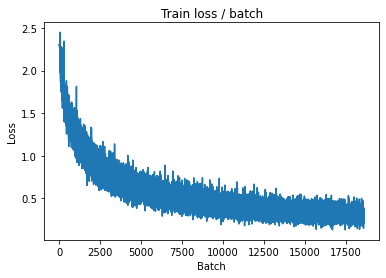


===============> Total time 7s	Avg loss 0.2977	Avg Prec@1 89.54 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.4741 (0.4741)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4998	Avg Prec@1 83.86 %	Avg Prec@5 99.06 %



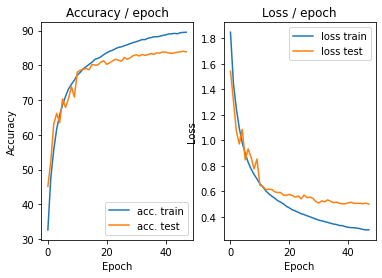

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.1991 (0.1991)	Prec@1  92.2 ( 92.2)	Prec@5 100.0 (100.0)


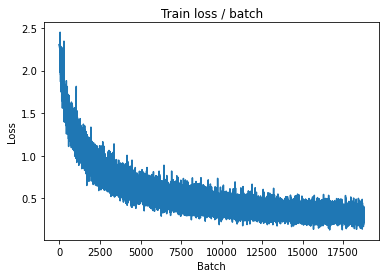

[TRAIN Batch 200/391]	Time 0.006s (0.019s)	Loss 0.3319 (0.3003)	Prec@1  85.9 ( 89.7)	Prec@5 100.0 ( 99.8)


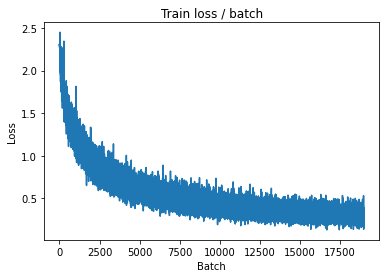


===============> Total time 7s	Avg loss 0.2926	Avg Prec@1 89.73 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.4503 (0.4503)	Prec@1  82.8 ( 82.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5102	Avg Prec@1 84.08 %	Avg Prec@5 99.12 %



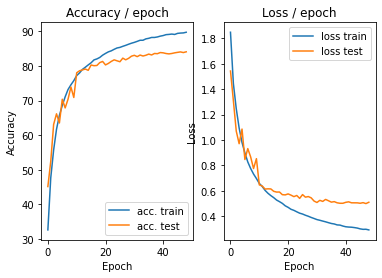

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.125s (0.125s)	Loss 0.2475 (0.2475)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


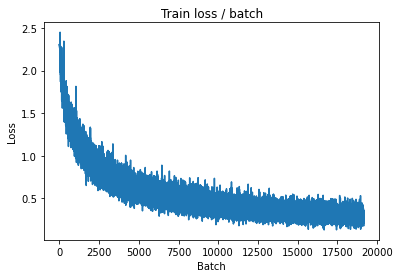

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.2911 (0.2845)	Prec@1  89.8 ( 90.0)	Prec@5 100.0 ( 99.8)


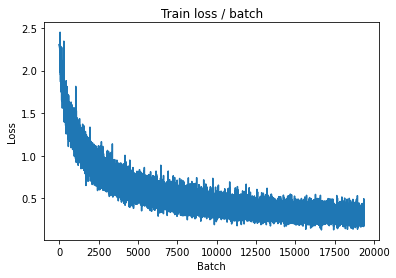


===============> Total time 7s	Avg loss 0.2863	Avg Prec@1 89.91 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.4484 (0.4484)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5011	Avg Prec@1 83.92 %	Avg Prec@5 99.07 %



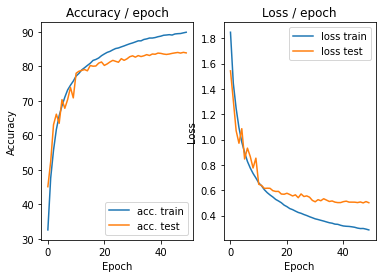

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.2337 (0.2337)	Prec@1  93.8 ( 93.8)	Prec@5 100.0 (100.0)


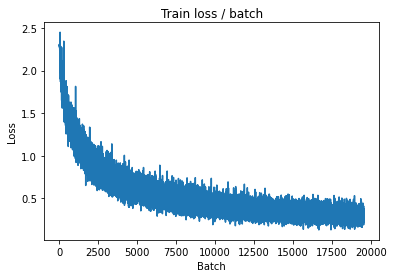

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.3018 (0.2882)	Prec@1  89.1 ( 90.0)	Prec@5  98.4 ( 99.8)


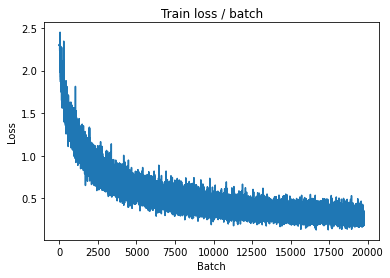


===============> Total time 8s	Avg loss 0.2874	Avg Prec@1 89.99 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.4463 (0.4463)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5014	Avg Prec@1 83.86 %	Avg Prec@5 99.07 %



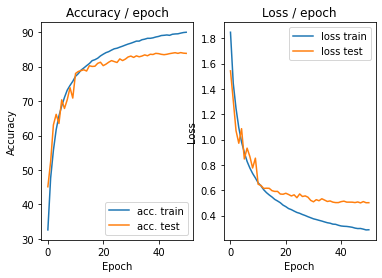

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3053 (0.3053)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


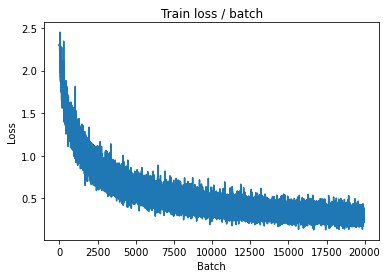

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.3035 (0.2857)	Prec@1  90.6 ( 89.9)	Prec@5 100.0 ( 99.8)


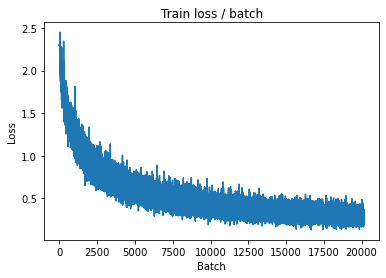


===============> Total time 7s	Avg loss 0.2840	Avg Prec@1 89.98 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.165s (0.165s)	Loss 0.4602 (0.4602)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4990	Avg Prec@1 84.18 %	Avg Prec@5 99.10 %



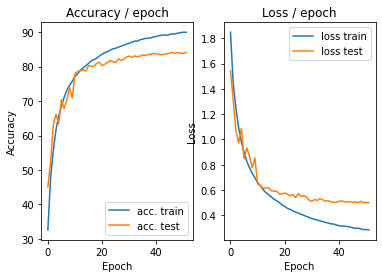

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.2146 (0.2146)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


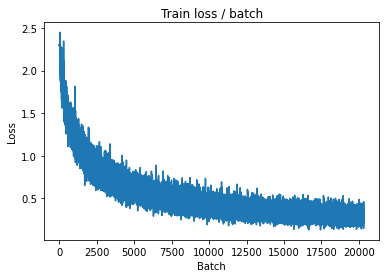

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.3159 (0.2800)	Prec@1  90.6 ( 90.1)	Prec@5  99.2 ( 99.8)


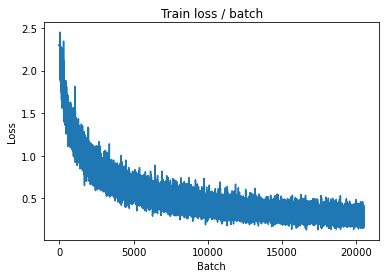


===============> Total time 7s	Avg loss 0.2828	Avg Prec@1 90.02 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.4301 (0.4301)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4998	Avg Prec@1 84.15 %	Avg Prec@5 99.06 %



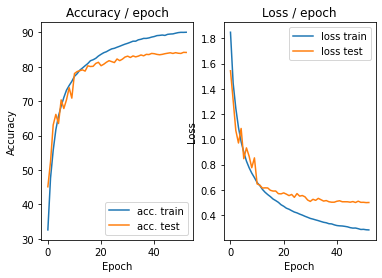

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.3221 (0.3221)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


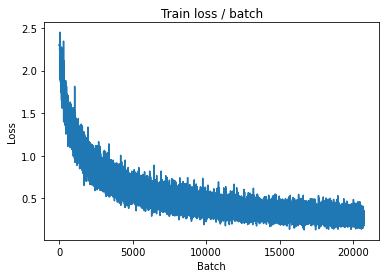

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3599 (0.2786)	Prec@1  88.3 ( 90.1)	Prec@5 100.0 ( 99.8)


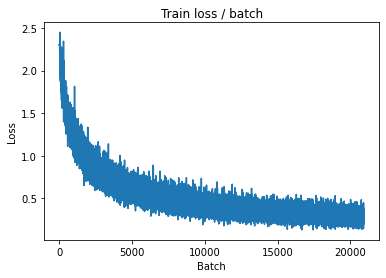


===============> Total time 7s	Avg loss 0.2810	Avg Prec@1 90.15 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.128s (0.128s)	Loss 0.4440 (0.4440)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4943	Avg Prec@1 84.27 %	Avg Prec@5 99.10 %



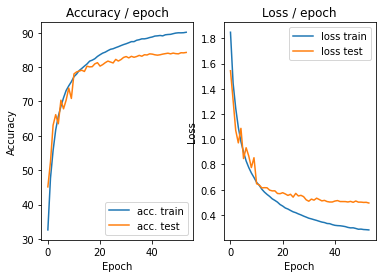

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.2263 (0.2263)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


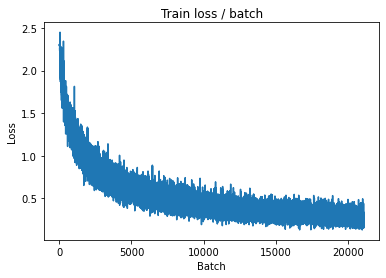

[TRAIN Batch 200/391]	Time 0.036s (0.023s)	Loss 0.1836 (0.2753)	Prec@1  94.5 ( 90.4)	Prec@5 100.0 ( 99.7)


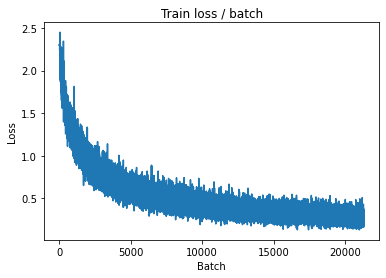


===============> Total time 8s	Avg loss 0.2755	Avg Prec@1 90.27 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.4287 (0.4287)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4995	Avg Prec@1 84.48 %	Avg Prec@5 99.13 %



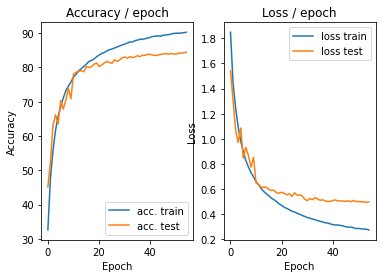

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.3360 (0.3360)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


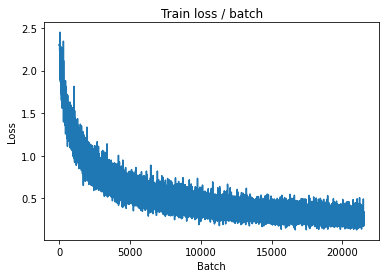

[TRAIN Batch 200/391]	Time 0.032s (0.021s)	Loss 0.3132 (0.2747)	Prec@1  90.6 ( 90.3)	Prec@5 100.0 ( 99.8)


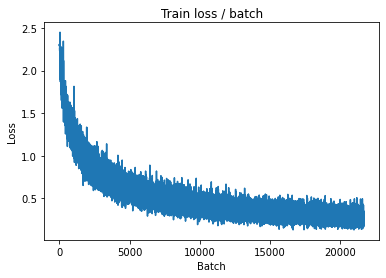


===============> Total time 8s	Avg loss 0.2732	Avg Prec@1 90.48 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.4400 (0.4400)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4974	Avg Prec@1 84.55 %	Avg Prec@5 99.12 %



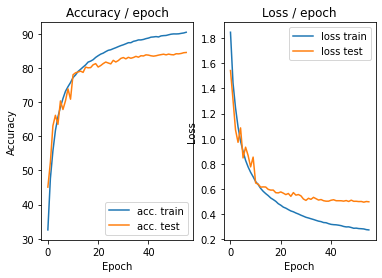

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.2084 (0.2084)	Prec@1  91.4 ( 91.4)	Prec@5  99.2 ( 99.2)


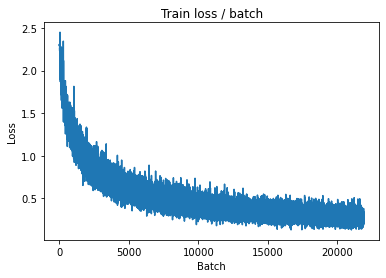

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.2827 (0.2671)	Prec@1  88.3 ( 90.6)	Prec@5  99.2 ( 99.8)


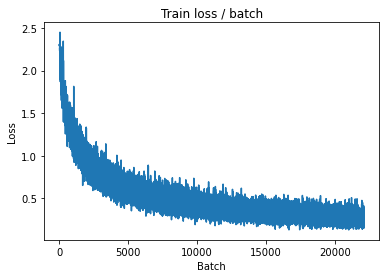


===============> Total time 7s	Avg loss 0.2718	Avg Prec@1 90.47 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.4610 (0.4610)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5010	Avg Prec@1 84.23 %	Avg Prec@5 99.03 %



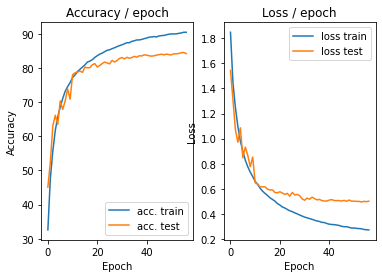

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.1783 (0.1783)	Prec@1  95.3 ( 95.3)	Prec@5 100.0 (100.0)


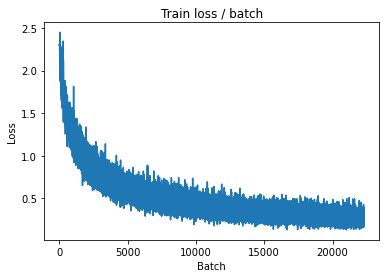

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.2041 (0.2758)	Prec@1  90.6 ( 90.2)	Prec@5 100.0 ( 99.8)


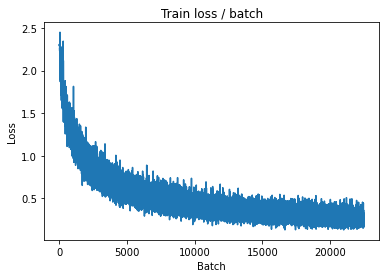


===============> Total time 8s	Avg loss 0.2749	Avg Prec@1 90.29 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.275s (0.275s)	Loss 0.4357 (0.4357)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4968	Avg Prec@1 84.27 %	Avg Prec@5 99.11 %



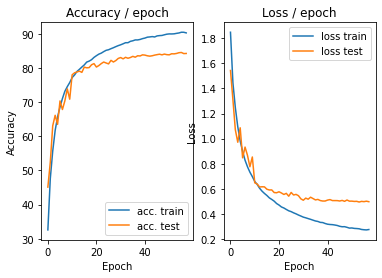

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.3523 (0.3523)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


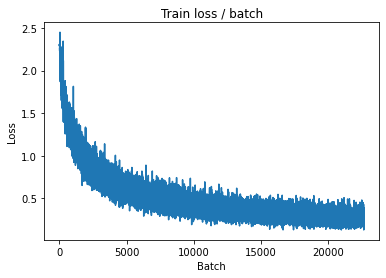

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3096 (0.2729)	Prec@1  91.4 ( 90.2)	Prec@5 100.0 ( 99.9)


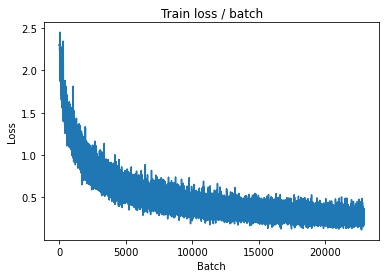


===============> Total time 7s	Avg loss 0.2732	Avg Prec@1 90.21 %	Avg Prec@5 99.84 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.4297 (0.4297)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4967	Avg Prec@1 84.38 %	Avg Prec@5 99.12 %



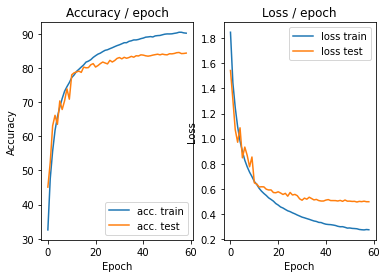

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.2006 (0.2006)	Prec@1  94.5 ( 94.5)	Prec@5 100.0 (100.0)


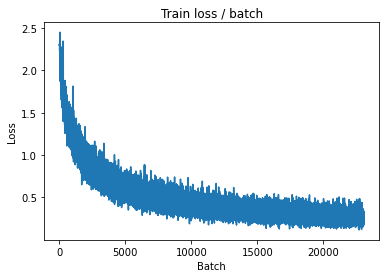

[TRAIN Batch 200/391]	Time 0.006s (0.022s)	Loss 0.3323 (0.2699)	Prec@1  85.9 ( 90.7)	Prec@5 100.0 ( 99.8)


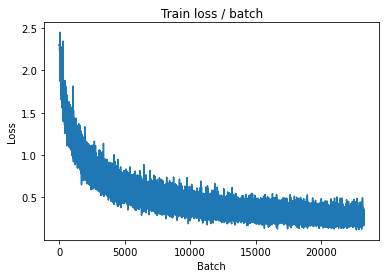


===============> Total time 8s	Avg loss 0.2683	Avg Prec@1 90.68 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.4380 (0.4380)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4974	Avg Prec@1 84.53 %	Avg Prec@5 99.14 %



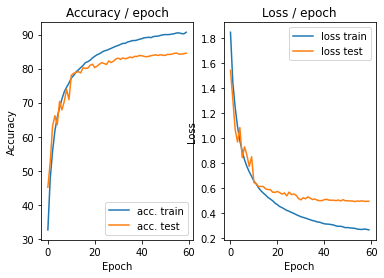

In [41]:
main(128, 0.1,60, cuda=True)

## BachNorm

In [42]:
class ConvNet(nn.Module):
    """
    This class defines the structure of the neural network
    """

    def __init__(self):
        super(ConvNet, self).__init__()
        # We first define the convolution and pooling layers as a features extractor
        self.features = nn.Sequential(
            nn.Conv2d(3, 32, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(32),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(32, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0),
            nn.Conv2d(64, 64, (5, 5), stride=1, padding=2),
            nn.BatchNorm2d(64),
            nn.ReLU(),
            nn.MaxPool2d((2, 2), stride=2, padding=0,ceil_mode=True)
        )
        # We then define fully connected layers as a classifier
        self.classifier = nn.Sequential(
            nn.Linear(1024, 1000),
            nn.ReLU(),
            nn.Dropout(),
            nn.Linear(1000, 10)
            # Reminder: The softmax is included in the loss, do not put it here
        )

    # Method called when we apply the network to an input batch
    def forward(self, input):
        bsize = input.size(0) # batch size
        output = self.features(input) # output of the conv layers
        output = output.view(bsize, -1) # we flatten the 2D feature maps into one 1D vector for each input
        output = self.classifier(output) # we compute the output of the fc layers
        return output



def get_dataset(batch_size, cuda=False):
    """
    This function loads the dataset and performs transformations on each
    image (listed in `transform = ...`).
    """
    train_dataset = datasets.CIFAR10(PATH, train=True, download=True,                      
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.RandomCrop(28),
            transforms.RandomHorizontalFlip(p=0.5)
        ]))
    
    val_dataset = datasets.CIFAR10(PATH, train=False, download=True,
        transform=transforms.Compose([
            transforms.ToTensor(),
            transforms.Normalize((0.491, 0.482, 0.447), (0.202, 0.199, 0.201)),
            transforms.CenterCrop(28)
        ]))

    train_loader = torch.utils.data.DataLoader(train_dataset,
                        batch_size=batch_size, shuffle=True, pin_memory=cuda, num_workers=2)
    val_loader = torch.utils.data.DataLoader(val_dataset,
                        batch_size=batch_size, shuffle=False, pin_memory=cuda, num_workers=2)

    return train_loader, val_loader



def epoch(data, model, criterion, optimizer=None, cuda=False):
    """
    Make a pass (called epoch in English) on the data `data` with the
     model `model`. Evaluates `criterion` as loss.
     If `optimizer` is given, perform a training epoch using
     the given optimizer, otherwise, perform an evaluation epoch (no backward)
     of the model.
    """

    # indicates whether the model is in eval or train mode (some layers behave differently in train and eval)
    model.eval() if optimizer is None else model.train()

    # objects to store metric averages
    avg_loss = AverageMeter()
    avg_top1_acc = AverageMeter()
    avg_top5_acc = AverageMeter()
    avg_batch_time = AverageMeter()
    global loss_plot

    # we iterate on the batches
    tic = time.time()
    for i, (input, target) in enumerate(data):

        if cuda: # only with GPU, and not with CPU
            input = input.cuda()
            target = target.cuda()

        # forward
        output = model(input)
        loss = criterion(output, target)

        # backward if we are training
        if optimizer:
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()

        # compute metrics
        prec1, prec5 = accuracy(output, target, topk=(1, 5))
        batch_time = time.time() - tic
        tic = time.time()

        # update
        avg_loss.update(loss.item())
        avg_top1_acc.update(prec1.item())
        avg_top5_acc.update(prec5.item())
        avg_batch_time.update(batch_time)
        if optimizer:
            loss_plot.update(avg_loss.val)
        # print info
        if i % PRINT_INTERVAL == 0:
            print('[{0:s} Batch {1:03d}/{2:03d}]\t'
                  'Time {batch_time.val:.3f}s ({batch_time.avg:.3f}s)\t'
                  'Loss {loss.val:.4f} ({loss.avg:.4f})\t'
                  'Prec@1 {top1.val:5.1f} ({top1.avg:5.1f})\t'
                  'Prec@5 {top5.val:5.1f} ({top5.avg:5.1f})'.format(
                   "EVAL" if optimizer is None else "TRAIN", i, len(data), batch_time=avg_batch_time, loss=avg_loss,
                   top1=avg_top1_acc, top5=avg_top5_acc))
            if optimizer:
                loss_plot.plot()

    # Print summary
    print('\n===============> Total time {batch_time:d}s\t'
          'Avg loss {loss.avg:.4f}\t'
          'Avg Prec@1 {top1.avg:5.2f} %\t'
          'Avg Prec@5 {top5.avg:5.2f} %\n'.format(
           batch_time=int(avg_batch_time.sum), loss=avg_loss,
           top1=avg_top1_acc, top5=avg_top5_acc))

    return avg_top1_acc, avg_top5_acc, avg_loss


def main(batch_size=128, lr=0.1, epochs=5, cuda=False):

    # ex :
    #   {"batch_size": 128, "epochs": 5, "lr": 0.1}

    # define model, loss, optim
    model = ConvNet()
    criterion = nn.CrossEntropyLoss()
    optimizer = torch.optim.SGD(model.parameters(), lr)
    lr_sched = torch.optim.lr_scheduler.ExponentialLR(optimizer, gamma=0.95)

    if cuda: # only with GPU, and not with CPU
        cudnn.benchmark = True
        model = model.cuda()
        criterion = criterion.cuda()

    # Get the data
    train, test = get_dataset(batch_size, cuda)

    # init plots
    plot = AccLossPlot()
    global loss_plot
    loss_plot = TrainLossPlot()

    # We iterate on the epochs
    for i in range(epochs):
        print("=================\n=== EPOCH "+str(i+1)+" =====\n=================\n")
        # Train phase
        top1_acc, avg_top5_acc, loss = epoch(train, model, criterion, optimizer, cuda)
        # Test phase
        top1_acc_test, top5_acc_test, loss_test = epoch(test, model, criterion, cuda=cuda)
        # plot
        plot.update(loss.avg, loss_test.avg, top1_acc.avg, top1_acc_test.avg)
        #update lr scheduler
        lr_sched.step()

Files already downloaded and verified
Files already downloaded and verified
=== EPOCH 1 =====

[TRAIN Batch 000/391]	Time 0.150s (0.150s)	Loss 2.3285 (2.3285)	Prec@1  13.3 ( 13.3)	Prec@5  53.1 ( 53.1)


<Figure size 432x288 with 0 Axes>

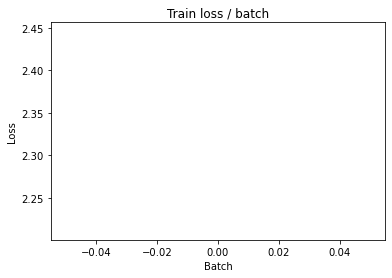

[TRAIN Batch 200/391]	Time 0.007s (0.021s)	Loss 1.3537 (1.6635)	Prec@1  50.8 ( 38.7)	Prec@5  90.6 ( 88.2)


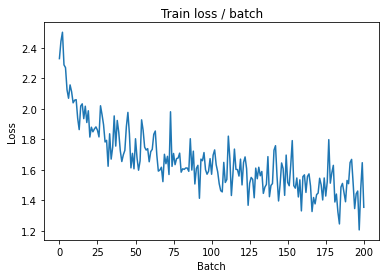


===============> Total time 8s	Avg loss 1.5198	Avg Prec@1 44.35 %	Avg Prec@5 90.78 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 1.2674 (1.2674)	Prec@1  52.3 ( 52.3)	Prec@5  95.3 ( 95.3)

===============> Total time 1s	Avg loss 1.3815	Avg Prec@1 51.54 %	Avg Prec@5 92.26 %



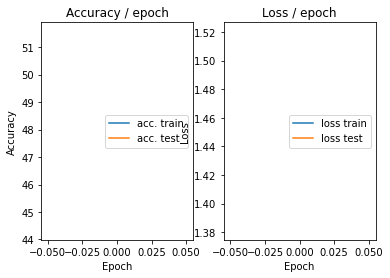

=== EPOCH 2 =====

[TRAIN Batch 000/391]	Time 0.254s (0.254s)	Loss 1.2114 (1.2114)	Prec@1  54.7 ( 54.7)	Prec@5  96.9 ( 96.9)


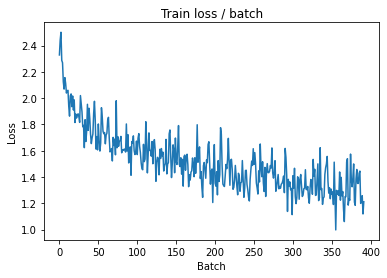

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 1.5475 (1.1959)	Prec@1  44.5 ( 57.1)	Prec@5  89.8 ( 95.3)


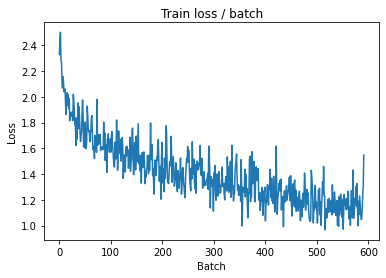


===============> Total time 7s	Avg loss 1.1516	Avg Prec@1 58.74 %	Avg Prec@5 95.65 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 1.0124 (1.0124)	Prec@1  66.4 ( 66.4)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 1.1197	Avg Prec@1 59.04 %	Avg Prec@5 96.06 %



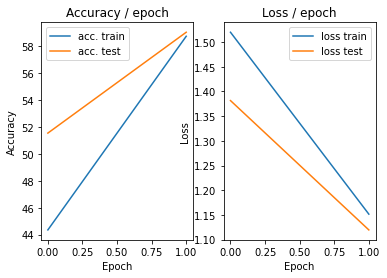

=== EPOCH 3 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.9854 (0.9854)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


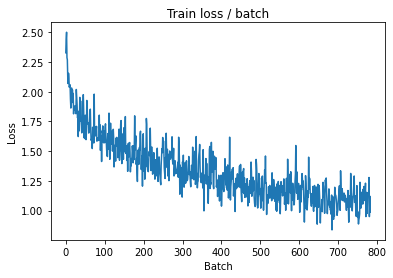

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 1.0139 (1.0146)	Prec@1  61.7 ( 64.1)	Prec@5  95.3 ( 96.7)


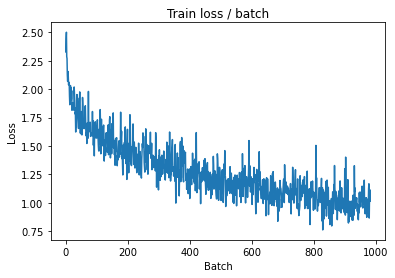


===============> Total time 8s	Avg loss 0.9865	Avg Prec@1 65.01 %	Avg Prec@5 96.94 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.9608 (0.9608)	Prec@1  66.4 ( 66.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9917	Avg Prec@1 65.51 %	Avg Prec@5 96.42 %



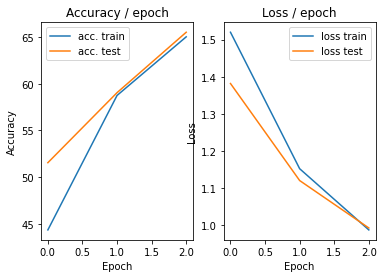

=== EPOCH 4 =====

[TRAIN Batch 000/391]	Time 0.146s (0.146s)	Loss 0.7999 (0.7999)	Prec@1  68.0 ( 68.0)	Prec@5  97.7 ( 97.7)


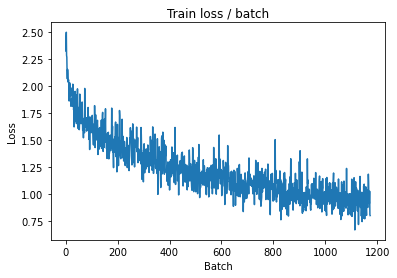

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.9444 (0.8866)	Prec@1  64.1 ( 68.7)	Prec@5  96.9 ( 97.5)


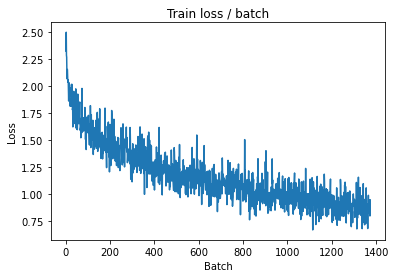


===============> Total time 7s	Avg loss 0.8752	Avg Prec@1 69.09 %	Avg Prec@5 97.64 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.7281 (0.7281)	Prec@1  78.1 ( 78.1)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7593	Avg Prec@1 73.70 %	Avg Prec@5 98.10 %



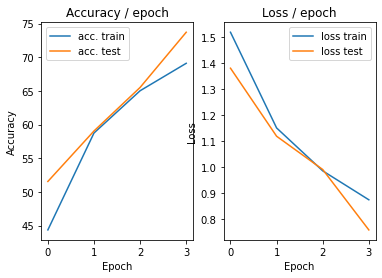

=== EPOCH 5 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.7890 (0.7890)	Prec@1  75.8 ( 75.8)	Prec@5  98.4 ( 98.4)


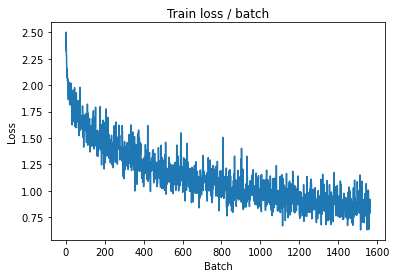

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.6760 (0.7988)	Prec@1  75.8 ( 72.0)	Prec@5  99.2 ( 97.9)


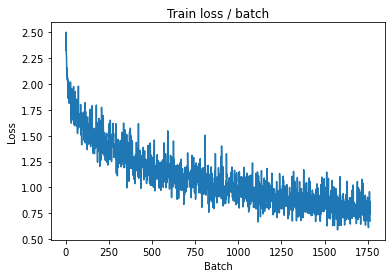


===============> Total time 7s	Avg loss 0.8012	Avg Prec@1 72.01 %	Avg Prec@5 97.89 %

[EVAL Batch 000/079]	Time 0.272s (0.272s)	Loss 0.8568 (0.8568)	Prec@1  67.2 ( 67.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.9326	Avg Prec@1 66.99 %	Avg Prec@5 97.29 %



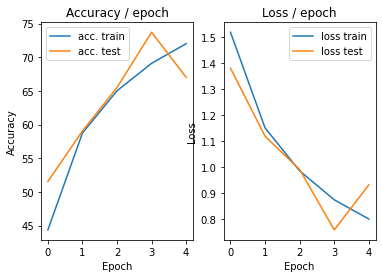

=== EPOCH 6 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.9669 (0.9669)	Prec@1  69.5 ( 69.5)	Prec@5  96.1 ( 96.1)


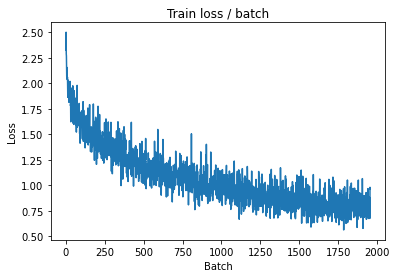

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.7489 (0.7524)	Prec@1  75.0 ( 73.6)	Prec@5  98.4 ( 98.2)


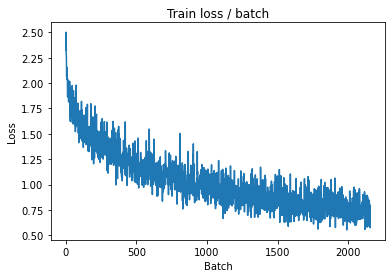


===============> Total time 7s	Avg loss 0.7457	Avg Prec@1 73.87 %	Avg Prec@5 98.26 %

[EVAL Batch 000/079]	Time 0.167s (0.167s)	Loss 0.7133 (0.7133)	Prec@1  77.3 ( 77.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7600	Avg Prec@1 73.61 %	Avg Prec@5 98.12 %



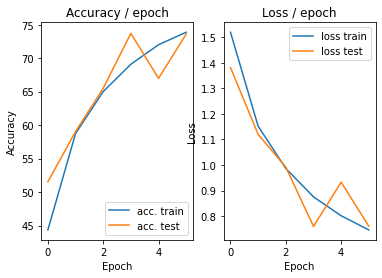

=== EPOCH 7 =====

[TRAIN Batch 000/391]	Time 0.148s (0.148s)	Loss 0.6780 (0.6780)	Prec@1  73.4 ( 73.4)	Prec@5  96.9 ( 96.9)


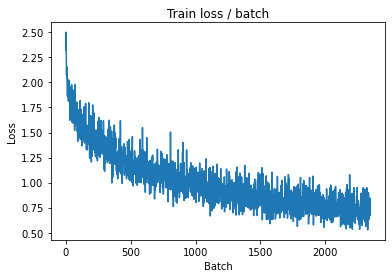

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.7623 (0.7145)	Prec@1  71.9 ( 74.9)	Prec@5  99.2 ( 98.5)


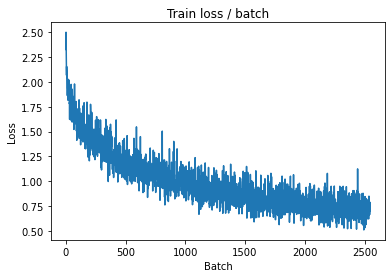


===============> Total time 7s	Avg loss 0.7051	Avg Prec@1 75.29 %	Avg Prec@5 98.46 %

[EVAL Batch 000/079]	Time 0.152s (0.152s)	Loss 0.6956 (0.6956)	Prec@1  78.9 ( 78.9)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.7408	Avg Prec@1 74.63 %	Avg Prec@5 97.94 %



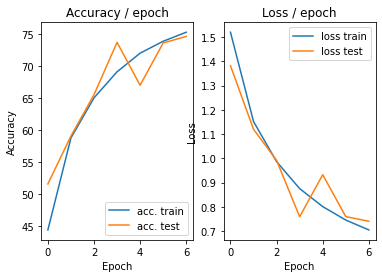

=== EPOCH 8 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.5266 (0.5266)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


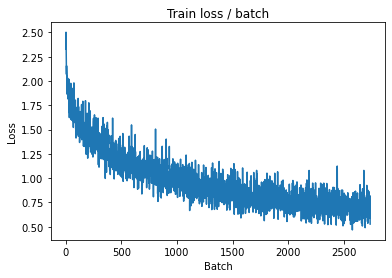

[TRAIN Batch 200/391]	Time 0.026s (0.019s)	Loss 0.6580 (0.6601)	Prec@1  73.4 ( 76.7)	Prec@5  99.2 ( 98.7)


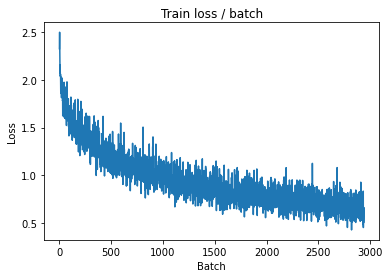


===============> Total time 7s	Avg loss 0.6627	Avg Prec@1 76.76 %	Avg Prec@5 98.62 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.6750 (0.6750)	Prec@1  80.5 ( 80.5)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.7459	Avg Prec@1 74.43 %	Avg Prec@5 98.13 %



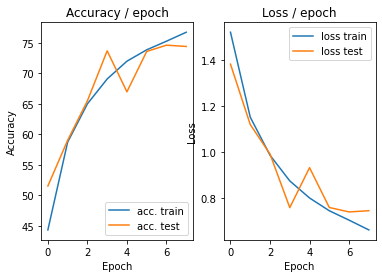

=== EPOCH 9 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.6906 (0.6906)	Prec@1  72.7 ( 72.7)	Prec@5 100.0 (100.0)


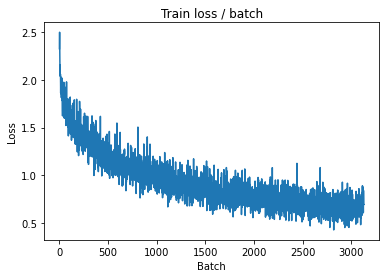

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.6875 (0.6294)	Prec@1  75.0 ( 77.9)	Prec@5  97.7 ( 98.7)


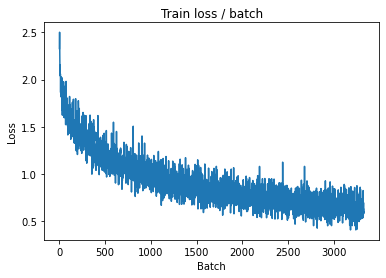


===============> Total time 8s	Avg loss 0.6298	Avg Prec@1 77.97 %	Avg Prec@5 98.73 %

[EVAL Batch 000/079]	Time 0.162s (0.162s)	Loss 0.6637 (0.6637)	Prec@1  75.8 ( 75.8)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6711	Avg Prec@1 76.23 %	Avg Prec@5 98.60 %



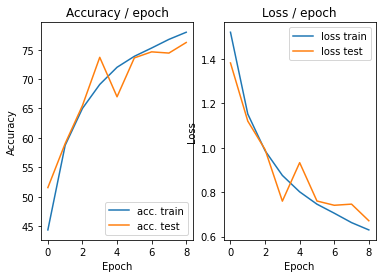

=== EPOCH 10 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.7897 (0.7897)	Prec@1  71.9 ( 71.9)	Prec@5  99.2 ( 99.2)


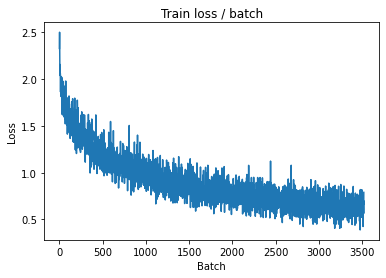

[TRAIN Batch 200/391]	Time 0.036s (0.022s)	Loss 0.6104 (0.6064)	Prec@1  75.8 ( 79.0)	Prec@5  97.7 ( 98.9)


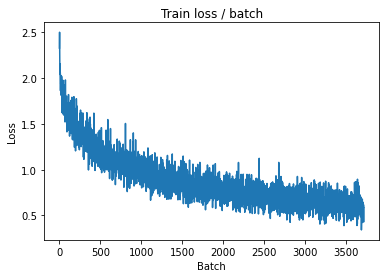


===============> Total time 8s	Avg loss 0.6035	Avg Prec@1 79.10 %	Avg Prec@5 98.89 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.5792 (0.5792)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6304	Avg Prec@1 78.66 %	Avg Prec@5 98.73 %



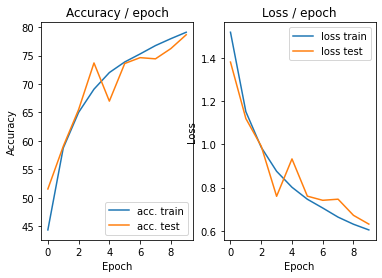

=== EPOCH 11 =====

[TRAIN Batch 000/391]	Time 0.149s (0.149s)	Loss 0.6040 (0.6040)	Prec@1  76.6 ( 76.6)	Prec@5 100.0 (100.0)


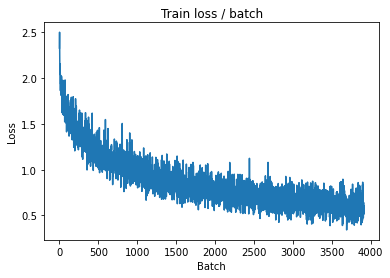

[TRAIN Batch 200/391]	Time 0.033s (0.022s)	Loss 0.5620 (0.5777)	Prec@1  79.7 ( 79.8)	Prec@5 100.0 ( 99.0)


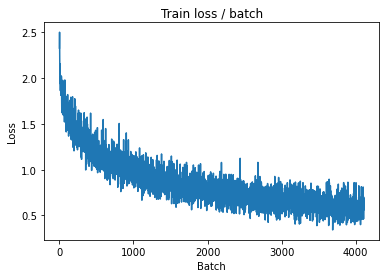


===============> Total time 8s	Avg loss 0.5834	Avg Prec@1 79.56 %	Avg Prec@5 98.93 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.4963 (0.4963)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5969	Avg Prec@1 79.54 %	Avg Prec@5 98.78 %



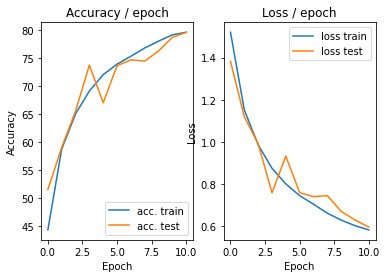

=== EPOCH 12 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.4440 (0.4440)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)


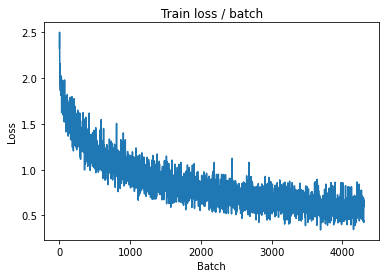

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.5030 (0.5440)	Prec@1  82.0 ( 81.2)	Prec@5  97.7 ( 99.1)


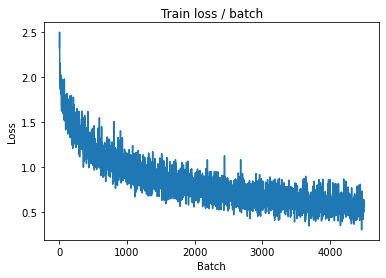


===============> Total time 7s	Avg loss 0.5515	Avg Prec@1 80.94 %	Avg Prec@5 99.05 %

[EVAL Batch 000/079]	Time 0.150s (0.150s)	Loss 0.5578 (0.5578)	Prec@1  82.0 ( 82.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6431	Avg Prec@1 77.39 %	Avg Prec@5 98.72 %



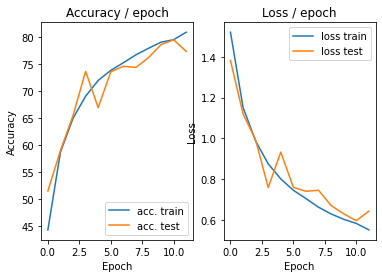

=== EPOCH 13 =====

[TRAIN Batch 000/391]	Time 0.294s (0.294s)	Loss 0.4428 (0.4428)	Prec@1  83.6 ( 83.6)	Prec@5 100.0 (100.0)


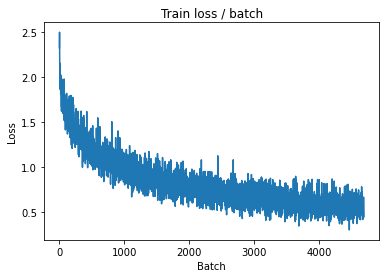

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.5806 (0.5366)	Prec@1  81.2 ( 81.3)	Prec@5  98.4 ( 99.0)


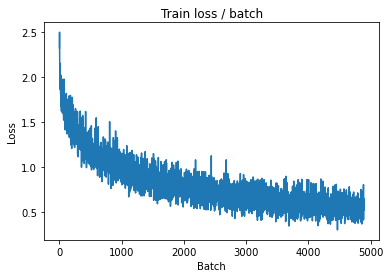


===============> Total time 7s	Avg loss 0.5413	Avg Prec@1 81.10 %	Avg Prec@5 99.09 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.5308 (0.5308)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5597	Avg Prec@1 80.43 %	Avg Prec@5 99.07 %



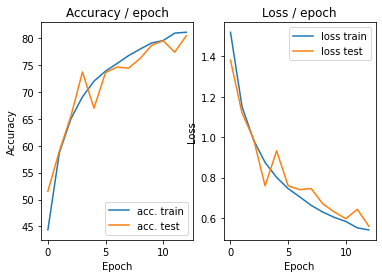

=== EPOCH 14 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.5996 (0.5996)	Prec@1  80.5 ( 80.5)	Prec@5  98.4 ( 98.4)


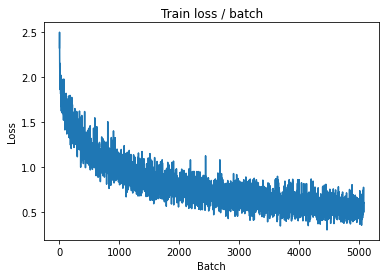

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.5655 (0.5148)	Prec@1  81.2 ( 82.0)	Prec@5  96.9 ( 99.1)


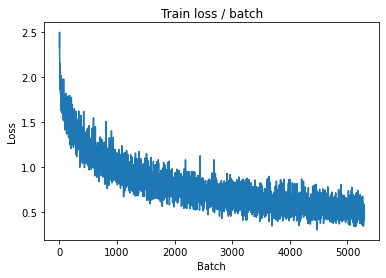


===============> Total time 7s	Avg loss 0.5191	Avg Prec@1 81.86 %	Avg Prec@5 99.12 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.6554 (0.6554)	Prec@1  75.0 ( 75.0)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.6674	Avg Prec@1 77.15 %	Avg Prec@5 98.40 %



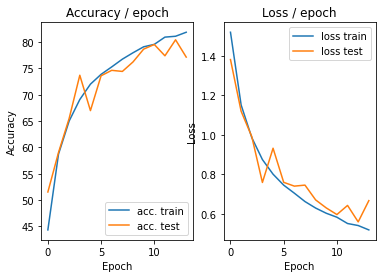

=== EPOCH 15 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.5465 (0.5465)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)


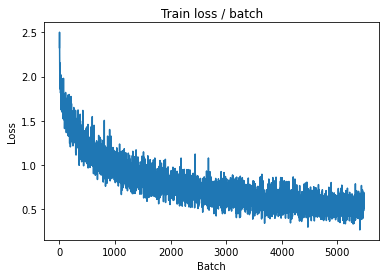

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.4529 (0.5028)	Prec@1  85.9 ( 82.6)	Prec@5 100.0 ( 99.2)


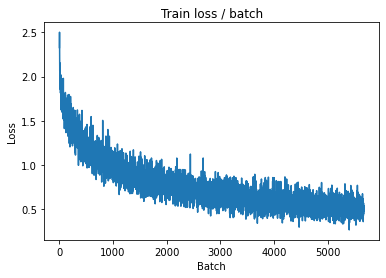


===============> Total time 7s	Avg loss 0.5054	Avg Prec@1 82.33 %	Avg Prec@5 99.24 %

[EVAL Batch 000/079]	Time 0.136s (0.136s)	Loss 0.5996 (0.5996)	Prec@1  81.2 ( 81.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5902	Avg Prec@1 79.47 %	Avg Prec@5 98.95 %



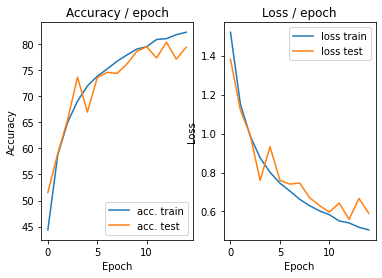

=== EPOCH 16 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.5170 (0.5170)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)


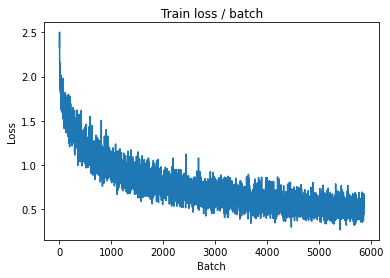

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.5734 (0.4911)	Prec@1  79.7 ( 82.8)	Prec@5  97.7 ( 99.4)


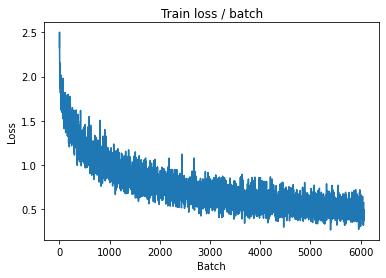


===============> Total time 7s	Avg loss 0.4925	Avg Prec@1 82.83 %	Avg Prec@5 99.27 %

[EVAL Batch 000/079]	Time 0.329s (0.329s)	Loss 0.5106 (0.5106)	Prec@1  84.4 ( 84.4)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5786	Avg Prec@1 80.11 %	Avg Prec@5 98.92 %



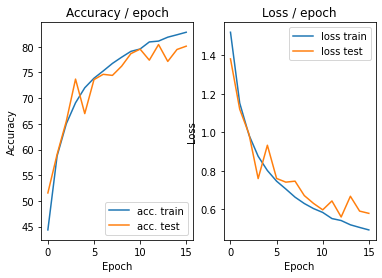

=== EPOCH 17 =====

[TRAIN Batch 000/391]	Time 0.140s (0.140s)	Loss 0.4520 (0.4520)	Prec@1  82.0 ( 82.0)	Prec@5 100.0 (100.0)


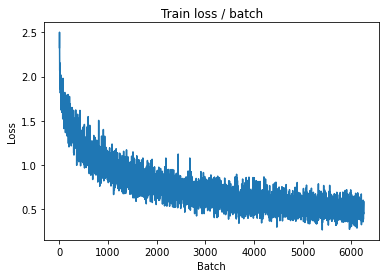

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.4604 (0.4754)	Prec@1  82.8 ( 83.7)	Prec@5 100.0 ( 99.3)


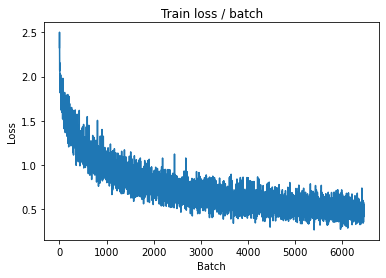


===============> Total time 7s	Avg loss 0.4742	Avg Prec@1 83.54 %	Avg Prec@5 99.25 %

[EVAL Batch 000/079]	Time 0.156s (0.156s)	Loss 0.5651 (0.5651)	Prec@1  81.2 ( 81.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5853	Avg Prec@1 79.97 %	Avg Prec@5 98.85 %



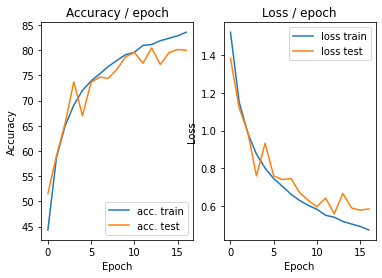

=== EPOCH 18 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.5370 (0.5370)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)


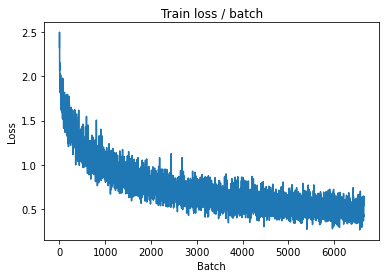

[TRAIN Batch 200/391]	Time 0.027s (0.020s)	Loss 0.4079 (0.4667)	Prec@1  85.2 ( 83.7)	Prec@5 100.0 ( 99.3)


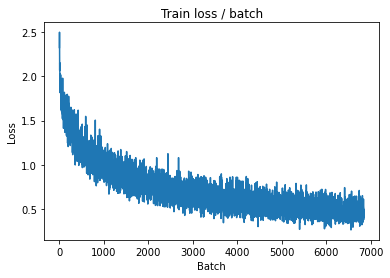


===============> Total time 7s	Avg loss 0.4651	Avg Prec@1 83.93 %	Avg Prec@5 99.33 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.5080 (0.5080)	Prec@1  84.4 ( 84.4)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5413	Avg Prec@1 81.23 %	Avg Prec@5 99.02 %



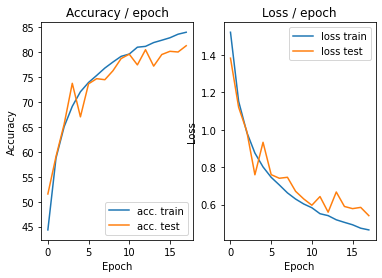

=== EPOCH 19 =====

[TRAIN Batch 000/391]	Time 0.134s (0.134s)	Loss 0.4309 (0.4309)	Prec@1  85.2 ( 85.2)	Prec@5 100.0 (100.0)


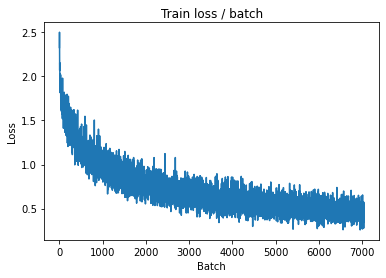

[TRAIN Batch 200/391]	Time 0.026s (0.019s)	Loss 0.4983 (0.4444)	Prec@1  83.6 ( 84.6)	Prec@5  98.4 ( 99.3)


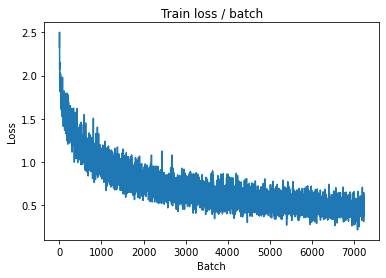


===============> Total time 7s	Avg loss 0.4513	Avg Prec@1 84.34 %	Avg Prec@5 99.34 %

[EVAL Batch 000/079]	Time 0.147s (0.147s)	Loss 0.4568 (0.4568)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5170	Avg Prec@1 82.01 %	Avg Prec@5 99.19 %



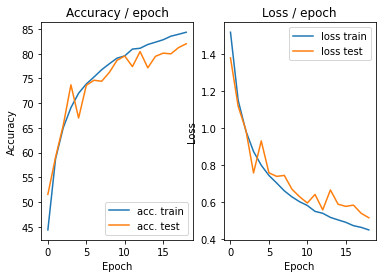

=== EPOCH 20 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.4513 (0.4513)	Prec@1  80.5 ( 80.5)	Prec@5 100.0 (100.0)


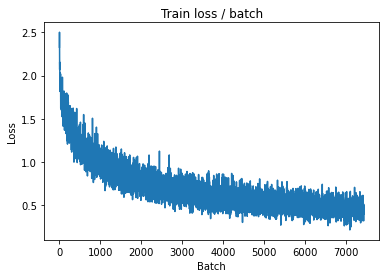

[TRAIN Batch 200/391]	Time 0.027s (0.020s)	Loss 0.3521 (0.4366)	Prec@1  88.3 ( 85.0)	Prec@5  98.4 ( 99.4)


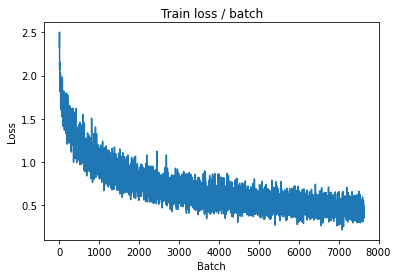


===============> Total time 7s	Avg loss 0.4398	Avg Prec@1 84.67 %	Avg Prec@5 99.37 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.4559 (0.4559)	Prec@1  86.7 ( 86.7)	Prec@5  96.9 ( 96.9)

===============> Total time 1s	Avg loss 0.5121	Avg Prec@1 82.54 %	Avg Prec@5 99.13 %



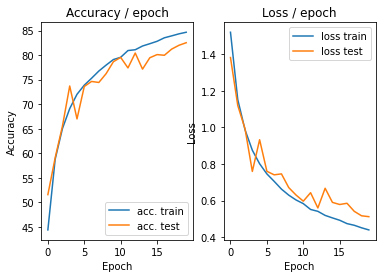

=== EPOCH 21 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.3719 (0.3719)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


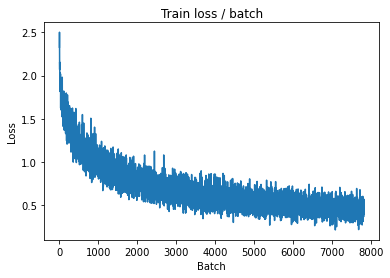

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.6779 (0.4350)	Prec@1  79.7 ( 84.8)	Prec@5  96.1 ( 99.5)


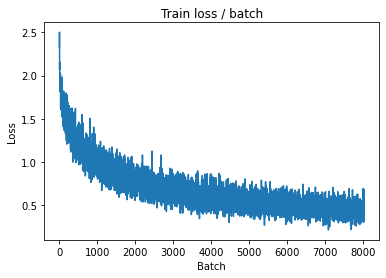


===============> Total time 7s	Avg loss 0.4295	Avg Prec@1 84.93 %	Avg Prec@5 99.47 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.4453 (0.4453)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.5023	Avg Prec@1 82.27 %	Avg Prec@5 99.29 %



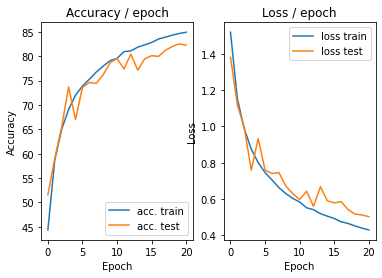

=== EPOCH 22 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.3516 (0.3516)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


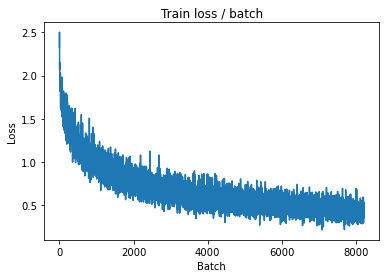

[TRAIN Batch 200/391]	Time 0.029s (0.019s)	Loss 0.4454 (0.4141)	Prec@1  82.0 ( 85.6)	Prec@5  99.2 ( 99.4)


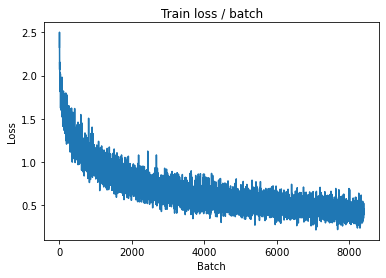


===============> Total time 7s	Avg loss 0.4197	Avg Prec@1 85.59 %	Avg Prec@5 99.41 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.4728 (0.4728)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.5065	Avg Prec@1 82.21 %	Avg Prec@5 99.16 %



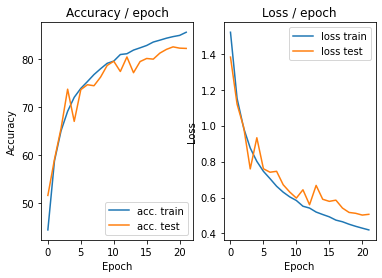

=== EPOCH 23 =====

[TRAIN Batch 000/391]	Time 0.127s (0.127s)	Loss 0.4935 (0.4935)	Prec@1  82.0 ( 82.0)	Prec@5  99.2 ( 99.2)


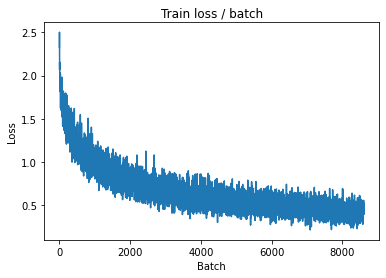

[TRAIN Batch 200/391]	Time 0.030s (0.019s)	Loss 0.4046 (0.4095)	Prec@1  85.9 ( 85.6)	Prec@5  98.4 ( 99.5)


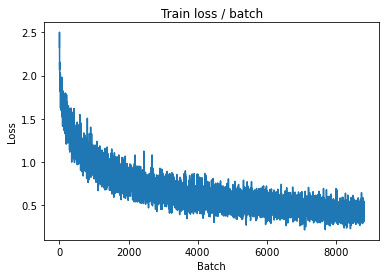


===============> Total time 7s	Avg loss 0.4093	Avg Prec@1 85.56 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.139s (0.139s)	Loss 0.5695 (0.5695)	Prec@1  78.9 ( 78.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.5270	Avg Prec@1 81.37 %	Avg Prec@5 99.33 %



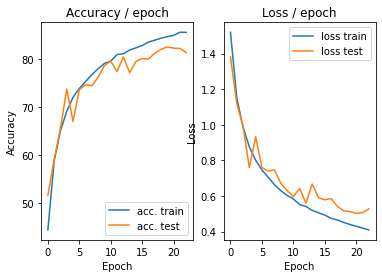

=== EPOCH 24 =====

[TRAIN Batch 000/391]	Time 0.280s (0.280s)	Loss 0.3958 (0.3958)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


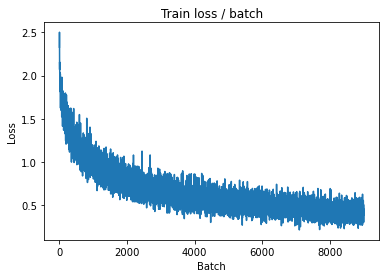

[TRAIN Batch 200/391]	Time 0.027s (0.022s)	Loss 0.4050 (0.4010)	Prec@1  85.2 ( 85.7)	Prec@5 100.0 ( 99.6)


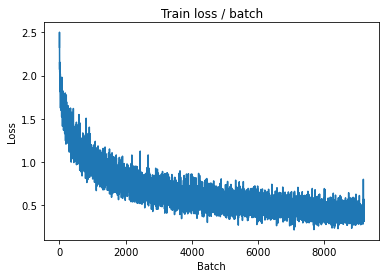


===============> Total time 7s	Avg loss 0.4023	Avg Prec@1 85.74 %	Avg Prec@5 99.51 %

[EVAL Batch 000/079]	Time 0.144s (0.144s)	Loss 0.4747 (0.4747)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4993	Avg Prec@1 82.39 %	Avg Prec@5 99.06 %



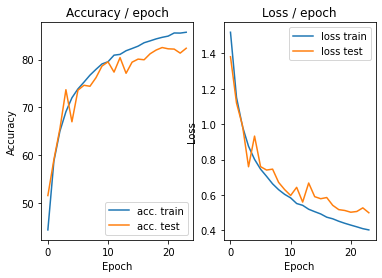

=== EPOCH 25 =====

[TRAIN Batch 000/391]	Time 0.129s (0.129s)	Loss 0.3428 (0.3428)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


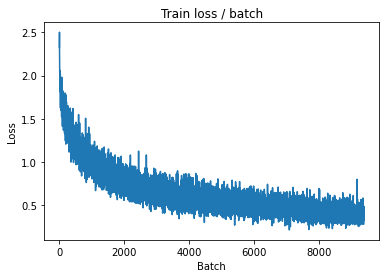

[TRAIN Batch 200/391]	Time 0.008s (0.018s)	Loss 0.4267 (0.3876)	Prec@1  84.4 ( 86.3)	Prec@5 100.0 ( 99.5)


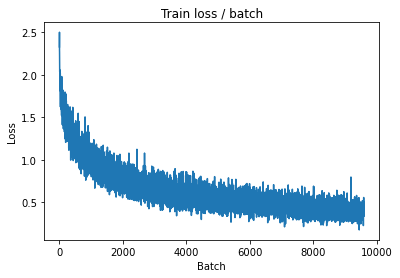


===============> Total time 7s	Avg loss 0.3934	Avg Prec@1 86.13 %	Avg Prec@5 99.48 %

[EVAL Batch 000/079]	Time 0.154s (0.154s)	Loss 0.4467 (0.4467)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4756	Avg Prec@1 83.55 %	Avg Prec@5 99.24 %



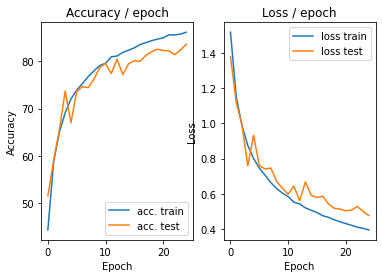

=== EPOCH 26 =====

[TRAIN Batch 000/391]	Time 0.133s (0.133s)	Loss 0.3988 (0.3988)	Prec@1  88.3 ( 88.3)	Prec@5  98.4 ( 98.4)


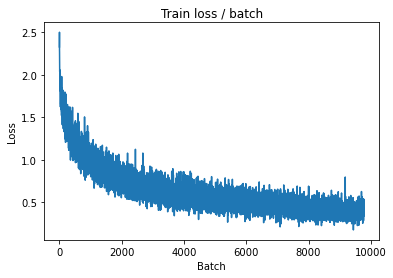

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.4781 (0.3810)	Prec@1  86.7 ( 86.8)	Prec@5  99.2 ( 99.5)


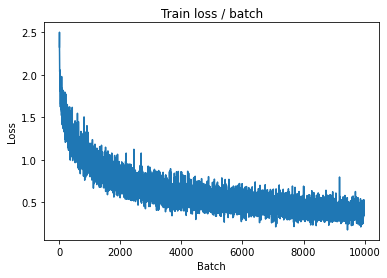


===============> Total time 7s	Avg loss 0.3837	Avg Prec@1 86.62 %	Avg Prec@5 99.50 %

[EVAL Batch 000/079]	Time 0.143s (0.143s)	Loss 0.4355 (0.4355)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4872	Avg Prec@1 83.34 %	Avg Prec@5 99.18 %



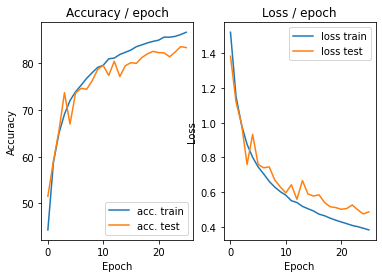

=== EPOCH 27 =====

[TRAIN Batch 000/391]	Time 0.130s (0.130s)	Loss 0.3127 (0.3127)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


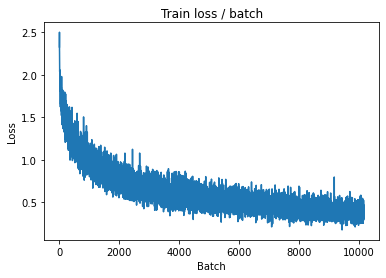

[TRAIN Batch 200/391]	Time 0.033s (0.022s)	Loss 0.4995 (0.3798)	Prec@1  83.6 ( 86.7)	Prec@5 100.0 ( 99.5)


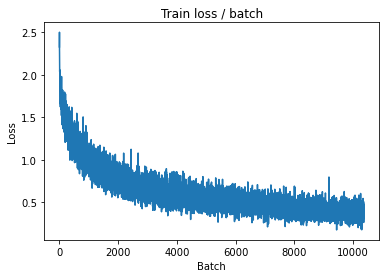


===============> Total time 8s	Avg loss 0.3820	Avg Prec@1 86.65 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.306s (0.306s)	Loss 0.4691 (0.4691)	Prec@1  83.6 ( 83.6)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4715	Avg Prec@1 83.81 %	Avg Prec@5 99.29 %



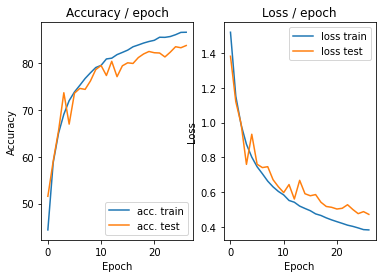

=== EPOCH 28 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3525 (0.3525)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


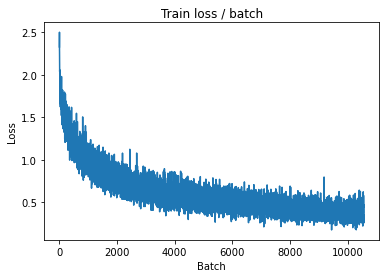

[TRAIN Batch 200/391]	Time 0.007s (0.019s)	Loss 0.3393 (0.3685)	Prec@1  89.8 ( 87.1)	Prec@5  99.2 ( 99.5)


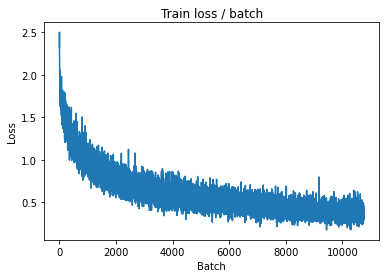


===============> Total time 7s	Avg loss 0.3722	Avg Prec@1 86.95 %	Avg Prec@5 99.53 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.4514 (0.4514)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4648	Avg Prec@1 83.77 %	Avg Prec@5 99.21 %



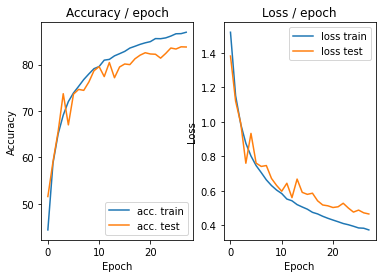

=== EPOCH 29 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.4210 (0.4210)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)


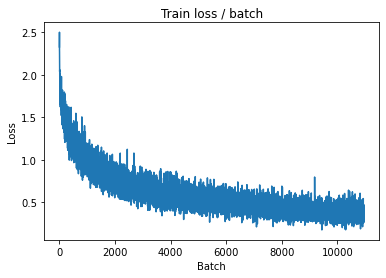

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.3517 (0.3676)	Prec@1  88.3 ( 87.2)	Prec@5  99.2 ( 99.6)


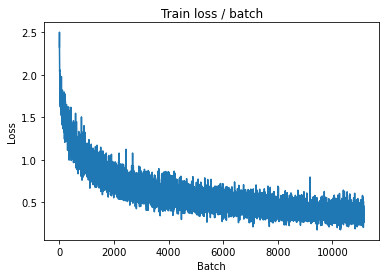


===============> Total time 7s	Avg loss 0.3684	Avg Prec@1 87.10 %	Avg Prec@5 99.56 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.4694 (0.4694)	Prec@1  83.6 ( 83.6)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4864	Avg Prec@1 83.13 %	Avg Prec@5 99.22 %



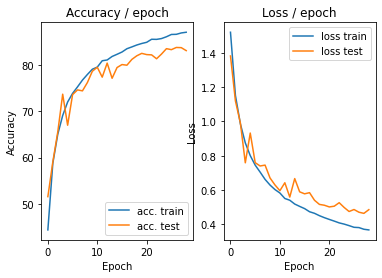

=== EPOCH 30 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.4325 (0.4325)	Prec@1  84.4 ( 84.4)	Prec@5 100.0 (100.0)


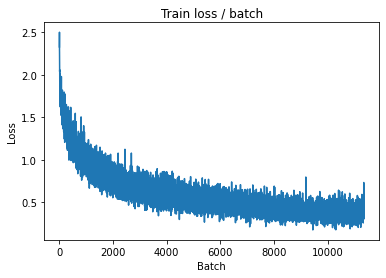

[TRAIN Batch 200/391]	Time 0.007s (0.022s)	Loss 0.3063 (0.3607)	Prec@1  88.3 ( 87.4)	Prec@5 100.0 ( 99.6)


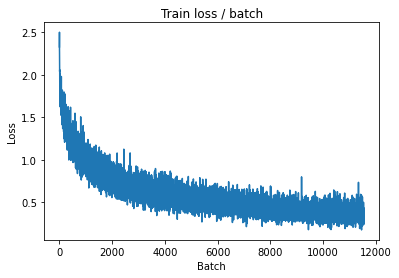


===============> Total time 8s	Avg loss 0.3607	Avg Prec@1 87.42 %	Avg Prec@5 99.59 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.4459 (0.4459)	Prec@1  85.9 ( 85.9)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4599	Avg Prec@1 84.23 %	Avg Prec@5 99.31 %



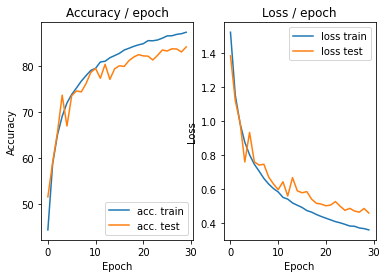

=== EPOCH 31 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3600 (0.3600)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)


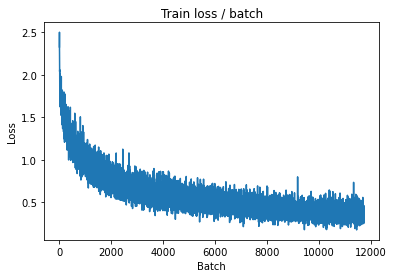

[TRAIN Batch 200/391]	Time 0.034s (0.022s)	Loss 0.3683 (0.3501)	Prec@1  88.3 ( 87.7)	Prec@5  99.2 ( 99.6)


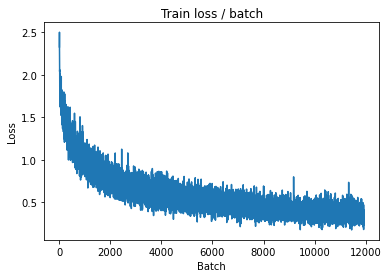


===============> Total time 8s	Avg loss 0.3495	Avg Prec@1 87.79 %	Avg Prec@5 99.61 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.4843 (0.4843)	Prec@1  85.2 ( 85.2)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.4833	Avg Prec@1 83.20 %	Avg Prec@5 99.27 %



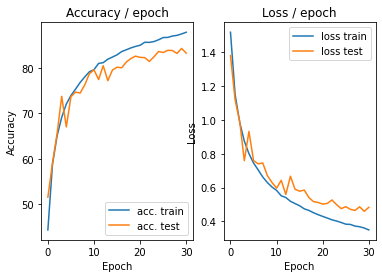

=== EPOCH 32 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.3658 (0.3658)	Prec@1  82.8 ( 82.8)	Prec@5 100.0 (100.0)


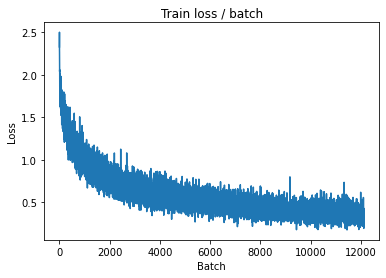

[TRAIN Batch 200/391]	Time 0.034s (0.022s)	Loss 0.3738 (0.3444)	Prec@1  88.3 ( 88.0)	Prec@5 100.0 ( 99.6)


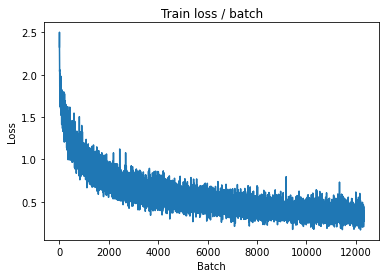


===============> Total time 8s	Avg loss 0.3482	Avg Prec@1 87.84 %	Avg Prec@5 99.63 %

[EVAL Batch 000/079]	Time 0.157s (0.157s)	Loss 0.4103 (0.4103)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4687	Avg Prec@1 83.56 %	Avg Prec@5 99.31 %



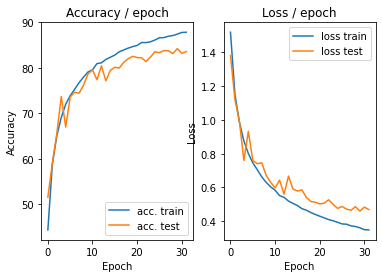

=== EPOCH 33 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.2473 (0.2473)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


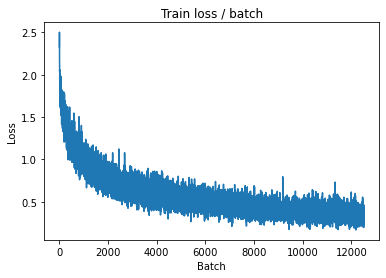

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3749 (0.3380)	Prec@1  87.5 ( 88.2)	Prec@5  99.2 ( 99.7)


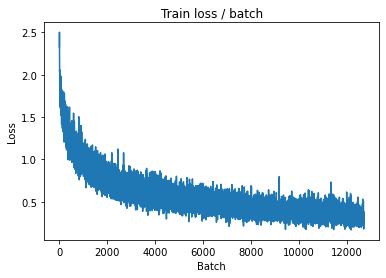


===============> Total time 7s	Avg loss 0.3443	Avg Prec@1 87.99 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.4492 (0.4492)	Prec@1  85.2 ( 85.2)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4493	Avg Prec@1 84.50 %	Avg Prec@5 99.33 %



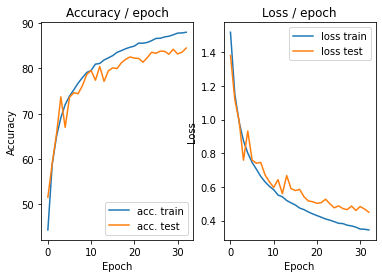

=== EPOCH 34 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.3839 (0.3839)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


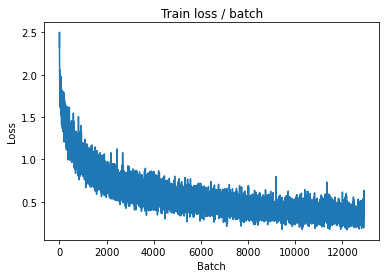

[TRAIN Batch 200/391]	Time 0.023s (0.019s)	Loss 0.3150 (0.3428)	Prec@1  89.8 ( 88.0)	Prec@5  99.2 ( 99.6)


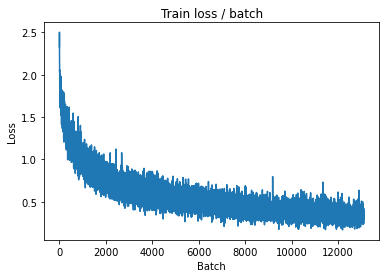


===============> Total time 7s	Avg loss 0.3405	Avg Prec@1 88.11 %	Avg Prec@5 99.62 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.4196 (0.4196)	Prec@1  85.9 ( 85.9)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4428	Avg Prec@1 84.72 %	Avg Prec@5 99.32 %



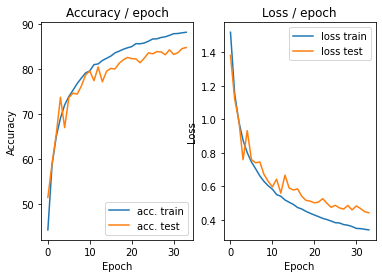

=== EPOCH 35 =====

[TRAIN Batch 000/391]	Time 0.278s (0.278s)	Loss 0.3415 (0.3415)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)


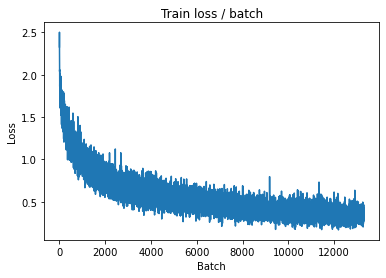

[TRAIN Batch 200/391]	Time 0.007s (0.020s)	Loss 0.3078 (0.3314)	Prec@1  89.8 ( 88.4)	Prec@5  99.2 ( 99.7)


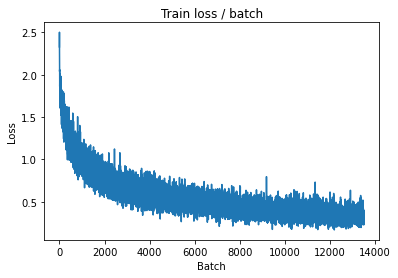


===============> Total time 7s	Avg loss 0.3310	Avg Prec@1 88.37 %	Avg Prec@5 99.67 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.3821 (0.3821)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4483	Avg Prec@1 84.55 %	Avg Prec@5 99.23 %



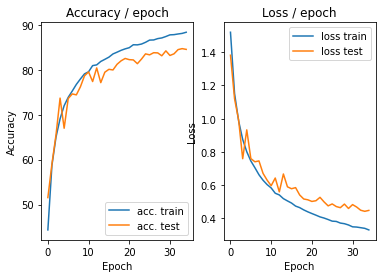

=== EPOCH 36 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.3405 (0.3405)	Prec@1  85.9 ( 85.9)	Prec@5 100.0 (100.0)


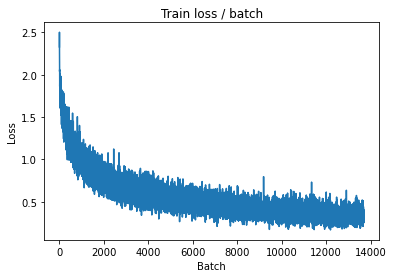

[TRAIN Batch 200/391]	Time 0.021s (0.019s)	Loss 0.3107 (0.3272)	Prec@1  89.8 ( 88.6)	Prec@5 100.0 ( 99.7)


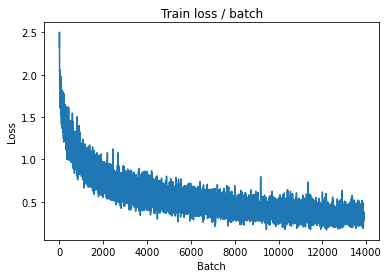


===============> Total time 7s	Avg loss 0.3282	Avg Prec@1 88.58 %	Avg Prec@5 99.68 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.4052 (0.4052)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4444	Avg Prec@1 84.47 %	Avg Prec@5 99.30 %



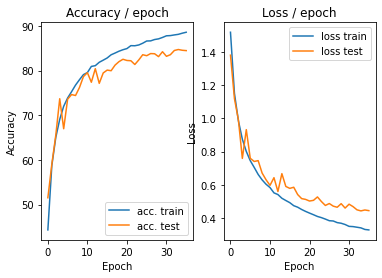

=== EPOCH 37 =====

[TRAIN Batch 000/391]	Time 0.147s (0.147s)	Loss 0.2957 (0.2957)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


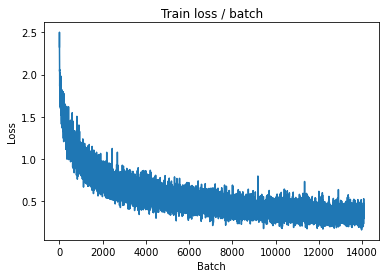

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.3360 (0.3175)	Prec@1  86.7 ( 89.0)	Prec@5  99.2 ( 99.6)


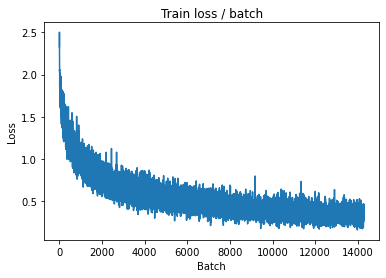


===============> Total time 7s	Avg loss 0.3235	Avg Prec@1 88.75 %	Avg Prec@5 99.65 %

[EVAL Batch 000/079]	Time 0.141s (0.141s)	Loss 0.4657 (0.4657)	Prec@1  84.4 ( 84.4)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4588	Avg Prec@1 84.17 %	Avg Prec@5 99.22 %



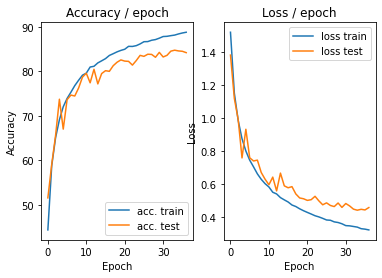

=== EPOCH 38 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.3028 (0.3028)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


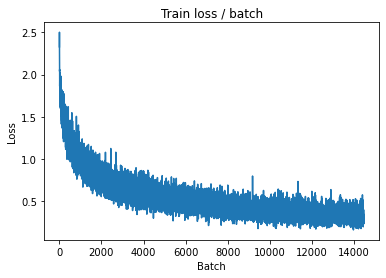

[TRAIN Batch 200/391]	Time 0.033s (0.021s)	Loss 0.2734 (0.3239)	Prec@1  90.6 ( 88.8)	Prec@5 100.0 ( 99.7)


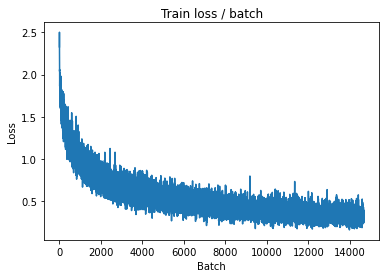


===============> Total time 8s	Avg loss 0.3197	Avg Prec@1 88.84 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.292s (0.292s)	Loss 0.4160 (0.4160)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4452	Avg Prec@1 84.55 %	Avg Prec@5 99.31 %



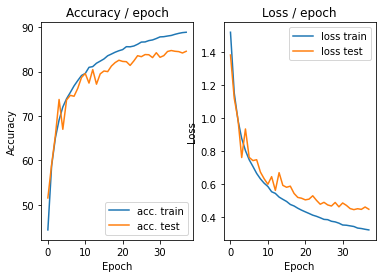

=== EPOCH 39 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3093 (0.3093)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


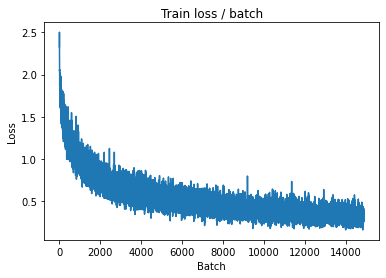

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.2671 (0.3188)	Prec@1  93.0 ( 88.8)	Prec@5 100.0 ( 99.7)


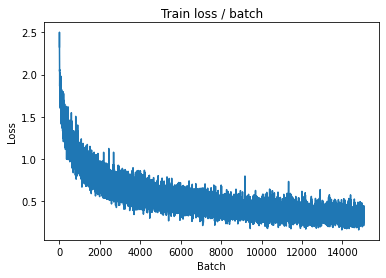


===============> Total time 7s	Avg loss 0.3176	Avg Prec@1 88.82 %	Avg Prec@5 99.69 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.4332 (0.4332)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4478	Avg Prec@1 84.95 %	Avg Prec@5 99.28 %



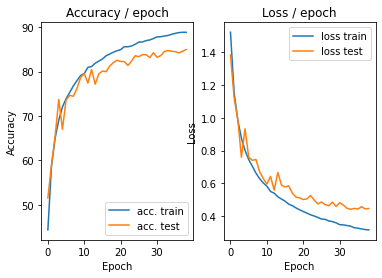

=== EPOCH 40 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.3218 (0.3218)	Prec@1  90.6 ( 90.6)	Prec@5  99.2 ( 99.2)


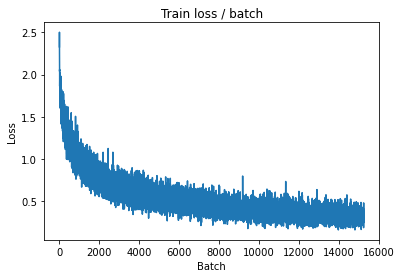

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.2688 (0.3120)	Prec@1  90.6 ( 89.0)	Prec@5 100.0 ( 99.7)


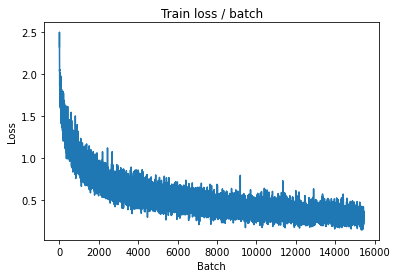


===============> Total time 7s	Avg loss 0.3138	Avg Prec@1 89.01 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.164s (0.164s)	Loss 0.3911 (0.3911)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4398	Avg Prec@1 85.00 %	Avg Prec@5 99.27 %



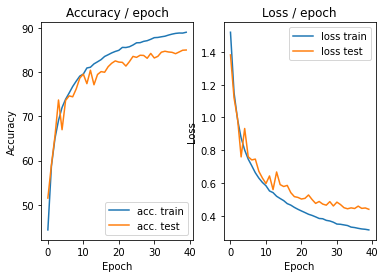

=== EPOCH 41 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.3812 (0.3812)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)


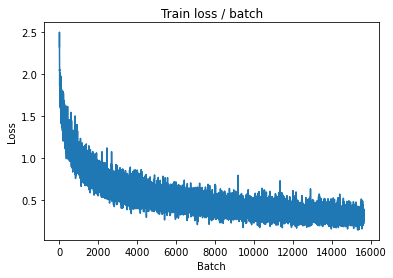

[TRAIN Batch 200/391]	Time 0.026s (0.019s)	Loss 0.2574 (0.3038)	Prec@1  89.1 ( 89.5)	Prec@5 100.0 ( 99.7)


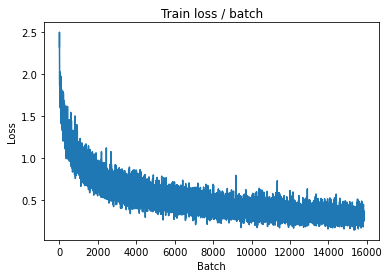


===============> Total time 7s	Avg loss 0.3078	Avg Prec@1 89.29 %	Avg Prec@5 99.71 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.3891 (0.3891)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4343	Avg Prec@1 85.16 %	Avg Prec@5 99.36 %



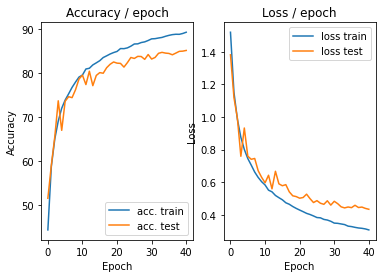

=== EPOCH 42 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.2607 (0.2607)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


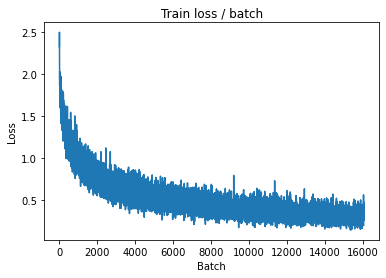

[TRAIN Batch 200/391]	Time 0.028s (0.020s)	Loss 0.2238 (0.2980)	Prec@1  93.0 ( 89.5)	Prec@5  99.2 ( 99.7)


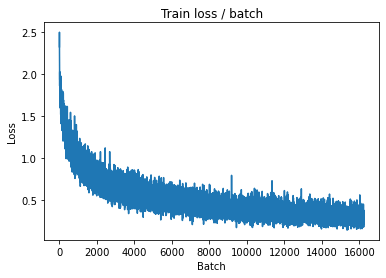


===============> Total time 7s	Avg loss 0.3030	Avg Prec@1 89.34 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.3968 (0.3968)	Prec@1  87.5 ( 87.5)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4407	Avg Prec@1 84.85 %	Avg Prec@5 99.33 %



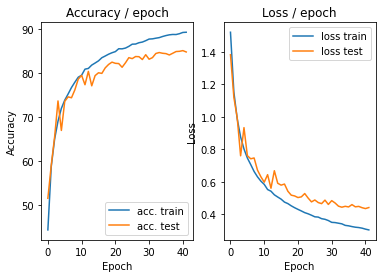

=== EPOCH 43 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.2796 (0.2796)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


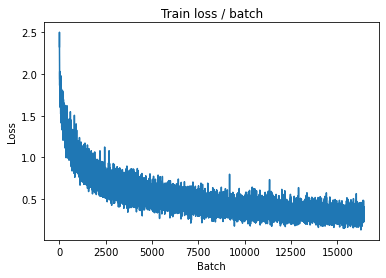

[TRAIN Batch 200/391]	Time 0.007s (0.022s)	Loss 0.3258 (0.3008)	Prec@1  86.7 ( 89.6)	Prec@5 100.0 ( 99.8)


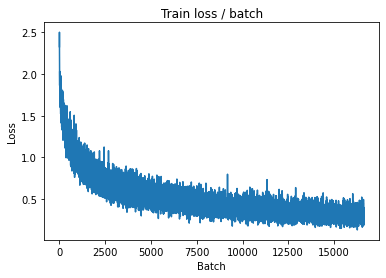


===============> Total time 8s	Avg loss 0.3008	Avg Prec@1 89.50 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.149s (0.149s)	Loss 0.4104 (0.4104)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4455	Avg Prec@1 84.56 %	Avg Prec@5 99.30 %



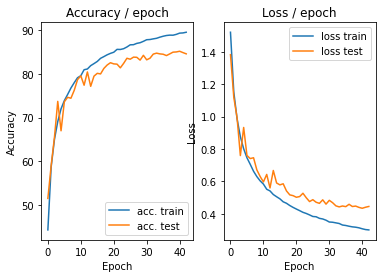

=== EPOCH 44 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.3136 (0.3136)	Prec@1  87.5 ( 87.5)	Prec@5 100.0 (100.0)


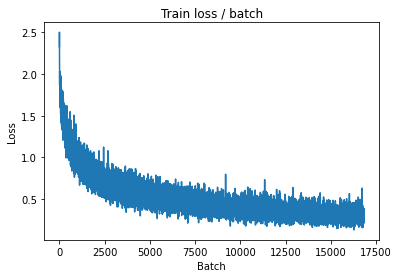

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.2599 (0.2952)	Prec@1  87.5 ( 89.7)	Prec@5  99.2 ( 99.7)


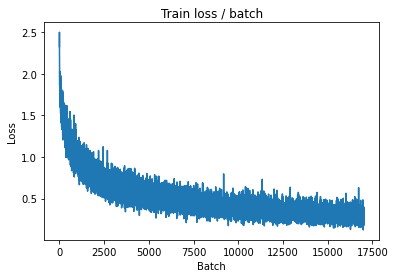


===============> Total time 7s	Avg loss 0.2978	Avg Prec@1 89.64 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.3971 (0.3971)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4360	Avg Prec@1 85.34 %	Avg Prec@5 99.38 %



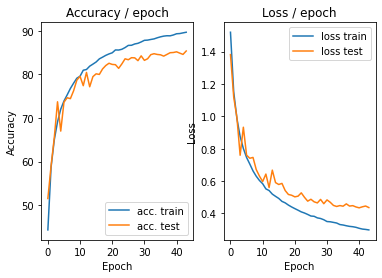

=== EPOCH 45 =====

[TRAIN Batch 000/391]	Time 0.139s (0.139s)	Loss 0.2834 (0.2834)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


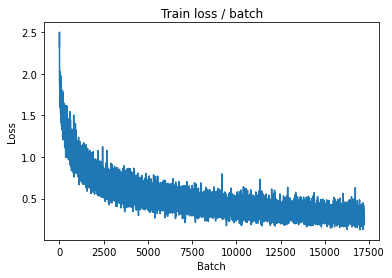

[TRAIN Batch 200/391]	Time 0.029s (0.020s)	Loss 0.2936 (0.2958)	Prec@1  92.2 ( 89.8)	Prec@5  99.2 ( 99.7)


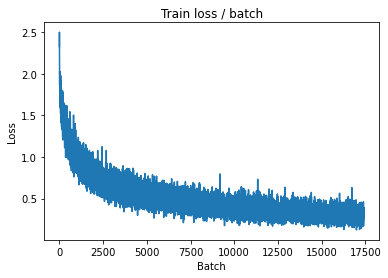


===============> Total time 7s	Avg loss 0.2943	Avg Prec@1 89.84 %	Avg Prec@5 99.76 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.3940 (0.3940)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)

===============> Total time 1s	Avg loss 0.4411	Avg Prec@1 84.97 %	Avg Prec@5 99.27 %



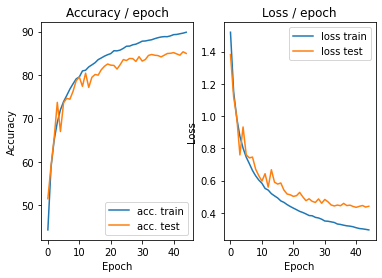

=== EPOCH 46 =====

[TRAIN Batch 000/391]	Time 0.298s (0.298s)	Loss 0.2926 (0.2926)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


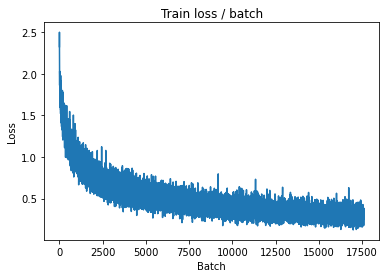

[TRAIN Batch 200/391]	Time 0.028s (0.021s)	Loss 0.2705 (0.2926)	Prec@1  93.0 ( 89.8)	Prec@5 100.0 ( 99.7)


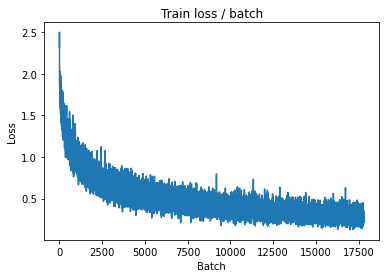


===============> Total time 8s	Avg loss 0.2909	Avg Prec@1 89.81 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.146s (0.146s)	Loss 0.3885 (0.3885)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4291	Avg Prec@1 85.27 %	Avg Prec@5 99.34 %



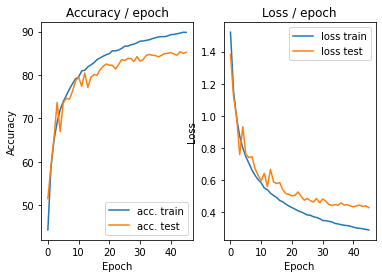

=== EPOCH 47 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.2311 (0.2311)	Prec@1  93.0 ( 93.0)	Prec@5 100.0 (100.0)


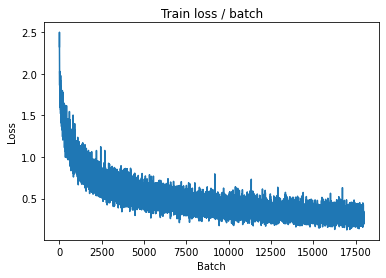

[TRAIN Batch 200/391]	Time 0.016s (0.019s)	Loss 0.3387 (0.2858)	Prec@1  87.5 ( 90.0)	Prec@5 100.0 ( 99.8)


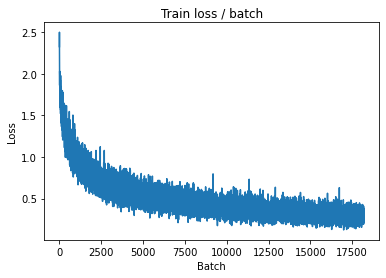


===============> Total time 7s	Avg loss 0.2880	Avg Prec@1 89.96 %	Avg Prec@5 99.78 %

[EVAL Batch 000/079]	Time 0.161s (0.161s)	Loss 0.3980 (0.3980)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4386	Avg Prec@1 84.95 %	Avg Prec@5 99.34 %



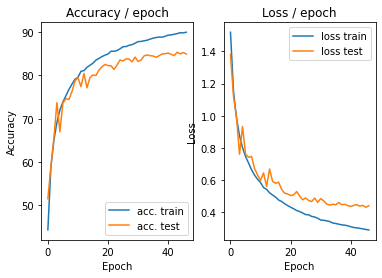

=== EPOCH 48 =====

[TRAIN Batch 000/391]	Time 0.145s (0.145s)	Loss 0.3316 (0.3316)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


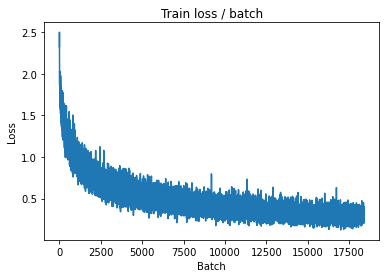

[TRAIN Batch 200/391]	Time 0.027s (0.021s)	Loss 0.2639 (0.2795)	Prec@1  89.8 ( 90.2)	Prec@5 100.0 ( 99.8)


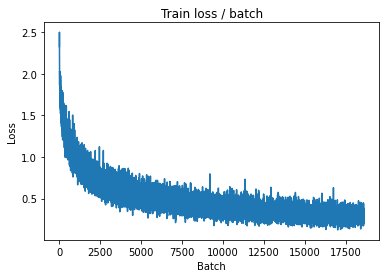


===============> Total time 7s	Avg loss 0.2849	Avg Prec@1 90.15 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.155s (0.155s)	Loss 0.3881 (0.3881)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4326	Avg Prec@1 85.26 %	Avg Prec@5 99.37 %



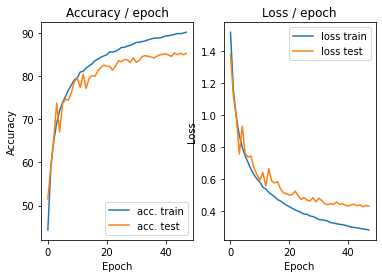

=== EPOCH 49 =====

[TRAIN Batch 000/391]	Time 0.132s (0.132s)	Loss 0.3088 (0.3088)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


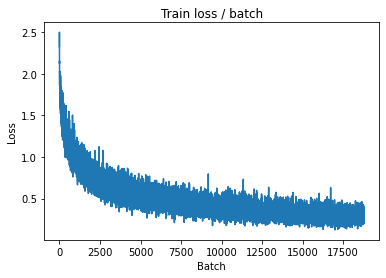

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.3934 (0.2846)	Prec@1  82.8 ( 90.1)	Prec@5  99.2 ( 99.7)


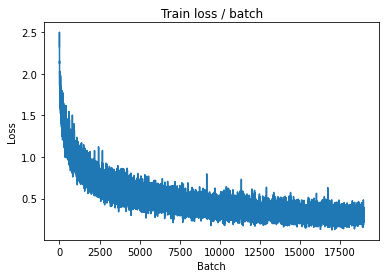


===============> Total time 7s	Avg loss 0.2858	Avg Prec@1 90.01 %	Avg Prec@5 99.72 %

[EVAL Batch 000/079]	Time 0.294s (0.294s)	Loss 0.3786 (0.3786)	Prec@1  88.3 ( 88.3)	Prec@5  97.7 ( 97.7)

===============> Total time 1s	Avg loss 0.4272	Avg Prec@1 85.52 %	Avg Prec@5 99.33 %



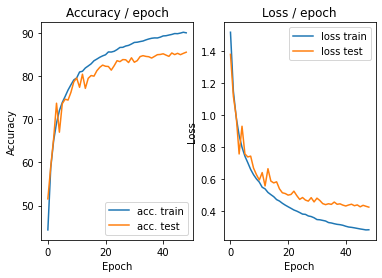

=== EPOCH 50 =====

[TRAIN Batch 000/391]	Time 0.143s (0.143s)	Loss 0.2764 (0.2764)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)


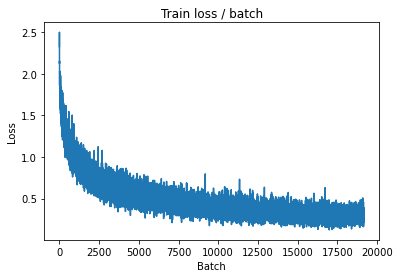

[TRAIN Batch 200/391]	Time 0.035s (0.022s)	Loss 0.2142 (0.2773)	Prec@1  93.0 ( 90.4)	Prec@5 100.0 ( 99.7)


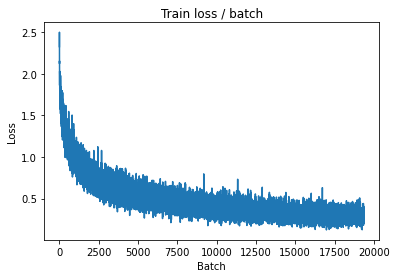


===============> Total time 8s	Avg loss 0.2810	Avg Prec@1 90.23 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.4089 (0.4089)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4304	Avg Prec@1 85.35 %	Avg Prec@5 99.36 %



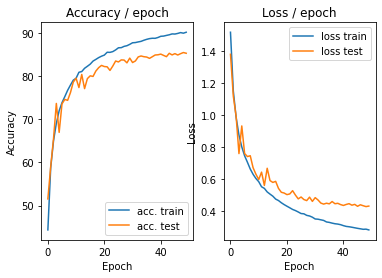

=== EPOCH 51 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.3810 (0.3810)	Prec@1  85.2 ( 85.2)	Prec@5  99.2 ( 99.2)


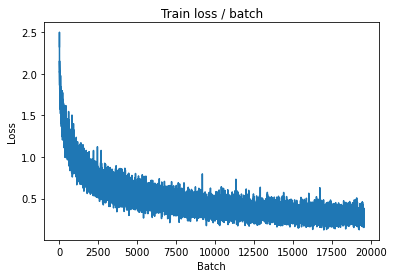

[TRAIN Batch 200/391]	Time 0.033s (0.022s)	Loss 0.2875 (0.2839)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 ( 99.7)


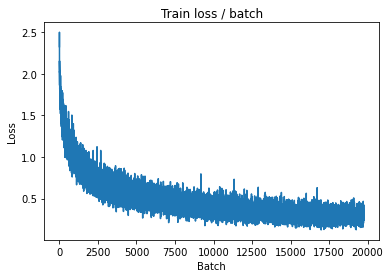


===============> Total time 8s	Avg loss 0.2820	Avg Prec@1 90.09 %	Avg Prec@5 99.74 %

[EVAL Batch 000/079]	Time 0.148s (0.148s)	Loss 0.3805 (0.3805)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4267	Avg Prec@1 85.47 %	Avg Prec@5 99.36 %



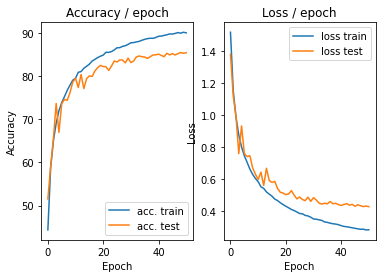

=== EPOCH 52 =====

[TRAIN Batch 000/391]	Time 0.141s (0.141s)	Loss 0.3710 (0.3710)	Prec@1  86.7 ( 86.7)	Prec@5  98.4 ( 98.4)


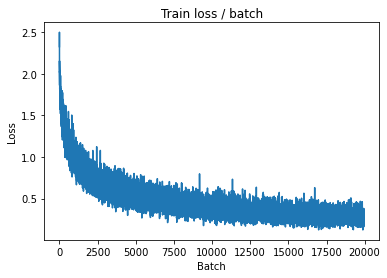

[TRAIN Batch 200/391]	Time 0.034s (0.022s)	Loss 0.3260 (0.2821)	Prec@1  90.6 ( 90.3)	Prec@5 100.0 ( 99.8)


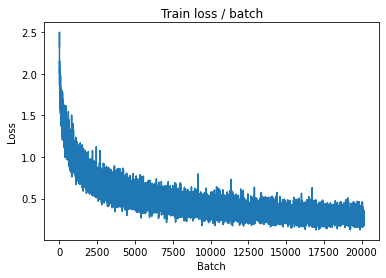


===============> Total time 8s	Avg loss 0.2785	Avg Prec@1 90.23 %	Avg Prec@5 99.75 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.3801 (0.3801)	Prec@1  88.3 ( 88.3)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4268	Avg Prec@1 85.63 %	Avg Prec@5 99.37 %



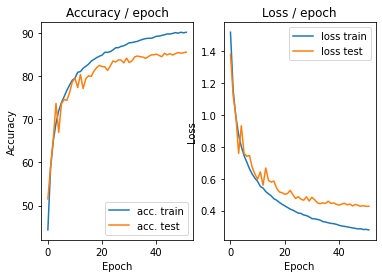

=== EPOCH 53 =====

[TRAIN Batch 000/391]	Time 0.144s (0.144s)	Loss 0.2866 (0.2866)	Prec@1  86.7 ( 86.7)	Prec@5 100.0 (100.0)


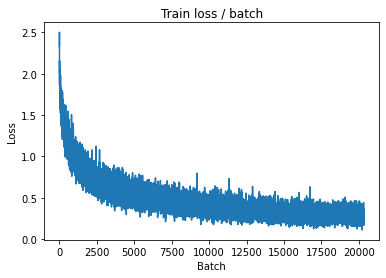

[TRAIN Batch 200/391]	Time 0.025s (0.020s)	Loss 0.3699 (0.2739)	Prec@1  86.7 ( 90.4)	Prec@5 100.0 ( 99.8)


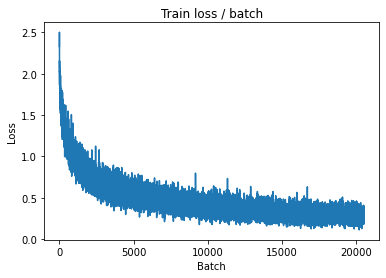


===============> Total time 7s	Avg loss 0.2752	Avg Prec@1 90.34 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.140s (0.140s)	Loss 0.3840 (0.3840)	Prec@1  86.7 ( 86.7)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4226	Avg Prec@1 85.76 %	Avg Prec@5 99.35 %



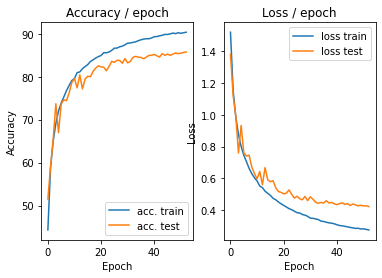

=== EPOCH 54 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.2512 (0.2512)	Prec@1  89.1 ( 89.1)	Prec@5 100.0 (100.0)


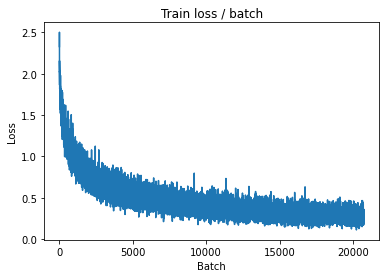

[TRAIN Batch 200/391]	Time 0.027s (0.020s)	Loss 0.2591 (0.2762)	Prec@1  91.4 ( 90.2)	Prec@5 100.0 ( 99.8)


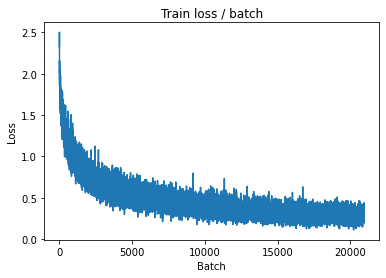


===============> Total time 7s	Avg loss 0.2741	Avg Prec@1 90.30 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.153s (0.153s)	Loss 0.3589 (0.3589)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4248	Avg Prec@1 85.56 %	Avg Prec@5 99.33 %



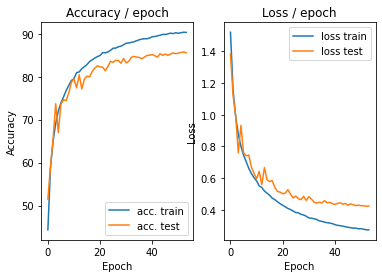

=== EPOCH 55 =====

[TRAIN Batch 000/391]	Time 0.137s (0.137s)	Loss 0.1899 (0.1899)	Prec@1  91.4 ( 91.4)	Prec@5 100.0 (100.0)


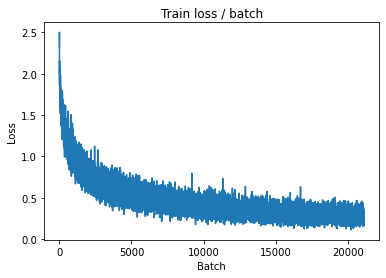

[TRAIN Batch 200/391]	Time 0.027s (0.021s)	Loss 0.2922 (0.2680)	Prec@1  87.5 ( 90.5)	Prec@5 100.0 ( 99.8)


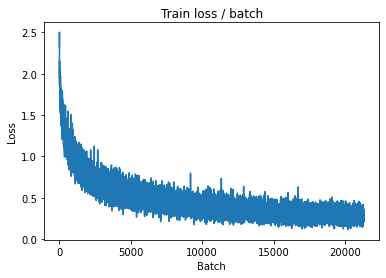


===============> Total time 7s	Avg loss 0.2700	Avg Prec@1 90.50 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.158s (0.158s)	Loss 0.3713 (0.3713)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4265	Avg Prec@1 85.49 %	Avg Prec@5 99.30 %



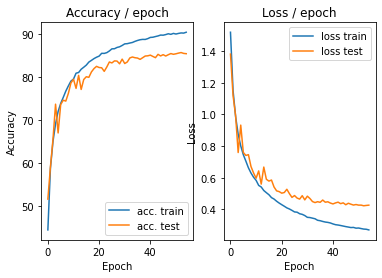

=== EPOCH 56 =====

[TRAIN Batch 000/391]	Time 0.131s (0.131s)	Loss 0.3007 (0.3007)	Prec@1  90.6 ( 90.6)	Prec@5 100.0 (100.0)


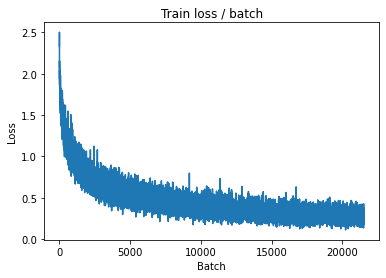

[TRAIN Batch 200/391]	Time 0.032s (0.019s)	Loss 0.2381 (0.2703)	Prec@1  93.8 ( 90.4)	Prec@5 100.0 ( 99.8)


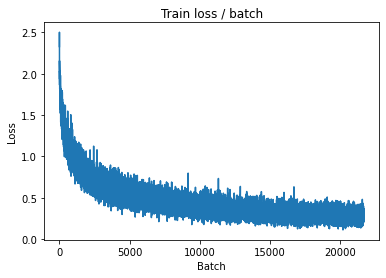


===============> Total time 7s	Avg loss 0.2706	Avg Prec@1 90.51 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.151s (0.151s)	Loss 0.3825 (0.3825)	Prec@1  87.5 ( 87.5)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4246	Avg Prec@1 85.58 %	Avg Prec@5 99.34 %



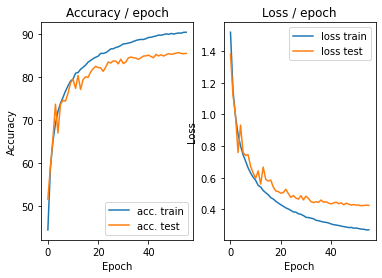

=== EPOCH 57 =====

[TRAIN Batch 000/391]	Time 0.271s (0.271s)	Loss 0.2613 (0.2613)	Prec@1  88.3 ( 88.3)	Prec@5 100.0 (100.0)


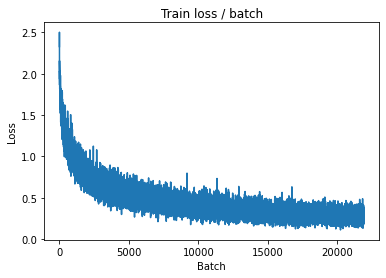

[TRAIN Batch 200/391]	Time 0.027s (0.021s)	Loss 0.2909 (0.2611)	Prec@1  90.6 ( 90.9)	Prec@5  99.2 ( 99.8)


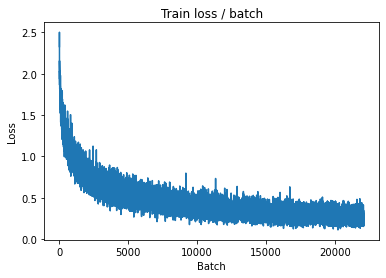


===============> Total time 7s	Avg loss 0.2672	Avg Prec@1 90.67 %	Avg Prec@5 99.77 %

[EVAL Batch 000/079]	Time 0.142s (0.142s)	Loss 0.3589 (0.3589)	Prec@1  89.8 ( 89.8)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4248	Avg Prec@1 85.59 %	Avg Prec@5 99.40 %



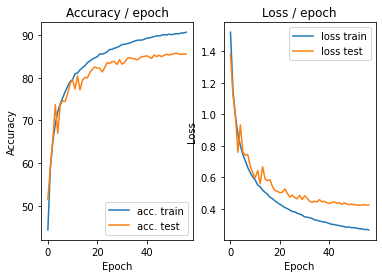

=== EPOCH 58 =====

[TRAIN Batch 000/391]	Time 0.135s (0.135s)	Loss 0.1885 (0.1885)	Prec@1  96.1 ( 96.1)	Prec@5 100.0 (100.0)


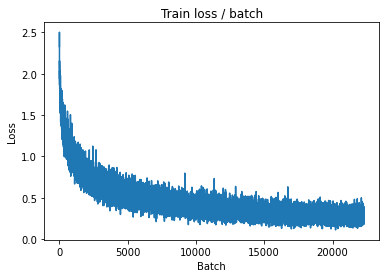

[TRAIN Batch 200/391]	Time 0.028s (0.019s)	Loss 0.1475 (0.2648)	Prec@1  94.5 ( 90.8)	Prec@5 100.0 ( 99.8)


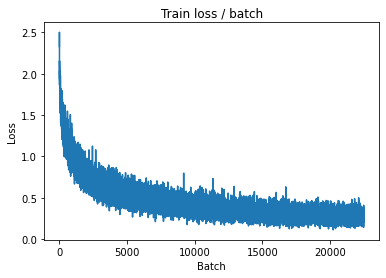


===============> Total time 7s	Avg loss 0.2670	Avg Prec@1 90.66 %	Avg Prec@5 99.80 %

[EVAL Batch 000/079]	Time 0.145s (0.145s)	Loss 0.3764 (0.3764)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4249	Avg Prec@1 85.78 %	Avg Prec@5 99.31 %



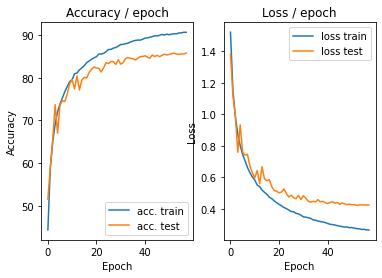

=== EPOCH 59 =====

[TRAIN Batch 000/391]	Time 0.136s (0.136s)	Loss 0.1844 (0.1844)	Prec@1  95.3 ( 95.3)	Prec@5  99.2 ( 99.2)


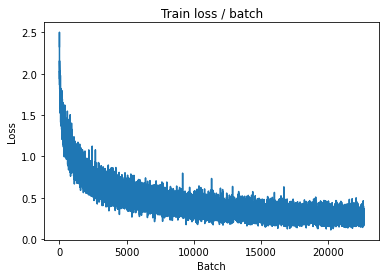

[TRAIN Batch 200/391]	Time 0.027s (0.019s)	Loss 0.2959 (0.2678)	Prec@1  89.8 ( 90.8)	Prec@5 100.0 ( 99.8)


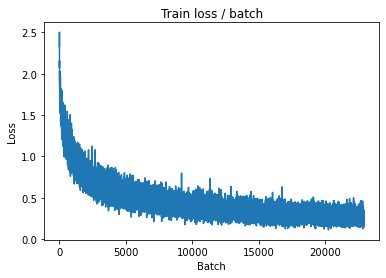


===============> Total time 7s	Avg loss 0.2644	Avg Prec@1 90.74 %	Avg Prec@5 99.79 %

[EVAL Batch 000/079]	Time 0.163s (0.163s)	Loss 0.3744 (0.3744)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4200	Avg Prec@1 85.61 %	Avg Prec@5 99.32 %



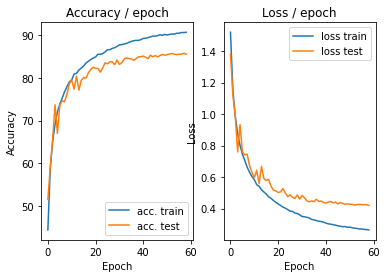

=== EPOCH 60 =====

[TRAIN Batch 000/391]	Time 0.138s (0.138s)	Loss 0.2466 (0.2466)	Prec@1  89.8 ( 89.8)	Prec@5 100.0 (100.0)


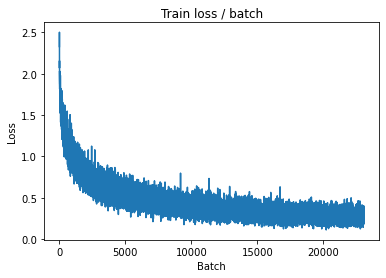

[TRAIN Batch 200/391]	Time 0.016s (0.019s)	Loss 0.2455 (0.2673)	Prec@1  92.2 ( 90.8)	Prec@5 100.0 ( 99.8)


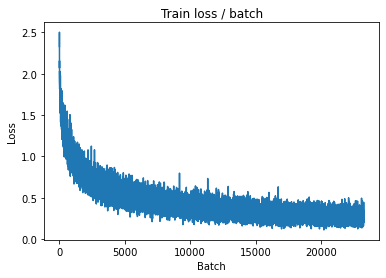


===============> Total time 7s	Avg loss 0.2647	Avg Prec@1 90.79 %	Avg Prec@5 99.82 %

[EVAL Batch 000/079]	Time 0.316s (0.316s)	Loss 0.3658 (0.3658)	Prec@1  89.1 ( 89.1)	Prec@5  99.2 ( 99.2)

===============> Total time 1s	Avg loss 0.4209	Avg Prec@1 85.63 %	Avg Prec@5 99.37 %



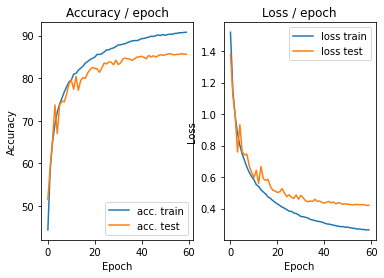

In [43]:
main(128, 0.1,60, cuda=True)